In [2]:
import os
import pandas as pd
import numpy as np
import torch
from torch.utils.data import Dataset
from torchvision import transforms
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression

# Defining PyTorch Dataset and Transforms

In [156]:
class PatientDataSet(Dataset):
    '''
    PyTorch Dataset for holding the brain scan data and clinical data of patients
    and loading it for use in machine learning algorithms and PyTorch neural networks
    
    attributes:
        df: DataFrame 
            The dataframe containing correlation matrices and clinical data of patients
        dataset_type: str
            The type of brain scan data we are working with
        brain_columns: Index
            Column names containing the brain data
        clinical_columns: Index 
            Column names containing the clinical data
        data_columns: Index
            Column names containing the trainable data
        target_column: Index
            Column name of the target data
        info_columns: Index
            Column names of data containing additional, nontrainable data
        transform
            The transform(s) to be applied to the data
    '''
    
    def __init__(self, df, transform=None, dataset_type='RS', non_data_cols=[]):
        self.df = df
        self.dataset_type = dataset_type
        patient_cols = ['Site', 'SubjectID', 'Diagnosis', 'Age', 'Sex']
        brain_data_filter = ~(self.df.columns.to_series().isin(patient_cols + non_data_cols))
        self.brain_columns = self.df.columns[brain_data_filter]
        self.clinical_columns = self.df.columns[~brain_data_filter]
        info_cols = ['Site', 'SubjectID']
        target_col = ['Diagnosis']
        non_data = non_data_cols + info_cols + target_col
        data_col_filter = ~self.df.columns.isin(non_data)
        self.data_columns = self.df.columns[data_col_filter]
        target_col_filter = self.df.columns.isin(target_col)
        self.target_column = self.df.columns[target_col_filter]
        info_col_filter = self.df.columns.isin(info_cols)
        self.info_columns = self.df.columns[info_col_filter]
        self.transform = transform
    
    def __len__(self):
        return len(self.df.index)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        
        selected_rows = self.df.iloc[idx]
        
        data = selected_rows[self.data_columns]
        diagnosis = selected_rows[self.target_column]
        info = selected_rows[self.info_columns]
        clinical = selected_rows[self.clinical_columns]
        index = selected_rows.index

        sample = {'data':data, 'diagnosis':diagnosis, 'info':info, 
                  'clinical':clinical, 'index':index}
        
        if self.transform:
            sample = self.transform(sample)
        
        return sample
    
    # Returns the trainable data of the entire dataset
    def get_X(self):
        data = self.df[self.data_columns]
        return data
    
    # Returns the target data of the entire dataset
    def get_Y(self):
        diagnosis = self.df[self.target_column]
        return diagnosis
        

class GaussianNoise:
    '''
    A transform to be applied to a PatientDataSet that applies gaussian 
    noise to it
    
    attributes:
        mean: float
            The mean of the gaussian noise
        std_dev: float
            The standard deviation of the gaussian noise
        brain_columns: Index
            The columns of the DataFrame, which hold the brain
            scan data to which the gaussian noise should be applied
    '''
    
    def __init__(self, mean, std_dev, brain_columns):
        self.mean = mean
        self.std_dev = std_dev
        self.brain_columns = brain_columns
        
    def __call__(self, sample):
        shape = sample['data'][self.brain_columns].shape
        noise = np.random.normal(self.mean, self.std_dev, shape)
        
        data = sample['data']
        data_noisy = data.copy()
        data_noisy[self.brain_columns] += noise
        
        return {'data':data, 'data_noisy':data_noisy, 'diagnosis':sample['diagnosis'],
                'info':sample['info'], 'clinical':sample['clinical'],
                'index':sample['index']}
        

class ToTorchFormat:
    '''
    A transform to be applied to a PatientDataSet that converts a
    given data sample to a PyTorch format
    '''
    
    def __call__(self, sample):
        data = sample['data'].astype('float64')
        data_formatted = torch.from_numpy(data.to_numpy()).float()
        diagnosis = sample['diagnosis'].astype('int64')
        diagnosis_formatted = torch.from_numpy(diagnosis.to_numpy())
        info = sample['info']
        if type(info) is pd.DataFrame:
            info_formatted = info.to_dict(orient='list')
        else:
            info_formatted = info.to_dict()
        clinical = sample['clinical']
        if type(clinical) is pd.DataFrame:
            clinical_formatted = clinical.to_dict(orient='list')
        else:
            clinical_formatted = clinical.to_dict()
        sample_new = {'data':data_formatted, 
                      'diagnosis':diagnosis_formatted, 
                      'info':info_formatted, 'clinical':clinical_formatted}
        if 'data_noisy' in sample.keys():
            data_noisy = sample['data_noisy'].astype('float64')
            data_noisy_formatted = torch.from_numpy(data_noisy.to_numpy()).float()
            sample_new['data_noisy'] = data_noisy_formatted
        return sample_new

# Data Preprocessing

In [ ]:
'''
Dictionaries holding the maps for sex and diagnosis
'''
sex_dict = {'M':0, 'F':1} 
diag_dict = {'Control':0, 'PTSD':1, 'Subthreshold':2}

def clean_cols(df, subj=True, sex=True, diag=True):
    '''
    Cleans the SubjectID, Sex, and Diagnosis columns by mapping them
    to their desired values and types
    
    params:
        df: DataFrame
            The DataFrame to clean the columns for
        sex: bool (default = True)
            Whether to map the 'Sex' column to a number
        diag: bool (default = True)
            Whether to map the 'Diag' column to a number
            
    return:
        DataFrame
            The DataFrame with the columns cleaned
    '''
    
    if subj:
        df['SubjectID'] = df['SubjectID'].apply(str)
    if sex:
        df['Sex'] = df['Sex'].map(sex_dict)
    if diag:
        df['Diagnosis'] = df['Diagnosis'].map(diag_dict)
    
    return df

In [24]:
def remove_empty(df, columns=[], axis=1, how="all"):
    '''
    Removes all empty columns
    
    params:
        df: DataFrame
            The DataFrame to remove empty columns from
        columns: list
            The names of the subset of columns to remove if empty
        axis: int
            0 for rows
            1 for columns
        how: str
            "any": removes all rows(axis=0)/columns(axis=1) that have any empty cells
            "all": removes all rows(axis=0)/columns(axis=1) that have all empty cells
    '''
    df.replace("", np.nan, inplace=True)
    df[df.applymap(lambda x: type(x) is str and x.isspace())] = np.nan
    if columns:
        df.dropna(how=how, axis=axis, subset=columns, inplace=True)
    else:
        df.dropna(how=how, axis=axis, inplace=True)

def scale_features(df, scaler_type='robust', cols_to_ignore = []):
    '''
        Scales all relevant feature columns using the specified scaler
        
        params:
            df: DataFrame
                The DataFrame to which to apply feature scaling
            scaler_type: str (default = 'robust')
                The string specifying the type of scaler to use
            cols_to_ignore: list (default = [])
                A list of column names to not apply scaling to
                
        return:
            DataFrame
                The DataFrame with scaled features
    '''
      
    if scaler_type.lower() == 'robust':
        scaler = RobustScaler()
    elif scaler_type.lower() == 'standard':
        scaler = StandardScaler()
    elif scaler_type.lower() == 'minmax':
        scaler = MinMaxScaler()
    else:
        raise Exception("Invalid scaler type given. Only 'standard', 'robust', and 'minmax' are accepted.")
    cols_to_ignore = ['Site', 'SubjectID', 'Sex', 'Diagnosis'] + cols_to_ignore
    for col in df.columns[~df.columns.isin(cols_to_ignore)]:
        col_np = df[col].to_numpy().reshape(-1,1)
        scaler.fit(col_np)
        df[col] = scaler.transform(col_np)
        
    return df

def reduce_ROI(df):
    '''
        Removes ROIs from the resting state correlation matrix 
        that aren't hypothesized in relating to PTSD
        
        params:
            df: DataFrame
                The DataFrame to apply the ROI reduction to
        
        return:
            DataFrame
                The DataFrame that the ROIs were reduced for
    '''
    
    ROIs = [47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 137, 138, 139, 174, 175, 176, 177, 178, 179, 180, 181, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 251, 252, 256, 257, 258, 259, 260, 261, 262, 263, 264]
    def compare_ROI(c):
        if 'ROI' not in c:
            return True
        ROIx, ROIy = c.replace('ROI', '').split('-')
        return int(ROIx) in ROIs and int(ROIy) in ROIs
    ROI_filter = df.columns.to_series().apply(compare_ROI)
    df = df[df.columns[ROI_filter]]
    
    return df

def remove_redundant_ROI(df):
    '''
        Removes ROIs from the resting state correlation matrix 
        that are redundant e.g. ROI1-ROI1, ROI2-ROI2, ...
        
        params:
            df: DataFrame
                The DataFrame to apply the ROI removal
        
        return:
            DataFrame
                The DataFrame that the ROIs were removed for
    '''
    
    def compare_ROI(c):
        if 'ROI' not in c:
            return True
        ROIx, ROIy = c.replace('ROI', '').split('-')
        return int(ROIx) != int(ROIy)
    ROI_filter = df.columns.to_series().apply(compare_ROI)
    df = df[df.columns[ROI_filter]]
    
    return df

def preprocess_df(df, **kwargs):
    '''
        A utility function for scaling features and/or reducing the ROI if desired
        
        **kwargs:
            reduce_ROI: bool (default = False)
                Whether to apply ROI reduction
            remove_redundant_ROI: bool (default = False)
                Whether to remove redundant ROIs
            drop_thresh: float (default = None)
                If not None, drop rows that don't exceed a proportion of
                drop_thresh percent non-empty cells
            fill_empty: bool (default = None)
                Whether to use the average column value to fill in empty
                cells
            regress_site: bool (default = False)
                Whether to regress out the site information
            scale_features: str (default = None)
                Whether to scale features and if so, which scaler to use
        
        return:
            DataFrame
                The DataFrame with desired preprocessing applied
    '''
    
    red_ROI = kwargs.get('reduce_ROI', False)
    rem_red_ROI = kwargs.get('remove_redundant_ROI', False)
    drop_thresh = kwargs.get('drop_thresh', None)
    fill_empty = kwargs.get('fill_empty', None)
    regress_site = kwargs.get('regress_site', False)
    scale_feat = kwargs.get('scale_features', None)
    cols_to_ignore = kwargs.get('cols_to_ignore', [])
    
    if red_ROI:
        df = reduce_ROI(df)
        
    if rem_red_ROI:
        df = remove_redundant_ROI(df)
        
    if drop_thresh:
        df = df.replace('', np.nan)
        df.dropna(thresh=int(drop_thresh*len(df.columns)), inplace=True)
        df.reset_index(drop=True, inplace=True)
    
    if fill_empty:
        df = df.replace('', np.nan)
        cols_to_ignore_tmp = cols_to_ignore + ['Site', 'SubjectID','Diagnosis', 'Age', 'Sex']
        cols = df.columns[~df.columns.isin(cols_to_ignore_tmp)]
        if fill_empty == "mean":
            means = pd.Series(df[cols].mean(axis=0, skipna=True), index=cols)
            df[cols] = df[cols].fillna(means)
        elif fill_empty == "zero":
            df[cols] = df[cols].fillna(0)
    
    if regress_site:
        df = regress_out_site(df, cols_to_ignore=cols_to_ignore)
        
    if scale_feat:
        df = scale_features(df, scale_feat, cols_to_ignore=cols_to_ignore)
        
    return df

In [6]:
def split_df(df, **kwargs):
    '''
        A function for splitting the DataFrame either by choosing a selected number of rows
        or by doing a train test split by percent
        
        **kwargs:
            n_rows: int (default = None)
                If not None, the number of rows to take from the DataFrame
            randomize: bool (default = False)
                Whether to shuffle the rows
            random_seed: int (deafult =  None)
                If not None, the random seed to plug into the random shuffle
            train_test_split: bool (default = False)
                Whether to perform a train test split by percent
            percent_split: float(default = None)
                The percent to split by between 0.0 and 1.0
            validation_split: float(default = None)
                The percent from the training set to use for the validation set
        
        return:
            DataFrame: if train_test_split is False
            DataFrame, DataFrame: if train_test_split is True
    '''
    
    n_rows = kwargs.get('n_rows', None)
    randomize = kwargs.get('randomize', False)
    random_seed = kwargs.get('random_seed', None)
    train_test_split = kwargs.get('train_test_split', False)
    percent_split = kwargs.get('percent_split', None)
    validation_split = kwargs.get('validation_split', None)
    
    if n_rows:
        n_rows = min(n_rows, len(df.index)-1)
    
    if not randomize:
        if train_test_split:
            if percent_split:
                if n_rows:
                    split = int(percent_split*n_rows)
                    train_df = df.iloc[0:split]
                    test_df = df.iloc[split:n_rows]
                else:
                    split = int(percent_split*(len(df.index)-1))
                    train_df = df.iloc[0:split]
                    test_df = df.iloc[split:]
                if validation_split:
                    split = int(validation_split*(len(train_df.index)-1))
                    val_df = train_df.iloc[0:split]
                    train_df = train_df.iloc[split:]
            else:
                raise Exception("Wanted train test split, but no split was given. Must set 'percent_split' as an argument.")
            
            if not validation_split:
                return train_df, test_df
            else:
                return train_df, val_df, test_df
            
        else:
            if percent_split:
                if n_rows:
                    split = int(percent_split*n_rows)
                else:
                    split = int(percent_split*(len(df.index)-1))
                df = df.iloc[0:split]
            elif n_rows:
                df = df.iloc[0:nrows]
            
            return df
            
    else:
        if random_seed:
            np.random.seed(random_seed)
        
        if train_test_split:
            if percent_split:
                if n_rows:
                    split = int(percent_split*n_rows)
                    df_indices = np.random.choice(df.index, n_rows)
                else:
                    split = int(percent_split*(len(df.index)-1))
                    df_indices = np.random.choice(df.index, len(df.index))
                train_df = df.loc[df_indices[0:split]]
                test_df = df.loc[df_indices[split:]]
                
                if validation_split:
                    split = int(validation_split*(len(train_df.index)-1))
                    val_df = train_df.iloc[0:split]
                    train_df = train_df.iloc[split:]
            else:
                raise Exception("Wanted train test split, but no split was given. Must set 'percent_split' as an argument.")
            
            if not validation_split:
                return train_df, test_df
            else:
                return train_df, val_df, test_df
            
        else:
            if percent_split:
                if n_rows:
                    split = int(percent_split*n_rows)
                else:
                    split = int(percent_split*(len(df.index)-1))
                df_indices = np.random.choice(df.index, split)
                df = df.loc[df_indices]
            elif n_rows:
                df_indices = np.random.choice(df.index, n_rows)
                df = df.loc[df_indices]
            else:
                df_indices = np.random.choice(df.index, len(df.index))
                df = df.loc[df_indices]
            
            return df

# Loading RS Data

In [25]:
def load_corr_clinical(csv_path, **kwargs):
    '''
    Loads the DataFrame containing RS correlation matrix and clinical data for
    subjects
    
    params:
        csv_path: str
            The path to the csv file containing the merged RS correlation matrix and clinical data
    
    **kwargs:
        patient_type: str (default = 'all')
            The patient population to load
        regress_site: bool (default = False)
            Whether to regress out the site
        clean_cols: bool (default = True)
            Whether to clean the Sex and Diagnosis columns or not
        remove_missing: bool (default = True)
            Whether to remove missing Age, Sex, and Diagnosis columns or not
        remove_empty_cols: bool (default = True)
            Whether to remove columns with all empty cells
        scale_features: str (default = None)
                Whether to scale features and if so, which scaler to use
        reduce_ROI: bool (default = False)
            Whether to apply ROI reduction
        remove_redundant_ROI: bool (default = True)
            Whether to remove redundant ROIs
            
    return: 
        DataFrame
            The correlation and clinical data for the patients of the
            desired patient types with preprocessing applied
    '''
    
    patient_type = kwargs.get('patient_type', 'all')
    patient_type = patient_type.lower()
    clean_cols_ = kwargs.get('clean_cols', True)
    remove_missing = kwargs.get('remove_missing', True)
    remove_empty_cols = kwargs.get('remove_empty_cols', True)
    kwargs['remove_redundant_ROI'] = kwargs.get('remove_redundant_ROI', True)
    
    diag_dict = {'Control':0, 'PTSD':1, 'Subthreshold':2}
    
    clinical_cols = ['Site', 'SubjectID', 'Age', 'Sex']

    chunksize = 10**3
    df = None

    for i,chunk in enumerate(pd.read_csv(csv_path, chunksize=chunksize)):
        
        if clean_cols_:
            chunk = clean_cols(chunk, sex=True, diag=True)
            diag_dict_local = diag_dict
        else:
            chunk = clean_cols(chunk, sex=False, diag=False)
            diag_dict_local = {k:k for k in diag_dict}
            
        if df is None:
            df = chunk
        else:
            df = pd.concat([df, chunk])
    
    if remove_missing:
        remove_empty(df, axis=0, how="any", columns=['Age', 'Sex', 'Diagnosis'])
    if remove_empty_cols:
        remove_empty(df, axis=1, how="all")
    
    patient_type = patient_type.lower()
    if patient_type != 'all':
        if patient_type == 'control':
            patient_filter = df['Diagnosis'] == diag_dict_local['Control']
            df = df[patient_filter]
        elif patient_type == 'ptsd':
            patient_filter = df['Diagnosis'] == diag_dict_local['PTSD']
            df = df[patient_filter]
        elif patient_type == 'subthreshold':
            patient_filter = df['Diagnosis'] == diag_dict_local['Subthreshold']
            df = df[patient_filter]
        elif patient_type == 'control_ptsd':
            patient_filter = df['Diagnosis'] != diag_dict_local['Subthreshold']
            df = df[patient_filter]
        else:
            raise ValueError("Invalid argument {} for kwarg 'patient_type'. Only accepts 'all', 'control', 'ptsd', 'control_ptsd', or 'subthreshold'".format(patient_type))
    
    df = preprocess_df(df, **kwargs)
    
    df['SubjectID'] = df['SubjectID'].apply(str)
    df['Age'] = df['Age'].astype(float)
    
    df.reset_index(drop=True, inplace=True)
    
    return df

# Cleaning And Loading T1 Data

In [78]:
def clean_T1(csv_path):
    df = pd.read_csv(csv_path)
    
    rename_dict = {}
    
    cols = df.columns.tolist()
    
    for col in cols:
        if 'Unnamed' in col:
            df.drop(labels=[col], axis=1, inplace=True)
    cols = df.columns.tolist()
    
    for c in cols:
        if c == 'SUBJECT_ID':
            rename_dict[c] = 'SubjectID'
        elif 'SITES' in c:
            rename_dict[c] = 'Site'
        elif 'groupPTSDVscontrol' in c:
            rename_dict[c] = 'Diagnosis'
        elif 'AGE' in c:
            rename_dict[c] = 'Age'
        elif 'SEX' in c:
            rename_dict[c] = 'Sex'
            
    df.rename(columns=rename_dict, inplace=True)
    
    df = df[(df['Age'] != 'NA') & (df['Sex'] != 'NA')]
    cols_remaining = df.columns[df.columns.to_series().apply(lambda x : (x in ['SubjectID', 'Site', 'Diagnosis', 'Age', 'Sex']) or 'L_' in x or 'R_' in x)]
    df = df[cols_remaining]
    df['Diagnosis'] = df['Diagnosis'].map({'PTSD':'PTSD', 'control':'Control'})
    
    return df

def load_T1(csv_path, **kwargs):
    '''
    Loads the DataFrame containing T1 and clinical data for subjects
    
    params:
        csv_path: str
            Path to the csv file containing T1 and clinical data
    
    **kwargs:
        patient_type: str (default = 'all')
            The patient population to load
        regress_site: bool (default = False)
            Whether to regress out the site
        clean_cols: bool (default = True)
            Whether to clean the Sex and Diagnosis columns or not
        remove_missing: bool (default = True)
            Whether to remove missing Age, Sex, and Diagnosis columns or not
        remove_empty_cols: bool (default = True)
            Whether to remove columns with all empty cells
        scale_features: str (default = None)
                Whether to scale features and if so, which scaler to use
            
    return: 
        DataFrame
            The T1 and clinical data for the patients of the
            desired patient types with preprocessing applied
    '''
    
    patient_type = kwargs.get('patient_type', 'all')
    patient_type = patient_type.lower()
    remove_missing = kwargs.get('remove_missing', True)
    remove_empty_cols = kwargs.get('remove_empty_cols', True)
    
    diag_dict = {'Control':0, 'PTSD':1, 'Subthreshold':2}
    
    df = clean_T1(csv_path)
    
    df = clean_cols(df)
    
    if remove_missing:
        remove_empty(df, axis=0, how="any", columns=['Age', 'Sex', 'Diagnosis'])
    if remove_empty_cols:
        remove_empty(df, axis=1, how="all")
    
    patient_type = patient_type.lower()
    if patient_type != 'all':
        if patient_type == 'control':
            patient_filter = df['Diagnosis'] == diag_dict['Control']
            df = df[patient_filter]
        elif patient_type == 'ptsd':
            patient_filter = df['Diagnosis'] == diag_dict['PTSD']
            df = df[patient_filter]
        elif patient_type == 'control_ptsd':
            pass
        else:
            raise ValueError("Invalid argument {} for kwarg 'patient_type'. Only accepts 'all', 'control', 'ptsd', 'control_ptsd'".format(patient_type))
    
    df = preprocess_df(df, **kwargs)
    
    df['SubjectID'] = df['SubjectID'].apply(str)
    df['Age'] = df['Age'].astype(float)
    
    return df

# Cleaning and Loading DTI

In [27]:
def clean_DTI(csv_path):
    
    df = pd.read_csv(csv_path)
    
    rename_dict = {}
    
    cols = df.columns.tolist()
    
    for col in cols:
        if 'Unnamed' in col:
            df.drop(labels=[col], axis=1, inplace=True)
    cols = df.columns.tolist()
    
    for c in cols:
        if c == 'SubjID':
            rename_dict[c] = 'SubjectID'
        elif 'CurrPTSDdx' in c:
            rename_dict[c] = 'Diagnosis'
        elif 'Sex' in c:
            rename_dict[c] = 'Sex'
            
    df.rename(columns=rename_dict, inplace=True)
    
    df.drop(columns=['SiteID'], inplace=True)
    
    df = df[~((df == 'NA').any(1))]
    df.dropna(subset=['Age', 'Sex', 'Diagnosis'], inplace=True)

    sex_map = {'Male':'M', 'Female':'F'}
    
    df['Sex'] = df['Sex'].map(sex_map)
    
    return df

def load_DTI(csv_path, **kwargs):
    '''
    Loads the DataFrame containing DTI and clinical data for subjects
    
    params:
        csv_path: str
            Path to the csv file containing DTI and clinical data
    
    **kwargs:
        patient_type: str (default = 'all')
            The patient population to load
        regress_site: bool (default = False)
            Whether to regress out the site
        clean_cols: bool (default = True)
            Whether to clean the Sex and Diagnosis columns or not
        remove_missing: bool (default = True)
            Whether to remove missing Age, Sex, and Diagnosis columns or not
        remove_empty_cols: bool (default = True)
            Whether to remove columns with all empty cells
        scale_features: str (default = None)
                Whether to scale features and if so, which scaler to use
            
    return: 
        DataFrame
            The correlation and/or clinical data for the patients of the
            desired patient types with preprocessing applied
    '''
    
    patient_type = kwargs.get('patient_type', 'all')
    patient_type = patient_type.lower()
    remove_missing = kwargs.get('remove_missing', True)
    remove_empty_cols = kwargs.get('remove_empty_cols', True)
    
    diag_dict = {'Control':0, 'PTSD':1, 'Subthreshold':2}
    
    df = clean_DTI(csv_path)
    
    DTI_diag_map = {'TEHC':'Control', 'HC':'Control', 'SubThresh':'Subthreshold', 'PTSD':'PTSD', 'Control':'Control'}
    df['Diagnosis'] = df['Diagnosis'].map(DTI_diag_map)
    
    df = clean_cols(df)
    
    if remove_missing:
        remove_empty(df, axis=0, how="any", columns=['Age', 'Sex', 'Diagnosis'])
    if remove_empty_cols:
        remove_empty(df, axis=1, how="all")
    
    patient_type = patient_type.lower()
    if patient_type != 'all':
        if patient_type == 'control':
            patient_filter = df['Diagnosis'] == diag_dict['Control']
            df = df[patient_filter]
        elif patient_type == 'ptsd':
            patient_filter = df['Diagnosis'] == diag_dict['PTSD']
            df = df[patient_filter]
        elif patient_type == 'subthreshold':
            patient_filter = df['Diagnosis'] == diag_dict['Subthreshold']
            df = df[patient_filter]
        elif patient_type == 'control_ptsd':
            patient_filter = df['Diagnosis'] != diag_dict['Subthreshold']
            df = df[patient_filter]
        else:
            raise ValueError("Invalid argument {} for kwarg 'patient_type'. Only accepts 'all', 'control', 'ptsd', 'control_ptsd', or 'subthreshold'".format(patient_type))
    
    df = preprocess_df(df, **kwargs)
    
    df['SubjectID'] = df['SubjectID'].apply(str)
    df['Age'] = df['Age'].astype(float)
    
    return df
    

# Generating PyTorch Datasets from Data

In [153]:
def generate_datasets(csv_path, **kwargs):
    '''
    Generates the PatientDataSets of the desired format
    
    params:
        csv_path: str
            Path to csv file containing brain scan and clinical data
    
    **kwargs:
        dataset_type: str (default = 'RS')
            Keeps track of what sort of dataset we are working with
        non_data_cols: list (default = [])
            Additional columns that should not be considered data
        patient_type: str (default = 'all')
            The patient population to load
        regress_site: bool (default = False)
            Whether to regress out the site
        scale_features: str (default = None)
                Whether to scale features and if so, which scaler to use
        reduce_ROI: bool (default = False)
            Whether to apply ROI reduction given that type is 'resting_state'
        remove_redundant_ROI: bool (default = True)
            Whether to remove redundant ROIs like ROI1-ROI1, ROI2-ROI2, etc given that the type is 'resting state'
        n_rows: int (default = None)
            If not None, the number of rows to take from the DataFrame
        randomize: bool (default = False)
            Whether to shuffle the rows
        random_seed: int (deafult =  None)
            If not None, the random seed to plug into the random shuffle
        train_test_split: bool (default = False)
            Whether to perform a train test split by percent
        percent_split: float (default = None)
            The percent to split by between 0.0 and 1.0
        remove_missing: bool (default = True)
            Whether to remove missing Age, Sex, and Diagnosis columns or not
        remove_empty_cols: bool (default = True)
            Whether to remove columns with all empty cells
            
    
    return:
        PatientDataSet: if train_test_split is False
        PatientDataSet, PatientDataSet: if train_test_split is True 
    '''
    
    dataset_type = kwargs.get('dataset_type', 'RS')
    non_data_cols = kwargs.get('non_data_cols', [])
    
    kwargs['cols_to_ignore'] = non_data_cols
    
    if dataset_type == 'RS':
        df = load_corr_clinical(csv_path, **kwargs)
    elif dataset_type == 'DTI':
        df = load_DTI(csv_path, **kwargs)
    elif dataset_type == 'T1':
        df = load_T1(csv_path, **kwargs)
    else:
        raise ValueError("Invalid argument {} for kwarg 'type'. Only accepts 'RS', 'DTI', or 'T1'".format(dataset_type))
    
    dfs = split_df(df, **kwargs)
    
    if type(dfs) is tuple:
        if len(dfs) == 2:
            train_dataset = PatientDataSet(dfs[0], dataset_type=dataset_type, non_data_cols=non_data_cols)
            test_dataset = PatientDataSet(dfs[1], dataset_type=dataset_type, non_data_cols=non_data_cols)
            return train_dataset, test_dataset
        elif len(dfs) == 3:
            train_dataset = PatientDataSet(dfs[0], dataset_type=dataset_type, non_data_cols=non_data_cols)
            val_dataset = PatientDataSet(dfs[1], dataset_type=dataset_type, non_data_cols=non_data_cols)
            test_dataset = PatientDataSet(dfs[2], dataset_type=dataset_type, non_data_cols=non_data_cols)
            return train_dataset, val_dataset, test_dataset
    else:
        return PatientDataSet(dfs, dataset_type=dataset_type, non_data_cols=non_data_cols)

# Utilities For Tracking and Storing Model Performance

In [11]:
import pickle
import os

In [37]:
class Log:
    '''
    A general logging utility
    
    attributes:
        log_name : str
            The filename for the log
        log_path : str
            The path for the log file
        curr_str : str
            The string being tracked currently
        total_str : str
            The total log file string
        should_log : bool
            Whether to log currently
        overwrite : bool
            Whether to overwrite the log file if it exists
    
    methods:
        enable()
            Enables logging
        disable()
            Disables logging
        clear()
            Clears the log entirely
        set_name(name)
            Sets the name of the log file
        set_path(path)
            Sets the path of the log file
        get_log()
            Returns the entire log
        print_log
            Prints the entire log
        save
            Saves the log to 'log_path/log_name'
        print_and_log
            Prints the specified arguments and then adds them
            as a string to the log
    '''
        
        
    def __init__(self, log_name='log.txt', log_path = '.', should_log=True, overwrite=True):
        '''
        params:
            log_name: str (default = 'log.txt')
                The name of the log file
            log_path: str (default = '.')
                The path of the log file
            should_log: bool (default = True)
                Whether to log currently
            overwrite: bool (default = True)
                Whether to overwrite the log file if it exists    
        '''
        
        self.log_name = log_name
        self.log_path = log_path
        self.curr_str = ""
        self.total_str = ""
        self.should_log = should_log
        self.overwrite = overwrite
        
    def enable(self):
        '''
        Enables logging
        '''
        
        self.should_log = True
        
    def disable(self):
        '''
        Disables logging
        '''
        
        self.should_log = False
        
    def clear(self):
        '''
        Clears the log entirely
        '''
        
        self.curr_str = ""
        self.total_str = ""
        
    def set_name(self, name):
        '''
        Sets the name of the log file
        
        params:
            name: str
                The new log file name
        '''
        
        self.log_name = name
        
    def set_path(self, path):
        '''
        Sets the path of the log file
        
        params:
            path: str
                The new log file path
        '''
        
        self.log_path = path
        
    def get_log(self):
        '''
        Returns the entire log
        
        return:
            str
                The entire log as a string
        '''
        
        return self.total_str
        
    def print_log(self):
        '''
        Prints the entire log
        '''
        
        print(self.total_str)
        
    def save(self):
        '''
        Saves the log to 'log_path/log_name'
        If self.overwrite, then the current log file is overwritten
        Otherwise, the current log file is appended to
        '''
        
        if self.should_log:
            fpath = os.path.join(self.log_path, self.log_name)
            if self.overwrite:
                with open(fpath, 'w+') as logfile:
                    logfile.write(self.total_str)
            else:
                with open(fpath, 'a') as logfile:
                    logfile.write(self.curr_str)
                self.curr_str = ""
                
    def print_and_log(self, *args, **kwargs):
        '''
        Prints and adds the current arguments to the log as a string
        If self.should_log, then the arguments are also logged
        Otherwise, they are solely printed
        '''
        if self.should_log:
            new_str= ""
            for s in args:
                new_str += str(s)
            new_str += '\n'
            self.curr_str += new_str
            self.total_str += new_str
            print(*args, **kwargs)
        else:
            print(*args, **kwargs)
            return None
            

class Stats:
    '''
    A general utility for tracking stats
    
    attributes:
        filename: str
            The name of the stats file
        path:
            The path of the stats file
        stats:
            The dictionary holding the stats
            
    methods:
        clear_stat(statname)
            Clears the stat information for the stat of the given name
        delete_stat(statname)
            Deletes the stat completely
        track_stat(statname, key, val)
            Tracks the stat of the given name with a given key value pair
        set_name(name)
            Sets the name of the stat file
        set_path(path)
            Sets the path of the stat file
        save()
            Saves the stats to 'path/filename'
            
    '''
    
    def __init__(self, filename='stats', path='.', load=True):
        '''
        params:
            filename: str (default = 'stats')
                The name of the stats file
            path: str (default = '.')
                The path of the stats file
            load: bool (default = True)
                Whether to load the stats file
        '''
        
        # Want to ensure stats files have .stt extension
        fname, fext = os.path.splitext(filename)
        if fext != ".stt" and fext != "":
            raise Exception("Filename '{}' does not have correct extension ('{}' instead of '.stt')".format(filename, fext))
        if fext != ".stt":
            self.filename = fname + ".stt"
            
        self.path = path
        
        filepath = os.path.join(self.path, self.filename)
        
        if load and os.path.exists(filepath):
            with open(filepath, 'rb') as pickle_file:
                self.stats = pickle.load(pickle_file)
        else:
            if load:
                print("Warning: You are trying to load a stats file '{}' that doesn't exist.".format(os.path.abspath(filepath))) 
            self.stats = {}
            
    def clear_stat(self, statname):
        '''
        Clears the stat information for the stat of the given name
        
        params:
            statname: str
                The name of the stat to be cleared
        '''
        
        if statname in self.stats:
            self.stats[statname] = {}
            
    def delete_stat(self, statname):
        '''
        Deletes the stat completely
        
        params:
            statname: str
                The name of the stat to be deleted
        '''
        
        del stats[statname]
        
    def track_stat(self, statname, key, val):
        '''
        Tracks the stat of the given name with a given key value pair
        
        params:
            statname
                The name of the stat to track
            key
                The current key for the given stat
            val
                The value at that current key
        '''
        
        if statname not in self.stats:
            self.stats[statname] = {}
        self.stats[statname][key] = val
    
    def set_name(self, name):
        '''
        Sets the name of the stats file
        
        params:
            name: str
                The new stats file name
        '''
        
        self.filename = name
        
    def set_path(self, path):
        '''
        Sets the path of the stats file
        
        params:
            path: str
                The new stats file path
        '''
        
        self.path = path
        
    def save(self):
        '''
        Saves the stats to 'path/filename'
        '''
        
        filepath = os.path.join(self.path, self.filename)
        with open(filepath, 'wb') as pickle_file:
            pickle.dump(self.stats, pickle_file)
    
    def __getitem__(self, key):
        return self.stats[key]

# Utilities For Generating, Loading, and Storing Models

In [13]:
import os
import warnings
import re

In [14]:
# Network naming stuff
network_ext = '.nn'
network_name_fstr = '{}_{}' + network_ext

models_path = 'vae_nets'


def get_model_path(model_name):
    '''
    Returns the model path for the specified model name
    
    params:
        model_name: str
            The name of the model to get the path for
    
    return:
        str
            The path to the model folder
    '''
    return os.path.join(models_path, model_name)
    

def make_model_path(model_name):
    '''
    Creates the model folder for the specified model name
    
    params:
        model_name: str
            The name of the model to get the path for
    
    return:
        str
            The path to the model folder
    '''
    
    path = get_model_path(model_name)
    if not os.path.exists(path):
        os.makedirs(path)
    return path


class NetworkMetadata:
    '''
    For saving metadata about the network so it can easily be loaded
    
    attribs:
        model_name: str
            The name of the model to save metadata on
        input_size: int
            The size of the input layer
        hidden_size: int
            The size of the hidden layer
        latent_size: int
            The size of the latent encoded layer
        activations: tuple
            The tuple of activation functions for the network
            
    methods:
        save()
            Saves the metadata to a file
        load()
            Loads the metadata from a file
    
    static methods:
        exists(model_name)
            Returns whether the model exists or not
    '''
    
    filename = 'netinfo.mtd'
    
    def __init__(self, model_name, input_size=None, hidden_size=None, latent_size=None, activations=None):
        self.model_name = model_name
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.latent_size = latent_size
        self.activations = activations
        
    def set_data(input_size, hidden_size, latent_size, activations):
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.latent_size = latent_size
        self.activations = activations
    
    def save(self):
        model_path = get_model_path(self.model_name)
        metadata_path = os.path.join(model_path, NetworkMetadata.filename)
        with open(metadata_path, 'w+') as f:
            f.write('model_name: {}\n'.format(self.model_name))
            f.write('input_size: {}\n'.format(self.input_size))
            f.write('hidden_size: {}\n'.format(self.hidden_size))
            f.write('latent_size: {}\n'.format(self.latent_size))
            f.write('activations: {}\n'.format(', '.join(self.activations)))
    
    def load(self):
        model_path = get_model_path(self.model_name)
        metadata_path = os.path.join(model_path, NetworkMetadata.filename)
        with open(metadata_path) as f:
            for line in f.readlines():
                line = line.replace('\n', '')
                linesplit = line.split(': ')
                line_name = linesplit[0]
                line_data = linesplit[1]
                if line_name == 'input_size':
                    self.input_size = int(line_data)
                elif line_name == 'hidden_size':
                    self.hidden_size = int(line_data)
                elif line_name == 'latent_size':
                    self.latent_size = int(line_data)
                elif line_name == 'activations':
                    self.activations = line_data.split(', ')
        
    @staticmethod
    def exists(model_name):
        model_path = get_model_path(model_name)
        metadata_path = os.path.join(model_path, NetworkMetadata.filename)
        return os.path.exists(metadata_path)


def save_network(model, model_name, idx, log=None):
    '''
    Saves the specified model
    
    params:
        model: VAE
            The model to save
        model_name: str
            The name of the model to save to
        idx: int
            The current epoch at which this model is training
        log: Log (default = None)
            The Log to which to log the saving operation
    '''
    
    path = get_model_path(model_name)
    if not os.path.exists(path):
        raise Exception("Path for network '{}' does not exist, please call make_model_path first!".format(path))
    save_fpath = os.path.join(path, network_name_fstr.format(model_name, idx))
    torch.save(model.state_dict(), save_fpath)
    if not NetworkMetadata.exists(model_name):
        metadata = NetworkMetadata(model_name, model.input_size, model.hidden_size, model.latent_size, model.activations_str)
        metadata.save()
    if log:
        log.print_and_log("Saving model to ", save_fpath)
    else:
        print("Saving model to ", save_fpath)


def get_file_index(file):
    '''
    Used to get the indices of files that have a number at
    the end. (Used for getting epoch of model checkpoints)
    
    params:
        file: str
            The name of the file to get the index from
    
    return:
        int
            The index of the file
    '''
    filename, _ =  os.path.splitext(file)
    idx = re.findall('[0-9]+', filename)[-1]
    return int(idx)


def load_network(model_name, model=None, idx=None, log=None):
    '''
    Loads the model of the specified name's state into the specified model
    
    params:
        model_name: str
            The name of the model to load the state from
        model: VAE (default = None)
            If not None model to load the state to
            Otherwise, load model from metadata
        idx: int (default = None)
            The epoch from which to load the model
        log: Log (default = None)
            The Log to which to log the loading operation
    '''
        
    path = os.path.join("vae_nets", model_name)
    if not os.path.exists(path):
        raise Exception("Model by model_name '{}' does not exist!".format(model_name))
    files = [f for f in os.listdir(path) if model_name in f and '.nn' in f]
    if not files:
        raise Exception("Model directory for '{}' exists, but no saved networks found inside the directory!".format(model_name))
    if idx is None:
        files_sorted = sorted(files, key=lambda f : get_file_index(f), reverse=True)
        model_file = files_sorted[0]
    else:
        file_target = network_name_fstr.format(model_name, idx)
        if file_target in files:
            model_file = file_target
        else:
            raise Exception("Model directory for '{}' exists, but no network at epoch {} found inside the directory!".format(model_name, idx))
    
    model_path = os.path.join(path, model_file)
    
    if model is None:
        if NetworkMetadata.exists(model_name):
            metadata = NetworkMetadata(model_name)
            metadata.load()
            model = VAE(metadata.input_size, metadata.hidden_size, metadata.latent_size, metadata.activations)
    
    if model is None:
        raise Exception("No model was provided to load state into and metadata does not exist for model.")
    
    model.load_state_dict(torch.load(model_path))
    
    if log:
        log.print_and_log("Successfully loaded model {}.".format(os.path.abspath(model_path)))
    else:
        print("Successfully loaded model {}.".format(os.path.abspath(model_path)))
    
    return model, get_file_index(model_file)
    

def overwrite_network(model_name, epoch=None):
    '''
    Clears the model path for the specified model
    
    params:
        model_name: str
            The name of the model to overwrite
        epoch: int (default = None)
            If an epoch is not None, then only the checkpoints
            after that checkpoint are deleted
            Otherwise, the whole model is deleted
    
    return:
        bool
            Whether the model path exists or not
    '''
    
    path = get_model_path(model_name)
    if not os.path.exists(path):
        return False
    if not epoch:
        exts_to_check = [network_ext, '.mtd', '.stt', '.csv']
        for f in os.listdir(path):
            fpath = os.path.join(path, f)
            _, fext = os.path.splitext(fpath)
            if fext in exts_to_check:
                os.remove(fpath)
        return True
    else:
        exts_to_check = [network_ext]
        for f in os.listdir(path):
            fpath = os.path.join(path, f)
            _, fext = os.path.splitext(fpath)
            if fext in exts_to_check and get_file_index(f) > epoch:
                os.remove(fpath)
        return True

In [142]:
def rename_network(net_name_old, net_name_new):
    import warnings
    model_path_old = get_model_path(net_name_old)
    model_path_new = get_model_path(net_name_new)
    if not os.path.exists(model_path_new):
        os.rename(model_path_old, model_path_new)
    else:
        warnings.warn("Model: {} already exists. Can't rename {} to {}".format(net_name_new, net_name_old, net_name_new))
        return
    net_meta = NetworkMetadata(net_name_new)
    net_meta.load()
    net_meta.model_name = net_name_new
    net_meta.save()
    for f in os.listdir(model_path_new):
        fname, ext = os.path.splitext(f)
        if(net_name_old in fname):
            f_old = os.path.join(model_path_new, "{}{}".format(fname, ext))
            f_new = os.path.join(model_path_new, "{}{}".format(fname.replace(net_name_old, net_name_new), ext))
            os.rename(f_old, f_new)

In [15]:
import torch
import torchvision
from torch import nn
from torch import optim
import torch.nn.functional as F
from torch.nn.utils import clip_grad_norm_
from torch.autograd import Variable
from torch.utils.data import DataLoader

# Defining VAE Model and Loss Function

In [16]:
class VAE(nn.Module):
    '''
    Variational autoencoder implementation
    
    attribs:
        input_size: int
            The size of the input and output layers
        hidden_size: int (default = 400)
            The size of the hidden layer
        latent_size: int (default = 20)
            The size of the latent encoded layer
        fc1: Linear
            The weights and biases between input and hidden layer 1
        fc21: Linear
            The weights and biases between hidden layer 1 and means of the latent layer (hidden layer 2)
        fc22: Linear
            The weights and biases between hidden layer 1 and log variance of the latent layer (hidden layer 2)
        fc3: Linear
            The weights and biases between the latent layer (hidden layer 2) and hidden layer 3
        fc4: Linear
            The weights and biases between hidden layer 3 and output
        activations: tuple
            The list of activation functions of each of the layers
            
    methods:
        encode(x)
            Encodes the input to the latent means and log variances
        reparameterize(mu, logvar):
            Reparameterizes the encoded latent means and log variances to allow for learning
        decode(z):
            Decodes the latent variable z back to the output
        forward(x):
            The forward pass of the network
    '''
    def __init__(self, input_size, hidden_size=400, latent_size=20, activations=('tanh', 'selu', 'tanh', 'tanh')):
        super(VAE, self).__init__()
        
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.latent_size = latent_size
        self.fc1 = nn.Linear(self.input_size, self.hidden_size)
        self.fc21 = nn.Linear(self.hidden_size, self.latent_size)
        self.fc22 = nn.Linear(self.hidden_size, self.latent_size)
        self.fc3 = nn.Linear(self.latent_size, self.hidden_size)
        self.fc4 = nn.Linear(self.hidden_size, self.input_size)
        self.activations_str = activations
        activation_list = []
        for activation in activations:
            if activation == 'selu':
                activation_list.append(torch.selu)
            elif activation == 'relu':
                activation_list.append(torch.relu)
            elif activation == 'sigmoid':
                activation_list.append(torch.sigmoid)
            elif activation == 'tanh':
                activation_list.append(torch.tanh)
            else:
                activation_list.append(lambda x : x)
        self.activations = tuple(activation_list)

    def encode(self, x):
        h1 = self.activations[0](self.fc1(x))
        return self.activations[1](self.fc21(h1)), self.activations[1](self.fc22(h1))

    def reparametrize(self, mu, logvar):
        std = logvar.mul(0.5).exp_()
        if torch.cuda.is_available():
            eps = torch.cuda.FloatTensor(std.size()).normal_()
        else:
            eps = torch.FloatTensor(std.size()).normal_()
        eps = Variable(eps)
        return eps.mul(std).add_(mu)

    def decode(self, z):
        h3 = self.activations[2](self.fc3(z))
        return self.activations[3](self.fc4(h3))

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparametrize(mu, logvar)
        return self.decode(z), mu, logvar
        

# Reconstruction loss function
reconstruction_function = nn.MSELoss(reduction='none')


def loss_function(recon_x, x, mu, logvar, terms=('MSE', 'KLD'), beta=1): 
    '''
    Total Loss =  MSE(recon_x, x) + beta*KLD(mu, logvar)
    
    params:
        recon_x
            The output data
        x
            The input data
        mu
            The latent means generated by the VAE
        logvar
            The latent log variances generated by the VAE
            
        beta (optional)
            The weight of the KLD term
            
    return:
        Loss
            The loss function
    '''
    
    loss = 0
    
    if 'MSE' in terms:
        # MSE = 1/n*sum(x_recon - x)^2
        # Need to sum over feature size, and mean over batch size
        SE = reconstruction_function(recon_x, x)
        MSE = torch.mean(torch.sum(SE, dim=1), dim = 0)
        loss += MSE
        ##print('MSE =', MSE.data.item())
    
    if 'KLD' in terms:
        # KLD = -0.5 * sum(1 + log(sigma^2) - mu^2 - sigma^2)
        # Note: logvar = log(sigma^2)
        # Need to sum over feature size, and mean over batch size
        KLD = torch.mean(-0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp(), dim = 1), dim = 0)
        loss += beta * KLD
        ##print('KLD =', KLD.data.item())
    
    return loss

# Training Loop

In [90]:
def train_net(net_name, dataset, **kwargs):
    '''
    The network training loop
    
    params:
        net_name: str
            The name of the network to train
        dataset: PatientDataSet
            The dataset to train on
    
    **kwargs:
        activations: tuple (default = ('tanh', 'selu', 'tanh', 'tanh'))
            The list of names of the activation functions for each layer
        hidden_size: int
            The size of the hidden layer
        latent_size: int
            The size of the latent encoded layer
        loss_terms: tuple (default = ('MSE', 'KLD'))
            The terms to include in the loss function
        beta: float (default = 1)
            The weight of the KLD term
        warm_start: int (default = 100)
            If not None and > 0, the number of epochs to perform a warm start on beta
            Otherwise, no warm start is done
        num_epochs: int (default = 100)
            The number of epochs to train for
        until: int (default = None)
            If not None, the max epoch to stop at if the network has trained previously
        batch_size: int (default = 128)
            The batch size for the number of datapoints to feed to the network each step
        shuffle: bool (default = False)
            Whether to shuffle the data or not
        learning_rate: float (default = 1e-3)
            The learning rate for the network training
        clip_val: float (default = None)
            If not None, the value at which to clip weights
        l2: float (default = 1e-2)
            The factor for l2 regularization
        load_net: bool (default = False)
            Whether to load a pre-existing network
        load_epoch: int (default = None)
            If None and load_net, then loads latest network
            If not None and load_net, then loads network from that epoch
        overwrite: bool (default = False)
            Whether to overwrite the existing network data
        save_net_freq: int (default = 10)
            How frequently to save the network
        validation: (default = None)
            If not None: 
                if PatientDataSet then performs validation on that dataset
                if list then performs validation on each dataset in the list
        print_net_freq: int (default = 1)
            How frequently to print the loss
        should_log: bool (default = True)
            Whether to log output to a log file
        overwrite_log: bool (default = False)
            Whether to overwrite the existing log file
        load_stats: bool (default = True)
            Whether to load the existing saved stats on the network
        stats_list: list (default = ["epoch", "loss", "loss_per_feature"])
            The stats to track
            
    '''
    activations = kwargs.get('activations', ('tanh', 'selu', 'tanh', 'tanh'))
    hidden_size = kwargs.get('hidden_size', 400)
    latent_size = kwargs.get('latent_size', 20)
    loss_terms = kwargs.get('loss_terms', ('MSE', 'KLD'))
    _beta = kwargs.get('beta', 1)
    warm_start = kwargs.get('warm_start', 100)
    num_epochs = kwargs.get('num_epochs', 100)
    until = kwargs.get('until', None)
    batch_size = kwargs.get('batch_size', 128)
    shuffle = kwargs.get('shuffle', True)
    learning_rate = kwargs.get('learning_rate', 1e-3)
    clip_val = kwargs.get('clip_val', None)
    l2 = kwargs.get('l2', 1e-2)
    load_net = kwargs.get('load_net', False)
    net_epoch = kwargs.get('net_epoch', None)
    overwrite = kwargs.get('overwrite', False)
    save_net_freq = kwargs.get('save_net_freq', 10)
    _validation = kwargs.get('validation', None)
    print_net_freq = kwargs.get('print_net_freq', 1)
    should_log = kwargs.get('should_log', True)
    overwrite_log = kwargs.get('overwrite_log', False)
    load_stats = kwargs.get('load_stats', True)
    stats_list = kwargs.get('stats_list', ["epoch", "loss", "loss_per_feature"])
    
    
    model_path = make_model_path(net_name)
    
    log = Log(log_name=net_name+'_training_log.txt', should_log=should_log, log_path=get_model_path(net_name), overwrite=overwrite_log)
    
    log.print_and_log("Training Network '{}'".format(net_name))
    
    idx_offset = 0
    
    if not load_net or not NetworkMetadata.exists(net_name):
        model = VAE(input_size=len(dataset.data_columns), hidden_size=hidden_size, latent_size=latent_size, activations=activations)
    
    # Loading the model if desired
    # Also handles loading stats
    if load_net:
        if not NetworkMetadata.exists(net_name):
            warnings.warn('Requested to load network, but no metadata exists. Loading model state into newly generated model.')
            _, idx_offset = load_network(net_name, model, idx=net_epoch, log=log)
        else:
            model, idx_offset = load_network(net_name, None, idx=net_epoch, log=log)
        idx_offset += 1
        
        if load_stats:
            stats = Stats(load=True, path=model_path)
        else:
            stats = Stats(load=False, path=model_path)
    else:
        stats = Stats(load=False, path=model_path)
    
    if overwrite:
        if load_net:
            overwrite_network(net_name, idx_offset)
        else:
            overwrite_network(net_name)
    
    if torch.cuda.is_available():
        model.cuda()
    
    if l2:
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=l2)
    else:
        optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)
    
    for epoch in range(num_epochs):
        if until and (epoch + idx_offset >= until):
            break
        log.print_and_log("Train Epoch:", epoch + idx_offset)
        model.train()
        train_loss = 0
        for batch_idx, sample_batch in enumerate(dataloader):
            data_noisy = sample_batch['data_noisy']
            data = sample_batch['data']
            data_noisy = Variable(data_noisy)
            if torch.cuda.is_available():
                data_noisy = data_noisy.cuda()
                data = data.cuda()
            optimizer.zero_grad()
            recon_batch, mu, logvar = model(data_noisy)
            # The KLD weight for warm start
            if (warm_start is not None) and (warm_start > 0):
                beta = min((epoch+idx_offset)/warm_start*_beta, _beta)
            else:
                beta = _beta
            loss = loss_function(recon_batch, data, mu, logvar, terms=loss_terms, beta=beta)
            loss.backward()
            curr_loss = loss.data.item()
            train_loss += curr_loss
            # For clipping the loss
            if clip_val:
                clip_grad_norm_(model.parameters(), clip_val)
            optimizer.step()
            
            per_feature_loss = curr_loss / model.input_size
            
            if print_net_freq and print_net_freq > 0:
                if batch_idx % print_net_freq == 0:
                    log.print_and_log('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}\tLoss Per Feature {:.6f}'.format(
                        epoch + idx_offset,
                        batch_idx * len(data_noisy),
                        len(dataloader.dataset), 100. * batch_idx / len(dataloader),
                        curr_loss, per_feature_loss))
            else:
                log.print_and_log('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}\tLoss Per Feature: {:.6f}'.format(
                epoch + idx_offset,
                len(dataloader.dataset), 100. * batch_idx / len(dataloader),
                curr_loss, per_feature_loss))
        
        avg_train_loss = train_loss / (batch_idx + 1)
        avg_per_feature_loss = avg_train_loss / model.input_size
        log.print_and_log('====> Epoch: {} Average Loss: {:.6f}\tAverage Loss Per Feature {:.6f}'.format(
            epoch + idx_offset, avg_train_loss, avg_per_feature_loss))
        
        if 'epoch' in stats_list:
            stats.track_stat('epoch', epoch, epoch)
        
        if 'loss' in stats_list:
            stats.track_stat('loss', epoch, avg_train_loss)
            
        if 'loss_per_feature' in stats_list:
            stats.track_stat('loss_per_feature', epoch, avg_per_feature_loss)
        
        if save_net_freq and save_net_freq > 0:
            if (epoch + idx_offset) % save_net_freq == 0:
                save_network(model, net_name, epoch + idx_offset, log)
                stats.save()
                
        if _validation:
            if isinstance(_validation, (list, tuple)):
                val_loss = []
                val_loss_per_feature = []
                for val_ds in _validation:
                    val_loss_curr, val_loss_per_feature_curr = validation(net_name, val_ds, model=model, log=log)
                    val_loss.append(val_loss_curr)
                    val_loss_per_feature.append(val_loss_per_feature_curr)
            
            else:
                val_loss, val_loss_per_feature = validation(net_name, _validation, model=model, log=log)
            
            if 'validation_loss' in stats_list:
                stats.track_stat('validation_loss', epoch, val_loss)
            
            if 'validation_loss_per_feature' in stats_list:
                stats.track_stat('validation_loss_per_feature', epoch, val_loss_per_feature)
            
            if save_net_freq and save_net_freq > 0:
                if (epoch + idx_offset) % save_net_freq == 0:
                    stats.save()
        
        log.save()
    
    # Only save the final epoch if our network wasn't loaded past the until
    # epoch. Otherwise, there is no point in saving.
    if (until and (idx_offset < until)) or not until:
        save_network(model, net_name, epoch + idx_offset, log)
        stats.save()
    
    log.save()
    
    return epoch + idx_offset
    

# Validation

In [18]:
def validation(net_name, dataset, **kwargs):
    '''
    For validating a network
    
    params:
        net_name: str
            The name of the network to validate
        dataset: PatientDataSet
            The dataset to validate with
    
    **kwargs:
        loss_terms: tuple (default = ('MSE', 'KLD'))
            The terms to include in the loss function
        batch_size: int (default = 64)
            The batch size for the number of datapoints to feed to the network each step
        shuffle: bool (default = False)
            Whether to shuffle the data or not
        use_noisy: bool (default = True)
            Whether to use the noisy version of the data or not
        net_epoch: bool (default = None)
            If not None, loads the net at the specified epoch
            Otherwise loads the net at the latest epoch
        model: VAE (default = None)
            If not None, uses the given model instead of loading the network
        log: Log (default = None)
            If not None, the log to perform logging with
        should_log: bool (default = True)
            Whether to log the validation
        overwrite_log: bool (default = False)
            Whether to overwrite the current log file or not
    '''
    loss_terms = kwargs.get('loss_terms', ('MSE', 'KLD'))
    batch_size = kwargs.get('batch_size', 64)
    shuffle = kwargs.get('shuffle', False)
    use_noisy = kwargs.get('use_noisy', True)
    net_epoch = kwargs.get('net_epoch', None)
    model = kwargs.get('model', None)
    log = kwargs.get('log', None)
    should_log = kwargs.get('should_log', True)
    overwrite_log = kwargs.get('overwrite_log', False)
    
    if not log:
        log = Log(log_name=net_name+'_validation_log.txt', should_log=should_log, log_path=get_model_path(net_name), overwrite=overwrite_log)
    
    log.print_and_log("Performing validation on model '{}'".format(net_name))
    
    if not model:
        model, _ = load_network(net_name, None, idx=net_epoch)
    if torch.cuda.is_available():
        model.cuda()
    model.eval()
    
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)
    
    test_loss = 0
    for batch_idx, sample_batch in enumerate(dataloader):
        data = sample_batch['data']
        if use_noisy:
            data_noisy = sample_batch['data_noisy']
            data_input = Variable(data_noisy)
        else:
            data_input = Variable(data)
        
        if torch.cuda.is_available():
            data_input = data_input.cuda()
            data = data.cuda()
            
        recon_batch, mu, logvar = model(data_input)
        
        loss = loss_function(recon_batch, data, mu, logvar, terms=loss_terms)
        
        curr_loss = loss.data.item()
        
        test_loss += curr_loss
        
        log.print_and_log('[{}/{} ({:.0f}%)]\tLoss: {:.6f}\tLoss Per Feature {:.6f}'.format(
                batch_idx * len(data_input),
                len(dataloader.dataset), 100. * batch_idx / len(dataloader),
                curr_loss, curr_loss / model.input_size))
        
        log.save()
    
    avg_loss = test_loss / (batch_idx + 1)
    avg_per_feature_loss = avg_loss / model.input_size
    
    log.print_and_log('Average Loss: {:.6f}\tAverage Loss Per Feature {:.6f}'.format(avg_loss, avg_per_feature_loss))
    
    log.save()
    
    return avg_loss, avg_per_feature_loss

# Latent Extraction and Loading Utilities

In [79]:
def extract_latents(net_name, dataset, **kwargs):
    '''
    For extracting and storing latent representations of the given dataset using
    the given network
    
    params:
        net_name: str
            The name of the network to get latents from
        dataset:
            The dataset to apply the network to
    
    **kwargs:
        batch_size: int (default = 64)
            The size of batches to feed to the network to generate latents
        use_noisy: bool (default = False)
            Whether to use the noisy version of the data as input
        return_df: bool (default = True)
            Whether to return the DataFrame of the generated latent representations
        fname_tag: str (default = None)
            A tag to add to the filename to denote additional information about these latents
        net_epoch: int (default = None)
            If not None, loads the network at the given epoch
            Otherwise, loads the network at the latest epoch
        file_path: str (default = None)
            If not None, saves the latents to this path
            Otherwise, saves them to the default path
    '''
    
    batch_size = kwargs.get('batch_size', 64)
    use_noisy = kwargs.get('use_noisy', False)
    return_df = kwargs.get('return_df', True)
    fname_tag = kwargs.get('fname_tag', None)
    net_epoch = kwargs.get('net_epoch', None)
    latent_fpath = kwargs.get('file_path', None)
    
    model, _ = load_network(net_name, None, idx=net_epoch)

    if torch.cuda.is_available():
        model.cuda()
    model.eval()
    
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
    
    latent_df = None
    
    print('Extracting latents...')
    
    for batch_idx, sample_batch in enumerate(dataloader):
        
        if use_noisy:
            data_noisy = sample_batch['data_noisy']
            data_input = Variable(data_noisy)
        else:
            data = sample_batch['data']
            data_input = Variable(data)
            
        if torch.cuda.is_available():
            data_input = data_input.cuda()
            
        print('[{}/{} ({:.0f}%)]'.format(
                batch_idx * len(data_input),
                len(dataloader.dataset), 100. * batch_idx / len(dataloader)))
    
        mu, logvar = model.encode(data_input)
        
        mu = mu.cpu().detach().numpy()
        logvar = logvar.cpu().detach().numpy()
        
        latent_arr = np.concatenate((mu, logvar), axis=1)
        
        latent_colnames = ['mu_{}'.format(i) for i in range(mu.shape[1])] + ['logvar_{}'.format(i) for i in range(logvar.shape[1])]

        curr_info_df = pd.DataFrame(sample_batch['info'])
        curr_clinical_df = pd.DataFrame(sample_batch['clinical'])
        curr_df = pd.concat([curr_info_df, curr_clinical_df], axis=1)
        
        if 'SubjectID' in curr_df.columns:
            curr_df['SubjectID'] = curr_df['SubjectID'].astype(str)
        if 'Sex' in curr_df.columns:
            curr_df['Sex'] = curr_df['Sex'].astype(str)
        if 'Age' in curr_df.columns:
            curr_df['Age'] = curr_df['Age'].astype(int)
        curr_df['Diagnosis'] = sample_batch['diagnosis'].cpu().detach().numpy()[:,0]
        temp_df = pd.DataFrame(data=latent_arr, columns=latent_colnames)
        curr_df[latent_colnames] = temp_df
        
        if latent_df is None:
            latent_df = curr_df
        else:
            latent_df = pd.concat([latent_df, curr_df], ignore_index=True)
        
    print('done.')
    
    if latent_fpath is None:
        model_path = get_model_path(net_name)

        latent_fpath = os.path.join(model_path, net_name)

        if fname_tag:
            latent_fpath += '_{}'.format(fname_tag)
        if net_epoch:
            latent_fpath += '_{}'.format(net_epoch)

        latent_fpath += '_latents.csv'

    latent_df.to_csv(latent_fpath, index=False)

    print("Saving latents to ", os.path.abspath(latent_fpath))
    
    if return_df:
        return latent_df
    
    else:
        return None
    

def load_latents(net_name, fname_tag=None, net_epoch=None):
    '''
    For loading the generated latent representation data
    
    params:
        net_name: str
            The name of the network
        fname_tag: str (default = None)
            A tag to add to the filename to denote additional information about these latents
        net_epoch: int (default = None)
            If not None, loads the network at the given epoch
            Otherwise, loads the network at the latest epoch
    '''
    
    model_path = get_model_path(net_name)
    
    latent_fpath = os.path.join(model_path, net_name)
    
    if fname_tag:
        latent_fpath += '_{}'.format(fname_tag)
    if net_epoch:
        latent_fpath += '_{}'.format(net_epoch)
    
    latent_fpath += '_latents.csv'
    
    print("Reading latents from ", os.path.abspath(latent_fpath))
    
    df = pd.read_csv(latent_fpath)
    
    return df

# Model Training and Latent Extraction

## RS

### Dataset Generation for Later Use In Generating Latents both for Control and PTSD Trained Models

In [ ]:
# Dataset with both control and PTSD subjects for generating latents 
# after training
both_RS_dataset = generate_datasets(RS_csv_path, dataset_type='RS', non_data_cols=non_data_cols, patient_type='control_ptsd', randomize=False, scale_features='robust', 
                                    fill_empty='zero', drop_thresh=0.5)
trans = transforms.Compose([GaussianNoise(0, 0.1, both_RS_dataset.brain_columns), ToTorchFormat()])
both_RS_dataset.transform = trans

### Dataset Generation For Training On Control

In [152]:
# Train test split
tt_split = 0.7
# Amt of training data to set aside for validation
val_split = 0.2
# Threshold of amount of empty columns below which the subject gets dropped
drop_thresh = 0.3

# RS

non_data_cols = ['Age', 'Sex']

RS_csv_path = os.path.join("..", "data", "atlas_clinical", "RS_corr_264_merged_20210708.csv")

# For loading the control resting state dataset
train_control_RS_dataset, val_control_RS_dataset, test_control_RS_dataset = \
generate_datasets(RS_csv_path, dataset_type='RS', non_data_cols=non_data_cols, 
                  patient_type='control', train_test_split=True, 
                  percent_split=tt_split, validation_split=val_split, 
                  randomize=True, random_seed=0,
                  scale_features='robust', drop_thresh=drop_thresh, fill_empty='zero')


# Transforms need to be applied after the dataset is generated since GaussianNoise requires the brain_columns of the dataset
trans = transforms.Compose([GaussianNoise(0, 0.1, train_control_RS_dataset.brain_columns), ToTorchFormat()])
train_control_RS_dataset.transform = trans
val_control_RS_dataset.transform = trans
test_control_RS_dataset.transform = trans

# For loading the PTSD RS dataset for training validation
PTSD_RS_dataset = generate_datasets(RS_csv_path, dataset_type='RS', non_data_cols=non_data_cols, patient_type='PTSD', 
                                    randomize=True, random_seed=0, scale_features='robust', drop_thresh=drop_thresh,
                                    fill_empty='zero')
# Transforms need to be applied after the dataset is generated since GaussianNoise requires the brain_columns of the dataset
trans = transforms.Compose([GaussianNoise(0, 0.1, PTSD_RS_dataset.brain_columns), ToTorchFormat()])
PTSD_RS_dataset.transform = trans

C:\Users\Orren\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
C:\Users\Orren\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [160]:
train_dataset = train_control_RS_dataset
val_dataset = val_control_RS_dataset
test_dataset = test_control_RS_dataset

### Training Model on Control and Extracting Latents

In [157]:
hidden_sizes = [400]
latent_sizes = [10]
betas = [1]
l2s = [0.1]
learning_rates = [1e-3]

activations = ('tanh', 'selu', 'tanh', 'tanh')

epochs = 500

for hidden_size in hidden_sizes:
    for latent_size in latent_sizes:
        for beta in betas:
            for l2 in l2s:
                for learning_rate in learning_rates:
                    # This is simply my naming convention as it easily facilitates multiple iterations and
                    # varying parameters
                    net_name = 'control_{}_l{}_h{}_b{}'.format('RS', latent_size, hidden_size, beta)

                    stats_list = ["epoch", "loss", "loss_per_feature", "validation_loss", "validation_loss_per_feature"]

                    train_net(net_name, train_dataset, num_epochs=epochs, until=epochs, 
                              hidden_size=hidden_size, latent_size=latent_size, 
                              activations=activations, beta=beta, l2=l2, learning_rate=learning_rate,
                              load_net=False, overwrite=True, overwrite_log=True, stats_list=stats_list, 
                              validation=[val_dataset, PTSD_RS_dataset])

                    # Post training validation
                    validation(net_name, test_dataset, overwrite_log=True) 
                    validation(net_name, PTSD_RS_dataset)

                    extract_latents(net_name, both_RS_dataset, fname_tag='both')

C:\Users\Orren\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


Successfully loaded model C:\Users\Orren\Documents\Columbia\code\vae_nets\control_RS_l10_h400_b1\control_RS_l10_h400_b1_449.nn.
Extracting latents...
[0/2311 (0%)]
[64/2311 (3%)]
[128/2311 (5%)]
[192/2311 (8%)]
[256/2311 (11%)]
[320/2311 (14%)]
[384/2311 (16%)]
[448/2311 (19%)]
[512/2311 (22%)]
[576/2311 (24%)]
[640/2311 (27%)]
[704/2311 (30%)]
[768/2311 (32%)]
[832/2311 (35%)]
[896/2311 (38%)]
[960/2311 (41%)]
[1024/2311 (43%)]
[1088/2311 (46%)]
[1152/2311 (49%)]
[1216/2311 (51%)]
[1280/2311 (54%)]
[1344/2311 (57%)]
[1408/2311 (59%)]
[1472/2311 (62%)]
[1536/2311 (65%)]
[1600/2311 (68%)]
[1664/2311 (70%)]
[1728/2311 (73%)]
[1792/2311 (76%)]
[1856/2311 (78%)]
[1920/2311 (81%)]
[1984/2311 (84%)]
[2048/2311 (86%)]
[2112/2311 (89%)]
[2176/2311 (92%)]
[2240/2311 (95%)]
[252/2311 (97%)]
done.
Saving latents to  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_RS_l10_h400_b1\control_RS_l10_h400_b1_both_latents.csv


,Site,SubjectID,Site,SubjectID,Diagnosis,Age,Sex,mu_0,mu_1,mu_2,...,logvar_0,logvar_1,logvar_2,logvar_3,logvar_4,logvar_5,logvar_6,logvar_7,logvar_8,logvar_9
0,AMC,1132,AMC,1132,0,29,0.0,9.797742,11.998566,2.944736,...,-1.709953,-1.757961,-1.757910,-1.757548,-1.757875,-1.756908,-1.757995,-1.757817,-1.756924,-1.758021
1,AMC,1133,AMC,1133,0,57,0.0,0.481782,-1.485800,1.529423,...,1.241523,-1.013583,-0.239021,-0.329504,-0.611026,-1.026272,-0.986236,-0.235720,-1.423576,-1.461293
2,AMC,1134,AMC,1134,0,28,0.0,-0.016038,2.358806,-1.037384,...,-1.533443,-0.314569,-0.939080,-0.776994,-0.591046,0.353891,-0.138881,-0.773015,0.997803,1.011178
3,AMC,1135,AMC,1135,0,37,0.0,12.611667,5.925333,6.674385,...,-1.606845,-1.752708,-1.752505,-1.742913,-1.753601,-1.742842,-1.753570,-1.749785,-1.735510,-1.755382
4,AMC,1136,AMC,1136,0,45,0.0,-1.757906,1.436291,-1.692912,...,-1.148506,-1.603193,-1.597942,-1.556781,-1.537855,-1.468314,-1.613186,-1.512422,-1.425904,-1.553705
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2306,Wisc_Grupe,893,Wisc_Grupe,893,0,32,0.0,0.481782,-1.485800,1.529423,...,1.241523,-1.013583,-0.239021,-0.329504,-0.611026,-1.026272,-0.986236,-0.235720,-1.423576,-1.461293
2307,Wisc_Grupe,894,Wisc_Grupe,894,0,25,0.0,-0.016038,2.358806,-1.037384,...,-1.533443,-0.314569,-0.939080,-0.776994,-0.591046,0.353891,-0.138881,-0.773015,0.997803,1.011178
2308,Wisc_Grupe,895,Wisc_Grupe,895,0,26,0.0,0.481782,-1.485800,1.529423,...,1.241523,-1.013583,-0.239021,-0.329504,-0.611026,-1.026272,-0.986236,-0.235720,-1.423576,-1.461293
2309,Wisc_Grupe,896,Wisc_Grupe,896,0,32,0.0,-0.016038,2.358806,-1.037384,...,-1.533443,-0.314569,-0.939080,-0.776994,-0.591046,0.353891,-0.138881,-0.773015,0.997803,1.011178


### Dataset Generation for Training on PTSD

In [30]:
# Train test split
tt_split = 0.7
# Amt of training data to set aside for validation
val_split = 0.2
# Threshold of amount of empty columns below which the subject gets dropped
drop_thresh = 0.3

# RS

non_data_cols = ['Age', 'Sex']

RS_csv_path = os.path.join("..", "data", "atlas_clinical", "RS_corr_264_merged_20210708.csv")

# For loading the PTSD resting state dataset
train_PTSD_RS_dataset, val_PTSD_RS_dataset, test_PTSD_RS_dataset = \
generate_datasets(RS_csv_path, dataset_type='RS', non_data_cols=non_data_cols, 
                  patient_type='ptsd', train_test_split=True, 
                  percent_split=tt_split, validation_split=val_split, 
                  randomize=True, random_seed=0,
                  scale_features='robust', drop_thresh=drop_thresh, fill_empty='zero')


# Transforms need to be applied after the dataset is generated since GaussianNoise requires the brain_columns of the dataset
trans = transforms.Compose([GaussianNoise(0, 0.1, train_PTSD_RS_dataset.brain_columns), ToTorchFormat()])
train_PTSD_RS_dataset.transform = trans
val_PTSD_RS_dataset.transform = trans
test_PTSD_RS_dataset.transform = trans

# For loading the control RS dataset for training validation
control_RS_dataset = generate_datasets(RS_csv_path, dataset_type='RS', non_data_cols=non_data_cols, patient_type='control', 
                                    randomize=True, random_seed=0, scale_features='robust', drop_thresh=drop_thresh,
                                    fill_empty='zero')
# Transforms need to be applied after the dataset is generated since GaussianNoise requires the brain_columns of the dataset
trans = transforms.Compose([GaussianNoise(0, 0.1, PTSD_RS_dataset.brain_columns), ToTorchFormat()])
control_RS_dataset.transform = trans

C:\Users\Orren\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
C:\Users\Orren\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [165]:
train_dataset = train_PTSD_RS_dataset
val_dataset = val_PTSD_RS_dataset
test_dataset = test_PTSD_RS_dataset

### Training Model on PTSD and Extracting Latents

In [166]:
hidden_sizes = [400]
latent_sizes = [10]
betas = [1]
l2s = [0.1]
learning_rates = [1e-3]

activations = ('tanh', 'selu', 'tanh', 'tanh')

epochs = 500

for hidden_size in hidden_sizes:
    for latent_size in latent_sizes:
        for beta in betas:
            for l2 in l2s:
                for learning_rate in learning_rates:
                    # This is simply my naming convention as it easily facilitates multiple iterations and
                    # varying parameters
                    net_name = 'PTSD_{}_l{}_h{}_b{}'.format(train_dataset.dataset_type, latent_size, hidden_size, beta)

                    stats_list = ["epoch", "loss", "loss_per_feature", "validation_loss", "validation_loss_per_feature"]

                    train_net(net_name, train_dataset, num_epochs=epochs, until=epochs, 
                              hidden_size=hidden_size, latent_size=latent_size, 
                              activations=activations, beta=beta, l2=l2, learning_rate=learning_rate,
                              load_net=False, overwrite=True, overwrite_log=True, stats_list=stats_list, 
                              validation=[val_dataset, control_RS_dataset])

                    # Post training validation
                    validation(net_name, test_dataset, overwrite_log=True) 
                    validation(net_name, PTSD_RS_dataset)

                    extract_latents(net_name, both_RS_dataset, fname_tag='both')

Training Network 'PTSD_RS_l10_h400_b1'
Train Epoch: 0
Train Epoch: 0 [0/505 (0%)]	Loss: 48944112.000000	Loss Per Feature 1511.320426
Train Epoch: 0 [128/505 (25%)]	Loss: 18570044.000000	Loss Per Feature 573.414976
Train Epoch: 0 [256/505 (50%)]	Loss: 19458634.000000	Loss Per Feature 600.853296
Train Epoch: 0 [363/505 (75%)]	Loss: 56158596.000000	Loss Per Feature 1734.092821
====> Epoch: 0 Average Loss: 35782846.500000	Average Loss Per Feature 1104.920380
Saving model to  vae_nets\PTSD_RS_l10_h400_b1\PTSD_RS_l10_h400_b1_0.nn
Performing validation on model 'PTSD_RS_l10_h400_b1'
[0/125 (0%)]	Loss: 14339445.000000	Loss Per Feature 442.780454
[61/125 (50%)]	Loss: 42969600.000000	Loss Per Feature 1326.836498
Average Loss: 28654522.500000	Average Loss Per Feature 884.808476
Performing validation on model 'PTSD_RS_l10_h400_b1'
[0/1410 (0%)]	Loss: 3594583.250000	Loss Per Feature 110.995314
[64/1410 (4%)]	Loss: 4074118.000000	Loss Per Feature 125.802625
[128/1410 (9%)]	Loss: 1698235.250000	Loss 

KeyboardInterrupt: 

## T1 (For reference)
###  This is from when I trained both on control and PTSD datasets. (It is commented out so that you can run all cells at once and not accidentally run this one.)

In [115]:
'''
# T1
epochs = 500
    
non_data_cols = ['Age', 'Sex']

T1_csv_path = os.path.join("..", "raw_data", "T1_DTI", "new", "T1_Xin_fixed_v18c_cleaned.csv")

# For loading the control T1 dataset
train_control_T1_dataset, val_control_T1_dataset, test_control_T1_dataset = generate_datasets(csv_path=T1_csv_path,
                                                                            dataset_type='T1', 
                                                                            non_data_cols=non_data_cols, 
                                                                            patient_type='control', percent_split=tt_split, 
                                                                            validation_split=val_split, randomize=True, 
                                                                            random_seed=0, train_test_split=True, 
                                                                            scale_features='robust', fill_empty='mean',
                                                                            remove_missing=True)

# Transforms need to be applied after the dataset is generated since GaussianNoise requires the brain_columns of the dataset
trans = transforms.Compose([GaussianNoise(0, 0.1, train_control_T1_dataset.brain_columns), ToTorchFormat()])
train_control_T1_dataset.transform = trans
val_control_T1_dataset.transform = trans
test_control_T1_dataset.transform = trans

# For loading the control T1 dataset unsplit
control_T1_dataset = generate_datasets(csv_path=T1_csv_path, dataset_type='T1', non_data_cols=non_data_cols, patient_type='control', 
                                       randomize=True, random_seed=0, scale_features='robust', fill_empty='mean')
# Transforms need to be applied after the dataset is generated since GaussianNoise requires the brain_columns of the dataset
trans = transforms.Compose([GaussianNoise(0, 0.1, control_T1_dataset.brain_columns), ToTorchFormat()])
control_T1_dataset.transform = trans

# For loading the PTSD T1 dataset
train_PTSD_T1_dataset, val_PTSD_T1_dataset, test_PTSD_T1_dataset = generate_datasets(csv_path=T1_csv_path, dataset_type='T1', 
                                                                   non_data_cols=non_data_cols, 
                                                                   patient_type='PTSD', percent_split=tt_split, 
                                                                   validation_split=val_split, randomize=True, random_seed=0, 
                                                                   train_test_split=True, scale_features='robust', 
                                                                   fill_empty='mean')
# Transforms need to be applied after the dataset is generated since GaussianNoise requires the brain_columns of the dataset
trans = transforms.Compose([GaussianNoise(0, 0.1, train_control_T1_dataset.brain_columns), ToTorchFormat()])
train_PTSD_T1_dataset.transform = trans
val_PTSD_T1_dataset.transform = trans
test_PTSD_T1_dataset.transform = trans

# For loading the PTSD T1 dataset unsplit
PTSD_T1_dataset = generate_datasets(csv_path=T1_csv_path, dataset_type='T1', non_data_cols=non_data_cols, patient_type='PTSD', randomize=True, random_seed=0, scale_features='robust', fill_empty='mean')
# Transforms need to be applied after the dataset is generated since GaussianNoise requires the brain_columns of the dataset
trans = transforms.Compose([GaussianNoise(0, 0.1, PTSD_T1_dataset.brain_columns), ToTorchFormat()])
PTSD_T1_dataset.transform = trans

both_T1_dataset = generate_datasets(csv_path=T1_csv_path, dataset_type='T1', non_data_cols=non_data_cols, patient_type='control_ptsd', randomize=False, scale_features='robust', fill_empty='mean')
trans = transforms.Compose([GaussianNoise(0, 0.1, both_T1_dataset.brain_columns), ToTorchFormat()])
both_T1_dataset.transform = trans

train_dataset = train_control_T1_dataset
val_dataset = val_control_T1_dataset
test_dataset = test_control_T1_dataset

activations = ('tanh', 'selu', 'tanh', 'tanh')    
##latent_sizes = [5, 10, 15, 20]
latent_sizes = [5]
##hidden_sizes = [50, 100, 150, 200, 250]
hidden_sizes = [250]
##betas = [20, 30, 40, 50, 60]
##betas = [1, 2, 4, 6]
betas = [0.1, 1]

for latent_size in latent_sizes:
    for hidden_size in hidden_sizes:
        for beta in betas:
            net_name = 'control_{}_l{}_h{}_b{}'.format(train_dataset.dataset_type, latent_size, hidden_size, beta)

            train_net(net_name, train_dataset, num_epochs=epochs, until=epochs, hidden_size=hidden_size, latent_size=latent_size, activations=activations,
            load_net=False, overwrite=True, overwrite_log=True, learning_rate=1e-5, l2=0.1, stats_list=stats_list, validation=[val_dataset, PTSD_T1_dataset], beta=beta)

            validation(net_name, val_dataset, overwrite_log=True)
            validation(net_name, PTSD_T1_dataset)

            extract_latents(net_name, both_T1_dataset, fname_tag='both')

train_dataset = train_PTSD_T1_dataset
val_dataset = val_PTSD_T1_dataset
test_dataset = test_PTSD_T1_dataset

for latent_size in latent_sizes:
    for hidden_size in hidden_sizes:
        for beta in betas:
            net_name = 'ptsd_{}_l{}_h{}_b{}'.format(train_dataset.dataset_type, latent_size, hidden_size, beta)
            
            train_net(net_name, train_dataset, num_epochs=epochs, until=epochs, hidden_size=hidden_size, latent_size=latent_size, activations=activations,
            load_net=False, overwrite=True, overwrite_log=True, learning_rate=1e-5, l2=0.1, stats_list=stats_list, validation=[val_dataset, control_T1_dataset], beta=beta)

            validation(net_name, val_dataset, overwrite_log=True)
            validation(net_name, control_T1_dataset)

            extract_latents(net_name, both_T1_dataset, fname_tag='both')
'''

Training Network 'test_T1_control'
Train Epoch: 0
Train Epoch: 0 [0/1222 (0%)]	Loss: 103.673279	Loss Per Feature 0.762304
Train Epoch: 0 [128/1222 (10%)]	Loss: 98.042801	Loss Per Feature 0.720903
Train Epoch: 0 [256/1222 (20%)]	Loss: 94.740997	Loss Per Feature 0.696625
Train Epoch: 0 [384/1222 (30%)]	Loss: 104.669960	Loss Per Feature 0.769632
Train Epoch: 0 [512/1222 (40%)]	Loss: 85.711533	Loss Per Feature 0.630232
Train Epoch: 0 [640/1222 (50%)]	Loss: 97.442062	Loss Per Feature 0.716486
Train Epoch: 0 [768/1222 (60%)]	Loss: 94.463577	Loss Per Feature 0.694585
Train Epoch: 0 [896/1222 (70%)]	Loss: 96.496910	Loss Per Feature 0.709536
Train Epoch: 0 [1024/1222 (80%)]	Loss: 102.581573	Loss Per Feature 0.754276
Train Epoch: 0 [630/1222 (90%)]	Loss: 100.534363	Loss Per Feature 0.739223
====> Epoch: 0 Average Loss: 97.835706	Average Loss Per Feature 0.719380
Saving model to  vae_nets\test_T1_control\test_T1_control_0.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 95.8

Train Epoch: 3 [256/1222 (20%)]	Loss: 90.736038	Loss Per Feature 0.667177
Train Epoch: 3 [384/1222 (30%)]	Loss: 103.326797	Loss Per Feature 0.759756
Train Epoch: 3 [512/1222 (40%)]	Loss: 84.196266	Loss Per Feature 0.619090
Train Epoch: 3 [640/1222 (50%)]	Loss: 96.431053	Loss Per Feature 0.709052
Train Epoch: 3 [768/1222 (60%)]	Loss: 101.510979	Loss Per Feature 0.746404
Train Epoch: 3 [896/1222 (70%)]	Loss: 93.021217	Loss Per Feature 0.683980
Train Epoch: 3 [1024/1222 (80%)]	Loss: 100.318230	Loss Per Feature 0.737634
Train Epoch: 3 [630/1222 (90%)]	Loss: 104.066368	Loss Per Feature 0.765194
====> Epoch: 3 Average Loss: 96.897226	Average Loss Per Feature 0.712480
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 95.391594	Loss Per Feature 0.701409
[64/305 (20%)]	Loss: 106.970078	Loss Per Feature 0.786545
[128/305 (40%)]	Loss: 106.539444	Loss Per Feature 0.783378
[192/305 (60%)]	Loss: 90.442581	Loss Per Feature 0.665019
[196/305 (80%)]	Loss: 100.836456	Loss Per Feature 0

Train Epoch: 6 [768/1222 (60%)]	Loss: 92.660988	Loss Per Feature 0.681331
Train Epoch: 6 [896/1222 (70%)]	Loss: 101.701012	Loss Per Feature 0.747802
Train Epoch: 6 [1024/1222 (80%)]	Loss: 91.958374	Loss Per Feature 0.676165
Train Epoch: 6 [630/1222 (90%)]	Loss: 93.776024	Loss Per Feature 0.689530
====> Epoch: 6 Average Loss: 95.550557	Average Loss Per Feature 0.702578
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 94.833000	Loss Per Feature 0.697301
[64/305 (20%)]	Loss: 105.268883	Loss Per Feature 0.774036
[128/305 (40%)]	Loss: 105.081444	Loss Per Feature 0.772658
[192/305 (60%)]	Loss: 90.537941	Loss Per Feature 0.665720
[196/305 (80%)]	Loss: 98.833572	Loss Per Feature 0.726717
Average Loss: 98.910968	Average Loss Per Feature 0.727287
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 107.323189	Loss Per Feature 0.789141
[64/1369 (5%)]	Loss: 89.158066	Loss Per Feature 0.655574
[128/1369 (9%)]	Loss: 100.076233	Loss Per Feature 0.735855
[192/1369 (1

Train Epoch: 9 [630/1222 (90%)]	Loss: 108.292061	Loss Per Feature 0.796265
====> Epoch: 9 Average Loss: 94.851663	Average Loss Per Feature 0.697439
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 93.587479	Loss Per Feature 0.688143
[64/305 (20%)]	Loss: 104.478012	Loss Per Feature 0.768221
[128/305 (40%)]	Loss: 103.964722	Loss Per Feature 0.764446
[192/305 (60%)]	Loss: 89.741600	Loss Per Feature 0.659865
[196/305 (80%)]	Loss: 97.613022	Loss Per Feature 0.717743
Average Loss: 97.876967	Average Loss Per Feature 0.719684
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 106.451118	Loss Per Feature 0.782729
[64/1369 (5%)]	Loss: 89.239098	Loss Per Feature 0.656170
[128/1369 (9%)]	Loss: 98.224030	Loss Per Feature 0.722236
[192/1369 (14%)]	Loss: 115.908096	Loss Per Feature 0.852265
[256/1369 (18%)]	Loss: 105.888618	Loss Per Feature 0.778593
[320/1369 (23%)]	Loss: 100.230530	Loss Per Feature 0.736989
[384/1369 (27%)]	Loss: 102.836685	Loss Per Feature 0.756

[64/305 (20%)]	Loss: 101.575439	Loss Per Feature 0.746878
[128/305 (40%)]	Loss: 102.432213	Loss Per Feature 0.753178
[192/305 (60%)]	Loss: 89.305145	Loss Per Feature 0.656655
[196/305 (80%)]	Loss: 97.217049	Loss Per Feature 0.714831
Average Loss: 96.581895	Average Loss Per Feature 0.710161
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 103.378624	Loss Per Feature 0.760137
[64/1369 (5%)]	Loss: 88.026932	Loss Per Feature 0.647257
[128/1369 (9%)]	Loss: 96.678360	Loss Per Feature 0.710870
[192/1369 (14%)]	Loss: 114.183220	Loss Per Feature 0.839582
[256/1369 (18%)]	Loss: 104.428978	Loss Per Feature 0.767860
[320/1369 (23%)]	Loss: 99.861526	Loss Per Feature 0.734276
[384/1369 (27%)]	Loss: 101.818115	Loss Per Feature 0.748663
[448/1369 (32%)]	Loss: 100.385361	Loss Per Feature 0.738128
[512/1369 (36%)]	Loss: 87.670807	Loss Per Feature 0.644638
[576/1369 (41%)]	Loss: 108.256088	Loss Per Feature 0.796001
[640/1369 (45%)]	Loss: 91.926888	Loss Per Feature 0.675933
[704/1369 (

[64/1369 (5%)]	Loss: 84.887482	Loss Per Feature 0.624173
[128/1369 (9%)]	Loss: 95.640427	Loss Per Feature 0.703238
[192/1369 (14%)]	Loss: 111.697060	Loss Per Feature 0.821302
[256/1369 (18%)]	Loss: 103.341583	Loss Per Feature 0.759865
[320/1369 (23%)]	Loss: 98.784317	Loss Per Feature 0.726355
[384/1369 (27%)]	Loss: 99.498436	Loss Per Feature 0.731606
[448/1369 (32%)]	Loss: 99.107460	Loss Per Feature 0.728731
[512/1369 (36%)]	Loss: 85.332123	Loss Per Feature 0.627442
[576/1369 (41%)]	Loss: 106.986069	Loss Per Feature 0.786662
[640/1369 (45%)]	Loss: 90.093399	Loss Per Feature 0.662451
[704/1369 (50%)]	Loss: 122.602966	Loss Per Feature 0.901492
[768/1369 (55%)]	Loss: 92.027122	Loss Per Feature 0.676670
[832/1369 (59%)]	Loss: 113.417274	Loss Per Feature 0.833951
[896/1369 (64%)]	Loss: 92.254150	Loss Per Feature 0.678339
[960/1369 (68%)]	Loss: 113.410393	Loss Per Feature 0.833900
[1024/1369 (73%)]	Loss: 94.195709	Loss Per Feature 0.692616
[1088/1369 (77%)]	Loss: 90.572624	Loss Per Feature 0

[448/1369 (32%)]	Loss: 96.027985	Loss Per Feature 0.706088
[512/1369 (36%)]	Loss: 83.645645	Loss Per Feature 0.615042
[576/1369 (41%)]	Loss: 103.632713	Loss Per Feature 0.762005
[640/1369 (45%)]	Loss: 87.800728	Loss Per Feature 0.645594
[704/1369 (50%)]	Loss: 121.541267	Loss Per Feature 0.893686
[768/1369 (55%)]	Loss: 90.834137	Loss Per Feature 0.667898
[832/1369 (59%)]	Loss: 110.879578	Loss Per Feature 0.815291
[896/1369 (64%)]	Loss: 90.594337	Loss Per Feature 0.666135
[960/1369 (68%)]	Loss: 111.049484	Loss Per Feature 0.816540
[1024/1369 (73%)]	Loss: 91.770248	Loss Per Feature 0.674781
[1088/1369 (77%)]	Loss: 89.042961	Loss Per Feature 0.654728
[1152/1369 (82%)]	Loss: 95.852974	Loss Per Feature 0.704801
[1216/1369 (86%)]	Loss: 93.348495	Loss Per Feature 0.686386
[1280/1369 (91%)]	Loss: 107.519073	Loss Per Feature 0.790581
[525/1369 (95%)]	Loss: 95.205360	Loss Per Feature 0.700039
Average Loss: 97.861421	Average Loss Per Feature 0.719569
Train Epoch: 19
Train Epoch: 19 [0/1222 (0%)]	L

[704/1369 (50%)]	Loss: 116.623764	Loss Per Feature 0.857528
[768/1369 (55%)]	Loss: 87.968803	Loss Per Feature 0.646829
[832/1369 (59%)]	Loss: 108.276390	Loss Per Feature 0.796150
[896/1369 (64%)]	Loss: 88.679947	Loss Per Feature 0.652058
[960/1369 (68%)]	Loss: 107.512177	Loss Per Feature 0.790531
[1024/1369 (73%)]	Loss: 89.949402	Loss Per Feature 0.661393
[1088/1369 (77%)]	Loss: 89.685799	Loss Per Feature 0.659454
[1152/1369 (82%)]	Loss: 93.209824	Loss Per Feature 0.685366
[1216/1369 (86%)]	Loss: 89.732216	Loss Per Feature 0.659796
[1280/1369 (91%)]	Loss: 103.188530	Loss Per Feature 0.758739
[525/1369 (95%)]	Loss: 91.288506	Loss Per Feature 0.671239
Average Loss: 95.201457	Average Loss Per Feature 0.700011
Train Epoch: 22
Train Epoch: 22 [0/1222 (0%)]	Loss: 83.953972	Loss Per Feature 0.617309
Train Epoch: 22 [128/1222 (10%)]	Loss: 74.606995	Loss Per Feature 0.548581
Train Epoch: 22 [256/1222 (20%)]	Loss: 82.967049	Loss Per Feature 0.610052
Train Epoch: 22 [384/1222 (30%)]	Loss: 79.7359

[1088/1369 (77%)]	Loss: 84.349564	Loss Per Feature 0.620217
[1152/1369 (82%)]	Loss: 92.342712	Loss Per Feature 0.678991
[1216/1369 (86%)]	Loss: 87.632858	Loss Per Feature 0.644359
[1280/1369 (91%)]	Loss: 101.473488	Loss Per Feature 0.746129
[525/1369 (95%)]	Loss: 90.838593	Loss Per Feature 0.667931
Average Loss: 93.078465	Average Loss Per Feature 0.684400
Train Epoch: 25
Train Epoch: 25 [0/1222 (0%)]	Loss: 85.836266	Loss Per Feature 0.631149
Train Epoch: 25 [128/1222 (10%)]	Loss: 77.636696	Loss Per Feature 0.570858
Train Epoch: 25 [256/1222 (20%)]	Loss: 84.626312	Loss Per Feature 0.622252
Train Epoch: 25 [384/1222 (30%)]	Loss: 88.231583	Loss Per Feature 0.648762
Train Epoch: 25 [512/1222 (40%)]	Loss: 76.424232	Loss Per Feature 0.561943
Train Epoch: 25 [640/1222 (50%)]	Loss: 81.636810	Loss Per Feature 0.600271
Train Epoch: 25 [768/1222 (60%)]	Loss: 83.550461	Loss Per Feature 0.614342
Train Epoch: 25 [896/1222 (70%)]	Loss: 81.714691	Loss Per Feature 0.600843
Train Epoch: 25 [1024/1222 (8

Train Epoch: 28 [0/1222 (0%)]	Loss: 75.365479	Loss Per Feature 0.554158
Train Epoch: 28 [128/1222 (10%)]	Loss: 77.279427	Loss Per Feature 0.568231
Train Epoch: 28 [256/1222 (20%)]	Loss: 80.008629	Loss Per Feature 0.588299
Train Epoch: 28 [384/1222 (30%)]	Loss: 77.764046	Loss Per Feature 0.571794
Train Epoch: 28 [512/1222 (40%)]	Loss: 85.065536	Loss Per Feature 0.625482
Train Epoch: 28 [640/1222 (50%)]	Loss: 81.010231	Loss Per Feature 0.595663
Train Epoch: 28 [768/1222 (60%)]	Loss: 81.545387	Loss Per Feature 0.599598
Train Epoch: 28 [896/1222 (70%)]	Loss: 85.613472	Loss Per Feature 0.629511
Train Epoch: 28 [1024/1222 (80%)]	Loss: 77.651398	Loss Per Feature 0.570966
Train Epoch: 28 [630/1222 (90%)]	Loss: 84.367233	Loss Per Feature 0.620347
====> Epoch: 28 Average Loss: 80.567084	Average Loss Per Feature 0.592405
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 79.845490	Loss Per Feature 0.587099
[64/305 (20%)]	Loss: 88.374268	Loss Per Feature 0.649811
[128/305 (40%)]	L

Train Epoch: 31 [384/1222 (30%)]	Loss: 73.331726	Loss Per Feature 0.539204
Train Epoch: 31 [512/1222 (40%)]	Loss: 79.667221	Loss Per Feature 0.585788
Train Epoch: 31 [640/1222 (50%)]	Loss: 77.831741	Loss Per Feature 0.572292
Train Epoch: 31 [768/1222 (60%)]	Loss: 81.368492	Loss Per Feature 0.598298
Train Epoch: 31 [896/1222 (70%)]	Loss: 81.725945	Loss Per Feature 0.600926
Train Epoch: 31 [1024/1222 (80%)]	Loss: 81.860252	Loss Per Feature 0.601914
Train Epoch: 31 [630/1222 (90%)]	Loss: 84.020134	Loss Per Feature 0.617795
====> Epoch: 31 Average Loss: 78.111162	Average Loss Per Feature 0.574347
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 77.982506	Loss Per Feature 0.573401
[64/305 (20%)]	Loss: 87.248596	Loss Per Feature 0.641534
[128/305 (40%)]	Loss: 85.032036	Loss Per Feature 0.625236
[192/305 (60%)]	Loss: 78.019783	Loss Per Feature 0.573675
[196/305 (80%)]	Loss: 85.685364	Loss Per Feature 0.630039
Average Loss: 82.793657	Average Loss Per Feature 0.608777
Perform

Train Epoch: 34 [896/1222 (70%)]	Loss: 72.083275	Loss Per Feature 0.530024
Train Epoch: 34 [1024/1222 (80%)]	Loss: 72.222168	Loss Per Feature 0.531045
Train Epoch: 34 [630/1222 (90%)]	Loss: 91.694534	Loss Per Feature 0.674225
====> Epoch: 34 Average Loss: 76.875916	Average Loss Per Feature 0.565264
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 77.157173	Loss Per Feature 0.567332
[64/305 (20%)]	Loss: 82.787109	Loss Per Feature 0.608729
[128/305 (40%)]	Loss: 81.853310	Loss Per Feature 0.601863
[192/305 (60%)]	Loss: 76.055862	Loss Per Feature 0.559234
[196/305 (80%)]	Loss: 80.266228	Loss Per Feature 0.590193
Average Loss: 79.623936	Average Loss Per Feature 0.585470
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 88.601143	Loss Per Feature 0.651479
[64/1369 (5%)]	Loss: 73.366684	Loss Per Feature 0.539461
[128/1369 (9%)]	Loss: 82.527130	Loss Per Feature 0.606817
[192/1369 (14%)]	Loss: 97.998230	Loss Per Feature 0.720575
[256/1369 (18%)]	Loss: 89.45

[64/305 (20%)]	Loss: 82.494698	Loss Per Feature 0.606579
[128/305 (40%)]	Loss: 81.115173	Loss Per Feature 0.596435
[192/305 (60%)]	Loss: 75.160568	Loss Per Feature 0.552651
[196/305 (80%)]	Loss: 77.374916	Loss Per Feature 0.568933
Average Loss: 78.258960	Average Loss Per Feature 0.575434
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 86.432114	Loss Per Feature 0.635530
[64/1369 (5%)]	Loss: 71.516983	Loss Per Feature 0.525860
[128/1369 (9%)]	Loss: 80.828835	Loss Per Feature 0.594330
[192/1369 (14%)]	Loss: 94.001579	Loss Per Feature 0.691188
[256/1369 (18%)]	Loss: 88.817795	Loss Per Feature 0.653072
[320/1369 (23%)]	Loss: 85.569305	Loss Per Feature 0.629186
[384/1369 (27%)]	Loss: 83.387489	Loss Per Feature 0.613143
[448/1369 (32%)]	Loss: 81.177887	Loss Per Feature 0.596896
[512/1369 (36%)]	Loss: 71.049591	Loss Per Feature 0.522423
[576/1369 (41%)]	Loss: 88.219704	Loss Per Feature 0.648674
[640/1369 (45%)]	Loss: 77.923676	Loss Per Feature 0.572968
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 82.616890	Loss Per Feature 0.607477
[64/1369 (5%)]	Loss: 71.146263	Loss Per Feature 0.523134
[128/1369 (9%)]	Loss: 78.539787	Loss Per Feature 0.577498
[192/1369 (14%)]	Loss: 93.480255	Loss Per Feature 0.687355
[256/1369 (18%)]	Loss: 85.785469	Loss Per Feature 0.630776
[320/1369 (23%)]	Loss: 83.932083	Loss Per Feature 0.617148
[384/1369 (27%)]	Loss: 82.714935	Loss Per Feature 0.608198
[448/1369 (32%)]	Loss: 79.113358	Loss Per Feature 0.581716
[512/1369 (36%)]	Loss: 68.665398	Loss Per Feature 0.504893
[576/1369 (41%)]	Loss: 87.074898	Loss Per Feature 0.640257
[640/1369 (45%)]	Loss: 76.448792	Loss Per Feature 0.562123
[704/1369 (50%)]	Loss: 102.357086	Loss Per Feature 0.752626
[768/1369 (55%)]	Loss: 77.534470	Loss Per Feature 0.570106
[832/1369 (59%)]	Loss: 90.521492	Loss Per Feature 0.665599
[896/1369 (64%)]	Loss: 76.696739	Loss Per Feature 0.563947
[960/1369 (68%)]	Loss: 91.614929	Loss Per Feature 0.673639
[1024/1369 (73%)]	Loss: 77.385353	Loss Per Feature 0.569010
[

[320/1369 (23%)]	Loss: 81.732224	Loss Per Feature 0.600972
[384/1369 (27%)]	Loss: 82.483810	Loss Per Feature 0.606499
[448/1369 (32%)]	Loss: 78.037102	Loss Per Feature 0.573802
[512/1369 (36%)]	Loss: 68.375107	Loss Per Feature 0.502758
[576/1369 (41%)]	Loss: 85.753113	Loss Per Feature 0.630538
[640/1369 (45%)]	Loss: 74.317688	Loss Per Feature 0.546454
[704/1369 (50%)]	Loss: 99.267448	Loss Per Feature 0.729908
[768/1369 (55%)]	Loss: 75.685829	Loss Per Feature 0.556513
[832/1369 (59%)]	Loss: 90.276581	Loss Per Feature 0.663798
[896/1369 (64%)]	Loss: 76.522484	Loss Per Feature 0.562665
[960/1369 (68%)]	Loss: 90.612671	Loss Per Feature 0.666270
[1024/1369 (73%)]	Loss: 76.961472	Loss Per Feature 0.565893
[1088/1369 (77%)]	Loss: 73.290466	Loss Per Feature 0.538900
[1152/1369 (82%)]	Loss: 82.236153	Loss Per Feature 0.604678
[1216/1369 (86%)]	Loss: 74.899124	Loss Per Feature 0.550729
[1280/1369 (91%)]	Loss: 86.916916	Loss Per Feature 0.639095
[525/1369 (95%)]	Loss: 80.570282	Loss Per Feature 0

[640/1369 (45%)]	Loss: 73.034683	Loss Per Feature 0.537020
[704/1369 (50%)]	Loss: 99.141815	Loss Per Feature 0.728984
[768/1369 (55%)]	Loss: 74.830986	Loss Per Feature 0.550228
[832/1369 (59%)]	Loss: 88.363533	Loss Per Feature 0.649732
[896/1369 (64%)]	Loss: 74.135674	Loss Per Feature 0.545115
[960/1369 (68%)]	Loss: 88.935089	Loss Per Feature 0.653934
[1024/1369 (73%)]	Loss: 74.062843	Loss Per Feature 0.544580
[1088/1369 (77%)]	Loss: 72.662354	Loss Per Feature 0.534282
[1152/1369 (82%)]	Loss: 80.791893	Loss Per Feature 0.594058
[1216/1369 (86%)]	Loss: 73.880951	Loss Per Feature 0.543242
[1280/1369 (91%)]	Loss: 84.783806	Loss Per Feature 0.623410
[525/1369 (95%)]	Loss: 81.163300	Loss Per Feature 0.596789
Average Loss: 80.145837	Average Loss Per Feature 0.589308
Train Epoch: 47
Train Epoch: 47 [0/1222 (0%)]	Loss: 64.744499	Loss Per Feature 0.476062
Train Epoch: 47 [128/1222 (10%)]	Loss: 66.796211	Loss Per Feature 0.491149
Train Epoch: 47 [256/1222 (20%)]	Loss: 69.340286	Loss Per Feature 

[1024/1369 (73%)]	Loss: 74.221039	Loss Per Feature 0.545743
[1088/1369 (77%)]	Loss: 71.352287	Loss Per Feature 0.524649
[1152/1369 (82%)]	Loss: 80.073532	Loss Per Feature 0.588776
[1216/1369 (86%)]	Loss: 72.636391	Loss Per Feature 0.534091
[1280/1369 (91%)]	Loss: 84.465530	Loss Per Feature 0.621070
[525/1369 (95%)]	Loss: 77.985733	Loss Per Feature 0.573425
Average Loss: 78.926679	Average Loss Per Feature 0.580343
Train Epoch: 50
Train Epoch: 50 [0/1222 (0%)]	Loss: 75.015045	Loss Per Feature 0.551581
Train Epoch: 50 [128/1222 (10%)]	Loss: 67.452950	Loss Per Feature 0.495978
Train Epoch: 50 [256/1222 (20%)]	Loss: 63.291874	Loss Per Feature 0.465381
Train Epoch: 50 [384/1222 (30%)]	Loss: 68.321190	Loss Per Feature 0.502362
Train Epoch: 50 [512/1222 (40%)]	Loss: 72.480659	Loss Per Feature 0.532946
Train Epoch: 50 [640/1222 (50%)]	Loss: 64.075485	Loss Per Feature 0.471143
Train Epoch: 50 [768/1222 (60%)]	Loss: 66.988518	Loss Per Feature 0.492563
Train Epoch: 50 [896/1222 (70%)]	Loss: 67.527

[1216/1369 (86%)]	Loss: 72.348717	Loss Per Feature 0.531976
[1280/1369 (91%)]	Loss: 83.304482	Loss Per Feature 0.612533
[525/1369 (95%)]	Loss: 79.512833	Loss Per Feature 0.584653
Average Loss: 78.346243	Average Loss Per Feature 0.576075
Train Epoch: 53
Train Epoch: 53 [0/1222 (0%)]	Loss: 63.430431	Loss Per Feature 0.466400
Train Epoch: 53 [128/1222 (10%)]	Loss: 69.219604	Loss Per Feature 0.508968
Train Epoch: 53 [256/1222 (20%)]	Loss: 68.949120	Loss Per Feature 0.506979
Train Epoch: 53 [384/1222 (30%)]	Loss: 67.282082	Loss Per Feature 0.494721
Train Epoch: 53 [512/1222 (40%)]	Loss: 71.378975	Loss Per Feature 0.524845
Train Epoch: 53 [640/1222 (50%)]	Loss: 69.607498	Loss Per Feature 0.511820
Train Epoch: 53 [768/1222 (60%)]	Loss: 63.429359	Loss Per Feature 0.466392
Train Epoch: 53 [896/1222 (70%)]	Loss: 67.889740	Loss Per Feature 0.499189
Train Epoch: 53 [1024/1222 (80%)]	Loss: 65.549675	Loss Per Feature 0.481983
Train Epoch: 53 [630/1222 (90%)]	Loss: 68.359192	Loss Per Feature 0.502641

Train Epoch: 56 [128/1222 (10%)]	Loss: 70.587593	Loss Per Feature 0.519026
Train Epoch: 56 [256/1222 (20%)]	Loss: 64.157982	Loss Per Feature 0.471750
Train Epoch: 56 [384/1222 (30%)]	Loss: 61.240974	Loss Per Feature 0.450301
Train Epoch: 56 [512/1222 (40%)]	Loss: 70.695206	Loss Per Feature 0.519818
Train Epoch: 56 [640/1222 (50%)]	Loss: 67.612373	Loss Per Feature 0.497150
Train Epoch: 56 [768/1222 (60%)]	Loss: 68.261459	Loss Per Feature 0.501922
Train Epoch: 56 [896/1222 (70%)]	Loss: 64.478622	Loss Per Feature 0.474108
Train Epoch: 56 [1024/1222 (80%)]	Loss: 67.274170	Loss Per Feature 0.494663
Train Epoch: 56 [630/1222 (90%)]	Loss: 70.296379	Loss Per Feature 0.516885
====> Epoch: 56 Average Loss: 66.891860	Average Loss Per Feature 0.491852
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 70.403572	Loss Per Feature 0.517673
[64/305 (20%)]	Loss: 74.272690	Loss Per Feature 0.546123
[128/305 (40%)]	Loss: 76.420731	Loss Per Feature 0.561917
[192/305 (60%)]	Loss: 71.147812

Train Epoch: 59 [640/1222 (50%)]	Loss: 72.492088	Loss Per Feature 0.533030
Train Epoch: 59 [768/1222 (60%)]	Loss: 66.783836	Loss Per Feature 0.491058
Train Epoch: 59 [896/1222 (70%)]	Loss: 68.000847	Loss Per Feature 0.500006
Train Epoch: 59 [1024/1222 (80%)]	Loss: 64.769379	Loss Per Feature 0.476245
Train Epoch: 59 [630/1222 (90%)]	Loss: 63.379356	Loss Per Feature 0.466025
====> Epoch: 59 Average Loss: 66.080442	Average Loss Per Feature 0.485886
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 67.978584	Loss Per Feature 0.499843
[64/305 (20%)]	Loss: 72.806023	Loss Per Feature 0.535338
[128/305 (40%)]	Loss: 73.346977	Loss Per Feature 0.539316
[192/305 (60%)]	Loss: 70.861855	Loss Per Feature 0.521043
[196/305 (80%)]	Loss: 71.021065	Loss Per Feature 0.522214
Average Loss: 71.202901	Average Loss Per Feature 0.523551
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 79.467857	Loss Per Feature 0.584322
[64/1369 (5%)]	Loss: 66.382614	Loss Per Feature 0.48

Train Epoch: 62 [1024/1222 (80%)]	Loss: 68.684158	Loss Per Feature 0.505031
Train Epoch: 62 [630/1222 (90%)]	Loss: 64.729362	Loss Per Feature 0.475951
====> Epoch: 62 Average Loss: 65.615684	Average Loss Per Feature 0.482468
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 66.967079	Loss Per Feature 0.492405
[64/305 (20%)]	Loss: 73.120377	Loss Per Feature 0.537650
[128/305 (40%)]	Loss: 73.031738	Loss Per Feature 0.536998
[192/305 (60%)]	Loss: 69.860954	Loss Per Feature 0.513683
[196/305 (80%)]	Loss: 71.692421	Loss Per Feature 0.527150
Average Loss: 70.934514	Average Loss Per Feature 0.521577
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 77.184334	Loss Per Feature 0.567532
[64/1369 (5%)]	Loss: 65.736107	Loss Per Feature 0.483354
[128/1369 (9%)]	Loss: 72.512207	Loss Per Feature 0.533178
[192/1369 (14%)]	Loss: 86.444122	Loss Per Feature 0.635619
[256/1369 (18%)]	Loss: 80.792122	Loss Per Feature 0.594060
[320/1369 (23%)]	Loss: 78.767998	Loss Per Fe

[0/305 (0%)]	Loss: 67.878731	Loss Per Feature 0.499108
[64/305 (20%)]	Loss: 73.500511	Loss Per Feature 0.540445
[128/305 (40%)]	Loss: 73.487930	Loss Per Feature 0.540352
[192/305 (60%)]	Loss: 70.037216	Loss Per Feature 0.514980
[196/305 (80%)]	Loss: 70.387001	Loss Per Feature 0.517551
Average Loss: 71.058278	Average Loss Per Feature 0.522487
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 77.017960	Loss Per Feature 0.566309
[64/1369 (5%)]	Loss: 65.674225	Loss Per Feature 0.482899
[128/1369 (9%)]	Loss: 72.928726	Loss Per Feature 0.536241
[192/1369 (14%)]	Loss: 86.852699	Loss Per Feature 0.638623
[256/1369 (18%)]	Loss: 80.979080	Loss Per Feature 0.595434
[320/1369 (23%)]	Loss: 79.216888	Loss Per Feature 0.582477
[384/1369 (27%)]	Loss: 75.167801	Loss Per Feature 0.552704
[448/1369 (32%)]	Loss: 73.836601	Loss Per Feature 0.542916
[512/1369 (36%)]	Loss: 65.675781	Loss Per Feature 0.482910
[576/1369 (41%)]	Loss: 81.066971	Loss Per Feature 0.596081
[640/1369 (45%)]	Loss: 

[0/1369 (0%)]	Loss: 77.471344	Loss Per Feature 0.569642
[64/1369 (5%)]	Loss: 66.347588	Loss Per Feature 0.487850
[128/1369 (9%)]	Loss: 73.002258	Loss Per Feature 0.536781
[192/1369 (14%)]	Loss: 87.393791	Loss Per Feature 0.642601
[256/1369 (18%)]	Loss: 80.400162	Loss Per Feature 0.591178
[320/1369 (23%)]	Loss: 77.735741	Loss Per Feature 0.571586
[384/1369 (27%)]	Loss: 74.227509	Loss Per Feature 0.545791
[448/1369 (32%)]	Loss: 72.864677	Loss Per Feature 0.535770
[512/1369 (36%)]	Loss: 63.752079	Loss Per Feature 0.468765
[576/1369 (41%)]	Loss: 79.770767	Loss Per Feature 0.586550
[640/1369 (45%)]	Loss: 69.415909	Loss Per Feature 0.510411
[704/1369 (50%)]	Loss: 92.828041	Loss Per Feature 0.682559
[768/1369 (55%)]	Loss: 71.591789	Loss Per Feature 0.526410
[832/1369 (59%)]	Loss: 83.832077	Loss Per Feature 0.616412
[896/1369 (64%)]	Loss: 71.353699	Loss Per Feature 0.524660
[960/1369 (68%)]	Loss: 83.831863	Loss Per Feature 0.616411
[1024/1369 (73%)]	Loss: 72.470749	Loss Per Feature 0.532873
[1

[256/1369 (18%)]	Loss: 80.961662	Loss Per Feature 0.595306
[320/1369 (23%)]	Loss: 78.619034	Loss Per Feature 0.578081
[384/1369 (27%)]	Loss: 74.907921	Loss Per Feature 0.550794
[448/1369 (32%)]	Loss: 73.490440	Loss Per Feature 0.540371
[512/1369 (36%)]	Loss: 64.460434	Loss Per Feature 0.473974
[576/1369 (41%)]	Loss: 78.669792	Loss Per Feature 0.578454
[640/1369 (45%)]	Loss: 70.545418	Loss Per Feature 0.518716
[704/1369 (50%)]	Loss: 93.303444	Loss Per Feature 0.686055
[768/1369 (55%)]	Loss: 71.005440	Loss Per Feature 0.522099
[832/1369 (59%)]	Loss: 82.716606	Loss Per Feature 0.608210
[896/1369 (64%)]	Loss: 71.570877	Loss Per Feature 0.526256
[960/1369 (68%)]	Loss: 82.035172	Loss Per Feature 0.603200
[1024/1369 (73%)]	Loss: 73.358856	Loss Per Feature 0.539403
[1088/1369 (77%)]	Loss: 69.230621	Loss Per Feature 0.509049
[1152/1369 (82%)]	Loss: 77.689163	Loss Per Feature 0.571244
[1216/1369 (86%)]	Loss: 70.233124	Loss Per Feature 0.516420
[1280/1369 (91%)]	Loss: 79.857231	Loss Per Feature 0

[576/1369 (41%)]	Loss: 80.110962	Loss Per Feature 0.589051
[640/1369 (45%)]	Loss: 70.569901	Loss Per Feature 0.518896
[704/1369 (50%)]	Loss: 92.256317	Loss Per Feature 0.678355
[768/1369 (55%)]	Loss: 69.836914	Loss Per Feature 0.513507
[832/1369 (59%)]	Loss: 82.171310	Loss Per Feature 0.604201
[896/1369 (64%)]	Loss: 72.240265	Loss Per Feature 0.531178
[960/1369 (68%)]	Loss: 83.041481	Loss Per Feature 0.610599
[1024/1369 (73%)]	Loss: 71.148766	Loss Per Feature 0.523153
[1088/1369 (77%)]	Loss: 68.627342	Loss Per Feature 0.504613
[1152/1369 (82%)]	Loss: 77.519150	Loss Per Feature 0.569994
[1216/1369 (86%)]	Loss: 69.903320	Loss Per Feature 0.513995
[1280/1369 (91%)]	Loss: 78.968987	Loss Per Feature 0.580654
[525/1369 (95%)]	Loss: 75.761513	Loss Per Feature 0.557070
Average Loss: 75.562072	Average Loss Per Feature 0.555603
Train Epoch: 75
Train Epoch: 75 [0/1222 (0%)]	Loss: 63.310513	Loss Per Feature 0.465518
Train Epoch: 75 [128/1222 (10%)]	Loss: 63.244423	Loss Per Feature 0.465033
Train E

[896/1369 (64%)]	Loss: 71.169243	Loss Per Feature 0.523303
[960/1369 (68%)]	Loss: 82.666771	Loss Per Feature 0.607844
[1024/1369 (73%)]	Loss: 70.638420	Loss Per Feature 0.519400
[1088/1369 (77%)]	Loss: 68.725090	Loss Per Feature 0.505332
[1152/1369 (82%)]	Loss: 76.712341	Loss Per Feature 0.564061
[1216/1369 (86%)]	Loss: 68.915833	Loss Per Feature 0.506734
[1280/1369 (91%)]	Loss: 81.723923	Loss Per Feature 0.600911
[525/1369 (95%)]	Loss: 74.789383	Loss Per Feature 0.549922
Average Loss: 75.217085	Average Loss Per Feature 0.553067
Train Epoch: 78
Train Epoch: 78 [0/1222 (0%)]	Loss: 60.579700	Loss Per Feature 0.445439
Train Epoch: 78 [128/1222 (10%)]	Loss: 64.977394	Loss Per Feature 0.477775
Train Epoch: 78 [256/1222 (20%)]	Loss: 63.279053	Loss Per Feature 0.465287
Train Epoch: 78 [384/1222 (30%)]	Loss: 69.361488	Loss Per Feature 0.510011
Train Epoch: 78 [512/1222 (40%)]	Loss: 63.607281	Loss Per Feature 0.467701
Train Epoch: 78 [640/1222 (50%)]	Loss: 65.385971	Loss Per Feature 0.480779
Tr

[1152/1369 (82%)]	Loss: 75.946053	Loss Per Feature 0.558427
[1216/1369 (86%)]	Loss: 68.849564	Loss Per Feature 0.506247
[1280/1369 (91%)]	Loss: 79.590172	Loss Per Feature 0.585222
[525/1369 (95%)]	Loss: 75.742805	Loss Per Feature 0.556932
Average Loss: 74.929926	Average Loss Per Feature 0.550955
Train Epoch: 81
Train Epoch: 81 [0/1222 (0%)]	Loss: 60.673092	Loss Per Feature 0.446126
Train Epoch: 81 [128/1222 (10%)]	Loss: 62.050781	Loss Per Feature 0.456256
Train Epoch: 81 [256/1222 (20%)]	Loss: 63.590324	Loss Per Feature 0.467576
Train Epoch: 81 [384/1222 (30%)]	Loss: 58.386559	Loss Per Feature 0.429313
Train Epoch: 81 [512/1222 (40%)]	Loss: 66.809929	Loss Per Feature 0.491249
Train Epoch: 81 [640/1222 (50%)]	Loss: 71.706383	Loss Per Feature 0.527253
Train Epoch: 81 [768/1222 (60%)]	Loss: 59.723801	Loss Per Feature 0.439146
Train Epoch: 81 [896/1222 (70%)]	Loss: 58.483208	Loss Per Feature 0.430024
Train Epoch: 81 [1024/1222 (80%)]	Loss: 70.568314	Loss Per Feature 0.518885
Train Epoch: 8

Train Epoch: 84 [0/1222 (0%)]	Loss: 62.771648	Loss Per Feature 0.461556
Train Epoch: 84 [128/1222 (10%)]	Loss: 64.498779	Loss Per Feature 0.474256
Train Epoch: 84 [256/1222 (20%)]	Loss: 60.098450	Loss Per Feature 0.441900
Train Epoch: 84 [384/1222 (30%)]	Loss: 63.097519	Loss Per Feature 0.463952
Train Epoch: 84 [512/1222 (40%)]	Loss: 64.190079	Loss Per Feature 0.471986
Train Epoch: 84 [640/1222 (50%)]	Loss: 61.419785	Loss Per Feature 0.451616
Train Epoch: 84 [768/1222 (60%)]	Loss: 64.101761	Loss Per Feature 0.471336
Train Epoch: 84 [896/1222 (70%)]	Loss: 61.723793	Loss Per Feature 0.453851
Train Epoch: 84 [1024/1222 (80%)]	Loss: 69.041824	Loss Per Feature 0.507660
Train Epoch: 84 [630/1222 (90%)]	Loss: 64.417374	Loss Per Feature 0.473657
====> Epoch: 84 Average Loss: 63.536101	Average Loss Per Feature 0.467177
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 66.469933	Loss Per Feature 0.488750
[64/305 (20%)]	Loss: 71.635490	Loss Per Feature 0.526732
[128/305 (40%)]	L

Train Epoch: 87 [512/1222 (40%)]	Loss: 67.126205	Loss Per Feature 0.493575
Train Epoch: 87 [640/1222 (50%)]	Loss: 63.300545	Loss Per Feature 0.465445
Train Epoch: 87 [768/1222 (60%)]	Loss: 56.354977	Loss Per Feature 0.414375
Train Epoch: 87 [896/1222 (70%)]	Loss: 66.095833	Loss Per Feature 0.485999
Train Epoch: 87 [1024/1222 (80%)]	Loss: 67.848656	Loss Per Feature 0.498887
Train Epoch: 87 [630/1222 (90%)]	Loss: 56.985130	Loss Per Feature 0.419008
====> Epoch: 87 Average Loss: 62.643341	Average Loss Per Feature 0.460613
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 65.192192	Loss Per Feature 0.479354
[64/305 (20%)]	Loss: 72.080185	Loss Per Feature 0.530001
[128/305 (40%)]	Loss: 71.355705	Loss Per Feature 0.524674
[192/305 (60%)]	Loss: 69.187195	Loss Per Feature 0.508729
[196/305 (80%)]	Loss: 67.809731	Loss Per Feature 0.498601
Average Loss: 69.125002	Average Loss Per Feature 0.508272
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 75.980141	Los

Train Epoch: 90 [1024/1222 (80%)]	Loss: 62.547592	Loss Per Feature 0.459909
Train Epoch: 90 [630/1222 (90%)]	Loss: 65.687637	Loss Per Feature 0.482997
====> Epoch: 90 Average Loss: 62.691758	Average Loss Per Feature 0.460969
Saving model to  vae_nets\test_T1_control\test_T1_control_90.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 65.460632	Loss Per Feature 0.481328
[64/305 (20%)]	Loss: 71.529991	Loss Per Feature 0.525956
[128/305 (40%)]	Loss: 70.533737	Loss Per Feature 0.518630
[192/305 (60%)]	Loss: 67.842697	Loss Per Feature 0.498843
[196/305 (80%)]	Loss: 68.020714	Loss Per Feature 0.500152
Average Loss: 68.677554	Average Loss Per Feature 0.504982
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 75.605690	Loss Per Feature 0.555924
[64/1369 (5%)]	Loss: 64.618805	Loss Per Feature 0.475138
[128/1369 (9%)]	Loss: 70.215294	Loss Per Feature 0.516289
[192/1369 (14%)]	Loss: 85.403107	Loss Per Feature 0.627964
[256/1369 (18%)]	Loss: 79.162865	Loss P

[64/305 (20%)]	Loss: 70.863777	Loss Per Feature 0.521057
[128/305 (40%)]	Loss: 70.970352	Loss Per Feature 0.521841
[192/305 (60%)]	Loss: 69.338821	Loss Per Feature 0.509844
[196/305 (80%)]	Loss: 68.021301	Loss Per Feature 0.500157
Average Loss: 68.887704	Average Loss Per Feature 0.506527
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 76.316925	Loss Per Feature 0.561154
[64/1369 (5%)]	Loss: 63.185802	Loss Per Feature 0.464601
[128/1369 (9%)]	Loss: 71.103531	Loss Per Feature 0.522820
[192/1369 (14%)]	Loss: 83.916939	Loss Per Feature 0.617036
[256/1369 (18%)]	Loss: 77.885628	Loss Per Feature 0.572688
[320/1369 (23%)]	Loss: 77.383873	Loss Per Feature 0.568999
[384/1369 (27%)]	Loss: 73.663971	Loss Per Feature 0.541647
[448/1369 (32%)]	Loss: 71.288124	Loss Per Feature 0.524177
[512/1369 (36%)]	Loss: 61.837681	Loss Per Feature 0.454689
[576/1369 (41%)]	Loss: 76.964699	Loss Per Feature 0.565917
[640/1369 (45%)]	Loss: 68.872086	Loss Per Feature 0.506412
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 75.990631	Loss Per Feature 0.558755
[64/1369 (5%)]	Loss: 64.022179	Loss Per Feature 0.470751
[128/1369 (9%)]	Loss: 69.446281	Loss Per Feature 0.510634
[192/1369 (14%)]	Loss: 84.088951	Loss Per Feature 0.618301
[256/1369 (18%)]	Loss: 78.382858	Loss Per Feature 0.576345
[320/1369 (23%)]	Loss: 76.454002	Loss Per Feature 0.562162
[384/1369 (27%)]	Loss: 73.358078	Loss Per Feature 0.539398
[448/1369 (32%)]	Loss: 72.052071	Loss Per Feature 0.529795
[512/1369 (36%)]	Loss: 61.695820	Loss Per Feature 0.453646
[576/1369 (41%)]	Loss: 76.418823	Loss Per Feature 0.561903
[640/1369 (45%)]	Loss: 67.901550	Loss Per Feature 0.499276
[704/1369 (50%)]	Loss: 89.950928	Loss Per Feature 0.661404
[768/1369 (55%)]	Loss: 67.178230	Loss Per Feature 0.493958
[832/1369 (59%)]	Loss: 79.703621	Loss Per Feature 0.586056
[896/1369 (64%)]	Loss: 71.825165	Loss Per Feature 0.528126
[960/1369 (68%)]	Loss: 80.564682	Loss Per Feature 0.592387
[1024/1369 (73%)]	Loss: 70.482536	Loss Per Feature 0.518254
[1

[384/1369 (27%)]	Loss: 72.515038	Loss Per Feature 0.533199
[448/1369 (32%)]	Loss: 71.664665	Loss Per Feature 0.526946
[512/1369 (36%)]	Loss: 62.928646	Loss Per Feature 0.462711
[576/1369 (41%)]	Loss: 77.011856	Loss Per Feature 0.566264
[640/1369 (45%)]	Loss: 68.322449	Loss Per Feature 0.502371
[704/1369 (50%)]	Loss: 90.866936	Loss Per Feature 0.668139
[768/1369 (55%)]	Loss: 68.038109	Loss Per Feature 0.500280
[832/1369 (59%)]	Loss: 78.606522	Loss Per Feature 0.577989
[896/1369 (64%)]	Loss: 70.990829	Loss Per Feature 0.521991
[960/1369 (68%)]	Loss: 81.223610	Loss Per Feature 0.597232
[1024/1369 (73%)]	Loss: 70.271416	Loss Per Feature 0.516702
[1088/1369 (77%)]	Loss: 65.522362	Loss Per Feature 0.481782
[1152/1369 (82%)]	Loss: 74.840858	Loss Per Feature 0.550300
[1216/1369 (86%)]	Loss: 67.673225	Loss Per Feature 0.497597
[1280/1369 (91%)]	Loss: 76.880905	Loss Per Feature 0.565301
[525/1369 (95%)]	Loss: 73.553146	Loss Per Feature 0.540832
Average Loss: 73.466964	Average Loss Per Feature 0.

[704/1369 (50%)]	Loss: 89.915970	Loss Per Feature 0.661147
[768/1369 (55%)]	Loss: 68.287392	Loss Per Feature 0.502113
[832/1369 (59%)]	Loss: 78.750710	Loss Per Feature 0.579049
[896/1369 (64%)]	Loss: 68.884155	Loss Per Feature 0.506501
[960/1369 (68%)]	Loss: 81.352097	Loss Per Feature 0.598177
[1024/1369 (73%)]	Loss: 69.355774	Loss Per Feature 0.509969
[1088/1369 (77%)]	Loss: 67.092690	Loss Per Feature 0.493329
[1152/1369 (82%)]	Loss: 75.717812	Loss Per Feature 0.556749
[1216/1369 (86%)]	Loss: 68.160774	Loss Per Feature 0.501182
[1280/1369 (91%)]	Loss: 77.055038	Loss Per Feature 0.566581
[525/1369 (95%)]	Loss: 76.000465	Loss Per Feature 0.558827
Average Loss: 73.392896	Average Loss Per Feature 0.539654
Train Epoch: 103
Train Epoch: 103 [0/1222 (0%)]	Loss: 61.752758	Loss Per Feature 0.454064
Train Epoch: 103 [128/1222 (10%)]	Loss: 61.838577	Loss Per Feature 0.454695
Train Epoch: 103 [256/1222 (20%)]	Loss: 68.206871	Loss Per Feature 0.501521
Train Epoch: 103 [384/1222 (30%)]	Loss: 59.408

[1024/1369 (73%)]	Loss: 68.563736	Loss Per Feature 0.504145
[1088/1369 (77%)]	Loss: 67.018112	Loss Per Feature 0.492780
[1152/1369 (82%)]	Loss: 73.923759	Loss Per Feature 0.543557
[1216/1369 (86%)]	Loss: 68.684425	Loss Per Feature 0.505033
[1280/1369 (91%)]	Loss: 76.245407	Loss Per Feature 0.560628
[525/1369 (95%)]	Loss: 73.562561	Loss Per Feature 0.540901
Average Loss: 73.032316	Average Loss Per Feature 0.537002
Train Epoch: 106
Train Epoch: 106 [0/1222 (0%)]	Loss: 64.322617	Loss Per Feature 0.472960
Train Epoch: 106 [128/1222 (10%)]	Loss: 61.950623	Loss Per Feature 0.455519
Train Epoch: 106 [256/1222 (20%)]	Loss: 57.368294	Loss Per Feature 0.421826
Train Epoch: 106 [384/1222 (30%)]	Loss: 62.736942	Loss Per Feature 0.461301
Train Epoch: 106 [512/1222 (40%)]	Loss: 62.501984	Loss Per Feature 0.459573
Train Epoch: 106 [640/1222 (50%)]	Loss: 58.008919	Loss Per Feature 0.426536
Train Epoch: 106 [768/1222 (60%)]	Loss: 67.981140	Loss Per Feature 0.499861
Train Epoch: 106 [896/1222 (70%)]	Los

Train Epoch: 109 [0/1222 (0%)]	Loss: 59.386250	Loss Per Feature 0.436664
Train Epoch: 109 [128/1222 (10%)]	Loss: 59.860100	Loss Per Feature 0.440148
Train Epoch: 109 [256/1222 (20%)]	Loss: 62.070320	Loss Per Feature 0.456399
Train Epoch: 109 [384/1222 (30%)]	Loss: 60.711948	Loss Per Feature 0.446411
Train Epoch: 109 [512/1222 (40%)]	Loss: 61.487022	Loss Per Feature 0.452110
Train Epoch: 109 [640/1222 (50%)]	Loss: 65.985703	Loss Per Feature 0.485189
Train Epoch: 109 [768/1222 (60%)]	Loss: 60.051292	Loss Per Feature 0.441554
Train Epoch: 109 [896/1222 (70%)]	Loss: 60.201141	Loss Per Feature 0.442655
Train Epoch: 109 [1024/1222 (80%)]	Loss: 58.932518	Loss Per Feature 0.433327
Train Epoch: 109 [630/1222 (90%)]	Loss: 64.121201	Loss Per Feature 0.471479
====> Epoch: 109 Average Loss: 61.280750	Average Loss Per Feature 0.450594
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 63.884964	Loss Per Feature 0.469742
[64/305 (20%)]	Loss: 69.215347	Loss Per Feature 0.508936
[128/3

Train Epoch: 112 [384/1222 (30%)]	Loss: 58.584053	Loss Per Feature 0.430765
Train Epoch: 112 [512/1222 (40%)]	Loss: 61.531738	Loss Per Feature 0.452439
Train Epoch: 112 [640/1222 (50%)]	Loss: 63.345852	Loss Per Feature 0.465778
Train Epoch: 112 [768/1222 (60%)]	Loss: 59.699093	Loss Per Feature 0.438964
Train Epoch: 112 [896/1222 (70%)]	Loss: 63.395676	Loss Per Feature 0.466145
Train Epoch: 112 [1024/1222 (80%)]	Loss: 59.870090	Loss Per Feature 0.440221
Train Epoch: 112 [630/1222 (90%)]	Loss: 55.719540	Loss Per Feature 0.409702
====> Epoch: 112 Average Loss: 60.412484	Average Loss Per Feature 0.444209
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 65.443535	Loss Per Feature 0.481202
[64/305 (20%)]	Loss: 69.316544	Loss Per Feature 0.509680
[128/305 (40%)]	Loss: 68.088493	Loss Per Feature 0.500651
[192/305 (60%)]	Loss: 65.990326	Loss Per Feature 0.485223
[196/305 (80%)]	Loss: 67.366844	Loss Per Feature 0.495344
Average Loss: 67.241148	Average Loss Per Feature 0.494420

Train Epoch: 115 [896/1222 (70%)]	Loss: 58.854706	Loss Per Feature 0.432755
Train Epoch: 115 [1024/1222 (80%)]	Loss: 58.686905	Loss Per Feature 0.431521
Train Epoch: 115 [630/1222 (90%)]	Loss: 56.787876	Loss Per Feature 0.417558
====> Epoch: 115 Average Loss: 59.899425	Average Loss Per Feature 0.440437
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 64.080200	Loss Per Feature 0.471178
[64/305 (20%)]	Loss: 69.349678	Loss Per Feature 0.509924
[128/305 (40%)]	Loss: 68.457382	Loss Per Feature 0.503363
[192/305 (60%)]	Loss: 66.515862	Loss Per Feature 0.489087
[196/305 (80%)]	Loss: 67.421082	Loss Per Feature 0.495743
Average Loss: 67.164841	Average Loss Per Feature 0.493859
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 73.282684	Loss Per Feature 0.538843
[64/1369 (5%)]	Loss: 60.465527	Loss Per Feature 0.444599
[128/1369 (9%)]	Loss: 68.513275	Loss Per Feature 0.503774
[192/1369 (14%)]	Loss: 82.560104	Loss Per Feature 0.607060
[256/1369 (18%)]	Loss: 7

[64/305 (20%)]	Loss: 68.543221	Loss Per Feature 0.503994
[128/305 (40%)]	Loss: 67.714775	Loss Per Feature 0.497903
[192/305 (60%)]	Loss: 65.881042	Loss Per Feature 0.484419
[196/305 (80%)]	Loss: 65.542282	Loss Per Feature 0.481929
Average Loss: 66.245372	Average Loss Per Feature 0.487098
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 74.138618	Loss Per Feature 0.545137
[64/1369 (5%)]	Loss: 61.047417	Loss Per Feature 0.448878
[128/1369 (9%)]	Loss: 67.949440	Loss Per Feature 0.499628
[192/1369 (14%)]	Loss: 82.295570	Loss Per Feature 0.605114
[256/1369 (18%)]	Loss: 75.610397	Loss Per Feature 0.555959
[320/1369 (23%)]	Loss: 73.917679	Loss Per Feature 0.543512
[384/1369 (27%)]	Loss: 70.999748	Loss Per Feature 0.522057
[448/1369 (32%)]	Loss: 70.714088	Loss Per Feature 0.519957
[512/1369 (36%)]	Loss: 59.894474	Loss Per Feature 0.440401
[576/1369 (41%)]	Loss: 74.421036	Loss Per Feature 0.547213
[640/1369 (45%)]	Loss: 66.071915	Loss Per Feature 0.485823
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 73.873337	Loss Per Feature 0.543186
[64/1369 (5%)]	Loss: 61.670727	Loss Per Feature 0.453461
[128/1369 (9%)]	Loss: 69.681931	Loss Per Feature 0.512367
[192/1369 (14%)]	Loss: 82.207581	Loss Per Feature 0.604468
[256/1369 (18%)]	Loss: 75.129951	Loss Per Feature 0.552426
[320/1369 (23%)]	Loss: 73.640846	Loss Per Feature 0.541477
[384/1369 (27%)]	Loss: 70.348137	Loss Per Feature 0.517266
[448/1369 (32%)]	Loss: 69.624176	Loss Per Feature 0.511942
[512/1369 (36%)]	Loss: 59.297508	Loss Per Feature 0.436011
[576/1369 (41%)]	Loss: 74.682838	Loss Per Feature 0.549139
[640/1369 (45%)]	Loss: 67.043564	Loss Per Feature 0.492967
[704/1369 (50%)]	Loss: 89.424255	Loss Per Feature 0.657531
[768/1369 (55%)]	Loss: 65.644180	Loss Per Feature 0.482678
[832/1369 (59%)]	Loss: 76.735512	Loss Per Feature 0.564232
[896/1369 (64%)]	Loss: 67.422142	Loss Per Feature 0.495751
[960/1369 (68%)]	Loss: 78.009163	Loss Per Feature 0.573597
[1024/1369 (73%)]	Loss: 68.579636	Loss Per Feature 0.504262
[1

[320/1369 (23%)]	Loss: 73.005424	Loss Per Feature 0.536805
[384/1369 (27%)]	Loss: 68.952400	Loss Per Feature 0.507003
[448/1369 (32%)]	Loss: 68.121460	Loss Per Feature 0.500893
[512/1369 (36%)]	Loss: 59.243713	Loss Per Feature 0.435616
[576/1369 (41%)]	Loss: 75.339188	Loss Per Feature 0.553965
[640/1369 (45%)]	Loss: 66.404640	Loss Per Feature 0.488269
[704/1369 (50%)]	Loss: 86.672234	Loss Per Feature 0.637296
[768/1369 (55%)]	Loss: 64.770943	Loss Per Feature 0.476257
[832/1369 (59%)]	Loss: 76.268341	Loss Per Feature 0.560797
[896/1369 (64%)]	Loss: 67.314926	Loss Per Feature 0.494963
[960/1369 (68%)]	Loss: 78.602676	Loss Per Feature 0.577961
[1024/1369 (73%)]	Loss: 69.217781	Loss Per Feature 0.508954
[1088/1369 (77%)]	Loss: 66.742622	Loss Per Feature 0.490755
[1152/1369 (82%)]	Loss: 72.414001	Loss Per Feature 0.532456
[1216/1369 (86%)]	Loss: 66.591492	Loss Per Feature 0.489643
[1280/1369 (91%)]	Loss: 75.205467	Loss Per Feature 0.552981
[525/1369 (95%)]	Loss: 72.854523	Loss Per Feature 0

[640/1369 (45%)]	Loss: 65.235214	Loss Per Feature 0.479671
[704/1369 (50%)]	Loss: 87.462044	Loss Per Feature 0.643103
[768/1369 (55%)]	Loss: 65.620110	Loss Per Feature 0.482501
[832/1369 (59%)]	Loss: 75.953339	Loss Per Feature 0.558480
[896/1369 (64%)]	Loss: 65.564346	Loss Per Feature 0.482091
[960/1369 (68%)]	Loss: 77.187302	Loss Per Feature 0.567554
[1024/1369 (73%)]	Loss: 68.420944	Loss Per Feature 0.503095
[1088/1369 (77%)]	Loss: 64.459450	Loss Per Feature 0.473967
[1152/1369 (82%)]	Loss: 74.142929	Loss Per Feature 0.545169
[1216/1369 (86%)]	Loss: 66.066124	Loss Per Feature 0.485780
[1280/1369 (91%)]	Loss: 74.774445	Loss Per Feature 0.549812
[525/1369 (95%)]	Loss: 71.881950	Loss Per Feature 0.528544
Average Loss: 70.663216	Average Loss Per Feature 0.519582
Train Epoch: 128
Train Epoch: 128 [0/1222 (0%)]	Loss: 60.175602	Loss Per Feature 0.442468
Train Epoch: 128 [128/1222 (10%)]	Loss: 58.696915	Loss Per Feature 0.431595
Train Epoch: 128 [256/1222 (20%)]	Loss: 60.563141	Loss Per Feat

[960/1369 (68%)]	Loss: 77.090744	Loss Per Feature 0.566844
[1024/1369 (73%)]	Loss: 66.942436	Loss Per Feature 0.492224
[1088/1369 (77%)]	Loss: 63.274334	Loss Per Feature 0.465252
[1152/1369 (82%)]	Loss: 71.419197	Loss Per Feature 0.525141
[1216/1369 (86%)]	Loss: 66.093246	Loss Per Feature 0.485980
[1280/1369 (91%)]	Loss: 74.641006	Loss Per Feature 0.548831
[525/1369 (95%)]	Loss: 69.633575	Loss Per Feature 0.512012
Average Loss: 70.400789	Average Loss Per Feature 0.517653
Train Epoch: 131
Train Epoch: 131 [0/1222 (0%)]	Loss: 65.786430	Loss Per Feature 0.483724
Train Epoch: 131 [128/1222 (10%)]	Loss: 57.351383	Loss Per Feature 0.421701
Train Epoch: 131 [256/1222 (20%)]	Loss: 54.760220	Loss Per Feature 0.402649
Train Epoch: 131 [384/1222 (30%)]	Loss: 60.557842	Loss Per Feature 0.445278
Train Epoch: 131 [512/1222 (40%)]	Loss: 57.568893	Loss Per Feature 0.423301
Train Epoch: 131 [640/1222 (50%)]	Loss: 53.578625	Loss Per Feature 0.393960
Train Epoch: 131 [768/1222 (60%)]	Loss: 61.568398	Loss

[1280/1369 (91%)]	Loss: 74.178398	Loss Per Feature 0.545429
[525/1369 (95%)]	Loss: 70.192055	Loss Per Feature 0.516118
Average Loss: 70.332456	Average Loss Per Feature 0.517150
Train Epoch: 134
Train Epoch: 134 [0/1222 (0%)]	Loss: 65.462631	Loss Per Feature 0.481343
Train Epoch: 134 [128/1222 (10%)]	Loss: 52.831966	Loss Per Feature 0.388470
Train Epoch: 134 [256/1222 (20%)]	Loss: 57.977333	Loss Per Feature 0.426304
Train Epoch: 134 [384/1222 (30%)]	Loss: 60.181541	Loss Per Feature 0.442511
Train Epoch: 134 [512/1222 (40%)]	Loss: 59.294079	Loss Per Feature 0.435986
Train Epoch: 134 [640/1222 (50%)]	Loss: 59.984116	Loss Per Feature 0.441060
Train Epoch: 134 [768/1222 (60%)]	Loss: 59.304321	Loss Per Feature 0.436061
Train Epoch: 134 [896/1222 (70%)]	Loss: 55.063877	Loss Per Feature 0.404881
Train Epoch: 134 [1024/1222 (80%)]	Loss: 57.500790	Loss Per Feature 0.422800
Train Epoch: 134 [630/1222 (90%)]	Loss: 53.656891	Loss Per Feature 0.394536
====> Epoch: 134 Average Loss: 58.125755	Average

Train Epoch: 137 [128/1222 (10%)]	Loss: 58.144829	Loss Per Feature 0.427536
Train Epoch: 137 [256/1222 (20%)]	Loss: 57.190617	Loss Per Feature 0.420519
Train Epoch: 137 [384/1222 (30%)]	Loss: 63.577171	Loss Per Feature 0.467479
Train Epoch: 137 [512/1222 (40%)]	Loss: 58.838470	Loss Per Feature 0.432636
Train Epoch: 137 [640/1222 (50%)]	Loss: 57.203403	Loss Per Feature 0.420613
Train Epoch: 137 [768/1222 (60%)]	Loss: 60.362808	Loss Per Feature 0.443844
Train Epoch: 137 [896/1222 (70%)]	Loss: 56.143333	Loss Per Feature 0.412819
Train Epoch: 137 [1024/1222 (80%)]	Loss: 55.308289	Loss Per Feature 0.406679
Train Epoch: 137 [630/1222 (90%)]	Loss: 60.965111	Loss Per Feature 0.448273
====> Epoch: 137 Average Loss: 58.481691	Average Loss Per Feature 0.430012
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 61.722652	Loss Per Feature 0.453843
[64/305 (20%)]	Loss: 67.396637	Loss Per Feature 0.495564
[128/305 (40%)]	Loss: 65.959114	Loss Per Feature 0.484993
[192/305 (60%)]	Loss:

Train Epoch: 140 [640/1222 (50%)]	Loss: 57.116940	Loss Per Feature 0.419977
Train Epoch: 140 [768/1222 (60%)]	Loss: 53.923977	Loss Per Feature 0.396500
Train Epoch: 140 [896/1222 (70%)]	Loss: 59.925568	Loss Per Feature 0.440629
Train Epoch: 140 [1024/1222 (80%)]	Loss: 66.098282	Loss Per Feature 0.486017
Train Epoch: 140 [630/1222 (90%)]	Loss: 62.551910	Loss Per Feature 0.459941
====> Epoch: 140 Average Loss: 58.365605	Average Loss Per Feature 0.429159
Saving model to  vae_nets\test_T1_control\test_T1_control_140.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 63.166294	Loss Per Feature 0.464458
[64/305 (20%)]	Loss: 67.741608	Loss Per Feature 0.498100
[128/305 (40%)]	Loss: 65.466385	Loss Per Feature 0.481370
[192/305 (60%)]	Loss: 63.219894	Loss Per Feature 0.464852
[196/305 (80%)]	Loss: 63.984108	Loss Per Feature 0.470471
Average Loss: 64.715658	Average Loss Per Feature 0.475850
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 71.968559	Loss Pe

Train Epoch: 143 [1024/1222 (80%)]	Loss: 59.951675	Loss Per Feature 0.440821
Train Epoch: 143 [630/1222 (90%)]	Loss: 50.691574	Loss Per Feature 0.372732
====> Epoch: 143 Average Loss: 57.302084	Average Loss Per Feature 0.421339
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 61.917435	Loss Per Feature 0.455275
[64/305 (20%)]	Loss: 68.786354	Loss Per Feature 0.505782
[128/305 (40%)]	Loss: 66.776344	Loss Per Feature 0.491003
[192/305 (60%)]	Loss: 63.311970	Loss Per Feature 0.465529
[196/305 (80%)]	Loss: 64.645706	Loss Per Feature 0.475336
Average Loss: 65.087562	Average Loss Per Feature 0.478585
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 71.017052	Loss Per Feature 0.522184
[64/1369 (5%)]	Loss: 60.205849	Loss Per Feature 0.442690
[128/1369 (9%)]	Loss: 66.042824	Loss Per Feature 0.485609
[192/1369 (14%)]	Loss: 78.991699	Loss Per Feature 0.580821
[256/1369 (18%)]	Loss: 72.324745	Loss Per Feature 0.531800
[320/1369 (23%)]	Loss: 71.822868	Loss Per

[64/305 (20%)]	Loss: 68.274719	Loss Per Feature 0.502020
[128/305 (40%)]	Loss: 65.619957	Loss Per Feature 0.482500
[192/305 (60%)]	Loss: 63.739559	Loss Per Feature 0.468673
[196/305 (80%)]	Loss: 65.815170	Loss Per Feature 0.483935
Average Loss: 64.920551	Average Loss Per Feature 0.477357
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 71.654610	Loss Per Feature 0.526872
[64/1369 (5%)]	Loss: 58.890827	Loss Per Feature 0.433021
[128/1369 (9%)]	Loss: 65.034920	Loss Per Feature 0.478198
[192/1369 (14%)]	Loss: 80.998619	Loss Per Feature 0.595578
[256/1369 (18%)]	Loss: 74.833786	Loss Per Feature 0.550248
[320/1369 (23%)]	Loss: 71.559944	Loss Per Feature 0.526176
[384/1369 (27%)]	Loss: 66.980080	Loss Per Feature 0.492501
[448/1369 (32%)]	Loss: 67.912331	Loss Per Feature 0.499355
[512/1369 (36%)]	Loss: 56.863190	Loss Per Feature 0.418112
[576/1369 (41%)]	Loss: 72.192413	Loss Per Feature 0.530827
[640/1369 (45%)]	Loss: 63.865093	Loss Per Feature 0.469596
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 71.382660	Loss Per Feature 0.524872
[64/1369 (5%)]	Loss: 59.478691	Loss Per Feature 0.437343
[128/1369 (9%)]	Loss: 66.763115	Loss Per Feature 0.490905
[192/1369 (14%)]	Loss: 80.398094	Loss Per Feature 0.591162
[256/1369 (18%)]	Loss: 73.035507	Loss Per Feature 0.537026
[320/1369 (23%)]	Loss: 71.046333	Loss Per Feature 0.522400
[384/1369 (27%)]	Loss: 67.770721	Loss Per Feature 0.498314
[448/1369 (32%)]	Loss: 68.012703	Loss Per Feature 0.500093
[512/1369 (36%)]	Loss: 58.557556	Loss Per Feature 0.430570
[576/1369 (41%)]	Loss: 71.376328	Loss Per Feature 0.524826
[640/1369 (45%)]	Loss: 64.102135	Loss Per Feature 0.471339
[704/1369 (50%)]	Loss: 86.627014	Loss Per Feature 0.636963
[768/1369 (55%)]	Loss: 62.591606	Loss Per Feature 0.460232
[832/1369 (59%)]	Loss: 74.066284	Loss Per Feature 0.544605
[896/1369 (64%)]	Loss: 66.981346	Loss Per Feature 0.492510
[960/1369 (68%)]	Loss: 75.864174	Loss Per Feature 0.557825
[1024/1369 (73%)]	Loss: 65.696480	Loss Per Feature 0.483062
[1

[256/1369 (18%)]	Loss: 71.968262	Loss Per Feature 0.529178
[320/1369 (23%)]	Loss: 70.701973	Loss Per Feature 0.519867
[384/1369 (27%)]	Loss: 66.973145	Loss Per Feature 0.492450
[448/1369 (32%)]	Loss: 68.263710	Loss Per Feature 0.501939
[512/1369 (36%)]	Loss: 57.664509	Loss Per Feature 0.424004
[576/1369 (41%)]	Loss: 70.852821	Loss Per Feature 0.520977
[640/1369 (45%)]	Loss: 64.372025	Loss Per Feature 0.473324
[704/1369 (50%)]	Loss: 85.214661	Loss Per Feature 0.626578
[768/1369 (55%)]	Loss: 64.194336	Loss Per Feature 0.472017
[832/1369 (59%)]	Loss: 74.514153	Loss Per Feature 0.547898
[896/1369 (64%)]	Loss: 65.476273	Loss Per Feature 0.481443
[960/1369 (68%)]	Loss: 77.471848	Loss Per Feature 0.569646
[1024/1369 (73%)]	Loss: 66.595993	Loss Per Feature 0.489676
[1088/1369 (77%)]	Loss: 62.654778	Loss Per Feature 0.460697
[1152/1369 (82%)]	Loss: 71.625107	Loss Per Feature 0.526655
[1216/1369 (86%)]	Loss: 64.714333	Loss Per Feature 0.475841
[1280/1369 (91%)]	Loss: 72.703583	Loss Per Feature 0

[512/1369 (36%)]	Loss: 58.479813	Loss Per Feature 0.429999
[576/1369 (41%)]	Loss: 71.028770	Loss Per Feature 0.522270
[640/1369 (45%)]	Loss: 64.777557	Loss Per Feature 0.476306
[704/1369 (50%)]	Loss: 85.222298	Loss Per Feature 0.626635
[768/1369 (55%)]	Loss: 62.697868	Loss Per Feature 0.461014
[832/1369 (59%)]	Loss: 74.502792	Loss Per Feature 0.547815
[896/1369 (64%)]	Loss: 64.307617	Loss Per Feature 0.472850
[960/1369 (68%)]	Loss: 76.547661	Loss Per Feature 0.562850
[1024/1369 (73%)]	Loss: 65.831123	Loss Per Feature 0.484052
[1088/1369 (77%)]	Loss: 62.736351	Loss Per Feature 0.461297
[1152/1369 (82%)]	Loss: 71.003593	Loss Per Feature 0.522085
[1216/1369 (86%)]	Loss: 63.790211	Loss Per Feature 0.469046
[1280/1369 (91%)]	Loss: 72.464745	Loss Per Feature 0.532829
[525/1369 (95%)]	Loss: 68.308952	Loss Per Feature 0.502272
Average Loss: 68.888451	Average Loss Per Feature 0.506533
Train Epoch: 156
Train Epoch: 156 [0/1222 (0%)]	Loss: 58.700768	Loss Per Feature 0.431623
Train Epoch: 156 [128

[896/1369 (64%)]	Loss: 64.003036	Loss Per Feature 0.470611
[960/1369 (68%)]	Loss: 76.007126	Loss Per Feature 0.558876
[1024/1369 (73%)]	Loss: 65.030678	Loss Per Feature 0.478167
[1088/1369 (77%)]	Loss: 63.875027	Loss Per Feature 0.469669
[1152/1369 (82%)]	Loss: 70.313454	Loss Per Feature 0.517011
[1216/1369 (86%)]	Loss: 65.356239	Loss Per Feature 0.480561
[1280/1369 (91%)]	Loss: 72.069748	Loss Per Feature 0.529925
[525/1369 (95%)]	Loss: 69.250183	Loss Per Feature 0.509193
Average Loss: 68.825049	Average Loss Per Feature 0.506067
Train Epoch: 159
Train Epoch: 159 [0/1222 (0%)]	Loss: 60.407658	Loss Per Feature 0.444174
Train Epoch: 159 [128/1222 (10%)]	Loss: 58.115463	Loss Per Feature 0.427320
Train Epoch: 159 [256/1222 (20%)]	Loss: 58.230450	Loss Per Feature 0.428165
Train Epoch: 159 [384/1222 (30%)]	Loss: 54.090816	Loss Per Feature 0.397727
Train Epoch: 159 [512/1222 (40%)]	Loss: 54.185844	Loss Per Feature 0.398425
Train Epoch: 159 [640/1222 (50%)]	Loss: 53.801937	Loss Per Feature 0.39

[1152/1369 (82%)]	Loss: 70.528999	Loss Per Feature 0.518596
[1216/1369 (86%)]	Loss: 64.155495	Loss Per Feature 0.471732
[1280/1369 (91%)]	Loss: 71.145386	Loss Per Feature 0.523128
[525/1369 (95%)]	Loss: 69.167656	Loss Per Feature 0.508586
Average Loss: 68.893312	Average Loss Per Feature 0.506568
Train Epoch: 162
Train Epoch: 162 [0/1222 (0%)]	Loss: 56.233746	Loss Per Feature 0.413483
Train Epoch: 162 [128/1222 (10%)]	Loss: 54.044689	Loss Per Feature 0.397387
Train Epoch: 162 [256/1222 (20%)]	Loss: 54.951439	Loss Per Feature 0.404055
Train Epoch: 162 [384/1222 (30%)]	Loss: 63.895267	Loss Per Feature 0.469818
Train Epoch: 162 [512/1222 (40%)]	Loss: 56.960781	Loss Per Feature 0.418829
Train Epoch: 162 [640/1222 (50%)]	Loss: 50.597633	Loss Per Feature 0.372041
Train Epoch: 162 [768/1222 (60%)]	Loss: 59.190609	Loss Per Feature 0.435225
Train Epoch: 162 [896/1222 (70%)]	Loss: 53.516098	Loss Per Feature 0.393501
Train Epoch: 162 [1024/1222 (80%)]	Loss: 59.680206	Loss Per Feature 0.438825
Trai

Train Epoch: 165 [0/1222 (0%)]	Loss: 55.054790	Loss Per Feature 0.404815
Train Epoch: 165 [128/1222 (10%)]	Loss: 53.158562	Loss Per Feature 0.390872
Train Epoch: 165 [256/1222 (20%)]	Loss: 56.686962	Loss Per Feature 0.416816
Train Epoch: 165 [384/1222 (30%)]	Loss: 57.799240	Loss Per Feature 0.424994
Train Epoch: 165 [512/1222 (40%)]	Loss: 59.043030	Loss Per Feature 0.434140
Train Epoch: 165 [640/1222 (50%)]	Loss: 60.785110	Loss Per Feature 0.446949
Train Epoch: 165 [768/1222 (60%)]	Loss: 56.476917	Loss Per Feature 0.415271
Train Epoch: 165 [896/1222 (70%)]	Loss: 57.701027	Loss Per Feature 0.424272
Train Epoch: 165 [1024/1222 (80%)]	Loss: 53.714233	Loss Per Feature 0.394958
Train Epoch: 165 [630/1222 (90%)]	Loss: 57.043232	Loss Per Feature 0.419436
====> Epoch: 165 Average Loss: 56.746310	Average Loss Per Feature 0.417252
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 61.030052	Loss Per Feature 0.448750
[64/305 (20%)]	Loss: 68.278572	Loss Per Feature 0.502048
[128/3

Train Epoch: 168 [512/1222 (40%)]	Loss: 57.988930	Loss Per Feature 0.426389
Train Epoch: 168 [640/1222 (50%)]	Loss: 52.349926	Loss Per Feature 0.384926
Train Epoch: 168 [768/1222 (60%)]	Loss: 54.985558	Loss Per Feature 0.404306
Train Epoch: 168 [896/1222 (70%)]	Loss: 59.368053	Loss Per Feature 0.436530
Train Epoch: 168 [1024/1222 (80%)]	Loss: 56.210770	Loss Per Feature 0.413314
Train Epoch: 168 [630/1222 (90%)]	Loss: 56.638988	Loss Per Feature 0.416463
====> Epoch: 168 Average Loss: 56.601102	Average Loss Per Feature 0.416185
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.214619	Loss Per Feature 0.442755
[64/305 (20%)]	Loss: 66.667534	Loss Per Feature 0.490202
[128/305 (40%)]	Loss: 64.576149	Loss Per Feature 0.474825
[192/305 (60%)]	Loss: 61.432869	Loss Per Feature 0.451712
[196/305 (80%)]	Loss: 64.970016	Loss Per Feature 0.477721
Average Loss: 63.572237	Average Loss Per Feature 0.467443
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 71.641

Train Epoch: 171 [896/1222 (70%)]	Loss: 54.543613	Loss Per Feature 0.401056
Train Epoch: 171 [1024/1222 (80%)]	Loss: 54.294033	Loss Per Feature 0.399221
Train Epoch: 171 [630/1222 (90%)]	Loss: 62.410873	Loss Per Feature 0.458903
====> Epoch: 171 Average Loss: 56.817652	Average Loss Per Feature 0.417777
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.772163	Loss Per Feature 0.446854
[64/305 (20%)]	Loss: 65.685524	Loss Per Feature 0.482982
[128/305 (40%)]	Loss: 66.638908	Loss Per Feature 0.489992
[192/305 (60%)]	Loss: 61.470348	Loss Per Feature 0.451988
[196/305 (80%)]	Loss: 64.946014	Loss Per Feature 0.477544
Average Loss: 63.902592	Average Loss Per Feature 0.469872
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.894623	Loss Per Feature 0.513931
[64/1369 (5%)]	Loss: 58.869350	Loss Per Feature 0.432863
[128/1369 (9%)]	Loss: 65.132599	Loss Per Feature 0.478916
[192/1369 (14%)]	Loss: 78.629974	Loss Per Feature 0.578162
[256/1369 (18%)]	Loss: 7

[64/305 (20%)]	Loss: 66.864151	Loss Per Feature 0.491648
[128/305 (40%)]	Loss: 63.475769	Loss Per Feature 0.466734
[192/305 (60%)]	Loss: 62.062096	Loss Per Feature 0.456339
[196/305 (80%)]	Loss: 62.753838	Loss Per Feature 0.461425
Average Loss: 63.146815	Average Loss Per Feature 0.464315
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 71.443275	Loss Per Feature 0.525318
[64/1369 (5%)]	Loss: 58.537682	Loss Per Feature 0.430424
[128/1369 (9%)]	Loss: 65.379326	Loss Per Feature 0.480730
[192/1369 (14%)]	Loss: 78.324173	Loss Per Feature 0.575913
[256/1369 (18%)]	Loss: 72.125351	Loss Per Feature 0.530333
[320/1369 (23%)]	Loss: 71.005684	Loss Per Feature 0.522101
[384/1369 (27%)]	Loss: 66.095879	Loss Per Feature 0.485999
[448/1369 (32%)]	Loss: 66.619484	Loss Per Feature 0.489849
[512/1369 (36%)]	Loss: 57.416420	Loss Per Feature 0.422180
[576/1369 (41%)]	Loss: 71.248917	Loss Per Feature 0.523889
[640/1369 (45%)]	Loss: 64.243446	Loss Per Feature 0.472378
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 69.544334	Loss Per Feature 0.511355
[64/1369 (5%)]	Loss: 58.554760	Loss Per Feature 0.430550
[128/1369 (9%)]	Loss: 64.490646	Loss Per Feature 0.474196
[192/1369 (14%)]	Loss: 79.536736	Loss Per Feature 0.584829
[256/1369 (18%)]	Loss: 71.524094	Loss Per Feature 0.525912
[320/1369 (23%)]	Loss: 70.777077	Loss Per Feature 0.520420
[384/1369 (27%)]	Loss: 65.307556	Loss Per Feature 0.480203
[448/1369 (32%)]	Loss: 67.528091	Loss Per Feature 0.496530
[512/1369 (36%)]	Loss: 58.106182	Loss Per Feature 0.427251
[576/1369 (41%)]	Loss: 71.778732	Loss Per Feature 0.527785
[640/1369 (45%)]	Loss: 65.573662	Loss Per Feature 0.482159
[704/1369 (50%)]	Loss: 84.899040	Loss Per Feature 0.624258
[768/1369 (55%)]	Loss: 62.758686	Loss Per Feature 0.461461
[832/1369 (59%)]	Loss: 74.829445	Loss Per Feature 0.550217
[896/1369 (64%)]	Loss: 64.031998	Loss Per Feature 0.470824
[960/1369 (68%)]	Loss: 75.056740	Loss Per Feature 0.551888
[1024/1369 (73%)]	Loss: 65.666885	Loss Per Feature 0.482845
[1

[192/1369 (14%)]	Loss: 79.259560	Loss Per Feature 0.582791
[256/1369 (18%)]	Loss: 71.643692	Loss Per Feature 0.526792
[320/1369 (23%)]	Loss: 71.011208	Loss Per Feature 0.522141
[384/1369 (27%)]	Loss: 67.256851	Loss Per Feature 0.494536
[448/1369 (32%)]	Loss: 67.252907	Loss Per Feature 0.494507
[512/1369 (36%)]	Loss: 56.566246	Loss Per Feature 0.415928
[576/1369 (41%)]	Loss: 72.007751	Loss Per Feature 0.529469
[640/1369 (45%)]	Loss: 64.832008	Loss Per Feature 0.476706
[704/1369 (50%)]	Loss: 84.805283	Loss Per Feature 0.623568
[768/1369 (55%)]	Loss: 62.055386	Loss Per Feature 0.456290
[832/1369 (59%)]	Loss: 73.108543	Loss Per Feature 0.537563
[896/1369 (64%)]	Loss: 63.804459	Loss Per Feature 0.469150
[960/1369 (68%)]	Loss: 76.026878	Loss Per Feature 0.559021
[1024/1369 (73%)]	Loss: 66.081581	Loss Per Feature 0.485894
[1088/1369 (77%)]	Loss: 62.202847	Loss Per Feature 0.457374
[1152/1369 (82%)]	Loss: 70.165100	Loss Per Feature 0.515920
[1216/1369 (86%)]	Loss: 63.962906	Loss Per Feature 0.

[448/1369 (32%)]	Loss: 66.479568	Loss Per Feature 0.488820
[512/1369 (36%)]	Loss: 56.301697	Loss Per Feature 0.413983
[576/1369 (41%)]	Loss: 71.154243	Loss Per Feature 0.523193
[640/1369 (45%)]	Loss: 63.674309	Loss Per Feature 0.468193
[704/1369 (50%)]	Loss: 85.569420	Loss Per Feature 0.629187
[768/1369 (55%)]	Loss: 62.375084	Loss Per Feature 0.458640
[832/1369 (59%)]	Loss: 72.978760	Loss Per Feature 0.536609
[896/1369 (64%)]	Loss: 63.946083	Loss Per Feature 0.470192
[960/1369 (68%)]	Loss: 74.736481	Loss Per Feature 0.549533
[1024/1369 (73%)]	Loss: 65.383469	Loss Per Feature 0.480761
[1088/1369 (77%)]	Loss: 63.192215	Loss Per Feature 0.464649
[1152/1369 (82%)]	Loss: 70.845757	Loss Per Feature 0.520925
[1216/1369 (86%)]	Loss: 64.775764	Loss Per Feature 0.476292
[1280/1369 (91%)]	Loss: 72.165009	Loss Per Feature 0.530625
[525/1369 (95%)]	Loss: 68.183891	Loss Per Feature 0.501352
Average Loss: 68.289615	Average Loss Per Feature 0.502130
Train Epoch: 184
Train Epoch: 184 [0/1222 (0%)]	Loss

[768/1369 (55%)]	Loss: 62.553200	Loss Per Feature 0.459950
[832/1369 (59%)]	Loss: 74.275826	Loss Per Feature 0.546146
[896/1369 (64%)]	Loss: 64.240845	Loss Per Feature 0.472359
[960/1369 (68%)]	Loss: 74.953796	Loss Per Feature 0.551131
[1024/1369 (73%)]	Loss: 65.253075	Loss Per Feature 0.479802
[1088/1369 (77%)]	Loss: 63.342800	Loss Per Feature 0.465756
[1152/1369 (82%)]	Loss: 70.086914	Loss Per Feature 0.515345
[1216/1369 (86%)]	Loss: 62.882195	Loss Per Feature 0.462369
[1280/1369 (91%)]	Loss: 71.565643	Loss Per Feature 0.526218
[525/1369 (95%)]	Loss: 70.346405	Loss Per Feature 0.517253
Average Loss: 68.372277	Average Loss Per Feature 0.502737
Train Epoch: 187
Train Epoch: 187 [0/1222 (0%)]	Loss: 57.881783	Loss Per Feature 0.425601
Train Epoch: 187 [128/1222 (10%)]	Loss: 54.060413	Loss Per Feature 0.397503
Train Epoch: 187 [256/1222 (20%)]	Loss: 50.851830	Loss Per Feature 0.373911
Train Epoch: 187 [384/1222 (30%)]	Loss: 53.012012	Loss Per Feature 0.389794
Train Epoch: 187 [512/1222 (4

[1024/1369 (73%)]	Loss: 64.176720	Loss Per Feature 0.471888
[1088/1369 (77%)]	Loss: 61.655392	Loss Per Feature 0.453348
[1152/1369 (82%)]	Loss: 70.264526	Loss Per Feature 0.516651
[1216/1369 (86%)]	Loss: 64.206543	Loss Per Feature 0.472107
[1280/1369 (91%)]	Loss: 71.255013	Loss Per Feature 0.523934
[525/1369 (95%)]	Loss: 69.428505	Loss Per Feature 0.510504
Average Loss: 68.356947	Average Loss Per Feature 0.502625
Train Epoch: 190
Train Epoch: 190 [0/1222 (0%)]	Loss: 56.954922	Loss Per Feature 0.418786
Train Epoch: 190 [128/1222 (10%)]	Loss: 53.324986	Loss Per Feature 0.392095
Train Epoch: 190 [256/1222 (20%)]	Loss: 62.246159	Loss Per Feature 0.457692
Train Epoch: 190 [384/1222 (30%)]	Loss: 57.487392	Loss Per Feature 0.422701
Train Epoch: 190 [512/1222 (40%)]	Loss: 53.459259	Loss Per Feature 0.393083
Train Epoch: 190 [640/1222 (50%)]	Loss: 57.155907	Loss Per Feature 0.420264
Train Epoch: 190 [768/1222 (60%)]	Loss: 53.266994	Loss Per Feature 0.391669
Train Epoch: 190 [896/1222 (70%)]	Los

[1280/1369 (91%)]	Loss: 70.680916	Loss Per Feature 0.519713
[525/1369 (95%)]	Loss: 68.359375	Loss Per Feature 0.502642
Average Loss: 68.010046	Average Loss Per Feature 0.500074
Train Epoch: 193
Train Epoch: 193 [0/1222 (0%)]	Loss: 58.281837	Loss Per Feature 0.428543
Train Epoch: 193 [128/1222 (10%)]	Loss: 53.230946	Loss Per Feature 0.391404
Train Epoch: 193 [256/1222 (20%)]	Loss: 54.492264	Loss Per Feature 0.400678
Train Epoch: 193 [384/1222 (30%)]	Loss: 61.639660	Loss Per Feature 0.453233
Train Epoch: 193 [512/1222 (40%)]	Loss: 54.153957	Loss Per Feature 0.398191
Train Epoch: 193 [640/1222 (50%)]	Loss: 57.278549	Loss Per Feature 0.421166
Train Epoch: 193 [768/1222 (60%)]	Loss: 56.716908	Loss Per Feature 0.417036
Train Epoch: 193 [896/1222 (70%)]	Loss: 51.941078	Loss Per Feature 0.381920
Train Epoch: 193 [1024/1222 (80%)]	Loss: 51.552563	Loss Per Feature 0.379063
Train Epoch: 193 [630/1222 (90%)]	Loss: 59.947941	Loss Per Feature 0.440794
====> Epoch: 193 Average Loss: 55.923570	Average

Train Epoch: 196 [128/1222 (10%)]	Loss: 51.640251	Loss Per Feature 0.379708
Train Epoch: 196 [256/1222 (20%)]	Loss: 59.350601	Loss Per Feature 0.436401
Train Epoch: 196 [384/1222 (30%)]	Loss: 58.264576	Loss Per Feature 0.428416
Train Epoch: 196 [512/1222 (40%)]	Loss: 59.888935	Loss Per Feature 0.440360
Train Epoch: 196 [640/1222 (50%)]	Loss: 56.930664	Loss Per Feature 0.418608
Train Epoch: 196 [768/1222 (60%)]	Loss: 49.591400	Loss Per Feature 0.364643
Train Epoch: 196 [896/1222 (70%)]	Loss: 56.333092	Loss Per Feature 0.414214
Train Epoch: 196 [1024/1222 (80%)]	Loss: 57.600273	Loss Per Feature 0.423531
Train Epoch: 196 [630/1222 (90%)]	Loss: 50.064602	Loss Per Feature 0.368122
====> Epoch: 196 Average Loss: 55.612812	Average Loss Per Feature 0.408918
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.896713	Loss Per Feature 0.447770
[64/305 (20%)]	Loss: 64.999100	Loss Per Feature 0.477935
[128/305 (40%)]	Loss: 65.060127	Loss Per Feature 0.478383
[192/305 (60%)]	Loss:

Train Epoch: 199 [640/1222 (50%)]	Loss: 58.149960	Loss Per Feature 0.427573
Train Epoch: 199 [768/1222 (60%)]	Loss: 55.405235	Loss Per Feature 0.407391
Train Epoch: 199 [896/1222 (70%)]	Loss: 56.119789	Loss Per Feature 0.412646
Train Epoch: 199 [1024/1222 (80%)]	Loss: 51.939789	Loss Per Feature 0.381910
Train Epoch: 199 [630/1222 (90%)]	Loss: 53.127045	Loss Per Feature 0.390640
====> Epoch: 199 Average Loss: 55.644638	Average Loss Per Feature 0.409152
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.761433	Loss Per Feature 0.446775
[64/305 (20%)]	Loss: 65.456238	Loss Per Feature 0.481296
[128/305 (40%)]	Loss: 65.446342	Loss Per Feature 0.481223
[192/305 (60%)]	Loss: 61.072315	Loss Per Feature 0.449061
[196/305 (80%)]	Loss: 63.573830	Loss Per Feature 0.467455
Average Loss: 63.262032	Average Loss Per Feature 0.465162
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.363403	Loss Per Feature 0.510025
[64/1369 (5%)]	Loss: 57.547993	Loss Per Featur

Train Epoch: 202 [1024/1222 (80%)]	Loss: 52.581436	Loss Per Feature 0.386628
Train Epoch: 202 [630/1222 (90%)]	Loss: 59.372021	Loss Per Feature 0.436559
====> Epoch: 202 Average Loss: 55.626039	Average Loss Per Feature 0.409015
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.367268	Loss Per Feature 0.443877
[64/305 (20%)]	Loss: 67.048187	Loss Per Feature 0.493001
[128/305 (40%)]	Loss: 64.949562	Loss Per Feature 0.477570
[192/305 (60%)]	Loss: 61.385044	Loss Per Feature 0.451361
[196/305 (80%)]	Loss: 64.113556	Loss Per Feature 0.471423
Average Loss: 63.572723	Average Loss Per Feature 0.467446
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 70.529869	Loss Per Feature 0.518602
[64/1369 (5%)]	Loss: 57.615391	Loss Per Feature 0.423643
[128/1369 (9%)]	Loss: 63.760139	Loss Per Feature 0.468825
[192/1369 (14%)]	Loss: 77.643021	Loss Per Feature 0.570905
[256/1369 (18%)]	Loss: 70.666168	Loss Per Feature 0.519604
[320/1369 (23%)]	Loss: 71.170975	Loss Per

[64/305 (20%)]	Loss: 66.717758	Loss Per Feature 0.490572
[128/305 (40%)]	Loss: 63.142006	Loss Per Feature 0.464279
[192/305 (60%)]	Loss: 61.553661	Loss Per Feature 0.452600
[196/305 (80%)]	Loss: 63.102814	Loss Per Feature 0.463991
Average Loss: 62.721085	Average Loss Per Feature 0.461184
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 70.608406	Loss Per Feature 0.519179
[64/1369 (5%)]	Loss: 59.015053	Loss Per Feature 0.433934
[128/1369 (9%)]	Loss: 65.866043	Loss Per Feature 0.484309
[192/1369 (14%)]	Loss: 78.568024	Loss Per Feature 0.577706
[256/1369 (18%)]	Loss: 71.285622	Loss Per Feature 0.524159
[320/1369 (23%)]	Loss: 69.943764	Loss Per Feature 0.514292
[384/1369 (27%)]	Loss: 65.559425	Loss Per Feature 0.482055
[448/1369 (32%)]	Loss: 65.735016	Loss Per Feature 0.483346
[512/1369 (36%)]	Loss: 57.130920	Loss Per Feature 0.420080
[576/1369 (41%)]	Loss: 69.594009	Loss Per Feature 0.511721
[640/1369 (45%)]	Loss: 63.446732	Loss Per Feature 0.466520
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 69.343506	Loss Per Feature 0.509879
[64/1369 (5%)]	Loss: 59.177948	Loss Per Feature 0.435132
[128/1369 (9%)]	Loss: 63.435745	Loss Per Feature 0.466439
[192/1369 (14%)]	Loss: 79.082970	Loss Per Feature 0.581492
[256/1369 (18%)]	Loss: 71.539421	Loss Per Feature 0.526025
[320/1369 (23%)]	Loss: 70.077248	Loss Per Feature 0.515274
[384/1369 (27%)]	Loss: 65.876534	Loss Per Feature 0.484386
[448/1369 (32%)]	Loss: 67.483482	Loss Per Feature 0.496202
[512/1369 (36%)]	Loss: 56.694046	Loss Per Feature 0.416868
[576/1369 (41%)]	Loss: 70.305801	Loss Per Feature 0.516954
[640/1369 (45%)]	Loss: 64.520874	Loss Per Feature 0.474418
[704/1369 (50%)]	Loss: 84.861076	Loss Per Feature 0.623979
[768/1369 (55%)]	Loss: 62.709095	Loss Per Feature 0.461096
[832/1369 (59%)]	Loss: 72.986298	Loss Per Feature 0.536664
[896/1369 (64%)]	Loss: 64.967766	Loss Per Feature 0.477704
[960/1369 (68%)]	Loss: 74.782639	Loss Per Feature 0.549872
[1024/1369 (73%)]	Loss: 64.701736	Loss Per Feature 0.475748
[1

[320/1369 (23%)]	Loss: 69.330864	Loss Per Feature 0.509786
[384/1369 (27%)]	Loss: 66.058678	Loss Per Feature 0.485726
[448/1369 (32%)]	Loss: 66.795731	Loss Per Feature 0.491145
[512/1369 (36%)]	Loss: 56.683167	Loss Per Feature 0.416788
[576/1369 (41%)]	Loss: 71.419762	Loss Per Feature 0.525145
[640/1369 (45%)]	Loss: 64.314140	Loss Per Feature 0.472898
[704/1369 (50%)]	Loss: 84.811752	Loss Per Feature 0.623616
[768/1369 (55%)]	Loss: 62.100048	Loss Per Feature 0.456618
[832/1369 (59%)]	Loss: 73.655624	Loss Per Feature 0.541585
[896/1369 (64%)]	Loss: 64.462151	Loss Per Feature 0.473986
[960/1369 (68%)]	Loss: 75.343857	Loss Per Feature 0.553999
[1024/1369 (73%)]	Loss: 66.093727	Loss Per Feature 0.485983
[1088/1369 (77%)]	Loss: 60.619415	Loss Per Feature 0.445731
[1152/1369 (82%)]	Loss: 69.816910	Loss Per Feature 0.513360
[1216/1369 (86%)]	Loss: 64.074379	Loss Per Feature 0.471135
[1280/1369 (91%)]	Loss: 71.320145	Loss Per Feature 0.524413
[525/1369 (95%)]	Loss: 69.334503	Loss Per Feature 0

[576/1369 (41%)]	Loss: 71.333504	Loss Per Feature 0.524511
[640/1369 (45%)]	Loss: 63.821804	Loss Per Feature 0.469278
[704/1369 (50%)]	Loss: 83.299225	Loss Per Feature 0.612494
[768/1369 (55%)]	Loss: 61.919991	Loss Per Feature 0.455294
[832/1369 (59%)]	Loss: 71.880501	Loss Per Feature 0.528533
[896/1369 (64%)]	Loss: 63.893330	Loss Per Feature 0.469804
[960/1369 (68%)]	Loss: 75.058250	Loss Per Feature 0.551899
[1024/1369 (73%)]	Loss: 65.141350	Loss Per Feature 0.478981
[1088/1369 (77%)]	Loss: 61.882030	Loss Per Feature 0.455015
[1152/1369 (82%)]	Loss: 70.094849	Loss Per Feature 0.515403
[1216/1369 (86%)]	Loss: 63.419094	Loss Per Feature 0.466317
[1280/1369 (91%)]	Loss: 71.222511	Loss Per Feature 0.523695
[525/1369 (95%)]	Loss: 68.202820	Loss Per Feature 0.501491
Average Loss: 67.852966	Average Loss Per Feature 0.498919
Train Epoch: 215
Train Epoch: 215 [0/1222 (0%)]	Loss: 56.614391	Loss Per Feature 0.416282
Train Epoch: 215 [128/1222 (10%)]	Loss: 57.194675	Loss Per Feature 0.420549
Trai

[896/1369 (64%)]	Loss: 63.694057	Loss Per Feature 0.468339
[960/1369 (68%)]	Loss: 75.226967	Loss Per Feature 0.553139
[1024/1369 (73%)]	Loss: 64.093010	Loss Per Feature 0.471272
[1088/1369 (77%)]	Loss: 61.114361	Loss Per Feature 0.449370
[1152/1369 (82%)]	Loss: 70.569824	Loss Per Feature 0.518896
[1216/1369 (86%)]	Loss: 63.235119	Loss Per Feature 0.464964
[1280/1369 (91%)]	Loss: 70.016647	Loss Per Feature 0.514828
[525/1369 (95%)]	Loss: 67.009377	Loss Per Feature 0.492716
Average Loss: 67.932114	Average Loss Per Feature 0.499501
Train Epoch: 218
Train Epoch: 218 [0/1222 (0%)]	Loss: 52.456795	Loss Per Feature 0.385712
Train Epoch: 218 [128/1222 (10%)]	Loss: 56.878139	Loss Per Feature 0.418222
Train Epoch: 218 [256/1222 (20%)]	Loss: 53.604542	Loss Per Feature 0.394151
Train Epoch: 218 [384/1222 (30%)]	Loss: 55.892235	Loss Per Feature 0.410972
Train Epoch: 218 [512/1222 (40%)]	Loss: 55.499859	Loss Per Feature 0.408087
Train Epoch: 218 [640/1222 (50%)]	Loss: 51.153782	Loss Per Feature 0.37

[1152/1369 (82%)]	Loss: 68.861740	Loss Per Feature 0.506336
[1216/1369 (86%)]	Loss: 62.886803	Loss Per Feature 0.462403
[1280/1369 (91%)]	Loss: 69.451210	Loss Per Feature 0.510671
[525/1369 (95%)]	Loss: 66.533318	Loss Per Feature 0.489216
Average Loss: 67.624688	Average Loss Per Feature 0.497240
Train Epoch: 221
Train Epoch: 221 [0/1222 (0%)]	Loss: 57.268284	Loss Per Feature 0.421090
Train Epoch: 221 [128/1222 (10%)]	Loss: 53.002060	Loss Per Feature 0.389721
Train Epoch: 221 [256/1222 (20%)]	Loss: 59.051064	Loss Per Feature 0.434199
Train Epoch: 221 [384/1222 (30%)]	Loss: 60.938320	Loss Per Feature 0.448076
Train Epoch: 221 [512/1222 (40%)]	Loss: 55.756062	Loss Per Feature 0.409971
Train Epoch: 221 [640/1222 (50%)]	Loss: 53.370258	Loss Per Feature 0.392428
Train Epoch: 221 [768/1222 (60%)]	Loss: 53.329472	Loss Per Feature 0.392128
Train Epoch: 221 [896/1222 (70%)]	Loss: 52.929344	Loss Per Feature 0.389186
Train Epoch: 221 [1024/1222 (80%)]	Loss: 49.972626	Loss Per Feature 0.367446
Trai

Train Epoch: 224 [0/1222 (0%)]	Loss: 54.140148	Loss Per Feature 0.398089
Train Epoch: 224 [128/1222 (10%)]	Loss: 53.863735	Loss Per Feature 0.396057
Train Epoch: 224 [256/1222 (20%)]	Loss: 55.888931	Loss Per Feature 0.410948
Train Epoch: 224 [384/1222 (30%)]	Loss: 54.307350	Loss Per Feature 0.399319
Train Epoch: 224 [512/1222 (40%)]	Loss: 47.482922	Loss Per Feature 0.349139
Train Epoch: 224 [640/1222 (50%)]	Loss: 60.629028	Loss Per Feature 0.445802
Train Epoch: 224 [768/1222 (60%)]	Loss: 59.654324	Loss Per Feature 0.438635
Train Epoch: 224 [896/1222 (70%)]	Loss: 56.186691	Loss Per Feature 0.413137
Train Epoch: 224 [1024/1222 (80%)]	Loss: 53.908905	Loss Per Feature 0.396389
Train Epoch: 224 [630/1222 (90%)]	Loss: 54.945747	Loss Per Feature 0.404013
====> Epoch: 224 Average Loss: 55.100778	Average Loss Per Feature 0.405153
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.284279	Loss Per Feature 0.435914
[64/305 (20%)]	Loss: 64.631783	Loss Per Feature 0.475234
[128/3

Train Epoch: 227 [512/1222 (40%)]	Loss: 55.868263	Loss Per Feature 0.410796
Train Epoch: 227 [640/1222 (50%)]	Loss: 53.639137	Loss Per Feature 0.394405
Train Epoch: 227 [768/1222 (60%)]	Loss: 53.681705	Loss Per Feature 0.394718
Train Epoch: 227 [896/1222 (70%)]	Loss: 54.038696	Loss Per Feature 0.397343
Train Epoch: 227 [1024/1222 (80%)]	Loss: 53.978260	Loss Per Feature 0.396899
Train Epoch: 227 [630/1222 (90%)]	Loss: 56.264584	Loss Per Feature 0.413710
====> Epoch: 227 Average Loss: 55.188393	Average Loss Per Feature 0.405797
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.916435	Loss Per Feature 0.440562
[64/305 (20%)]	Loss: 64.958496	Loss Per Feature 0.477636
[128/305 (40%)]	Loss: 64.947113	Loss Per Feature 0.477552
[192/305 (60%)]	Loss: 60.829491	Loss Per Feature 0.447276
[196/305 (80%)]	Loss: 62.536346	Loss Per Feature 0.459826
Average Loss: 62.637576	Average Loss Per Feature 0.460570
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.035

Train Epoch: 230 [1024/1222 (80%)]	Loss: 55.714462	Loss Per Feature 0.409665
Train Epoch: 230 [630/1222 (90%)]	Loss: 53.476326	Loss Per Feature 0.393208
====> Epoch: 230 Average Loss: 55.004635	Average Loss Per Feature 0.404446
Saving model to  vae_nets\test_T1_control\test_T1_control_230.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.242172	Loss Per Feature 0.442957
[64/305 (20%)]	Loss: 65.270134	Loss Per Feature 0.479927
[128/305 (40%)]	Loss: 66.850883	Loss Per Feature 0.491551
[192/305 (60%)]	Loss: 61.509445	Loss Per Feature 0.452275
[196/305 (80%)]	Loss: 64.835365	Loss Per Feature 0.476731
Average Loss: 63.741600	Average Loss Per Feature 0.468688
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 71.747383	Loss Per Feature 0.527554
[64/1369 (5%)]	Loss: 58.817242	Loss Per Feature 0.432480
[128/1369 (9%)]	Loss: 63.495449	Loss Per Feature 0.466878
[192/1369 (14%)]	Loss: 77.724503	Loss Per Feature 0.571504
[256/1369 (18%)]	Loss: 70.668495	Lo

[0/305 (0%)]	Loss: 58.931622	Loss Per Feature 0.433321
[64/305 (20%)]	Loss: 66.167610	Loss Per Feature 0.486527
[128/305 (40%)]	Loss: 64.875916	Loss Per Feature 0.477029
[192/305 (60%)]	Loss: 61.357025	Loss Per Feature 0.451155
[196/305 (80%)]	Loss: 64.937431	Loss Per Feature 0.477481
Average Loss: 63.253921	Average Loss Per Feature 0.465102
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.614128	Loss Per Feature 0.511869
[64/1369 (5%)]	Loss: 58.926743	Loss Per Feature 0.433285
[128/1369 (9%)]	Loss: 63.919746	Loss Per Feature 0.469998
[192/1369 (14%)]	Loss: 78.428543	Loss Per Feature 0.576680
[256/1369 (18%)]	Loss: 70.874481	Loss Per Feature 0.521136
[320/1369 (23%)]	Loss: 68.966003	Loss Per Feature 0.507103
[384/1369 (27%)]	Loss: 66.149178	Loss Per Feature 0.486391
[448/1369 (32%)]	Loss: 67.160744	Loss Per Feature 0.493829
[512/1369 (36%)]	Loss: 55.227516	Loss Per Feature 0.406085
[576/1369 (41%)]	Loss: 69.275856	Loss Per Feature 0.509381
[640/1369 (45%)]	Loss: 

[0/1369 (0%)]	Loss: 70.107620	Loss Per Feature 0.515497
[64/1369 (5%)]	Loss: 58.480446	Loss Per Feature 0.430003
[128/1369 (9%)]	Loss: 65.243027	Loss Per Feature 0.479728
[192/1369 (14%)]	Loss: 78.175644	Loss Per Feature 0.574821
[256/1369 (18%)]	Loss: 70.519592	Loss Per Feature 0.518526
[320/1369 (23%)]	Loss: 68.677650	Loss Per Feature 0.504983
[384/1369 (27%)]	Loss: 64.900276	Loss Per Feature 0.477208
[448/1369 (32%)]	Loss: 66.486771	Loss Per Feature 0.488873
[512/1369 (36%)]	Loss: 56.135273	Loss Per Feature 0.412759
[576/1369 (41%)]	Loss: 69.296646	Loss Per Feature 0.509534
[640/1369 (45%)]	Loss: 64.043343	Loss Per Feature 0.470907
[704/1369 (50%)]	Loss: 82.927109	Loss Per Feature 0.609758
[768/1369 (55%)]	Loss: 61.571846	Loss Per Feature 0.452734
[832/1369 (59%)]	Loss: 71.031700	Loss Per Feature 0.522292
[896/1369 (64%)]	Loss: 64.523415	Loss Per Feature 0.474437
[960/1369 (68%)]	Loss: 74.480560	Loss Per Feature 0.547651
[1024/1369 (73%)]	Loss: 65.804276	Loss Per Feature 0.483855
[1

[384/1369 (27%)]	Loss: 66.058586	Loss Per Feature 0.485725
[448/1369 (32%)]	Loss: 67.764130	Loss Per Feature 0.498266
[512/1369 (36%)]	Loss: 56.356419	Loss Per Feature 0.414385
[576/1369 (41%)]	Loss: 70.169235	Loss Per Feature 0.515950
[640/1369 (45%)]	Loss: 63.134880	Loss Per Feature 0.464227
[704/1369 (50%)]	Loss: 82.750183	Loss Per Feature 0.608457
[768/1369 (55%)]	Loss: 62.056366	Loss Per Feature 0.456297
[832/1369 (59%)]	Loss: 71.478096	Loss Per Feature 0.525574
[896/1369 (64%)]	Loss: 64.262787	Loss Per Feature 0.472520
[960/1369 (68%)]	Loss: 75.219223	Loss Per Feature 0.553083
[1024/1369 (73%)]	Loss: 65.352890	Loss Per Feature 0.480536
[1088/1369 (77%)]	Loss: 60.632107	Loss Per Feature 0.445824
[1152/1369 (82%)]	Loss: 69.855614	Loss Per Feature 0.513644
[1216/1369 (86%)]	Loss: 62.654438	Loss Per Feature 0.460694
[1280/1369 (91%)]	Loss: 70.670792	Loss Per Feature 0.519638
[525/1369 (95%)]	Loss: 66.901588	Loss Per Feature 0.491923
Average Loss: 67.648734	Average Loss Per Feature 0.

[704/1369 (50%)]	Loss: 83.113235	Loss Per Feature 0.611127
[768/1369 (55%)]	Loss: 60.682785	Loss Per Feature 0.446197
[832/1369 (59%)]	Loss: 72.089531	Loss Per Feature 0.530070
[896/1369 (64%)]	Loss: 63.587978	Loss Per Feature 0.467559
[960/1369 (68%)]	Loss: 74.517220	Loss Per Feature 0.547921
[1024/1369 (73%)]	Loss: 65.682243	Loss Per Feature 0.482958
[1088/1369 (77%)]	Loss: 60.839230	Loss Per Feature 0.447347
[1152/1369 (82%)]	Loss: 69.215942	Loss Per Feature 0.508941
[1216/1369 (86%)]	Loss: 64.363625	Loss Per Feature 0.473262
[1280/1369 (91%)]	Loss: 70.387421	Loss Per Feature 0.517555
[525/1369 (95%)]	Loss: 66.648476	Loss Per Feature 0.490062
Average Loss: 67.334860	Average Loss Per Feature 0.495109
Train Epoch: 243
Train Epoch: 243 [0/1222 (0%)]	Loss: 53.020065	Loss Per Feature 0.389853
Train Epoch: 243 [128/1222 (10%)]	Loss: 53.922131	Loss Per Feature 0.396486
Train Epoch: 243 [256/1222 (20%)]	Loss: 54.042789	Loss Per Feature 0.397373
Train Epoch: 243 [384/1222 (30%)]	Loss: 55.990

[1024/1369 (73%)]	Loss: 63.739227	Loss Per Feature 0.468671
[1088/1369 (77%)]	Loss: 62.423813	Loss Per Feature 0.458999
[1152/1369 (82%)]	Loss: 69.441376	Loss Per Feature 0.510598
[1216/1369 (86%)]	Loss: 62.597290	Loss Per Feature 0.460274
[1280/1369 (91%)]	Loss: 70.510452	Loss Per Feature 0.518459
[525/1369 (95%)]	Loss: 68.918282	Loss Per Feature 0.506752
Average Loss: 67.343484	Average Loss Per Feature 0.495173
Train Epoch: 246
Train Epoch: 246 [0/1222 (0%)]	Loss: 56.529163	Loss Per Feature 0.415656
Train Epoch: 246 [128/1222 (10%)]	Loss: 52.982109	Loss Per Feature 0.389574
Train Epoch: 246 [256/1222 (20%)]	Loss: 49.626427	Loss Per Feature 0.364900
Train Epoch: 246 [384/1222 (30%)]	Loss: 58.919735	Loss Per Feature 0.433233
Train Epoch: 246 [512/1222 (40%)]	Loss: 55.996620	Loss Per Feature 0.411740
Train Epoch: 246 [640/1222 (50%)]	Loss: 54.557140	Loss Per Feature 0.401155
Train Epoch: 246 [768/1222 (60%)]	Loss: 52.138119	Loss Per Feature 0.383369
Train Epoch: 246 [896/1222 (70%)]	Los

[1280/1369 (91%)]	Loss: 70.175117	Loss Per Feature 0.515994
[525/1369 (95%)]	Loss: 65.699150	Loss Per Feature 0.483082
Average Loss: 67.372543	Average Loss Per Feature 0.495386
Train Epoch: 249
Train Epoch: 249 [0/1222 (0%)]	Loss: 52.946400	Loss Per Feature 0.389312
Train Epoch: 249 [128/1222 (10%)]	Loss: 53.021690	Loss Per Feature 0.389865
Train Epoch: 249 [256/1222 (20%)]	Loss: 54.634590	Loss Per Feature 0.401725
Train Epoch: 249 [384/1222 (30%)]	Loss: 52.562271	Loss Per Feature 0.386487
Train Epoch: 249 [512/1222 (40%)]	Loss: 52.815598	Loss Per Feature 0.388350
Train Epoch: 249 [640/1222 (50%)]	Loss: 52.356915	Loss Per Feature 0.384977
Train Epoch: 249 [768/1222 (60%)]	Loss: 52.785439	Loss Per Feature 0.388128
Train Epoch: 249 [896/1222 (70%)]	Loss: 55.140320	Loss Per Feature 0.405444
Train Epoch: 249 [1024/1222 (80%)]	Loss: 56.747925	Loss Per Feature 0.417264
Train Epoch: 249 [630/1222 (90%)]	Loss: 64.644852	Loss Per Feature 0.475330
====> Epoch: 249 Average Loss: 54.765600	Average

Train Epoch: 252 [0/1222 (0%)]	Loss: 57.942638	Loss Per Feature 0.426049
Train Epoch: 252 [128/1222 (10%)]	Loss: 53.894146	Loss Per Feature 0.396280
Train Epoch: 252 [256/1222 (20%)]	Loss: 56.370663	Loss Per Feature 0.414490
Train Epoch: 252 [384/1222 (30%)]	Loss: 53.979183	Loss Per Feature 0.396906
Train Epoch: 252 [512/1222 (40%)]	Loss: 54.311852	Loss Per Feature 0.399352
Train Epoch: 252 [640/1222 (50%)]	Loss: 52.979671	Loss Per Feature 0.389556
Train Epoch: 252 [768/1222 (60%)]	Loss: 58.518570	Loss Per Feature 0.430284
Train Epoch: 252 [896/1222 (70%)]	Loss: 53.752316	Loss Per Feature 0.395238
Train Epoch: 252 [1024/1222 (80%)]	Loss: 49.195026	Loss Per Feature 0.361728
Train Epoch: 252 [630/1222 (90%)]	Loss: 53.880058	Loss Per Feature 0.396177
====> Epoch: 252 Average Loss: 54.482412	Average Loss Per Feature 0.400606
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.542225	Loss Per Feature 0.445163
[64/305 (20%)]	Loss: 64.587173	Loss Per Feature 0.474906
[128/3

Train Epoch: 255 [512/1222 (40%)]	Loss: 54.990986	Loss Per Feature 0.404345
Train Epoch: 255 [640/1222 (50%)]	Loss: 57.871891	Loss Per Feature 0.425529
Train Epoch: 255 [768/1222 (60%)]	Loss: 53.337120	Loss Per Feature 0.392185
Train Epoch: 255 [896/1222 (70%)]	Loss: 52.517990	Loss Per Feature 0.386162
Train Epoch: 255 [1024/1222 (80%)]	Loss: 52.209282	Loss Per Feature 0.383892
Train Epoch: 255 [630/1222 (90%)]	Loss: 56.400520	Loss Per Feature 0.414710
====> Epoch: 255 Average Loss: 54.761199	Average Loss Per Feature 0.402656
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.623367	Loss Per Feature 0.445760
[64/305 (20%)]	Loss: 64.737717	Loss Per Feature 0.476013
[128/305 (40%)]	Loss: 63.767445	Loss Per Feature 0.468878
[192/305 (60%)]	Loss: 60.620365	Loss Per Feature 0.445738
[196/305 (80%)]	Loss: 62.790527	Loss Per Feature 0.461695
Average Loss: 62.507884	Average Loss Per Feature 0.459617
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.957

Train Epoch: 258 [1024/1222 (80%)]	Loss: 56.600487	Loss Per Feature 0.416180
Train Epoch: 258 [630/1222 (90%)]	Loss: 50.721462	Loss Per Feature 0.372952
====> Epoch: 258 Average Loss: 54.297335	Average Loss Per Feature 0.399245
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.512711	Loss Per Feature 0.430241
[64/305 (20%)]	Loss: 66.324615	Loss Per Feature 0.487681
[128/305 (40%)]	Loss: 63.167469	Loss Per Feature 0.464467
[192/305 (60%)]	Loss: 61.506779	Loss Per Feature 0.452256
[196/305 (80%)]	Loss: 61.986954	Loss Per Feature 0.455786
Average Loss: 62.299706	Average Loss Per Feature 0.458086
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.179703	Loss Per Feature 0.508674
[64/1369 (5%)]	Loss: 58.176544	Loss Per Feature 0.427769
[128/1369 (9%)]	Loss: 64.288811	Loss Per Feature 0.472712
[192/1369 (14%)]	Loss: 78.834740	Loss Per Feature 0.579667
[256/1369 (18%)]	Loss: 70.323410	Loss Per Feature 0.517084
[320/1369 (23%)]	Loss: 69.174629	Loss Per

[64/305 (20%)]	Loss: 65.969818	Loss Per Feature 0.485072
[128/305 (40%)]	Loss: 63.778553	Loss Per Feature 0.468960
[192/305 (60%)]	Loss: 60.493919	Loss Per Feature 0.444808
[196/305 (80%)]	Loss: 62.307800	Loss Per Feature 0.458146
Average Loss: 62.204456	Average Loss Per Feature 0.457386
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.755676	Loss Per Feature 0.512909
[64/1369 (5%)]	Loss: 57.723717	Loss Per Feature 0.424439
[128/1369 (9%)]	Loss: 63.062794	Loss Per Feature 0.463697
[192/1369 (14%)]	Loss: 76.650108	Loss Per Feature 0.563604
[256/1369 (18%)]	Loss: 69.636490	Loss Per Feature 0.512033
[320/1369 (23%)]	Loss: 68.617729	Loss Per Feature 0.504542
[384/1369 (27%)]	Loss: 65.035492	Loss Per Feature 0.478202
[448/1369 (32%)]	Loss: 65.914696	Loss Per Feature 0.484667
[512/1369 (36%)]	Loss: 56.304138	Loss Per Feature 0.414001
[576/1369 (41%)]	Loss: 69.638397	Loss Per Feature 0.512047
[640/1369 (45%)]	Loss: 64.160942	Loss Per Feature 0.471772
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 69.086594	Loss Per Feature 0.507990
[64/1369 (5%)]	Loss: 57.821869	Loss Per Feature 0.425161
[128/1369 (9%)]	Loss: 63.207005	Loss Per Feature 0.464757
[192/1369 (14%)]	Loss: 78.554359	Loss Per Feature 0.577606
[256/1369 (18%)]	Loss: 70.741585	Loss Per Feature 0.520159
[320/1369 (23%)]	Loss: 68.908752	Loss Per Feature 0.506682
[384/1369 (27%)]	Loss: 64.963699	Loss Per Feature 0.477674
[448/1369 (32%)]	Loss: 66.015533	Loss Per Feature 0.485408
[512/1369 (36%)]	Loss: 55.576057	Loss Per Feature 0.408647
[576/1369 (41%)]	Loss: 69.675377	Loss Per Feature 0.512319
[640/1369 (45%)]	Loss: 63.834660	Loss Per Feature 0.469372
[704/1369 (50%)]	Loss: 82.384163	Loss Per Feature 0.605766
[768/1369 (55%)]	Loss: 61.466335	Loss Per Feature 0.451958
[832/1369 (59%)]	Loss: 72.624863	Loss Per Feature 0.534006
[896/1369 (64%)]	Loss: 63.191620	Loss Per Feature 0.464644
[960/1369 (68%)]	Loss: 74.259415	Loss Per Feature 0.546025
[1024/1369 (73%)]	Loss: 64.594231	Loss Per Feature 0.474958
[1

[320/1369 (23%)]	Loss: 70.601562	Loss Per Feature 0.519129
[384/1369 (27%)]	Loss: 65.939285	Loss Per Feature 0.484848
[448/1369 (32%)]	Loss: 66.387840	Loss Per Feature 0.488146
[512/1369 (36%)]	Loss: 55.633476	Loss Per Feature 0.409070
[576/1369 (41%)]	Loss: 70.068146	Loss Per Feature 0.515207
[640/1369 (45%)]	Loss: 63.805634	Loss Per Feature 0.469159
[704/1369 (50%)]	Loss: 81.922585	Loss Per Feature 0.602372
[768/1369 (55%)]	Loss: 60.868530	Loss Per Feature 0.447563
[832/1369 (59%)]	Loss: 73.060028	Loss Per Feature 0.537206
[896/1369 (64%)]	Loss: 62.826729	Loss Per Feature 0.461961
[960/1369 (68%)]	Loss: 73.507172	Loss Per Feature 0.540494
[1024/1369 (73%)]	Loss: 64.324661	Loss Per Feature 0.472975
[1088/1369 (77%)]	Loss: 60.934265	Loss Per Feature 0.448046
[1152/1369 (82%)]	Loss: 68.170044	Loss Per Feature 0.501250
[1216/1369 (86%)]	Loss: 62.233364	Loss Per Feature 0.457598
[1280/1369 (91%)]	Loss: 69.178345	Loss Per Feature 0.508664
[525/1369 (95%)]	Loss: 63.745754	Loss Per Feature 0

[640/1369 (45%)]	Loss: 62.223457	Loss Per Feature 0.457525
[704/1369 (50%)]	Loss: 83.081390	Loss Per Feature 0.610893
[768/1369 (55%)]	Loss: 62.610481	Loss Per Feature 0.460371
[832/1369 (59%)]	Loss: 72.305504	Loss Per Feature 0.531658
[896/1369 (64%)]	Loss: 64.166237	Loss Per Feature 0.471811
[960/1369 (68%)]	Loss: 73.203072	Loss Per Feature 0.538258
[1024/1369 (73%)]	Loss: 64.338737	Loss Per Feature 0.473079
[1088/1369 (77%)]	Loss: 63.047894	Loss Per Feature 0.463587
[1152/1369 (82%)]	Loss: 68.760307	Loss Per Feature 0.505590
[1216/1369 (86%)]	Loss: 63.462204	Loss Per Feature 0.466634
[1280/1369 (91%)]	Loss: 69.556023	Loss Per Feature 0.511441
[525/1369 (95%)]	Loss: 68.026810	Loss Per Feature 0.500197
Average Loss: 67.308329	Average Loss Per Feature 0.494914
Train Epoch: 271
Train Epoch: 271 [0/1222 (0%)]	Loss: 53.134060	Loss Per Feature 0.390692
Train Epoch: 271 [128/1222 (10%)]	Loss: 52.055676	Loss Per Feature 0.382762
Train Epoch: 271 [256/1222 (20%)]	Loss: 53.587688	Loss Per Feat

[1024/1369 (73%)]	Loss: 64.821365	Loss Per Feature 0.476628
[1088/1369 (77%)]	Loss: 60.609020	Loss Per Feature 0.445655
[1152/1369 (82%)]	Loss: 68.642746	Loss Per Feature 0.504726
[1216/1369 (86%)]	Loss: 62.940212	Loss Per Feature 0.462796
[1280/1369 (91%)]	Loss: 69.163040	Loss Per Feature 0.508552
[525/1369 (95%)]	Loss: 66.311066	Loss Per Feature 0.487581
Average Loss: 66.865797	Average Loss Per Feature 0.491660
Train Epoch: 274
Train Epoch: 274 [0/1222 (0%)]	Loss: 57.604988	Loss Per Feature 0.423566
Train Epoch: 274 [128/1222 (10%)]	Loss: 57.957504	Loss Per Feature 0.426158
Train Epoch: 274 [256/1222 (20%)]	Loss: 53.728111	Loss Per Feature 0.395060
Train Epoch: 274 [384/1222 (30%)]	Loss: 54.015980	Loss Per Feature 0.397176
Train Epoch: 274 [512/1222 (40%)]	Loss: 56.524872	Loss Per Feature 0.415624
Train Epoch: 274 [640/1222 (50%)]	Loss: 49.447548	Loss Per Feature 0.363585
Train Epoch: 274 [768/1222 (60%)]	Loss: 51.144970	Loss Per Feature 0.376066
Train Epoch: 274 [896/1222 (70%)]	Los

[1280/1369 (91%)]	Loss: 70.055222	Loss Per Feature 0.515112
[525/1369 (95%)]	Loss: 65.930008	Loss Per Feature 0.484779
Average Loss: 66.989453	Average Loss Per Feature 0.492570
Train Epoch: 277
Train Epoch: 277 [0/1222 (0%)]	Loss: 54.116856	Loss Per Feature 0.397918
Train Epoch: 277 [128/1222 (10%)]	Loss: 52.485447	Loss Per Feature 0.385922
Train Epoch: 277 [256/1222 (20%)]	Loss: 54.606407	Loss Per Feature 0.401518
Train Epoch: 277 [384/1222 (30%)]	Loss: 53.316277	Loss Per Feature 0.392031
Train Epoch: 277 [512/1222 (40%)]	Loss: 51.193611	Loss Per Feature 0.376424
Train Epoch: 277 [640/1222 (50%)]	Loss: 55.243816	Loss Per Feature 0.406205
Train Epoch: 277 [768/1222 (60%)]	Loss: 53.874554	Loss Per Feature 0.396136
Train Epoch: 277 [896/1222 (70%)]	Loss: 54.094608	Loss Per Feature 0.397754
Train Epoch: 277 [1024/1222 (80%)]	Loss: 56.997551	Loss Per Feature 0.419100
Train Epoch: 277 [630/1222 (90%)]	Loss: 49.248928	Loss Per Feature 0.362124
====> Epoch: 277 Average Loss: 53.517805	Average

Train Epoch: 280 [128/1222 (10%)]	Loss: 59.761131	Loss Per Feature 0.439420
Train Epoch: 280 [256/1222 (20%)]	Loss: 53.249687	Loss Per Feature 0.391542
Train Epoch: 280 [384/1222 (30%)]	Loss: 53.277332	Loss Per Feature 0.391745
Train Epoch: 280 [512/1222 (40%)]	Loss: 55.735138	Loss Per Feature 0.409817
Train Epoch: 280 [640/1222 (50%)]	Loss: 55.150963	Loss Per Feature 0.405522
Train Epoch: 280 [768/1222 (60%)]	Loss: 55.292053	Loss Per Feature 0.406559
Train Epoch: 280 [896/1222 (70%)]	Loss: 48.288681	Loss Per Feature 0.355064
Train Epoch: 280 [1024/1222 (80%)]	Loss: 53.397247	Loss Per Feature 0.392627
Train Epoch: 280 [630/1222 (90%)]	Loss: 52.646667	Loss Per Feature 0.387108
====> Epoch: 280 Average Loss: 53.900501	Average Loss Per Feature 0.396327
Saving model to  vae_nets\test_T1_control\test_T1_control_280.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.198681	Loss Per Feature 0.427931
[64/305 (20%)]	Loss: 66.381821	Loss Per Feature 0.488102
[128/305 (40%)

Train Epoch: 283 [512/1222 (40%)]	Loss: 51.646351	Loss Per Feature 0.379753
Train Epoch: 283 [640/1222 (50%)]	Loss: 49.930374	Loss Per Feature 0.367135
Train Epoch: 283 [768/1222 (60%)]	Loss: 52.732403	Loss Per Feature 0.387738
Train Epoch: 283 [896/1222 (70%)]	Loss: 59.023746	Loss Per Feature 0.433998
Train Epoch: 283 [1024/1222 (80%)]	Loss: 54.222435	Loss Per Feature 0.398694
Train Epoch: 283 [630/1222 (90%)]	Loss: 53.085896	Loss Per Feature 0.390337
====> Epoch: 283 Average Loss: 53.872917	Average Loss Per Feature 0.396124
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.315445	Loss Per Feature 0.436143
[64/305 (20%)]	Loss: 65.222000	Loss Per Feature 0.479574
[128/305 (40%)]	Loss: 63.151539	Loss Per Feature 0.464350
[192/305 (60%)]	Loss: 60.388271	Loss Per Feature 0.444031
[196/305 (80%)]	Loss: 61.792206	Loss Per Feature 0.454354
Average Loss: 61.973892	Average Loss Per Feature 0.455690
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.686

Train Epoch: 286 [1024/1222 (80%)]	Loss: 52.973751	Loss Per Feature 0.389513
Train Epoch: 286 [630/1222 (90%)]	Loss: 52.536934	Loss Per Feature 0.386301
====> Epoch: 286 Average Loss: 53.672949	Average Loss Per Feature 0.394654
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.895508	Loss Per Feature 0.425702
[64/305 (20%)]	Loss: 64.596931	Loss Per Feature 0.474977
[128/305 (40%)]	Loss: 63.805347	Loss Per Feature 0.469157
[192/305 (60%)]	Loss: 59.622864	Loss Per Feature 0.438403
[196/305 (80%)]	Loss: 61.936199	Loss Per Feature 0.455413
Average Loss: 61.571370	Average Loss Per Feature 0.452731
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.266541	Loss Per Feature 0.509313
[64/1369 (5%)]	Loss: 58.975662	Loss Per Feature 0.433645
[128/1369 (9%)]	Loss: 63.923157	Loss Per Feature 0.470023
[192/1369 (14%)]	Loss: 76.282303	Loss Per Feature 0.560899
[256/1369 (18%)]	Loss: 68.877571	Loss Per Feature 0.506453
[320/1369 (23%)]	Loss: 67.200142	Loss Per

[64/305 (20%)]	Loss: 63.952492	Loss Per Feature 0.470239
[128/305 (40%)]	Loss: 64.476074	Loss Per Feature 0.474089
[192/305 (60%)]	Loss: 60.029709	Loss Per Feature 0.441395
[196/305 (80%)]	Loss: 62.285503	Loss Per Feature 0.457982
Average Loss: 61.976665	Average Loss Per Feature 0.455711
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.880699	Loss Per Feature 0.499123
[64/1369 (5%)]	Loss: 58.829353	Loss Per Feature 0.432569
[128/1369 (9%)]	Loss: 64.004929	Loss Per Feature 0.470624
[192/1369 (14%)]	Loss: 76.175125	Loss Per Feature 0.560111
[256/1369 (18%)]	Loss: 69.960083	Loss Per Feature 0.514412
[320/1369 (23%)]	Loss: 68.369804	Loss Per Feature 0.502719
[384/1369 (27%)]	Loss: 65.800072	Loss Per Feature 0.483824
[448/1369 (32%)]	Loss: 64.793312	Loss Per Feature 0.476421
[512/1369 (36%)]	Loss: 56.004261	Loss Per Feature 0.411796
[576/1369 (41%)]	Loss: 69.889084	Loss Per Feature 0.513890
[640/1369 (45%)]	Loss: 62.942230	Loss Per Feature 0.462811
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 68.128563	Loss Per Feature 0.500945
[64/1369 (5%)]	Loss: 58.075073	Loss Per Feature 0.427023
[128/1369 (9%)]	Loss: 63.791977	Loss Per Feature 0.469059
[192/1369 (14%)]	Loss: 78.032578	Loss Per Feature 0.573769
[256/1369 (18%)]	Loss: 70.324516	Loss Per Feature 0.517092
[320/1369 (23%)]	Loss: 68.555122	Loss Per Feature 0.504082
[384/1369 (27%)]	Loss: 64.551178	Loss Per Feature 0.474641
[448/1369 (32%)]	Loss: 65.176109	Loss Per Feature 0.479236
[512/1369 (36%)]	Loss: 56.216049	Loss Per Feature 0.413353
[576/1369 (41%)]	Loss: 68.850128	Loss Per Feature 0.506251
[640/1369 (45%)]	Loss: 62.790619	Loss Per Feature 0.461696
[704/1369 (50%)]	Loss: 82.293953	Loss Per Feature 0.605103
[768/1369 (55%)]	Loss: 59.802624	Loss Per Feature 0.439725
[832/1369 (59%)]	Loss: 72.377228	Loss Per Feature 0.532185
[896/1369 (64%)]	Loss: 62.836067	Loss Per Feature 0.462030
[960/1369 (68%)]	Loss: 74.169380	Loss Per Feature 0.545363
[1024/1369 (73%)]	Loss: 65.064117	Loss Per Feature 0.478413
[1

[384/1369 (27%)]	Loss: 63.973652	Loss Per Feature 0.470394
[448/1369 (32%)]	Loss: 65.011246	Loss Per Feature 0.478024
[512/1369 (36%)]	Loss: 55.944195	Loss Per Feature 0.411354
[576/1369 (41%)]	Loss: 68.066101	Loss Per Feature 0.500486
[640/1369 (45%)]	Loss: 62.795872	Loss Per Feature 0.461734
[704/1369 (50%)]	Loss: 82.213425	Loss Per Feature 0.604510
[768/1369 (55%)]	Loss: 60.647358	Loss Per Feature 0.445936
[832/1369 (59%)]	Loss: 70.976181	Loss Per Feature 0.521884
[896/1369 (64%)]	Loss: 61.451115	Loss Per Feature 0.451846
[960/1369 (68%)]	Loss: 72.565964	Loss Per Feature 0.533573
[1024/1369 (73%)]	Loss: 65.039787	Loss Per Feature 0.478234
[1088/1369 (77%)]	Loss: 60.849606	Loss Per Feature 0.447424
[1152/1369 (82%)]	Loss: 67.447914	Loss Per Feature 0.495941
[1216/1369 (86%)]	Loss: 61.335403	Loss Per Feature 0.450996
[1280/1369 (91%)]	Loss: 69.108070	Loss Per Feature 0.508148
[525/1369 (95%)]	Loss: 66.921867	Loss Per Feature 0.492073
Average Loss: 66.415784	Average Loss Per Feature 0.

[704/1369 (50%)]	Loss: 80.999550	Loss Per Feature 0.595585
[768/1369 (55%)]	Loss: 61.250294	Loss Per Feature 0.450370
[832/1369 (59%)]	Loss: 71.582916	Loss Per Feature 0.526345
[896/1369 (64%)]	Loss: 62.557518	Loss Per Feature 0.459982
[960/1369 (68%)]	Loss: 73.465645	Loss Per Feature 0.540189
[1024/1369 (73%)]	Loss: 64.719238	Loss Per Feature 0.475877
[1088/1369 (77%)]	Loss: 62.427231	Loss Per Feature 0.459024
[1152/1369 (82%)]	Loss: 67.399353	Loss Per Feature 0.495583
[1216/1369 (86%)]	Loss: 62.816879	Loss Per Feature 0.461889
[1280/1369 (91%)]	Loss: 69.720749	Loss Per Feature 0.512653
[525/1369 (95%)]	Loss: 64.831528	Loss Per Feature 0.476702
Average Loss: 66.554631	Average Loss Per Feature 0.489372
Train Epoch: 299
Train Epoch: 299 [0/1222 (0%)]	Loss: 52.794605	Loss Per Feature 0.388196
Train Epoch: 299 [128/1222 (10%)]	Loss: 54.407200	Loss Per Feature 0.400053
Train Epoch: 299 [256/1222 (20%)]	Loss: 50.978733	Loss Per Feature 0.374844
Train Epoch: 299 [384/1222 (30%)]	Loss: 56.933

[896/1369 (64%)]	Loss: 62.147537	Loss Per Feature 0.456967
[960/1369 (68%)]	Loss: 72.805054	Loss Per Feature 0.535331
[1024/1369 (73%)]	Loss: 65.416382	Loss Per Feature 0.481003
[1088/1369 (77%)]	Loss: 60.421669	Loss Per Feature 0.444277
[1152/1369 (82%)]	Loss: 69.202179	Loss Per Feature 0.508840
[1216/1369 (86%)]	Loss: 61.317963	Loss Per Feature 0.450867
[1280/1369 (91%)]	Loss: 68.792473	Loss Per Feature 0.505827
[525/1369 (95%)]	Loss: 65.506248	Loss Per Feature 0.481664
Average Loss: 66.579747	Average Loss Per Feature 0.489557
Train Epoch: 302
Train Epoch: 302 [0/1222 (0%)]	Loss: 52.194839	Loss Per Feature 0.383786
Train Epoch: 302 [128/1222 (10%)]	Loss: 59.845726	Loss Per Feature 0.440042
Train Epoch: 302 [256/1222 (20%)]	Loss: 52.532440	Loss Per Feature 0.386268
Train Epoch: 302 [384/1222 (30%)]	Loss: 51.489117	Loss Per Feature 0.378596
Train Epoch: 302 [512/1222 (40%)]	Loss: 53.767014	Loss Per Feature 0.395346
Train Epoch: 302 [640/1222 (50%)]	Loss: 51.520020	Loss Per Feature 0.37

[1152/1369 (82%)]	Loss: 68.394951	Loss Per Feature 0.502904
[1216/1369 (86%)]	Loss: 61.602959	Loss Per Feature 0.452963
[1280/1369 (91%)]	Loss: 69.699547	Loss Per Feature 0.512497
[525/1369 (95%)]	Loss: 65.353951	Loss Per Feature 0.480544
Average Loss: 66.630362	Average Loss Per Feature 0.489929
Train Epoch: 305
Train Epoch: 305 [0/1222 (0%)]	Loss: 50.773159	Loss Per Feature 0.373332
Train Epoch: 305 [128/1222 (10%)]	Loss: 57.362720	Loss Per Feature 0.421785
Train Epoch: 305 [256/1222 (20%)]	Loss: 53.167000	Loss Per Feature 0.390934
Train Epoch: 305 [384/1222 (30%)]	Loss: 55.688519	Loss Per Feature 0.409474
Train Epoch: 305 [512/1222 (40%)]	Loss: 54.406727	Loss Per Feature 0.400049
Train Epoch: 305 [640/1222 (50%)]	Loss: 56.641331	Loss Per Feature 0.416480
Train Epoch: 305 [768/1222 (60%)]	Loss: 52.397839	Loss Per Feature 0.385278
Train Epoch: 305 [896/1222 (70%)]	Loss: 51.259945	Loss Per Feature 0.376911
Train Epoch: 305 [1024/1222 (80%)]	Loss: 52.788074	Loss Per Feature 0.388148
Trai

Train Epoch: 308 [0/1222 (0%)]	Loss: 54.177380	Loss Per Feature 0.398363
Train Epoch: 308 [128/1222 (10%)]	Loss: 52.975006	Loss Per Feature 0.389522
Train Epoch: 308 [256/1222 (20%)]	Loss: 54.324837	Loss Per Feature 0.399447
Train Epoch: 308 [384/1222 (30%)]	Loss: 51.686729	Loss Per Feature 0.380049
Train Epoch: 308 [512/1222 (40%)]	Loss: 54.196125	Loss Per Feature 0.398501
Train Epoch: 308 [640/1222 (50%)]	Loss: 50.582592	Loss Per Feature 0.371931
Train Epoch: 308 [768/1222 (60%)]	Loss: 57.202312	Loss Per Feature 0.420605
Train Epoch: 308 [896/1222 (70%)]	Loss: 51.324902	Loss Per Feature 0.377389
Train Epoch: 308 [1024/1222 (80%)]	Loss: 57.062592	Loss Per Feature 0.419578
Train Epoch: 308 [630/1222 (90%)]	Loss: 48.398815	Loss Per Feature 0.355874
====> Epoch: 308 Average Loss: 53.193129	Average Loss Per Feature 0.391126
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.389599	Loss Per Feature 0.429335
[64/305 (20%)]	Loss: 65.832230	Loss Per Feature 0.484061
[128/3

Train Epoch: 311 [384/1222 (30%)]	Loss: 49.984699	Loss Per Feature 0.367535
Train Epoch: 311 [512/1222 (40%)]	Loss: 55.139996	Loss Per Feature 0.405441
Train Epoch: 311 [640/1222 (50%)]	Loss: 48.853455	Loss Per Feature 0.359217
Train Epoch: 311 [768/1222 (60%)]	Loss: 57.534157	Loss Per Feature 0.423045
Train Epoch: 311 [896/1222 (70%)]	Loss: 52.488766	Loss Per Feature 0.385947
Train Epoch: 311 [1024/1222 (80%)]	Loss: 55.793972	Loss Per Feature 0.410250
Train Epoch: 311 [630/1222 (90%)]	Loss: 49.866055	Loss Per Feature 0.366662
====> Epoch: 311 Average Loss: 53.223385	Average Loss Per Feature 0.391348
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.720295	Loss Per Feature 0.424414
[64/305 (20%)]	Loss: 64.478462	Loss Per Feature 0.474106
[128/305 (40%)]	Loss: 63.988396	Loss Per Feature 0.470503
[192/305 (60%)]	Loss: 60.059845	Loss Per Feature 0.441617
[196/305 (80%)]	Loss: 62.007271	Loss Per Feature 0.455936
Average Loss: 61.650854	Average Loss Per Feature 0.453315

Train Epoch: 314 [896/1222 (70%)]	Loss: 55.847858	Loss Per Feature 0.410646
Train Epoch: 314 [1024/1222 (80%)]	Loss: 46.610001	Loss Per Feature 0.342721
Train Epoch: 314 [630/1222 (90%)]	Loss: 53.093895	Loss Per Feature 0.390396
====> Epoch: 314 Average Loss: 53.296552	Average Loss Per Feature 0.391886
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.794853	Loss Per Feature 0.432315
[64/305 (20%)]	Loss: 64.493088	Loss Per Feature 0.474214
[128/305 (40%)]	Loss: 63.015472	Loss Per Feature 0.463349
[192/305 (60%)]	Loss: 59.868557	Loss Per Feature 0.440210
[196/305 (80%)]	Loss: 62.145161	Loss Per Feature 0.456950
Average Loss: 61.663426	Average Loss Per Feature 0.453408
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 68.846222	Loss Per Feature 0.506222
[64/1369 (5%)]	Loss: 56.741344	Loss Per Feature 0.417216
[128/1369 (9%)]	Loss: 63.297794	Loss Per Feature 0.465425
[192/1369 (14%)]	Loss: 77.026054	Loss Per Feature 0.566368
[256/1369 (18%)]	Loss: 6

[64/305 (20%)]	Loss: 63.768501	Loss Per Feature 0.468886
[128/305 (40%)]	Loss: 63.370670	Loss Per Feature 0.465961
[192/305 (60%)]	Loss: 59.481689	Loss Per Feature 0.437365
[196/305 (80%)]	Loss: 62.306042	Loss Per Feature 0.458133
Average Loss: 61.181849	Average Loss Per Feature 0.449867
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.776321	Loss Per Feature 0.513061
[64/1369 (5%)]	Loss: 57.587879	Loss Per Feature 0.423440
[128/1369 (9%)]	Loss: 63.435040	Loss Per Feature 0.466434
[192/1369 (14%)]	Loss: 76.788727	Loss Per Feature 0.564623
[256/1369 (18%)]	Loss: 70.561623	Loss Per Feature 0.518835
[320/1369 (23%)]	Loss: 68.262848	Loss Per Feature 0.501933
[384/1369 (27%)]	Loss: 64.058899	Loss Per Feature 0.471021
[448/1369 (32%)]	Loss: 65.439224	Loss Per Feature 0.481171
[512/1369 (36%)]	Loss: 54.910370	Loss Per Feature 0.403753
[576/1369 (41%)]	Loss: 69.511642	Loss Per Feature 0.511115
[640/1369 (45%)]	Loss: 62.748047	Loss Per Feature 0.461383
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 69.100006	Loss Per Feature 0.508088
[64/1369 (5%)]	Loss: 58.581009	Loss Per Feature 0.430743
[128/1369 (9%)]	Loss: 63.523308	Loss Per Feature 0.467083
[192/1369 (14%)]	Loss: 77.328308	Loss Per Feature 0.568591
[256/1369 (18%)]	Loss: 69.007080	Loss Per Feature 0.507405
[320/1369 (23%)]	Loss: 68.388245	Loss Per Feature 0.502855
[384/1369 (27%)]	Loss: 65.112549	Loss Per Feature 0.478769
[448/1369 (32%)]	Loss: 65.461563	Loss Per Feature 0.481335
[512/1369 (36%)]	Loss: 55.761677	Loss Per Feature 0.410012
[576/1369 (41%)]	Loss: 68.289711	Loss Per Feature 0.502130
[640/1369 (45%)]	Loss: 62.854691	Loss Per Feature 0.462167
[704/1369 (50%)]	Loss: 81.832947	Loss Per Feature 0.601713
[768/1369 (55%)]	Loss: 61.199120	Loss Per Feature 0.449994
[832/1369 (59%)]	Loss: 70.961601	Loss Per Feature 0.521776
[896/1369 (64%)]	Loss: 62.625595	Loss Per Feature 0.460482
[960/1369 (68%)]	Loss: 72.384666	Loss Per Feature 0.532240
[1024/1369 (73%)]	Loss: 64.731621	Loss Per Feature 0.475968
[1

[320/1369 (23%)]	Loss: 68.000763	Loss Per Feature 0.500006
[384/1369 (27%)]	Loss: 64.135277	Loss Per Feature 0.471583
[448/1369 (32%)]	Loss: 64.600136	Loss Per Feature 0.475001
[512/1369 (36%)]	Loss: 56.893623	Loss Per Feature 0.418335
[576/1369 (41%)]	Loss: 68.890701	Loss Per Feature 0.506549
[640/1369 (45%)]	Loss: 62.620949	Loss Per Feature 0.460448
[704/1369 (50%)]	Loss: 80.816093	Loss Per Feature 0.594236
[768/1369 (55%)]	Loss: 59.201641	Loss Per Feature 0.435306
[832/1369 (59%)]	Loss: 70.806763	Loss Per Feature 0.520638
[896/1369 (64%)]	Loss: 62.442112	Loss Per Feature 0.459133
[960/1369 (68%)]	Loss: 73.644875	Loss Per Feature 0.541506
[1024/1369 (73%)]	Loss: 64.825165	Loss Per Feature 0.476656
[1088/1369 (77%)]	Loss: 61.469925	Loss Per Feature 0.451985
[1152/1369 (82%)]	Loss: 68.060158	Loss Per Feature 0.500442
[1216/1369 (86%)]	Loss: 60.654881	Loss Per Feature 0.445992
[1280/1369 (91%)]	Loss: 69.333824	Loss Per Feature 0.509808
[525/1369 (95%)]	Loss: 64.983925	Loss Per Feature 0

[704/1369 (50%)]	Loss: 81.646095	Loss Per Feature 0.600339
[768/1369 (55%)]	Loss: 60.021648	Loss Per Feature 0.441336
[832/1369 (59%)]	Loss: 71.162010	Loss Per Feature 0.523250
[896/1369 (64%)]	Loss: 61.941944	Loss Per Feature 0.455455
[960/1369 (68%)]	Loss: 72.723434	Loss Per Feature 0.534731
[1024/1369 (73%)]	Loss: 64.196312	Loss Per Feature 0.472032
[1088/1369 (77%)]	Loss: 61.310696	Loss Per Feature 0.450814
[1152/1369 (82%)]	Loss: 68.776253	Loss Per Feature 0.505708
[1216/1369 (86%)]	Loss: 60.635170	Loss Per Feature 0.445847
[1280/1369 (91%)]	Loss: 68.750923	Loss Per Feature 0.505521
[525/1369 (95%)]	Loss: 64.003990	Loss Per Feature 0.470618
Average Loss: 65.914225	Average Loss Per Feature 0.484663
Train Epoch: 327
Train Epoch: 327 [0/1222 (0%)]	Loss: 52.072441	Loss Per Feature 0.382886
Train Epoch: 327 [128/1222 (10%)]	Loss: 54.348167	Loss Per Feature 0.399619
Train Epoch: 327 [256/1222 (20%)]	Loss: 58.827286	Loss Per Feature 0.432554
Train Epoch: 327 [384/1222 (30%)]	Loss: 49.716

[1024/1369 (73%)]	Loss: 63.364651	Loss Per Feature 0.465917
[1088/1369 (77%)]	Loss: 61.047455	Loss Per Feature 0.448878
[1152/1369 (82%)]	Loss: 67.251770	Loss Per Feature 0.494498
[1216/1369 (86%)]	Loss: 60.706867	Loss Per Feature 0.446374
[1280/1369 (91%)]	Loss: 68.842438	Loss Per Feature 0.506194
[525/1369 (95%)]	Loss: 65.892036	Loss Per Feature 0.484500
Average Loss: 65.976431	Average Loss Per Feature 0.485121
Train Epoch: 330
Train Epoch: 330 [0/1222 (0%)]	Loss: 54.915558	Loss Per Feature 0.403791
Train Epoch: 330 [128/1222 (10%)]	Loss: 54.543842	Loss Per Feature 0.401058
Train Epoch: 330 [256/1222 (20%)]	Loss: 50.968300	Loss Per Feature 0.374767
Train Epoch: 330 [384/1222 (30%)]	Loss: 51.462288	Loss Per Feature 0.378399
Train Epoch: 330 [512/1222 (40%)]	Loss: 56.102100	Loss Per Feature 0.412515
Train Epoch: 330 [640/1222 (50%)]	Loss: 55.149471	Loss Per Feature 0.405511
Train Epoch: 330 [768/1222 (60%)]	Loss: 54.347214	Loss Per Feature 0.399612
Train Epoch: 330 [896/1222 (70%)]	Los

[1280/1369 (91%)]	Loss: 69.586388	Loss Per Feature 0.511665
[525/1369 (95%)]	Loss: 65.490036	Loss Per Feature 0.481544
Average Loss: 66.289399	Average Loss Per Feature 0.487422
Train Epoch: 333
Train Epoch: 333 [0/1222 (0%)]	Loss: 50.119133	Loss Per Feature 0.368523
Train Epoch: 333 [128/1222 (10%)]	Loss: 52.866707	Loss Per Feature 0.388726
Train Epoch: 333 [256/1222 (20%)]	Loss: 58.347569	Loss Per Feature 0.429026
Train Epoch: 333 [384/1222 (30%)]	Loss: 50.807579	Loss Per Feature 0.373585
Train Epoch: 333 [512/1222 (40%)]	Loss: 51.254002	Loss Per Feature 0.376868
Train Epoch: 333 [640/1222 (50%)]	Loss: 51.115768	Loss Per Feature 0.375851
Train Epoch: 333 [768/1222 (60%)]	Loss: 53.090939	Loss Per Feature 0.390375
Train Epoch: 333 [896/1222 (70%)]	Loss: 50.552731	Loss Per Feature 0.371711
Train Epoch: 333 [1024/1222 (80%)]	Loss: 55.796822	Loss Per Feature 0.410271
Train Epoch: 333 [630/1222 (90%)]	Loss: 54.406593	Loss Per Feature 0.400048
====> Epoch: 333 Average Loss: 52.835784	Average

Train Epoch: 336 [128/1222 (10%)]	Loss: 54.616844	Loss Per Feature 0.401594
Train Epoch: 336 [256/1222 (20%)]	Loss: 52.579170	Loss Per Feature 0.386612
Train Epoch: 336 [384/1222 (30%)]	Loss: 50.362175	Loss Per Feature 0.370310
Train Epoch: 336 [512/1222 (40%)]	Loss: 54.657303	Loss Per Feature 0.401892
Train Epoch: 336 [640/1222 (50%)]	Loss: 53.865612	Loss Per Feature 0.396071
Train Epoch: 336 [768/1222 (60%)]	Loss: 54.486942	Loss Per Feature 0.400639
Train Epoch: 336 [896/1222 (70%)]	Loss: 48.333523	Loss Per Feature 0.355394
Train Epoch: 336 [1024/1222 (80%)]	Loss: 52.900467	Loss Per Feature 0.388974
Train Epoch: 336 [630/1222 (90%)]	Loss: 53.525097	Loss Per Feature 0.393567
====> Epoch: 336 Average Loss: 52.971616	Average Loss Per Feature 0.389497
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.168724	Loss Per Feature 0.420358
[64/305 (20%)]	Loss: 63.303108	Loss Per Feature 0.465464
[128/305 (40%)]	Loss: 62.130562	Loss Per Feature 0.456842
[192/305 (60%)]	Loss:

Train Epoch: 339 [640/1222 (50%)]	Loss: 50.341656	Loss Per Feature 0.370159
Train Epoch: 339 [768/1222 (60%)]	Loss: 50.978283	Loss Per Feature 0.374840
Train Epoch: 339 [896/1222 (70%)]	Loss: 53.965805	Loss Per Feature 0.396807
Train Epoch: 339 [1024/1222 (80%)]	Loss: 53.589901	Loss Per Feature 0.394043
Train Epoch: 339 [630/1222 (90%)]	Loss: 53.830734	Loss Per Feature 0.395814
====> Epoch: 339 Average Loss: 52.838582	Average Loss Per Feature 0.388519
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.336800	Loss Per Feature 0.436300
[64/305 (20%)]	Loss: 63.515213	Loss Per Feature 0.467024
[128/305 (40%)]	Loss: 63.275303	Loss Per Feature 0.465260
[192/305 (60%)]	Loss: 59.393097	Loss Per Feature 0.436714
[196/305 (80%)]	Loss: 61.328064	Loss Per Feature 0.450942
Average Loss: 61.369695	Average Loss Per Feature 0.451248
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.392426	Loss Per Feature 0.495533
[64/1369 (5%)]	Loss: 58.951080	Loss Per Featur

Train Epoch: 342 [1024/1222 (80%)]	Loss: 52.909931	Loss Per Feature 0.389044
Train Epoch: 342 [630/1222 (90%)]	Loss: 55.473186	Loss Per Feature 0.407891
====> Epoch: 342 Average Loss: 53.007897	Average Loss Per Feature 0.389764
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.879940	Loss Per Feature 0.425588
[64/305 (20%)]	Loss: 62.815536	Loss Per Feature 0.461879
[128/305 (40%)]	Loss: 63.105354	Loss Per Feature 0.464010
[192/305 (60%)]	Loss: 59.246803	Loss Per Feature 0.435638
[196/305 (80%)]	Loss: 60.875557	Loss Per Feature 0.447614
Average Loss: 60.784638	Average Loss Per Feature 0.446946
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.763237	Loss Per Feature 0.498259
[64/1369 (5%)]	Loss: 58.379059	Loss Per Feature 0.429258
[128/1369 (9%)]	Loss: 62.743980	Loss Per Feature 0.461353
[192/1369 (14%)]	Loss: 77.159111	Loss Per Feature 0.567346
[256/1369 (18%)]	Loss: 68.544266	Loss Per Feature 0.504002
[320/1369 (23%)]	Loss: 67.727020	Loss Per

[64/305 (20%)]	Loss: 62.707069	Loss Per Feature 0.461081
[128/305 (40%)]	Loss: 62.632736	Loss Per Feature 0.460535
[192/305 (60%)]	Loss: 60.244030	Loss Per Feature 0.442971
[196/305 (80%)]	Loss: 60.784500	Loss Per Feature 0.446945
Average Loss: 61.010140	Average Loss Per Feature 0.448604
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.399567	Loss Per Feature 0.510291
[64/1369 (5%)]	Loss: 57.409737	Loss Per Feature 0.422130
[128/1369 (9%)]	Loss: 63.326180	Loss Per Feature 0.465634
[192/1369 (14%)]	Loss: 75.940063	Loss Per Feature 0.558383
[256/1369 (18%)]	Loss: 69.275116	Loss Per Feature 0.509376
[320/1369 (23%)]	Loss: 67.233406	Loss Per Feature 0.494363
[384/1369 (27%)]	Loss: 64.515717	Loss Per Feature 0.474380
[448/1369 (32%)]	Loss: 64.916351	Loss Per Feature 0.477326
[512/1369 (36%)]	Loss: 55.522434	Loss Per Feature 0.408253
[576/1369 (41%)]	Loss: 68.642105	Loss Per Feature 0.504721
[640/1369 (45%)]	Loss: 62.112289	Loss Per Feature 0.456708
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 67.977051	Loss Per Feature 0.499831
[64/1369 (5%)]	Loss: 57.224434	Loss Per Feature 0.420768
[128/1369 (9%)]	Loss: 62.848515	Loss Per Feature 0.462121
[192/1369 (14%)]	Loss: 76.526825	Loss Per Feature 0.562697
[256/1369 (18%)]	Loss: 69.605942	Loss Per Feature 0.511808
[320/1369 (23%)]	Loss: 67.804314	Loss Per Feature 0.498561
[384/1369 (27%)]	Loss: 64.123611	Loss Per Feature 0.471497
[448/1369 (32%)]	Loss: 65.086678	Loss Per Feature 0.478579
[512/1369 (36%)]	Loss: 54.655724	Loss Per Feature 0.401880
[576/1369 (41%)]	Loss: 68.868767	Loss Per Feature 0.506388
[640/1369 (45%)]	Loss: 62.239037	Loss Per Feature 0.457640
[704/1369 (50%)]	Loss: 81.144478	Loss Per Feature 0.596651
[768/1369 (55%)]	Loss: 60.127575	Loss Per Feature 0.442115
[832/1369 (59%)]	Loss: 70.121613	Loss Per Feature 0.515600
[896/1369 (64%)]	Loss: 62.179066	Loss Per Feature 0.457199
[960/1369 (68%)]	Loss: 72.984459	Loss Per Feature 0.536650
[1024/1369 (73%)]	Loss: 63.456703	Loss Per Feature 0.466593
[1

[192/1369 (14%)]	Loss: 75.498940	Loss Per Feature 0.555139
[256/1369 (18%)]	Loss: 67.996704	Loss Per Feature 0.499976
[320/1369 (23%)]	Loss: 67.210716	Loss Per Feature 0.494196
[384/1369 (27%)]	Loss: 63.208443	Loss Per Feature 0.464768
[448/1369 (32%)]	Loss: 64.602646	Loss Per Feature 0.475019
[512/1369 (36%)]	Loss: 55.394829	Loss Per Feature 0.407315
[576/1369 (41%)]	Loss: 68.928734	Loss Per Feature 0.506829
[640/1369 (45%)]	Loss: 62.439865	Loss Per Feature 0.459117
[704/1369 (50%)]	Loss: 82.528946	Loss Per Feature 0.606830
[768/1369 (55%)]	Loss: 60.029812	Loss Per Feature 0.441396
[832/1369 (59%)]	Loss: 70.049934	Loss Per Feature 0.515073
[896/1369 (64%)]	Loss: 62.935337	Loss Per Feature 0.462760
[960/1369 (68%)]	Loss: 71.946083	Loss Per Feature 0.529015
[1024/1369 (73%)]	Loss: 63.362999	Loss Per Feature 0.465904
[1088/1369 (77%)]	Loss: 59.674122	Loss Per Feature 0.438780
[1152/1369 (82%)]	Loss: 68.090866	Loss Per Feature 0.500668
[1216/1369 (86%)]	Loss: 60.910278	Loss Per Feature 0.

[448/1369 (32%)]	Loss: 65.105507	Loss Per Feature 0.478717
[512/1369 (36%)]	Loss: 54.984898	Loss Per Feature 0.404301
[576/1369 (41%)]	Loss: 67.996933	Loss Per Feature 0.499977
[640/1369 (45%)]	Loss: 62.622547	Loss Per Feature 0.460460
[704/1369 (50%)]	Loss: 80.142174	Loss Per Feature 0.589281
[768/1369 (55%)]	Loss: 60.110126	Loss Per Feature 0.441986
[832/1369 (59%)]	Loss: 70.742065	Loss Per Feature 0.520162
[896/1369 (64%)]	Loss: 63.427078	Loss Per Feature 0.466376
[960/1369 (68%)]	Loss: 73.023094	Loss Per Feature 0.536935
[1024/1369 (73%)]	Loss: 64.338943	Loss Per Feature 0.473080
[1088/1369 (77%)]	Loss: 61.072189	Loss Per Feature 0.449060
[1152/1369 (82%)]	Loss: 67.225647	Loss Per Feature 0.494306
[1216/1369 (86%)]	Loss: 62.749165	Loss Per Feature 0.461391
[1280/1369 (91%)]	Loss: 69.023102	Loss Per Feature 0.507523
[525/1369 (95%)]	Loss: 67.021042	Loss Per Feature 0.492802
Average Loss: 65.984238	Average Loss Per Feature 0.485178
Train Epoch: 355
Train Epoch: 355 [0/1222 (0%)]	Loss

[768/1369 (55%)]	Loss: 60.054760	Loss Per Feature 0.441579
[832/1369 (59%)]	Loss: 70.657471	Loss Per Feature 0.519540
[896/1369 (64%)]	Loss: 61.203499	Loss Per Feature 0.450026
[960/1369 (68%)]	Loss: 72.214821	Loss Per Feature 0.530991
[1024/1369 (73%)]	Loss: 63.680088	Loss Per Feature 0.468236
[1088/1369 (77%)]	Loss: 60.109329	Loss Per Feature 0.441980
[1152/1369 (82%)]	Loss: 67.163147	Loss Per Feature 0.493847
[1216/1369 (86%)]	Loss: 59.848721	Loss Per Feature 0.440064
[1280/1369 (91%)]	Loss: 69.255455	Loss Per Feature 0.509231
[525/1369 (95%)]	Loss: 65.819405	Loss Per Feature 0.483966
Average Loss: 65.721772	Average Loss Per Feature 0.483248
Train Epoch: 358
Train Epoch: 358 [0/1222 (0%)]	Loss: 50.774357	Loss Per Feature 0.373341
Train Epoch: 358 [128/1222 (10%)]	Loss: 51.016586	Loss Per Feature 0.375122
Train Epoch: 358 [256/1222 (20%)]	Loss: 50.730793	Loss Per Feature 0.373021
Train Epoch: 358 [384/1222 (30%)]	Loss: 54.579727	Loss Per Feature 0.401322
Train Epoch: 358 [512/1222 (4

[1024/1369 (73%)]	Loss: 63.999046	Loss Per Feature 0.470581
[1088/1369 (77%)]	Loss: 60.081696	Loss Per Feature 0.441777
[1152/1369 (82%)]	Loss: 67.918945	Loss Per Feature 0.499404
[1216/1369 (86%)]	Loss: 61.636909	Loss Per Feature 0.453213
[1280/1369 (91%)]	Loss: 69.210762	Loss Per Feature 0.508903
[525/1369 (95%)]	Loss: 63.285686	Loss Per Feature 0.465336
Average Loss: 65.758264	Average Loss Per Feature 0.483517
Train Epoch: 361
Train Epoch: 361 [0/1222 (0%)]	Loss: 51.969727	Loss Per Feature 0.382130
Train Epoch: 361 [128/1222 (10%)]	Loss: 51.480675	Loss Per Feature 0.378534
Train Epoch: 361 [256/1222 (20%)]	Loss: 52.285759	Loss Per Feature 0.384454
Train Epoch: 361 [384/1222 (30%)]	Loss: 55.926575	Loss Per Feature 0.411225
Train Epoch: 361 [512/1222 (40%)]	Loss: 57.095356	Loss Per Feature 0.419819
Train Epoch: 361 [640/1222 (50%)]	Loss: 52.351521	Loss Per Feature 0.384938
Train Epoch: 361 [768/1222 (60%)]	Loss: 48.762615	Loss Per Feature 0.358549
Train Epoch: 361 [896/1222 (70%)]	Los

[1280/1369 (91%)]	Loss: 69.766624	Loss Per Feature 0.512990
[525/1369 (95%)]	Loss: 64.003876	Loss Per Feature 0.470617
Average Loss: 65.698245	Average Loss Per Feature 0.483075
Train Epoch: 364
Train Epoch: 364 [0/1222 (0%)]	Loss: 49.498844	Loss Per Feature 0.363962
Train Epoch: 364 [128/1222 (10%)]	Loss: 53.363857	Loss Per Feature 0.392381
Train Epoch: 364 [256/1222 (20%)]	Loss: 56.403465	Loss Per Feature 0.414731
Train Epoch: 364 [384/1222 (30%)]	Loss: 53.585659	Loss Per Feature 0.394012
Train Epoch: 364 [512/1222 (40%)]	Loss: 53.466885	Loss Per Feature 0.393139
Train Epoch: 364 [640/1222 (50%)]	Loss: 50.049816	Loss Per Feature 0.368013
Train Epoch: 364 [768/1222 (60%)]	Loss: 50.024918	Loss Per Feature 0.367830
Train Epoch: 364 [896/1222 (70%)]	Loss: 53.191429	Loss Per Feature 0.391113
Train Epoch: 364 [1024/1222 (80%)]	Loss: 51.258476	Loss Per Feature 0.376901
Train Epoch: 364 [630/1222 (90%)]	Loss: 53.546776	Loss Per Feature 0.393726
====> Epoch: 364 Average Loss: 52.439013	Average

Train Epoch: 367 [128/1222 (10%)]	Loss: 50.017979	Loss Per Feature 0.367779
Train Epoch: 367 [256/1222 (20%)]	Loss: 53.431141	Loss Per Feature 0.392876
Train Epoch: 367 [384/1222 (30%)]	Loss: 50.848236	Loss Per Feature 0.373884
Train Epoch: 367 [512/1222 (40%)]	Loss: 49.826698	Loss Per Feature 0.366373
Train Epoch: 367 [640/1222 (50%)]	Loss: 52.321449	Loss Per Feature 0.384717
Train Epoch: 367 [768/1222 (60%)]	Loss: 52.535522	Loss Per Feature 0.386291
Train Epoch: 367 [896/1222 (70%)]	Loss: 57.229614	Loss Per Feature 0.420806
Train Epoch: 367 [1024/1222 (80%)]	Loss: 51.270092	Loss Per Feature 0.376986
Train Epoch: 367 [630/1222 (90%)]	Loss: 51.671146	Loss Per Feature 0.379935
====> Epoch: 367 Average Loss: 52.332170	Average Loss Per Feature 0.384795
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.605225	Loss Per Feature 0.416215
[64/305 (20%)]	Loss: 63.286064	Loss Per Feature 0.465339
[128/305 (40%)]	Loss: 63.198017	Loss Per Feature 0.464691
[192/305 (60%)]	Loss:

Train Epoch: 370 [640/1222 (50%)]	Loss: 51.467133	Loss Per Feature 0.378435
Train Epoch: 370 [768/1222 (60%)]	Loss: 52.930584	Loss Per Feature 0.389195
Train Epoch: 370 [896/1222 (70%)]	Loss: 52.335030	Loss Per Feature 0.384816
Train Epoch: 370 [1024/1222 (80%)]	Loss: 50.634258	Loss Per Feature 0.372311
Train Epoch: 370 [630/1222 (90%)]	Loss: 50.078732	Loss Per Feature 0.368226
====> Epoch: 370 Average Loss: 52.050446	Average Loss Per Feature 0.382724
Saving model to  vae_nets\test_T1_control\test_T1_control_370.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.744286	Loss Per Feature 0.424590
[64/305 (20%)]	Loss: 62.623386	Loss Per Feature 0.460466
[128/305 (40%)]	Loss: 63.093456	Loss Per Feature 0.463922
[192/305 (60%)]	Loss: 59.173233	Loss Per Feature 0.435097
[196/305 (80%)]	Loss: 61.779701	Loss Per Feature 0.454263
Average Loss: 60.882812	Average Loss Per Feature 0.447668
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 68.722771	Loss Pe

Train Epoch: 373 [1024/1222 (80%)]	Loss: 45.978062	Loss Per Feature 0.338074
Train Epoch: 373 [630/1222 (90%)]	Loss: 55.439987	Loss Per Feature 0.407647
====> Epoch: 373 Average Loss: 52.023215	Average Loss Per Feature 0.382524
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.276115	Loss Per Feature 0.428501
[64/305 (20%)]	Loss: 62.928802	Loss Per Feature 0.462712
[128/305 (40%)]	Loss: 63.265827	Loss Per Feature 0.465190
[192/305 (60%)]	Loss: 58.908100	Loss Per Feature 0.433148
[196/305 (80%)]	Loss: 60.712166	Loss Per Feature 0.446413
Average Loss: 60.818202	Average Loss Per Feature 0.447193
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.631096	Loss Per Feature 0.497287
[64/1369 (5%)]	Loss: 57.754299	Loss Per Feature 0.424664
[128/1369 (9%)]	Loss: 62.906319	Loss Per Feature 0.462546
[192/1369 (14%)]	Loss: 76.874771	Loss Per Feature 0.565256
[256/1369 (18%)]	Loss: 68.492981	Loss Per Feature 0.503625
[320/1369 (23%)]	Loss: 67.098320	Loss Per

[64/305 (20%)]	Loss: 62.906879	Loss Per Feature 0.462551
[128/305 (40%)]	Loss: 64.006042	Loss Per Feature 0.470633
[192/305 (60%)]	Loss: 58.737957	Loss Per Feature 0.431897
[196/305 (80%)]	Loss: 59.897083	Loss Per Feature 0.440420
Average Loss: 60.770866	Average Loss Per Feature 0.446845
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 68.066498	Loss Per Feature 0.500489
[64/1369 (5%)]	Loss: 57.636108	Loss Per Feature 0.423795
[128/1369 (9%)]	Loss: 61.951763	Loss Per Feature 0.455528
[192/1369 (14%)]	Loss: 75.762909	Loss Per Feature 0.557080
[256/1369 (18%)]	Loss: 66.487778	Loss Per Feature 0.488881
[320/1369 (23%)]	Loss: 67.690315	Loss Per Feature 0.497723
[384/1369 (27%)]	Loss: 62.820236	Loss Per Feature 0.461914
[448/1369 (32%)]	Loss: 63.890007	Loss Per Feature 0.469779
[512/1369 (36%)]	Loss: 54.428490	Loss Per Feature 0.400209
[576/1369 (41%)]	Loss: 67.661705	Loss Per Feature 0.497513
[640/1369 (45%)]	Loss: 62.340595	Loss Per Feature 0.458387
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 68.645767	Loss Per Feature 0.504748
[64/1369 (5%)]	Loss: 58.488438	Loss Per Feature 0.430062
[128/1369 (9%)]	Loss: 62.326981	Loss Per Feature 0.458287
[192/1369 (14%)]	Loss: 75.568336	Loss Per Feature 0.555650
[256/1369 (18%)]	Loss: 67.210716	Loss Per Feature 0.494196
[320/1369 (23%)]	Loss: 67.017197	Loss Per Feature 0.492774
[384/1369 (27%)]	Loss: 63.669342	Loss Per Feature 0.468157
[448/1369 (32%)]	Loss: 64.314392	Loss Per Feature 0.472900
[512/1369 (36%)]	Loss: 54.262093	Loss Per Feature 0.398986
[576/1369 (41%)]	Loss: 67.824524	Loss Per Feature 0.498710
[640/1369 (45%)]	Loss: 62.719418	Loss Per Feature 0.461172
[704/1369 (50%)]	Loss: 79.725754	Loss Per Feature 0.586219
[768/1369 (55%)]	Loss: 59.561768	Loss Per Feature 0.437954
[832/1369 (59%)]	Loss: 70.677963	Loss Per Feature 0.519691
[896/1369 (64%)]	Loss: 61.047180	Loss Per Feature 0.448876
[960/1369 (68%)]	Loss: 72.301971	Loss Per Feature 0.531632
[1024/1369 (73%)]	Loss: 62.423058	Loss Per Feature 0.458993
[1

[256/1369 (18%)]	Loss: 68.598709	Loss Per Feature 0.504402
[320/1369 (23%)]	Loss: 66.502480	Loss Per Feature 0.488989
[384/1369 (27%)]	Loss: 63.705124	Loss Per Feature 0.468420
[448/1369 (32%)]	Loss: 63.800472	Loss Per Feature 0.469121
[512/1369 (36%)]	Loss: 54.010773	Loss Per Feature 0.397138
[576/1369 (41%)]	Loss: 66.755882	Loss Per Feature 0.490852
[640/1369 (45%)]	Loss: 61.550285	Loss Per Feature 0.452576
[704/1369 (50%)]	Loss: 80.198135	Loss Per Feature 0.589692
[768/1369 (55%)]	Loss: 60.603813	Loss Per Feature 0.445616
[832/1369 (59%)]	Loss: 72.156418	Loss Per Feature 0.530562
[896/1369 (64%)]	Loss: 62.077396	Loss Per Feature 0.456451
[960/1369 (68%)]	Loss: 72.193253	Loss Per Feature 0.530833
[1024/1369 (73%)]	Loss: 62.811272	Loss Per Feature 0.461848
[1088/1369 (77%)]	Loss: 60.178375	Loss Per Feature 0.442488
[1152/1369 (82%)]	Loss: 66.641861	Loss Per Feature 0.490014
[1216/1369 (86%)]	Loss: 59.724560	Loss Per Feature 0.439151
[1280/1369 (91%)]	Loss: 67.987732	Loss Per Feature 0

[512/1369 (36%)]	Loss: 54.119827	Loss Per Feature 0.397940
[576/1369 (41%)]	Loss: 68.379868	Loss Per Feature 0.502793
[640/1369 (45%)]	Loss: 60.549786	Loss Per Feature 0.445219
[704/1369 (50%)]	Loss: 80.421234	Loss Per Feature 0.591333
[768/1369 (55%)]	Loss: 60.465122	Loss Per Feature 0.444596
[832/1369 (59%)]	Loss: 69.866692	Loss Per Feature 0.513726
[896/1369 (64%)]	Loss: 62.719017	Loss Per Feature 0.461169
[960/1369 (68%)]	Loss: 71.543564	Loss Per Feature 0.526056
[1024/1369 (73%)]	Loss: 63.105328	Loss Per Feature 0.464010
[1088/1369 (77%)]	Loss: 59.399986	Loss Per Feature 0.436765
[1152/1369 (82%)]	Loss: 67.250084	Loss Per Feature 0.494486
[1216/1369 (86%)]	Loss: 60.137192	Loss Per Feature 0.442185
[1280/1369 (91%)]	Loss: 69.650726	Loss Per Feature 0.512138
[525/1369 (95%)]	Loss: 63.102776	Loss Per Feature 0.463991
Average Loss: 65.373737	Average Loss Per Feature 0.480689
Train Epoch: 386
Train Epoch: 386 [0/1222 (0%)]	Loss: 49.861366	Loss Per Feature 0.366628
Train Epoch: 386 [128

[768/1369 (55%)]	Loss: 60.686348	Loss Per Feature 0.446223
[832/1369 (59%)]	Loss: 70.280319	Loss Per Feature 0.516767
[896/1369 (64%)]	Loss: 61.416397	Loss Per Feature 0.451591
[960/1369 (68%)]	Loss: 71.370186	Loss Per Feature 0.524781
[1024/1369 (73%)]	Loss: 62.370197	Loss Per Feature 0.458604
[1088/1369 (77%)]	Loss: 59.070450	Loss Per Feature 0.434342
[1152/1369 (82%)]	Loss: 67.614304	Loss Per Feature 0.497164
[1216/1369 (86%)]	Loss: 61.091602	Loss Per Feature 0.449203
[1280/1369 (91%)]	Loss: 69.055527	Loss Per Feature 0.507761
[525/1369 (95%)]	Loss: 64.010277	Loss Per Feature 0.470664
Average Loss: 65.176463	Average Loss Per Feature 0.479239
Train Epoch: 389
Train Epoch: 389 [0/1222 (0%)]	Loss: 48.226574	Loss Per Feature 0.354607
Train Epoch: 389 [128/1222 (10%)]	Loss: 51.187439	Loss Per Feature 0.376378
Train Epoch: 389 [256/1222 (20%)]	Loss: 50.658604	Loss Per Feature 0.372490
Train Epoch: 389 [384/1222 (30%)]	Loss: 51.292244	Loss Per Feature 0.377149
Train Epoch: 389 [512/1222 (4

[960/1369 (68%)]	Loss: 71.610374	Loss Per Feature 0.526547
[1024/1369 (73%)]	Loss: 62.759682	Loss Per Feature 0.461468
[1088/1369 (77%)]	Loss: 60.326435	Loss Per Feature 0.443577
[1152/1369 (82%)]	Loss: 67.227074	Loss Per Feature 0.494317
[1216/1369 (86%)]	Loss: 60.013382	Loss Per Feature 0.441275
[1280/1369 (91%)]	Loss: 68.417427	Loss Per Feature 0.503069
[525/1369 (95%)]	Loss: 62.568184	Loss Per Feature 0.460060
Average Loss: 65.273486	Average Loss Per Feature 0.479952
Train Epoch: 392
Train Epoch: 392 [0/1222 (0%)]	Loss: 50.455292	Loss Per Feature 0.370995
Train Epoch: 392 [128/1222 (10%)]	Loss: 53.142605	Loss Per Feature 0.390754
Train Epoch: 392 [256/1222 (20%)]	Loss: 53.810711	Loss Per Feature 0.395667
Train Epoch: 392 [384/1222 (30%)]	Loss: 49.367302	Loss Per Feature 0.362995
Train Epoch: 392 [512/1222 (40%)]	Loss: 53.309368	Loss Per Feature 0.391981
Train Epoch: 392 [640/1222 (50%)]	Loss: 49.748901	Loss Per Feature 0.365801
Train Epoch: 392 [768/1222 (60%)]	Loss: 51.792336	Loss

[1280/1369 (91%)]	Loss: 68.147865	Loss Per Feature 0.501087
[525/1369 (95%)]	Loss: 61.914284	Loss Per Feature 0.455252
Average Loss: 65.072174	Average Loss Per Feature 0.478472
Train Epoch: 395
Train Epoch: 395 [0/1222 (0%)]	Loss: 54.079456	Loss Per Feature 0.397643
Train Epoch: 395 [128/1222 (10%)]	Loss: 51.108025	Loss Per Feature 0.375794
Train Epoch: 395 [256/1222 (20%)]	Loss: 46.045635	Loss Per Feature 0.338571
Train Epoch: 395 [384/1222 (30%)]	Loss: 50.534557	Loss Per Feature 0.371578
Train Epoch: 395 [512/1222 (40%)]	Loss: 49.480412	Loss Per Feature 0.363827
Train Epoch: 395 [640/1222 (50%)]	Loss: 54.617996	Loss Per Feature 0.401603
Train Epoch: 395 [768/1222 (60%)]	Loss: 52.315762	Loss Per Feature 0.384675
Train Epoch: 395 [896/1222 (70%)]	Loss: 55.089939	Loss Per Feature 0.405073
Train Epoch: 395 [1024/1222 (80%)]	Loss: 51.297745	Loss Per Feature 0.377189
Train Epoch: 395 [630/1222 (90%)]	Loss: 53.151951	Loss Per Feature 0.390823
====> Epoch: 395 Average Loss: 51.772148	Average

Train Epoch: 398 [128/1222 (10%)]	Loss: 53.482430	Loss Per Feature 0.393253
Train Epoch: 398 [256/1222 (20%)]	Loss: 49.174370	Loss Per Feature 0.361576
Train Epoch: 398 [384/1222 (30%)]	Loss: 47.837299	Loss Per Feature 0.351745
Train Epoch: 398 [512/1222 (40%)]	Loss: 49.082478	Loss Per Feature 0.360901
Train Epoch: 398 [640/1222 (50%)]	Loss: 52.052925	Loss Per Feature 0.382742
Train Epoch: 398 [768/1222 (60%)]	Loss: 52.019501	Loss Per Feature 0.382496
Train Epoch: 398 [896/1222 (70%)]	Loss: 51.275238	Loss Per Feature 0.377024
Train Epoch: 398 [1024/1222 (80%)]	Loss: 49.103622	Loss Per Feature 0.361056
Train Epoch: 398 [630/1222 (90%)]	Loss: 51.603241	Loss Per Feature 0.379436
====> Epoch: 398 Average Loss: 51.335773	Average Loss Per Feature 0.377469
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.520763	Loss Per Feature 0.430300
[64/305 (20%)]	Loss: 62.991074	Loss Per Feature 0.463170
[128/305 (40%)]	Loss: 63.106861	Loss Per Feature 0.464021
[192/305 (60%)]	Loss:

Train Epoch: 401 [512/1222 (40%)]	Loss: 50.016594	Loss Per Feature 0.367769
Train Epoch: 401 [640/1222 (50%)]	Loss: 55.032990	Loss Per Feature 0.404654
Train Epoch: 401 [768/1222 (60%)]	Loss: 48.991722	Loss Per Feature 0.360233
Train Epoch: 401 [896/1222 (70%)]	Loss: 50.608025	Loss Per Feature 0.372118
Train Epoch: 401 [1024/1222 (80%)]	Loss: 48.259491	Loss Per Feature 0.354849
Train Epoch: 401 [630/1222 (90%)]	Loss: 52.264332	Loss Per Feature 0.384297
====> Epoch: 401 Average Loss: 51.654878	Average Loss Per Feature 0.379815
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.284138	Loss Per Feature 0.421207
[64/305 (20%)]	Loss: 61.899284	Loss Per Feature 0.455142
[128/305 (40%)]	Loss: 62.059685	Loss Per Feature 0.456321
[192/305 (60%)]	Loss: 59.728657	Loss Per Feature 0.439181
[196/305 (80%)]	Loss: 61.648247	Loss Per Feature 0.453296
Average Loss: 60.524002	Average Loss Per Feature 0.445029
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 68.848

Train Epoch: 404 [1024/1222 (80%)]	Loss: 49.005962	Loss Per Feature 0.360338
Train Epoch: 404 [630/1222 (90%)]	Loss: 53.103886	Loss Per Feature 0.390470
====> Epoch: 404 Average Loss: 51.667664	Average Loss Per Feature 0.379909
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.312366	Loss Per Feature 0.421414
[64/305 (20%)]	Loss: 61.567535	Loss Per Feature 0.452702
[128/305 (40%)]	Loss: 62.520134	Loss Per Feature 0.459707
[192/305 (60%)]	Loss: 58.414593	Loss Per Feature 0.429519
[196/305 (80%)]	Loss: 61.549553	Loss Per Feature 0.452570
Average Loss: 60.272836	Average Loss Per Feature 0.443183
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.035591	Loss Per Feature 0.492909
[64/1369 (5%)]	Loss: 56.611446	Loss Per Feature 0.416261
[128/1369 (9%)]	Loss: 61.724789	Loss Per Feature 0.453859
[192/1369 (14%)]	Loss: 76.214546	Loss Per Feature 0.560401
[256/1369 (18%)]	Loss: 67.747131	Loss Per Feature 0.498141
[320/1369 (23%)]	Loss: 67.491394	Loss Per

[64/305 (20%)]	Loss: 61.574577	Loss Per Feature 0.452754
[128/305 (40%)]	Loss: 62.045670	Loss Per Feature 0.456218
[192/305 (60%)]	Loss: 58.764771	Loss Per Feature 0.432094
[196/305 (80%)]	Loss: 61.318798	Loss Per Feature 0.450874
Average Loss: 60.380859	Average Loss Per Feature 0.443977
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 66.738358	Loss Per Feature 0.490723
[64/1369 (5%)]	Loss: 56.976429	Loss Per Feature 0.418944
[128/1369 (9%)]	Loss: 61.888481	Loss Per Feature 0.455062
[192/1369 (14%)]	Loss: 75.979652	Loss Per Feature 0.558674
[256/1369 (18%)]	Loss: 66.419792	Loss Per Feature 0.488381
[320/1369 (23%)]	Loss: 65.979034	Loss Per Feature 0.485140
[384/1369 (27%)]	Loss: 64.944466	Loss Per Feature 0.477533
[448/1369 (32%)]	Loss: 63.096371	Loss Per Feature 0.463944
[512/1369 (36%)]	Loss: 54.377476	Loss Per Feature 0.399834
[576/1369 (41%)]	Loss: 66.768456	Loss Per Feature 0.490945
[640/1369 (45%)]	Loss: 61.702831	Loss Per Feature 0.453697
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 68.202225	Loss Per Feature 0.501487
[64/1369 (5%)]	Loss: 56.528873	Loss Per Feature 0.415653
[128/1369 (9%)]	Loss: 61.825096	Loss Per Feature 0.454596
[192/1369 (14%)]	Loss: 75.701691	Loss Per Feature 0.556630
[256/1369 (18%)]	Loss: 67.987411	Loss Per Feature 0.499907
[320/1369 (23%)]	Loss: 66.890694	Loss Per Feature 0.491843
[384/1369 (27%)]	Loss: 63.769028	Loss Per Feature 0.468890
[448/1369 (32%)]	Loss: 64.583733	Loss Per Feature 0.474880
[512/1369 (36%)]	Loss: 54.720280	Loss Per Feature 0.402355
[576/1369 (41%)]	Loss: 66.719864	Loss Per Feature 0.490587
[640/1369 (45%)]	Loss: 61.971184	Loss Per Feature 0.455670
[704/1369 (50%)]	Loss: 79.382240	Loss Per Feature 0.583693
[768/1369 (55%)]	Loss: 59.368782	Loss Per Feature 0.436535
[832/1369 (59%)]	Loss: 69.910408	Loss Per Feature 0.514047
[896/1369 (64%)]	Loss: 62.317825	Loss Per Feature 0.458219
[960/1369 (68%)]	Loss: 71.160202	Loss Per Feature 0.523237
[1024/1369 (73%)]	Loss: 61.902225	Loss Per Feature 0.455163
[1

[320/1369 (23%)]	Loss: 66.764214	Loss Per Feature 0.490913
[384/1369 (27%)]	Loss: 63.345795	Loss Per Feature 0.465778
[448/1369 (32%)]	Loss: 62.406261	Loss Per Feature 0.458870
[512/1369 (36%)]	Loss: 55.396729	Loss Per Feature 0.407329
[576/1369 (41%)]	Loss: 66.717461	Loss Per Feature 0.490570
[640/1369 (45%)]	Loss: 62.156498	Loss Per Feature 0.457033
[704/1369 (50%)]	Loss: 79.707870	Loss Per Feature 0.586087
[768/1369 (55%)]	Loss: 59.267628	Loss Per Feature 0.435791
[832/1369 (59%)]	Loss: 68.424622	Loss Per Feature 0.503122
[896/1369 (64%)]	Loss: 62.350716	Loss Per Feature 0.458461
[960/1369 (68%)]	Loss: 71.773018	Loss Per Feature 0.527743
[1024/1369 (73%)]	Loss: 63.058643	Loss Per Feature 0.463666
[1088/1369 (77%)]	Loss: 60.644051	Loss Per Feature 0.445912
[1152/1369 (82%)]	Loss: 67.910263	Loss Per Feature 0.499340
[1216/1369 (86%)]	Loss: 60.537189	Loss Per Feature 0.445126
[1280/1369 (91%)]	Loss: 67.735107	Loss Per Feature 0.498052
[525/1369 (95%)]	Loss: 62.042721	Loss Per Feature 0

[640/1369 (45%)]	Loss: 62.164803	Loss Per Feature 0.457094
[704/1369 (50%)]	Loss: 80.052925	Loss Per Feature 0.588624
[768/1369 (55%)]	Loss: 58.693439	Loss Per Feature 0.431569
[832/1369 (59%)]	Loss: 68.987312	Loss Per Feature 0.507260
[896/1369 (64%)]	Loss: 62.501804	Loss Per Feature 0.459572
[960/1369 (68%)]	Loss: 72.213898	Loss Per Feature 0.530985
[1024/1369 (73%)]	Loss: 62.969730	Loss Per Feature 0.463013
[1088/1369 (77%)]	Loss: 60.741470	Loss Per Feature 0.446628
[1152/1369 (82%)]	Loss: 66.756760	Loss Per Feature 0.490859
[1216/1369 (86%)]	Loss: 59.755657	Loss Per Feature 0.439380
[1280/1369 (91%)]	Loss: 67.348213	Loss Per Feature 0.495207
[525/1369 (95%)]	Loss: 64.365158	Loss Per Feature 0.473273
Average Loss: 64.890993	Average Loss Per Feature 0.477140
Train Epoch: 417
Train Epoch: 417 [0/1222 (0%)]	Loss: 53.326473	Loss Per Feature 0.392106
Train Epoch: 417 [128/1222 (10%)]	Loss: 52.742851	Loss Per Feature 0.387815
Train Epoch: 417 [256/1222 (20%)]	Loss: 48.622787	Loss Per Feat

[896/1369 (64%)]	Loss: 61.751865	Loss Per Feature 0.454058
[960/1369 (68%)]	Loss: 71.925476	Loss Per Feature 0.528864
[1024/1369 (73%)]	Loss: 62.611160	Loss Per Feature 0.460376
[1088/1369 (77%)]	Loss: 58.927505	Loss Per Feature 0.433290
[1152/1369 (82%)]	Loss: 67.060349	Loss Per Feature 0.493091
[1216/1369 (86%)]	Loss: 61.584343	Loss Per Feature 0.452826
[1280/1369 (91%)]	Loss: 67.382141	Loss Per Feature 0.495457
[525/1369 (95%)]	Loss: 63.624779	Loss Per Feature 0.467829
Average Loss: 64.936981	Average Loss Per Feature 0.477478
Train Epoch: 420
Train Epoch: 420 [0/1222 (0%)]	Loss: 51.974400	Loss Per Feature 0.382165
Train Epoch: 420 [128/1222 (10%)]	Loss: 48.673622	Loss Per Feature 0.357894
Train Epoch: 420 [256/1222 (20%)]	Loss: 51.424076	Loss Per Feature 0.378118
Train Epoch: 420 [384/1222 (30%)]	Loss: 48.026501	Loss Per Feature 0.353136
Train Epoch: 420 [512/1222 (40%)]	Loss: 54.665752	Loss Per Feature 0.401954
Train Epoch: 420 [640/1222 (50%)]	Loss: 49.741024	Loss Per Feature 0.36

[1152/1369 (82%)]	Loss: 66.436073	Loss Per Feature 0.488501
[1216/1369 (86%)]	Loss: 60.432884	Loss Per Feature 0.444359
[1280/1369 (91%)]	Loss: 67.947083	Loss Per Feature 0.499611
[525/1369 (95%)]	Loss: 63.571617	Loss Per Feature 0.467438
Average Loss: 64.744554	Average Loss Per Feature 0.476063
Train Epoch: 423
Train Epoch: 423 [0/1222 (0%)]	Loss: 53.867428	Loss Per Feature 0.396084
Train Epoch: 423 [128/1222 (10%)]	Loss: 50.359215	Loss Per Feature 0.370288
Train Epoch: 423 [256/1222 (20%)]	Loss: 49.992863	Loss Per Feature 0.367595
Train Epoch: 423 [384/1222 (30%)]	Loss: 54.308231	Loss Per Feature 0.399325
Train Epoch: 423 [512/1222 (40%)]	Loss: 48.725456	Loss Per Feature 0.358275
Train Epoch: 423 [640/1222 (50%)]	Loss: 54.019962	Loss Per Feature 0.397206
Train Epoch: 423 [768/1222 (60%)]	Loss: 52.186401	Loss Per Feature 0.383724
Train Epoch: 423 [896/1222 (70%)]	Loss: 47.780678	Loss Per Feature 0.351329
Train Epoch: 423 [1024/1222 (80%)]	Loss: 48.056431	Loss Per Feature 0.353356
Trai

Train Epoch: 426 [0/1222 (0%)]	Loss: 49.706577	Loss Per Feature 0.365490
Train Epoch: 426 [128/1222 (10%)]	Loss: 51.818909	Loss Per Feature 0.381021
Train Epoch: 426 [256/1222 (20%)]	Loss: 48.160351	Loss Per Feature 0.354120
Train Epoch: 426 [384/1222 (30%)]	Loss: 51.312534	Loss Per Feature 0.377298
Train Epoch: 426 [512/1222 (40%)]	Loss: 46.545223	Loss Per Feature 0.342244
Train Epoch: 426 [640/1222 (50%)]	Loss: 52.935024	Loss Per Feature 0.389228
Train Epoch: 426 [768/1222 (60%)]	Loss: 49.330109	Loss Per Feature 0.362721
Train Epoch: 426 [896/1222 (70%)]	Loss: 52.269173	Loss Per Feature 0.384332
Train Epoch: 426 [1024/1222 (80%)]	Loss: 54.038799	Loss Per Feature 0.397344
Train Epoch: 426 [630/1222 (90%)]	Loss: 51.715809	Loss Per Feature 0.380263
====> Epoch: 426 Average Loss: 50.783251	Average Loss Per Feature 0.373406
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.162041	Loss Per Feature 0.420309
[64/305 (20%)]	Loss: 62.198196	Loss Per Feature 0.457340
[128/3

Train Epoch: 429 [512/1222 (40%)]	Loss: 46.717564	Loss Per Feature 0.343511
Train Epoch: 429 [640/1222 (50%)]	Loss: 53.535252	Loss Per Feature 0.393642
Train Epoch: 429 [768/1222 (60%)]	Loss: 52.353275	Loss Per Feature 0.384951
Train Epoch: 429 [896/1222 (70%)]	Loss: 54.395485	Loss Per Feature 0.399967
Train Epoch: 429 [1024/1222 (80%)]	Loss: 46.815533	Loss Per Feature 0.344232
Train Epoch: 429 [630/1222 (90%)]	Loss: 50.736954	Loss Per Feature 0.373066
====> Epoch: 429 Average Loss: 50.903278	Average Loss Per Feature 0.374289
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.162659	Loss Per Feature 0.420314
[64/305 (20%)]	Loss: 61.997662	Loss Per Feature 0.455865
[128/305 (40%)]	Loss: 62.338959	Loss Per Feature 0.458375
[192/305 (60%)]	Loss: 58.226604	Loss Per Feature 0.428137
[196/305 (80%)]	Loss: 61.534958	Loss Per Feature 0.452463
Average Loss: 60.252168	Average Loss Per Feature 0.443031
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.993

Train Epoch: 432 [896/1222 (70%)]	Loss: 54.759975	Loss Per Feature 0.402647
Train Epoch: 432 [1024/1222 (80%)]	Loss: 49.594219	Loss Per Feature 0.364663
Train Epoch: 432 [630/1222 (90%)]	Loss: 50.609661	Loss Per Feature 0.372130
====> Epoch: 432 Average Loss: 50.950621	Average Loss Per Feature 0.374637
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 55.828533	Loss Per Feature 0.410504
[64/305 (20%)]	Loss: 62.743309	Loss Per Feature 0.461348
[128/305 (40%)]	Loss: 61.306595	Loss Per Feature 0.450784
[192/305 (60%)]	Loss: 58.489491	Loss Per Feature 0.430070
[196/305 (80%)]	Loss: 60.996868	Loss Per Feature 0.448506
Average Loss: 59.872959	Average Loss Per Feature 0.440242
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 66.079628	Loss Per Feature 0.485880
[64/1369 (5%)]	Loss: 56.837505	Loss Per Feature 0.417923
[128/1369 (9%)]	Loss: 61.745983	Loss Per Feature 0.454015
[192/1369 (14%)]	Loss: 76.006355	Loss Per Feature 0.558870
[256/1369 (18%)]	Loss: 6

[64/305 (20%)]	Loss: 62.100937	Loss Per Feature 0.456625
[128/305 (40%)]	Loss: 62.797222	Loss Per Feature 0.461744
[192/305 (60%)]	Loss: 57.595078	Loss Per Feature 0.423493
[196/305 (80%)]	Loss: 60.204414	Loss Per Feature 0.442680
Average Loss: 59.979141	Average Loss Per Feature 0.441023
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.172012	Loss Per Feature 0.493912
[64/1369 (5%)]	Loss: 55.843277	Loss Per Feature 0.410612
[128/1369 (9%)]	Loss: 62.112293	Loss Per Feature 0.456708
[192/1369 (14%)]	Loss: 74.552231	Loss Per Feature 0.548178
[256/1369 (18%)]	Loss: 67.139961	Loss Per Feature 0.493676
[320/1369 (23%)]	Loss: 65.961479	Loss Per Feature 0.485011
[384/1369 (27%)]	Loss: 63.712967	Loss Per Feature 0.468478
[448/1369 (32%)]	Loss: 64.990219	Loss Per Feature 0.477869
[512/1369 (36%)]	Loss: 54.722160	Loss Per Feature 0.402369
[576/1369 (41%)]	Loss: 66.941032	Loss Per Feature 0.492213
[640/1369 (45%)]	Loss: 60.601044	Loss Per Feature 0.445596
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 67.185402	Loss Per Feature 0.494010
[64/1369 (5%)]	Loss: 56.372681	Loss Per Feature 0.414505
[128/1369 (9%)]	Loss: 60.877869	Loss Per Feature 0.447631
[192/1369 (14%)]	Loss: 75.212608	Loss Per Feature 0.553034
[256/1369 (18%)]	Loss: 66.853134	Loss Per Feature 0.491567
[320/1369 (23%)]	Loss: 67.822395	Loss Per Feature 0.498694
[384/1369 (27%)]	Loss: 63.956276	Loss Per Feature 0.470267
[448/1369 (32%)]	Loss: 63.872234	Loss Per Feature 0.469649
[512/1369 (36%)]	Loss: 53.811375	Loss Per Feature 0.395672
[576/1369 (41%)]	Loss: 66.044716	Loss Per Feature 0.485623
[640/1369 (45%)]	Loss: 60.927200	Loss Per Feature 0.447994
[704/1369 (50%)]	Loss: 80.049736	Loss Per Feature 0.588601
[768/1369 (55%)]	Loss: 59.667164	Loss Per Feature 0.438729
[832/1369 (59%)]	Loss: 68.936844	Loss Per Feature 0.506889
[896/1369 (64%)]	Loss: 61.233093	Loss Per Feature 0.450243
[960/1369 (68%)]	Loss: 71.177071	Loss Per Feature 0.523361
[1024/1369 (73%)]	Loss: 63.254375	Loss Per Feature 0.465106
[1

[192/1369 (14%)]	Loss: 76.312141	Loss Per Feature 0.561119
[256/1369 (18%)]	Loss: 66.776855	Loss Per Feature 0.491006
[320/1369 (23%)]	Loss: 65.557037	Loss Per Feature 0.482037
[384/1369 (27%)]	Loss: 63.398621	Loss Per Feature 0.466166
[448/1369 (32%)]	Loss: 63.095070	Loss Per Feature 0.463934
[512/1369 (36%)]	Loss: 54.140266	Loss Per Feature 0.398090
[576/1369 (41%)]	Loss: 67.085976	Loss Per Feature 0.493279
[640/1369 (45%)]	Loss: 61.950142	Loss Per Feature 0.455516
[704/1369 (50%)]	Loss: 79.083015	Loss Per Feature 0.581493
[768/1369 (55%)]	Loss: 58.584999	Loss Per Feature 0.430772
[832/1369 (59%)]	Loss: 69.436050	Loss Per Feature 0.510559
[896/1369 (64%)]	Loss: 61.090050	Loss Per Feature 0.449192
[960/1369 (68%)]	Loss: 70.831909	Loss Per Feature 0.520823
[1024/1369 (73%)]	Loss: 62.450672	Loss Per Feature 0.459196
[1088/1369 (77%)]	Loss: 57.454971	Loss Per Feature 0.422463
[1152/1369 (82%)]	Loss: 67.078537	Loss Per Feature 0.493225
[1216/1369 (86%)]	Loss: 58.965122	Loss Per Feature 0.

[512/1369 (36%)]	Loss: 54.067154	Loss Per Feature 0.397553
[576/1369 (41%)]	Loss: 67.058975	Loss Per Feature 0.493081
[640/1369 (45%)]	Loss: 60.890362	Loss Per Feature 0.447723
[704/1369 (50%)]	Loss: 79.020050	Loss Per Feature 0.581030
[768/1369 (55%)]	Loss: 59.413124	Loss Per Feature 0.436861
[832/1369 (59%)]	Loss: 68.370209	Loss Per Feature 0.502722
[896/1369 (64%)]	Loss: 60.478840	Loss Per Feature 0.444697
[960/1369 (68%)]	Loss: 71.134888	Loss Per Feature 0.523051
[1024/1369 (73%)]	Loss: 62.726646	Loss Per Feature 0.461225
[1088/1369 (77%)]	Loss: 59.283409	Loss Per Feature 0.435907
[1152/1369 (82%)]	Loss: 66.574684	Loss Per Feature 0.489520
[1216/1369 (86%)]	Loss: 58.768456	Loss Per Feature 0.432121
[1280/1369 (91%)]	Loss: 68.003227	Loss Per Feature 0.500024
[525/1369 (95%)]	Loss: 63.920277	Loss Per Feature 0.470002
Average Loss: 64.432208	Average Loss Per Feature 0.473766
Train Epoch: 445
Train Epoch: 445 [0/1222 (0%)]	Loss: 48.650627	Loss Per Feature 0.357725
Train Epoch: 445 [128

[896/1369 (64%)]	Loss: 62.493504	Loss Per Feature 0.459511
[960/1369 (68%)]	Loss: 70.591988	Loss Per Feature 0.519059
[1024/1369 (73%)]	Loss: 62.157742	Loss Per Feature 0.457042
[1088/1369 (77%)]	Loss: 58.842972	Loss Per Feature 0.432669
[1152/1369 (82%)]	Loss: 65.051643	Loss Per Feature 0.478321
[1216/1369 (86%)]	Loss: 60.289234	Loss Per Feature 0.443303
[1280/1369 (91%)]	Loss: 67.944244	Loss Per Feature 0.499590
[525/1369 (95%)]	Loss: 66.246033	Loss Per Feature 0.487103
Average Loss: 64.561730	Average Loss Per Feature 0.474719
Train Epoch: 448
Train Epoch: 448 [0/1222 (0%)]	Loss: 53.718754	Loss Per Feature 0.394991
Train Epoch: 448 [128/1222 (10%)]	Loss: 52.252396	Loss Per Feature 0.384209
Train Epoch: 448 [256/1222 (20%)]	Loss: 49.174755	Loss Per Feature 0.361579
Train Epoch: 448 [384/1222 (30%)]	Loss: 50.599628	Loss Per Feature 0.372056
Train Epoch: 448 [512/1222 (40%)]	Loss: 48.842983	Loss Per Feature 0.359140
Train Epoch: 448 [640/1222 (50%)]	Loss: 53.684677	Loss Per Feature 0.39

[1088/1369 (77%)]	Loss: 58.850151	Loss Per Feature 0.432722
[1152/1369 (82%)]	Loss: 65.371292	Loss Per Feature 0.480671
[1216/1369 (86%)]	Loss: 58.681900	Loss Per Feature 0.431485
[1280/1369 (91%)]	Loss: 67.758698	Loss Per Feature 0.498226
[525/1369 (95%)]	Loss: 61.458679	Loss Per Feature 0.451902
Average Loss: 64.199344	Average Loss Per Feature 0.472054
Train Epoch: 451
Train Epoch: 451 [0/1222 (0%)]	Loss: 52.906464	Loss Per Feature 0.389018
Train Epoch: 451 [128/1222 (10%)]	Loss: 53.969051	Loss Per Feature 0.396831
Train Epoch: 451 [256/1222 (20%)]	Loss: 53.274323	Loss Per Feature 0.391723
Train Epoch: 451 [384/1222 (30%)]	Loss: 49.766911	Loss Per Feature 0.365933
Train Epoch: 451 [512/1222 (40%)]	Loss: 49.733418	Loss Per Feature 0.365687
Train Epoch: 451 [640/1222 (50%)]	Loss: 48.859222	Loss Per Feature 0.359259
Train Epoch: 451 [768/1222 (60%)]	Loss: 49.971565	Loss Per Feature 0.367438
Train Epoch: 451 [896/1222 (70%)]	Loss: 47.002857	Loss Per Feature 0.345609
Train Epoch: 451 [102

Train Epoch: 454 [0/1222 (0%)]	Loss: 53.774746	Loss Per Feature 0.395403
Train Epoch: 454 [128/1222 (10%)]	Loss: 51.933769	Loss Per Feature 0.381866
Train Epoch: 454 [256/1222 (20%)]	Loss: 48.321808	Loss Per Feature 0.355307
Train Epoch: 454 [384/1222 (30%)]	Loss: 47.962818	Loss Per Feature 0.352668
Train Epoch: 454 [512/1222 (40%)]	Loss: 54.301037	Loss Per Feature 0.399272
Train Epoch: 454 [640/1222 (50%)]	Loss: 49.939674	Loss Per Feature 0.367203
Train Epoch: 454 [768/1222 (60%)]	Loss: 47.709667	Loss Per Feature 0.350806
Train Epoch: 454 [896/1222 (70%)]	Loss: 49.654110	Loss Per Feature 0.365104
Train Epoch: 454 [1024/1222 (80%)]	Loss: 51.860184	Loss Per Feature 0.381325
Train Epoch: 454 [630/1222 (90%)]	Loss: 50.403633	Loss Per Feature 0.370615
====> Epoch: 454 Average Loss: 50.586145	Average Loss Per Feature 0.371957
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.832512	Loss Per Feature 0.417886
[64/305 (20%)]	Loss: 61.720474	Loss Per Feature 0.453827
[128/3

Train Epoch: 457 [512/1222 (40%)]	Loss: 46.064079	Loss Per Feature 0.338706
Train Epoch: 457 [640/1222 (50%)]	Loss: 49.568481	Loss Per Feature 0.364474
Train Epoch: 457 [768/1222 (60%)]	Loss: 50.804790	Loss Per Feature 0.373565
Train Epoch: 457 [896/1222 (70%)]	Loss: 52.121510	Loss Per Feature 0.383246
Train Epoch: 457 [1024/1222 (80%)]	Loss: 52.663162	Loss Per Feature 0.387229
Train Epoch: 457 [630/1222 (90%)]	Loss: 54.892784	Loss Per Feature 0.403623
====> Epoch: 457 Average Loss: 50.597982	Average Loss Per Feature 0.372044
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.775536	Loss Per Feature 0.417467
[64/305 (20%)]	Loss: 60.961365	Loss Per Feature 0.448245
[128/305 (40%)]	Loss: 60.920246	Loss Per Feature 0.447943
[192/305 (60%)]	Loss: 59.041470	Loss Per Feature 0.434128
[196/305 (80%)]	Loss: 60.531467	Loss Per Feature 0.445084
Average Loss: 59.646017	Average Loss Per Feature 0.438574
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.754

Train Epoch: 460 [1024/1222 (80%)]	Loss: 52.146648	Loss Per Feature 0.383431
Train Epoch: 460 [630/1222 (90%)]	Loss: 53.104622	Loss Per Feature 0.390475
====> Epoch: 460 Average Loss: 50.815401	Average Loss Per Feature 0.373643
Saving model to  vae_nets\test_T1_control\test_T1_control_460.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.358704	Loss Per Feature 0.421755
[64/305 (20%)]	Loss: 60.752178	Loss Per Feature 0.446707
[128/305 (40%)]	Loss: 61.516403	Loss Per Feature 0.452326
[192/305 (60%)]	Loss: 58.207771	Loss Per Feature 0.427998
[196/305 (80%)]	Loss: 60.248940	Loss Per Feature 0.443007
Average Loss: 59.616799	Average Loss Per Feature 0.438359
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 66.107361	Loss Per Feature 0.486084
[64/1369 (5%)]	Loss: 57.100338	Loss Per Feature 0.419855
[128/1369 (9%)]	Loss: 61.130844	Loss Per Feature 0.449492
[192/1369 (14%)]	Loss: 74.898933	Loss Per Feature 0.550727
[256/1369 (18%)]	Loss: 66.797798	Lo

[64/305 (20%)]	Loss: 62.132736	Loss Per Feature 0.456858
[128/305 (40%)]	Loss: 60.403923	Loss Per Feature 0.444146
[192/305 (60%)]	Loss: 57.540447	Loss Per Feature 0.423092
[196/305 (80%)]	Loss: 60.904186	Loss Per Feature 0.447825
Average Loss: 59.483846	Average Loss Per Feature 0.437381
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.256279	Loss Per Feature 0.494531
[64/1369 (5%)]	Loss: 56.728767	Loss Per Feature 0.417123
[128/1369 (9%)]	Loss: 61.906212	Loss Per Feature 0.455193
[192/1369 (14%)]	Loss: 74.671524	Loss Per Feature 0.549055
[256/1369 (18%)]	Loss: 65.946358	Loss Per Feature 0.484900
[320/1369 (23%)]	Loss: 65.365974	Loss Per Feature 0.480632
[384/1369 (27%)]	Loss: 63.430466	Loss Per Feature 0.466400
[448/1369 (32%)]	Loss: 63.103443	Loss Per Feature 0.463996
[512/1369 (36%)]	Loss: 53.702503	Loss Per Feature 0.394871
[576/1369 (41%)]	Loss: 65.339050	Loss Per Feature 0.480434
[640/1369 (45%)]	Loss: 61.401451	Loss Per Feature 0.451481
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 66.576920	Loss Per Feature 0.489536
[64/1369 (5%)]	Loss: 56.465637	Loss Per Feature 0.415189
[128/1369 (9%)]	Loss: 60.987507	Loss Per Feature 0.448438
[192/1369 (14%)]	Loss: 74.555542	Loss Per Feature 0.548203
[256/1369 (18%)]	Loss: 66.138939	Loss Per Feature 0.486316
[320/1369 (23%)]	Loss: 65.052414	Loss Per Feature 0.478327
[384/1369 (27%)]	Loss: 62.795322	Loss Per Feature 0.461730
[448/1369 (32%)]	Loss: 62.770149	Loss Per Feature 0.461545
[512/1369 (36%)]	Loss: 53.963661	Loss Per Feature 0.396792
[576/1369 (41%)]	Loss: 65.889481	Loss Per Feature 0.484481
[640/1369 (45%)]	Loss: 61.624722	Loss Per Feature 0.453123
[704/1369 (50%)]	Loss: 77.685333	Loss Per Feature 0.571216
[768/1369 (55%)]	Loss: 59.342636	Loss Per Feature 0.436343
[832/1369 (59%)]	Loss: 68.311996	Loss Per Feature 0.502294
[896/1369 (64%)]	Loss: 60.527485	Loss Per Feature 0.445055
[960/1369 (68%)]	Loss: 70.776215	Loss Per Feature 0.520413
[1024/1369 (73%)]	Loss: 61.654636	Loss Per Feature 0.453343
[1

[256/1369 (18%)]	Loss: 66.133560	Loss Per Feature 0.486276
[320/1369 (23%)]	Loss: 64.571526	Loss Per Feature 0.474791
[384/1369 (27%)]	Loss: 63.980324	Loss Per Feature 0.470444
[448/1369 (32%)]	Loss: 62.533794	Loss Per Feature 0.459807
[512/1369 (36%)]	Loss: 54.208305	Loss Per Feature 0.398590
[576/1369 (41%)]	Loss: 66.287041	Loss Per Feature 0.487405
[640/1369 (45%)]	Loss: 62.030396	Loss Per Feature 0.456106
[704/1369 (50%)]	Loss: 79.490692	Loss Per Feature 0.584490
[768/1369 (55%)]	Loss: 59.162766	Loss Per Feature 0.435020
[832/1369 (59%)]	Loss: 69.479660	Loss Per Feature 0.510880
[896/1369 (64%)]	Loss: 61.086418	Loss Per Feature 0.449165
[960/1369 (68%)]	Loss: 70.413651	Loss Per Feature 0.517747
[1024/1369 (73%)]	Loss: 61.203781	Loss Per Feature 0.450028
[1088/1369 (77%)]	Loss: 59.956474	Loss Per Feature 0.440856
[1152/1369 (82%)]	Loss: 67.327499	Loss Per Feature 0.495055
[1216/1369 (86%)]	Loss: 60.021851	Loss Per Feature 0.441337
[1280/1369 (91%)]	Loss: 67.322258	Loss Per Feature 0

[512/1369 (36%)]	Loss: 53.841740	Loss Per Feature 0.395895
[576/1369 (41%)]	Loss: 66.873886	Loss Per Feature 0.491720
[640/1369 (45%)]	Loss: 60.688377	Loss Per Feature 0.446238
[704/1369 (50%)]	Loss: 78.125504	Loss Per Feature 0.574452
[768/1369 (55%)]	Loss: 58.675877	Loss Per Feature 0.431440
[832/1369 (59%)]	Loss: 68.456909	Loss Per Feature 0.503360
[896/1369 (64%)]	Loss: 61.148369	Loss Per Feature 0.449620
[960/1369 (68%)]	Loss: 70.379623	Loss Per Feature 0.517497
[1024/1369 (73%)]	Loss: 62.090618	Loss Per Feature 0.456549
[1088/1369 (77%)]	Loss: 58.645370	Loss Per Feature 0.431216
[1152/1369 (82%)]	Loss: 66.210854	Loss Per Feature 0.486845
[1216/1369 (86%)]	Loss: 60.254517	Loss Per Feature 0.443048
[1280/1369 (91%)]	Loss: 68.582001	Loss Per Feature 0.504279
[525/1369 (95%)]	Loss: 62.348759	Loss Per Feature 0.458447
Average Loss: 64.197968	Average Loss Per Feature 0.472044
Train Epoch: 473
Train Epoch: 473 [0/1222 (0%)]	Loss: 49.358887	Loss Per Feature 0.362933
Train Epoch: 473 [128

[768/1369 (55%)]	Loss: 58.579285	Loss Per Feature 0.430730
[832/1369 (59%)]	Loss: 69.069740	Loss Per Feature 0.507866
[896/1369 (64%)]	Loss: 60.208138	Loss Per Feature 0.442707
[960/1369 (68%)]	Loss: 71.246429	Loss Per Feature 0.523871
[1024/1369 (73%)]	Loss: 61.279373	Loss Per Feature 0.450584
[1088/1369 (77%)]	Loss: 59.367592	Loss Per Feature 0.436526
[1152/1369 (82%)]	Loss: 66.639542	Loss Per Feature 0.489997
[1216/1369 (86%)]	Loss: 59.592075	Loss Per Feature 0.438177
[1280/1369 (91%)]	Loss: 67.736465	Loss Per Feature 0.498062
[525/1369 (95%)]	Loss: 63.050228	Loss Per Feature 0.463605
Average Loss: 64.215000	Average Loss Per Feature 0.472169
Train Epoch: 476
Train Epoch: 476 [0/1222 (0%)]	Loss: 52.523888	Loss Per Feature 0.386205
Train Epoch: 476 [128/1222 (10%)]	Loss: 48.779110	Loss Per Feature 0.358670
Train Epoch: 476 [256/1222 (20%)]	Loss: 47.593872	Loss Per Feature 0.349955
Train Epoch: 476 [384/1222 (30%)]	Loss: 51.203789	Loss Per Feature 0.376498
Train Epoch: 476 [512/1222 (4

[1088/1369 (77%)]	Loss: 58.744663	Loss Per Feature 0.431946
[1152/1369 (82%)]	Loss: 65.460548	Loss Per Feature 0.481328
[1216/1369 (86%)]	Loss: 60.838291	Loss Per Feature 0.447340
[1280/1369 (91%)]	Loss: 67.067963	Loss Per Feature 0.493147
[525/1369 (95%)]	Loss: 60.806114	Loss Per Feature 0.447104
Average Loss: 64.051037	Average Loss Per Feature 0.470964
Train Epoch: 479
Train Epoch: 479 [0/1222 (0%)]	Loss: 50.455406	Loss Per Feature 0.370996
Train Epoch: 479 [128/1222 (10%)]	Loss: 50.381237	Loss Per Feature 0.370450
Train Epoch: 479 [256/1222 (20%)]	Loss: 52.578522	Loss Per Feature 0.386607
Train Epoch: 479 [384/1222 (30%)]	Loss: 47.720726	Loss Per Feature 0.350888
Train Epoch: 479 [512/1222 (40%)]	Loss: 50.553787	Loss Per Feature 0.371719
Train Epoch: 479 [640/1222 (50%)]	Loss: 49.163559	Loss Per Feature 0.361497
Train Epoch: 479 [768/1222 (60%)]	Loss: 50.120968	Loss Per Feature 0.368537
Train Epoch: 479 [896/1222 (70%)]	Loss: 50.499996	Loss Per Feature 0.371324
Train Epoch: 479 [102

Train Epoch: 482 [0/1222 (0%)]	Loss: 53.600178	Loss Per Feature 0.394119
Train Epoch: 482 [128/1222 (10%)]	Loss: 52.859547	Loss Per Feature 0.388673
Train Epoch: 482 [256/1222 (20%)]	Loss: 48.295811	Loss Per Feature 0.355116
Train Epoch: 482 [384/1222 (30%)]	Loss: 51.889698	Loss Per Feature 0.381542
Train Epoch: 482 [512/1222 (40%)]	Loss: 47.846588	Loss Per Feature 0.351813
Train Epoch: 482 [640/1222 (50%)]	Loss: 51.947121	Loss Per Feature 0.381964
Train Epoch: 482 [768/1222 (60%)]	Loss: 48.688141	Loss Per Feature 0.358001
Train Epoch: 482 [896/1222 (70%)]	Loss: 48.626781	Loss Per Feature 0.357550
Train Epoch: 482 [1024/1222 (80%)]	Loss: 48.170818	Loss Per Feature 0.354197
Train Epoch: 482 [630/1222 (90%)]	Loss: 48.360737	Loss Per Feature 0.355594
====> Epoch: 482 Average Loss: 50.028542	Average Loss Per Feature 0.367857
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.019115	Loss Per Feature 0.419258
[64/305 (20%)]	Loss: 60.732361	Loss Per Feature 0.446561
[128/3

Train Epoch: 485 [512/1222 (40%)]	Loss: 47.315430	Loss Per Feature 0.347908
Train Epoch: 485 [640/1222 (50%)]	Loss: 51.825928	Loss Per Feature 0.381073
Train Epoch: 485 [768/1222 (60%)]	Loss: 53.101608	Loss Per Feature 0.390453
Train Epoch: 485 [896/1222 (70%)]	Loss: 49.845448	Loss Per Feature 0.366511
Train Epoch: 485 [1024/1222 (80%)]	Loss: 49.930904	Loss Per Feature 0.367139
Train Epoch: 485 [630/1222 (90%)]	Loss: 52.038784	Loss Per Feature 0.382638
====> Epoch: 485 Average Loss: 50.166599	Average Loss Per Feature 0.368872
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.059574	Loss Per Feature 0.412203
[64/305 (20%)]	Loss: 61.980560	Loss Per Feature 0.455739
[128/305 (40%)]	Loss: 61.696423	Loss Per Feature 0.453650
[192/305 (60%)]	Loss: 59.243557	Loss Per Feature 0.435614
[196/305 (80%)]	Loss: 59.538292	Loss Per Feature 0.437782
Average Loss: 59.703681	Average Loss Per Feature 0.438998
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.698

Train Epoch: 488 [1024/1222 (80%)]	Loss: 53.756527	Loss Per Feature 0.395269
Train Epoch: 488 [630/1222 (90%)]	Loss: 47.875237	Loss Per Feature 0.352024
====> Epoch: 488 Average Loss: 50.035863	Average Loss Per Feature 0.367911
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.554382	Loss Per Feature 0.415841
[64/305 (20%)]	Loss: 60.781830	Loss Per Feature 0.446925
[128/305 (40%)]	Loss: 61.868996	Loss Per Feature 0.454919
[192/305 (60%)]	Loss: 57.281929	Loss Per Feature 0.421191
[196/305 (80%)]	Loss: 60.812599	Loss Per Feature 0.447151
Average Loss: 59.459947	Average Loss Per Feature 0.437205
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 66.363358	Loss Per Feature 0.487966
[64/1369 (5%)]	Loss: 55.380531	Loss Per Feature 0.407210
[128/1369 (9%)]	Loss: 61.658638	Loss Per Feature 0.453372
[192/1369 (14%)]	Loss: 74.346161	Loss Per Feature 0.546663
[256/1369 (18%)]	Loss: 65.693764	Loss Per Feature 0.483042
[320/1369 (23%)]	Loss: 64.544617	Loss Per

[64/305 (20%)]	Loss: 60.610729	Loss Per Feature 0.445667
[128/305 (40%)]	Loss: 61.211445	Loss Per Feature 0.450084
[192/305 (60%)]	Loss: 57.602673	Loss Per Feature 0.423549
[196/305 (80%)]	Loss: 59.369560	Loss Per Feature 0.436541
Average Loss: 58.920592	Average Loss Per Feature 0.433240
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 66.034676	Loss Per Feature 0.485549
[64/1369 (5%)]	Loss: 55.874031	Loss Per Feature 0.410838
[128/1369 (9%)]	Loss: 61.546646	Loss Per Feature 0.452549
[192/1369 (14%)]	Loss: 73.482002	Loss Per Feature 0.540309
[256/1369 (18%)]	Loss: 66.153992	Loss Per Feature 0.486426
[320/1369 (23%)]	Loss: 64.756180	Loss Per Feature 0.476148
[384/1369 (27%)]	Loss: 62.936878	Loss Per Feature 0.462771
[448/1369 (32%)]	Loss: 62.442345	Loss Per Feature 0.459135
[512/1369 (36%)]	Loss: 52.446163	Loss Per Feature 0.385634
[576/1369 (41%)]	Loss: 65.829987	Loss Per Feature 0.484044
[640/1369 (45%)]	Loss: 60.748943	Loss Per Feature 0.446683
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 65.555656	Loss Per Feature 0.482027
[64/1369 (5%)]	Loss: 55.178497	Loss Per Feature 0.405724
[128/1369 (9%)]	Loss: 62.256302	Loss Per Feature 0.457767
[192/1369 (14%)]	Loss: 74.520935	Loss Per Feature 0.547948
[256/1369 (18%)]	Loss: 66.582375	Loss Per Feature 0.489576
[320/1369 (23%)]	Loss: 65.813515	Loss Per Feature 0.483923
[384/1369 (27%)]	Loss: 62.356892	Loss Per Feature 0.458507
[448/1369 (32%)]	Loss: 62.087055	Loss Per Feature 0.456522
[512/1369 (36%)]	Loss: 53.434929	Loss Per Feature 0.392904
[576/1369 (41%)]	Loss: 66.407394	Loss Per Feature 0.488290
[640/1369 (45%)]	Loss: 60.603672	Loss Per Feature 0.445615
[704/1369 (50%)]	Loss: 78.292343	Loss Per Feature 0.575679
[768/1369 (55%)]	Loss: 58.319435	Loss Per Feature 0.428819
[832/1369 (59%)]	Loss: 69.127197	Loss Per Feature 0.508288
[896/1369 (64%)]	Loss: 61.557026	Loss Per Feature 0.452625
[960/1369 (68%)]	Loss: 70.148048	Loss Per Feature 0.515794
[1024/1369 (73%)]	Loss: 61.565304	Loss Per Feature 0.452686
[1

[320/1369 (23%)]	Loss: 64.048073	Loss Per Feature 0.470942
[384/1369 (27%)]	Loss: 62.173164	Loss Per Feature 0.457156
[448/1369 (32%)]	Loss: 62.236435	Loss Per Feature 0.457621
[512/1369 (36%)]	Loss: 54.083908	Loss Per Feature 0.397676
[576/1369 (41%)]	Loss: 66.974205	Loss Per Feature 0.492457
[640/1369 (45%)]	Loss: 60.219688	Loss Per Feature 0.442792
[704/1369 (50%)]	Loss: 77.995026	Loss Per Feature 0.573493
[768/1369 (55%)]	Loss: 58.559650	Loss Per Feature 0.430586
[832/1369 (59%)]	Loss: 68.543137	Loss Per Feature 0.503994
[896/1369 (64%)]	Loss: 60.468945	Loss Per Feature 0.444625
[960/1369 (68%)]	Loss: 70.776237	Loss Per Feature 0.520414
[1024/1369 (73%)]	Loss: 62.032372	Loss Per Feature 0.456120
[1088/1369 (77%)]	Loss: 57.545559	Loss Per Feature 0.423129
[1152/1369 (82%)]	Loss: 64.386406	Loss Per Feature 0.473429
[1216/1369 (86%)]	Loss: 58.292938	Loss Per Feature 0.428625
[1280/1369 (91%)]	Loss: 68.005180	Loss Per Feature 0.500038
[525/1369 (95%)]	Loss: 60.525467	Loss Per Feature 0

[1280/1369 (91%)]	Loss: 66.514030	Loss Per Feature 0.489074
[525/1369 (95%)]	Loss: 63.703148	Loss Per Feature 0.468405
Average Loss: 63.844798	Average Loss Per Feature 0.469447
Successfully loaded model C:\Users\Orren\Documents\Columbia\code\vae_nets\test_T1_control\test_T1_control_499.nn.
Extracting latents...
[0/3552 (0%)]
[64/3552 (2%)]
[128/3552 (4%)]
[192/3552 (5%)]
[256/3552 (7%)]
[320/3552 (9%)]
[384/3552 (11%)]
[448/3552 (12%)]
[512/3552 (14%)]
[576/3552 (16%)]
[640/3552 (18%)]
[704/3552 (20%)]
[768/3552 (21%)]
[832/3552 (23%)]
[896/3552 (25%)]
[960/3552 (27%)]
[1024/3552 (29%)]
[1088/3552 (30%)]
[1152/3552 (32%)]
[1216/3552 (34%)]
[1280/3552 (36%)]
[1344/3552 (38%)]
[1408/3552 (39%)]
[1472/3552 (41%)]
[1536/3552 (43%)]
[1600/3552 (45%)]
[1664/3552 (46%)]
[1728/3552 (48%)]
[1792/3552 (50%)]
[1856/3552 (52%)]
[1920/3552 (54%)]
[1984/3552 (55%)]
[2048/3552 (57%)]
[2112/3552 (59%)]
[2176/3552 (61%)]
[2240/3552 (62%)]
[2304/3552 (64%)]
[2368/3552 (66%)]
[2432/3552 (68%)]
[2496/3552

[192/1369 (14%)]	Loss: 121.173050	Loss Per Feature 0.890978
[256/1369 (18%)]	Loss: 109.506004	Loss Per Feature 0.805191
[320/1369 (23%)]	Loss: 104.260216	Loss Per Feature 0.766619
[384/1369 (27%)]	Loss: 106.087509	Loss Per Feature 0.780055
[448/1369 (32%)]	Loss: 104.557030	Loss Per Feature 0.768802
[512/1369 (36%)]	Loss: 90.904015	Loss Per Feature 0.668412
[576/1369 (41%)]	Loss: 113.893684	Loss Per Feature 0.837454
[640/1369 (45%)]	Loss: 96.248077	Loss Per Feature 0.707706
[704/1369 (50%)]	Loss: 129.591797	Loss Per Feature 0.952881
[768/1369 (55%)]	Loss: 98.344566	Loss Per Feature 0.723122
[832/1369 (59%)]	Loss: 119.210617	Loss Per Feature 0.876549
[896/1369 (64%)]	Loss: 97.431046	Loss Per Feature 0.716405
[960/1369 (68%)]	Loss: 121.161102	Loss Per Feature 0.890890
[1024/1369 (73%)]	Loss: 99.062355	Loss Per Feature 0.728400
[1088/1369 (77%)]	Loss: 97.762703	Loss Per Feature 0.718843
[1152/1369 (82%)]	Loss: 103.135742	Loss Per Feature 0.758351
[1216/1369 (86%)]	Loss: 101.231888	Loss Per

[512/1369 (36%)]	Loss: 91.224670	Loss Per Feature 0.670770
[576/1369 (41%)]	Loss: 112.916161	Loss Per Feature 0.830266
[640/1369 (45%)]	Loss: 94.571060	Loss Per Feature 0.695375
[704/1369 (50%)]	Loss: 129.306824	Loss Per Feature 0.950785
[768/1369 (55%)]	Loss: 98.213654	Loss Per Feature 0.722159
[832/1369 (59%)]	Loss: 119.396248	Loss Per Feature 0.877914
[896/1369 (64%)]	Loss: 97.658020	Loss Per Feature 0.718074
[960/1369 (68%)]	Loss: 119.641312	Loss Per Feature 0.879716
[1024/1369 (73%)]	Loss: 98.457695	Loss Per Feature 0.723954
[1088/1369 (77%)]	Loss: 98.225945	Loss Per Feature 0.722250
[1152/1369 (82%)]	Loss: 103.185043	Loss Per Feature 0.758714
[1216/1369 (86%)]	Loss: 100.105576	Loss Per Feature 0.736070
[1280/1369 (91%)]	Loss: 115.924782	Loss Per Feature 0.852388
[525/1369 (95%)]	Loss: 101.311562	Loss Per Feature 0.744938
Average Loss: 105.298270	Average Loss Per Feature 0.774252
Train Epoch: 6
Train Epoch: 6 [0/1222 (0%)]	Loss: 92.399857	Loss Per Feature 0.679411
Train Epoch: 6 [

[832/1369 (59%)]	Loss: 117.524040	Loss Per Feature 0.864147
[896/1369 (64%)]	Loss: 96.427444	Loss Per Feature 0.709025
[960/1369 (68%)]	Loss: 119.568245	Loss Per Feature 0.879178
[1024/1369 (73%)]	Loss: 97.829422	Loss Per Feature 0.719334
[1088/1369 (77%)]	Loss: 96.149673	Loss Per Feature 0.706983
[1152/1369 (82%)]	Loss: 102.870117	Loss Per Feature 0.756398
[1216/1369 (86%)]	Loss: 99.937790	Loss Per Feature 0.734837
[1280/1369 (91%)]	Loss: 114.644928	Loss Per Feature 0.842977
[525/1369 (95%)]	Loss: 100.900810	Loss Per Feature 0.741918
Average Loss: 104.384916	Average Loss Per Feature 0.767536
Train Epoch: 9
Train Epoch: 9 [0/1222 (0%)]	Loss: 91.981514	Loss Per Feature 0.676335
Train Epoch: 9 [128/1222 (10%)]	Loss: 90.241829	Loss Per Feature 0.663543
Train Epoch: 9 [256/1222 (20%)]	Loss: 95.552895	Loss Per Feature 0.702595
Train Epoch: 9 [384/1222 (30%)]	Loss: 95.261879	Loss Per Feature 0.700455
Train Epoch: 9 [512/1222 (40%)]	Loss: 97.544907	Loss Per Feature 0.717242
Train Epoch: 9 [64

[1152/1369 (82%)]	Loss: 100.589058	Loss Per Feature 0.739625
[1216/1369 (86%)]	Loss: 98.396042	Loss Per Feature 0.723500
[1280/1369 (91%)]	Loss: 114.738106	Loss Per Feature 0.843663
[525/1369 (95%)]	Loss: 97.896233	Loss Per Feature 0.719825
Average Loss: 103.419137	Average Loss Per Feature 0.760435
Train Epoch: 12
Train Epoch: 12 [0/1222 (0%)]	Loss: 99.332802	Loss Per Feature 0.730388
Train Epoch: 12 [128/1222 (10%)]	Loss: 97.978714	Loss Per Feature 0.720432
Train Epoch: 12 [256/1222 (20%)]	Loss: 98.913223	Loss Per Feature 0.727303
Train Epoch: 12 [384/1222 (30%)]	Loss: 88.386993	Loss Per Feature 0.649904
Train Epoch: 12 [512/1222 (40%)]	Loss: 89.836754	Loss Per Feature 0.660564
Train Epoch: 12 [640/1222 (50%)]	Loss: 93.131004	Loss Per Feature 0.684787
Train Epoch: 12 [768/1222 (60%)]	Loss: 98.355736	Loss Per Feature 0.723204
Train Epoch: 12 [896/1222 (70%)]	Loss: 93.612831	Loss Per Feature 0.688330
Train Epoch: 12 [1024/1222 (80%)]	Loss: 86.148148	Loss Per Feature 0.633442
Train Epoch

Train Epoch: 15 [0/1222 (0%)]	Loss: 103.975204	Loss Per Feature 0.764524
Train Epoch: 15 [128/1222 (10%)]	Loss: 88.705437	Loss Per Feature 0.652246
Train Epoch: 15 [256/1222 (20%)]	Loss: 94.085701	Loss Per Feature 0.691807
Train Epoch: 15 [384/1222 (30%)]	Loss: 86.590698	Loss Per Feature 0.636696
Train Epoch: 15 [512/1222 (40%)]	Loss: 92.085594	Loss Per Feature 0.677100
Train Epoch: 15 [640/1222 (50%)]	Loss: 92.773773	Loss Per Feature 0.682160
Train Epoch: 15 [768/1222 (60%)]	Loss: 91.228218	Loss Per Feature 0.670796
Train Epoch: 15 [896/1222 (70%)]	Loss: 89.021210	Loss Per Feature 0.654568
Train Epoch: 15 [1024/1222 (80%)]	Loss: 102.543335	Loss Per Feature 0.753995
Train Epoch: 15 [630/1222 (90%)]	Loss: 79.770752	Loss Per Feature 0.586550
====> Epoch: 15 Average Loss: 92.077992	Average Loss Per Feature 0.677044
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 91.613853	Loss Per Feature 0.673631
[64/305 (20%)]	Loss: 101.467056	Loss Per Feature 0.746081
[128/305 (40%)

Train Epoch: 18 [512/1222 (40%)]	Loss: 92.129707	Loss Per Feature 0.677424
Train Epoch: 18 [640/1222 (50%)]	Loss: 90.997292	Loss Per Feature 0.669098
Train Epoch: 18 [768/1222 (60%)]	Loss: 92.175377	Loss Per Feature 0.677760
Train Epoch: 18 [896/1222 (70%)]	Loss: 101.719124	Loss Per Feature 0.747935
Train Epoch: 18 [1024/1222 (80%)]	Loss: 86.905022	Loss Per Feature 0.639008
Train Epoch: 18 [630/1222 (90%)]	Loss: 93.032112	Loss Per Feature 0.684060
====> Epoch: 18 Average Loss: 91.062199	Average Loss Per Feature 0.669575
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 89.842957	Loss Per Feature 0.660610
[64/305 (20%)]	Loss: 100.642448	Loss Per Feature 0.740018
[128/305 (40%)]	Loss: 101.327782	Loss Per Feature 0.745057
[192/305 (60%)]	Loss: 85.979843	Loss Per Feature 0.632205
[196/305 (80%)]	Loss: 94.525070	Loss Per Feature 0.695037
Average Loss: 94.463620	Average Loss Per Feature 0.694585
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 102.385155

Train Epoch: 21 [896/1222 (70%)]	Loss: 87.608482	Loss Per Feature 0.644180
Train Epoch: 21 [1024/1222 (80%)]	Loss: 89.653992	Loss Per Feature 0.659221
Train Epoch: 21 [630/1222 (90%)]	Loss: 93.935783	Loss Per Feature 0.690704
====> Epoch: 21 Average Loss: 89.043506	Average Loss Per Feature 0.654732
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 87.182335	Loss Per Feature 0.641047
[64/305 (20%)]	Loss: 97.005417	Loss Per Feature 0.713275
[128/305 (40%)]	Loss: 97.914391	Loss Per Feature 0.719959
[192/305 (60%)]	Loss: 85.038696	Loss Per Feature 0.625285
[196/305 (80%)]	Loss: 91.997223	Loss Per Feature 0.676450
Average Loss: 91.827612	Average Loss Per Feature 0.675203
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 99.711914	Loss Per Feature 0.733176
[64/1369 (5%)]	Loss: 82.826942	Loss Per Feature 0.609022
[128/1369 (9%)]	Loss: 91.976845	Loss Per Feature 0.676300
[192/1369 (14%)]	Loss: 110.790169	Loss Per Feature 0.814634
[256/1369 (18%)]	Loss: 100.

[64/305 (20%)]	Loss: 93.626312	Loss Per Feature 0.688429
[128/305 (40%)]	Loss: 94.882622	Loss Per Feature 0.697666
[192/305 (60%)]	Loss: 83.259827	Loss Per Feature 0.612205
[196/305 (80%)]	Loss: 91.347473	Loss Per Feature 0.671673
Average Loss: 89.654181	Average Loss Per Feature 0.659222
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 96.663605	Loss Per Feature 0.710762
[64/1369 (5%)]	Loss: 80.820442	Loss Per Feature 0.594268
[128/1369 (9%)]	Loss: 91.520691	Loss Per Feature 0.672946
[192/1369 (14%)]	Loss: 109.241455	Loss Per Feature 0.803246
[256/1369 (18%)]	Loss: 99.474442	Loss Per Feature 0.731430
[320/1369 (23%)]	Loss: 94.035477	Loss Per Feature 0.691437
[384/1369 (27%)]	Loss: 95.578110	Loss Per Feature 0.702780
[448/1369 (32%)]	Loss: 92.220947	Loss Per Feature 0.678095
[512/1369 (36%)]	Loss: 81.225792	Loss Per Feature 0.597248
[576/1369 (41%)]	Loss: 101.607452	Loss Per Feature 0.747114
[640/1369 (45%)]	Loss: 85.521919	Loss Per Feature 0.628838
[704/1369 (50%)]	

[0/1369 (0%)]	Loss: 94.186287	Loss Per Feature 0.692546
[64/1369 (5%)]	Loss: 79.580925	Loss Per Feature 0.585154
[128/1369 (9%)]	Loss: 88.832832	Loss Per Feature 0.653183
[192/1369 (14%)]	Loss: 105.869949	Loss Per Feature 0.778456
[256/1369 (18%)]	Loss: 96.410614	Loss Per Feature 0.708902
[320/1369 (23%)]	Loss: 93.139977	Loss Per Feature 0.684853
[384/1369 (27%)]	Loss: 91.643219	Loss Per Feature 0.673847
[448/1369 (32%)]	Loss: 91.585609	Loss Per Feature 0.673424
[512/1369 (36%)]	Loss: 77.900955	Loss Per Feature 0.572801
[576/1369 (41%)]	Loss: 97.420799	Loss Per Feature 0.716329
[640/1369 (45%)]	Loss: 82.064781	Loss Per Feature 0.603418
[704/1369 (50%)]	Loss: 114.300903	Loss Per Feature 0.840448
[768/1369 (55%)]	Loss: 84.955109	Loss Per Feature 0.624670
[832/1369 (59%)]	Loss: 103.181305	Loss Per Feature 0.758686
[896/1369 (64%)]	Loss: 86.694595	Loss Per Feature 0.637460
[960/1369 (68%)]	Loss: 104.729515	Loss Per Feature 0.770070
[1024/1369 (73%)]	Loss: 85.890930	Loss Per Feature 0.63155

[256/1369 (18%)]	Loss: 94.009041	Loss Per Feature 0.691243
[320/1369 (23%)]	Loss: 90.133026	Loss Per Feature 0.662743
[384/1369 (27%)]	Loss: 90.905891	Loss Per Feature 0.668426
[448/1369 (32%)]	Loss: 87.938683	Loss Per Feature 0.646608
[512/1369 (36%)]	Loss: 77.238297	Loss Per Feature 0.567929
[576/1369 (41%)]	Loss: 98.519211	Loss Per Feature 0.724406
[640/1369 (45%)]	Loss: 82.765358	Loss Per Feature 0.608569
[704/1369 (50%)]	Loss: 111.116943	Loss Per Feature 0.817036
[768/1369 (55%)]	Loss: 84.043457	Loss Per Feature 0.617967
[832/1369 (59%)]	Loss: 101.345169	Loss Per Feature 0.745185
[896/1369 (64%)]	Loss: 83.376625	Loss Per Feature 0.613063
[960/1369 (68%)]	Loss: 101.515282	Loss Per Feature 0.746436
[1024/1369 (73%)]	Loss: 83.391457	Loss Per Feature 0.613172
[1088/1369 (77%)]	Loss: 81.950470	Loss Per Feature 0.602577
[1152/1369 (82%)]	Loss: 89.474831	Loss Per Feature 0.657903
[1216/1369 (86%)]	Loss: 86.101913	Loss Per Feature 0.633102
[1280/1369 (91%)]	Loss: 99.561890	Loss Per Featur

[640/1369 (45%)]	Loss: 79.397591	Loss Per Feature 0.583806
[704/1369 (50%)]	Loss: 107.565247	Loss Per Feature 0.790921
[768/1369 (55%)]	Loss: 80.520638	Loss Per Feature 0.592064
[832/1369 (59%)]	Loss: 100.415901	Loss Per Feature 0.738352
[896/1369 (64%)]	Loss: 80.720345	Loss Per Feature 0.593532
[960/1369 (68%)]	Loss: 98.625961	Loss Per Feature 0.725191
[1024/1369 (73%)]	Loss: 82.024879	Loss Per Feature 0.603124
[1088/1369 (77%)]	Loss: 79.410667	Loss Per Feature 0.583902
[1152/1369 (82%)]	Loss: 87.513130	Loss Per Feature 0.643479
[1216/1369 (86%)]	Loss: 82.186058	Loss Per Feature 0.604309
[1280/1369 (91%)]	Loss: 93.654900	Loss Per Feature 0.688639
[525/1369 (95%)]	Loss: 86.755577	Loss Per Feature 0.637909
Average Loss: 87.856749	Average Loss Per Feature 0.646006
Train Epoch: 34
Train Epoch: 34 [0/1222 (0%)]	Loss: 72.837761	Loss Per Feature 0.535572
Train Epoch: 34 [128/1222 (10%)]	Loss: 79.173309	Loss Per Feature 0.582157
Train Epoch: 34 [256/1222 (20%)]	Loss: 73.865097	Loss Per Featur

[960/1369 (68%)]	Loss: 95.562302	Loss Per Feature 0.702664
[1024/1369 (73%)]	Loss: 81.715576	Loss Per Feature 0.600850
[1088/1369 (77%)]	Loss: 77.903786	Loss Per Feature 0.572822
[1152/1369 (82%)]	Loss: 86.189529	Loss Per Feature 0.633747
[1216/1369 (86%)]	Loss: 79.937569	Loss Per Feature 0.587776
[1280/1369 (91%)]	Loss: 93.914154	Loss Per Feature 0.690545
[525/1369 (95%)]	Loss: 84.479179	Loss Per Feature 0.621170
Average Loss: 85.791245	Average Loss Per Feature 0.630818
Train Epoch: 37
Train Epoch: 37 [0/1222 (0%)]	Loss: 77.843674	Loss Per Feature 0.572380
Train Epoch: 37 [128/1222 (10%)]	Loss: 74.054443	Loss Per Feature 0.544518
Train Epoch: 37 [256/1222 (20%)]	Loss: 76.041405	Loss Per Feature 0.559128
Train Epoch: 37 [384/1222 (30%)]	Loss: 71.955620	Loss Per Feature 0.529085
Train Epoch: 37 [512/1222 (40%)]	Loss: 75.614845	Loss Per Feature 0.555992
Train Epoch: 37 [640/1222 (50%)]	Loss: 75.553391	Loss Per Feature 0.555540
Train Epoch: 37 [768/1222 (60%)]	Loss: 73.674126	Loss Per Fea

[1280/1369 (91%)]	Loss: 92.006531	Loss Per Feature 0.676519
[525/1369 (95%)]	Loss: 84.534187	Loss Per Feature 0.621575
Average Loss: 83.922064	Average Loss Per Feature 0.617074
Train Epoch: 40
Train Epoch: 40 [0/1222 (0%)]	Loss: 73.887711	Loss Per Feature 0.543292
Train Epoch: 40 [128/1222 (10%)]	Loss: 70.692513	Loss Per Feature 0.519798
Train Epoch: 40 [256/1222 (20%)]	Loss: 74.403236	Loss Per Feature 0.547083
Train Epoch: 40 [384/1222 (30%)]	Loss: 77.425980	Loss Per Feature 0.569309
Train Epoch: 40 [512/1222 (40%)]	Loss: 74.843903	Loss Per Feature 0.550323
Train Epoch: 40 [640/1222 (50%)]	Loss: 71.972107	Loss Per Feature 0.529207
Train Epoch: 40 [768/1222 (60%)]	Loss: 75.969215	Loss Per Feature 0.558597
Train Epoch: 40 [896/1222 (70%)]	Loss: 79.037796	Loss Per Feature 0.581160
Train Epoch: 40 [1024/1222 (80%)]	Loss: 75.283264	Loss Per Feature 0.553553
Train Epoch: 40 [630/1222 (90%)]	Loss: 70.391319	Loss Per Feature 0.517583
====> Epoch: 40 Average Loss: 74.390704	Average Loss Per Fe

Train Epoch: 43 [128/1222 (10%)]	Loss: 70.126251	Loss Per Feature 0.515634
Train Epoch: 43 [256/1222 (20%)]	Loss: 73.461281	Loss Per Feature 0.540156
Train Epoch: 43 [384/1222 (30%)]	Loss: 75.700905	Loss Per Feature 0.556624
Train Epoch: 43 [512/1222 (40%)]	Loss: 68.951538	Loss Per Feature 0.506997
Train Epoch: 43 [640/1222 (50%)]	Loss: 71.340126	Loss Per Feature 0.524560
Train Epoch: 43 [768/1222 (60%)]	Loss: 75.297836	Loss Per Feature 0.553661
Train Epoch: 43 [896/1222 (70%)]	Loss: 73.602066	Loss Per Feature 0.541192
Train Epoch: 43 [1024/1222 (80%)]	Loss: 70.798080	Loss Per Feature 0.520574
Train Epoch: 43 [630/1222 (90%)]	Loss: 68.872856	Loss Per Feature 0.506418
====> Epoch: 43 Average Loss: 72.289031	Average Loss Per Feature 0.531537
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 72.970062	Loss Per Feature 0.536545
[64/305 (20%)]	Loss: 79.469391	Loss Per Feature 0.584334
[128/305 (40%)]	Loss: 77.417625	Loss Per Feature 0.569247
[192/305 (60%)]	Loss: 73.607925

Train Epoch: 46 [640/1222 (50%)]	Loss: 75.564682	Loss Per Feature 0.555623
Train Epoch: 46 [768/1222 (60%)]	Loss: 70.243507	Loss Per Feature 0.516496
Train Epoch: 46 [896/1222 (70%)]	Loss: 75.414223	Loss Per Feature 0.554516
Train Epoch: 46 [1024/1222 (80%)]	Loss: 73.983017	Loss Per Feature 0.543993
Train Epoch: 46 [630/1222 (90%)]	Loss: 63.369675	Loss Per Feature 0.465953
====> Epoch: 46 Average Loss: 70.688338	Average Loss Per Feature 0.519767
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 73.218147	Loss Per Feature 0.538369
[64/305 (20%)]	Loss: 79.463097	Loss Per Feature 0.584287
[128/305 (40%)]	Loss: 78.561073	Loss Per Feature 0.577655
[192/305 (60%)]	Loss: 72.353714	Loss Per Feature 0.532013
[196/305 (80%)]	Loss: 76.913406	Loss Per Feature 0.565540
Average Loss: 76.101888	Average Loss Per Feature 0.559573
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 82.772789	Loss Per Feature 0.608623
[64/1369 (5%)]	Loss: 69.820465	Loss Per Feature 0.51

Train Epoch: 49 [630/1222 (90%)]	Loss: 73.272926	Loss Per Feature 0.538772
====> Epoch: 49 Average Loss: 69.911099	Average Loss Per Feature 0.514052
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 69.435532	Loss Per Feature 0.510555
[64/305 (20%)]	Loss: 76.390381	Loss Per Feature 0.561694
[128/305 (40%)]	Loss: 76.203644	Loss Per Feature 0.560321
[192/305 (60%)]	Loss: 72.457291	Loss Per Feature 0.532774
[196/305 (80%)]	Loss: 74.856400	Loss Per Feature 0.550415
Average Loss: 73.868649	Average Loss Per Feature 0.543152
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 80.495575	Loss Per Feature 0.591879
[64/1369 (5%)]	Loss: 67.446632	Loss Per Feature 0.495931
[128/1369 (9%)]	Loss: 74.488518	Loss Per Feature 0.547710
[192/1369 (14%)]	Loss: 89.897369	Loss Per Feature 0.661010
[256/1369 (18%)]	Loss: 82.689331	Loss Per Feature 0.608010
[320/1369 (23%)]	Loss: 82.414787	Loss Per Feature 0.605991
[384/1369 (27%)]	Loss: 77.882828	Loss Per Feature 0.572668
[4

[64/305 (20%)]	Loss: 77.055656	Loss Per Feature 0.566586
[128/305 (40%)]	Loss: 73.397354	Loss Per Feature 0.539686
[192/305 (60%)]	Loss: 69.975006	Loss Per Feature 0.514522
[196/305 (80%)]	Loss: 72.975960	Loss Per Feature 0.536588
Average Loss: 72.690376	Average Loss Per Feature 0.534488
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 80.503647	Loss Per Feature 0.591939
[64/1369 (5%)]	Loss: 67.050125	Loss Per Feature 0.493016
[128/1369 (9%)]	Loss: 72.569771	Loss Per Feature 0.533601
[192/1369 (14%)]	Loss: 89.770744	Loss Per Feature 0.660079
[256/1369 (18%)]	Loss: 82.517418	Loss Per Feature 0.606746
[320/1369 (23%)]	Loss: 80.512917	Loss Per Feature 0.592007
[384/1369 (27%)]	Loss: 77.157066	Loss Per Feature 0.567331
[448/1369 (32%)]	Loss: 74.272148	Loss Per Feature 0.546119
[512/1369 (36%)]	Loss: 66.442726	Loss Per Feature 0.488549
[576/1369 (41%)]	Loss: 83.745743	Loss Per Feature 0.615778
[640/1369 (45%)]	Loss: 72.005005	Loss Per Feature 0.529449
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 78.564140	Loss Per Feature 0.577678
[64/1369 (5%)]	Loss: 67.207031	Loss Per Feature 0.494169
[128/1369 (9%)]	Loss: 74.256660	Loss Per Feature 0.546005
[192/1369 (14%)]	Loss: 89.343079	Loss Per Feature 0.656934
[256/1369 (18%)]	Loss: 81.972534	Loss Per Feature 0.602739
[320/1369 (23%)]	Loss: 81.608597	Loss Per Feature 0.600063
[384/1369 (27%)]	Loss: 77.712555	Loss Per Feature 0.571416
[448/1369 (32%)]	Loss: 73.847244	Loss Per Feature 0.542994
[512/1369 (36%)]	Loss: 65.858398	Loss Per Feature 0.484253
[576/1369 (41%)]	Loss: 82.220848	Loss Per Feature 0.604565
[640/1369 (45%)]	Loss: 72.564133	Loss Per Feature 0.533560
[704/1369 (50%)]	Loss: 96.497185	Loss Per Feature 0.709538
[768/1369 (55%)]	Loss: 71.302719	Loss Per Feature 0.524285
[832/1369 (59%)]	Loss: 84.158531	Loss Per Feature 0.618813
[896/1369 (64%)]	Loss: 73.837646	Loss Per Feature 0.542924
[960/1369 (68%)]	Loss: 86.371208	Loss Per Feature 0.635082
[1024/1369 (73%)]	Loss: 72.635139	Loss Per Feature 0.534082
[1

[384/1369 (27%)]	Loss: 75.848030	Loss Per Feature 0.557706
[448/1369 (32%)]	Loss: 74.882988	Loss Per Feature 0.550610
[512/1369 (36%)]	Loss: 65.238625	Loss Per Feature 0.479696
[576/1369 (41%)]	Loss: 81.467957	Loss Per Feature 0.599029
[640/1369 (45%)]	Loss: 71.150452	Loss Per Feature 0.523165
[704/1369 (50%)]	Loss: 94.559769	Loss Per Feature 0.695292
[768/1369 (55%)]	Loss: 72.657272	Loss Per Feature 0.534245
[832/1369 (59%)]	Loss: 82.843880	Loss Per Feature 0.609146
[896/1369 (64%)]	Loss: 72.415207	Loss Per Feature 0.532465
[960/1369 (68%)]	Loss: 86.268936	Loss Per Feature 0.634330
[1024/1369 (73%)]	Loss: 72.702042	Loss Per Feature 0.534574
[1088/1369 (77%)]	Loss: 70.197556	Loss Per Feature 0.516158
[1152/1369 (82%)]	Loss: 78.811440	Loss Per Feature 0.579496
[1216/1369 (86%)]	Loss: 70.276802	Loss Per Feature 0.516741
[1280/1369 (91%)]	Loss: 82.914703	Loss Per Feature 0.609667
[525/1369 (95%)]	Loss: 75.986191	Loss Per Feature 0.558722
Average Loss: 77.058515	Average Loss Per Feature 0.

[640/1369 (45%)]	Loss: 71.659889	Loss Per Feature 0.526911
[704/1369 (50%)]	Loss: 93.068466	Loss Per Feature 0.684327
[768/1369 (55%)]	Loss: 70.710632	Loss Per Feature 0.519931
[832/1369 (59%)]	Loss: 83.102982	Loss Per Feature 0.611051
[896/1369 (64%)]	Loss: 72.244186	Loss Per Feature 0.531207
[960/1369 (68%)]	Loss: 83.855942	Loss Per Feature 0.616588
[1024/1369 (73%)]	Loss: 72.291374	Loss Per Feature 0.531554
[1088/1369 (77%)]	Loss: 68.845818	Loss Per Feature 0.506219
[1152/1369 (82%)]	Loss: 76.343132	Loss Per Feature 0.561347
[1216/1369 (86%)]	Loss: 71.956993	Loss Per Feature 0.529096
[1280/1369 (91%)]	Loss: 80.066765	Loss Per Feature 0.588726
[525/1369 (95%)]	Loss: 75.240028	Loss Per Feature 0.553236
Average Loss: 76.403862	Average Loss Per Feature 0.561793
Train Epoch: 62
Train Epoch: 62 [0/1222 (0%)]	Loss: 72.395485	Loss Per Feature 0.532320
Train Epoch: 62 [128/1222 (10%)]	Loss: 69.134018	Loss Per Feature 0.508338
Train Epoch: 62 [256/1222 (20%)]	Loss: 61.119083	Loss Per Feature 

[960/1369 (68%)]	Loss: 83.327606	Loss Per Feature 0.612703
[1024/1369 (73%)]	Loss: 73.016006	Loss Per Feature 0.536882
[1088/1369 (77%)]	Loss: 67.974274	Loss Per Feature 0.499811
[1152/1369 (82%)]	Loss: 76.674812	Loss Per Feature 0.563785
[1216/1369 (86%)]	Loss: 69.853065	Loss Per Feature 0.513625
[1280/1369 (91%)]	Loss: 80.736984	Loss Per Feature 0.593654
[525/1369 (95%)]	Loss: 76.186554	Loss Per Feature 0.560195
Average Loss: 75.755241	Average Loss Per Feature 0.557024
Train Epoch: 65
Train Epoch: 65 [0/1222 (0%)]	Loss: 66.243317	Loss Per Feature 0.487083
Train Epoch: 65 [128/1222 (10%)]	Loss: 62.670952	Loss Per Feature 0.460816
Train Epoch: 65 [256/1222 (20%)]	Loss: 74.627472	Loss Per Feature 0.548731
Train Epoch: 65 [384/1222 (30%)]	Loss: 66.577950	Loss Per Feature 0.489544
Train Epoch: 65 [512/1222 (40%)]	Loss: 62.062721	Loss Per Feature 0.456344
Train Epoch: 65 [640/1222 (50%)]	Loss: 58.999207	Loss Per Feature 0.433818
Train Epoch: 65 [768/1222 (60%)]	Loss: 67.275703	Loss Per Fea

[1280/1369 (91%)]	Loss: 79.638695	Loss Per Feature 0.585579
[525/1369 (95%)]	Loss: 75.479546	Loss Per Feature 0.554997
Average Loss: 75.646586	Average Loss Per Feature 0.556225
Train Epoch: 68
Train Epoch: 68 [0/1222 (0%)]	Loss: 63.754818	Loss Per Feature 0.468785
Train Epoch: 68 [128/1222 (10%)]	Loss: 61.822739	Loss Per Feature 0.454579
Train Epoch: 68 [256/1222 (20%)]	Loss: 74.800240	Loss Per Feature 0.550002
Train Epoch: 68 [384/1222 (30%)]	Loss: 64.927238	Loss Per Feature 0.477406
Train Epoch: 68 [512/1222 (40%)]	Loss: 63.566936	Loss Per Feature 0.467404
Train Epoch: 68 [640/1222 (50%)]	Loss: 72.680588	Loss Per Feature 0.534416
Train Epoch: 68 [768/1222 (60%)]	Loss: 65.160675	Loss Per Feature 0.479123
Train Epoch: 68 [896/1222 (70%)]	Loss: 67.413078	Loss Per Feature 0.495684
Train Epoch: 68 [1024/1222 (80%)]	Loss: 67.771751	Loss Per Feature 0.498322
Train Epoch: 68 [630/1222 (90%)]	Loss: 66.709702	Loss Per Feature 0.490513
====> Epoch: 68 Average Loss: 66.860777	Average Loss Per Fe

Train Epoch: 71 [128/1222 (10%)]	Loss: 69.782814	Loss Per Feature 0.513109
Train Epoch: 71 [256/1222 (20%)]	Loss: 64.115929	Loss Per Feature 0.471441
Train Epoch: 71 [384/1222 (30%)]	Loss: 69.804146	Loss Per Feature 0.513266
Train Epoch: 71 [512/1222 (40%)]	Loss: 71.049042	Loss Per Feature 0.522419
Train Epoch: 71 [640/1222 (50%)]	Loss: 67.799019	Loss Per Feature 0.498522
Train Epoch: 71 [768/1222 (60%)]	Loss: 65.466911	Loss Per Feature 0.481374
Train Epoch: 71 [896/1222 (70%)]	Loss: 63.907806	Loss Per Feature 0.469910
Train Epoch: 71 [1024/1222 (80%)]	Loss: 64.685371	Loss Per Feature 0.475628
Train Epoch: 71 [630/1222 (90%)]	Loss: 58.318970	Loss Per Feature 0.428816
====> Epoch: 71 Average Loss: 65.888538	Average Loss Per Feature 0.484475
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 66.449356	Loss Per Feature 0.488598
[64/305 (20%)]	Loss: 71.653435	Loss Per Feature 0.526863
[128/305 (40%)]	Loss: 71.190376	Loss Per Feature 0.523459
[192/305 (60%)]	Loss: 68.370369

Train Epoch: 74 [640/1222 (50%)]	Loss: 66.946396	Loss Per Feature 0.492253
Train Epoch: 74 [768/1222 (60%)]	Loss: 65.450127	Loss Per Feature 0.481251
Train Epoch: 74 [896/1222 (70%)]	Loss: 65.966705	Loss Per Feature 0.485049
Train Epoch: 74 [1024/1222 (80%)]	Loss: 65.243492	Loss Per Feature 0.479732
Train Epoch: 74 [630/1222 (90%)]	Loss: 66.239807	Loss Per Feature 0.487057
====> Epoch: 74 Average Loss: 66.206015	Average Loss Per Feature 0.486809
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 65.523422	Loss Per Feature 0.481790
[64/305 (20%)]	Loss: 72.192024	Loss Per Feature 0.530824
[128/305 (40%)]	Loss: 71.553368	Loss Per Feature 0.526128
[192/305 (60%)]	Loss: 67.668724	Loss Per Feature 0.497564
[196/305 (80%)]	Loss: 66.775047	Loss Per Feature 0.490993
Average Loss: 68.742517	Average Loss Per Feature 0.505460
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 75.878525	Loss Per Feature 0.557930
[64/1369 (5%)]	Loss: 64.541992	Loss Per Feature 0.47

Train Epoch: 77 [630/1222 (90%)]	Loss: 59.841507	Loss Per Feature 0.440011
====> Epoch: 77 Average Loss: 65.516452	Average Loss Per Feature 0.481739
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 65.686890	Loss Per Feature 0.482992
[64/305 (20%)]	Loss: 72.614853	Loss Per Feature 0.533933
[128/305 (40%)]	Loss: 71.387756	Loss Per Feature 0.524910
[192/305 (60%)]	Loss: 67.453751	Loss Per Feature 0.495983
[196/305 (80%)]	Loss: 68.881721	Loss Per Feature 0.506483
Average Loss: 69.204994	Average Loss Per Feature 0.508860
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 76.152847	Loss Per Feature 0.559947
[64/1369 (5%)]	Loss: 63.467552	Loss Per Feature 0.466673
[128/1369 (9%)]	Loss: 69.789368	Loss Per Feature 0.513157
[192/1369 (14%)]	Loss: 85.150856	Loss Per Feature 0.626109
[256/1369 (18%)]	Loss: 78.445396	Loss Per Feature 0.576804
[320/1369 (23%)]	Loss: 77.686661	Loss Per Feature 0.571225
[384/1369 (27%)]	Loss: 73.199158	Loss Per Feature 0.538229
[4

[64/305 (20%)]	Loss: 70.775795	Loss Per Feature 0.520410
[128/305 (40%)]	Loss: 70.209694	Loss Per Feature 0.516248
[192/305 (60%)]	Loss: 67.584457	Loss Per Feature 0.496945
[196/305 (80%)]	Loss: 67.665268	Loss Per Feature 0.497539
Average Loss: 68.296292	Average Loss Per Feature 0.502179
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 74.499100	Loss Per Feature 0.547787
[64/1369 (5%)]	Loss: 62.901848	Loss Per Feature 0.462514
[128/1369 (9%)]	Loss: 70.236580	Loss Per Feature 0.516445
[192/1369 (14%)]	Loss: 82.780449	Loss Per Feature 0.608680
[256/1369 (18%)]	Loss: 78.985237	Loss Per Feature 0.580774
[320/1369 (23%)]	Loss: 75.721405	Loss Per Feature 0.556775
[384/1369 (27%)]	Loss: 73.270721	Loss Per Feature 0.538755
[448/1369 (32%)]	Loss: 73.356102	Loss Per Feature 0.539383
[512/1369 (36%)]	Loss: 61.668583	Loss Per Feature 0.453445
[576/1369 (41%)]	Loss: 78.177582	Loss Per Feature 0.574835
[640/1369 (45%)]	Loss: 67.525520	Loss Per Feature 0.496511
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 76.680161	Loss Per Feature 0.563825
[64/1369 (5%)]	Loss: 63.192375	Loss Per Feature 0.464650
[128/1369 (9%)]	Loss: 70.631729	Loss Per Feature 0.519351
[192/1369 (14%)]	Loss: 83.649330	Loss Per Feature 0.615069
[256/1369 (18%)]	Loss: 75.942879	Loss Per Feature 0.558404
[320/1369 (23%)]	Loss: 76.326630	Loss Per Feature 0.561225
[384/1369 (27%)]	Loss: 72.237343	Loss Per Feature 0.531157
[448/1369 (32%)]	Loss: 71.660233	Loss Per Feature 0.526913
[512/1369 (36%)]	Loss: 61.354313	Loss Per Feature 0.451135
[576/1369 (41%)]	Loss: 77.869217	Loss Per Feature 0.572568
[640/1369 (45%)]	Loss: 67.682617	Loss Per Feature 0.497666
[704/1369 (50%)]	Loss: 90.702057	Loss Per Feature 0.666927
[768/1369 (55%)]	Loss: 67.259514	Loss Per Feature 0.494555
[832/1369 (59%)]	Loss: 80.209305	Loss Per Feature 0.589774
[896/1369 (64%)]	Loss: 69.547081	Loss Per Feature 0.511376
[960/1369 (68%)]	Loss: 80.433273	Loss Per Feature 0.591421
[1024/1369 (73%)]	Loss: 69.197296	Loss Per Feature 0.508804
[1

[320/1369 (23%)]	Loss: 75.700554	Loss Per Feature 0.556622
[384/1369 (27%)]	Loss: 72.704994	Loss Per Feature 0.534596
[448/1369 (32%)]	Loss: 69.760612	Loss Per Feature 0.512946
[512/1369 (36%)]	Loss: 61.606403	Loss Per Feature 0.452988
[576/1369 (41%)]	Loss: 76.756874	Loss Per Feature 0.564389
[640/1369 (45%)]	Loss: 67.410103	Loss Per Feature 0.495663
[704/1369 (50%)]	Loss: 89.941017	Loss Per Feature 0.661331
[768/1369 (55%)]	Loss: 66.034439	Loss Per Feature 0.485547
[832/1369 (59%)]	Loss: 79.132805	Loss Per Feature 0.581859
[896/1369 (64%)]	Loss: 69.322395	Loss Per Feature 0.509723
[960/1369 (68%)]	Loss: 81.712669	Loss Per Feature 0.600828
[1024/1369 (73%)]	Loss: 68.262543	Loss Per Feature 0.501930
[1088/1369 (77%)]	Loss: 66.830933	Loss Per Feature 0.491404
[1152/1369 (82%)]	Loss: 74.983124	Loss Per Feature 0.551346
[1216/1369 (86%)]	Loss: 68.069603	Loss Per Feature 0.500512
[1280/1369 (91%)]	Loss: 75.441483	Loss Per Feature 0.554717
[525/1369 (95%)]	Loss: 72.851410	Loss Per Feature 0

[640/1369 (45%)]	Loss: 68.635674	Loss Per Feature 0.504674
[704/1369 (50%)]	Loss: 89.537964	Loss Per Feature 0.658367
[768/1369 (55%)]	Loss: 68.219727	Loss Per Feature 0.501616
[832/1369 (59%)]	Loss: 79.514397	Loss Per Feature 0.584665
[896/1369 (64%)]	Loss: 69.932938	Loss Per Feature 0.514213
[960/1369 (68%)]	Loss: 81.649796	Loss Per Feature 0.600366
[1024/1369 (73%)]	Loss: 70.248322	Loss Per Feature 0.516532
[1088/1369 (77%)]	Loss: 64.410828	Loss Per Feature 0.473609
[1152/1369 (82%)]	Loss: 73.864830	Loss Per Feature 0.543124
[1216/1369 (86%)]	Loss: 67.595528	Loss Per Feature 0.497026
[1280/1369 (91%)]	Loss: 75.262383	Loss Per Feature 0.553400
[525/1369 (95%)]	Loss: 71.981430	Loss Per Feature 0.529275
Average Loss: 72.735609	Average Loss Per Feature 0.534821
Train Epoch: 90
Train Epoch: 90 [0/1222 (0%)]	Loss: 57.198997	Loss Per Feature 0.420581
Train Epoch: 90 [128/1222 (10%)]	Loss: 70.965790	Loss Per Feature 0.521807
Train Epoch: 90 [256/1222 (20%)]	Loss: 59.154697	Loss Per Feature 

[960/1369 (68%)]	Loss: 79.400398	Loss Per Feature 0.583826
[1024/1369 (73%)]	Loss: 68.338120	Loss Per Feature 0.502486
[1088/1369 (77%)]	Loss: 64.417221	Loss Per Feature 0.473656
[1152/1369 (82%)]	Loss: 74.058792	Loss Per Feature 0.544550
[1216/1369 (86%)]	Loss: 67.339912	Loss Per Feature 0.495146
[1280/1369 (91%)]	Loss: 78.419037	Loss Per Feature 0.576611
[525/1369 (95%)]	Loss: 72.373398	Loss Per Feature 0.532157
Average Loss: 72.442864	Average Loss Per Feature 0.532668
Train Epoch: 93
Train Epoch: 93 [0/1222 (0%)]	Loss: 69.355164	Loss Per Feature 0.509964
Train Epoch: 93 [128/1222 (10%)]	Loss: 63.457047	Loss Per Feature 0.466596
Train Epoch: 93 [256/1222 (20%)]	Loss: 67.006706	Loss Per Feature 0.492696
Train Epoch: 93 [384/1222 (30%)]	Loss: 65.719048	Loss Per Feature 0.483228
Train Epoch: 93 [512/1222 (40%)]	Loss: 63.693069	Loss Per Feature 0.468331
Train Epoch: 93 [640/1222 (50%)]	Loss: 60.777649	Loss Per Feature 0.446894
Train Epoch: 93 [768/1222 (60%)]	Loss: 61.870270	Loss Per Fea

[1280/1369 (91%)]	Loss: 76.797905	Loss Per Feature 0.564690
[525/1369 (95%)]	Loss: 75.379448	Loss Per Feature 0.554261
Average Loss: 72.743773	Average Loss Per Feature 0.534881
Train Epoch: 96
Train Epoch: 96 [0/1222 (0%)]	Loss: 68.704056	Loss Per Feature 0.505177
Train Epoch: 96 [128/1222 (10%)]	Loss: 62.938660	Loss Per Feature 0.462784
Train Epoch: 96 [256/1222 (20%)]	Loss: 65.983047	Loss Per Feature 0.485169
Train Epoch: 96 [384/1222 (30%)]	Loss: 65.919586	Loss Per Feature 0.484703
Train Epoch: 96 [512/1222 (40%)]	Loss: 57.031990	Loss Per Feature 0.419353
Train Epoch: 96 [640/1222 (50%)]	Loss: 61.932770	Loss Per Feature 0.455388
Train Epoch: 96 [768/1222 (60%)]	Loss: 68.005898	Loss Per Feature 0.500043
Train Epoch: 96 [896/1222 (70%)]	Loss: 64.905045	Loss Per Feature 0.477243
Train Epoch: 96 [1024/1222 (80%)]	Loss: 68.499290	Loss Per Feature 0.503671
Train Epoch: 96 [630/1222 (90%)]	Loss: 54.699177	Loss Per Feature 0.402200
====> Epoch: 96 Average Loss: 63.861952	Average Loss Per Fe

Train Epoch: 99 [256/1222 (20%)]	Loss: 64.573647	Loss Per Feature 0.474806
Train Epoch: 99 [384/1222 (30%)]	Loss: 63.562115	Loss Per Feature 0.467368
Train Epoch: 99 [512/1222 (40%)]	Loss: 60.714127	Loss Per Feature 0.446427
Train Epoch: 99 [640/1222 (50%)]	Loss: 65.363564	Loss Per Feature 0.480614
Train Epoch: 99 [768/1222 (60%)]	Loss: 72.365906	Loss Per Feature 0.532102
Train Epoch: 99 [896/1222 (70%)]	Loss: 61.225742	Loss Per Feature 0.450189
Train Epoch: 99 [1024/1222 (80%)]	Loss: 58.866894	Loss Per Feature 0.432845
Train Epoch: 99 [630/1222 (90%)]	Loss: 61.318279	Loss Per Feature 0.450870
====> Epoch: 99 Average Loss: 64.273424	Average Loss Per Feature 0.472599
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 64.652657	Loss Per Feature 0.475387
[64/305 (20%)]	Loss: 67.840073	Loss Per Feature 0.498824
[128/305 (40%)]	Loss: 69.725128	Loss Per Feature 0.512685
[192/305 (60%)]	Loss: 66.467506	Loss Per Feature 0.488732
[196/305 (80%)]	Loss: 67.970680	Loss Per Feature

Train Epoch: 102 [640/1222 (50%)]	Loss: 64.052086	Loss Per Feature 0.470971
Train Epoch: 102 [768/1222 (60%)]	Loss: 64.747757	Loss Per Feature 0.476086
Train Epoch: 102 [896/1222 (70%)]	Loss: 62.605415	Loss Per Feature 0.460334
Train Epoch: 102 [1024/1222 (80%)]	Loss: 65.229538	Loss Per Feature 0.479629
Train Epoch: 102 [630/1222 (90%)]	Loss: 66.488304	Loss Per Feature 0.488885
====> Epoch: 102 Average Loss: 64.196193	Average Loss Per Feature 0.472031
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 62.138966	Loss Per Feature 0.456904
[64/305 (20%)]	Loss: 69.081650	Loss Per Feature 0.507953
[128/305 (40%)]	Loss: 68.272682	Loss Per Feature 0.502005
[192/305 (60%)]	Loss: 66.411964	Loss Per Feature 0.488323
[196/305 (80%)]	Loss: 65.491707	Loss Per Feature 0.481557
Average Loss: 66.279394	Average Loss Per Feature 0.487348
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 72.928993	Loss Per Feature 0.536243
[64/1369 (5%)]	Loss: 61.354416	Loss Per Featur

Train Epoch: 105 [630/1222 (90%)]	Loss: 62.447498	Loss Per Feature 0.459173
====> Epoch: 105 Average Loss: 63.789447	Average Loss Per Feature 0.469040
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 63.619293	Loss Per Feature 0.467789
[64/305 (20%)]	Loss: 69.163933	Loss Per Feature 0.508558
[128/305 (40%)]	Loss: 66.317818	Loss Per Feature 0.487631
[192/305 (60%)]	Loss: 66.364014	Loss Per Feature 0.487971
[196/305 (80%)]	Loss: 66.137810	Loss Per Feature 0.486307
Average Loss: 66.320573	Average Loss Per Feature 0.487651
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 72.969086	Loss Per Feature 0.536537
[64/1369 (5%)]	Loss: 59.595264	Loss Per Feature 0.438200
[128/1369 (9%)]	Loss: 67.560768	Loss Per Feature 0.496770
[192/1369 (14%)]	Loss: 83.807281	Loss Per Feature 0.616230
[256/1369 (18%)]	Loss: 76.060944	Loss Per Feature 0.559272
[320/1369 (23%)]	Loss: 72.690590	Loss Per Feature 0.534490
[384/1369 (27%)]	Loss: 70.155212	Loss Per Feature 0.515847


[64/305 (20%)]	Loss: 67.748428	Loss Per Feature 0.498150
[128/305 (40%)]	Loss: 66.674812	Loss Per Feature 0.490256
[192/305 (60%)]	Loss: 65.327255	Loss Per Feature 0.480347
[196/305 (80%)]	Loss: 63.853989	Loss Per Feature 0.469515
Average Loss: 65.202932	Average Loss Per Feature 0.479433
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 73.312775	Loss Per Feature 0.539065
[64/1369 (5%)]	Loss: 60.564243	Loss Per Feature 0.445325
[128/1369 (9%)]	Loss: 67.183449	Loss Per Feature 0.493996
[192/1369 (14%)]	Loss: 80.836983	Loss Per Feature 0.594390
[256/1369 (18%)]	Loss: 74.089325	Loss Per Feature 0.544774
[320/1369 (23%)]	Loss: 73.926216	Loss Per Feature 0.543575
[384/1369 (27%)]	Loss: 70.372467	Loss Per Feature 0.517445
[448/1369 (32%)]	Loss: 68.152237	Loss Per Feature 0.501119
[512/1369 (36%)]	Loss: 58.422741	Loss Per Feature 0.429579
[576/1369 (41%)]	Loss: 75.686928	Loss Per Feature 0.556522
[640/1369 (45%)]	Loss: 65.637802	Loss Per Feature 0.482631
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 73.513237	Loss Per Feature 0.540539
[64/1369 (5%)]	Loss: 59.784763	Loss Per Feature 0.439594
[128/1369 (9%)]	Loss: 68.812668	Loss Per Feature 0.505975
[192/1369 (14%)]	Loss: 80.682899	Loss Per Feature 0.593257
[256/1369 (18%)]	Loss: 74.484329	Loss Per Feature 0.547679
[320/1369 (23%)]	Loss: 74.277390	Loss Per Feature 0.546157
[384/1369 (27%)]	Loss: 70.464531	Loss Per Feature 0.518122
[448/1369 (32%)]	Loss: 68.770859	Loss Per Feature 0.505668
[512/1369 (36%)]	Loss: 59.028008	Loss Per Feature 0.434029
[576/1369 (41%)]	Loss: 74.300964	Loss Per Feature 0.546331
[640/1369 (45%)]	Loss: 64.246628	Loss Per Feature 0.472402
[704/1369 (50%)]	Loss: 88.904419	Loss Per Feature 0.653709
[768/1369 (55%)]	Loss: 64.349930	Loss Per Feature 0.473161
[832/1369 (59%)]	Loss: 75.726326	Loss Per Feature 0.556811
[896/1369 (64%)]	Loss: 66.981071	Loss Per Feature 0.492508
[960/1369 (68%)]	Loss: 76.753296	Loss Per Feature 0.564362
[1024/1369 (73%)]	Loss: 67.815407	Loss Per Feature 0.498643
[1

[384/1369 (27%)]	Loss: 70.583061	Loss Per Feature 0.518993
[448/1369 (32%)]	Loss: 69.141281	Loss Per Feature 0.508392
[512/1369 (36%)]	Loss: 58.021481	Loss Per Feature 0.426629
[576/1369 (41%)]	Loss: 75.107948	Loss Per Feature 0.552264
[640/1369 (45%)]	Loss: 65.496063	Loss Per Feature 0.481589
[704/1369 (50%)]	Loss: 86.465973	Loss Per Feature 0.635779
[768/1369 (55%)]	Loss: 64.374550	Loss Per Feature 0.473342
[832/1369 (59%)]	Loss: 75.693581	Loss Per Feature 0.556570
[896/1369 (64%)]	Loss: 66.214485	Loss Per Feature 0.486871
[960/1369 (68%)]	Loss: 77.798515	Loss Per Feature 0.572048
[1024/1369 (73%)]	Loss: 65.181564	Loss Per Feature 0.479276
[1088/1369 (77%)]	Loss: 63.924072	Loss Per Feature 0.470030
[1152/1369 (82%)]	Loss: 73.165184	Loss Per Feature 0.537979
[1216/1369 (86%)]	Loss: 65.748848	Loss Per Feature 0.483447
[1280/1369 (91%)]	Loss: 74.031311	Loss Per Feature 0.544348
[525/1369 (95%)]	Loss: 70.313896	Loss Per Feature 0.517014
Average Loss: 70.306348	Average Loss Per Feature 0.

[704/1369 (50%)]	Loss: 85.430504	Loss Per Feature 0.628165
[768/1369 (55%)]	Loss: 65.085777	Loss Per Feature 0.478572
[832/1369 (59%)]	Loss: 75.589523	Loss Per Feature 0.555805
[896/1369 (64%)]	Loss: 65.210663	Loss Per Feature 0.479490
[960/1369 (68%)]	Loss: 78.119720	Loss Per Feature 0.574410
[1024/1369 (73%)]	Loss: 65.251709	Loss Per Feature 0.479792
[1088/1369 (77%)]	Loss: 63.569908	Loss Per Feature 0.467426
[1152/1369 (82%)]	Loss: 70.669785	Loss Per Feature 0.519631
[1216/1369 (86%)]	Loss: 65.987389	Loss Per Feature 0.485201
[1280/1369 (91%)]	Loss: 73.485298	Loss Per Feature 0.540333
[525/1369 (95%)]	Loss: 68.890678	Loss Per Feature 0.506549
Average Loss: 69.824150	Average Loss Per Feature 0.513413
Train Epoch: 118
Train Epoch: 118 [0/1222 (0%)]	Loss: 64.184776	Loss Per Feature 0.471947
Train Epoch: 118 [128/1222 (10%)]	Loss: 57.417576	Loss Per Feature 0.422188
Train Epoch: 118 [256/1222 (20%)]	Loss: 58.403877	Loss Per Feature 0.429440
Train Epoch: 118 [384/1222 (30%)]	Loss: 62.596

[960/1369 (68%)]	Loss: 77.168297	Loss Per Feature 0.567414
[1024/1369 (73%)]	Loss: 67.520004	Loss Per Feature 0.496471
[1088/1369 (77%)]	Loss: 62.913132	Loss Per Feature 0.462597
[1152/1369 (82%)]	Loss: 71.355324	Loss Per Feature 0.524671
[1216/1369 (86%)]	Loss: 65.205292	Loss Per Feature 0.479451
[1280/1369 (91%)]	Loss: 73.683609	Loss Per Feature 0.541791
[525/1369 (95%)]	Loss: 72.200912	Loss Per Feature 0.530889
Average Loss: 70.066538	Average Loss Per Feature 0.515195
Train Epoch: 121
Train Epoch: 121 [0/1222 (0%)]	Loss: 67.645714	Loss Per Feature 0.497395
Train Epoch: 121 [128/1222 (10%)]	Loss: 62.016850	Loss Per Feature 0.456006
Train Epoch: 121 [256/1222 (20%)]	Loss: 61.484028	Loss Per Feature 0.452088
Train Epoch: 121 [384/1222 (30%)]	Loss: 61.467072	Loss Per Feature 0.451964
Train Epoch: 121 [512/1222 (40%)]	Loss: 59.634079	Loss Per Feature 0.438486
Train Epoch: 121 [640/1222 (50%)]	Loss: 66.137810	Loss Per Feature 0.486307
Train Epoch: 121 [768/1222 (60%)]	Loss: 61.933533	Loss

[525/1369 (95%)]	Loss: 68.813774	Loss Per Feature 0.505984
Average Loss: 69.504547	Average Loss Per Feature 0.511063
Train Epoch: 124
Train Epoch: 124 [0/1222 (0%)]	Loss: 59.154793	Loss Per Feature 0.434962
Train Epoch: 124 [128/1222 (10%)]	Loss: 62.404930	Loss Per Feature 0.458860
Train Epoch: 124 [256/1222 (20%)]	Loss: 62.498531	Loss Per Feature 0.459548
Train Epoch: 124 [384/1222 (30%)]	Loss: 67.216766	Loss Per Feature 0.494241
Train Epoch: 124 [512/1222 (40%)]	Loss: 62.981647	Loss Per Feature 0.463100
Train Epoch: 124 [640/1222 (50%)]	Loss: 62.354099	Loss Per Feature 0.458486
Train Epoch: 124 [768/1222 (60%)]	Loss: 60.819847	Loss Per Feature 0.447205
Train Epoch: 124 [896/1222 (70%)]	Loss: 61.230957	Loss Per Feature 0.450228
Train Epoch: 124 [1024/1222 (80%)]	Loss: 60.949303	Loss Per Feature 0.448157
Train Epoch: 124 [630/1222 (90%)]	Loss: 59.777363	Loss Per Feature 0.439539
====> Epoch: 124 Average Loss: 61.938824	Average Loss Per Feature 0.455433
Performing validation on model 't

Train Epoch: 127 [256/1222 (20%)]	Loss: 61.866108	Loss Per Feature 0.454898
Train Epoch: 127 [384/1222 (30%)]	Loss: 63.377293	Loss Per Feature 0.466010
Train Epoch: 127 [512/1222 (40%)]	Loss: 63.880451	Loss Per Feature 0.469709
Train Epoch: 127 [640/1222 (50%)]	Loss: 60.307289	Loss Per Feature 0.443436
Train Epoch: 127 [768/1222 (60%)]	Loss: 61.219894	Loss Per Feature 0.450146
Train Epoch: 127 [896/1222 (70%)]	Loss: 60.084641	Loss Per Feature 0.441799
Train Epoch: 127 [1024/1222 (80%)]	Loss: 63.146812	Loss Per Feature 0.464315
Train Epoch: 127 [630/1222 (90%)]	Loss: 55.352512	Loss Per Feature 0.407004
====> Epoch: 127 Average Loss: 61.605497	Average Loss Per Feature 0.452982
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.898396	Loss Per Feature 0.447782
[64/305 (20%)]	Loss: 68.160934	Loss Per Feature 0.501183
[128/305 (40%)]	Loss: 66.294876	Loss Per Feature 0.487462
[192/305 (60%)]	Loss: 61.912457	Loss Per Feature 0.455239
[196/305 (80%)]	Loss: 61.967327	Loss Pe

Train Epoch: 130 [768/1222 (60%)]	Loss: 56.485184	Loss Per Feature 0.415332
Train Epoch: 130 [896/1222 (70%)]	Loss: 57.325401	Loss Per Feature 0.421510
Train Epoch: 130 [1024/1222 (80%)]	Loss: 62.844322	Loss Per Feature 0.462091
Train Epoch: 130 [630/1222 (90%)]	Loss: 60.203701	Loss Per Feature 0.442674
====> Epoch: 130 Average Loss: 61.464603	Average Loss Per Feature 0.451946
Saving model to  vae_nets\test_T1_control\test_T1_control_130.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 61.282021	Loss Per Feature 0.450603
[64/305 (20%)]	Loss: 67.640938	Loss Per Feature 0.497360
[128/305 (40%)]	Loss: 65.298401	Loss Per Feature 0.480135
[192/305 (60%)]	Loss: 61.668713	Loss Per Feature 0.453446
[196/305 (80%)]	Loss: 64.996819	Loss Per Feature 0.477918
Average Loss: 64.177378	Average Loss Per Feature 0.471892
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 71.220894	Loss Per Feature 0.523683
[64/1369 (5%)]	Loss: 59.288673	Loss Per Feature 0.435946


Train Epoch: 133 [630/1222 (90%)]	Loss: 64.660103	Loss Per Feature 0.475442
====> Epoch: 133 Average Loss: 61.479931	Average Loss Per Feature 0.452058
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.915920	Loss Per Feature 0.447911
[64/305 (20%)]	Loss: 68.018196	Loss Per Feature 0.500134
[128/305 (40%)]	Loss: 64.641396	Loss Per Feature 0.475304
[192/305 (60%)]	Loss: 63.300976	Loss Per Feature 0.465448
[196/305 (80%)]	Loss: 64.884712	Loss Per Feature 0.477093
Average Loss: 64.352240	Average Loss Per Feature 0.473178
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.609985	Loss Per Feature 0.511838
[64/1369 (5%)]	Loss: 58.700844	Loss Per Feature 0.431624
[128/1369 (9%)]	Loss: 66.925163	Loss Per Feature 0.492097
[192/1369 (14%)]	Loss: 80.350372	Loss Per Feature 0.590812
[256/1369 (18%)]	Loss: 72.666176	Loss Per Feature 0.534310
[320/1369 (23%)]	Loss: 70.422081	Loss Per Feature 0.517809
[384/1369 (27%)]	Loss: 67.095642	Loss Per Feature 0.493350


[64/305 (20%)]	Loss: 67.280037	Loss Per Feature 0.494706
[128/305 (40%)]	Loss: 65.571243	Loss Per Feature 0.482141
[192/305 (60%)]	Loss: 61.363396	Loss Per Feature 0.451201
[196/305 (80%)]	Loss: 64.441902	Loss Per Feature 0.473838
Average Loss: 63.590600	Average Loss Per Feature 0.467578
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.502991	Loss Per Feature 0.511051
[64/1369 (5%)]	Loss: 59.121067	Loss Per Feature 0.434714
[128/1369 (9%)]	Loss: 63.805870	Loss Per Feature 0.469161
[192/1369 (14%)]	Loss: 80.229759	Loss Per Feature 0.589925
[256/1369 (18%)]	Loss: 71.383232	Loss Per Feature 0.524877
[320/1369 (23%)]	Loss: 69.812370	Loss Per Feature 0.513326
[384/1369 (27%)]	Loss: 65.336662	Loss Per Feature 0.480417
[448/1369 (32%)]	Loss: 67.241890	Loss Per Feature 0.494426
[512/1369 (36%)]	Loss: 57.387737	Loss Per Feature 0.421969
[576/1369 (41%)]	Loss: 71.884956	Loss Per Feature 0.528566
[640/1369 (45%)]	Loss: 63.783504	Loss Per Feature 0.468996
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 69.328644	Loss Per Feature 0.509769
[64/1369 (5%)]	Loss: 59.089184	Loss Per Feature 0.434479
[128/1369 (9%)]	Loss: 63.930012	Loss Per Feature 0.470074
[192/1369 (14%)]	Loss: 78.326660	Loss Per Feature 0.575931
[256/1369 (18%)]	Loss: 73.144142	Loss Per Feature 0.537825
[320/1369 (23%)]	Loss: 71.761856	Loss Per Feature 0.527661
[384/1369 (27%)]	Loss: 67.332024	Loss Per Feature 0.495088
[448/1369 (32%)]	Loss: 67.295906	Loss Per Feature 0.494823
[512/1369 (36%)]	Loss: 56.396133	Loss Per Feature 0.414677
[576/1369 (41%)]	Loss: 72.225433	Loss Per Feature 0.531069
[640/1369 (45%)]	Loss: 64.078979	Loss Per Feature 0.471169
[704/1369 (50%)]	Loss: 86.576508	Loss Per Feature 0.636592
[768/1369 (55%)]	Loss: 62.658173	Loss Per Feature 0.460722
[832/1369 (59%)]	Loss: 73.006577	Loss Per Feature 0.536813
[896/1369 (64%)]	Loss: 62.742146	Loss Per Feature 0.461339
[960/1369 (68%)]	Loss: 74.997910	Loss Per Feature 0.551455
[1024/1369 (73%)]	Loss: 65.918900	Loss Per Feature 0.484698
[1

[256/1369 (18%)]	Loss: 70.756454	Loss Per Feature 0.520268
[320/1369 (23%)]	Loss: 70.987511	Loss Per Feature 0.521967
[384/1369 (27%)]	Loss: 65.795547	Loss Per Feature 0.483791
[448/1369 (32%)]	Loss: 66.261620	Loss Per Feature 0.487218
[512/1369 (36%)]	Loss: 57.393246	Loss Per Feature 0.422009
[576/1369 (41%)]	Loss: 71.997475	Loss Per Feature 0.529393
[640/1369 (45%)]	Loss: 64.019974	Loss Per Feature 0.470735
[704/1369 (50%)]	Loss: 86.002502	Loss Per Feature 0.632371
[768/1369 (55%)]	Loss: 60.620308	Loss Per Feature 0.445738
[832/1369 (59%)]	Loss: 74.290512	Loss Per Feature 0.546254
[896/1369 (64%)]	Loss: 65.418846	Loss Per Feature 0.481021
[960/1369 (68%)]	Loss: 74.458397	Loss Per Feature 0.547488
[1024/1369 (73%)]	Loss: 64.807144	Loss Per Feature 0.476523
[1088/1369 (77%)]	Loss: 62.130386	Loss Per Feature 0.456841
[1152/1369 (82%)]	Loss: 69.216377	Loss Per Feature 0.508944
[1216/1369 (86%)]	Loss: 63.698864	Loss Per Feature 0.468374
[1280/1369 (91%)]	Loss: 73.006714	Loss Per Feature 0

[576/1369 (41%)]	Loss: 70.329147	Loss Per Feature 0.517126
[640/1369 (45%)]	Loss: 64.945755	Loss Per Feature 0.477542
[704/1369 (50%)]	Loss: 85.129280	Loss Per Feature 0.625951
[768/1369 (55%)]	Loss: 63.815819	Loss Per Feature 0.469234
[832/1369 (59%)]	Loss: 73.968277	Loss Per Feature 0.543884
[896/1369 (64%)]	Loss: 64.547722	Loss Per Feature 0.474616
[960/1369 (68%)]	Loss: 75.130119	Loss Per Feature 0.552427
[1024/1369 (73%)]	Loss: 65.183823	Loss Per Feature 0.479293
[1088/1369 (77%)]	Loss: 60.814293	Loss Per Feature 0.447164
[1152/1369 (82%)]	Loss: 71.006439	Loss Per Feature 0.522106
[1216/1369 (86%)]	Loss: 62.904312	Loss Per Feature 0.462532
[1280/1369 (91%)]	Loss: 70.738609	Loss Per Feature 0.520137
[525/1369 (95%)]	Loss: 69.422852	Loss Per Feature 0.510462
Average Loss: 68.362580	Average Loss Per Feature 0.502666
Train Epoch: 146
Train Epoch: 146 [0/1222 (0%)]	Loss: 59.009445	Loss Per Feature 0.433893
Train Epoch: 146 [128/1222 (10%)]	Loss: 62.284660	Loss Per Feature 0.457975
Trai

[960/1369 (68%)]	Loss: 75.062309	Loss Per Feature 0.551929
[1024/1369 (73%)]	Loss: 64.629166	Loss Per Feature 0.475214
[1088/1369 (77%)]	Loss: 62.258549	Loss Per Feature 0.457783
[1152/1369 (82%)]	Loss: 69.297409	Loss Per Feature 0.509540
[1216/1369 (86%)]	Loss: 62.643471	Loss Per Feature 0.460614
[1280/1369 (91%)]	Loss: 71.360657	Loss Per Feature 0.524711
[525/1369 (95%)]	Loss: 69.317513	Loss Per Feature 0.509688
Average Loss: 67.845286	Average Loss Per Feature 0.498862
Train Epoch: 149
Train Epoch: 149 [0/1222 (0%)]	Loss: 66.574791	Loss Per Feature 0.489521
Train Epoch: 149 [128/1222 (10%)]	Loss: 59.171631	Loss Per Feature 0.435086
Train Epoch: 149 [256/1222 (20%)]	Loss: 61.598927	Loss Per Feature 0.452933
Train Epoch: 149 [384/1222 (30%)]	Loss: 58.023380	Loss Per Feature 0.426643
Train Epoch: 149 [512/1222 (40%)]	Loss: 60.957912	Loss Per Feature 0.448220
Train Epoch: 149 [640/1222 (50%)]	Loss: 58.433014	Loss Per Feature 0.429655
Train Epoch: 149 [768/1222 (60%)]	Loss: 59.252037	Loss

[1216/1369 (86%)]	Loss: 62.363705	Loss Per Feature 0.458557
[1280/1369 (91%)]	Loss: 71.418175	Loss Per Feature 0.525134
[525/1369 (95%)]	Loss: 67.056015	Loss Per Feature 0.493059
Average Loss: 67.850775	Average Loss Per Feature 0.498903
Train Epoch: 152
Train Epoch: 152 [0/1222 (0%)]	Loss: 59.836197	Loss Per Feature 0.439972
Train Epoch: 152 [128/1222 (10%)]	Loss: 60.892178	Loss Per Feature 0.447737
Train Epoch: 152 [256/1222 (20%)]	Loss: 57.590569	Loss Per Feature 0.423460
Train Epoch: 152 [384/1222 (30%)]	Loss: 61.627895	Loss Per Feature 0.453146
Train Epoch: 152 [512/1222 (40%)]	Loss: 60.755917	Loss Per Feature 0.446735
Train Epoch: 152 [640/1222 (50%)]	Loss: 58.481400	Loss Per Feature 0.430010
Train Epoch: 152 [768/1222 (60%)]	Loss: 63.694675	Loss Per Feature 0.468343
Train Epoch: 152 [896/1222 (70%)]	Loss: 62.683434	Loss Per Feature 0.460908
Train Epoch: 152 [1024/1222 (80%)]	Loss: 63.260464	Loss Per Feature 0.465150
Train Epoch: 152 [630/1222 (90%)]	Loss: 61.452820	Loss Per Featu

Train Epoch: 155 [0/1222 (0%)]	Loss: 59.604649	Loss Per Feature 0.438269
Train Epoch: 155 [128/1222 (10%)]	Loss: 63.709728	Loss Per Feature 0.468454
Train Epoch: 155 [256/1222 (20%)]	Loss: 62.696152	Loss Per Feature 0.461001
Train Epoch: 155 [384/1222 (30%)]	Loss: 58.251793	Loss Per Feature 0.428322
Train Epoch: 155 [512/1222 (40%)]	Loss: 57.823624	Loss Per Feature 0.425174
Train Epoch: 155 [640/1222 (50%)]	Loss: 64.270050	Loss Per Feature 0.472574
Train Epoch: 155 [768/1222 (60%)]	Loss: 55.587124	Loss Per Feature 0.408729
Train Epoch: 155 [896/1222 (70%)]	Loss: 60.899662	Loss Per Feature 0.447792
Train Epoch: 155 [1024/1222 (80%)]	Loss: 61.075619	Loss Per Feature 0.449085
Train Epoch: 155 [630/1222 (90%)]	Loss: 59.007656	Loss Per Feature 0.433880
====> Epoch: 155 Average Loss: 60.292606	Average Loss Per Feature 0.443328
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.523129	Loss Per Feature 0.437670
[64/305 (20%)]	Loss: 65.260574	Loss Per Feature 0.479857
[128/3

Train Epoch: 158 [512/1222 (40%)]	Loss: 60.822361	Loss Per Feature 0.447223
Train Epoch: 158 [640/1222 (50%)]	Loss: 60.812168	Loss Per Feature 0.447148
Train Epoch: 158 [768/1222 (60%)]	Loss: 57.147110	Loss Per Feature 0.420199
Train Epoch: 158 [896/1222 (70%)]	Loss: 65.314262	Loss Per Feature 0.480252
Train Epoch: 158 [1024/1222 (80%)]	Loss: 59.232273	Loss Per Feature 0.435531
Train Epoch: 158 [630/1222 (90%)]	Loss: 60.079094	Loss Per Feature 0.441758
====> Epoch: 158 Average Loss: 60.176050	Average Loss Per Feature 0.442471
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.610481	Loss Per Feature 0.438312
[64/305 (20%)]	Loss: 66.901016	Loss Per Feature 0.491919
[128/305 (40%)]	Loss: 63.432453	Loss Per Feature 0.466415
[192/305 (60%)]	Loss: 61.010662	Loss Per Feature 0.448608
[196/305 (80%)]	Loss: 62.291199	Loss Per Feature 0.458024
Average Loss: 62.649162	Average Loss Per Feature 0.460656
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.430

Train Epoch: 161 [896/1222 (70%)]	Loss: 60.436382	Loss Per Feature 0.444385
Train Epoch: 161 [1024/1222 (80%)]	Loss: 56.179306	Loss Per Feature 0.413083
Train Epoch: 161 [630/1222 (90%)]	Loss: 67.695259	Loss Per Feature 0.497759
====> Epoch: 161 Average Loss: 60.881984	Average Loss Per Feature 0.447662
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.955727	Loss Per Feature 0.440851
[64/305 (20%)]	Loss: 66.174782	Loss Per Feature 0.486579
[128/305 (40%)]	Loss: 62.692131	Loss Per Feature 0.460972
[192/305 (60%)]	Loss: 62.443542	Loss Per Feature 0.459144
[196/305 (80%)]	Loss: 62.560688	Loss Per Feature 0.460005
Average Loss: 62.765374	Average Loss Per Feature 0.461510
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 68.249031	Loss Per Feature 0.501831
[64/1369 (5%)]	Loss: 58.346889	Loss Per Feature 0.429021
[128/1369 (9%)]	Loss: 63.649624	Loss Per Feature 0.468012
[192/1369 (14%)]	Loss: 78.246155	Loss Per Feature 0.575339
[256/1369 (18%)]	Loss: 7

[64/305 (20%)]	Loss: 65.950859	Loss Per Feature 0.484933
[128/305 (40%)]	Loss: 64.706642	Loss Per Feature 0.475784
[192/305 (60%)]	Loss: 60.354553	Loss Per Feature 0.443783
[196/305 (80%)]	Loss: 62.914669	Loss Per Feature 0.462608
Average Loss: 62.940201	Average Loss Per Feature 0.462796
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 70.351120	Loss Per Feature 0.517288
[64/1369 (5%)]	Loss: 58.641556	Loss Per Feature 0.431188
[128/1369 (9%)]	Loss: 64.377792	Loss Per Feature 0.473366
[192/1369 (14%)]	Loss: 78.817978	Loss Per Feature 0.579544
[256/1369 (18%)]	Loss: 71.110329	Loss Per Feature 0.522870
[320/1369 (23%)]	Loss: 71.404701	Loss Per Feature 0.525035
[384/1369 (27%)]	Loss: 65.965881	Loss Per Feature 0.485043
[448/1369 (32%)]	Loss: 65.046928	Loss Per Feature 0.478286
[512/1369 (36%)]	Loss: 57.048092	Loss Per Feature 0.419471
[576/1369 (41%)]	Loss: 70.969391	Loss Per Feature 0.521834
[640/1369 (45%)]	Loss: 62.367519	Loss Per Feature 0.458585
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 68.749252	Loss Per Feature 0.505509
[64/1369 (5%)]	Loss: 58.881008	Loss Per Feature 0.432949
[128/1369 (9%)]	Loss: 62.249317	Loss Per Feature 0.457716
[192/1369 (14%)]	Loss: 77.912720	Loss Per Feature 0.572888
[256/1369 (18%)]	Loss: 71.168381	Loss Per Feature 0.523297
[320/1369 (23%)]	Loss: 70.520485	Loss Per Feature 0.518533
[384/1369 (27%)]	Loss: 65.994469	Loss Per Feature 0.485253
[448/1369 (32%)]	Loss: 65.632729	Loss Per Feature 0.482594
[512/1369 (36%)]	Loss: 57.222496	Loss Per Feature 0.420754
[576/1369 (41%)]	Loss: 70.229858	Loss Per Feature 0.516396
[640/1369 (45%)]	Loss: 63.860268	Loss Per Feature 0.469561
[704/1369 (50%)]	Loss: 82.807808	Loss Per Feature 0.608881
[768/1369 (55%)]	Loss: 59.997734	Loss Per Feature 0.441160
[832/1369 (59%)]	Loss: 70.273560	Loss Per Feature 0.516717
[896/1369 (64%)]	Loss: 63.077602	Loss Per Feature 0.463806
[960/1369 (68%)]	Loss: 74.813568	Loss Per Feature 0.550100
[1024/1369 (73%)]	Loss: 63.753448	Loss Per Feature 0.468775
[1

[320/1369 (23%)]	Loss: 69.893021	Loss Per Feature 0.513919
[384/1369 (27%)]	Loss: 65.082855	Loss Per Feature 0.478550
[448/1369 (32%)]	Loss: 64.300781	Loss Per Feature 0.472800
[512/1369 (36%)]	Loss: 55.621613	Loss Per Feature 0.408982
[576/1369 (41%)]	Loss: 69.522141	Loss Per Feature 0.511192
[640/1369 (45%)]	Loss: 64.724960	Loss Per Feature 0.475919
[704/1369 (50%)]	Loss: 82.717575	Loss Per Feature 0.608217
[768/1369 (55%)]	Loss: 61.057655	Loss Per Feature 0.448953
[832/1369 (59%)]	Loss: 71.917549	Loss Per Feature 0.528806
[896/1369 (64%)]	Loss: 63.768475	Loss Per Feature 0.468886
[960/1369 (68%)]	Loss: 73.854530	Loss Per Feature 0.543048
[1024/1369 (73%)]	Loss: 64.509674	Loss Per Feature 0.474336
[1088/1369 (77%)]	Loss: 61.686012	Loss Per Feature 0.453574
[1152/1369 (82%)]	Loss: 69.395264	Loss Per Feature 0.510259
[1216/1369 (86%)]	Loss: 61.948807	Loss Per Feature 0.455506
[1280/1369 (91%)]	Loss: 70.274490	Loss Per Feature 0.516724
[525/1369 (95%)]	Loss: 69.773567	Loss Per Feature 0

[640/1369 (45%)]	Loss: 64.463203	Loss Per Feature 0.473994
[704/1369 (50%)]	Loss: 80.664833	Loss Per Feature 0.593124
[768/1369 (55%)]	Loss: 59.527405	Loss Per Feature 0.437702
[832/1369 (59%)]	Loss: 72.634064	Loss Per Feature 0.534074
[896/1369 (64%)]	Loss: 65.249855	Loss Per Feature 0.479778
[960/1369 (68%)]	Loss: 73.568863	Loss Per Feature 0.540948
[1024/1369 (73%)]	Loss: 63.428844	Loss Per Feature 0.466389
[1088/1369 (77%)]	Loss: 62.280624	Loss Per Feature 0.457946
[1152/1369 (82%)]	Loss: 67.988586	Loss Per Feature 0.499916
[1216/1369 (86%)]	Loss: 62.651527	Loss Per Feature 0.460673
[1280/1369 (91%)]	Loss: 69.541222	Loss Per Feature 0.511333
[525/1369 (95%)]	Loss: 66.168884	Loss Per Feature 0.486536
Average Loss: 67.173628	Average Loss Per Feature 0.493924
Train Epoch: 174
Train Epoch: 174 [0/1222 (0%)]	Loss: 60.262665	Loss Per Feature 0.443108
Train Epoch: 174 [128/1222 (10%)]	Loss: 58.633190	Loss Per Feature 0.431126
Train Epoch: 174 [256/1222 (20%)]	Loss: 62.274879	Loss Per Feat

[960/1369 (68%)]	Loss: 72.988663	Loss Per Feature 0.536681
[1024/1369 (73%)]	Loss: 65.320480	Loss Per Feature 0.480298
[1088/1369 (77%)]	Loss: 61.796608	Loss Per Feature 0.454387
[1152/1369 (82%)]	Loss: 68.662262	Loss Per Feature 0.504870
[1216/1369 (86%)]	Loss: 61.319164	Loss Per Feature 0.450876
[1280/1369 (91%)]	Loss: 71.747353	Loss Per Feature 0.527554
[525/1369 (95%)]	Loss: 66.525803	Loss Per Feature 0.489160
Average Loss: 66.458527	Average Loss Per Feature 0.488666
Train Epoch: 177
Train Epoch: 177 [0/1222 (0%)]	Loss: 64.365044	Loss Per Feature 0.473272
Train Epoch: 177 [128/1222 (10%)]	Loss: 60.357498	Loss Per Feature 0.443805
Train Epoch: 177 [256/1222 (20%)]	Loss: 57.918152	Loss Per Feature 0.425869
Train Epoch: 177 [384/1222 (30%)]	Loss: 57.492977	Loss Per Feature 0.422742
Train Epoch: 177 [512/1222 (40%)]	Loss: 62.761776	Loss Per Feature 0.461484
Train Epoch: 177 [640/1222 (50%)]	Loss: 58.686310	Loss Per Feature 0.431517
Train Epoch: 177 [768/1222 (60%)]	Loss: 59.079487	Loss

[525/1369 (95%)]	Loss: 67.828987	Loss Per Feature 0.498743
Average Loss: 67.036104	Average Loss Per Feature 0.492913
Train Epoch: 180
Train Epoch: 180 [0/1222 (0%)]	Loss: 60.638294	Loss Per Feature 0.445870
Train Epoch: 180 [128/1222 (10%)]	Loss: 58.051064	Loss Per Feature 0.426846
Train Epoch: 180 [256/1222 (20%)]	Loss: 59.105953	Loss Per Feature 0.434603
Train Epoch: 180 [384/1222 (30%)]	Loss: 65.647888	Loss Per Feature 0.482705
Train Epoch: 180 [512/1222 (40%)]	Loss: 56.506588	Loss Per Feature 0.415490
Train Epoch: 180 [640/1222 (50%)]	Loss: 55.950634	Loss Per Feature 0.411402
Train Epoch: 180 [768/1222 (60%)]	Loss: 60.788395	Loss Per Feature 0.446973
Train Epoch: 180 [896/1222 (70%)]	Loss: 61.186337	Loss Per Feature 0.449900
Train Epoch: 180 [1024/1222 (80%)]	Loss: 62.869244	Loss Per Feature 0.462274
Train Epoch: 180 [630/1222 (90%)]	Loss: 56.555969	Loss Per Feature 0.415853
====> Epoch: 180 Average Loss: 59.730037	Average Loss Per Feature 0.439191
Saving model to  vae_nets\test_T1

Train Epoch: 183 [128/1222 (10%)]	Loss: 59.021107	Loss Per Feature 0.433979
Train Epoch: 183 [256/1222 (20%)]	Loss: 58.864941	Loss Per Feature 0.432830
Train Epoch: 183 [384/1222 (30%)]	Loss: 57.745438	Loss Per Feature 0.424599
Train Epoch: 183 [512/1222 (40%)]	Loss: 55.089680	Loss Per Feature 0.405071
Train Epoch: 183 [640/1222 (50%)]	Loss: 61.799789	Loss Per Feature 0.454410
Train Epoch: 183 [768/1222 (60%)]	Loss: 60.216202	Loss Per Feature 0.442766
Train Epoch: 183 [896/1222 (70%)]	Loss: 60.449459	Loss Per Feature 0.444481
Train Epoch: 183 [1024/1222 (80%)]	Loss: 64.285484	Loss Per Feature 0.472687
Train Epoch: 183 [630/1222 (90%)]	Loss: 58.538410	Loss Per Feature 0.430429
====> Epoch: 183 Average Loss: 59.439753	Average Loss Per Feature 0.437057
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 61.097809	Loss Per Feature 0.449249
[64/305 (20%)]	Loss: 64.207550	Loss Per Feature 0.472114
[128/305 (40%)]	Loss: 63.319550	Loss Per Feature 0.465585
[192/305 (60%)]	Loss:

Train Epoch: 186 [640/1222 (50%)]	Loss: 56.776489	Loss Per Feature 0.417474
Train Epoch: 186 [768/1222 (60%)]	Loss: 60.502445	Loss Per Feature 0.444871
Train Epoch: 186 [896/1222 (70%)]	Loss: 61.013481	Loss Per Feature 0.448629
Train Epoch: 186 [1024/1222 (80%)]	Loss: 62.201157	Loss Per Feature 0.457361
Train Epoch: 186 [630/1222 (90%)]	Loss: 62.115017	Loss Per Feature 0.456728
====> Epoch: 186 Average Loss: 59.989296	Average Loss Per Feature 0.441098
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 60.982590	Loss Per Feature 0.448401
[64/305 (20%)]	Loss: 65.381386	Loss Per Feature 0.480745
[128/305 (40%)]	Loss: 62.183517	Loss Per Feature 0.457232
[192/305 (60%)]	Loss: 59.679432	Loss Per Feature 0.438819
[196/305 (80%)]	Loss: 62.775681	Loss Per Feature 0.461586
Average Loss: 62.200521	Average Loss Per Feature 0.457357
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 69.644669	Loss Per Feature 0.512093
[64/1369 (5%)]	Loss: 59.932953	Loss Per Featur

Train Epoch: 189 [630/1222 (90%)]	Loss: 69.025200	Loss Per Feature 0.507538
====> Epoch: 189 Average Loss: 59.841951	Average Loss Per Feature 0.440014
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.541084	Loss Per Feature 0.437802
[64/305 (20%)]	Loss: 63.829426	Loss Per Feature 0.469334
[128/305 (40%)]	Loss: 63.454887	Loss Per Feature 0.466580
[192/305 (60%)]	Loss: 58.578835	Loss Per Feature 0.430727
[196/305 (80%)]	Loss: 62.011875	Loss Per Feature 0.455970
Average Loss: 61.483221	Average Loss Per Feature 0.452083
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 66.794395	Loss Per Feature 0.491135
[64/1369 (5%)]	Loss: 58.198532	Loss Per Feature 0.427930
[128/1369 (9%)]	Loss: 64.644691	Loss Per Feature 0.475329
[192/1369 (14%)]	Loss: 76.898438	Loss Per Feature 0.565430
[256/1369 (18%)]	Loss: 70.161003	Loss Per Feature 0.515890
[320/1369 (23%)]	Loss: 70.357162	Loss Per Feature 0.517332
[384/1369 (27%)]	Loss: 65.129639	Loss Per Feature 0.478894


[64/305 (20%)]	Loss: 65.069183	Loss Per Feature 0.478450
[128/305 (40%)]	Loss: 64.041977	Loss Per Feature 0.470897
[192/305 (60%)]	Loss: 61.254539	Loss Per Feature 0.450401
[196/305 (80%)]	Loss: 61.355675	Loss Per Feature 0.451145
Average Loss: 62.074068	Average Loss Per Feature 0.456427
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 70.620674	Loss Per Feature 0.519270
[64/1369 (5%)]	Loss: 57.578407	Loss Per Feature 0.423371
[128/1369 (9%)]	Loss: 62.756378	Loss Per Feature 0.461444
[192/1369 (14%)]	Loss: 75.796089	Loss Per Feature 0.557324
[256/1369 (18%)]	Loss: 68.958282	Loss Per Feature 0.507046
[320/1369 (23%)]	Loss: 70.706894	Loss Per Feature 0.519904
[384/1369 (27%)]	Loss: 64.925934	Loss Per Feature 0.477397
[448/1369 (32%)]	Loss: 64.996590	Loss Per Feature 0.477916
[512/1369 (36%)]	Loss: 54.564060	Loss Per Feature 0.401206
[576/1369 (41%)]	Loss: 69.410774	Loss Per Feature 0.510373
[640/1369 (45%)]	Loss: 64.431183	Loss Per Feature 0.473759
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 68.130577	Loss Per Feature 0.500960
[64/1369 (5%)]	Loss: 57.093304	Loss Per Feature 0.419804
[128/1369 (9%)]	Loss: 64.145882	Loss Per Feature 0.471661
[192/1369 (14%)]	Loss: 75.907661	Loss Per Feature 0.558145
[256/1369 (18%)]	Loss: 70.388840	Loss Per Feature 0.517565
[320/1369 (23%)]	Loss: 70.340698	Loss Per Feature 0.517211
[384/1369 (27%)]	Loss: 63.723145	Loss Per Feature 0.468553
[448/1369 (32%)]	Loss: 66.776955	Loss Per Feature 0.491007
[512/1369 (36%)]	Loss: 55.050930	Loss Per Feature 0.404786
[576/1369 (41%)]	Loss: 67.728546	Loss Per Feature 0.498004
[640/1369 (45%)]	Loss: 61.142620	Loss Per Feature 0.449578
[704/1369 (50%)]	Loss: 81.918556	Loss Per Feature 0.602342
[768/1369 (55%)]	Loss: 61.417381	Loss Per Feature 0.451598
[832/1369 (59%)]	Loss: 70.191238	Loss Per Feature 0.516112
[896/1369 (64%)]	Loss: 62.520382	Loss Per Feature 0.459709
[960/1369 (68%)]	Loss: 73.174225	Loss Per Feature 0.538046
[1024/1369 (73%)]	Loss: 65.003258	Loss Per Feature 0.477965
[1

[320/1369 (23%)]	Loss: 68.772575	Loss Per Feature 0.505681
[384/1369 (27%)]	Loss: 64.226639	Loss Per Feature 0.472255
[448/1369 (32%)]	Loss: 64.344139	Loss Per Feature 0.473119
[512/1369 (36%)]	Loss: 57.198112	Loss Per Feature 0.420574
[576/1369 (41%)]	Loss: 68.091660	Loss Per Feature 0.500674
[640/1369 (45%)]	Loss: 63.054207	Loss Per Feature 0.463634
[704/1369 (50%)]	Loss: 82.701744	Loss Per Feature 0.608101
[768/1369 (55%)]	Loss: 61.839432	Loss Per Feature 0.454702
[832/1369 (59%)]	Loss: 72.444420	Loss Per Feature 0.532680
[896/1369 (64%)]	Loss: 62.156876	Loss Per Feature 0.457036
[960/1369 (68%)]	Loss: 73.616859	Loss Per Feature 0.541300
[1024/1369 (73%)]	Loss: 63.590225	Loss Per Feature 0.467575
[1088/1369 (77%)]	Loss: 59.742245	Loss Per Feature 0.439281
[1152/1369 (82%)]	Loss: 68.310707	Loss Per Feature 0.502285
[1216/1369 (86%)]	Loss: 61.890633	Loss Per Feature 0.455078
[1280/1369 (91%)]	Loss: 68.850426	Loss Per Feature 0.506253
[525/1369 (95%)]	Loss: 65.680595	Loss Per Feature 0

[576/1369 (41%)]	Loss: 68.171989	Loss Per Feature 0.501265
[640/1369 (45%)]	Loss: 63.293030	Loss Per Feature 0.465390
[704/1369 (50%)]	Loss: 82.320366	Loss Per Feature 0.605297
[768/1369 (55%)]	Loss: 60.301861	Loss Per Feature 0.443396
[832/1369 (59%)]	Loss: 71.802460	Loss Per Feature 0.527959
[896/1369 (64%)]	Loss: 62.706371	Loss Per Feature 0.461076
[960/1369 (68%)]	Loss: 72.243752	Loss Per Feature 0.531204
[1024/1369 (73%)]	Loss: 64.489700	Loss Per Feature 0.474189
[1088/1369 (77%)]	Loss: 59.652927	Loss Per Feature 0.438624
[1152/1369 (82%)]	Loss: 66.183228	Loss Per Feature 0.486641
[1216/1369 (86%)]	Loss: 60.862072	Loss Per Feature 0.447515
[1280/1369 (91%)]	Loss: 69.093445	Loss Per Feature 0.508040
[525/1369 (95%)]	Loss: 64.216675	Loss Per Feature 0.472181
Average Loss: 66.141958	Average Loss Per Feature 0.486338
Train Epoch: 202
Train Epoch: 202 [0/1222 (0%)]	Loss: 54.653400	Loss Per Feature 0.401863
Train Epoch: 202 [128/1222 (10%)]	Loss: 59.472889	Loss Per Feature 0.437301
Trai

[896/1369 (64%)]	Loss: 61.393330	Loss Per Feature 0.451422
[960/1369 (68%)]	Loss: 73.854599	Loss Per Feature 0.543049
[1024/1369 (73%)]	Loss: 63.471802	Loss Per Feature 0.466704
[1088/1369 (77%)]	Loss: 60.726265	Loss Per Feature 0.446517
[1152/1369 (82%)]	Loss: 69.565529	Loss Per Feature 0.511511
[1216/1369 (86%)]	Loss: 61.119240	Loss Per Feature 0.449406
[1280/1369 (91%)]	Loss: 69.953743	Loss Per Feature 0.514366
[525/1369 (95%)]	Loss: 64.247978	Loss Per Feature 0.472412
Average Loss: 66.393626	Average Loss Per Feature 0.488188
Train Epoch: 205
Train Epoch: 205 [0/1222 (0%)]	Loss: 63.036072	Loss Per Feature 0.463501
Train Epoch: 205 [128/1222 (10%)]	Loss: 54.707005	Loss Per Feature 0.402257
Train Epoch: 205 [256/1222 (20%)]	Loss: 61.280769	Loss Per Feature 0.450594
Train Epoch: 205 [384/1222 (30%)]	Loss: 59.731159	Loss Per Feature 0.439200
Train Epoch: 205 [512/1222 (40%)]	Loss: 56.633522	Loss Per Feature 0.416423
Train Epoch: 205 [640/1222 (50%)]	Loss: 57.157642	Loss Per Feature 0.42

[1280/1369 (91%)]	Loss: 68.440277	Loss Per Feature 0.503237
[525/1369 (95%)]	Loss: 63.181725	Loss Per Feature 0.464572
Average Loss: 66.118575	Average Loss Per Feature 0.486166
Train Epoch: 208
Train Epoch: 208 [0/1222 (0%)]	Loss: 61.492535	Loss Per Feature 0.452151
Train Epoch: 208 [128/1222 (10%)]	Loss: 54.974613	Loss Per Feature 0.404225
Train Epoch: 208 [256/1222 (20%)]	Loss: 57.614227	Loss Per Feature 0.423634
Train Epoch: 208 [384/1222 (30%)]	Loss: 57.800022	Loss Per Feature 0.425000
Train Epoch: 208 [512/1222 (40%)]	Loss: 56.917473	Loss Per Feature 0.418511
Train Epoch: 208 [640/1222 (50%)]	Loss: 58.979908	Loss Per Feature 0.433676
Train Epoch: 208 [768/1222 (60%)]	Loss: 55.336102	Loss Per Feature 0.406883
Train Epoch: 208 [896/1222 (70%)]	Loss: 61.708832	Loss Per Feature 0.453741
Train Epoch: 208 [1024/1222 (80%)]	Loss: 58.865330	Loss Per Feature 0.432833
Train Epoch: 208 [630/1222 (90%)]	Loss: 71.087761	Loss Per Feature 0.522704
====> Epoch: 208 Average Loss: 59.477680	Average

Train Epoch: 211 [0/1222 (0%)]	Loss: 59.100700	Loss Per Feature 0.434564
Train Epoch: 211 [128/1222 (10%)]	Loss: 53.918583	Loss Per Feature 0.396460
Train Epoch: 211 [256/1222 (20%)]	Loss: 61.873852	Loss Per Feature 0.454955
Train Epoch: 211 [384/1222 (30%)]	Loss: 60.138191	Loss Per Feature 0.442193
Train Epoch: 211 [512/1222 (40%)]	Loss: 59.584194	Loss Per Feature 0.438119
Train Epoch: 211 [640/1222 (50%)]	Loss: 61.834732	Loss Per Feature 0.454667
Train Epoch: 211 [768/1222 (60%)]	Loss: 58.824104	Loss Per Feature 0.432530
Train Epoch: 211 [896/1222 (70%)]	Loss: 59.430344	Loss Per Feature 0.436988
Train Epoch: 211 [1024/1222 (80%)]	Loss: 56.923759	Loss Per Feature 0.418557
Train Epoch: 211 [630/1222 (90%)]	Loss: 63.045887	Loss Per Feature 0.463573
====> Epoch: 211 Average Loss: 59.467435	Average Loss Per Feature 0.437261
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.483597	Loss Per Feature 0.430026
[64/305 (20%)]	Loss: 64.525169	Loss Per Feature 0.474450
[128/3

Train Epoch: 214 [512/1222 (40%)]	Loss: 57.962341	Loss Per Feature 0.426194
Train Epoch: 214 [640/1222 (50%)]	Loss: 60.386150	Loss Per Feature 0.444016
Train Epoch: 214 [768/1222 (60%)]	Loss: 57.163227	Loss Per Feature 0.420318
Train Epoch: 214 [896/1222 (70%)]	Loss: 59.025249	Loss Per Feature 0.434009
Train Epoch: 214 [1024/1222 (80%)]	Loss: 58.514282	Loss Per Feature 0.430252
Train Epoch: 214 [630/1222 (90%)]	Loss: 60.398266	Loss Per Feature 0.444105
====> Epoch: 214 Average Loss: 59.076717	Average Loss Per Feature 0.434388
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.159641	Loss Per Feature 0.427644
[64/305 (20%)]	Loss: 64.201134	Loss Per Feature 0.472067
[128/305 (40%)]	Loss: 62.610104	Loss Per Feature 0.460368
[192/305 (60%)]	Loss: 60.796535	Loss Per Feature 0.447033
[196/305 (80%)]	Loss: 62.050594	Loss Per Feature 0.456254
Average Loss: 61.563602	Average Loss Per Feature 0.452674
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.808

Train Epoch: 217 [1024/1222 (80%)]	Loss: 64.658424	Loss Per Feature 0.475430
Train Epoch: 217 [630/1222 (90%)]	Loss: 62.730881	Loss Per Feature 0.461256
====> Epoch: 217 Average Loss: 59.352065	Average Loss Per Feature 0.436412
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.653316	Loss Per Feature 0.423921
[64/305 (20%)]	Loss: 64.168694	Loss Per Feature 0.471829
[128/305 (40%)]	Loss: 60.697620	Loss Per Feature 0.446306
[192/305 (60%)]	Loss: 58.241978	Loss Per Feature 0.428250
[196/305 (80%)]	Loss: 61.974308	Loss Per Feature 0.455693
Average Loss: 60.547183	Average Loss Per Feature 0.445200
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 68.594376	Loss Per Feature 0.504370
[64/1369 (5%)]	Loss: 57.796215	Loss Per Feature 0.424972
[128/1369 (9%)]	Loss: 63.490257	Loss Per Feature 0.466840
[192/1369 (14%)]	Loss: 75.222557	Loss Per Feature 0.553107
[256/1369 (18%)]	Loss: 70.192879	Loss Per Feature 0.516124
[320/1369 (23%)]	Loss: 67.991920	Loss Per

[0/305 (0%)]	Loss: 56.753914	Loss Per Feature 0.417308
[64/305 (20%)]	Loss: 63.576023	Loss Per Feature 0.467471
[128/305 (40%)]	Loss: 63.556000	Loss Per Feature 0.467324
[192/305 (60%)]	Loss: 59.552486	Loss Per Feature 0.437886
[196/305 (80%)]	Loss: 61.547268	Loss Per Feature 0.452553
Average Loss: 60.997138	Average Loss Per Feature 0.448508
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.066116	Loss Per Feature 0.493133
[64/1369 (5%)]	Loss: 57.520840	Loss Per Feature 0.422947
[128/1369 (9%)]	Loss: 62.705677	Loss Per Feature 0.461071
[192/1369 (14%)]	Loss: 77.170235	Loss Per Feature 0.567428
[256/1369 (18%)]	Loss: 70.789467	Loss Per Feature 0.520511
[320/1369 (23%)]	Loss: 67.598587	Loss Per Feature 0.497048
[384/1369 (27%)]	Loss: 63.615475	Loss Per Feature 0.467761
[448/1369 (32%)]	Loss: 63.652390	Loss Per Feature 0.468032
[512/1369 (36%)]	Loss: 55.006241	Loss Per Feature 0.404458
[576/1369 (41%)]	Loss: 68.761841	Loss Per Feature 0.505602
[640/1369 (45%)]	Loss: 

[64/1369 (5%)]	Loss: 57.571262	Loss Per Feature 0.423318
[128/1369 (9%)]	Loss: 62.655083	Loss Per Feature 0.460699
[192/1369 (14%)]	Loss: 75.337601	Loss Per Feature 0.553953
[256/1369 (18%)]	Loss: 69.278648	Loss Per Feature 0.509402
[320/1369 (23%)]	Loss: 67.301895	Loss Per Feature 0.494867
[384/1369 (27%)]	Loss: 63.694893	Loss Per Feature 0.468345
[448/1369 (32%)]	Loss: 64.590393	Loss Per Feature 0.474929
[512/1369 (36%)]	Loss: 54.504730	Loss Per Feature 0.400770
[576/1369 (41%)]	Loss: 68.997971	Loss Per Feature 0.507338
[640/1369 (45%)]	Loss: 63.518787	Loss Per Feature 0.467050
[704/1369 (50%)]	Loss: 80.492607	Loss Per Feature 0.591857
[768/1369 (55%)]	Loss: 59.050045	Loss Per Feature 0.434192
[832/1369 (59%)]	Loss: 68.877731	Loss Per Feature 0.506454
[896/1369 (64%)]	Loss: 62.406715	Loss Per Feature 0.458873
[960/1369 (68%)]	Loss: 71.921318	Loss Per Feature 0.528833
[1024/1369 (73%)]	Loss: 62.635883	Loss Per Feature 0.460558
[1088/1369 (77%)]	Loss: 60.729549	Loss Per Feature 0.44654

[320/1369 (23%)]	Loss: 70.320618	Loss Per Feature 0.517063
[384/1369 (27%)]	Loss: 65.300438	Loss Per Feature 0.480150
[448/1369 (32%)]	Loss: 63.739517	Loss Per Feature 0.468673
[512/1369 (36%)]	Loss: 55.208881	Loss Per Feature 0.405948
[576/1369 (41%)]	Loss: 68.675957	Loss Per Feature 0.504970
[640/1369 (45%)]	Loss: 63.857559	Loss Per Feature 0.469541
[704/1369 (50%)]	Loss: 80.310959	Loss Per Feature 0.590522
[768/1369 (55%)]	Loss: 60.724232	Loss Per Feature 0.446502
[832/1369 (59%)]	Loss: 70.997803	Loss Per Feature 0.522043
[896/1369 (64%)]	Loss: 64.491470	Loss Per Feature 0.474202
[960/1369 (68%)]	Loss: 69.917397	Loss Per Feature 0.514099
[1024/1369 (73%)]	Loss: 64.537239	Loss Per Feature 0.474539
[1088/1369 (77%)]	Loss: 61.224560	Loss Per Feature 0.450181
[1152/1369 (82%)]	Loss: 67.413536	Loss Per Feature 0.495688
[1216/1369 (86%)]	Loss: 61.886387	Loss Per Feature 0.455047
[1280/1369 (91%)]	Loss: 67.943680	Loss Per Feature 0.499586
[525/1369 (95%)]	Loss: 64.139328	Loss Per Feature 0

[704/1369 (50%)]	Loss: 79.762245	Loss Per Feature 0.586487
[768/1369 (55%)]	Loss: 59.217506	Loss Per Feature 0.435423
[832/1369 (59%)]	Loss: 68.462524	Loss Per Feature 0.503401
[896/1369 (64%)]	Loss: 63.639378	Loss Per Feature 0.467937
[960/1369 (68%)]	Loss: 70.458923	Loss Per Feature 0.518080
[1024/1369 (73%)]	Loss: 64.638573	Loss Per Feature 0.475284
[1088/1369 (77%)]	Loss: 60.330120	Loss Per Feature 0.443604
[1152/1369 (82%)]	Loss: 66.605644	Loss Per Feature 0.489747
[1216/1369 (86%)]	Loss: 62.514591	Loss Per Feature 0.459666
[1280/1369 (91%)]	Loss: 67.971405	Loss Per Feature 0.499790
[525/1369 (95%)]	Loss: 66.926437	Loss Per Feature 0.492106
Average Loss: 65.618480	Average Loss Per Feature 0.482489
Train Epoch: 230
Train Epoch: 230 [0/1222 (0%)]	Loss: 58.114197	Loss Per Feature 0.427310
Train Epoch: 230 [128/1222 (10%)]	Loss: 61.614544	Loss Per Feature 0.453048
Train Epoch: 230 [256/1222 (20%)]	Loss: 58.738277	Loss Per Feature 0.431899
Train Epoch: 230 [384/1222 (30%)]	Loss: 59.153

[960/1369 (68%)]	Loss: 71.384499	Loss Per Feature 0.524886
[1024/1369 (73%)]	Loss: 62.461113	Loss Per Feature 0.459273
[1088/1369 (77%)]	Loss: 60.209320	Loss Per Feature 0.442716
[1152/1369 (82%)]	Loss: 68.700073	Loss Per Feature 0.505148
[1216/1369 (86%)]	Loss: 61.828209	Loss Per Feature 0.454619
[1280/1369 (91%)]	Loss: 69.152481	Loss Per Feature 0.508474
[525/1369 (95%)]	Loss: 63.769985	Loss Per Feature 0.468897
Average Loss: 65.725654	Average Loss Per Feature 0.483277
Train Epoch: 233
Train Epoch: 233 [0/1222 (0%)]	Loss: 56.597965	Loss Per Feature 0.416162
Train Epoch: 233 [128/1222 (10%)]	Loss: 56.664421	Loss Per Feature 0.416650
Train Epoch: 233 [256/1222 (20%)]	Loss: 62.633205	Loss Per Feature 0.460538
Train Epoch: 233 [384/1222 (30%)]	Loss: 57.806854	Loss Per Feature 0.425050
Train Epoch: 233 [512/1222 (40%)]	Loss: 57.009514	Loss Per Feature 0.419188
Train Epoch: 233 [640/1222 (50%)]	Loss: 57.022850	Loss Per Feature 0.419286
Train Epoch: 233 [768/1222 (60%)]	Loss: 58.228054	Loss

[1280/1369 (91%)]	Loss: 69.474045	Loss Per Feature 0.510839
[525/1369 (95%)]	Loss: 65.159508	Loss Per Feature 0.479114
Average Loss: 65.706154	Average Loss Per Feature 0.483133
Train Epoch: 236
Train Epoch: 236 [0/1222 (0%)]	Loss: 58.144592	Loss Per Feature 0.427534
Train Epoch: 236 [128/1222 (10%)]	Loss: 55.687874	Loss Per Feature 0.409470
Train Epoch: 236 [256/1222 (20%)]	Loss: 59.815472	Loss Per Feature 0.439820
Train Epoch: 236 [384/1222 (30%)]	Loss: 60.636253	Loss Per Feature 0.445855
Train Epoch: 236 [512/1222 (40%)]	Loss: 56.053902	Loss Per Feature 0.412161
Train Epoch: 236 [640/1222 (50%)]	Loss: 59.179428	Loss Per Feature 0.435143
Train Epoch: 236 [768/1222 (60%)]	Loss: 62.311039	Loss Per Feature 0.458169
Train Epoch: 236 [896/1222 (70%)]	Loss: 58.720081	Loss Per Feature 0.431765
Train Epoch: 236 [1024/1222 (80%)]	Loss: 54.427971	Loss Per Feature 0.400206
Train Epoch: 236 [630/1222 (90%)]	Loss: 63.038525	Loss Per Feature 0.463519
====> Epoch: 236 Average Loss: 58.801514	Average

Train Epoch: 239 [128/1222 (10%)]	Loss: 60.661011	Loss Per Feature 0.446037
Train Epoch: 239 [256/1222 (20%)]	Loss: 59.755096	Loss Per Feature 0.439376
Train Epoch: 239 [384/1222 (30%)]	Loss: 58.481693	Loss Per Feature 0.430012
Train Epoch: 239 [512/1222 (40%)]	Loss: 54.459652	Loss Per Feature 0.400439
Train Epoch: 239 [640/1222 (50%)]	Loss: 60.860756	Loss Per Feature 0.447506
Train Epoch: 239 [768/1222 (60%)]	Loss: 57.588821	Loss Per Feature 0.423447
Train Epoch: 239 [896/1222 (70%)]	Loss: 57.267082	Loss Per Feature 0.421081
Train Epoch: 239 [1024/1222 (80%)]	Loss: 57.734573	Loss Per Feature 0.424519
Train Epoch: 239 [630/1222 (90%)]	Loss: 55.050247	Loss Per Feature 0.404781
====> Epoch: 239 Average Loss: 58.186005	Average Loss Per Feature 0.427838
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.661194	Loss Per Feature 0.431332
[64/305 (20%)]	Loss: 63.177319	Loss Per Feature 0.464539
[128/305 (40%)]	Loss: 61.646603	Loss Per Feature 0.453284
[192/305 (60%)]	Loss:

Train Epoch: 242 [512/1222 (40%)]	Loss: 60.777084	Loss Per Feature 0.446890
Train Epoch: 242 [640/1222 (50%)]	Loss: 58.638763	Loss Per Feature 0.431167
Train Epoch: 242 [768/1222 (60%)]	Loss: 56.224205	Loss Per Feature 0.413413
Train Epoch: 242 [896/1222 (70%)]	Loss: 59.301994	Loss Per Feature 0.436044
Train Epoch: 242 [1024/1222 (80%)]	Loss: 57.625641	Loss Per Feature 0.423718
Train Epoch: 242 [630/1222 (90%)]	Loss: 53.828129	Loss Per Feature 0.395795
====> Epoch: 242 Average Loss: 58.215561	Average Loss Per Feature 0.428056
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.543823	Loss Per Feature 0.430469
[64/305 (20%)]	Loss: 62.422157	Loss Per Feature 0.458986
[128/305 (40%)]	Loss: 64.780853	Loss Per Feature 0.476330
[192/305 (60%)]	Loss: 59.341980	Loss Per Feature 0.436338
[196/305 (80%)]	Loss: 62.473778	Loss Per Feature 0.459366
Average Loss: 61.512518	Average Loss Per Feature 0.452298
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.705

Train Epoch: 245 [1024/1222 (80%)]	Loss: 62.313850	Loss Per Feature 0.458190
Train Epoch: 245 [630/1222 (90%)]	Loss: 62.312553	Loss Per Feature 0.458181
====> Epoch: 245 Average Loss: 58.597662	Average Loss Per Feature 0.430865
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.469677	Loss Per Feature 0.415218
[64/305 (20%)]	Loss: 63.900948	Loss Per Feature 0.469860
[128/305 (40%)]	Loss: 63.093700	Loss Per Feature 0.463924
[192/305 (60%)]	Loss: 60.062603	Loss Per Feature 0.441637
[196/305 (80%)]	Loss: 60.213730	Loss Per Feature 0.442748
Average Loss: 60.748132	Average Loss Per Feature 0.446677
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.345573	Loss Per Feature 0.495188
[64/1369 (5%)]	Loss: 55.678894	Loss Per Feature 0.409404
[128/1369 (9%)]	Loss: 62.353096	Loss Per Feature 0.458479
[192/1369 (14%)]	Loss: 75.830582	Loss Per Feature 0.557578
[256/1369 (18%)]	Loss: 68.008179	Loss Per Feature 0.500060
[320/1369 (23%)]	Loss: 67.622360	Loss Per

[64/305 (20%)]	Loss: 63.254013	Loss Per Feature 0.465103
[128/305 (40%)]	Loss: 61.735371	Loss Per Feature 0.453937
[192/305 (60%)]	Loss: 58.583961	Loss Per Feature 0.430764
[196/305 (80%)]	Loss: 61.218643	Loss Per Feature 0.450137
Average Loss: 60.479144	Average Loss Per Feature 0.444700
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.513725	Loss Per Feature 0.496424
[64/1369 (5%)]	Loss: 55.839520	Loss Per Feature 0.410585
[128/1369 (9%)]	Loss: 62.372555	Loss Per Feature 0.458622
[192/1369 (14%)]	Loss: 75.714714	Loss Per Feature 0.556726
[256/1369 (18%)]	Loss: 68.338387	Loss Per Feature 0.502488
[320/1369 (23%)]	Loss: 67.280418	Loss Per Feature 0.494709
[384/1369 (27%)]	Loss: 62.896431	Loss Per Feature 0.462474
[448/1369 (32%)]	Loss: 63.404087	Loss Per Feature 0.466207
[512/1369 (36%)]	Loss: 54.765862	Loss Per Feature 0.402690
[576/1369 (41%)]	Loss: 68.220657	Loss Per Feature 0.501622
[640/1369 (45%)]	Loss: 62.794003	Loss Per Feature 0.461721
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 68.406601	Loss Per Feature 0.502990
[64/1369 (5%)]	Loss: 56.428646	Loss Per Feature 0.414917
[128/1369 (9%)]	Loss: 61.575359	Loss Per Feature 0.452760
[192/1369 (14%)]	Loss: 75.009796	Loss Per Feature 0.551543
[256/1369 (18%)]	Loss: 68.699554	Loss Per Feature 0.505144
[320/1369 (23%)]	Loss: 68.513634	Loss Per Feature 0.503777
[384/1369 (27%)]	Loss: 64.333710	Loss Per Feature 0.473042
[448/1369 (32%)]	Loss: 63.138588	Loss Per Feature 0.464254
[512/1369 (36%)]	Loss: 54.156193	Loss Per Feature 0.398207
[576/1369 (41%)]	Loss: 68.646881	Loss Per Feature 0.504756
[640/1369 (45%)]	Loss: 62.155838	Loss Per Feature 0.457028
[704/1369 (50%)]	Loss: 80.994011	Loss Per Feature 0.595544
[768/1369 (55%)]	Loss: 58.646793	Loss Per Feature 0.431226
[832/1369 (59%)]	Loss: 69.767479	Loss Per Feature 0.512996
[896/1369 (64%)]	Loss: 61.761829	Loss Per Feature 0.454131
[960/1369 (68%)]	Loss: 70.644676	Loss Per Feature 0.519446
[1024/1369 (73%)]	Loss: 63.294693	Loss Per Feature 0.465402
[1

[256/1369 (18%)]	Loss: 68.161026	Loss Per Feature 0.501184
[320/1369 (23%)]	Loss: 67.306900	Loss Per Feature 0.494904
[384/1369 (27%)]	Loss: 62.542088	Loss Per Feature 0.459868
[448/1369 (32%)]	Loss: 64.502060	Loss Per Feature 0.474280
[512/1369 (36%)]	Loss: 55.062160	Loss Per Feature 0.404869
[576/1369 (41%)]	Loss: 67.518509	Loss Per Feature 0.496460
[640/1369 (45%)]	Loss: 61.336979	Loss Per Feature 0.451007
[704/1369 (50%)]	Loss: 79.573044	Loss Per Feature 0.585096
[768/1369 (55%)]	Loss: 58.008400	Loss Per Feature 0.426532
[832/1369 (59%)]	Loss: 69.461052	Loss Per Feature 0.510743
[896/1369 (64%)]	Loss: 62.222389	Loss Per Feature 0.457518
[960/1369 (68%)]	Loss: 70.382431	Loss Per Feature 0.517518
[1024/1369 (73%)]	Loss: 62.387291	Loss Per Feature 0.458730
[1088/1369 (77%)]	Loss: 61.054108	Loss Per Feature 0.448927
[1152/1369 (82%)]	Loss: 67.293922	Loss Per Feature 0.494808
[1216/1369 (86%)]	Loss: 60.521721	Loss Per Feature 0.445013
[1280/1369 (91%)]	Loss: 67.334435	Loss Per Feature 0

[576/1369 (41%)]	Loss: 66.795761	Loss Per Feature 0.491145
[640/1369 (45%)]	Loss: 61.012726	Loss Per Feature 0.448623
[704/1369 (50%)]	Loss: 78.680374	Loss Per Feature 0.578532
[768/1369 (55%)]	Loss: 60.366817	Loss Per Feature 0.443874
[832/1369 (59%)]	Loss: 68.960564	Loss Per Feature 0.507063
[896/1369 (64%)]	Loss: 62.353226	Loss Per Feature 0.458480
[960/1369 (68%)]	Loss: 73.802071	Loss Per Feature 0.542662
[1024/1369 (73%)]	Loss: 61.890465	Loss Per Feature 0.455077
[1088/1369 (77%)]	Loss: 58.998886	Loss Per Feature 0.433815
[1152/1369 (82%)]	Loss: 66.753380	Loss Per Feature 0.490834
[1216/1369 (86%)]	Loss: 58.913773	Loss Per Feature 0.433190
[1280/1369 (91%)]	Loss: 68.416176	Loss Per Feature 0.503060
[525/1369 (95%)]	Loss: 61.421265	Loss Per Feature 0.451627
Average Loss: 64.866730	Average Loss Per Feature 0.476961
Train Epoch: 258
Train Epoch: 258 [0/1222 (0%)]	Loss: 57.630260	Loss Per Feature 0.423752
Train Epoch: 258 [128/1222 (10%)]	Loss: 55.605137	Loss Per Feature 0.408861
Trai

[896/1369 (64%)]	Loss: 62.098900	Loss Per Feature 0.456610
[960/1369 (68%)]	Loss: 73.603104	Loss Per Feature 0.541199
[1024/1369 (73%)]	Loss: 62.320633	Loss Per Feature 0.458240
[1088/1369 (77%)]	Loss: 59.128212	Loss Per Feature 0.434766
[1152/1369 (82%)]	Loss: 66.044052	Loss Per Feature 0.485618
[1216/1369 (86%)]	Loss: 60.975395	Loss Per Feature 0.448348
[1280/1369 (91%)]	Loss: 67.571121	Loss Per Feature 0.496846
[525/1369 (95%)]	Loss: 63.577080	Loss Per Feature 0.467479
Average Loss: 64.946106	Average Loss Per Feature 0.477545
Train Epoch: 261
Train Epoch: 261 [0/1222 (0%)]	Loss: 58.639000	Loss Per Feature 0.431169
Train Epoch: 261 [128/1222 (10%)]	Loss: 56.086735	Loss Per Feature 0.412402
Train Epoch: 261 [256/1222 (20%)]	Loss: 60.223942	Loss Per Feature 0.442823
Train Epoch: 261 [384/1222 (30%)]	Loss: 61.566135	Loss Per Feature 0.452692
Train Epoch: 261 [512/1222 (40%)]	Loss: 57.921776	Loss Per Feature 0.425895
Train Epoch: 261 [640/1222 (50%)]	Loss: 57.609802	Loss Per Feature 0.42

[1152/1369 (82%)]	Loss: 67.763016	Loss Per Feature 0.498257
[1216/1369 (86%)]	Loss: 60.220188	Loss Per Feature 0.442796
[1280/1369 (91%)]	Loss: 66.996475	Loss Per Feature 0.492621
[525/1369 (95%)]	Loss: 63.388195	Loss Per Feature 0.466090
Average Loss: 65.171684	Average Loss Per Feature 0.479204
Train Epoch: 264
Train Epoch: 264 [0/1222 (0%)]	Loss: 59.683037	Loss Per Feature 0.438846
Train Epoch: 264 [128/1222 (10%)]	Loss: 56.189682	Loss Per Feature 0.413159
Train Epoch: 264 [256/1222 (20%)]	Loss: 57.067581	Loss Per Feature 0.419615
Train Epoch: 264 [384/1222 (30%)]	Loss: 54.626350	Loss Per Feature 0.401664
Train Epoch: 264 [512/1222 (40%)]	Loss: 60.056477	Loss Per Feature 0.441592
Train Epoch: 264 [640/1222 (50%)]	Loss: 62.315521	Loss Per Feature 0.458202
Train Epoch: 264 [768/1222 (60%)]	Loss: 59.326599	Loss Per Feature 0.436225
Train Epoch: 264 [896/1222 (70%)]	Loss: 56.483707	Loss Per Feature 0.415321
Train Epoch: 264 [1024/1222 (80%)]	Loss: 55.252247	Loss Per Feature 0.406267
Trai

Train Epoch: 267 [0/1222 (0%)]	Loss: 55.186741	Loss Per Feature 0.405785
Train Epoch: 267 [128/1222 (10%)]	Loss: 56.536442	Loss Per Feature 0.415709
Train Epoch: 267 [256/1222 (20%)]	Loss: 59.031879	Loss Per Feature 0.434058
Train Epoch: 267 [384/1222 (30%)]	Loss: 60.310699	Loss Per Feature 0.443461
Train Epoch: 267 [512/1222 (40%)]	Loss: 56.592651	Loss Per Feature 0.416122
Train Epoch: 267 [640/1222 (50%)]	Loss: 60.993439	Loss Per Feature 0.448481
Train Epoch: 267 [768/1222 (60%)]	Loss: 56.124050	Loss Per Feature 0.412677
Train Epoch: 267 [896/1222 (70%)]	Loss: 54.207336	Loss Per Feature 0.398583
Train Epoch: 267 [1024/1222 (80%)]	Loss: 58.396954	Loss Per Feature 0.429389
Train Epoch: 267 [630/1222 (90%)]	Loss: 64.813515	Loss Per Feature 0.476570
====> Epoch: 267 Average Loss: 58.219371	Average Loss Per Feature 0.428084
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.651409	Loss Per Feature 0.416554
[64/305 (20%)]	Loss: 63.494030	Loss Per Feature 0.466868
[128/3

Train Epoch: 270 [512/1222 (40%)]	Loss: 58.508183	Loss Per Feature 0.430207
Train Epoch: 270 [640/1222 (50%)]	Loss: 58.110981	Loss Per Feature 0.427287
Train Epoch: 270 [768/1222 (60%)]	Loss: 58.828079	Loss Per Feature 0.432559
Train Epoch: 270 [896/1222 (70%)]	Loss: 56.096169	Loss Per Feature 0.412472
Train Epoch: 270 [1024/1222 (80%)]	Loss: 59.037273	Loss Per Feature 0.434098
Train Epoch: 270 [630/1222 (90%)]	Loss: 62.084351	Loss Per Feature 0.456503
====> Epoch: 270 Average Loss: 57.574947	Average Loss Per Feature 0.423345
Saving model to  vae_nets\test_T1_control\test_T1_control_270.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 59.036926	Loss Per Feature 0.434095
[64/305 (20%)]	Loss: 61.739063	Loss Per Feature 0.453964
[128/305 (40%)]	Loss: 62.126633	Loss Per Feature 0.456813
[192/305 (60%)]	Loss: 58.227749	Loss Per Feature 0.428145
[196/305 (80%)]	Loss: 60.001896	Loss Per Feature 0.441190
Average Loss: 60.226453	Average Loss Per Feature 0.442842
Performing

Train Epoch: 273 [896/1222 (70%)]	Loss: 55.441437	Loss Per Feature 0.407658
Train Epoch: 273 [1024/1222 (80%)]	Loss: 59.348999	Loss Per Feature 0.436390
Train Epoch: 273 [630/1222 (90%)]	Loss: 59.364353	Loss Per Feature 0.436503
====> Epoch: 273 Average Loss: 57.908572	Average Loss Per Feature 0.425798
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.660721	Loss Per Feature 0.431329
[64/305 (20%)]	Loss: 61.987160	Loss Per Feature 0.455788
[128/305 (40%)]	Loss: 60.062595	Loss Per Feature 0.441637
[192/305 (60%)]	Loss: 57.953323	Loss Per Feature 0.426127
[196/305 (80%)]	Loss: 60.548229	Loss Per Feature 0.445208
Average Loss: 59.842406	Average Loss Per Feature 0.440018
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.406158	Loss Per Feature 0.495634
[64/1369 (5%)]	Loss: 57.677551	Loss Per Feature 0.424100
[128/1369 (9%)]	Loss: 61.436859	Loss Per Feature 0.451742
[192/1369 (14%)]	Loss: 73.004547	Loss Per Feature 0.536798
[256/1369 (18%)]	Loss: 6

[64/305 (20%)]	Loss: 62.686131	Loss Per Feature 0.460927
[128/305 (40%)]	Loss: 61.030979	Loss Per Feature 0.448757
[192/305 (60%)]	Loss: 59.864491	Loss Per Feature 0.440180
[196/305 (80%)]	Loss: 60.036530	Loss Per Feature 0.441445
Average Loss: 60.397506	Average Loss Per Feature 0.444099
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.540825	Loss Per Feature 0.496624
[64/1369 (5%)]	Loss: 57.200928	Loss Per Feature 0.420595
[128/1369 (9%)]	Loss: 62.894165	Loss Per Feature 0.462457
[192/1369 (14%)]	Loss: 76.379433	Loss Per Feature 0.561613
[256/1369 (18%)]	Loss: 68.743744	Loss Per Feature 0.505469
[320/1369 (23%)]	Loss: 68.561234	Loss Per Feature 0.504127
[384/1369 (27%)]	Loss: 62.354305	Loss Per Feature 0.458488
[448/1369 (32%)]	Loss: 62.791767	Loss Per Feature 0.461704
[512/1369 (36%)]	Loss: 52.858425	Loss Per Feature 0.388665
[576/1369 (41%)]	Loss: 67.192604	Loss Per Feature 0.494063
[640/1369 (45%)]	Loss: 61.239452	Loss Per Feature 0.450290
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 66.390190	Loss Per Feature 0.488163
[64/1369 (5%)]	Loss: 58.502430	Loss Per Feature 0.430165
[128/1369 (9%)]	Loss: 61.737335	Loss Per Feature 0.453951
[192/1369 (14%)]	Loss: 75.609253	Loss Per Feature 0.555950
[256/1369 (18%)]	Loss: 67.780952	Loss Per Feature 0.498389
[320/1369 (23%)]	Loss: 66.947258	Loss Per Feature 0.492259
[384/1369 (27%)]	Loss: 63.384808	Loss Per Feature 0.466065
[448/1369 (32%)]	Loss: 63.600613	Loss Per Feature 0.467652
[512/1369 (36%)]	Loss: 53.740425	Loss Per Feature 0.395150
[576/1369 (41%)]	Loss: 67.773834	Loss Per Feature 0.498337
[640/1369 (45%)]	Loss: 61.402672	Loss Per Feature 0.451490
[704/1369 (50%)]	Loss: 78.501968	Loss Per Feature 0.577220
[768/1369 (55%)]	Loss: 59.643017	Loss Per Feature 0.438552
[832/1369 (59%)]	Loss: 69.221764	Loss Per Feature 0.508984
[896/1369 (64%)]	Loss: 63.012028	Loss Per Feature 0.463324
[960/1369 (68%)]	Loss: 68.967438	Loss Per Feature 0.507114
[1024/1369 (73%)]	Loss: 62.919632	Loss Per Feature 0.462644
[1

[256/1369 (18%)]	Loss: 66.621674	Loss Per Feature 0.489865
[320/1369 (23%)]	Loss: 66.066803	Loss Per Feature 0.485785
[384/1369 (27%)]	Loss: 62.342896	Loss Per Feature 0.458404
[448/1369 (32%)]	Loss: 63.395042	Loss Per Feature 0.466140
[512/1369 (36%)]	Loss: 53.062386	Loss Per Feature 0.390165
[576/1369 (41%)]	Loss: 68.900444	Loss Per Feature 0.506621
[640/1369 (45%)]	Loss: 61.979797	Loss Per Feature 0.455734
[704/1369 (50%)]	Loss: 80.232811	Loss Per Feature 0.589947
[768/1369 (55%)]	Loss: 58.557579	Loss Per Feature 0.430570
[832/1369 (59%)]	Loss: 69.412262	Loss Per Feature 0.510384
[896/1369 (64%)]	Loss: 62.247334	Loss Per Feature 0.457701
[960/1369 (68%)]	Loss: 69.495865	Loss Per Feature 0.510999
[1024/1369 (73%)]	Loss: 62.030636	Loss Per Feature 0.456108
[1088/1369 (77%)]	Loss: 58.527542	Loss Per Feature 0.430350
[1152/1369 (82%)]	Loss: 67.405548	Loss Per Feature 0.495629
[1216/1369 (86%)]	Loss: 60.154732	Loss Per Feature 0.442314
[1280/1369 (91%)]	Loss: 68.426041	Loss Per Feature 0

[576/1369 (41%)]	Loss: 68.220940	Loss Per Feature 0.501625
[640/1369 (45%)]	Loss: 61.805977	Loss Per Feature 0.454456
[704/1369 (50%)]	Loss: 78.574501	Loss Per Feature 0.577754
[768/1369 (55%)]	Loss: 59.844551	Loss Per Feature 0.440033
[832/1369 (59%)]	Loss: 68.020248	Loss Per Feature 0.500149
[896/1369 (64%)]	Loss: 62.078377	Loss Per Feature 0.456459
[960/1369 (68%)]	Loss: 70.301727	Loss Per Feature 0.516924
[1024/1369 (73%)]	Loss: 62.161629	Loss Per Feature 0.457071
[1088/1369 (77%)]	Loss: 58.868820	Loss Per Feature 0.432859
[1152/1369 (82%)]	Loss: 66.791634	Loss Per Feature 0.491115
[1216/1369 (86%)]	Loss: 59.993652	Loss Per Feature 0.441130
[1280/1369 (91%)]	Loss: 67.666428	Loss Per Feature 0.497547
[525/1369 (95%)]	Loss: 64.497688	Loss Per Feature 0.474248
Average Loss: 64.581464	Average Loss Per Feature 0.474864
Train Epoch: 286
Train Epoch: 286 [0/1222 (0%)]	Loss: 52.010303	Loss Per Feature 0.382429
Train Epoch: 286 [128/1222 (10%)]	Loss: 56.149845	Loss Per Feature 0.412867
Trai

[896/1369 (64%)]	Loss: 61.799553	Loss Per Feature 0.454408
[960/1369 (68%)]	Loss: 71.190865	Loss Per Feature 0.523462
[1024/1369 (73%)]	Loss: 64.465805	Loss Per Feature 0.474013
[1088/1369 (77%)]	Loss: 59.463699	Loss Per Feature 0.437233
[1152/1369 (82%)]	Loss: 66.148491	Loss Per Feature 0.486386
[1216/1369 (86%)]	Loss: 61.363869	Loss Per Feature 0.451205
[1280/1369 (91%)]	Loss: 67.721085	Loss Per Feature 0.497949
[525/1369 (95%)]	Loss: 60.458012	Loss Per Feature 0.444544
Average Loss: 64.696063	Average Loss Per Feature 0.475706
Train Epoch: 289
Train Epoch: 289 [0/1222 (0%)]	Loss: 51.820095	Loss Per Feature 0.381030
Train Epoch: 289 [128/1222 (10%)]	Loss: 61.132504	Loss Per Feature 0.449504
Train Epoch: 289 [256/1222 (20%)]	Loss: 55.940189	Loss Per Feature 0.411325
Train Epoch: 289 [384/1222 (30%)]	Loss: 57.894833	Loss Per Feature 0.425697
Train Epoch: 289 [512/1222 (40%)]	Loss: 57.695103	Loss Per Feature 0.424229
Train Epoch: 289 [640/1222 (50%)]	Loss: 56.908932	Loss Per Feature 0.41

[1152/1369 (82%)]	Loss: 66.583717	Loss Per Feature 0.489586
[1216/1369 (86%)]	Loss: 60.777863	Loss Per Feature 0.446896
[1280/1369 (91%)]	Loss: 66.615570	Loss Per Feature 0.489820
[525/1369 (95%)]	Loss: 62.024757	Loss Per Feature 0.456064
Average Loss: 64.501593	Average Loss Per Feature 0.474276
Train Epoch: 292
Train Epoch: 292 [0/1222 (0%)]	Loss: 54.820332	Loss Per Feature 0.403091
Train Epoch: 292 [128/1222 (10%)]	Loss: 56.851562	Loss Per Feature 0.418026
Train Epoch: 292 [256/1222 (20%)]	Loss: 57.716721	Loss Per Feature 0.424388
Train Epoch: 292 [384/1222 (30%)]	Loss: 54.799210	Loss Per Feature 0.402935
Train Epoch: 292 [512/1222 (40%)]	Loss: 59.948490	Loss Per Feature 0.440798
Train Epoch: 292 [640/1222 (50%)]	Loss: 52.949749	Loss Per Feature 0.389336
Train Epoch: 292 [768/1222 (60%)]	Loss: 61.655533	Loss Per Feature 0.453350
Train Epoch: 292 [896/1222 (70%)]	Loss: 56.779007	Loss Per Feature 0.417493
Train Epoch: 292 [1024/1222 (80%)]	Loss: 60.006493	Loss Per Feature 0.441224
Trai

Train Epoch: 295 [0/1222 (0%)]	Loss: 57.024033	Loss Per Feature 0.419294
Train Epoch: 295 [128/1222 (10%)]	Loss: 56.806358	Loss Per Feature 0.417694
Train Epoch: 295 [256/1222 (20%)]	Loss: 58.200310	Loss Per Feature 0.427943
Train Epoch: 295 [384/1222 (30%)]	Loss: 55.255341	Loss Per Feature 0.406289
Train Epoch: 295 [512/1222 (40%)]	Loss: 59.724167	Loss Per Feature 0.439148
Train Epoch: 295 [640/1222 (50%)]	Loss: 60.839142	Loss Per Feature 0.447347
Train Epoch: 295 [768/1222 (60%)]	Loss: 62.927391	Loss Per Feature 0.462701
Train Epoch: 295 [896/1222 (70%)]	Loss: 54.292534	Loss Per Feature 0.399210
Train Epoch: 295 [1024/1222 (80%)]	Loss: 52.918903	Loss Per Feature 0.389110
Train Epoch: 295 [630/1222 (90%)]	Loss: 55.520596	Loss Per Feature 0.408240
====> Epoch: 295 Average Loss: 57.350877	Average Loss Per Feature 0.421698
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 58.417439	Loss Per Feature 0.429540
[64/305 (20%)]	Loss: 64.462585	Loss Per Feature 0.473990
[128/3

Train Epoch: 298 [512/1222 (40%)]	Loss: 53.951374	Loss Per Feature 0.396701
Train Epoch: 298 [640/1222 (50%)]	Loss: 61.855484	Loss Per Feature 0.454820
Train Epoch: 298 [768/1222 (60%)]	Loss: 59.454788	Loss Per Feature 0.437168
Train Epoch: 298 [896/1222 (70%)]	Loss: 53.941078	Loss Per Feature 0.396626
Train Epoch: 298 [1024/1222 (80%)]	Loss: 58.612755	Loss Per Feature 0.430976
Train Epoch: 298 [630/1222 (90%)]	Loss: 56.906319	Loss Per Feature 0.418429
====> Epoch: 298 Average Loss: 57.667472	Average Loss Per Feature 0.424026
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.995136	Loss Per Feature 0.426435
[64/305 (20%)]	Loss: 60.868279	Loss Per Feature 0.447561
[128/305 (40%)]	Loss: 60.748272	Loss Per Feature 0.446678
[192/305 (60%)]	Loss: 59.054447	Loss Per Feature 0.434224
[196/305 (80%)]	Loss: 59.474754	Loss Per Feature 0.437314
Average Loss: 59.628178	Average Loss Per Feature 0.438442
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.426

Train Epoch: 301 [896/1222 (70%)]	Loss: 58.085991	Loss Per Feature 0.427103
Train Epoch: 301 [1024/1222 (80%)]	Loss: 58.293533	Loss Per Feature 0.428629
Train Epoch: 301 [630/1222 (90%)]	Loss: 64.029419	Loss Per Feature 0.470805
====> Epoch: 301 Average Loss: 57.498244	Average Loss Per Feature 0.422781
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.660522	Loss Per Feature 0.416621
[64/305 (20%)]	Loss: 62.297485	Loss Per Feature 0.458070
[128/305 (40%)]	Loss: 60.932632	Loss Per Feature 0.448034
[192/305 (60%)]	Loss: 57.262962	Loss Per Feature 0.421051
[196/305 (80%)]	Loss: 62.155605	Loss Per Feature 0.457027
Average Loss: 59.861842	Average Loss Per Feature 0.440161
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 67.076019	Loss Per Feature 0.493206
[64/1369 (5%)]	Loss: 57.046196	Loss Per Feature 0.419457
[128/1369 (9%)]	Loss: 61.330784	Loss Per Feature 0.450962
[192/1369 (14%)]	Loss: 75.303024	Loss Per Feature 0.553699
[256/1369 (18%)]	Loss: 6

[64/305 (20%)]	Loss: 64.440750	Loss Per Feature 0.473829
[128/305 (40%)]	Loss: 61.818687	Loss Per Feature 0.454549
[192/305 (60%)]	Loss: 57.041977	Loss Per Feature 0.419426
[196/305 (80%)]	Loss: 60.133175	Loss Per Feature 0.442156
Average Loss: 59.831254	Average Loss Per Feature 0.439936
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.157158	Loss Per Feature 0.479097
[64/1369 (5%)]	Loss: 55.563942	Loss Per Feature 0.408558
[128/1369 (9%)]	Loss: 62.145164	Loss Per Feature 0.456950
[192/1369 (14%)]	Loss: 76.454132	Loss Per Feature 0.562163
[256/1369 (18%)]	Loss: 66.804329	Loss Per Feature 0.491208
[320/1369 (23%)]	Loss: 64.676254	Loss Per Feature 0.475561
[384/1369 (27%)]	Loss: 62.757561	Loss Per Feature 0.461453
[448/1369 (32%)]	Loss: 63.273098	Loss Per Feature 0.465243
[512/1369 (36%)]	Loss: 52.707634	Loss Per Feature 0.387556
[576/1369 (41%)]	Loss: 67.543602	Loss Per Feature 0.496644
[640/1369 (45%)]	Loss: 61.270893	Loss Per Feature 0.450521
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 66.313354	Loss Per Feature 0.487598
[64/1369 (5%)]	Loss: 55.899780	Loss Per Feature 0.411028
[128/1369 (9%)]	Loss: 61.704536	Loss Per Feature 0.453710
[192/1369 (14%)]	Loss: 73.497726	Loss Per Feature 0.540424
[256/1369 (18%)]	Loss: 68.926331	Loss Per Feature 0.506811
[320/1369 (23%)]	Loss: 66.747078	Loss Per Feature 0.490787
[384/1369 (27%)]	Loss: 63.586395	Loss Per Feature 0.467547
[448/1369 (32%)]	Loss: 61.821972	Loss Per Feature 0.454573
[512/1369 (36%)]	Loss: 55.168503	Loss Per Feature 0.405651
[576/1369 (41%)]	Loss: 66.633591	Loss Per Feature 0.489953
[640/1369 (45%)]	Loss: 61.664505	Loss Per Feature 0.453415
[704/1369 (50%)]	Loss: 78.072395	Loss Per Feature 0.574062
[768/1369 (55%)]	Loss: 59.247478	Loss Per Feature 0.435643
[832/1369 (59%)]	Loss: 68.685936	Loss Per Feature 0.505044
[896/1369 (64%)]	Loss: 62.181015	Loss Per Feature 0.457213
[960/1369 (68%)]	Loss: 70.530907	Loss Per Feature 0.518610
[1024/1369 (73%)]	Loss: 60.872932	Loss Per Feature 0.447595
[1

[192/1369 (14%)]	Loss: 75.823830	Loss Per Feature 0.557528
[256/1369 (18%)]	Loss: 67.537048	Loss Per Feature 0.496596
[320/1369 (23%)]	Loss: 64.264038	Loss Per Feature 0.472530
[384/1369 (27%)]	Loss: 63.209583	Loss Per Feature 0.464776
[448/1369 (32%)]	Loss: 63.109756	Loss Per Feature 0.464042
[512/1369 (36%)]	Loss: 52.977585	Loss Per Feature 0.389541
[576/1369 (41%)]	Loss: 66.950867	Loss Per Feature 0.492286
[640/1369 (45%)]	Loss: 60.221024	Loss Per Feature 0.442802
[704/1369 (50%)]	Loss: 78.425713	Loss Per Feature 0.576660
[768/1369 (55%)]	Loss: 58.291420	Loss Per Feature 0.428613
[832/1369 (59%)]	Loss: 69.434517	Loss Per Feature 0.510548
[896/1369 (64%)]	Loss: 59.862358	Loss Per Feature 0.440164
[960/1369 (68%)]	Loss: 69.841148	Loss Per Feature 0.513538
[1024/1369 (73%)]	Loss: 62.203495	Loss Per Feature 0.457379
[1088/1369 (77%)]	Loss: 57.612461	Loss Per Feature 0.423621
[1152/1369 (82%)]	Loss: 66.758682	Loss Per Feature 0.490873
[1216/1369 (86%)]	Loss: 60.325809	Loss Per Feature 0.

[448/1369 (32%)]	Loss: 63.969006	Loss Per Feature 0.470360
[512/1369 (36%)]	Loss: 54.278767	Loss Per Feature 0.399109
[576/1369 (41%)]	Loss: 67.470505	Loss Per Feature 0.496107
[640/1369 (45%)]	Loss: 61.499195	Loss Per Feature 0.452200
[704/1369 (50%)]	Loss: 78.001038	Loss Per Feature 0.573537
[768/1369 (55%)]	Loss: 58.729824	Loss Per Feature 0.431837
[832/1369 (59%)]	Loss: 66.612190	Loss Per Feature 0.489796
[896/1369 (64%)]	Loss: 61.316593	Loss Per Feature 0.450857
[960/1369 (68%)]	Loss: 69.599510	Loss Per Feature 0.511761
[1024/1369 (73%)]	Loss: 62.380955	Loss Per Feature 0.458683
[1088/1369 (77%)]	Loss: 57.544785	Loss Per Feature 0.423123
[1152/1369 (82%)]	Loss: 65.859451	Loss Per Feature 0.484261
[1216/1369 (86%)]	Loss: 60.176891	Loss Per Feature 0.442477
[1280/1369 (91%)]	Loss: 68.571030	Loss Per Feature 0.504199
[525/1369 (95%)]	Loss: 65.202957	Loss Per Feature 0.479434
Average Loss: 64.434495	Average Loss Per Feature 0.473783
Train Epoch: 314
Train Epoch: 314 [0/1222 (0%)]	Loss

[704/1369 (50%)]	Loss: 78.907051	Loss Per Feature 0.580199
[768/1369 (55%)]	Loss: 57.807465	Loss Per Feature 0.425055
[832/1369 (59%)]	Loss: 69.847961	Loss Per Feature 0.513588
[896/1369 (64%)]	Loss: 62.387253	Loss Per Feature 0.458730
[960/1369 (68%)]	Loss: 68.790276	Loss Per Feature 0.505811
[1024/1369 (73%)]	Loss: 61.243008	Loss Per Feature 0.450316
[1088/1369 (77%)]	Loss: 58.770603	Loss Per Feature 0.432137
[1152/1369 (82%)]	Loss: 66.331596	Loss Per Feature 0.487732
[1216/1369 (86%)]	Loss: 59.484249	Loss Per Feature 0.437384
[1280/1369 (91%)]	Loss: 67.295517	Loss Per Feature 0.494820
[525/1369 (95%)]	Loss: 62.260868	Loss Per Feature 0.457801
Average Loss: 63.997488	Average Loss Per Feature 0.470570
Train Epoch: 317
Train Epoch: 317 [0/1222 (0%)]	Loss: 60.842899	Loss Per Feature 0.447374
Train Epoch: 317 [128/1222 (10%)]	Loss: 55.886406	Loss Per Feature 0.410929
Train Epoch: 317 [256/1222 (20%)]	Loss: 58.274883	Loss Per Feature 0.428492
Train Epoch: 317 [384/1222 (30%)]	Loss: 56.279

[1024/1369 (73%)]	Loss: 63.689507	Loss Per Feature 0.468305
[1088/1369 (77%)]	Loss: 57.790169	Loss Per Feature 0.424928
[1152/1369 (82%)]	Loss: 65.680756	Loss Per Feature 0.482947
[1216/1369 (86%)]	Loss: 59.283318	Loss Per Feature 0.435907
[1280/1369 (91%)]	Loss: 67.346878	Loss Per Feature 0.495198
[525/1369 (95%)]	Loss: 62.141121	Loss Per Feature 0.456920
Average Loss: 63.943770	Average Loss Per Feature 0.470175
Train Epoch: 320
Train Epoch: 320 [0/1222 (0%)]	Loss: 58.222130	Loss Per Feature 0.428104
Train Epoch: 320 [128/1222 (10%)]	Loss: 58.089176	Loss Per Feature 0.427126
Train Epoch: 320 [256/1222 (20%)]	Loss: 56.187485	Loss Per Feature 0.413143
Train Epoch: 320 [384/1222 (30%)]	Loss: 54.636314	Loss Per Feature 0.401738
Train Epoch: 320 [512/1222 (40%)]	Loss: 52.616322	Loss Per Feature 0.386885
Train Epoch: 320 [640/1222 (50%)]	Loss: 61.838390	Loss Per Feature 0.454694
Train Epoch: 320 [768/1222 (60%)]	Loss: 58.546051	Loss Per Feature 0.430486
Train Epoch: 320 [896/1222 (70%)]	Los

[1280/1369 (91%)]	Loss: 67.667999	Loss Per Feature 0.497559
[525/1369 (95%)]	Loss: 62.787785	Loss Per Feature 0.461675
Average Loss: 64.241365	Average Loss Per Feature 0.472363
Train Epoch: 323
Train Epoch: 323 [0/1222 (0%)]	Loss: 59.717911	Loss Per Feature 0.439102
Train Epoch: 323 [128/1222 (10%)]	Loss: 55.149933	Loss Per Feature 0.405514
Train Epoch: 323 [256/1222 (20%)]	Loss: 56.553680	Loss Per Feature 0.415836
Train Epoch: 323 [384/1222 (30%)]	Loss: 58.286751	Loss Per Feature 0.428579
Train Epoch: 323 [512/1222 (40%)]	Loss: 59.557945	Loss Per Feature 0.437926
Train Epoch: 323 [640/1222 (50%)]	Loss: 57.856766	Loss Per Feature 0.425417
Train Epoch: 323 [768/1222 (60%)]	Loss: 55.111427	Loss Per Feature 0.405231
Train Epoch: 323 [896/1222 (70%)]	Loss: 53.033920	Loss Per Feature 0.389955
Train Epoch: 323 [1024/1222 (80%)]	Loss: 58.830269	Loss Per Feature 0.432576
Train Epoch: 323 [630/1222 (90%)]	Loss: 57.506397	Loss Per Feature 0.422841
====> Epoch: 323 Average Loss: 57.160500	Average

Train Epoch: 326 [128/1222 (10%)]	Loss: 54.559769	Loss Per Feature 0.401175
Train Epoch: 326 [256/1222 (20%)]	Loss: 57.647915	Loss Per Feature 0.423882
Train Epoch: 326 [384/1222 (30%)]	Loss: 60.079826	Loss Per Feature 0.441763
Train Epoch: 326 [512/1222 (40%)]	Loss: 55.303127	Loss Per Feature 0.406641
Train Epoch: 326 [640/1222 (50%)]	Loss: 55.705669	Loss Per Feature 0.409601
Train Epoch: 326 [768/1222 (60%)]	Loss: 60.299282	Loss Per Feature 0.443377
Train Epoch: 326 [896/1222 (70%)]	Loss: 56.749844	Loss Per Feature 0.417278
Train Epoch: 326 [1024/1222 (80%)]	Loss: 51.198471	Loss Per Feature 0.376459
Train Epoch: 326 [630/1222 (90%)]	Loss: 58.622364	Loss Per Feature 0.431047
====> Epoch: 326 Average Loss: 56.902365	Average Loss Per Feature 0.418400
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.824585	Loss Per Feature 0.417828
[64/305 (20%)]	Loss: 61.097111	Loss Per Feature 0.449243
[128/305 (40%)]	Loss: 60.238956	Loss Per Feature 0.442934
[192/305 (60%)]	Loss:

Train Epoch: 329 [640/1222 (50%)]	Loss: 56.780903	Loss Per Feature 0.417507
Train Epoch: 329 [768/1222 (60%)]	Loss: 54.017193	Loss Per Feature 0.397185
Train Epoch: 329 [896/1222 (70%)]	Loss: 62.859524	Loss Per Feature 0.462202
Train Epoch: 329 [1024/1222 (80%)]	Loss: 56.843475	Loss Per Feature 0.417967
Train Epoch: 329 [630/1222 (90%)]	Loss: 55.720081	Loss Per Feature 0.409706
====> Epoch: 329 Average Loss: 56.939321	Average Loss Per Feature 0.418671
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.091843	Loss Per Feature 0.419793
[64/305 (20%)]	Loss: 60.648079	Loss Per Feature 0.445942
[128/305 (40%)]	Loss: 60.145405	Loss Per Feature 0.442246
[192/305 (60%)]	Loss: 57.699184	Loss Per Feature 0.424259
[196/305 (80%)]	Loss: 59.123932	Loss Per Feature 0.434735
Average Loss: 58.941689	Average Loss Per Feature 0.433395
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.005310	Loss Per Feature 0.477980
[64/1369 (5%)]	Loss: 56.128426	Loss Per Featur

Train Epoch: 332 [1024/1222 (80%)]	Loss: 57.338722	Loss Per Feature 0.421608
Train Epoch: 332 [630/1222 (90%)]	Loss: 55.452084	Loss Per Feature 0.407736
====> Epoch: 332 Average Loss: 56.791684	Average Loss Per Feature 0.417586
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.089737	Loss Per Feature 0.412425
[64/305 (20%)]	Loss: 62.178497	Loss Per Feature 0.457195
[128/305 (40%)]	Loss: 60.319138	Loss Per Feature 0.443523
[192/305 (60%)]	Loss: 57.827991	Loss Per Feature 0.425206
[196/305 (80%)]	Loss: 59.791908	Loss Per Feature 0.439646
Average Loss: 59.241454	Average Loss Per Feature 0.435599
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.130150	Loss Per Feature 0.478898
[64/1369 (5%)]	Loss: 55.692223	Loss Per Feature 0.409502
[128/1369 (9%)]	Loss: 61.102314	Loss Per Feature 0.449282
[192/1369 (14%)]	Loss: 72.887283	Loss Per Feature 0.535936
[256/1369 (18%)]	Loss: 67.669968	Loss Per Feature 0.497573
[320/1369 (23%)]	Loss: 65.726349	Loss Per

[64/305 (20%)]	Loss: 61.226044	Loss Per Feature 0.450191
[128/305 (40%)]	Loss: 61.184906	Loss Per Feature 0.449889
[192/305 (60%)]	Loss: 56.813580	Loss Per Feature 0.417747
[196/305 (80%)]	Loss: 60.158192	Loss Per Feature 0.442340
Average Loss: 59.336217	Average Loss Per Feature 0.436296
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.791588	Loss Per Feature 0.483762
[64/1369 (5%)]	Loss: 55.634998	Loss Per Feature 0.409081
[128/1369 (9%)]	Loss: 61.444477	Loss Per Feature 0.451798
[192/1369 (14%)]	Loss: 74.209099	Loss Per Feature 0.545655
[256/1369 (18%)]	Loss: 66.484184	Loss Per Feature 0.488854
[320/1369 (23%)]	Loss: 65.929230	Loss Per Feature 0.484774
[384/1369 (27%)]	Loss: 61.693420	Loss Per Feature 0.453628
[448/1369 (32%)]	Loss: 61.699242	Loss Per Feature 0.453671
[512/1369 (36%)]	Loss: 53.746647	Loss Per Feature 0.395196
[576/1369 (41%)]	Loss: 67.771507	Loss Per Feature 0.498320
[640/1369 (45%)]	Loss: 60.989388	Loss Per Feature 0.448451
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 65.938019	Loss Per Feature 0.484838
[64/1369 (5%)]	Loss: 56.611904	Loss Per Feature 0.416264
[128/1369 (9%)]	Loss: 60.987598	Loss Per Feature 0.448438
[192/1369 (14%)]	Loss: 73.734398	Loss Per Feature 0.542165
[256/1369 (18%)]	Loss: 64.591278	Loss Per Feature 0.474936
[320/1369 (23%)]	Loss: 66.178696	Loss Per Feature 0.486608
[384/1369 (27%)]	Loss: 62.233498	Loss Per Feature 0.457599
[448/1369 (32%)]	Loss: 61.881756	Loss Per Feature 0.455013
[512/1369 (36%)]	Loss: 53.269287	Loss Per Feature 0.391686
[576/1369 (41%)]	Loss: 65.877129	Loss Per Feature 0.484391
[640/1369 (45%)]	Loss: 60.492146	Loss Per Feature 0.444795
[704/1369 (50%)]	Loss: 77.879883	Loss Per Feature 0.572646
[768/1369 (55%)]	Loss: 57.454483	Loss Per Feature 0.422459
[832/1369 (59%)]	Loss: 68.860504	Loss Per Feature 0.506327
[896/1369 (64%)]	Loss: 60.046909	Loss Per Feature 0.441521
[960/1369 (68%)]	Loss: 70.258240	Loss Per Feature 0.516605
[1024/1369 (73%)]	Loss: 61.832684	Loss Per Feature 0.454652
[1

[192/1369 (14%)]	Loss: 74.010651	Loss Per Feature 0.544196
[256/1369 (18%)]	Loss: 66.980247	Loss Per Feature 0.492502
[320/1369 (23%)]	Loss: 65.511536	Loss Per Feature 0.481702
[384/1369 (27%)]	Loss: 63.634731	Loss Per Feature 0.467902
[448/1369 (32%)]	Loss: 62.219254	Loss Per Feature 0.457495
[512/1369 (36%)]	Loss: 53.304909	Loss Per Feature 0.391948
[576/1369 (41%)]	Loss: 66.932220	Loss Per Feature 0.492149
[640/1369 (45%)]	Loss: 63.638813	Loss Per Feature 0.467932
[704/1369 (50%)]	Loss: 78.286201	Loss Per Feature 0.575634
[768/1369 (55%)]	Loss: 57.078312	Loss Per Feature 0.419693
[832/1369 (59%)]	Loss: 66.870888	Loss Per Feature 0.491698
[896/1369 (64%)]	Loss: 61.545902	Loss Per Feature 0.452543
[960/1369 (68%)]	Loss: 69.852844	Loss Per Feature 0.513624
[1024/1369 (73%)]	Loss: 60.195358	Loss Per Feature 0.442613
[1088/1369 (77%)]	Loss: 58.484699	Loss Per Feature 0.430035
[1152/1369 (82%)]	Loss: 65.384491	Loss Per Feature 0.480768
[1216/1369 (86%)]	Loss: 59.840393	Loss Per Feature 0.

[576/1369 (41%)]	Loss: 67.815674	Loss Per Feature 0.498645
[640/1369 (45%)]	Loss: 60.371525	Loss Per Feature 0.443908
[704/1369 (50%)]	Loss: 79.404091	Loss Per Feature 0.583854
[768/1369 (55%)]	Loss: 58.772511	Loss Per Feature 0.432151
[832/1369 (59%)]	Loss: 68.005730	Loss Per Feature 0.500042
[896/1369 (64%)]	Loss: 60.894535	Loss Per Feature 0.447754
[960/1369 (68%)]	Loss: 68.883530	Loss Per Feature 0.506497
[1024/1369 (73%)]	Loss: 60.595798	Loss Per Feature 0.445557
[1088/1369 (77%)]	Loss: 57.655514	Loss Per Feature 0.423938
[1152/1369 (82%)]	Loss: 66.040993	Loss Per Feature 0.485596
[1216/1369 (86%)]	Loss: 58.606415	Loss Per Feature 0.430930
[1280/1369 (91%)]	Loss: 67.854294	Loss Per Feature 0.498929
[525/1369 (95%)]	Loss: 67.299721	Loss Per Feature 0.494851
Average Loss: 63.890104	Average Loss Per Feature 0.469780
Train Epoch: 345
Train Epoch: 345 [0/1222 (0%)]	Loss: 56.324532	Loss Per Feature 0.414151
Train Epoch: 345 [128/1222 (10%)]	Loss: 53.374920	Loss Per Feature 0.392463
Trai

[896/1369 (64%)]	Loss: 61.639015	Loss Per Feature 0.453228
[960/1369 (68%)]	Loss: 69.342354	Loss Per Feature 0.509870
[1024/1369 (73%)]	Loss: 60.746803	Loss Per Feature 0.446668
[1088/1369 (77%)]	Loss: 56.734543	Loss Per Feature 0.417166
[1152/1369 (82%)]	Loss: 65.072533	Loss Per Feature 0.478475
[1216/1369 (86%)]	Loss: 59.252533	Loss Per Feature 0.435680
[1280/1369 (91%)]	Loss: 65.246338	Loss Per Feature 0.479752
[525/1369 (95%)]	Loss: 61.493427	Loss Per Feature 0.452158
Average Loss: 63.386963	Average Loss Per Feature 0.466081
Train Epoch: 348
Train Epoch: 348 [0/1222 (0%)]	Loss: 56.524750	Loss Per Feature 0.415623
Train Epoch: 348 [128/1222 (10%)]	Loss: 55.702038	Loss Per Feature 0.409574
Train Epoch: 348 [256/1222 (20%)]	Loss: 60.212257	Loss Per Feature 0.442737
Train Epoch: 348 [384/1222 (30%)]	Loss: 61.017189	Loss Per Feature 0.448656
Train Epoch: 348 [512/1222 (40%)]	Loss: 55.877674	Loss Per Feature 0.410865
Train Epoch: 348 [640/1222 (50%)]	Loss: 56.499657	Loss Per Feature 0.41

[1088/1369 (77%)]	Loss: 57.413094	Loss Per Feature 0.422155
[1152/1369 (82%)]	Loss: 65.430511	Loss Per Feature 0.481107
[1216/1369 (86%)]	Loss: 57.452801	Loss Per Feature 0.422447
[1280/1369 (91%)]	Loss: 66.359245	Loss Per Feature 0.487936
[525/1369 (95%)]	Loss: 62.018215	Loss Per Feature 0.456016
Average Loss: 63.089995	Average Loss Per Feature 0.463897
Train Epoch: 351
Train Epoch: 351 [0/1222 (0%)]	Loss: 54.597698	Loss Per Feature 0.401454
Train Epoch: 351 [128/1222 (10%)]	Loss: 58.153053	Loss Per Feature 0.427596
Train Epoch: 351 [256/1222 (20%)]	Loss: 55.729561	Loss Per Feature 0.409776
Train Epoch: 351 [384/1222 (30%)]	Loss: 60.496262	Loss Per Feature 0.444825
Train Epoch: 351 [512/1222 (40%)]	Loss: 55.014526	Loss Per Feature 0.404519
Train Epoch: 351 [640/1222 (50%)]	Loss: 57.600147	Loss Per Feature 0.423530
Train Epoch: 351 [768/1222 (60%)]	Loss: 60.045479	Loss Per Feature 0.441511
Train Epoch: 351 [896/1222 (70%)]	Loss: 56.111481	Loss Per Feature 0.412584
Train Epoch: 351 [102

Train Epoch: 354 [0/1222 (0%)]	Loss: 53.510918	Loss Per Feature 0.393463
Train Epoch: 354 [128/1222 (10%)]	Loss: 57.894897	Loss Per Feature 0.425698
Train Epoch: 354 [256/1222 (20%)]	Loss: 54.417423	Loss Per Feature 0.400128
Train Epoch: 354 [384/1222 (30%)]	Loss: 54.099293	Loss Per Feature 0.397789
Train Epoch: 354 [512/1222 (40%)]	Loss: 60.092995	Loss Per Feature 0.441860
Train Epoch: 354 [640/1222 (50%)]	Loss: 52.366039	Loss Per Feature 0.385044
Train Epoch: 354 [768/1222 (60%)]	Loss: 57.890247	Loss Per Feature 0.425664
Train Epoch: 354 [896/1222 (70%)]	Loss: 50.872551	Loss Per Feature 0.374063
Train Epoch: 354 [1024/1222 (80%)]	Loss: 60.770069	Loss Per Feature 0.446839
Train Epoch: 354 [630/1222 (90%)]	Loss: 61.426205	Loss Per Feature 0.451663
====> Epoch: 354 Average Loss: 56.334064	Average Loss Per Feature 0.414221
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 57.176449	Loss Per Feature 0.420415
[64/305 (20%)]	Loss: 62.800835	Loss Per Feature 0.461771
[128/3

Train Epoch: 357 [512/1222 (40%)]	Loss: 57.065018	Loss Per Feature 0.419596
Train Epoch: 357 [640/1222 (50%)]	Loss: 57.658066	Loss Per Feature 0.423956
Train Epoch: 357 [768/1222 (60%)]	Loss: 56.167786	Loss Per Feature 0.412998
Train Epoch: 357 [896/1222 (70%)]	Loss: 56.014431	Loss Per Feature 0.411871
Train Epoch: 357 [1024/1222 (80%)]	Loss: 57.835445	Loss Per Feature 0.425261
Train Epoch: 357 [630/1222 (90%)]	Loss: 55.398846	Loss Per Feature 0.407344
====> Epoch: 357 Average Loss: 56.506835	Average Loss Per Feature 0.415491
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.589657	Loss Per Feature 0.416100
[64/305 (20%)]	Loss: 61.111202	Loss Per Feature 0.449347
[128/305 (40%)]	Loss: 61.208664	Loss Per Feature 0.450064
[192/305 (60%)]	Loss: 57.390884	Loss Per Feature 0.421992
[196/305 (80%)]	Loss: 59.570045	Loss Per Feature 0.438015
Average Loss: 59.174091	Average Loss Per Feature 0.435104
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 64.607

Train Epoch: 360 [1024/1222 (80%)]	Loss: 56.578602	Loss Per Feature 0.416019
Train Epoch: 360 [630/1222 (90%)]	Loss: 56.229664	Loss Per Feature 0.413453
====> Epoch: 360 Average Loss: 56.291319	Average Loss Per Feature 0.413907
Saving model to  vae_nets\test_T1_control\test_T1_control_360.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.535820	Loss Per Feature 0.415705
[64/305 (20%)]	Loss: 62.207993	Loss Per Feature 0.457412
[128/305 (40%)]	Loss: 59.751045	Loss Per Feature 0.439346
[192/305 (60%)]	Loss: 57.054600	Loss Per Feature 0.419519
[196/305 (80%)]	Loss: 57.618538	Loss Per Feature 0.423666
Average Loss: 58.633599	Average Loss Per Feature 0.431129
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 66.251625	Loss Per Feature 0.487144
[64/1369 (5%)]	Loss: 55.828228	Loss Per Feature 0.410502
[128/1369 (9%)]	Loss: 60.666897	Loss Per Feature 0.446080
[192/1369 (14%)]	Loss: 73.530251	Loss Per Feature 0.540664
[256/1369 (18%)]	Loss: 66.551208	Lo

[64/305 (20%)]	Loss: 61.051163	Loss Per Feature 0.448906
[128/305 (40%)]	Loss: 61.724930	Loss Per Feature 0.453860
[192/305 (60%)]	Loss: 59.272018	Loss Per Feature 0.435824
[196/305 (80%)]	Loss: 58.600868	Loss Per Feature 0.430889
Average Loss: 59.303170	Average Loss Per Feature 0.436053
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 64.158852	Loss Per Feature 0.471756
[64/1369 (5%)]	Loss: 56.292961	Loss Per Feature 0.413919
[128/1369 (9%)]	Loss: 60.536289	Loss Per Feature 0.445120
[192/1369 (14%)]	Loss: 71.810310	Loss Per Feature 0.528017
[256/1369 (18%)]	Loss: 65.554306	Loss Per Feature 0.482017
[320/1369 (23%)]	Loss: 65.139679	Loss Per Feature 0.478968
[384/1369 (27%)]	Loss: 64.101074	Loss Per Feature 0.471331
[448/1369 (32%)]	Loss: 60.920578	Loss Per Feature 0.447945
[512/1369 (36%)]	Loss: 53.127720	Loss Per Feature 0.390645
[576/1369 (41%)]	Loss: 65.760361	Loss Per Feature 0.483532
[640/1369 (45%)]	Loss: 60.459629	Loss Per Feature 0.444556
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 64.438408	Loss Per Feature 0.473812
[64/1369 (5%)]	Loss: 56.331345	Loss Per Feature 0.414201
[128/1369 (9%)]	Loss: 61.722076	Loss Per Feature 0.453839
[192/1369 (14%)]	Loss: 73.174438	Loss Per Feature 0.538047
[256/1369 (18%)]	Loss: 65.718697	Loss Per Feature 0.483226
[320/1369 (23%)]	Loss: 64.267029	Loss Per Feature 0.472552
[384/1369 (27%)]	Loss: 62.456654	Loss Per Feature 0.459240
[448/1369 (32%)]	Loss: 62.103603	Loss Per Feature 0.456644
[512/1369 (36%)]	Loss: 52.522476	Loss Per Feature 0.386195
[576/1369 (41%)]	Loss: 66.243576	Loss Per Feature 0.487085
[640/1369 (45%)]	Loss: 59.788799	Loss Per Feature 0.439624
[704/1369 (50%)]	Loss: 76.508629	Loss Per Feature 0.562563
[768/1369 (55%)]	Loss: 59.455936	Loss Per Feature 0.437176
[832/1369 (59%)]	Loss: 67.989380	Loss Per Feature 0.499922
[896/1369 (64%)]	Loss: 60.759762	Loss Per Feature 0.446763
[960/1369 (68%)]	Loss: 70.231064	Loss Per Feature 0.516405
[1024/1369 (73%)]	Loss: 61.238457	Loss Per Feature 0.450283
[1

[320/1369 (23%)]	Loss: 65.040833	Loss Per Feature 0.478241
[384/1369 (27%)]	Loss: 62.236073	Loss Per Feature 0.457618
[448/1369 (32%)]	Loss: 63.966351	Loss Per Feature 0.470341
[512/1369 (36%)]	Loss: 53.135696	Loss Per Feature 0.390704
[576/1369 (41%)]	Loss: 66.220428	Loss Per Feature 0.486915
[640/1369 (45%)]	Loss: 61.603405	Loss Per Feature 0.452966
[704/1369 (50%)]	Loss: 76.660400	Loss Per Feature 0.563679
[768/1369 (55%)]	Loss: 57.288712	Loss Per Feature 0.421241
[832/1369 (59%)]	Loss: 67.722412	Loss Per Feature 0.497959
[896/1369 (64%)]	Loss: 62.184177	Loss Per Feature 0.457237
[960/1369 (68%)]	Loss: 67.538521	Loss Per Feature 0.496607
[1024/1369 (73%)]	Loss: 61.436485	Loss Per Feature 0.451739
[1088/1369 (77%)]	Loss: 58.319805	Loss Per Feature 0.428822
[1152/1369 (82%)]	Loss: 64.715683	Loss Per Feature 0.475851
[1216/1369 (86%)]	Loss: 58.180607	Loss Per Feature 0.427799
[1280/1369 (91%)]	Loss: 65.778046	Loss Per Feature 0.483662
[525/1369 (95%)]	Loss: 62.973190	Loss Per Feature 0

[576/1369 (41%)]	Loss: 65.352570	Loss Per Feature 0.480534
[640/1369 (45%)]	Loss: 59.897934	Loss Per Feature 0.440426
[704/1369 (50%)]	Loss: 78.732872	Loss Per Feature 0.578918
[768/1369 (55%)]	Loss: 56.625164	Loss Per Feature 0.416362
[832/1369 (59%)]	Loss: 67.425194	Loss Per Feature 0.495773
[896/1369 (64%)]	Loss: 60.778629	Loss Per Feature 0.446902
[960/1369 (68%)]	Loss: 69.473244	Loss Per Feature 0.510833
[1024/1369 (73%)]	Loss: 60.504475	Loss Per Feature 0.444886
[1088/1369 (77%)]	Loss: 58.950138	Loss Per Feature 0.433457
[1152/1369 (82%)]	Loss: 66.469704	Loss Per Feature 0.488748
[1216/1369 (86%)]	Loss: 60.807137	Loss Per Feature 0.447111
[1280/1369 (91%)]	Loss: 64.987282	Loss Per Feature 0.477848
[525/1369 (95%)]	Loss: 60.414886	Loss Per Feature 0.444227
Average Loss: 63.307841	Average Loss Per Feature 0.465499
Train Epoch: 373
Train Epoch: 373 [0/1222 (0%)]	Loss: 59.123718	Loss Per Feature 0.434733
Train Epoch: 373 [128/1222 (10%)]	Loss: 60.074806	Loss Per Feature 0.441727
Trai

[832/1369 (59%)]	Loss: 67.508926	Loss Per Feature 0.496389
[896/1369 (64%)]	Loss: 59.640495	Loss Per Feature 0.438533
[960/1369 (68%)]	Loss: 70.755554	Loss Per Feature 0.520261
[1024/1369 (73%)]	Loss: 63.119461	Loss Per Feature 0.464114
[1088/1369 (77%)]	Loss: 58.033730	Loss Per Feature 0.426719
[1152/1369 (82%)]	Loss: 65.914330	Loss Per Feature 0.484664
[1216/1369 (86%)]	Loss: 58.567924	Loss Per Feature 0.430647
[1280/1369 (91%)]	Loss: 67.467659	Loss Per Feature 0.496086
[525/1369 (95%)]	Loss: 61.123169	Loss Per Feature 0.449435
Average Loss: 63.566302	Average Loss Per Feature 0.467399
Train Epoch: 376
Train Epoch: 376 [0/1222 (0%)]	Loss: 55.145870	Loss Per Feature 0.405484
Train Epoch: 376 [128/1222 (10%)]	Loss: 58.126637	Loss Per Feature 0.427402
Train Epoch: 376 [256/1222 (20%)]	Loss: 55.756840	Loss Per Feature 0.409977
Train Epoch: 376 [384/1222 (30%)]	Loss: 55.383579	Loss Per Feature 0.407232
Train Epoch: 376 [512/1222 (40%)]	Loss: 57.189827	Loss Per Feature 0.420513
Train Epoch:

[1216/1369 (86%)]	Loss: 58.686512	Loss Per Feature 0.431518
[1280/1369 (91%)]	Loss: 64.881363	Loss Per Feature 0.477069
[525/1369 (95%)]	Loss: 62.272465	Loss Per Feature 0.457886
Average Loss: 63.453965	Average Loss Per Feature 0.466573
Train Epoch: 379
Train Epoch: 379 [0/1222 (0%)]	Loss: 55.351940	Loss Per Feature 0.407000
Train Epoch: 379 [128/1222 (10%)]	Loss: 58.829849	Loss Per Feature 0.432572
Train Epoch: 379 [256/1222 (20%)]	Loss: 54.511875	Loss Per Feature 0.400823
Train Epoch: 379 [384/1222 (30%)]	Loss: 53.337383	Loss Per Feature 0.392187
Train Epoch: 379 [512/1222 (40%)]	Loss: 55.350616	Loss Per Feature 0.406990
Train Epoch: 379 [640/1222 (50%)]	Loss: 54.773567	Loss Per Feature 0.402747
Train Epoch: 379 [768/1222 (60%)]	Loss: 58.130131	Loss Per Feature 0.427427
Train Epoch: 379 [896/1222 (70%)]	Loss: 56.547680	Loss Per Feature 0.415792
Train Epoch: 379 [1024/1222 (80%)]	Loss: 56.291981	Loss Per Feature 0.413912
Train Epoch: 379 [630/1222 (90%)]	Loss: 63.198616	Loss Per Featu

Train Epoch: 382 [0/1222 (0%)]	Loss: 59.843857	Loss Per Feature 0.440028
Train Epoch: 382 [128/1222 (10%)]	Loss: 56.935589	Loss Per Feature 0.418644
Train Epoch: 382 [256/1222 (20%)]	Loss: 55.926743	Loss Per Feature 0.411226
Train Epoch: 382 [384/1222 (30%)]	Loss: 54.184261	Loss Per Feature 0.398414
Train Epoch: 382 [512/1222 (40%)]	Loss: 53.509174	Loss Per Feature 0.393450
Train Epoch: 382 [640/1222 (50%)]	Loss: 58.262756	Loss Per Feature 0.428403
Train Epoch: 382 [768/1222 (60%)]	Loss: 49.007900	Loss Per Feature 0.360352
Train Epoch: 382 [896/1222 (70%)]	Loss: 60.885696	Loss Per Feature 0.447689
Train Epoch: 382 [1024/1222 (80%)]	Loss: 58.419586	Loss Per Feature 0.429556
Train Epoch: 382 [630/1222 (90%)]	Loss: 56.983681	Loss Per Feature 0.418998
====> Epoch: 382 Average Loss: 56.395924	Average Loss Per Feature 0.414676
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 54.738567	Loss Per Feature 0.402489
[64/305 (20%)]	Loss: 60.788246	Loss Per Feature 0.446972
[128/3

Train Epoch: 385 [512/1222 (40%)]	Loss: 52.944408	Loss Per Feature 0.389297
Train Epoch: 385 [640/1222 (50%)]	Loss: 57.746254	Loss Per Feature 0.424605
Train Epoch: 385 [768/1222 (60%)]	Loss: 62.859447	Loss Per Feature 0.462202
Train Epoch: 385 [896/1222 (70%)]	Loss: 53.599113	Loss Per Feature 0.394111
Train Epoch: 385 [1024/1222 (80%)]	Loss: 54.826969	Loss Per Feature 0.403139
Train Epoch: 385 [630/1222 (90%)]	Loss: 62.441406	Loss Per Feature 0.459128
====> Epoch: 385 Average Loss: 56.583129	Average Loss Per Feature 0.416052
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 55.233692	Loss Per Feature 0.406130
[64/305 (20%)]	Loss: 59.566750	Loss Per Feature 0.437991
[128/305 (40%)]	Loss: 60.115028	Loss Per Feature 0.442022
[192/305 (60%)]	Loss: 57.007469	Loss Per Feature 0.419173
[196/305 (80%)]	Loss: 58.646835	Loss Per Feature 0.431227
Average Loss: 58.113955	Average Loss Per Feature 0.427308
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.426

Train Epoch: 388 [1024/1222 (80%)]	Loss: 57.280510	Loss Per Feature 0.421180
Train Epoch: 388 [630/1222 (90%)]	Loss: 55.947350	Loss Per Feature 0.411378
====> Epoch: 388 Average Loss: 56.200727	Average Loss Per Feature 0.413241
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.688404	Loss Per Feature 0.416827
[64/305 (20%)]	Loss: 59.883198	Loss Per Feature 0.440318
[128/305 (40%)]	Loss: 58.896210	Loss Per Feature 0.433060
[192/305 (60%)]	Loss: 55.810177	Loss Per Feature 0.410369
[196/305 (80%)]	Loss: 58.527630	Loss Per Feature 0.430350
Average Loss: 57.961124	Average Loss Per Feature 0.426185
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.065437	Loss Per Feature 0.478422
[64/1369 (5%)]	Loss: 56.105366	Loss Per Feature 0.412539
[128/1369 (9%)]	Loss: 60.515217	Loss Per Feature 0.444965
[192/1369 (14%)]	Loss: 73.922340	Loss Per Feature 0.543547
[256/1369 (18%)]	Loss: 67.158188	Loss Per Feature 0.493810
[320/1369 (23%)]	Loss: 65.159683	Loss Per

[64/305 (20%)]	Loss: 61.170124	Loss Per Feature 0.449780
[128/305 (40%)]	Loss: 60.192528	Loss Per Feature 0.442592
[192/305 (60%)]	Loss: 57.878075	Loss Per Feature 0.425574
[196/305 (80%)]	Loss: 58.767796	Loss Per Feature 0.432116
Average Loss: 59.066637	Average Loss Per Feature 0.434314
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.358650	Loss Per Feature 0.480578
[64/1369 (5%)]	Loss: 56.580662	Loss Per Feature 0.416034
[128/1369 (9%)]	Loss: 61.289051	Loss Per Feature 0.450655
[192/1369 (14%)]	Loss: 73.718269	Loss Per Feature 0.542046
[256/1369 (18%)]	Loss: 65.863922	Loss Per Feature 0.484294
[320/1369 (23%)]	Loss: 64.602371	Loss Per Feature 0.475017
[384/1369 (27%)]	Loss: 62.038273	Loss Per Feature 0.456164
[448/1369 (32%)]	Loss: 62.965382	Loss Per Feature 0.462981
[512/1369 (36%)]	Loss: 53.480385	Loss Per Feature 0.393238
[576/1369 (41%)]	Loss: 65.381508	Loss Per Feature 0.480746
[640/1369 (45%)]	Loss: 59.285286	Loss Per Feature 0.435921
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 64.909721	Loss Per Feature 0.477277
[64/1369 (5%)]	Loss: 55.762707	Loss Per Feature 0.410020
[128/1369 (9%)]	Loss: 60.337570	Loss Per Feature 0.443659
[192/1369 (14%)]	Loss: 74.611153	Loss Per Feature 0.548611
[256/1369 (18%)]	Loss: 66.171219	Loss Per Feature 0.486553
[320/1369 (23%)]	Loss: 63.440990	Loss Per Feature 0.466478
[384/1369 (27%)]	Loss: 60.973221	Loss Per Feature 0.448333
[448/1369 (32%)]	Loss: 60.611992	Loss Per Feature 0.445676
[512/1369 (36%)]	Loss: 54.643799	Loss Per Feature 0.401793
[576/1369 (41%)]	Loss: 64.806107	Loss Per Feature 0.476515
[640/1369 (45%)]	Loss: 61.481689	Loss Per Feature 0.452071
[704/1369 (50%)]	Loss: 78.398155	Loss Per Feature 0.576457
[768/1369 (55%)]	Loss: 59.520161	Loss Per Feature 0.437648
[832/1369 (59%)]	Loss: 67.068733	Loss Per Feature 0.493152
[896/1369 (64%)]	Loss: 60.847290	Loss Per Feature 0.447407
[960/1369 (68%)]	Loss: 68.549187	Loss Per Feature 0.504038
[1024/1369 (73%)]	Loss: 60.132874	Loss Per Feature 0.442153
[1

[320/1369 (23%)]	Loss: 65.507820	Loss Per Feature 0.481675
[384/1369 (27%)]	Loss: 61.131805	Loss Per Feature 0.449499
[448/1369 (32%)]	Loss: 61.012646	Loss Per Feature 0.448622
[512/1369 (36%)]	Loss: 52.622063	Loss Per Feature 0.386927
[576/1369 (41%)]	Loss: 64.685265	Loss Per Feature 0.475627
[640/1369 (45%)]	Loss: 60.362041	Loss Per Feature 0.443839
[704/1369 (50%)]	Loss: 78.735764	Loss Per Feature 0.578939
[768/1369 (55%)]	Loss: 56.801811	Loss Per Feature 0.417660
[832/1369 (59%)]	Loss: 67.452538	Loss Per Feature 0.495975
[896/1369 (64%)]	Loss: 60.707870	Loss Per Feature 0.446381
[960/1369 (68%)]	Loss: 67.518661	Loss Per Feature 0.496461
[1024/1369 (73%)]	Loss: 60.965950	Loss Per Feature 0.448279
[1088/1369 (77%)]	Loss: 57.829823	Loss Per Feature 0.425219
[1152/1369 (82%)]	Loss: 64.482880	Loss Per Feature 0.474139
[1216/1369 (86%)]	Loss: 57.587616	Loss Per Feature 0.423438
[1280/1369 (91%)]	Loss: 65.468834	Loss Per Feature 0.481388
[525/1369 (95%)]	Loss: 61.604538	Loss Per Feature 0

[512/1369 (36%)]	Loss: 52.273590	Loss Per Feature 0.384365
[576/1369 (41%)]	Loss: 65.645859	Loss Per Feature 0.482690
[640/1369 (45%)]	Loss: 60.581955	Loss Per Feature 0.445456
[704/1369 (50%)]	Loss: 76.963783	Loss Per Feature 0.565910
[768/1369 (55%)]	Loss: 58.081482	Loss Per Feature 0.427070
[832/1369 (59%)]	Loss: 65.573952	Loss Per Feature 0.482161
[896/1369 (64%)]	Loss: 59.085846	Loss Per Feature 0.434455
[960/1369 (68%)]	Loss: 70.228294	Loss Per Feature 0.516385
[1024/1369 (73%)]	Loss: 60.300285	Loss Per Feature 0.443384
[1088/1369 (77%)]	Loss: 58.439793	Loss Per Feature 0.429704
[1152/1369 (82%)]	Loss: 65.545349	Loss Per Feature 0.481951
[1216/1369 (86%)]	Loss: 58.112133	Loss Per Feature 0.427295
[1280/1369 (91%)]	Loss: 65.796944	Loss Per Feature 0.483801
[525/1369 (95%)]	Loss: 59.889557	Loss Per Feature 0.440364
Average Loss: 63.057182	Average Loss Per Feature 0.463656
Train Epoch: 401
Train Epoch: 401 [0/1222 (0%)]	Loss: 57.136589	Loss Per Feature 0.420122
Train Epoch: 401 [128

[768/1369 (55%)]	Loss: 58.371895	Loss Per Feature 0.429205
[832/1369 (59%)]	Loss: 65.286980	Loss Per Feature 0.480051
[896/1369 (64%)]	Loss: 59.765518	Loss Per Feature 0.439452
[960/1369 (68%)]	Loss: 68.521790	Loss Per Feature 0.503837
[1024/1369 (73%)]	Loss: 60.380836	Loss Per Feature 0.443977
[1088/1369 (77%)]	Loss: 56.661972	Loss Per Feature 0.416632
[1152/1369 (82%)]	Loss: 65.348801	Loss Per Feature 0.480506
[1216/1369 (86%)]	Loss: 57.714954	Loss Per Feature 0.424375
[1280/1369 (91%)]	Loss: 64.767853	Loss Per Feature 0.476234
[525/1369 (95%)]	Loss: 60.763588	Loss Per Feature 0.446791
Average Loss: 63.022464	Average Loss Per Feature 0.463400
Train Epoch: 404
Train Epoch: 404 [0/1222 (0%)]	Loss: 59.306992	Loss Per Feature 0.436081
Train Epoch: 404 [128/1222 (10%)]	Loss: 56.240635	Loss Per Feature 0.413534
Train Epoch: 404 [256/1222 (20%)]	Loss: 55.641171	Loss Per Feature 0.409126
Train Epoch: 404 [384/1222 (30%)]	Loss: 54.565578	Loss Per Feature 0.401217
Train Epoch: 404 [512/1222 (4

[1024/1369 (73%)]	Loss: 62.051407	Loss Per Feature 0.456260
[1088/1369 (77%)]	Loss: 57.505047	Loss Per Feature 0.422831
[1152/1369 (82%)]	Loss: 65.261795	Loss Per Feature 0.479866
[1216/1369 (86%)]	Loss: 58.191704	Loss Per Feature 0.427880
[1280/1369 (91%)]	Loss: 65.675400	Loss Per Feature 0.482907
[525/1369 (95%)]	Loss: 60.666252	Loss Per Feature 0.446075
Average Loss: 62.894793	Average Loss Per Feature 0.462462
Train Epoch: 407
Train Epoch: 407 [0/1222 (0%)]	Loss: 52.795322	Loss Per Feature 0.388201
Train Epoch: 407 [128/1222 (10%)]	Loss: 54.849545	Loss Per Feature 0.403305
Train Epoch: 407 [256/1222 (20%)]	Loss: 54.256668	Loss Per Feature 0.398946
Train Epoch: 407 [384/1222 (30%)]	Loss: 54.344025	Loss Per Feature 0.399588
Train Epoch: 407 [512/1222 (40%)]	Loss: 56.722061	Loss Per Feature 0.417074
Train Epoch: 407 [640/1222 (50%)]	Loss: 54.960468	Loss Per Feature 0.404121
Train Epoch: 407 [768/1222 (60%)]	Loss: 60.217735	Loss Per Feature 0.442777
Train Epoch: 407 [896/1222 (70%)]	Los

[525/1369 (95%)]	Loss: 60.685173	Loss Per Feature 0.446215
Average Loss: 62.983195	Average Loss Per Feature 0.463112
Train Epoch: 410
Train Epoch: 410 [0/1222 (0%)]	Loss: 56.421078	Loss Per Feature 0.414861
Train Epoch: 410 [128/1222 (10%)]	Loss: 52.317741	Loss Per Feature 0.384689
Train Epoch: 410 [256/1222 (20%)]	Loss: 55.080326	Loss Per Feature 0.405002
Train Epoch: 410 [384/1222 (30%)]	Loss: 57.931625	Loss Per Feature 0.425968
Train Epoch: 410 [512/1222 (40%)]	Loss: 54.410763	Loss Per Feature 0.400079
Train Epoch: 410 [640/1222 (50%)]	Loss: 62.230145	Loss Per Feature 0.457575
Train Epoch: 410 [768/1222 (60%)]	Loss: 57.982597	Loss Per Feature 0.426343
Train Epoch: 410 [896/1222 (70%)]	Loss: 56.267876	Loss Per Feature 0.413734
Train Epoch: 410 [1024/1222 (80%)]	Loss: 53.172279	Loss Per Feature 0.390973
Train Epoch: 410 [630/1222 (90%)]	Loss: 52.342609	Loss Per Feature 0.384872
====> Epoch: 410 Average Loss: 55.815704	Average Loss Per Feature 0.410410
Saving model to  vae_nets\test_T1

Train Epoch: 413 [128/1222 (10%)]	Loss: 50.590683	Loss Per Feature 0.371990
Train Epoch: 413 [256/1222 (20%)]	Loss: 54.629936	Loss Per Feature 0.401691
Train Epoch: 413 [384/1222 (30%)]	Loss: 59.259251	Loss Per Feature 0.435730
Train Epoch: 413 [512/1222 (40%)]	Loss: 54.107620	Loss Per Feature 0.397850
Train Epoch: 413 [640/1222 (50%)]	Loss: 60.931381	Loss Per Feature 0.448025
Train Epoch: 413 [768/1222 (60%)]	Loss: 57.206886	Loss Per Feature 0.420639
Train Epoch: 413 [896/1222 (70%)]	Loss: 54.869522	Loss Per Feature 0.403452
Train Epoch: 413 [1024/1222 (80%)]	Loss: 55.470776	Loss Per Feature 0.407873
Train Epoch: 413 [630/1222 (90%)]	Loss: 53.519760	Loss Per Feature 0.393528
====> Epoch: 413 Average Loss: 55.717152	Average Loss Per Feature 0.409685
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 54.966843	Loss Per Feature 0.404168
[64/305 (20%)]	Loss: 60.990837	Loss Per Feature 0.448462
[128/305 (40%)]	Loss: 59.916824	Loss Per Feature 0.440565
[192/305 (60%)]	Loss:

Train Epoch: 416 [640/1222 (50%)]	Loss: 56.030216	Loss Per Feature 0.411987
Train Epoch: 416 [768/1222 (60%)]	Loss: 54.647812	Loss Per Feature 0.401822
Train Epoch: 416 [896/1222 (70%)]	Loss: 56.727833	Loss Per Feature 0.417116
Train Epoch: 416 [1024/1222 (80%)]	Loss: 59.519737	Loss Per Feature 0.437645
Train Epoch: 416 [630/1222 (90%)]	Loss: 54.425865	Loss Per Feature 0.400190
====> Epoch: 416 Average Loss: 55.456451	Average Loss Per Feature 0.407768
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.007572	Loss Per Feature 0.411820
[64/305 (20%)]	Loss: 58.971554	Loss Per Feature 0.433614
[128/305 (40%)]	Loss: 59.976875	Loss Per Feature 0.441006
[192/305 (60%)]	Loss: 58.208073	Loss Per Feature 0.428001
[196/305 (80%)]	Loss: 57.844517	Loss Per Feature 0.425327
Average Loss: 58.201718	Average Loss Per Feature 0.427954
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 65.316620	Loss Per Feature 0.480269
[64/1369 (5%)]	Loss: 54.339279	Loss Per Featur

Train Epoch: 419 [630/1222 (90%)]	Loss: 55.298466	Loss Per Feature 0.406606
====> Epoch: 419 Average Loss: 55.775944	Average Loss Per Feature 0.410117
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 56.051205	Loss Per Feature 0.412141
[64/305 (20%)]	Loss: 59.045837	Loss Per Feature 0.434161
[128/305 (40%)]	Loss: 59.524651	Loss Per Feature 0.437681
[192/305 (60%)]	Loss: 56.853848	Loss Per Feature 0.418043
[196/305 (80%)]	Loss: 58.539474	Loss Per Feature 0.430437
Average Loss: 58.003003	Average Loss Per Feature 0.426493
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 63.441109	Loss Per Feature 0.466479
[64/1369 (5%)]	Loss: 56.131485	Loss Per Feature 0.412732
[128/1369 (9%)]	Loss: 61.424831	Loss Per Feature 0.451653
[192/1369 (14%)]	Loss: 72.939819	Loss Per Feature 0.536322
[256/1369 (18%)]	Loss: 65.256287	Loss Per Feature 0.479826
[320/1369 (23%)]	Loss: 63.362137	Loss Per Feature 0.465898
[384/1369 (27%)]	Loss: 63.246593	Loss Per Feature 0.465048


[64/305 (20%)]	Loss: 59.202141	Loss Per Feature 0.435310
[128/305 (40%)]	Loss: 58.396278	Loss Per Feature 0.429384
[192/305 (60%)]	Loss: 57.129601	Loss Per Feature 0.420071
[196/305 (80%)]	Loss: 58.185341	Loss Per Feature 0.427833
Average Loss: 57.710502	Average Loss Per Feature 0.424342
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 64.899780	Loss Per Feature 0.477204
[64/1369 (5%)]	Loss: 56.371037	Loss Per Feature 0.414493
[128/1369 (9%)]	Loss: 60.578979	Loss Per Feature 0.445434
[192/1369 (14%)]	Loss: 74.306259	Loss Per Feature 0.546370
[256/1369 (18%)]	Loss: 66.233917	Loss Per Feature 0.487014
[320/1369 (23%)]	Loss: 63.852768	Loss Per Feature 0.469506
[384/1369 (27%)]	Loss: 62.177715	Loss Per Feature 0.457189
[448/1369 (32%)]	Loss: 62.076523	Loss Per Feature 0.456445
[512/1369 (36%)]	Loss: 53.142002	Loss Per Feature 0.390750
[576/1369 (41%)]	Loss: 66.455620	Loss Per Feature 0.488644
[640/1369 (45%)]	Loss: 60.861439	Loss Per Feature 0.447511
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 64.102432	Loss Per Feature 0.471341
[64/1369 (5%)]	Loss: 55.823200	Loss Per Feature 0.410465
[128/1369 (9%)]	Loss: 60.213150	Loss Per Feature 0.442744
[192/1369 (14%)]	Loss: 71.914444	Loss Per Feature 0.528783
[256/1369 (18%)]	Loss: 65.497734	Loss Per Feature 0.481601
[320/1369 (23%)]	Loss: 64.923599	Loss Per Feature 0.477379
[384/1369 (27%)]	Loss: 61.610706	Loss Per Feature 0.453020
[448/1369 (32%)]	Loss: 60.465370	Loss Per Feature 0.444598
[512/1369 (36%)]	Loss: 52.484768	Loss Per Feature 0.385917
[576/1369 (41%)]	Loss: 64.973305	Loss Per Feature 0.477745
[640/1369 (45%)]	Loss: 61.753349	Loss Per Feature 0.454069
[704/1369 (50%)]	Loss: 76.303337	Loss Per Feature 0.561054
[768/1369 (55%)]	Loss: 55.977028	Loss Per Feature 0.411596
[832/1369 (59%)]	Loss: 65.341072	Loss Per Feature 0.480449
[896/1369 (64%)]	Loss: 61.815212	Loss Per Feature 0.454524
[960/1369 (68%)]	Loss: 68.030487	Loss Per Feature 0.500224
[1024/1369 (73%)]	Loss: 60.409229	Loss Per Feature 0.444186
[1

[320/1369 (23%)]	Loss: 65.049767	Loss Per Feature 0.478307
[384/1369 (27%)]	Loss: 61.282074	Loss Per Feature 0.450603
[448/1369 (32%)]	Loss: 60.721012	Loss Per Feature 0.446478
[512/1369 (36%)]	Loss: 54.050888	Loss Per Feature 0.397433
[576/1369 (41%)]	Loss: 64.950073	Loss Per Feature 0.477574
[640/1369 (45%)]	Loss: 59.706779	Loss Per Feature 0.439020
[704/1369 (50%)]	Loss: 76.889061	Loss Per Feature 0.565361
[768/1369 (55%)]	Loss: 56.779358	Loss Per Feature 0.417495
[832/1369 (59%)]	Loss: 66.059929	Loss Per Feature 0.485735
[896/1369 (64%)]	Loss: 60.592083	Loss Per Feature 0.445530
[960/1369 (68%)]	Loss: 67.681137	Loss Per Feature 0.497655
[1024/1369 (73%)]	Loss: 61.593845	Loss Per Feature 0.452896
[1088/1369 (77%)]	Loss: 57.184937	Loss Per Feature 0.420477
[1152/1369 (82%)]	Loss: 64.849091	Loss Per Feature 0.476832
[1216/1369 (86%)]	Loss: 58.199192	Loss Per Feature 0.427935
[1280/1369 (91%)]	Loss: 65.757164	Loss Per Feature 0.483509
[525/1369 (95%)]	Loss: 63.829292	Loss Per Feature 0

[512/1369 (36%)]	Loss: 52.305393	Loss Per Feature 0.384598
[576/1369 (41%)]	Loss: 65.702934	Loss Per Feature 0.483110
[640/1369 (45%)]	Loss: 59.500248	Loss Per Feature 0.437502
[704/1369 (50%)]	Loss: 76.775002	Loss Per Feature 0.564522
[768/1369 (55%)]	Loss: 58.088696	Loss Per Feature 0.427123
[832/1369 (59%)]	Loss: 66.176048	Loss Per Feature 0.486589
[896/1369 (64%)]	Loss: 58.951427	Loss Per Feature 0.433466
[960/1369 (68%)]	Loss: 66.234207	Loss Per Feature 0.487016
[1024/1369 (73%)]	Loss: 60.414379	Loss Per Feature 0.444223
[1088/1369 (77%)]	Loss: 58.193459	Loss Per Feature 0.427893
[1152/1369 (82%)]	Loss: 64.765251	Loss Per Feature 0.476215
[1216/1369 (86%)]	Loss: 56.362186	Loss Per Feature 0.414428
[1280/1369 (91%)]	Loss: 66.407555	Loss Per Feature 0.488291
[525/1369 (95%)]	Loss: 60.049160	Loss Per Feature 0.441538
Average Loss: 62.370349	Average Loss Per Feature 0.458606
Train Epoch: 432
Train Epoch: 432 [0/1222 (0%)]	Loss: 59.098114	Loss Per Feature 0.434545
Train Epoch: 432 [128

[832/1369 (59%)]	Loss: 66.499008	Loss Per Feature 0.488963
[896/1369 (64%)]	Loss: 59.363239	Loss Per Feature 0.436494
[960/1369 (68%)]	Loss: 69.300667	Loss Per Feature 0.509564
[1024/1369 (73%)]	Loss: 62.248260	Loss Per Feature 0.457708
[1088/1369 (77%)]	Loss: 55.740345	Loss Per Feature 0.409855
[1152/1369 (82%)]	Loss: 64.149994	Loss Per Feature 0.471691
[1216/1369 (86%)]	Loss: 58.067898	Loss Per Feature 0.426970
[1280/1369 (91%)]	Loss: 64.954689	Loss Per Feature 0.477608
[525/1369 (95%)]	Loss: 62.292545	Loss Per Feature 0.458033
Average Loss: 62.662393	Average Loss Per Feature 0.460753
Train Epoch: 435
Train Epoch: 435 [0/1222 (0%)]	Loss: 54.358070	Loss Per Feature 0.399692
Train Epoch: 435 [128/1222 (10%)]	Loss: 59.159973	Loss Per Feature 0.435000
Train Epoch: 435 [256/1222 (20%)]	Loss: 54.201759	Loss Per Feature 0.398542
Train Epoch: 435 [384/1222 (30%)]	Loss: 53.744003	Loss Per Feature 0.395176
Train Epoch: 435 [512/1222 (40%)]	Loss: 55.466007	Loss Per Feature 0.407838
Train Epoch:

[1088/1369 (77%)]	Loss: 56.467422	Loss Per Feature 0.415202
[1152/1369 (82%)]	Loss: 64.595360	Loss Per Feature 0.474966
[1216/1369 (86%)]	Loss: 58.728283	Loss Per Feature 0.431826
[1280/1369 (91%)]	Loss: 65.929672	Loss Per Feature 0.484777
[525/1369 (95%)]	Loss: 63.919876	Loss Per Feature 0.469999
Average Loss: 62.519861	Average Loss Per Feature 0.459705
Train Epoch: 438
Train Epoch: 438 [0/1222 (0%)]	Loss: 53.163635	Loss Per Feature 0.390909
Train Epoch: 438 [128/1222 (10%)]	Loss: 53.519722	Loss Per Feature 0.393527
Train Epoch: 438 [256/1222 (20%)]	Loss: 57.697784	Loss Per Feature 0.424248
Train Epoch: 438 [384/1222 (30%)]	Loss: 62.058327	Loss Per Feature 0.456311
Train Epoch: 438 [512/1222 (40%)]	Loss: 54.843498	Loss Per Feature 0.403261
Train Epoch: 438 [640/1222 (50%)]	Loss: 53.953316	Loss Per Feature 0.396716
Train Epoch: 438 [768/1222 (60%)]	Loss: 54.430668	Loss Per Feature 0.400225
Train Epoch: 438 [896/1222 (70%)]	Loss: 54.546959	Loss Per Feature 0.401081
Train Epoch: 438 [102

[1280/1369 (91%)]	Loss: 65.887878	Loss Per Feature 0.484470
[525/1369 (95%)]	Loss: 59.576782	Loss Per Feature 0.438065
Average Loss: 62.414164	Average Loss Per Feature 0.458928
Train Epoch: 441
Train Epoch: 441 [0/1222 (0%)]	Loss: 55.248680	Loss Per Feature 0.406240
Train Epoch: 441 [128/1222 (10%)]	Loss: 54.405830	Loss Per Feature 0.400043
Train Epoch: 441 [256/1222 (20%)]	Loss: 53.437977	Loss Per Feature 0.392926
Train Epoch: 441 [384/1222 (30%)]	Loss: 55.811573	Loss Per Feature 0.410379
Train Epoch: 441 [512/1222 (40%)]	Loss: 56.513565	Loss Per Feature 0.415541
Train Epoch: 441 [640/1222 (50%)]	Loss: 51.486580	Loss Per Feature 0.378578
Train Epoch: 441 [768/1222 (60%)]	Loss: 55.109581	Loss Per Feature 0.405218
Train Epoch: 441 [896/1222 (70%)]	Loss: 61.681969	Loss Per Feature 0.453544
Train Epoch: 441 [1024/1222 (80%)]	Loss: 57.037373	Loss Per Feature 0.419392
Train Epoch: 441 [630/1222 (90%)]	Loss: 53.013165	Loss Per Feature 0.389803
====> Epoch: 441 Average Loss: 55.374629	Average

Train Epoch: 444 [128/1222 (10%)]	Loss: 53.792130	Loss Per Feature 0.395530
Train Epoch: 444 [256/1222 (20%)]	Loss: 58.499382	Loss Per Feature 0.430143
Train Epoch: 444 [384/1222 (30%)]	Loss: 55.368675	Loss Per Feature 0.407123
Train Epoch: 444 [512/1222 (40%)]	Loss: 55.548698	Loss Per Feature 0.408446
Train Epoch: 444 [640/1222 (50%)]	Loss: 54.836891	Loss Per Feature 0.403212
Train Epoch: 444 [768/1222 (60%)]	Loss: 56.352043	Loss Per Feature 0.414353
Train Epoch: 444 [896/1222 (70%)]	Loss: 52.904945	Loss Per Feature 0.389007
Train Epoch: 444 [1024/1222 (80%)]	Loss: 55.191017	Loss Per Feature 0.405816
Train Epoch: 444 [630/1222 (90%)]	Loss: 54.458595	Loss Per Feature 0.400431
====> Epoch: 444 Average Loss: 55.316158	Average Loss Per Feature 0.406736
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 55.418991	Loss Per Feature 0.407493
[64/305 (20%)]	Loss: 60.570435	Loss Per Feature 0.445371
[128/305 (40%)]	Loss: 58.009274	Loss Per Feature 0.426539
[192/305 (60%)]	Loss:

Train Epoch: 447 [640/1222 (50%)]	Loss: 53.546967	Loss Per Feature 0.393728
Train Epoch: 447 [768/1222 (60%)]	Loss: 56.346695	Loss Per Feature 0.414314
Train Epoch: 447 [896/1222 (70%)]	Loss: 50.212788	Loss Per Feature 0.369212
Train Epoch: 447 [1024/1222 (80%)]	Loss: 58.293495	Loss Per Feature 0.428629
Train Epoch: 447 [630/1222 (90%)]	Loss: 57.965401	Loss Per Feature 0.426216
====> Epoch: 447 Average Loss: 55.434496	Average Loss Per Feature 0.407607
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 54.082832	Loss Per Feature 0.397668
[64/305 (20%)]	Loss: 59.854500	Loss Per Feature 0.440107
[128/305 (40%)]	Loss: 60.486473	Loss Per Feature 0.444753
[192/305 (60%)]	Loss: 57.203030	Loss Per Feature 0.420611
[196/305 (80%)]	Loss: 58.495865	Loss Per Feature 0.430117
Average Loss: 58.024540	Average Loss Per Feature 0.426651
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 64.515938	Loss Per Feature 0.474382
[64/1369 (5%)]	Loss: 56.711884	Loss Per Featur

Train Epoch: 450 [630/1222 (90%)]	Loss: 58.270767	Loss Per Feature 0.428462
====> Epoch: 450 Average Loss: 55.413757	Average Loss Per Feature 0.407454
Saving model to  vae_nets\test_T1_control\test_T1_control_450.nn
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 55.970016	Loss Per Feature 0.411544
[64/305 (20%)]	Loss: 60.627537	Loss Per Feature 0.445791
[128/305 (40%)]	Loss: 59.817574	Loss Per Feature 0.439835
[192/305 (60%)]	Loss: 56.328262	Loss Per Feature 0.414178
[196/305 (80%)]	Loss: 58.175220	Loss Per Feature 0.427759
Average Loss: 58.183722	Average Loss Per Feature 0.427821
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 64.174171	Loss Per Feature 0.471869
[64/1369 (5%)]	Loss: 56.173721	Loss Per Feature 0.413042
[128/1369 (9%)]	Loss: 59.475616	Loss Per Feature 0.437321
[192/1369 (14%)]	Loss: 73.417282	Loss Per Feature 0.539833
[256/1369 (18%)]	Loss: 66.028915	Loss Per Feature 0.485507
[320/1369 (23%)]	Loss: 64.202591	Loss Per Feature 0.4

[64/305 (20%)]	Loss: 61.933544	Loss Per Feature 0.455394
[128/305 (40%)]	Loss: 61.091648	Loss Per Feature 0.449203
[192/305 (60%)]	Loss: 56.091045	Loss Per Feature 0.412434
[196/305 (80%)]	Loss: 58.345432	Loss Per Feature 0.429011
Average Loss: 58.400671	Average Loss Per Feature 0.429417
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 64.047577	Loss Per Feature 0.470938
[64/1369 (5%)]	Loss: 55.138157	Loss Per Feature 0.405428
[128/1369 (9%)]	Loss: 59.802879	Loss Per Feature 0.439727
[192/1369 (14%)]	Loss: 73.429100	Loss Per Feature 0.539920
[256/1369 (18%)]	Loss: 65.728424	Loss Per Feature 0.483297
[320/1369 (23%)]	Loss: 65.225647	Loss Per Feature 0.479600
[384/1369 (27%)]	Loss: 60.993423	Loss Per Feature 0.448481
[448/1369 (32%)]	Loss: 62.425537	Loss Per Feature 0.459011
[512/1369 (36%)]	Loss: 52.175758	Loss Per Feature 0.383645
[576/1369 (41%)]	Loss: 65.622536	Loss Per Feature 0.482519
[640/1369 (45%)]	Loss: 60.871895	Loss Per Feature 0.447587
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 64.222816	Loss Per Feature 0.472227
[64/1369 (5%)]	Loss: 54.460201	Loss Per Feature 0.400443
[128/1369 (9%)]	Loss: 60.275730	Loss Per Feature 0.443204
[192/1369 (14%)]	Loss: 73.460770	Loss Per Feature 0.540153
[256/1369 (18%)]	Loss: 65.346504	Loss Per Feature 0.480489
[320/1369 (23%)]	Loss: 63.622932	Loss Per Feature 0.467816
[384/1369 (27%)]	Loss: 62.301811	Loss Per Feature 0.458102
[448/1369 (32%)]	Loss: 61.317070	Loss Per Feature 0.450861
[512/1369 (36%)]	Loss: 54.021793	Loss Per Feature 0.397219
[576/1369 (41%)]	Loss: 65.322342	Loss Per Feature 0.480311
[640/1369 (45%)]	Loss: 58.247528	Loss Per Feature 0.428291
[704/1369 (50%)]	Loss: 78.202415	Loss Per Feature 0.575018
[768/1369 (55%)]	Loss: 57.048801	Loss Per Feature 0.419476
[832/1369 (59%)]	Loss: 66.915436	Loss Per Feature 0.492025
[896/1369 (64%)]	Loss: 61.000477	Loss Per Feature 0.448533
[960/1369 (68%)]	Loss: 68.632072	Loss Per Feature 0.504648
[1024/1369 (73%)]	Loss: 59.001396	Loss Per Feature 0.433834
[1

[256/1369 (18%)]	Loss: 66.443909	Loss Per Feature 0.488558
[320/1369 (23%)]	Loss: 63.665657	Loss Per Feature 0.468130
[384/1369 (27%)]	Loss: 62.539349	Loss Per Feature 0.459848
[448/1369 (32%)]	Loss: 62.149731	Loss Per Feature 0.456983
[512/1369 (36%)]	Loss: 52.193523	Loss Per Feature 0.383776
[576/1369 (41%)]	Loss: 65.365051	Loss Per Feature 0.480625
[640/1369 (45%)]	Loss: 60.527756	Loss Per Feature 0.445057
[704/1369 (50%)]	Loss: 75.114838	Loss Per Feature 0.552315
[768/1369 (55%)]	Loss: 57.090286	Loss Per Feature 0.419782
[832/1369 (59%)]	Loss: 65.556114	Loss Per Feature 0.482030
[896/1369 (64%)]	Loss: 59.436253	Loss Per Feature 0.437031
[960/1369 (68%)]	Loss: 67.243286	Loss Per Feature 0.494436
[1024/1369 (73%)]	Loss: 60.195309	Loss Per Feature 0.442613
[1088/1369 (77%)]	Loss: 56.227322	Loss Per Feature 0.413436
[1152/1369 (82%)]	Loss: 63.716049	Loss Per Feature 0.468500
[1216/1369 (86%)]	Loss: 58.948196	Loss Per Feature 0.433443
[1280/1369 (91%)]	Loss: 65.393860	Loss Per Feature 0

[448/1369 (32%)]	Loss: 63.207336	Loss Per Feature 0.464760
[512/1369 (36%)]	Loss: 51.125885	Loss Per Feature 0.375926
[576/1369 (41%)]	Loss: 64.332474	Loss Per Feature 0.473033
[640/1369 (45%)]	Loss: 60.442974	Loss Per Feature 0.444434
[704/1369 (50%)]	Loss: 75.596535	Loss Per Feature 0.555857
[768/1369 (55%)]	Loss: 57.759197	Loss Per Feature 0.424700
[832/1369 (59%)]	Loss: 64.985237	Loss Per Feature 0.477833
[896/1369 (64%)]	Loss: 59.236351	Loss Per Feature 0.435561
[960/1369 (68%)]	Loss: 66.836746	Loss Per Feature 0.491447
[1024/1369 (73%)]	Loss: 61.069515	Loss Per Feature 0.449041
[1088/1369 (77%)]	Loss: 56.927460	Loss Per Feature 0.418584
[1152/1369 (82%)]	Loss: 64.253395	Loss Per Feature 0.472451
[1216/1369 (86%)]	Loss: 59.122917	Loss Per Feature 0.434727
[1280/1369 (91%)]	Loss: 65.700371	Loss Per Feature 0.483091
[525/1369 (95%)]	Loss: 62.134514	Loss Per Feature 0.456871
Average Loss: 62.454305	Average Loss Per Feature 0.459223
Train Epoch: 463
Train Epoch: 463 [0/1222 (0%)]	Loss

[768/1369 (55%)]	Loss: 57.147106	Loss Per Feature 0.420199
[832/1369 (59%)]	Loss: 67.080063	Loss Per Feature 0.493236
[896/1369 (64%)]	Loss: 58.581005	Loss Per Feature 0.430743
[960/1369 (68%)]	Loss: 69.421516	Loss Per Feature 0.510452
[1024/1369 (73%)]	Loss: 60.922783	Loss Per Feature 0.447962
[1088/1369 (77%)]	Loss: 57.298134	Loss Per Feature 0.421310
[1152/1369 (82%)]	Loss: 65.315948	Loss Per Feature 0.480264
[1216/1369 (86%)]	Loss: 57.765793	Loss Per Feature 0.424748
[1280/1369 (91%)]	Loss: 64.736259	Loss Per Feature 0.476002
[525/1369 (95%)]	Loss: 60.416134	Loss Per Feature 0.444236
Average Loss: 62.424990	Average Loss Per Feature 0.459007
Train Epoch: 466
Train Epoch: 466 [0/1222 (0%)]	Loss: 54.259838	Loss Per Feature 0.398969
Train Epoch: 466 [128/1222 (10%)]	Loss: 50.029171	Loss Per Feature 0.367862
Train Epoch: 466 [256/1222 (20%)]	Loss: 49.975155	Loss Per Feature 0.367464
Train Epoch: 466 [384/1222 (30%)]	Loss: 54.457146	Loss Per Feature 0.400420
Train Epoch: 466 [512/1222 (4

[1024/1369 (73%)]	Loss: 61.979687	Loss Per Feature 0.455733
[1088/1369 (77%)]	Loss: 56.016888	Loss Per Feature 0.411889
[1152/1369 (82%)]	Loss: 62.911633	Loss Per Feature 0.462586
[1216/1369 (86%)]	Loss: 58.691879	Loss Per Feature 0.431558
[1280/1369 (91%)]	Loss: 63.953842	Loss Per Feature 0.470249
[525/1369 (95%)]	Loss: 59.680737	Loss Per Feature 0.438829
Average Loss: 62.304426	Average Loss Per Feature 0.458121
Train Epoch: 469
Train Epoch: 469 [0/1222 (0%)]	Loss: 56.222515	Loss Per Feature 0.413401
Train Epoch: 469 [128/1222 (10%)]	Loss: 53.737686	Loss Per Feature 0.395130
Train Epoch: 469 [256/1222 (20%)]	Loss: 54.374821	Loss Per Feature 0.399815
Train Epoch: 469 [384/1222 (30%)]	Loss: 54.059971	Loss Per Feature 0.397500
Train Epoch: 469 [512/1222 (40%)]	Loss: 55.915699	Loss Per Feature 0.411145
Train Epoch: 469 [640/1222 (50%)]	Loss: 52.022537	Loss Per Feature 0.382519
Train Epoch: 469 [768/1222 (60%)]	Loss: 56.435760	Loss Per Feature 0.414969
Train Epoch: 469 [896/1222 (70%)]	Los

[1280/1369 (91%)]	Loss: 65.047203	Loss Per Feature 0.478288
[525/1369 (95%)]	Loss: 60.512932	Loss Per Feature 0.444948
Average Loss: 62.104029	Average Loss Per Feature 0.456647
Train Epoch: 472
Train Epoch: 472 [0/1222 (0%)]	Loss: 62.688034	Loss Per Feature 0.460941
Train Epoch: 472 [128/1222 (10%)]	Loss: 56.941216	Loss Per Feature 0.418685
Train Epoch: 472 [256/1222 (20%)]	Loss: 53.631821	Loss Per Feature 0.394352
Train Epoch: 472 [384/1222 (30%)]	Loss: 52.076191	Loss Per Feature 0.382913
Train Epoch: 472 [512/1222 (40%)]	Loss: 55.864586	Loss Per Feature 0.410769
Train Epoch: 472 [640/1222 (50%)]	Loss: 52.655205	Loss Per Feature 0.387171
Train Epoch: 472 [768/1222 (60%)]	Loss: 54.244942	Loss Per Feature 0.398860
Train Epoch: 472 [896/1222 (70%)]	Loss: 52.320492	Loss Per Feature 0.384709
Train Epoch: 472 [1024/1222 (80%)]	Loss: 54.485733	Loss Per Feature 0.400630
Train Epoch: 472 [630/1222 (90%)]	Loss: 58.971153	Loss Per Feature 0.433611
====> Epoch: 472 Average Loss: 55.387937	Average

Train Epoch: 475 [128/1222 (10%)]	Loss: 55.185974	Loss Per Feature 0.405779
Train Epoch: 475 [256/1222 (20%)]	Loss: 58.073116	Loss Per Feature 0.427008
Train Epoch: 475 [384/1222 (30%)]	Loss: 54.070625	Loss Per Feature 0.397578
Train Epoch: 475 [512/1222 (40%)]	Loss: 57.724754	Loss Per Feature 0.424447
Train Epoch: 475 [640/1222 (50%)]	Loss: 51.509556	Loss Per Feature 0.378747
Train Epoch: 475 [768/1222 (60%)]	Loss: 56.912811	Loss Per Feature 0.418477
Train Epoch: 475 [896/1222 (70%)]	Loss: 54.458660	Loss Per Feature 0.400431
Train Epoch: 475 [1024/1222 (80%)]	Loss: 53.731911	Loss Per Feature 0.395088
Train Epoch: 475 [630/1222 (90%)]	Loss: 53.822121	Loss Per Feature 0.395751
====> Epoch: 475 Average Loss: 55.036847	Average Loss Per Feature 0.404683
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 53.938614	Loss Per Feature 0.396607
[64/305 (20%)]	Loss: 60.705746	Loss Per Feature 0.446366
[128/305 (40%)]	Loss: 59.133781	Loss Per Feature 0.434807
[192/305 (60%)]	Loss:

Train Epoch: 478 [640/1222 (50%)]	Loss: 54.492916	Loss Per Feature 0.400683
Train Epoch: 478 [768/1222 (60%)]	Loss: 58.214001	Loss Per Feature 0.428044
Train Epoch: 478 [896/1222 (70%)]	Loss: 55.839134	Loss Per Feature 0.410582
Train Epoch: 478 [1024/1222 (80%)]	Loss: 56.804665	Loss Per Feature 0.417681
Train Epoch: 478 [630/1222 (90%)]	Loss: 55.281254	Loss Per Feature 0.406480
====> Epoch: 478 Average Loss: 54.825259	Average Loss Per Feature 0.403127
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 53.583672	Loss Per Feature 0.393998
[64/305 (20%)]	Loss: 58.496262	Loss Per Feature 0.430120
[128/305 (40%)]	Loss: 59.146152	Loss Per Feature 0.434898
[192/305 (60%)]	Loss: 55.854080	Loss Per Feature 0.410692
[196/305 (80%)]	Loss: 58.302776	Loss Per Feature 0.428697
Average Loss: 57.076588	Average Loss Per Feature 0.419681
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 63.794380	Loss Per Feature 0.469076
[64/1369 (5%)]	Loss: 55.042774	Loss Per Featur

Train Epoch: 481 [1024/1222 (80%)]	Loss: 55.936508	Loss Per Feature 0.411298
Train Epoch: 481 [630/1222 (90%)]	Loss: 59.433281	Loss Per Feature 0.437009
====> Epoch: 481 Average Loss: 55.128814	Average Loss Per Feature 0.405359
Performing validation on model 'test_T1_control'
[0/305 (0%)]	Loss: 55.079029	Loss Per Feature 0.404993
[64/305 (20%)]	Loss: 59.116451	Loss Per Feature 0.434680
[128/305 (40%)]	Loss: 58.873833	Loss Per Feature 0.432896
[192/305 (60%)]	Loss: 55.938057	Loss Per Feature 0.411309
[196/305 (80%)]	Loss: 56.914135	Loss Per Feature 0.418486
Average Loss: 57.184301	Average Loss Per Feature 0.420473
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 64.208321	Loss Per Feature 0.472120
[64/1369 (5%)]	Loss: 54.426224	Loss Per Feature 0.400193
[128/1369 (9%)]	Loss: 59.729485	Loss Per Feature 0.439187
[192/1369 (14%)]	Loss: 72.674133	Loss Per Feature 0.534369
[256/1369 (18%)]	Loss: 67.803665	Loss Per Feature 0.498556
[320/1369 (23%)]	Loss: 63.100239	Loss Per

[64/305 (20%)]	Loss: 60.574299	Loss Per Feature 0.445399
[128/305 (40%)]	Loss: 58.607189	Loss Per Feature 0.430935
[192/305 (60%)]	Loss: 55.425533	Loss Per Feature 0.407541
[196/305 (80%)]	Loss: 56.549717	Loss Per Feature 0.415807
Average Loss: 57.367500	Average Loss Per Feature 0.421820
Performing validation on model 'test_T1_control'
[0/1369 (0%)]	Loss: 64.922470	Loss Per Feature 0.477371
[64/1369 (5%)]	Loss: 55.779377	Loss Per Feature 0.410142
[128/1369 (9%)]	Loss: 60.974373	Loss Per Feature 0.448341
[192/1369 (14%)]	Loss: 70.792442	Loss Per Feature 0.520533
[256/1369 (18%)]	Loss: 64.306595	Loss Per Feature 0.472843
[320/1369 (23%)]	Loss: 63.052856	Loss Per Feature 0.463624
[384/1369 (27%)]	Loss: 60.584850	Loss Per Feature 0.445477
[448/1369 (32%)]	Loss: 61.213745	Loss Per Feature 0.450101
[512/1369 (36%)]	Loss: 51.565197	Loss Per Feature 0.379156
[576/1369 (41%)]	Loss: 65.322296	Loss Per Feature 0.480311
[640/1369 (45%)]	Loss: 59.360489	Loss Per Feature 0.436474
[704/1369 (50%)]	Lo

[0/1369 (0%)]	Loss: 63.883980	Loss Per Feature 0.469735
[64/1369 (5%)]	Loss: 54.188126	Loss Per Feature 0.398442
[128/1369 (9%)]	Loss: 58.709206	Loss Per Feature 0.431685
[192/1369 (14%)]	Loss: 71.863510	Loss Per Feature 0.528408
[256/1369 (18%)]	Loss: 63.683487	Loss Per Feature 0.468261
[320/1369 (23%)]	Loss: 63.275730	Loss Per Feature 0.465263
[384/1369 (27%)]	Loss: 61.360611	Loss Per Feature 0.451181
[448/1369 (32%)]	Loss: 60.267101	Loss Per Feature 0.443140
[512/1369 (36%)]	Loss: 52.175766	Loss Per Feature 0.383645
[576/1369 (41%)]	Loss: 63.623894	Loss Per Feature 0.467823
[640/1369 (45%)]	Loss: 59.508533	Loss Per Feature 0.437563
[704/1369 (50%)]	Loss: 74.973389	Loss Per Feature 0.551275
[768/1369 (55%)]	Loss: 56.376511	Loss Per Feature 0.414533
[832/1369 (59%)]	Loss: 65.948883	Loss Per Feature 0.484918
[896/1369 (64%)]	Loss: 59.849911	Loss Per Feature 0.440073
[960/1369 (68%)]	Loss: 67.500061	Loss Per Feature 0.496324
[1024/1369 (73%)]	Loss: 60.995090	Loss Per Feature 0.448493
[1

[192/1369 (14%)]	Loss: 71.624718	Loss Per Feature 0.526652
[256/1369 (18%)]	Loss: 64.240601	Loss Per Feature 0.472357
[320/1369 (23%)]	Loss: 63.209385	Loss Per Feature 0.464775
[384/1369 (27%)]	Loss: 60.262024	Loss Per Feature 0.443103
[448/1369 (32%)]	Loss: 60.856510	Loss Per Feature 0.447474
[512/1369 (36%)]	Loss: 50.552879	Loss Per Feature 0.371712
[576/1369 (41%)]	Loss: 63.082890	Loss Per Feature 0.463845
[640/1369 (45%)]	Loss: 60.658806	Loss Per Feature 0.446021
[704/1369 (50%)]	Loss: 76.291260	Loss Per Feature 0.560965
[768/1369 (55%)]	Loss: 57.852192	Loss Per Feature 0.425384
[832/1369 (59%)]	Loss: 64.712585	Loss Per Feature 0.475828
[896/1369 (64%)]	Loss: 58.987797	Loss Per Feature 0.433734
[960/1369 (68%)]	Loss: 67.646759	Loss Per Feature 0.497403
[1024/1369 (73%)]	Loss: 59.096653	Loss Per Feature 0.434534
[1088/1369 (77%)]	Loss: 56.633602	Loss Per Feature 0.416424
[1152/1369 (82%)]	Loss: 62.331505	Loss Per Feature 0.458320
[1216/1369 (86%)]	Loss: 57.470169	Loss Per Feature 0.

[512/1369 (36%)]	Loss: 50.884274	Loss Per Feature 0.374149
[576/1369 (41%)]	Loss: 63.782299	Loss Per Feature 0.468987
[640/1369 (45%)]	Loss: 59.901890	Loss Per Feature 0.440455
[704/1369 (50%)]	Loss: 76.507965	Loss Per Feature 0.562559
[768/1369 (55%)]	Loss: 57.130119	Loss Per Feature 0.420074
[832/1369 (59%)]	Loss: 64.482910	Loss Per Feature 0.474139
[896/1369 (64%)]	Loss: 59.343880	Loss Per Feature 0.436352
[960/1369 (68%)]	Loss: 66.193016	Loss Per Feature 0.486713
[1024/1369 (73%)]	Loss: 60.506805	Loss Per Feature 0.444903
[1088/1369 (77%)]	Loss: 56.219566	Loss Per Feature 0.413379
[1152/1369 (82%)]	Loss: 63.440712	Loss Per Feature 0.466476
[1216/1369 (86%)]	Loss: 57.164364	Loss Per Feature 0.420326
[1280/1369 (91%)]	Loss: 65.795113	Loss Per Feature 0.483788
[525/1369 (95%)]	Loss: 59.412338	Loss Per Feature 0.436855
Average Loss: 61.795688	Average Loss Per Feature 0.454380
Train Epoch: 494
Train Epoch: 494 [0/1222 (0%)]	Loss: 53.406906	Loss Per Feature 0.392698
Train Epoch: 494 [128

[768/1369 (55%)]	Loss: 57.415157	Loss Per Feature 0.422170
[832/1369 (59%)]	Loss: 67.793251	Loss Per Feature 0.498480
[896/1369 (64%)]	Loss: 59.277908	Loss Per Feature 0.435867
[960/1369 (68%)]	Loss: 66.455421	Loss Per Feature 0.488643
[1024/1369 (73%)]	Loss: 60.378868	Loss Per Feature 0.443962
[1088/1369 (77%)]	Loss: 57.057541	Loss Per Feature 0.419541
[1152/1369 (82%)]	Loss: 64.328262	Loss Per Feature 0.473002
[1216/1369 (86%)]	Loss: 57.112705	Loss Per Feature 0.419946
[1280/1369 (91%)]	Loss: 65.587128	Loss Per Feature 0.482258
[525/1369 (95%)]	Loss: 61.083115	Loss Per Feature 0.449141
Average Loss: 62.231622	Average Loss Per Feature 0.457585
Train Epoch: 497
Train Epoch: 497 [0/1222 (0%)]	Loss: 57.947365	Loss Per Feature 0.426084
Train Epoch: 497 [128/1222 (10%)]	Loss: 52.281273	Loss Per Feature 0.384421
Train Epoch: 497 [256/1222 (20%)]	Loss: 53.411659	Loss Per Feature 0.392733
Train Epoch: 497 [384/1222 (30%)]	Loss: 54.296314	Loss Per Feature 0.399238
Train Epoch: 497 [512/1222 (4

[1024/1369 (73%)]	Loss: 58.642792	Loss Per Feature 0.431197
[1088/1369 (77%)]	Loss: 57.493038	Loss Per Feature 0.422743
[1152/1369 (82%)]	Loss: 63.799450	Loss Per Feature 0.469114
[1216/1369 (86%)]	Loss: 56.757545	Loss Per Feature 0.417335
[1280/1369 (91%)]	Loss: 66.216660	Loss Per Feature 0.486887
[525/1369 (95%)]	Loss: 61.755341	Loss Per Feature 0.454083
Average Loss: 62.043339	Average Loss Per Feature 0.456201
Saving model to  vae_nets\test_T1_control\test_T1_control_499.nn
Performing validation on model 'test_T1_control'
Successfully loaded model C:\Users\Orren\Documents\Columbia\code\vae_nets\test_T1_control\test_T1_control_499.nn.
[0/305 (0%)]	Loss: 53.830029	Loss Per Feature 0.395809
[64/305 (20%)]	Loss: 59.525459	Loss Per Feature 0.437687
[128/305 (40%)]	Loss: 58.474167	Loss Per Feature 0.429957
[192/305 (60%)]	Loss: 56.553631	Loss Per Feature 0.415836
[196/305 (80%)]	Loss: 57.120316	Loss Per Feature 0.420002
Average Loss: 57.100720	Average Loss Per Feature 0.419858
Performing 

[640/2183 (29%)]	Loss: 108.588783	Loss Per Feature 0.798447
[704/2183 (31%)]	Loss: 84.735863	Loss Per Feature 0.623058
[768/2183 (34%)]	Loss: 109.233749	Loss Per Feature 0.803189
[832/2183 (37%)]	Loss: 97.234177	Loss Per Feature 0.714957
[896/2183 (40%)]	Loss: 108.439224	Loss Per Feature 0.797347
[960/2183 (43%)]	Loss: 90.206589	Loss Per Feature 0.663284
[1024/2183 (46%)]	Loss: 96.197632	Loss Per Feature 0.707336
[1088/2183 (49%)]	Loss: 89.243263	Loss Per Feature 0.656200
[1152/2183 (51%)]	Loss: 103.796791	Loss Per Feature 0.763212
[1216/2183 (54%)]	Loss: 98.335518	Loss Per Feature 0.723055
[1280/2183 (57%)]	Loss: 111.512215	Loss Per Feature 0.819943
[1344/2183 (60%)]	Loss: 97.408882	Loss Per Feature 0.716242
[1408/2183 (63%)]	Loss: 97.657387	Loss Per Feature 0.718069
[1472/2183 (66%)]	Loss: 97.200333	Loss Per Feature 0.714708
[1536/2183 (69%)]	Loss: 108.013321	Loss Per Feature 0.794216
[1600/2183 (71%)]	Loss: 117.268837	Loss Per Feature 0.862271
[1664/2183 (74%)]	Loss: 95.543114	Loss 

[64/191 (33%)]	Loss: 101.009254	Loss Per Feature 0.742715
[126/191 (67%)]	Loss: 100.294899	Loss Per Feature 0.737462
Average Loss: 104.095675	Average Loss Per Feature 0.765409
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 99.681557	Loss Per Feature 0.732953
[64/2183 (3%)]	Loss: 99.044640	Loss Per Feature 0.728269
[128/2183 (6%)]	Loss: 104.428108	Loss Per Feature 0.767854
[192/2183 (9%)]	Loss: 103.723396	Loss Per Feature 0.762672
[256/2183 (11%)]	Loss: 91.428001	Loss Per Feature 0.672265
[320/2183 (14%)]	Loss: 103.809738	Loss Per Feature 0.763307
[384/2183 (17%)]	Loss: 108.382507	Loss Per Feature 0.796930
[448/2183 (20%)]	Loss: 99.148529	Loss Per Feature 0.729033
[512/2183 (23%)]	Loss: 106.841980	Loss Per Feature 0.785603
[576/2183 (26%)]	Loss: 92.138382	Loss Per Feature 0.677488
[640/2183 (29%)]	Loss: 106.011703	Loss Per Feature 0.779498
[704/2183 (31%)]	Loss: 85.123260	Loss Per Feature 0.625906
[768/2183 (34%)]	Loss: 109.290680	Loss Per Feature 0.803608
[832/2183 (

[238/2183 (97%)]	Loss: 89.566383	Loss Per Feature 0.658576
Average Loss: 99.410334	Average Loss Per Feature 0.730958
Train Epoch: 7
Train Epoch: 7 [0/766 (0%)]	Loss: 102.248756	Loss Per Feature 0.751829
Train Epoch: 7 [128/766 (17%)]	Loss: 100.226402	Loss Per Feature 0.736959
Train Epoch: 7 [256/766 (33%)]	Loss: 103.466949	Loss Per Feature 0.760786
Train Epoch: 7 [384/766 (50%)]	Loss: 106.800446	Loss Per Feature 0.785297
Train Epoch: 7 [512/766 (67%)]	Loss: 111.234116	Loss Per Feature 0.817898
Train Epoch: 7 [630/766 (83%)]	Loss: 93.104568	Loss Per Feature 0.684592
====> Epoch: 7 Average Loss: 102.846873	Average Loss Per Feature 0.756227
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 109.859520	Loss Per Feature 0.807791
[64/191 (33%)]	Loss: 99.368446	Loss Per Feature 0.730650
[126/191 (67%)]	Loss: 99.691010	Loss Per Feature 0.733022
Average Loss: 102.972992	Average Loss Per Feature 0.757154
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 98.287071	Lo

[1408/2183 (63%)]	Loss: 96.869881	Loss Per Feature 0.712279
[1472/2183 (66%)]	Loss: 95.795387	Loss Per Feature 0.704378
[1536/2183 (69%)]	Loss: 106.282410	Loss Per Feature 0.781488
[1600/2183 (71%)]	Loss: 115.807732	Loss Per Feature 0.851527
[1664/2183 (74%)]	Loss: 92.943146	Loss Per Feature 0.683405
[1728/2183 (77%)]	Loss: 93.352325	Loss Per Feature 0.686414
[1792/2183 (80%)]	Loss: 91.252525	Loss Per Feature 0.670974
[1856/2183 (83%)]	Loss: 110.947708	Loss Per Feature 0.815792
[1920/2183 (86%)]	Loss: 92.037430	Loss Per Feature 0.676746
[1984/2183 (89%)]	Loss: 105.195267	Loss Per Feature 0.773495
[2048/2183 (91%)]	Loss: 107.376549	Loss Per Feature 0.789533
[2112/2183 (94%)]	Loss: 94.041763	Loss Per Feature 0.691484
[238/2183 (97%)]	Loss: 90.429306	Loss Per Feature 0.664921
Average Loss: 98.822113	Average Loss Per Feature 0.726633
Train Epoch: 10
Train Epoch: 10 [0/766 (0%)]	Loss: 103.066551	Loss Per Feature 0.757842
Train Epoch: 10 [128/766 (17%)]	Loss: 97.720177	Loss Per Feature 0.718

[512/2183 (23%)]	Loss: 104.066475	Loss Per Feature 0.765195
[576/2183 (26%)]	Loss: 87.980064	Loss Per Feature 0.646912
[640/2183 (29%)]	Loss: 104.815887	Loss Per Feature 0.770705
[704/2183 (31%)]	Loss: 82.369171	Loss Per Feature 0.605656
[768/2183 (34%)]	Loss: 107.496056	Loss Per Feature 0.790412
[832/2183 (37%)]	Loss: 93.942299	Loss Per Feature 0.690752
[896/2183 (40%)]	Loss: 103.345703	Loss Per Feature 0.759895
[960/2183 (43%)]	Loss: 88.812347	Loss Per Feature 0.653032
[1024/2183 (46%)]	Loss: 92.351547	Loss Per Feature 0.679055
[1088/2183 (49%)]	Loss: 86.342461	Loss Per Feature 0.634871
[1152/2183 (51%)]	Loss: 101.013077	Loss Per Feature 0.742743
[1216/2183 (54%)]	Loss: 94.799858	Loss Per Feature 0.697058
[1280/2183 (57%)]	Loss: 109.434715	Loss Per Feature 0.804667
[1344/2183 (60%)]	Loss: 94.890678	Loss Per Feature 0.697726
[1408/2183 (63%)]	Loss: 96.481888	Loss Per Feature 0.709426
[1472/2183 (66%)]	Loss: 94.981491	Loss Per Feature 0.698393
[1536/2183 (69%)]	Loss: 104.234062	Loss Pe

[64/191 (33%)]	Loss: 97.202148	Loss Per Feature 0.714722
[126/191 (67%)]	Loss: 96.828171	Loss Per Feature 0.711972
Average Loss: 100.788874	Average Loss Per Feature 0.741095
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 96.729782	Loss Per Feature 0.711248
[64/2183 (3%)]	Loss: 96.590767	Loss Per Feature 0.710226
[128/2183 (6%)]	Loss: 102.887100	Loss Per Feature 0.756523
[192/2183 (9%)]	Loss: 100.572998	Loss Per Feature 0.739507
[256/2183 (11%)]	Loss: 89.272156	Loss Per Feature 0.656413
[320/2183 (14%)]	Loss: 100.423477	Loss Per Feature 0.738408
[384/2183 (17%)]	Loss: 105.221954	Loss Per Feature 0.773691
[448/2183 (20%)]	Loss: 95.716980	Loss Per Feature 0.703801
[512/2183 (23%)]	Loss: 102.297203	Loss Per Feature 0.752185
[576/2183 (26%)]	Loss: 88.164963	Loss Per Feature 0.648272
[640/2183 (29%)]	Loss: 103.410583	Loss Per Feature 0.760372
[704/2183 (31%)]	Loss: 81.788498	Loss Per Feature 0.601386
[768/2183 (34%)]	Loss: 107.973114	Loss Per Feature 0.793920
[832/2183 (37

[238/2183 (97%)]	Loss: 85.287552	Loss Per Feature 0.627114
Average Loss: 95.943335	Average Loss Per Feature 0.705466
Train Epoch: 18
Train Epoch: 18 [0/766 (0%)]	Loss: 104.272964	Loss Per Feature 0.766713
Train Epoch: 18 [128/766 (17%)]	Loss: 101.185486	Loss Per Feature 0.744011
Train Epoch: 18 [256/766 (33%)]	Loss: 98.573723	Loss Per Feature 0.724807
Train Epoch: 18 [384/766 (50%)]	Loss: 94.449600	Loss Per Feature 0.694482
Train Epoch: 18 [512/766 (67%)]	Loss: 91.708572	Loss Per Feature 0.674328
Train Epoch: 18 [630/766 (83%)]	Loss: 107.806725	Loss Per Feature 0.792697
====> Epoch: 18 Average Loss: 99.666178	Average Loss Per Feature 0.732840
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 105.742844	Loss Per Feature 0.777521
[64/191 (33%)]	Loss: 96.530495	Loss Per Feature 0.709783
[126/191 (67%)]	Loss: 97.803764	Loss Per Feature 0.719145
Average Loss: 100.025701	Average Loss Per Feature 0.735483
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 94.7306

[1280/2183 (57%)]	Loss: 104.956268	Loss Per Feature 0.771737
[1344/2183 (60%)]	Loss: 92.282318	Loss Per Feature 0.678546
[1408/2183 (63%)]	Loss: 92.929565	Loss Per Feature 0.683306
[1472/2183 (66%)]	Loss: 92.707649	Loss Per Feature 0.681674
[1536/2183 (69%)]	Loss: 100.487045	Loss Per Feature 0.738875
[1600/2183 (71%)]	Loss: 110.755722	Loss Per Feature 0.814380
[1664/2183 (74%)]	Loss: 91.099159	Loss Per Feature 0.669847
[1728/2183 (77%)]	Loss: 88.987305	Loss Per Feature 0.654318
[1792/2183 (80%)]	Loss: 89.545090	Loss Per Feature 0.658420
[1856/2183 (83%)]	Loss: 105.570053	Loss Per Feature 0.776250
[1920/2183 (86%)]	Loss: 87.652863	Loss Per Feature 0.644506
[1984/2183 (89%)]	Loss: 101.701462	Loss Per Feature 0.747805
[2048/2183 (91%)]	Loss: 104.240105	Loss Per Feature 0.766471
[2112/2183 (94%)]	Loss: 91.114052	Loss Per Feature 0.669956
[238/2183 (97%)]	Loss: 82.861862	Loss Per Feature 0.609278
Average Loss: 95.074178	Average Loss Per Feature 0.699075
Train Epoch: 21
Train Epoch: 21 [0/76

[448/2183 (20%)]	Loss: 93.211250	Loss Per Feature 0.685377
[512/2183 (23%)]	Loss: 99.969109	Loss Per Feature 0.735067
[576/2183 (26%)]	Loss: 84.685066	Loss Per Feature 0.622684
[640/2183 (29%)]	Loss: 103.026947	Loss Per Feature 0.757551
[704/2183 (31%)]	Loss: 80.686348	Loss Per Feature 0.593282
[768/2183 (34%)]	Loss: 102.015381	Loss Per Feature 0.750113
[832/2183 (37%)]	Loss: 90.976501	Loss Per Feature 0.668945
[896/2183 (40%)]	Loss: 98.940857	Loss Per Feature 0.727506
[960/2183 (43%)]	Loss: 83.233490	Loss Per Feature 0.612011
[1024/2183 (46%)]	Loss: 89.568268	Loss Per Feature 0.658590
[1088/2183 (49%)]	Loss: 83.544785	Loss Per Feature 0.614300
[1152/2183 (51%)]	Loss: 97.568390	Loss Per Feature 0.717415
[1216/2183 (54%)]	Loss: 92.619522	Loss Per Feature 0.681026
[1280/2183 (57%)]	Loss: 105.321709	Loss Per Feature 0.774424
[1344/2183 (60%)]	Loss: 90.880737	Loss Per Feature 0.668241
[1408/2183 (63%)]	Loss: 92.191071	Loss Per Feature 0.677876
[1472/2183 (66%)]	Loss: 90.729942	Loss Per Fea

[64/191 (33%)]	Loss: 92.092072	Loss Per Feature 0.677148
[126/191 (67%)]	Loss: 93.761314	Loss Per Feature 0.689421
Average Loss: 96.395437	Average Loss Per Feature 0.708790
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 93.027534	Loss Per Feature 0.684026
[64/2183 (3%)]	Loss: 92.909325	Loss Per Feature 0.683157
[128/2183 (6%)]	Loss: 97.059372	Loss Per Feature 0.713672
[192/2183 (9%)]	Loss: 96.286720	Loss Per Feature 0.707991
[256/2183 (11%)]	Loss: 84.530472	Loss Per Feature 0.621548
[320/2183 (14%)]	Loss: 96.266434	Loss Per Feature 0.707841
[384/2183 (17%)]	Loss: 102.091148	Loss Per Feature 0.750670
[448/2183 (20%)]	Loss: 91.202538	Loss Per Feature 0.670607
[512/2183 (23%)]	Loss: 99.178314	Loss Per Feature 0.729252
[576/2183 (26%)]	Loss: 84.321884	Loss Per Feature 0.620014
[640/2183 (29%)]	Loss: 100.148941	Loss Per Feature 0.736389
[704/2183 (31%)]	Loss: 78.249451	Loss Per Feature 0.575364
[768/2183 (34%)]	Loss: 100.230553	Loss Per Feature 0.736989
[832/2183 (37%)]	L

Train Epoch: 29 [0/766 (0%)]	Loss: 95.976250	Loss Per Feature 0.705708
Train Epoch: 29 [128/766 (17%)]	Loss: 95.587723	Loss Per Feature 0.702851
Train Epoch: 29 [256/766 (33%)]	Loss: 93.319191	Loss Per Feature 0.686171
Train Epoch: 29 [384/766 (50%)]	Loss: 89.933228	Loss Per Feature 0.661274
Train Epoch: 29 [512/766 (67%)]	Loss: 104.586548	Loss Per Feature 0.769019
Train Epoch: 29 [630/766 (83%)]	Loss: 92.245026	Loss Per Feature 0.678272
====> Epoch: 29 Average Loss: 95.274661	Average Loss Per Feature 0.700549
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 101.893349	Loss Per Feature 0.749216
[64/191 (33%)]	Loss: 92.462021	Loss Per Feature 0.679868
[126/191 (67%)]	Loss: 92.879852	Loss Per Feature 0.682940
Average Loss: 95.745074	Average Loss Per Feature 0.704008
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 90.584885	Loss Per Feature 0.666065
[64/2183 (3%)]	Loss: 90.756371	Loss Per Feature 0.667326
[128/2183 (6%)]	Loss: 95.377151	Loss Per Feature 0

[1472/2183 (66%)]	Loss: 89.618912	Loss Per Feature 0.658963
[1536/2183 (69%)]	Loss: 97.119301	Loss Per Feature 0.714113
[1600/2183 (71%)]	Loss: 104.281204	Loss Per Feature 0.766774
[1664/2183 (74%)]	Loss: 86.329338	Loss Per Feature 0.634775
[1728/2183 (77%)]	Loss: 85.089706	Loss Per Feature 0.625660
[1792/2183 (80%)]	Loss: 83.962372	Loss Per Feature 0.617370
[1856/2183 (83%)]	Loss: 101.422356	Loss Per Feature 0.745753
[1920/2183 (86%)]	Loss: 84.018875	Loss Per Feature 0.617786
[1984/2183 (89%)]	Loss: 97.779213	Loss Per Feature 0.718965
[2048/2183 (91%)]	Loss: 98.642868	Loss Per Feature 0.725315
[2112/2183 (94%)]	Loss: 87.371292	Loss Per Feature 0.642436
[238/2183 (97%)]	Loss: 81.655373	Loss Per Feature 0.600407
Average Loss: 90.775219	Average Loss Per Feature 0.667465
Train Epoch: 32
Train Epoch: 32 [0/766 (0%)]	Loss: 94.924332	Loss Per Feature 0.697973
Train Epoch: 32 [128/766 (17%)]	Loss: 89.288658	Loss Per Feature 0.656534
Train Epoch: 32 [256/766 (33%)]	Loss: 95.123756	Loss Per Fea

[704/2183 (31%)]	Loss: 75.521042	Loss Per Feature 0.555302
[768/2183 (34%)]	Loss: 98.851761	Loss Per Feature 0.726851
[832/2183 (37%)]	Loss: 86.047852	Loss Per Feature 0.632705
[896/2183 (40%)]	Loss: 94.486198	Loss Per Feature 0.694751
[960/2183 (43%)]	Loss: 80.102264	Loss Per Feature 0.588987
[1024/2183 (46%)]	Loss: 85.675262	Loss Per Feature 0.629965
[1088/2183 (49%)]	Loss: 79.257530	Loss Per Feature 0.582776
[1152/2183 (51%)]	Loss: 91.659920	Loss Per Feature 0.673970
[1216/2183 (54%)]	Loss: 86.680786	Loss Per Feature 0.637359
[1280/2183 (57%)]	Loss: 99.391121	Loss Per Feature 0.730817
[1344/2183 (60%)]	Loss: 85.651527	Loss Per Feature 0.629791
[1408/2183 (63%)]	Loss: 86.222954	Loss Per Feature 0.633992
[1472/2183 (66%)]	Loss: 89.248825	Loss Per Feature 0.656241
[1536/2183 (69%)]	Loss: 95.209946	Loss Per Feature 0.700073
[1600/2183 (71%)]	Loss: 103.078941	Loss Per Feature 0.757933
[1664/2183 (74%)]	Loss: 84.518242	Loss Per Feature 0.621458
[1728/2183 (77%)]	Loss: 84.564827	Loss Per F

[0/2183 (0%)]	Loss: 88.920830	Loss Per Feature 0.653830
[64/2183 (3%)]	Loss: 86.860168	Loss Per Feature 0.638678
[128/2183 (6%)]	Loss: 90.893089	Loss Per Feature 0.668332
[192/2183 (9%)]	Loss: 92.171371	Loss Per Feature 0.677731
[256/2183 (11%)]	Loss: 80.917358	Loss Per Feature 0.594981
[320/2183 (14%)]	Loss: 91.658905	Loss Per Feature 0.673963
[384/2183 (17%)]	Loss: 94.141357	Loss Per Feature 0.692216
[448/2183 (20%)]	Loss: 84.795189	Loss Per Feature 0.623494
[512/2183 (23%)]	Loss: 94.522301	Loss Per Feature 0.695017
[576/2183 (26%)]	Loss: 79.472496	Loss Per Feature 0.584357
[640/2183 (29%)]	Loss: 95.357925	Loss Per Feature 0.701161
[704/2183 (31%)]	Loss: 74.485115	Loss Per Feature 0.547685
[768/2183 (34%)]	Loss: 94.965385	Loss Per Feature 0.698275
[832/2183 (37%)]	Loss: 86.015244	Loss Per Feature 0.632465
[896/2183 (40%)]	Loss: 93.044876	Loss Per Feature 0.684154
[960/2183 (43%)]	Loss: 79.296783	Loss Per Feature 0.583065
[1024/2183 (46%)]	Loss: 82.702042	Loss Per Feature 0.608103
[10

Train Epoch: 40 [128/766 (17%)]	Loss: 87.690681	Loss Per Feature 0.644784
Train Epoch: 40 [256/766 (33%)]	Loss: 86.860786	Loss Per Feature 0.638682
Train Epoch: 40 [384/766 (50%)]	Loss: 97.191765	Loss Per Feature 0.714645
Train Epoch: 40 [512/766 (67%)]	Loss: 88.502274	Loss Per Feature 0.650752
Train Epoch: 40 [630/766 (83%)]	Loss: 91.024734	Loss Per Feature 0.669300
====> Epoch: 40 Average Loss: 89.718159	Average Loss Per Feature 0.659692
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_40.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 95.779152	Loss Per Feature 0.704258
[64/191 (33%)]	Loss: 84.269478	Loss Per Feature 0.619629
[126/191 (67%)]	Loss: 87.160927	Loss Per Feature 0.640889
Average Loss: 89.069852	Average Loss Per Feature 0.654925
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 87.149338	Loss Per Feature 0.640804
[64/2183 (3%)]	Loss: 87.562752	Loss Per Feature 0.643844
[128/2183 (6%)]	Loss: 88.926697	Loss Per Feature 0.653873
[192/21

[1472/2183 (66%)]	Loss: 85.731102	Loss Per Feature 0.630376
[1536/2183 (69%)]	Loss: 89.534195	Loss Per Feature 0.658340
[1600/2183 (71%)]	Loss: 99.445061	Loss Per Feature 0.731214
[1664/2183 (74%)]	Loss: 81.821213	Loss Per Feature 0.601627
[1728/2183 (77%)]	Loss: 81.707321	Loss Per Feature 0.600789
[1792/2183 (80%)]	Loss: 80.263092	Loss Per Feature 0.590170
[1856/2183 (83%)]	Loss: 95.123260	Loss Per Feature 0.699436
[1920/2183 (86%)]	Loss: 79.976669	Loss Per Feature 0.588064
[1984/2183 (89%)]	Loss: 87.761734	Loss Per Feature 0.645307
[2048/2183 (91%)]	Loss: 91.675835	Loss Per Feature 0.674087
[2112/2183 (94%)]	Loss: 82.256706	Loss Per Feature 0.604829
[238/2183 (97%)]	Loss: 77.801552	Loss Per Feature 0.572070
Average Loss: 85.471202	Average Loss Per Feature 0.628465
Train Epoch: 43
Train Epoch: 43 [0/766 (0%)]	Loss: 81.735565	Loss Per Feature 0.600997
Train Epoch: 43 [128/766 (17%)]	Loss: 89.732681	Loss Per Feature 0.659799
Train Epoch: 43 [256/766 (33%)]	Loss: 88.468063	Loss Per Featu

[704/2183 (31%)]	Loss: 71.316490	Loss Per Feature 0.524386
[768/2183 (34%)]	Loss: 90.375504	Loss Per Feature 0.664526
[832/2183 (37%)]	Loss: 80.662880	Loss Per Feature 0.593109
[896/2183 (40%)]	Loss: 89.975731	Loss Per Feature 0.661586
[960/2183 (43%)]	Loss: 75.093414	Loss Per Feature 0.552157
[1024/2183 (46%)]	Loss: 78.031616	Loss Per Feature 0.573762
[1088/2183 (49%)]	Loss: 74.935364	Loss Per Feature 0.550995
[1152/2183 (51%)]	Loss: 87.316757	Loss Per Feature 0.642035
[1216/2183 (54%)]	Loss: 81.736092	Loss Per Feature 0.601001
[1280/2183 (57%)]	Loss: 93.470093	Loss Per Feature 0.687280
[1344/2183 (60%)]	Loss: 79.294334	Loss Per Feature 0.583047
[1408/2183 (63%)]	Loss: 82.387779	Loss Per Feature 0.605792
[1472/2183 (66%)]	Loss: 84.981155	Loss Per Feature 0.624861
[1536/2183 (69%)]	Loss: 88.069878	Loss Per Feature 0.647573
[1600/2183 (71%)]	Loss: 95.573318	Loss Per Feature 0.702745
[1664/2183 (74%)]	Loss: 80.964737	Loss Per Feature 0.595329
[1728/2183 (77%)]	Loss: 81.874290	Loss Per Fe

[0/2183 (0%)]	Loss: 81.169518	Loss Per Feature 0.596835
[64/2183 (3%)]	Loss: 83.161522	Loss Per Feature 0.611482
[128/2183 (6%)]	Loss: 86.422340	Loss Per Feature 0.635458
[192/2183 (9%)]	Loss: 86.419678	Loss Per Feature 0.635439
[256/2183 (11%)]	Loss: 76.698715	Loss Per Feature 0.563961
[320/2183 (14%)]	Loss: 88.064423	Loss Per Feature 0.647533
[384/2183 (17%)]	Loss: 90.698555	Loss Per Feature 0.666901
[448/2183 (20%)]	Loss: 82.354355	Loss Per Feature 0.605547
[512/2183 (23%)]	Loss: 89.539513	Loss Per Feature 0.658379
[576/2183 (26%)]	Loss: 76.306900	Loss Per Feature 0.561080
[640/2183 (29%)]	Loss: 89.341423	Loss Per Feature 0.656922
[704/2183 (31%)]	Loss: 69.843849	Loss Per Feature 0.513558
[768/2183 (34%)]	Loss: 89.501625	Loss Per Feature 0.658100
[832/2183 (37%)]	Loss: 79.363930	Loss Per Feature 0.583558
[896/2183 (40%)]	Loss: 87.217117	Loss Per Feature 0.641302
[960/2183 (43%)]	Loss: 76.690147	Loss Per Feature 0.563898
[1024/2183 (46%)]	Loss: 78.691147	Loss Per Feature 0.578611
[10

Train Epoch: 51 [128/766 (17%)]	Loss: 84.177383	Loss Per Feature 0.618951
Train Epoch: 51 [256/766 (33%)]	Loss: 79.562477	Loss Per Feature 0.585018
Train Epoch: 51 [384/766 (50%)]	Loss: 83.603088	Loss Per Feature 0.614729
Train Epoch: 51 [512/766 (67%)]	Loss: 82.057732	Loss Per Feature 0.603366
Train Epoch: 51 [630/766 (83%)]	Loss: 85.173210	Loss Per Feature 0.626274
====> Epoch: 51 Average Loss: 84.170504	Average Loss Per Feature 0.618901
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 90.568520	Loss Per Feature 0.665945
[64/191 (33%)]	Loss: 82.389061	Loss Per Feature 0.605802
[126/191 (67%)]	Loss: 81.521446	Loss Per Feature 0.599422
Average Loss: 84.826342	Average Loss Per Feature 0.623723
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 81.984833	Loss Per Feature 0.602830
[64/2183 (3%)]	Loss: 82.798668	Loss Per Feature 0.608814
[128/2183 (6%)]	Loss: 84.692451	Loss Per Feature 0.622739
[192/2183 (9%)]	Loss: 85.512512	Loss Per Feature 0.628768
[256/21

[1664/2183 (74%)]	Loss: 77.388885	Loss Per Feature 0.569036
[1728/2183 (77%)]	Loss: 79.813896	Loss Per Feature 0.586867
[1792/2183 (80%)]	Loss: 75.326614	Loss Per Feature 0.553872
[1856/2183 (83%)]	Loss: 90.974945	Loss Per Feature 0.668933
[1920/2183 (86%)]	Loss: 76.627502	Loss Per Feature 0.563438
[1984/2183 (89%)]	Loss: 84.505730	Loss Per Feature 0.621366
[2048/2183 (91%)]	Loss: 87.716675	Loss Per Feature 0.644976
[2112/2183 (94%)]	Loss: 78.366486	Loss Per Feature 0.576224
[238/2183 (97%)]	Loss: 67.663490	Loss Per Feature 0.497526
Average Loss: 80.963367	Average Loss Per Feature 0.595319
Train Epoch: 54
Train Epoch: 54 [0/766 (0%)]	Loss: 80.990425	Loss Per Feature 0.595518
Train Epoch: 54 [128/766 (17%)]	Loss: 89.448730	Loss Per Feature 0.657711
Train Epoch: 54 [256/766 (33%)]	Loss: 89.078194	Loss Per Feature 0.654987
Train Epoch: 54 [384/766 (50%)]	Loss: 73.133873	Loss Per Feature 0.537749
Train Epoch: 54 [512/766 (67%)]	Loss: 79.215393	Loss Per Feature 0.582466
Train Epoch: 54 [630

[960/2183 (43%)]	Loss: 72.867287	Loss Per Feature 0.535789
[1024/2183 (46%)]	Loss: 73.819923	Loss Per Feature 0.542794
[1088/2183 (49%)]	Loss: 71.874924	Loss Per Feature 0.528492
[1152/2183 (51%)]	Loss: 83.979187	Loss Per Feature 0.617494
[1216/2183 (54%)]	Loss: 78.639709	Loss Per Feature 0.578233
[1280/2183 (57%)]	Loss: 87.911507	Loss Per Feature 0.646408
[1344/2183 (60%)]	Loss: 77.107735	Loss Per Feature 0.566969
[1408/2183 (63%)]	Loss: 76.763168	Loss Per Feature 0.564435
[1472/2183 (66%)]	Loss: 79.950645	Loss Per Feature 0.587872
[1536/2183 (69%)]	Loss: 86.018730	Loss Per Feature 0.632491
[1600/2183 (71%)]	Loss: 89.752396	Loss Per Feature 0.659944
[1664/2183 (74%)]	Loss: 77.189644	Loss Per Feature 0.567571
[1728/2183 (77%)]	Loss: 79.081940	Loss Per Feature 0.581485
[1792/2183 (80%)]	Loss: 74.371323	Loss Per Feature 0.546848
[1856/2183 (83%)]	Loss: 88.892204	Loss Per Feature 0.653619
[1920/2183 (86%)]	Loss: 73.864044	Loss Per Feature 0.543118
[1984/2183 (89%)]	Loss: 82.729294	Loss Pe

[256/2183 (11%)]	Loss: 71.548538	Loss Per Feature 0.526092
[320/2183 (14%)]	Loss: 81.418159	Loss Per Feature 0.598663
[384/2183 (17%)]	Loss: 85.781639	Loss Per Feature 0.630747
[448/2183 (20%)]	Loss: 76.907593	Loss Per Feature 0.565497
[512/2183 (23%)]	Loss: 83.331650	Loss Per Feature 0.612733
[576/2183 (26%)]	Loss: 71.694901	Loss Per Feature 0.527168
[640/2183 (29%)]	Loss: 84.473244	Loss Per Feature 0.621127
[704/2183 (31%)]	Loss: 67.033485	Loss Per Feature 0.492893
[768/2183 (34%)]	Loss: 82.702568	Loss Per Feature 0.608107
[832/2183 (37%)]	Loss: 76.722664	Loss Per Feature 0.564137
[896/2183 (40%)]	Loss: 83.118584	Loss Per Feature 0.611166
[960/2183 (43%)]	Loss: 72.686554	Loss Per Feature 0.534460
[1024/2183 (46%)]	Loss: 74.270447	Loss Per Feature 0.546106
[1088/2183 (49%)]	Loss: 70.233894	Loss Per Feature 0.516426
[1152/2183 (51%)]	Loss: 83.137177	Loss Per Feature 0.611303
[1216/2183 (54%)]	Loss: 77.740662	Loss Per Feature 0.571623
[1280/2183 (57%)]	Loss: 87.783615	Loss Per Feature 0

Train Epoch: 62 [512/766 (67%)]	Loss: 76.944855	Loss Per Feature 0.565771
Train Epoch: 62 [630/766 (83%)]	Loss: 77.583313	Loss Per Feature 0.570466
====> Epoch: 62 Average Loss: 79.464508	Average Loss Per Feature 0.584298
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 83.625786	Loss Per Feature 0.614895
[64/191 (33%)]	Loss: 77.382385	Loss Per Feature 0.568988
[126/191 (67%)]	Loss: 76.559418	Loss Per Feature 0.562937
Average Loss: 79.189196	Average Loss Per Feature 0.582274
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 77.876709	Loss Per Feature 0.572623
[64/2183 (3%)]	Loss: 78.726479	Loss Per Feature 0.578871
[128/2183 (6%)]	Loss: 78.612091	Loss Per Feature 0.578030
[192/2183 (9%)]	Loss: 80.481819	Loss Per Feature 0.591778
[256/2183 (11%)]	Loss: 71.357750	Loss Per Feature 0.524689
[320/2183 (14%)]	Loss: 81.280434	Loss Per Feature 0.597650
[384/2183 (17%)]	Loss: 84.298645	Loss Per Feature 0.619843
[448/2183 (20%)]	Loss: 75.624298	Loss Per Feature 0.

[1856/2183 (83%)]	Loss: 84.149147	Loss Per Feature 0.618744
[1920/2183 (86%)]	Loss: 71.030350	Loss Per Feature 0.522282
[1984/2183 (89%)]	Loss: 77.691383	Loss Per Feature 0.571260
[2048/2183 (91%)]	Loss: 81.249191	Loss Per Feature 0.597421
[2112/2183 (94%)]	Loss: 76.171547	Loss Per Feature 0.560085
[238/2183 (97%)]	Loss: 65.402679	Loss Per Feature 0.480902
Average Loss: 76.918380	Average Loss Per Feature 0.565576
Train Epoch: 65
Train Epoch: 65 [0/766 (0%)]	Loss: 74.198685	Loss Per Feature 0.545579
Train Epoch: 65 [128/766 (17%)]	Loss: 80.143745	Loss Per Feature 0.589292
Train Epoch: 65 [256/766 (33%)]	Loss: 86.809288	Loss Per Feature 0.638304
Train Epoch: 65 [384/766 (50%)]	Loss: 73.689331	Loss Per Feature 0.541833
Train Epoch: 65 [512/766 (67%)]	Loss: 74.355873	Loss Per Feature 0.546734
Train Epoch: 65 [630/766 (83%)]	Loss: 82.585442	Loss Per Feature 0.607246
====> Epoch: 65 Average Loss: 78.630394	Average Loss Per Feature 0.578165
Performing validation on model 'test_T1_ptsd'
[0/191

[1088/2183 (49%)]	Loss: 69.115593	Loss Per Feature 0.508203
[1152/2183 (51%)]	Loss: 82.534264	Loss Per Feature 0.606870
[1216/2183 (54%)]	Loss: 74.715706	Loss Per Feature 0.549380
[1280/2183 (57%)]	Loss: 84.766922	Loss Per Feature 0.623286
[1344/2183 (60%)]	Loss: 70.308586	Loss Per Feature 0.516975
[1408/2183 (63%)]	Loss: 74.851196	Loss Per Feature 0.550376
[1472/2183 (66%)]	Loss: 77.353935	Loss Per Feature 0.568779
[1536/2183 (69%)]	Loss: 78.908257	Loss Per Feature 0.580208
[1600/2183 (71%)]	Loss: 86.517372	Loss Per Feature 0.636157
[1664/2183 (74%)]	Loss: 73.357239	Loss Per Feature 0.539391
[1728/2183 (77%)]	Loss: 75.876488	Loss Per Feature 0.557915
[1792/2183 (80%)]	Loss: 72.946121	Loss Per Feature 0.536369
[1856/2183 (83%)]	Loss: 85.278831	Loss Per Feature 0.627050
[1920/2183 (86%)]	Loss: 72.789612	Loss Per Feature 0.535218
[1984/2183 (89%)]	Loss: 75.933838	Loss Per Feature 0.558337
[2048/2183 (91%)]	Loss: 81.971817	Loss Per Feature 0.602734
[2112/2183 (94%)]	Loss: 74.609337	Loss P

[192/2183 (9%)]	Loss: 79.516106	Loss Per Feature 0.584677
[256/2183 (11%)]	Loss: 68.938271	Loss Per Feature 0.506899
[320/2183 (14%)]	Loss: 79.657402	Loss Per Feature 0.585716
[384/2183 (17%)]	Loss: 80.208817	Loss Per Feature 0.589771
[448/2183 (20%)]	Loss: 73.931694	Loss Per Feature 0.543615
[512/2183 (23%)]	Loss: 81.266289	Loss Per Feature 0.597546
[576/2183 (26%)]	Loss: 68.375443	Loss Per Feature 0.502761
[640/2183 (29%)]	Loss: 81.724060	Loss Per Feature 0.600912
[704/2183 (31%)]	Loss: 66.595451	Loss Per Feature 0.489672
[768/2183 (34%)]	Loss: 78.920403	Loss Per Feature 0.580297
[832/2183 (37%)]	Loss: 73.252975	Loss Per Feature 0.538625
[896/2183 (40%)]	Loss: 79.024559	Loss Per Feature 0.581063
[960/2183 (43%)]	Loss: 69.050797	Loss Per Feature 0.507726
[1024/2183 (46%)]	Loss: 70.060692	Loss Per Feature 0.515152
[1088/2183 (49%)]	Loss: 68.052071	Loss Per Feature 0.500383
[1152/2183 (51%)]	Loss: 80.623032	Loss Per Feature 0.592816
[1216/2183 (54%)]	Loss: 75.987335	Loss Per Feature 0.5

Train Epoch: 73 [512/766 (67%)]	Loss: 70.687439	Loss Per Feature 0.519761
Train Epoch: 73 [630/766 (83%)]	Loss: 76.907570	Loss Per Feature 0.565497
====> Epoch: 73 Average Loss: 75.862703	Average Loss Per Feature 0.557814
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 82.062737	Loss Per Feature 0.603402
[64/191 (33%)]	Loss: 74.021675	Loss Per Feature 0.544277
[126/191 (67%)]	Loss: 75.010239	Loss Per Feature 0.551546
Average Loss: 77.031550	Average Loss Per Feature 0.566408
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 75.397377	Loss Per Feature 0.554392
[64/2183 (3%)]	Loss: 75.571075	Loss Per Feature 0.555670
[128/2183 (6%)]	Loss: 78.198318	Loss Per Feature 0.574988
[192/2183 (9%)]	Loss: 78.864922	Loss Per Feature 0.579889
[256/2183 (11%)]	Loss: 68.576042	Loss Per Feature 0.504236
[320/2183 (14%)]	Loss: 77.775620	Loss Per Feature 0.571880
[384/2183 (17%)]	Loss: 80.797943	Loss Per Feature 0.594103
[448/2183 (20%)]	Loss: 73.345184	Loss Per Feature 0.

[1920/2183 (86%)]	Loss: 68.712349	Loss Per Feature 0.505238
[1984/2183 (89%)]	Loss: 74.297661	Loss Per Feature 0.546306
[2048/2183 (91%)]	Loss: 78.676483	Loss Per Feature 0.578504
[2112/2183 (94%)]	Loss: 72.577026	Loss Per Feature 0.533655
[238/2183 (97%)]	Loss: 64.060081	Loss Per Feature 0.471030
Average Loss: 74.333249	Average Loss Per Feature 0.546568
Train Epoch: 76
Train Epoch: 76 [0/766 (0%)]	Loss: 75.616524	Loss Per Feature 0.556004
Train Epoch: 76 [128/766 (17%)]	Loss: 73.200943	Loss Per Feature 0.538242
Train Epoch: 76 [256/766 (33%)]	Loss: 79.232933	Loss Per Feature 0.582595
Train Epoch: 76 [384/766 (50%)]	Loss: 72.569130	Loss Per Feature 0.533597
Train Epoch: 76 [512/766 (67%)]	Loss: 74.618515	Loss Per Feature 0.548666
Train Epoch: 76 [630/766 (83%)]	Loss: 78.554214	Loss Per Feature 0.577605
====> Epoch: 76 Average Loss: 75.632043	Average Loss Per Feature 0.556118
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 78.395180	Loss Per Feature 0.576435
[64/191 (33

[1152/2183 (51%)]	Loss: 78.186264	Loss Per Feature 0.574899
[1216/2183 (54%)]	Loss: 75.537552	Loss Per Feature 0.555423
[1280/2183 (57%)]	Loss: 82.047485	Loss Per Feature 0.603290
[1344/2183 (60%)]	Loss: 68.971672	Loss Per Feature 0.507145
[1408/2183 (63%)]	Loss: 70.401657	Loss Per Feature 0.517659
[1472/2183 (66%)]	Loss: 76.127258	Loss Per Feature 0.559759
[1536/2183 (69%)]	Loss: 77.271561	Loss Per Feature 0.568173
[1600/2183 (71%)]	Loss: 80.350372	Loss Per Feature 0.590812
[1664/2183 (74%)]	Loss: 73.671951	Loss Per Feature 0.541706
[1728/2183 (77%)]	Loss: 72.797791	Loss Per Feature 0.535278
[1792/2183 (80%)]	Loss: 69.373856	Loss Per Feature 0.510102
[1856/2183 (83%)]	Loss: 80.429169	Loss Per Feature 0.591391
[1920/2183 (86%)]	Loss: 67.733536	Loss Per Feature 0.498041
[1984/2183 (89%)]	Loss: 74.430435	Loss Per Feature 0.547283
[2048/2183 (91%)]	Loss: 79.327431	Loss Per Feature 0.583290
[2112/2183 (94%)]	Loss: 71.287834	Loss Per Feature 0.524175
[238/2183 (97%)]	Loss: 67.127052	Loss Pe

[384/2183 (17%)]	Loss: 78.153397	Loss Per Feature 0.574657
[448/2183 (20%)]	Loss: 70.989357	Loss Per Feature 0.521981
[512/2183 (23%)]	Loss: 79.028419	Loss Per Feature 0.581091
[576/2183 (26%)]	Loss: 66.351479	Loss Per Feature 0.487879
[640/2183 (29%)]	Loss: 79.426514	Loss Per Feature 0.584018
[704/2183 (31%)]	Loss: 64.452171	Loss Per Feature 0.473913
[768/2183 (34%)]	Loss: 77.195900	Loss Per Feature 0.567617
[832/2183 (37%)]	Loss: 70.731522	Loss Per Feature 0.520085
[896/2183 (40%)]	Loss: 74.635841	Loss Per Feature 0.548793
[960/2183 (43%)]	Loss: 66.694077	Loss Per Feature 0.490398
[1024/2183 (46%)]	Loss: 67.500748	Loss Per Feature 0.496329
[1088/2183 (49%)]	Loss: 66.337082	Loss Per Feature 0.487773
[1152/2183 (51%)]	Loss: 78.188660	Loss Per Feature 0.574917
[1216/2183 (54%)]	Loss: 72.738319	Loss Per Feature 0.534841
[1280/2183 (57%)]	Loss: 80.974586	Loss Per Feature 0.595401
[1344/2183 (60%)]	Loss: 68.316826	Loss Per Feature 0.502330
[1408/2183 (63%)]	Loss: 72.699326	Loss Per Feature

[64/191 (33%)]	Loss: 72.137543	Loss Per Feature 0.530423
[126/191 (67%)]	Loss: 70.598289	Loss Per Feature 0.519105
Average Loss: 73.054530	Average Loss Per Feature 0.537166
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 73.275909	Loss Per Feature 0.538793
[64/2183 (3%)]	Loss: 73.973511	Loss Per Feature 0.543923
[128/2183 (6%)]	Loss: 72.452576	Loss Per Feature 0.532740
[192/2183 (9%)]	Loss: 76.766449	Loss Per Feature 0.564459
[256/2183 (11%)]	Loss: 65.770821	Loss Per Feature 0.483609
[320/2183 (14%)]	Loss: 77.816330	Loss Per Feature 0.572179
[384/2183 (17%)]	Loss: 79.418884	Loss Per Feature 0.583962
[448/2183 (20%)]	Loss: 72.033829	Loss Per Feature 0.529661
[512/2183 (23%)]	Loss: 79.293221	Loss Per Feature 0.583038
[576/2183 (26%)]	Loss: 65.863770	Loss Per Feature 0.484292
[640/2183 (29%)]	Loss: 78.627708	Loss Per Feature 0.578145
[704/2183 (31%)]	Loss: 62.994137	Loss Per Feature 0.463192
[768/2183 (34%)]	Loss: 78.115700	Loss Per Feature 0.574380
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 66.771233	Loss Per Feature 0.490965
Average Loss: 72.494647	Average Loss Per Feature 0.533049
Train Epoch: 87
Train Epoch: 87 [0/766 (0%)]	Loss: 74.970444	Loss Per Feature 0.551253
Train Epoch: 87 [128/766 (17%)]	Loss: 71.666588	Loss Per Feature 0.526960
Train Epoch: 87 [256/766 (33%)]	Loss: 76.199501	Loss Per Feature 0.560290
Train Epoch: 87 [384/766 (50%)]	Loss: 71.129486	Loss Per Feature 0.523011
Train Epoch: 87 [512/766 (67%)]	Loss: 76.615112	Loss Per Feature 0.563346
Train Epoch: 87 [630/766 (83%)]	Loss: 69.010689	Loss Per Feature 0.507432
====> Epoch: 87 Average Loss: 73.265303	Average Loss Per Feature 0.538715
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 76.267197	Loss Per Feature 0.560788
[64/191 (33%)]	Loss: 71.590790	Loss Per Feature 0.526403
[126/191 (67%)]	Loss: 72.077843	Loss Per Feature 0.529984
Average Loss: 73.311943	Average Loss Per Feature 0.539058
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 72.192017	Lo

[1472/2183 (66%)]	Loss: 74.354095	Loss Per Feature 0.546721
[1536/2183 (69%)]	Loss: 73.323616	Loss Per Feature 0.539144
[1600/2183 (71%)]	Loss: 79.757812	Loss Per Feature 0.586455
[1664/2183 (74%)]	Loss: 70.365349	Loss Per Feature 0.517392
[1728/2183 (77%)]	Loss: 70.974663	Loss Per Feature 0.521873
[1792/2183 (80%)]	Loss: 66.903633	Loss Per Feature 0.491938
[1856/2183 (83%)]	Loss: 78.402359	Loss Per Feature 0.576488
[1920/2183 (86%)]	Loss: 67.557327	Loss Per Feature 0.496745
[1984/2183 (89%)]	Loss: 72.127518	Loss Per Feature 0.530349
[2048/2183 (91%)]	Loss: 76.492569	Loss Per Feature 0.562445
[2112/2183 (94%)]	Loss: 70.360649	Loss Per Feature 0.517358
[238/2183 (97%)]	Loss: 75.005142	Loss Per Feature 0.551508
Average Loss: 72.288896	Average Loss Per Feature 0.531536
Train Epoch: 90
Train Epoch: 90 [0/766 (0%)]	Loss: 68.999664	Loss Per Feature 0.507350
Train Epoch: 90 [128/766 (17%)]	Loss: 72.774582	Loss Per Feature 0.535107
Train Epoch: 90 [256/766 (33%)]	Loss: 67.847443	Loss Per Featu

[640/2183 (29%)]	Loss: 77.566742	Loss Per Feature 0.570344
[704/2183 (31%)]	Loss: 63.091393	Loss Per Feature 0.463907
[768/2183 (34%)]	Loss: 74.491890	Loss Per Feature 0.547734
[832/2183 (37%)]	Loss: 69.567535	Loss Per Feature 0.511526
[896/2183 (40%)]	Loss: 72.959915	Loss Per Feature 0.536470
[960/2183 (43%)]	Loss: 67.385597	Loss Per Feature 0.495482
[1024/2183 (46%)]	Loss: 66.578003	Loss Per Feature 0.489544
[1088/2183 (49%)]	Loss: 66.305702	Loss Per Feature 0.487542
[1152/2183 (51%)]	Loss: 75.645111	Loss Per Feature 0.556214
[1216/2183 (54%)]	Loss: 70.714638	Loss Per Feature 0.519961
[1280/2183 (57%)]	Loss: 78.522446	Loss Per Feature 0.577371
[1344/2183 (60%)]	Loss: 67.761925	Loss Per Feature 0.498249
[1408/2183 (63%)]	Loss: 67.848511	Loss Per Feature 0.498886
[1472/2183 (66%)]	Loss: 74.549736	Loss Per Feature 0.548160
[1536/2183 (69%)]	Loss: 75.541725	Loss Per Feature 0.555454
[1600/2183 (71%)]	Loss: 77.937462	Loss Per Feature 0.573070
[1664/2183 (74%)]	Loss: 70.086731	Loss Per Fea

[0/2183 (0%)]	Loss: 71.447029	Loss Per Feature 0.525346
[64/2183 (3%)]	Loss: 71.802650	Loss Per Feature 0.527961
[128/2183 (6%)]	Loss: 71.152367	Loss Per Feature 0.523179
[192/2183 (9%)]	Loss: 75.268745	Loss Per Feature 0.553447
[256/2183 (11%)]	Loss: 65.767372	Loss Per Feature 0.483584
[320/2183 (14%)]	Loss: 76.009254	Loss Per Feature 0.558892
[384/2183 (17%)]	Loss: 76.204803	Loss Per Feature 0.560329
[448/2183 (20%)]	Loss: 67.560738	Loss Per Feature 0.496770
[512/2183 (23%)]	Loss: 77.807129	Loss Per Feature 0.572111
[576/2183 (26%)]	Loss: 62.993763	Loss Per Feature 0.463189
[640/2183 (29%)]	Loss: 76.734360	Loss Per Feature 0.564223
[704/2183 (31%)]	Loss: 61.669636	Loss Per Feature 0.453453
[768/2183 (34%)]	Loss: 74.042038	Loss Per Feature 0.544427
[832/2183 (37%)]	Loss: 68.353767	Loss Per Feature 0.502601
[896/2183 (40%)]	Loss: 73.108902	Loss Per Feature 0.537565
[960/2183 (43%)]	Loss: 66.177849	Loss Per Feature 0.486602
[1024/2183 (46%)]	Loss: 65.343910	Loss Per Feature 0.480470
[10

Train Epoch: 98 [256/766 (33%)]	Loss: 76.704865	Loss Per Feature 0.564006
Train Epoch: 98 [384/766 (50%)]	Loss: 71.680588	Loss Per Feature 0.527063
Train Epoch: 98 [512/766 (67%)]	Loss: 68.712578	Loss Per Feature 0.505240
Train Epoch: 98 [630/766 (83%)]	Loss: 69.586479	Loss Per Feature 0.511665
====> Epoch: 98 Average Loss: 71.588816	Average Loss Per Feature 0.526388
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 74.201767	Loss Per Feature 0.545601
[64/191 (33%)]	Loss: 70.053703	Loss Per Feature 0.515101
[126/191 (67%)]	Loss: 70.843956	Loss Per Feature 0.520911
Average Loss: 71.699809	Average Loss Per Feature 0.527204
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 71.920273	Loss Per Feature 0.528826
[64/2183 (3%)]	Loss: 71.840065	Loss Per Feature 0.528236
[128/2183 (6%)]	Loss: 72.029602	Loss Per Feature 0.529629
[192/2183 (9%)]	Loss: 75.125786	Loss Per Feature 0.552395
[256/2183 (11%)]	Loss: 65.899529	Loss Per Feature 0.484555
[320/2183 (14%)]	Loss:

[1664/2183 (74%)]	Loss: 70.550705	Loss Per Feature 0.518755
[1728/2183 (77%)]	Loss: 70.752441	Loss Per Feature 0.520239
[1792/2183 (80%)]	Loss: 67.139130	Loss Per Feature 0.493670
[1856/2183 (83%)]	Loss: 77.734550	Loss Per Feature 0.571578
[1920/2183 (86%)]	Loss: 66.286682	Loss Per Feature 0.487402
[1984/2183 (89%)]	Loss: 69.026421	Loss Per Feature 0.507547
[2048/2183 (91%)]	Loss: 76.945938	Loss Per Feature 0.565779
[2112/2183 (94%)]	Loss: 69.154533	Loss Per Feature 0.508489
[238/2183 (97%)]	Loss: 65.037170	Loss Per Feature 0.478214
Average Loss: 70.887040	Average Loss Per Feature 0.521228
Train Epoch: 101
Train Epoch: 101 [0/766 (0%)]	Loss: 70.307190	Loss Per Feature 0.516965
Train Epoch: 101 [128/766 (17%)]	Loss: 66.085625	Loss Per Feature 0.485924
Train Epoch: 101 [256/766 (33%)]	Loss: 69.758614	Loss Per Feature 0.512931
Train Epoch: 101 [384/766 (50%)]	Loss: 69.555458	Loss Per Feature 0.511437
Train Epoch: 101 [512/766 (67%)]	Loss: 73.703049	Loss Per Feature 0.541934
Train Epoch: 1

[896/2183 (40%)]	Loss: 72.208008	Loss Per Feature 0.530941
[960/2183 (43%)]	Loss: 67.220009	Loss Per Feature 0.494265
[1024/2183 (46%)]	Loss: 64.707397	Loss Per Feature 0.475790
[1088/2183 (49%)]	Loss: 65.313759	Loss Per Feature 0.480248
[1152/2183 (51%)]	Loss: 76.836861	Loss Per Feature 0.564977
[1216/2183 (54%)]	Loss: 70.593246	Loss Per Feature 0.519068
[1280/2183 (57%)]	Loss: 76.910179	Loss Per Feature 0.565516
[1344/2183 (60%)]	Loss: 65.881668	Loss Per Feature 0.484424
[1408/2183 (63%)]	Loss: 66.679077	Loss Per Feature 0.490287
[1472/2183 (66%)]	Loss: 73.560493	Loss Per Feature 0.540886
[1536/2183 (69%)]	Loss: 72.952408	Loss Per Feature 0.536415
[1600/2183 (71%)]	Loss: 75.595482	Loss Per Feature 0.555849
[1664/2183 (74%)]	Loss: 69.403343	Loss Per Feature 0.510319
[1728/2183 (77%)]	Loss: 69.955757	Loss Per Feature 0.514381
[1792/2183 (80%)]	Loss: 70.464493	Loss Per Feature 0.518121
[1856/2183 (83%)]	Loss: 79.363739	Loss Per Feature 0.583557
[1920/2183 (86%)]	Loss: 66.623268	Loss Per

[128/2183 (6%)]	Loss: 70.380333	Loss Per Feature 0.517502
[192/2183 (9%)]	Loss: 74.216492	Loss Per Feature 0.545709
[256/2183 (11%)]	Loss: 64.424393	Loss Per Feature 0.473709
[320/2183 (14%)]	Loss: 73.870277	Loss Per Feature 0.543164
[384/2183 (17%)]	Loss: 74.546112	Loss Per Feature 0.548133
[448/2183 (20%)]	Loss: 68.343102	Loss Per Feature 0.502523
[512/2183 (23%)]	Loss: 75.943413	Loss Per Feature 0.558407
[576/2183 (26%)]	Loss: 64.442284	Loss Per Feature 0.473840
[640/2183 (29%)]	Loss: 76.093063	Loss Per Feature 0.559508
[704/2183 (31%)]	Loss: 60.775597	Loss Per Feature 0.446879
[768/2183 (34%)]	Loss: 72.032188	Loss Per Feature 0.529648
[832/2183 (37%)]	Loss: 68.651817	Loss Per Feature 0.504793
[896/2183 (40%)]	Loss: 71.292000	Loss Per Feature 0.524206
[960/2183 (43%)]	Loss: 64.852585	Loss Per Feature 0.476857
[1024/2183 (46%)]	Loss: 64.910812	Loss Per Feature 0.477285
[1088/2183 (49%)]	Loss: 63.278282	Loss Per Feature 0.465281
[1152/2183 (51%)]	Loss: 76.315475	Loss Per Feature 0.561

Train Epoch: 109 [384/766 (50%)]	Loss: 71.371475	Loss Per Feature 0.524790
Train Epoch: 109 [512/766 (67%)]	Loss: 72.594635	Loss Per Feature 0.533784
Train Epoch: 109 [630/766 (83%)]	Loss: 70.894653	Loss Per Feature 0.521284
====> Epoch: 109 Average Loss: 70.110582	Average Loss Per Feature 0.515519
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 73.480888	Loss Per Feature 0.540301
[64/191 (33%)]	Loss: 68.987350	Loss Per Feature 0.507260
[126/191 (67%)]	Loss: 70.455307	Loss Per Feature 0.518054
Average Loss: 70.974515	Average Loss Per Feature 0.521871
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 70.896179	Loss Per Feature 0.521295
[64/2183 (3%)]	Loss: 71.134697	Loss Per Feature 0.523049
[128/2183 (6%)]	Loss: 69.556801	Loss Per Feature 0.511447
[192/2183 (9%)]	Loss: 73.908417	Loss Per Feature 0.543444
[256/2183 (11%)]	Loss: 65.211906	Loss Per Feature 0.479499
[320/2183 (14%)]	Loss: 76.853943	Loss Per Feature 0.565103
[384/2183 (17%)]	Loss: 74.101814	

[1664/2183 (74%)]	Loss: 68.724754	Loss Per Feature 0.505329
[1728/2183 (77%)]	Loss: 69.219498	Loss Per Feature 0.508967
[1792/2183 (80%)]	Loss: 66.596886	Loss Per Feature 0.489683
[1856/2183 (83%)]	Loss: 76.158119	Loss Per Feature 0.559986
[1920/2183 (86%)]	Loss: 63.923298	Loss Per Feature 0.470024
[1984/2183 (89%)]	Loss: 71.796944	Loss Per Feature 0.527919
[2048/2183 (91%)]	Loss: 76.116890	Loss Per Feature 0.559683
[2112/2183 (94%)]	Loss: 67.671593	Loss Per Feature 0.497585
[238/2183 (97%)]	Loss: 63.722252	Loss Per Feature 0.468546
Average Loss: 70.101082	Average Loss Per Feature 0.515449
Train Epoch: 112
Train Epoch: 112 [0/766 (0%)]	Loss: 75.718483	Loss Per Feature 0.556754
Train Epoch: 112 [128/766 (17%)]	Loss: 69.867714	Loss Per Feature 0.513733
Train Epoch: 112 [256/766 (33%)]	Loss: 69.335518	Loss Per Feature 0.509820
Train Epoch: 112 [384/766 (50%)]	Loss: 70.717491	Loss Per Feature 0.519982
Train Epoch: 112 [512/766 (67%)]	Loss: 65.055832	Loss Per Feature 0.478352
Train Epoch: 1

[832/2183 (37%)]	Loss: 69.039268	Loss Per Feature 0.507642
[896/2183 (40%)]	Loss: 72.697884	Loss Per Feature 0.534543
[960/2183 (43%)]	Loss: 64.428116	Loss Per Feature 0.473736
[1024/2183 (46%)]	Loss: 64.686172	Loss Per Feature 0.475634
[1088/2183 (49%)]	Loss: 63.696953	Loss Per Feature 0.468360
[1152/2183 (51%)]	Loss: 74.070755	Loss Per Feature 0.544638
[1216/2183 (54%)]	Loss: 70.375725	Loss Per Feature 0.517469
[1280/2183 (57%)]	Loss: 77.487534	Loss Per Feature 0.569761
[1344/2183 (60%)]	Loss: 66.514320	Loss Per Feature 0.489076
[1408/2183 (63%)]	Loss: 66.917191	Loss Per Feature 0.492038
[1472/2183 (66%)]	Loss: 72.799919	Loss Per Feature 0.535294
[1536/2183 (69%)]	Loss: 72.916122	Loss Per Feature 0.536148
[1600/2183 (71%)]	Loss: 76.498192	Loss Per Feature 0.562487
[1664/2183 (74%)]	Loss: 68.808403	Loss Per Feature 0.505944
[1728/2183 (77%)]	Loss: 69.369942	Loss Per Feature 0.510073
[1792/2183 (80%)]	Loss: 66.899506	Loss Per Feature 0.491908
[1856/2183 (83%)]	Loss: 77.451401	Loss Per 

[64/2183 (3%)]	Loss: 68.852760	Loss Per Feature 0.506270
[128/2183 (6%)]	Loss: 69.500145	Loss Per Feature 0.511030
[192/2183 (9%)]	Loss: 74.607903	Loss Per Feature 0.548588
[256/2183 (11%)]	Loss: 64.021461	Loss Per Feature 0.470746
[320/2183 (14%)]	Loss: 73.220413	Loss Per Feature 0.538385
[384/2183 (17%)]	Loss: 74.474510	Loss Per Feature 0.547607
[448/2183 (20%)]	Loss: 67.363129	Loss Per Feature 0.495317
[512/2183 (23%)]	Loss: 73.843948	Loss Per Feature 0.542970
[576/2183 (26%)]	Loss: 63.128952	Loss Per Feature 0.464183
[640/2183 (29%)]	Loss: 74.907997	Loss Per Feature 0.550794
[704/2183 (31%)]	Loss: 60.598331	Loss Per Feature 0.445576
[768/2183 (34%)]	Loss: 73.717140	Loss Per Feature 0.542038
[832/2183 (37%)]	Loss: 67.513634	Loss Per Feature 0.496424
[896/2183 (40%)]	Loss: 71.471680	Loss Per Feature 0.525527
[960/2183 (43%)]	Loss: 65.648651	Loss Per Feature 0.482711
[1024/2183 (46%)]	Loss: 64.671570	Loss Per Feature 0.475526
[1088/2183 (49%)]	Loss: 63.300453	Loss Per Feature 0.465445

Train Epoch: 120 [256/766 (33%)]	Loss: 68.059891	Loss Per Feature 0.500440
Train Epoch: 120 [384/766 (50%)]	Loss: 68.750473	Loss Per Feature 0.505518
Train Epoch: 120 [512/766 (67%)]	Loss: 69.612381	Loss Per Feature 0.511856
Train Epoch: 120 [630/766 (83%)]	Loss: 67.142403	Loss Per Feature 0.493694
====> Epoch: 120 Average Loss: 69.560988	Average Loss Per Feature 0.511478
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_120.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 72.108498	Loss Per Feature 0.530210
[64/191 (33%)]	Loss: 69.548325	Loss Per Feature 0.511385
[126/191 (67%)]	Loss: 69.515373	Loss Per Feature 0.511142
Average Loss: 70.390732	Average Loss Per Feature 0.517579
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 70.177780	Loss Per Feature 0.516013
[64/2183 (3%)]	Loss: 69.782120	Loss Per Feature 0.513104
[128/2183 (6%)]	Loss: 68.903152	Loss Per Feature 0.506641
[192/2183 (9%)]	Loss: 74.777443	Loss Per Feature 0.549834
[256/2183 (11%)]	

[1536/2183 (69%)]	Loss: 71.098595	Loss Per Feature 0.522784
[1600/2183 (71%)]	Loss: 75.755508	Loss Per Feature 0.557026
[1664/2183 (74%)]	Loss: 68.532883	Loss Per Feature 0.503918
[1728/2183 (77%)]	Loss: 70.000977	Loss Per Feature 0.514713
[1792/2183 (80%)]	Loss: 65.207626	Loss Per Feature 0.479468
[1856/2183 (83%)]	Loss: 75.646606	Loss Per Feature 0.556225
[1920/2183 (86%)]	Loss: 64.457779	Loss Per Feature 0.473954
[1984/2183 (89%)]	Loss: 69.673973	Loss Per Feature 0.512309
[2048/2183 (91%)]	Loss: 75.612274	Loss Per Feature 0.555973
[2112/2183 (94%)]	Loss: 67.100731	Loss Per Feature 0.493388
[238/2183 (97%)]	Loss: 62.792015	Loss Per Feature 0.461706
Average Loss: 69.266254	Average Loss Per Feature 0.509311
Train Epoch: 123
Train Epoch: 123 [0/766 (0%)]	Loss: 69.048546	Loss Per Feature 0.507710
Train Epoch: 123 [128/766 (17%)]	Loss: 72.266884	Loss Per Feature 0.531374
Train Epoch: 123 [256/766 (33%)]	Loss: 63.180229	Loss Per Feature 0.464561
Train Epoch: 123 [384/766 (50%)]	Loss: 74.16

[704/2183 (31%)]	Loss: 60.366966	Loss Per Feature 0.443875
[768/2183 (34%)]	Loss: 70.954498	Loss Per Feature 0.521724
[832/2183 (37%)]	Loss: 67.420227	Loss Per Feature 0.495737
[896/2183 (40%)]	Loss: 70.574310	Loss Per Feature 0.518929
[960/2183 (43%)]	Loss: 65.343513	Loss Per Feature 0.480467
[1024/2183 (46%)]	Loss: 63.400936	Loss Per Feature 0.466183
[1088/2183 (49%)]	Loss: 63.091499	Loss Per Feature 0.463908
[1152/2183 (51%)]	Loss: 76.703636	Loss Per Feature 0.563997
[1216/2183 (54%)]	Loss: 69.540512	Loss Per Feature 0.511327
[1280/2183 (57%)]	Loss: 77.586395	Loss Per Feature 0.570488
[1344/2183 (60%)]	Loss: 64.306129	Loss Per Feature 0.472839
[1408/2183 (63%)]	Loss: 68.502434	Loss Per Feature 0.503694
[1472/2183 (66%)]	Loss: 71.711273	Loss Per Feature 0.527289
[1536/2183 (69%)]	Loss: 72.067375	Loss Per Feature 0.529907
[1600/2183 (71%)]	Loss: 75.055969	Loss Per Feature 0.551882
[1664/2183 (74%)]	Loss: 70.085739	Loss Per Feature 0.515336
[1728/2183 (77%)]	Loss: 68.090446	Loss Per Fe

[126/191 (67%)]	Loss: 67.802994	Loss Per Feature 0.498551
Average Loss: 69.601031	Average Loss Per Feature 0.511772
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 68.436493	Loss Per Feature 0.503210
[64/2183 (3%)]	Loss: 69.167229	Loss Per Feature 0.508583
[128/2183 (6%)]	Loss: 67.333244	Loss Per Feature 0.495097
[192/2183 (9%)]	Loss: 72.286499	Loss Per Feature 0.531518
[256/2183 (11%)]	Loss: 63.223930	Loss Per Feature 0.464882
[320/2183 (14%)]	Loss: 73.588882	Loss Per Feature 0.541095
[384/2183 (17%)]	Loss: 72.606857	Loss Per Feature 0.533874
[448/2183 (20%)]	Loss: 66.800247	Loss Per Feature 0.491178
[512/2183 (23%)]	Loss: 75.115471	Loss Per Feature 0.552320
[576/2183 (26%)]	Loss: 60.339523	Loss Per Feature 0.443673
[640/2183 (29%)]	Loss: 76.340195	Loss Per Feature 0.561325
[704/2183 (31%)]	Loss: 61.029610	Loss Per Feature 0.448747
[768/2183 (34%)]	Loss: 71.646172	Loss Per Feature 0.526810
[832/2183 (37%)]	Loss: 67.703651	Loss Per Feature 0.497821
[896/2183 (40%)]	Lo

[238/2183 (97%)]	Loss: 61.267582	Loss Per Feature 0.450497
Average Loss: 68.887939	Average Loss Per Feature 0.506529
Train Epoch: 131
Train Epoch: 131 [0/766 (0%)]	Loss: 66.579407	Loss Per Feature 0.489554
Train Epoch: 131 [128/766 (17%)]	Loss: 70.163422	Loss Per Feature 0.515908
Train Epoch: 131 [256/766 (33%)]	Loss: 72.378860	Loss Per Feature 0.532198
Train Epoch: 131 [384/766 (50%)]	Loss: 64.548592	Loss Per Feature 0.474622
Train Epoch: 131 [512/766 (67%)]	Loss: 70.479996	Loss Per Feature 0.518235
Train Epoch: 131 [630/766 (83%)]	Loss: 64.753090	Loss Per Feature 0.476126
====> Epoch: 131 Average Loss: 68.150561	Average Loss Per Feature 0.501107
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 72.675003	Loss Per Feature 0.534375
[64/191 (33%)]	Loss: 67.260735	Loss Per Feature 0.494564
[126/191 (67%)]	Loss: 68.739662	Loss Per Feature 0.505439
Average Loss: 69.558467	Average Loss Per Feature 0.511459
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 69.8

[1408/2183 (63%)]	Loss: 66.310478	Loss Per Feature 0.487577
[1472/2183 (66%)]	Loss: 71.924393	Loss Per Feature 0.528856
[1536/2183 (69%)]	Loss: 71.266365	Loss Per Feature 0.524017
[1600/2183 (71%)]	Loss: 74.891922	Loss Per Feature 0.550676
[1664/2183 (74%)]	Loss: 67.095016	Loss Per Feature 0.493346
[1728/2183 (77%)]	Loss: 68.378113	Loss Per Feature 0.502780
[1792/2183 (80%)]	Loss: 65.390213	Loss Per Feature 0.480810
[1856/2183 (83%)]	Loss: 75.692322	Loss Per Feature 0.556561
[1920/2183 (86%)]	Loss: 63.783283	Loss Per Feature 0.468995
[1984/2183 (89%)]	Loss: 69.040565	Loss Per Feature 0.507651
[2048/2183 (91%)]	Loss: 73.233063	Loss Per Feature 0.538478
[2112/2183 (94%)]	Loss: 66.904510	Loss Per Feature 0.491945
[238/2183 (97%)]	Loss: 64.154465	Loss Per Feature 0.471724
Average Loss: 68.639388	Average Loss Per Feature 0.504701
Train Epoch: 134
Train Epoch: 134 [0/766 (0%)]	Loss: 67.021805	Loss Per Feature 0.492807
Train Epoch: 134 [128/766 (17%)]	Loss: 70.318336	Loss Per Feature 0.517047

[512/2183 (23%)]	Loss: 74.564957	Loss Per Feature 0.548272
[576/2183 (26%)]	Loss: 62.345470	Loss Per Feature 0.458423
[640/2183 (29%)]	Loss: 73.788429	Loss Per Feature 0.542562
[704/2183 (31%)]	Loss: 60.988491	Loss Per Feature 0.448445
[768/2183 (34%)]	Loss: 70.437889	Loss Per Feature 0.517926
[832/2183 (37%)]	Loss: 66.721107	Loss Per Feature 0.490596
[896/2183 (40%)]	Loss: 70.584831	Loss Per Feature 0.519006
[960/2183 (43%)]	Loss: 64.069542	Loss Per Feature 0.471100
[1024/2183 (46%)]	Loss: 63.321556	Loss Per Feature 0.465600
[1088/2183 (49%)]	Loss: 62.170692	Loss Per Feature 0.457137
[1152/2183 (51%)]	Loss: 73.336754	Loss Per Feature 0.539241
[1216/2183 (54%)]	Loss: 68.191406	Loss Per Feature 0.501407
[1280/2183 (57%)]	Loss: 75.318283	Loss Per Feature 0.553811
[1344/2183 (60%)]	Loss: 64.015198	Loss Per Feature 0.470700
[1408/2183 (63%)]	Loss: 65.761177	Loss Per Feature 0.483538
[1472/2183 (66%)]	Loss: 70.512032	Loss Per Feature 0.518471
[1536/2183 (69%)]	Loss: 70.621758	Loss Per Featu

[0/191 (0%)]	Loss: 70.890411	Loss Per Feature 0.521253
[64/191 (33%)]	Loss: 66.901497	Loss Per Feature 0.491923
[126/191 (67%)]	Loss: 67.812347	Loss Per Feature 0.498620
Average Loss: 68.534752	Average Loss Per Feature 0.503932
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 68.156708	Loss Per Feature 0.501152
[64/2183 (3%)]	Loss: 68.945793	Loss Per Feature 0.506954
[128/2183 (6%)]	Loss: 67.997391	Loss Per Feature 0.499981
[192/2183 (9%)]	Loss: 73.524139	Loss Per Feature 0.540619
[256/2183 (11%)]	Loss: 63.616371	Loss Per Feature 0.467767
[320/2183 (14%)]	Loss: 73.421692	Loss Per Feature 0.539865
[384/2183 (17%)]	Loss: 73.278503	Loss Per Feature 0.538813
[448/2183 (20%)]	Loss: 65.207993	Loss Per Feature 0.479471
[512/2183 (23%)]	Loss: 74.188759	Loss Per Feature 0.545506
[576/2183 (26%)]	Loss: 62.931919	Loss Per Feature 0.462735
[640/2183 (29%)]	Loss: 73.651993	Loss Per Feature 0.541559
[704/2183 (31%)]	Loss: 60.674458	Loss Per Feature 0.446136
[768/2183 (34%)]	Loss: 70

[2112/2183 (94%)]	Loss: 66.015709	Loss Per Feature 0.485410
[238/2183 (97%)]	Loss: 61.407299	Loss Per Feature 0.451524
Average Loss: 68.235923	Average Loss Per Feature 0.501735
Train Epoch: 142
Train Epoch: 142 [0/766 (0%)]	Loss: 69.828827	Loss Per Feature 0.513447
Train Epoch: 142 [128/766 (17%)]	Loss: 68.860428	Loss Per Feature 0.506327
Train Epoch: 142 [256/766 (33%)]	Loss: 68.572617	Loss Per Feature 0.504210
Train Epoch: 142 [384/766 (50%)]	Loss: 64.089478	Loss Per Feature 0.471246
Train Epoch: 142 [512/766 (67%)]	Loss: 68.703415	Loss Per Feature 0.505172
Train Epoch: 142 [630/766 (83%)]	Loss: 67.056755	Loss Per Feature 0.493064
====> Epoch: 142 Average Loss: 67.851920	Average Loss Per Feature 0.498911
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 71.947403	Loss Per Feature 0.529025
[64/191 (33%)]	Loss: 66.113335	Loss Per Feature 0.486127
[126/191 (67%)]	Loss: 67.671631	Loss Per Feature 0.497586
Average Loss: 68.577456	Average Loss Per Feature 0.504246
Performing

[1216/2183 (54%)]	Loss: 68.567131	Loss Per Feature 0.504170
[1280/2183 (57%)]	Loss: 75.375824	Loss Per Feature 0.554234
[1344/2183 (60%)]	Loss: 62.757973	Loss Per Feature 0.461456
[1408/2183 (63%)]	Loss: 65.642471	Loss Per Feature 0.482665
[1472/2183 (66%)]	Loss: 70.541374	Loss Per Feature 0.518687
[1536/2183 (69%)]	Loss: 71.326691	Loss Per Feature 0.524461
[1600/2183 (71%)]	Loss: 74.026192	Loss Per Feature 0.544310
[1664/2183 (74%)]	Loss: 66.751205	Loss Per Feature 0.490818
[1728/2183 (77%)]	Loss: 67.366074	Loss Per Feature 0.495339
[1792/2183 (80%)]	Loss: 64.569496	Loss Per Feature 0.474776
[1856/2183 (83%)]	Loss: 75.966614	Loss Per Feature 0.558578
[1920/2183 (86%)]	Loss: 63.238873	Loss Per Feature 0.464992
[1984/2183 (89%)]	Loss: 68.852058	Loss Per Feature 0.506265
[2048/2183 (91%)]	Loss: 73.425789	Loss Per Feature 0.539896
[2112/2183 (94%)]	Loss: 67.124023	Loss Per Feature 0.493559
[238/2183 (97%)]	Loss: 62.860760	Loss Per Feature 0.462211
Average Loss: 68.244927	Average Loss Per 

[320/2183 (14%)]	Loss: 72.066544	Loss Per Feature 0.529901
[384/2183 (17%)]	Loss: 72.502907	Loss Per Feature 0.533110
[448/2183 (20%)]	Loss: 65.366119	Loss Per Feature 0.480633
[512/2183 (23%)]	Loss: 73.053238	Loss Per Feature 0.537156
[576/2183 (26%)]	Loss: 61.737473	Loss Per Feature 0.453952
[640/2183 (29%)]	Loss: 73.302414	Loss Per Feature 0.538988
[704/2183 (31%)]	Loss: 58.841690	Loss Per Feature 0.432659
[768/2183 (34%)]	Loss: 69.520233	Loss Per Feature 0.511178
[832/2183 (37%)]	Loss: 68.583801	Loss Per Feature 0.504293
[896/2183 (40%)]	Loss: 69.876770	Loss Per Feature 0.513800
[960/2183 (43%)]	Loss: 64.376221	Loss Per Feature 0.473355
[1024/2183 (46%)]	Loss: 63.560188	Loss Per Feature 0.467354
[1088/2183 (49%)]	Loss: 61.434212	Loss Per Feature 0.451722
[1152/2183 (51%)]	Loss: 72.983223	Loss Per Feature 0.536641
[1216/2183 (54%)]	Loss: 67.293686	Loss Per Feature 0.494807
[1280/2183 (57%)]	Loss: 75.695824	Loss Per Feature 0.556587
[1344/2183 (60%)]	Loss: 63.795887	Loss Per Feature 

Train Epoch: 150 [630/766 (83%)]	Loss: 67.315277	Loss Per Feature 0.494965
====> Epoch: 150 Average Loss: 66.930549	Average Loss Per Feature 0.492136
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_150.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 70.413094	Loss Per Feature 0.517743
[64/191 (33%)]	Loss: 66.688667	Loss Per Feature 0.490358
[126/191 (67%)]	Loss: 68.062119	Loss Per Feature 0.500457
Average Loss: 68.387960	Average Loss Per Feature 0.502853
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 67.887466	Loss Per Feature 0.499173
[64/2183 (3%)]	Loss: 68.103699	Loss Per Feature 0.500762
[128/2183 (6%)]	Loss: 67.180992	Loss Per Feature 0.493978
[192/2183 (9%)]	Loss: 71.049782	Loss Per Feature 0.522425
[256/2183 (11%)]	Loss: 62.975235	Loss Per Feature 0.463053
[320/2183 (14%)]	Loss: 72.446892	Loss Per Feature 0.532698
[384/2183 (17%)]	Loss: 72.600899	Loss Per Feature 0.533830
[448/2183 (20%)]	Loss: 65.189842	Loss Per Feature 0.479337
[512/2

[1856/2183 (83%)]	Loss: 74.225334	Loss Per Feature 0.545775
[1920/2183 (86%)]	Loss: 63.281963	Loss Per Feature 0.465309
[1984/2183 (89%)]	Loss: 67.648247	Loss Per Feature 0.497414
[2048/2183 (91%)]	Loss: 75.107841	Loss Per Feature 0.552264
[2112/2183 (94%)]	Loss: 66.867210	Loss Per Feature 0.491671
[238/2183 (97%)]	Loss: 63.284290	Loss Per Feature 0.465326
Average Loss: 67.956544	Average Loss Per Feature 0.499680
Train Epoch: 153
Train Epoch: 153 [0/766 (0%)]	Loss: 61.641064	Loss Per Feature 0.453243
Train Epoch: 153 [128/766 (17%)]	Loss: 69.351799	Loss Per Feature 0.509940
Train Epoch: 153 [256/766 (33%)]	Loss: 65.514130	Loss Per Feature 0.481722
Train Epoch: 153 [384/766 (50%)]	Loss: 67.404579	Loss Per Feature 0.495622
Train Epoch: 153 [512/766 (67%)]	Loss: 70.834396	Loss Per Feature 0.520841
Train Epoch: 153 [630/766 (83%)]	Loss: 65.389030	Loss Per Feature 0.480802
====> Epoch: 153 Average Loss: 66.689166	Average Loss Per Feature 0.490362
Performing validation on model 'test_T1_ptsd

[1024/2183 (46%)]	Loss: 61.949703	Loss Per Feature 0.455513
[1088/2183 (49%)]	Loss: 61.804279	Loss Per Feature 0.454443
[1152/2183 (51%)]	Loss: 72.142166	Loss Per Feature 0.530457
[1216/2183 (54%)]	Loss: 67.094078	Loss Per Feature 0.493339
[1280/2183 (57%)]	Loss: 75.263603	Loss Per Feature 0.553409
[1344/2183 (60%)]	Loss: 63.389301	Loss Per Feature 0.466098
[1408/2183 (63%)]	Loss: 65.607697	Loss Per Feature 0.482410
[1472/2183 (66%)]	Loss: 70.937340	Loss Per Feature 0.521598
[1536/2183 (69%)]	Loss: 70.061577	Loss Per Feature 0.515159
[1600/2183 (71%)]	Loss: 73.056496	Loss Per Feature 0.537180
[1664/2183 (74%)]	Loss: 67.515060	Loss Per Feature 0.496434
[1728/2183 (77%)]	Loss: 68.486916	Loss Per Feature 0.503580
[1792/2183 (80%)]	Loss: 63.808598	Loss Per Feature 0.469181
[1856/2183 (83%)]	Loss: 73.879929	Loss Per Feature 0.543235
[1920/2183 (86%)]	Loss: 62.393555	Loss Per Feature 0.458776
[1984/2183 (89%)]	Loss: 68.638268	Loss Per Feature 0.504693
[2048/2183 (91%)]	Loss: 71.948250	Loss P

[128/2183 (6%)]	Loss: 66.417328	Loss Per Feature 0.488363
[192/2183 (9%)]	Loss: 70.689796	Loss Per Feature 0.519778
[256/2183 (11%)]	Loss: 62.100388	Loss Per Feature 0.456620
[320/2183 (14%)]	Loss: 71.284813	Loss Per Feature 0.524153
[384/2183 (17%)]	Loss: 72.420265	Loss Per Feature 0.532502
[448/2183 (20%)]	Loss: 65.750008	Loss Per Feature 0.483456
[512/2183 (23%)]	Loss: 73.733597	Loss Per Feature 0.542159
[576/2183 (26%)]	Loss: 59.939610	Loss Per Feature 0.440732
[640/2183 (29%)]	Loss: 72.426933	Loss Per Feature 0.532551
[704/2183 (31%)]	Loss: 58.408623	Loss Per Feature 0.429475
[768/2183 (34%)]	Loss: 69.046860	Loss Per Feature 0.507697
[832/2183 (37%)]	Loss: 66.655464	Loss Per Feature 0.490114
[896/2183 (40%)]	Loss: 70.197937	Loss Per Feature 0.516161
[960/2183 (43%)]	Loss: 62.904655	Loss Per Feature 0.462534
[1024/2183 (46%)]	Loss: 61.944221	Loss Per Feature 0.455472
[1088/2183 (49%)]	Loss: 60.133278	Loss Per Feature 0.442156
[1152/2183 (51%)]	Loss: 72.927841	Loss Per Feature 0.536

Train Epoch: 161 [256/766 (33%)]	Loss: 67.100296	Loss Per Feature 0.493385
Train Epoch: 161 [384/766 (50%)]	Loss: 63.420967	Loss Per Feature 0.466331
Train Epoch: 161 [512/766 (67%)]	Loss: 65.685287	Loss Per Feature 0.482980
Train Epoch: 161 [630/766 (83%)]	Loss: 66.980560	Loss Per Feature 0.492504
====> Epoch: 161 Average Loss: 65.843129	Average Loss Per Feature 0.484141
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 70.795273	Loss Per Feature 0.520553
[64/191 (33%)]	Loss: 66.684746	Loss Per Feature 0.490329
[126/191 (67%)]	Loss: 65.614708	Loss Per Feature 0.482461
Average Loss: 67.698242	Average Loss Per Feature 0.497781
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 66.223236	Loss Per Feature 0.486936
[64/2183 (3%)]	Loss: 68.210968	Loss Per Feature 0.501551
[128/2183 (6%)]	Loss: 67.639282	Loss Per Feature 0.497348
[192/2183 (9%)]	Loss: 70.227249	Loss Per Feature 0.516377
[256/2183 (11%)]	Loss: 62.420845	Loss Per Feature 0.458977
[320/2183 (14%)]	

[1600/2183 (71%)]	Loss: 72.409187	Loss Per Feature 0.532420
[1664/2183 (74%)]	Loss: 66.863220	Loss Per Feature 0.491641
[1728/2183 (77%)]	Loss: 66.711288	Loss Per Feature 0.490524
[1792/2183 (80%)]	Loss: 63.175220	Loss Per Feature 0.464524
[1856/2183 (83%)]	Loss: 74.984612	Loss Per Feature 0.551357
[1920/2183 (86%)]	Loss: 61.557133	Loss Per Feature 0.452626
[1984/2183 (89%)]	Loss: 67.889145	Loss Per Feature 0.499185
[2048/2183 (91%)]	Loss: 71.713608	Loss Per Feature 0.527306
[2112/2183 (94%)]	Loss: 64.950836	Loss Per Feature 0.477580
[238/2183 (97%)]	Loss: 60.939461	Loss Per Feature 0.448084
Average Loss: 67.142823	Average Loss Per Feature 0.493697
Train Epoch: 164
Train Epoch: 164 [0/766 (0%)]	Loss: 69.148903	Loss Per Feature 0.508448
Train Epoch: 164 [128/766 (17%)]	Loss: 66.386467	Loss Per Feature 0.488136
Train Epoch: 164 [256/766 (33%)]	Loss: 63.883472	Loss Per Feature 0.469731
Train Epoch: 164 [384/766 (50%)]	Loss: 66.861244	Loss Per Feature 0.491627
Train Epoch: 164 [512/766 (67

[832/2183 (37%)]	Loss: 64.570549	Loss Per Feature 0.474783
[896/2183 (40%)]	Loss: 67.151764	Loss Per Feature 0.493763
[960/2183 (43%)]	Loss: 61.409737	Loss Per Feature 0.451542
[1024/2183 (46%)]	Loss: 62.339699	Loss Per Feature 0.458380
[1088/2183 (49%)]	Loss: 60.476013	Loss Per Feature 0.444677
[1152/2183 (51%)]	Loss: 71.900932	Loss Per Feature 0.528683
[1216/2183 (54%)]	Loss: 66.442467	Loss Per Feature 0.488548
[1280/2183 (57%)]	Loss: 73.890518	Loss Per Feature 0.543313
[1344/2183 (60%)]	Loss: 61.187103	Loss Per Feature 0.449905
[1408/2183 (63%)]	Loss: 64.198517	Loss Per Feature 0.472048
[1472/2183 (66%)]	Loss: 69.800812	Loss Per Feature 0.513241
[1536/2183 (69%)]	Loss: 70.172630	Loss Per Feature 0.515975
[1600/2183 (71%)]	Loss: 72.243721	Loss Per Feature 0.531204
[1664/2183 (74%)]	Loss: 67.024086	Loss Per Feature 0.492824
[1728/2183 (77%)]	Loss: 66.236893	Loss Per Feature 0.487036
[1792/2183 (80%)]	Loss: 64.488083	Loss Per Feature 0.474177
[1856/2183 (83%)]	Loss: 72.358002	Loss Per 

[64/2183 (3%)]	Loss: 66.073906	Loss Per Feature 0.485838
[128/2183 (6%)]	Loss: 67.284348	Loss Per Feature 0.494738
[192/2183 (9%)]	Loss: 69.932106	Loss Per Feature 0.514207
[256/2183 (11%)]	Loss: 61.170647	Loss Per Feature 0.449784
[320/2183 (14%)]	Loss: 71.842445	Loss Per Feature 0.528253
[384/2183 (17%)]	Loss: 71.849533	Loss Per Feature 0.528305
[448/2183 (20%)]	Loss: 64.286980	Loss Per Feature 0.472698
[512/2183 (23%)]	Loss: 71.896698	Loss Per Feature 0.528652
[576/2183 (26%)]	Loss: 60.503204	Loss Per Feature 0.444877
[640/2183 (29%)]	Loss: 71.581551	Loss Per Feature 0.526335
[704/2183 (31%)]	Loss: 58.773457	Loss Per Feature 0.432158
[768/2183 (34%)]	Loss: 69.093407	Loss Per Feature 0.508040
[832/2183 (37%)]	Loss: 66.306000	Loss Per Feature 0.487544
[896/2183 (40%)]	Loss: 68.761993	Loss Per Feature 0.505603
[960/2183 (43%)]	Loss: 60.420311	Loss Per Feature 0.444267
[1024/2183 (46%)]	Loss: 61.808758	Loss Per Feature 0.454476
[1088/2183 (49%)]	Loss: 60.583843	Loss Per Feature 0.445469

Train Epoch: 172 [128/766 (17%)]	Loss: 63.399982	Loss Per Feature 0.466176
Train Epoch: 172 [256/766 (33%)]	Loss: 70.375031	Loss Per Feature 0.517463
Train Epoch: 172 [384/766 (50%)]	Loss: 65.552216	Loss Per Feature 0.482002
Train Epoch: 172 [512/766 (67%)]	Loss: 64.360733	Loss Per Feature 0.473241
Train Epoch: 172 [630/766 (83%)]	Loss: 65.376122	Loss Per Feature 0.480707
====> Epoch: 172 Average Loss: 65.739791	Average Loss Per Feature 0.483381
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 70.039833	Loss Per Feature 0.514999
[64/191 (33%)]	Loss: 66.507469	Loss Per Feature 0.489026
[126/191 (67%)]	Loss: 66.588722	Loss Per Feature 0.489623
Average Loss: 67.712008	Average Loss Per Feature 0.497882
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 67.398300	Loss Per Feature 0.495576
[64/2183 (3%)]	Loss: 67.507072	Loss Per Feature 0.496376
[128/2183 (6%)]	Loss: 67.697296	Loss Per Feature 0.497774
[192/2183 (9%)]	Loss: 68.494797	Loss Per Feature 0.503638
[

[1536/2183 (69%)]	Loss: 69.584305	Loss Per Feature 0.511649
[1600/2183 (71%)]	Loss: 71.857101	Loss Per Feature 0.528361
[1664/2183 (74%)]	Loss: 65.242989	Loss Per Feature 0.479728
[1728/2183 (77%)]	Loss: 65.762375	Loss Per Feature 0.483547
[1792/2183 (80%)]	Loss: 64.042244	Loss Per Feature 0.470899
[1856/2183 (83%)]	Loss: 71.657372	Loss Per Feature 0.526892
[1920/2183 (86%)]	Loss: 62.266842	Loss Per Feature 0.457844
[1984/2183 (89%)]	Loss: 67.172134	Loss Per Feature 0.493913
[2048/2183 (91%)]	Loss: 71.121017	Loss Per Feature 0.522949
[2112/2183 (94%)]	Loss: 64.559212	Loss Per Feature 0.474700
[238/2183 (97%)]	Loss: 61.055588	Loss Per Feature 0.448938
Average Loss: 66.414611	Average Loss Per Feature 0.488343
Train Epoch: 175
Train Epoch: 175 [0/766 (0%)]	Loss: 70.584404	Loss Per Feature 0.519003
Train Epoch: 175 [128/766 (17%)]	Loss: 67.735008	Loss Per Feature 0.498052
Train Epoch: 175 [256/766 (33%)]	Loss: 65.317764	Loss Per Feature 0.480278
Train Epoch: 175 [384/766 (50%)]	Loss: 59.87

[704/2183 (31%)]	Loss: 59.138786	Loss Per Feature 0.434844
[768/2183 (34%)]	Loss: 67.764191	Loss Per Feature 0.498266
[832/2183 (37%)]	Loss: 65.552994	Loss Per Feature 0.482007
[896/2183 (40%)]	Loss: 68.492317	Loss Per Feature 0.503620
[960/2183 (43%)]	Loss: 62.322235	Loss Per Feature 0.458252
[1024/2183 (46%)]	Loss: 61.702835	Loss Per Feature 0.453697
[1088/2183 (49%)]	Loss: 59.930573	Loss Per Feature 0.440666
[1152/2183 (51%)]	Loss: 71.760231	Loss Per Feature 0.527649
[1216/2183 (54%)]	Loss: 66.101410	Loss Per Feature 0.486040
[1280/2183 (57%)]	Loss: 72.096603	Loss Per Feature 0.530122
[1344/2183 (60%)]	Loss: 61.700882	Loss Per Feature 0.453683
[1408/2183 (63%)]	Loss: 64.214478	Loss Per Feature 0.472165
[1472/2183 (66%)]	Loss: 69.945419	Loss Per Feature 0.514305
[1536/2183 (69%)]	Loss: 68.182213	Loss Per Feature 0.501340
[1600/2183 (71%)]	Loss: 71.754166	Loss Per Feature 0.527604
[1664/2183 (74%)]	Loss: 65.842873	Loss Per Feature 0.484139
[1728/2183 (77%)]	Loss: 65.427361	Loss Per Fe

[126/191 (67%)]	Loss: 67.044319	Loss Per Feature 0.492973
Average Loss: 67.164342	Average Loss Per Feature 0.493855
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 65.869560	Loss Per Feature 0.484335
[64/2183 (3%)]	Loss: 65.346962	Loss Per Feature 0.480492
[128/2183 (6%)]	Loss: 65.334564	Loss Per Feature 0.480401
[192/2183 (9%)]	Loss: 68.189285	Loss Per Feature 0.501392
[256/2183 (11%)]	Loss: 62.570229	Loss Per Feature 0.460075
[320/2183 (14%)]	Loss: 72.147682	Loss Per Feature 0.530498
[384/2183 (17%)]	Loss: 72.231567	Loss Per Feature 0.531114
[448/2183 (20%)]	Loss: 63.950123	Loss Per Feature 0.470221
[512/2183 (23%)]	Loss: 70.031868	Loss Per Feature 0.514940
[576/2183 (26%)]	Loss: 59.992073	Loss Per Feature 0.441118
[640/2183 (29%)]	Loss: 69.922867	Loss Per Feature 0.514139
[704/2183 (31%)]	Loss: 57.353611	Loss Per Feature 0.421718
[768/2183 (34%)]	Loss: 66.716919	Loss Per Feature 0.490566
[832/2183 (37%)]	Loss: 64.316292	Loss Per Feature 0.472914
[896/2183 (40%)]	Lo

Train Epoch: 183 [0/766 (0%)]	Loss: 63.275337	Loss Per Feature 0.465260
Train Epoch: 183 [128/766 (17%)]	Loss: 61.640327	Loss Per Feature 0.453238
Train Epoch: 183 [256/766 (33%)]	Loss: 65.874031	Loss Per Feature 0.484368
Train Epoch: 183 [384/766 (50%)]	Loss: 66.218544	Loss Per Feature 0.486901
Train Epoch: 183 [512/766 (67%)]	Loss: 63.809265	Loss Per Feature 0.469186
Train Epoch: 183 [630/766 (83%)]	Loss: 66.363907	Loss Per Feature 0.487970
====> Epoch: 183 Average Loss: 64.530235	Average Loss Per Feature 0.474487
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 69.101624	Loss Per Feature 0.508100
[64/191 (33%)]	Loss: 65.976280	Loss Per Feature 0.485120
[126/191 (67%)]	Loss: 66.032539	Loss Per Feature 0.485533
Average Loss: 67.036814	Average Loss Per Feature 0.492918
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 65.779968	Loss Per Feature 0.483676
[64/2183 (3%)]	Loss: 66.284966	Loss Per Feature 0.487389
[128/2183 (6%)]	Loss: 65.680428	Loss Per Feat

[1472/2183 (66%)]	Loss: 68.764503	Loss Per Feature 0.505621
[1536/2183 (69%)]	Loss: 67.913841	Loss Per Feature 0.499366
[1600/2183 (71%)]	Loss: 70.276367	Loss Per Feature 0.516738
[1664/2183 (74%)]	Loss: 65.570740	Loss Per Feature 0.482138
[1728/2183 (77%)]	Loss: 64.972412	Loss Per Feature 0.477738
[1792/2183 (80%)]	Loss: 62.615322	Loss Per Feature 0.460407
[1856/2183 (83%)]	Loss: 73.887688	Loss Per Feature 0.543292
[1920/2183 (86%)]	Loss: 62.344627	Loss Per Feature 0.458416
[1984/2183 (89%)]	Loss: 67.289543	Loss Per Feature 0.494776
[2048/2183 (91%)]	Loss: 70.478149	Loss Per Feature 0.518222
[2112/2183 (94%)]	Loss: 63.547440	Loss Per Feature 0.467261
[238/2183 (97%)]	Loss: 57.525982	Loss Per Feature 0.422985
Average Loss: 65.734804	Average Loss Per Feature 0.483344
Train Epoch: 186
Train Epoch: 186 [0/766 (0%)]	Loss: 62.543938	Loss Per Feature 0.459882
Train Epoch: 186 [128/766 (17%)]	Loss: 64.934952	Loss Per Feature 0.477463
Train Epoch: 186 [256/766 (33%)]	Loss: 64.408943	Loss Per F

[640/2183 (29%)]	Loss: 70.845207	Loss Per Feature 0.520921
[704/2183 (31%)]	Loss: 58.606220	Loss Per Feature 0.430928
[768/2183 (34%)]	Loss: 66.844810	Loss Per Feature 0.491506
[832/2183 (37%)]	Loss: 63.854706	Loss Per Feature 0.469520
[896/2183 (40%)]	Loss: 67.262001	Loss Per Feature 0.494574
[960/2183 (43%)]	Loss: 60.785809	Loss Per Feature 0.446954
[1024/2183 (46%)]	Loss: 61.779411	Loss Per Feature 0.454260
[1088/2183 (49%)]	Loss: 58.511292	Loss Per Feature 0.430230
[1152/2183 (51%)]	Loss: 72.146690	Loss Per Feature 0.530490
[1216/2183 (54%)]	Loss: 65.994789	Loss Per Feature 0.485256
[1280/2183 (57%)]	Loss: 73.485291	Loss Per Feature 0.540333
[1344/2183 (60%)]	Loss: 60.895706	Loss Per Feature 0.447763
[1408/2183 (63%)]	Loss: 64.362442	Loss Per Feature 0.473253
[1472/2183 (66%)]	Loss: 68.670090	Loss Per Feature 0.504927
[1536/2183 (69%)]	Loss: 70.055122	Loss Per Feature 0.515111
[1600/2183 (71%)]	Loss: 73.209061	Loss Per Feature 0.538302
[1664/2183 (74%)]	Loss: 64.981087	Loss Per Fea

[64/191 (33%)]	Loss: 64.932045	Loss Per Feature 0.477442
[126/191 (67%)]	Loss: 65.519730	Loss Per Feature 0.481763
Average Loss: 66.295787	Average Loss Per Feature 0.487469
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 66.348610	Loss Per Feature 0.487857
[64/2183 (3%)]	Loss: 65.887421	Loss Per Feature 0.484466
[128/2183 (6%)]	Loss: 64.917877	Loss Per Feature 0.477337
[192/2183 (9%)]	Loss: 68.704628	Loss Per Feature 0.505181
[256/2183 (11%)]	Loss: 61.303326	Loss Per Feature 0.450760
[320/2183 (14%)]	Loss: 70.864288	Loss Per Feature 0.521061
[384/2183 (17%)]	Loss: 69.759186	Loss Per Feature 0.512935
[448/2183 (20%)]	Loss: 62.422493	Loss Per Feature 0.458989
[512/2183 (23%)]	Loss: 71.165390	Loss Per Feature 0.523275
[576/2183 (26%)]	Loss: 60.377499	Loss Per Feature 0.443952
[640/2183 (29%)]	Loss: 71.895370	Loss Per Feature 0.528642
[704/2183 (31%)]	Loss: 57.408184	Loss Per Feature 0.422119
[768/2183 (34%)]	Loss: 69.445244	Loss Per Feature 0.510627
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 57.847870	Loss Per Feature 0.425352
Average Loss: 65.409066	Average Loss Per Feature 0.480949
Train Epoch: 194
Train Epoch: 194 [0/766 (0%)]	Loss: 66.404678	Loss Per Feature 0.488270
Train Epoch: 194 [128/766 (17%)]	Loss: 59.202717	Loss Per Feature 0.435314
Train Epoch: 194 [256/766 (33%)]	Loss: 66.704689	Loss Per Feature 0.490476
Train Epoch: 194 [384/766 (50%)]	Loss: 61.819061	Loss Per Feature 0.454552
Train Epoch: 194 [512/766 (67%)]	Loss: 67.785538	Loss Per Feature 0.498423
Train Epoch: 194 [630/766 (83%)]	Loss: 63.424370	Loss Per Feature 0.466356
====> Epoch: 194 Average Loss: 64.223509	Average Loss Per Feature 0.472232
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 68.288162	Loss Per Feature 0.502119
[64/191 (33%)]	Loss: 65.078926	Loss Per Feature 0.478522
[126/191 (67%)]	Loss: 64.783577	Loss Per Feature 0.476350
Average Loss: 66.050222	Average Loss Per Feature 0.485663
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 66.3

[1344/2183 (60%)]	Loss: 60.594471	Loss Per Feature 0.445548
[1408/2183 (63%)]	Loss: 63.672363	Loss Per Feature 0.468179
[1472/2183 (66%)]	Loss: 68.002846	Loss Per Feature 0.500021
[1536/2183 (69%)]	Loss: 69.683754	Loss Per Feature 0.512381
[1600/2183 (71%)]	Loss: 71.010422	Loss Per Feature 0.522135
[1664/2183 (74%)]	Loss: 65.719757	Loss Per Feature 0.483234
[1728/2183 (77%)]	Loss: 63.930222	Loss Per Feature 0.470075
[1792/2183 (80%)]	Loss: 61.446373	Loss Per Feature 0.451812
[1856/2183 (83%)]	Loss: 71.741814	Loss Per Feature 0.527513
[1920/2183 (86%)]	Loss: 62.279789	Loss Per Feature 0.457940
[1984/2183 (89%)]	Loss: 66.586685	Loss Per Feature 0.489608
[2048/2183 (91%)]	Loss: 69.404678	Loss Per Feature 0.510329
[2112/2183 (94%)]	Loss: 64.565536	Loss Per Feature 0.474747
[238/2183 (97%)]	Loss: 57.447746	Loss Per Feature 0.422410
Average Loss: 65.477883	Average Loss Per Feature 0.481455
Train Epoch: 197
Train Epoch: 197 [0/766 (0%)]	Loss: 63.601532	Loss Per Feature 0.467658
Train Epoch: 1

[512/2183 (23%)]	Loss: 69.659645	Loss Per Feature 0.512203
[576/2183 (26%)]	Loss: 60.003616	Loss Per Feature 0.441203
[640/2183 (29%)]	Loss: 70.889267	Loss Per Feature 0.521245
[704/2183 (31%)]	Loss: 57.303490	Loss Per Feature 0.421349
[768/2183 (34%)]	Loss: 67.275948	Loss Per Feature 0.494676
[832/2183 (37%)]	Loss: 63.795860	Loss Per Feature 0.469087
[896/2183 (40%)]	Loss: 68.100563	Loss Per Feature 0.500739
[960/2183 (43%)]	Loss: 59.393047	Loss Per Feature 0.436714
[1024/2183 (46%)]	Loss: 60.384293	Loss Per Feature 0.444002
[1088/2183 (49%)]	Loss: 59.258049	Loss Per Feature 0.435721
[1152/2183 (51%)]	Loss: 68.455269	Loss Per Feature 0.503348
[1216/2183 (54%)]	Loss: 64.777695	Loss Per Feature 0.476307
[1280/2183 (57%)]	Loss: 72.101051	Loss Per Feature 0.530155
[1344/2183 (60%)]	Loss: 60.100533	Loss Per Feature 0.441916
[1408/2183 (63%)]	Loss: 63.721287	Loss Per Feature 0.468539
[1472/2183 (66%)]	Loss: 68.790085	Loss Per Feature 0.505809
[1536/2183 (69%)]	Loss: 68.676735	Loss Per Featu

[64/191 (33%)]	Loss: 64.360527	Loss Per Feature 0.473239
[126/191 (67%)]	Loss: 63.770164	Loss Per Feature 0.468898
Average Loss: 65.550939	Average Loss Per Feature 0.481992
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 65.500381	Loss Per Feature 0.481620
[64/2183 (3%)]	Loss: 65.113365	Loss Per Feature 0.478775
[128/2183 (6%)]	Loss: 64.975281	Loss Per Feature 0.477759
[192/2183 (9%)]	Loss: 65.127495	Loss Per Feature 0.478879
[256/2183 (11%)]	Loss: 59.690403	Loss Per Feature 0.438900
[320/2183 (14%)]	Loss: 69.768326	Loss Per Feature 0.513002
[384/2183 (17%)]	Loss: 70.069138	Loss Per Feature 0.515214
[448/2183 (20%)]	Loss: 62.459892	Loss Per Feature 0.459264
[512/2183 (23%)]	Loss: 69.843925	Loss Per Feature 0.513558
[576/2183 (26%)]	Loss: 58.349876	Loss Per Feature 0.429043
[640/2183 (29%)]	Loss: 69.042519	Loss Per Feature 0.507666
[704/2183 (31%)]	Loss: 57.690205	Loss Per Feature 0.424193
[768/2183 (34%)]	Loss: 68.816116	Loss Per Feature 0.506001
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 55.948769	Loss Per Feature 0.411388
Average Loss: 64.709257	Average Loss Per Feature 0.475803
Train Epoch: 205
Train Epoch: 205 [0/766 (0%)]	Loss: 62.146801	Loss Per Feature 0.456962
Train Epoch: 205 [128/766 (17%)]	Loss: 62.493484	Loss Per Feature 0.459511
Train Epoch: 205 [256/766 (33%)]	Loss: 62.446510	Loss Per Feature 0.459166
Train Epoch: 205 [384/766 (50%)]	Loss: 61.513588	Loss Per Feature 0.452306
Train Epoch: 205 [512/766 (67%)]	Loss: 64.645378	Loss Per Feature 0.475334
Train Epoch: 205 [630/766 (83%)]	Loss: 65.013893	Loss Per Feature 0.478043
====> Epoch: 205 Average Loss: 63.043276	Average Loss Per Feature 0.463553
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 67.535965	Loss Per Feature 0.496588
[64/191 (33%)]	Loss: 64.100098	Loss Per Feature 0.471324
[126/191 (67%)]	Loss: 63.607620	Loss Per Feature 0.467703
Average Loss: 65.081228	Average Loss Per Feature 0.478538
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.7

[1344/2183 (60%)]	Loss: 60.279057	Loss Per Feature 0.443228
[1408/2183 (63%)]	Loss: 62.158466	Loss Per Feature 0.457048
[1472/2183 (66%)]	Loss: 66.609322	Loss Per Feature 0.489774
[1536/2183 (69%)]	Loss: 67.664886	Loss Per Feature 0.497536
[1600/2183 (71%)]	Loss: 71.707268	Loss Per Feature 0.527259
[1664/2183 (74%)]	Loss: 64.062035	Loss Per Feature 0.471044
[1728/2183 (77%)]	Loss: 64.258255	Loss Per Feature 0.472487
[1792/2183 (80%)]	Loss: 60.939362	Loss Per Feature 0.448084
[1856/2183 (83%)]	Loss: 71.835480	Loss Per Feature 0.528202
[1920/2183 (86%)]	Loss: 60.310364	Loss Per Feature 0.443459
[1984/2183 (89%)]	Loss: 65.655632	Loss Per Feature 0.482762
[2048/2183 (91%)]	Loss: 69.775124	Loss Per Feature 0.513052
[2112/2183 (94%)]	Loss: 63.479660	Loss Per Feature 0.466762
[238/2183 (97%)]	Loss: 56.995209	Loss Per Feature 0.419082
Average Loss: 64.656294	Average Loss Per Feature 0.475414
Train Epoch: 208
Train Epoch: 208 [0/766 (0%)]	Loss: 61.136253	Loss Per Feature 0.449531
Train Epoch: 2

[512/2183 (23%)]	Loss: 69.130684	Loss Per Feature 0.508314
[576/2183 (26%)]	Loss: 57.473183	Loss Per Feature 0.422597
[640/2183 (29%)]	Loss: 69.312035	Loss Per Feature 0.509647
[704/2183 (31%)]	Loss: 55.800804	Loss Per Feature 0.410300
[768/2183 (34%)]	Loss: 67.783760	Loss Per Feature 0.498410
[832/2183 (37%)]	Loss: 63.986763	Loss Per Feature 0.470491
[896/2183 (40%)]	Loss: 65.999321	Loss Per Feature 0.485289
[960/2183 (43%)]	Loss: 60.923630	Loss Per Feature 0.447968
[1024/2183 (46%)]	Loss: 61.451466	Loss Per Feature 0.451849
[1088/2183 (49%)]	Loss: 59.665527	Loss Per Feature 0.438717
[1152/2183 (51%)]	Loss: 67.352203	Loss Per Feature 0.495237
[1216/2183 (54%)]	Loss: 64.987015	Loss Per Feature 0.477846
[1280/2183 (57%)]	Loss: 72.422760	Loss Per Feature 0.532520
[1344/2183 (60%)]	Loss: 58.965389	Loss Per Feature 0.433569
[1408/2183 (63%)]	Loss: 61.410542	Loss Per Feature 0.451548
[1472/2183 (66%)]	Loss: 67.290634	Loss Per Feature 0.494784
[1536/2183 (69%)]	Loss: 68.078972	Loss Per Featu

[64/191 (33%)]	Loss: 64.040070	Loss Per Feature 0.470883
[126/191 (67%)]	Loss: 64.051369	Loss Per Feature 0.470966
Average Loss: 65.647758	Average Loss Per Feature 0.482704
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 64.567955	Loss Per Feature 0.474764
[64/2183 (3%)]	Loss: 65.346161	Loss Per Feature 0.480486
[128/2183 (6%)]	Loss: 64.487450	Loss Per Feature 0.474172
[192/2183 (9%)]	Loss: 67.912437	Loss Per Feature 0.499356
[256/2183 (11%)]	Loss: 60.222752	Loss Per Feature 0.442814
[320/2183 (14%)]	Loss: 69.738983	Loss Per Feature 0.512787
[384/2183 (17%)]	Loss: 69.221252	Loss Per Feature 0.508980
[448/2183 (20%)]	Loss: 62.167339	Loss Per Feature 0.457113
[512/2183 (23%)]	Loss: 69.425636	Loss Per Feature 0.510483
[576/2183 (26%)]	Loss: 57.968365	Loss Per Feature 0.426238
[640/2183 (29%)]	Loss: 69.802620	Loss Per Feature 0.513255
[704/2183 (31%)]	Loss: 57.223476	Loss Per Feature 0.420761
[768/2183 (34%)]	Loss: 66.956078	Loss Per Feature 0.492324
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 57.299736	Loss Per Feature 0.421322
Average Loss: 64.528488	Average Loss Per Feature 0.474474
Train Epoch: 216
Train Epoch: 216 [0/766 (0%)]	Loss: 60.208782	Loss Per Feature 0.442712
Train Epoch: 216 [128/766 (17%)]	Loss: 58.074696	Loss Per Feature 0.427020
Train Epoch: 216 [256/766 (33%)]	Loss: 60.440826	Loss Per Feature 0.444418
Train Epoch: 216 [384/766 (50%)]	Loss: 66.323921	Loss Per Feature 0.487676
Train Epoch: 216 [512/766 (67%)]	Loss: 63.545162	Loss Per Feature 0.467244
Train Epoch: 216 [630/766 (83%)]	Loss: 65.491791	Loss Per Feature 0.481557
====> Epoch: 216 Average Loss: 62.347530	Average Loss Per Feature 0.458438
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 68.182716	Loss Per Feature 0.501344
[64/191 (33%)]	Loss: 65.421410	Loss Per Feature 0.481040
[126/191 (67%)]	Loss: 64.837257	Loss Per Feature 0.476745
Average Loss: 66.147128	Average Loss Per Feature 0.486376
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 64.4

[1408/2183 (63%)]	Loss: 63.986156	Loss Per Feature 0.470486
[1472/2183 (66%)]	Loss: 67.592270	Loss Per Feature 0.497002
[1536/2183 (69%)]	Loss: 67.800125	Loss Per Feature 0.498530
[1600/2183 (71%)]	Loss: 69.188095	Loss Per Feature 0.508736
[1664/2183 (74%)]	Loss: 64.158669	Loss Per Feature 0.471755
[1728/2183 (77%)]	Loss: 64.323425	Loss Per Feature 0.472966
[1792/2183 (80%)]	Loss: 61.105003	Loss Per Feature 0.449301
[1856/2183 (83%)]	Loss: 69.722069	Loss Per Feature 0.512662
[1920/2183 (86%)]	Loss: 58.784637	Loss Per Feature 0.432240
[1984/2183 (89%)]	Loss: 65.497711	Loss Per Feature 0.481601
[2048/2183 (91%)]	Loss: 69.599991	Loss Per Feature 0.511765
[2112/2183 (94%)]	Loss: 63.116337	Loss Per Feature 0.464091
[238/2183 (97%)]	Loss: 54.897552	Loss Per Feature 0.403658
Average Loss: 64.141965	Average Loss Per Feature 0.471632
Train Epoch: 219
Train Epoch: 219 [0/766 (0%)]	Loss: 61.150257	Loss Per Feature 0.449634
Train Epoch: 219 [128/766 (17%)]	Loss: 61.972668	Loss Per Feature 0.455681

[512/2183 (23%)]	Loss: 68.157112	Loss Per Feature 0.501155
[576/2183 (26%)]	Loss: 58.643631	Loss Per Feature 0.431203
[640/2183 (29%)]	Loss: 69.351044	Loss Per Feature 0.509934
[704/2183 (31%)]	Loss: 56.382034	Loss Per Feature 0.414574
[768/2183 (34%)]	Loss: 66.368927	Loss Per Feature 0.488007
[832/2183 (37%)]	Loss: 62.926937	Loss Per Feature 0.462698
[896/2183 (40%)]	Loss: 66.337486	Loss Per Feature 0.487776
[960/2183 (43%)]	Loss: 58.283360	Loss Per Feature 0.428554
[1024/2183 (46%)]	Loss: 60.680317	Loss Per Feature 0.446179
[1088/2183 (49%)]	Loss: 57.574787	Loss Per Feature 0.423344
[1152/2183 (51%)]	Loss: 68.262634	Loss Per Feature 0.501931
[1216/2183 (54%)]	Loss: 65.609505	Loss Per Feature 0.482423
[1280/2183 (57%)]	Loss: 71.050217	Loss Per Feature 0.522428
[1344/2183 (60%)]	Loss: 60.890457	Loss Per Feature 0.447724
[1408/2183 (63%)]	Loss: 63.646507	Loss Per Feature 0.467989
[1472/2183 (66%)]	Loss: 67.721390	Loss Per Feature 0.497951
[1536/2183 (69%)]	Loss: 69.371399	Loss Per Featu

[64/191 (33%)]	Loss: 64.110962	Loss Per Feature 0.471404
[126/191 (67%)]	Loss: 64.092049	Loss Per Feature 0.471265
Average Loss: 64.868881	Average Loss Per Feature 0.476977
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.988396	Loss Per Feature 0.470503
[64/2183 (3%)]	Loss: 65.679886	Loss Per Feature 0.482940
[128/2183 (6%)]	Loss: 64.005173	Loss Per Feature 0.470626
[192/2183 (9%)]	Loss: 66.740158	Loss Per Feature 0.490736
[256/2183 (11%)]	Loss: 59.557014	Loss Per Feature 0.437919
[320/2183 (14%)]	Loss: 68.793434	Loss Per Feature 0.505834
[384/2183 (17%)]	Loss: 68.303757	Loss Per Feature 0.502234
[448/2183 (20%)]	Loss: 61.166958	Loss Per Feature 0.449757
[512/2183 (23%)]	Loss: 70.190842	Loss Per Feature 0.516109
[576/2183 (26%)]	Loss: 58.161591	Loss Per Feature 0.427659
[640/2183 (29%)]	Loss: 68.664078	Loss Per Feature 0.504883
[704/2183 (31%)]	Loss: 56.520893	Loss Per Feature 0.415595
[768/2183 (34%)]	Loss: 67.806602	Loss Per Feature 0.498578
[832/2183 (37%)]	Loss

[2112/2183 (94%)]	Loss: 62.296577	Loss Per Feature 0.458063
[238/2183 (97%)]	Loss: 56.955070	Loss Per Feature 0.418787
Average Loss: 64.210104	Average Loss Per Feature 0.472133
Train Epoch: 227
Train Epoch: 227 [0/766 (0%)]	Loss: 65.620705	Loss Per Feature 0.482505
Train Epoch: 227 [128/766 (17%)]	Loss: 58.385429	Loss Per Feature 0.429305
Train Epoch: 227 [256/766 (33%)]	Loss: 57.861065	Loss Per Feature 0.425449
Train Epoch: 227 [384/766 (50%)]	Loss: 61.450871	Loss Per Feature 0.451845
Train Epoch: 227 [512/766 (67%)]	Loss: 62.764839	Loss Per Feature 0.461506
Train Epoch: 227 [630/766 (83%)]	Loss: 67.119972	Loss Per Feature 0.493529
====> Epoch: 227 Average Loss: 62.200480	Average Loss Per Feature 0.457356
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 68.349792	Loss Per Feature 0.502572
[64/191 (33%)]	Loss: 61.977077	Loss Per Feature 0.455714
[126/191 (67%)]	Loss: 65.763840	Loss Per Feature 0.483558
Average Loss: 65.363570	Average Loss Per Feature 0.480614
Performing

[1280/2183 (57%)]	Loss: 71.047813	Loss Per Feature 0.522410
[1344/2183 (60%)]	Loss: 59.810730	Loss Per Feature 0.439785
[1408/2183 (63%)]	Loss: 62.989914	Loss Per Feature 0.463161
[1472/2183 (66%)]	Loss: 66.484421	Loss Per Feature 0.488856
[1536/2183 (69%)]	Loss: 67.567009	Loss Per Feature 0.496816
[1600/2183 (71%)]	Loss: 70.274460	Loss Per Feature 0.516724
[1664/2183 (74%)]	Loss: 63.444790	Loss Per Feature 0.466506
[1728/2183 (77%)]	Loss: 63.462666	Loss Per Feature 0.466637
[1792/2183 (80%)]	Loss: 61.086773	Loss Per Feature 0.449167
[1856/2183 (83%)]	Loss: 69.215446	Loss Per Feature 0.508937
[1920/2183 (86%)]	Loss: 59.687634	Loss Per Feature 0.438880
[1984/2183 (89%)]	Loss: 64.147247	Loss Per Feature 0.471671
[2048/2183 (91%)]	Loss: 68.216080	Loss Per Feature 0.501589
[2112/2183 (94%)]	Loss: 62.496521	Loss Per Feature 0.459533
[238/2183 (97%)]	Loss: 57.325462	Loss Per Feature 0.421511
Average Loss: 64.163394	Average Loss Per Feature 0.471790
Train Epoch: 230
Train Epoch: 230 [0/766 (0

[384/2183 (17%)]	Loss: 69.433418	Loss Per Feature 0.510540
[448/2183 (20%)]	Loss: 61.888550	Loss Per Feature 0.455063
[512/2183 (23%)]	Loss: 68.403297	Loss Per Feature 0.502965
[576/2183 (26%)]	Loss: 58.716835	Loss Per Feature 0.431741
[640/2183 (29%)]	Loss: 69.066574	Loss Per Feature 0.507842
[704/2183 (31%)]	Loss: 57.252438	Loss Per Feature 0.420974
[768/2183 (34%)]	Loss: 65.750816	Loss Per Feature 0.483462
[832/2183 (37%)]	Loss: 63.558041	Loss Per Feature 0.467339
[896/2183 (40%)]	Loss: 66.573044	Loss Per Feature 0.489508
[960/2183 (43%)]	Loss: 58.985172	Loss Per Feature 0.433715
[1024/2183 (46%)]	Loss: 59.958538	Loss Per Feature 0.440872
[1088/2183 (49%)]	Loss: 57.966156	Loss Per Feature 0.426222
[1152/2183 (51%)]	Loss: 67.914383	Loss Per Feature 0.499370
[1216/2183 (54%)]	Loss: 63.938416	Loss Per Feature 0.470135
[1280/2183 (57%)]	Loss: 71.784866	Loss Per Feature 0.527830
[1344/2183 (60%)]	Loss: 59.010139	Loss Per Feature 0.433898
[1408/2183 (63%)]	Loss: 62.949375	Loss Per Feature

[64/191 (33%)]	Loss: 63.279728	Loss Per Feature 0.465292
[126/191 (67%)]	Loss: 62.316399	Loss Per Feature 0.458209
Average Loss: 64.215107	Average Loss Per Feature 0.472170
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 64.587326	Loss Per Feature 0.474907
[64/2183 (3%)]	Loss: 62.434715	Loss Per Feature 0.459079
[128/2183 (6%)]	Loss: 62.562820	Loss Per Feature 0.460021
[192/2183 (9%)]	Loss: 64.931847	Loss Per Feature 0.477440
[256/2183 (11%)]	Loss: 60.100029	Loss Per Feature 0.441912
[320/2183 (14%)]	Loss: 68.191895	Loss Per Feature 0.501411
[384/2183 (17%)]	Loss: 67.484314	Loss Per Feature 0.496208
[448/2183 (20%)]	Loss: 61.437851	Loss Per Feature 0.451749
[512/2183 (23%)]	Loss: 69.352882	Loss Per Feature 0.509948
[576/2183 (26%)]	Loss: 58.120602	Loss Per Feature 0.427357
[640/2183 (29%)]	Loss: 67.531525	Loss Per Feature 0.496555
[704/2183 (31%)]	Loss: 55.691067	Loss Per Feature 0.409493
[768/2183 (34%)]	Loss: 65.795494	Loss Per Feature 0.483790
[832/2183 (37%)]	Loss

Train Epoch: 238 [0/766 (0%)]	Loss: 63.277225	Loss Per Feature 0.465274
Train Epoch: 238 [128/766 (17%)]	Loss: 57.461868	Loss Per Feature 0.422514
Train Epoch: 238 [256/766 (33%)]	Loss: 66.803177	Loss Per Feature 0.491200
Train Epoch: 238 [384/766 (50%)]	Loss: 66.143280	Loss Per Feature 0.486348
Train Epoch: 238 [512/766 (67%)]	Loss: 57.784225	Loss Per Feature 0.424884
Train Epoch: 238 [630/766 (83%)]	Loss: 62.042793	Loss Per Feature 0.456197
====> Epoch: 238 Average Loss: 62.252095	Average Loss Per Feature 0.457736
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 67.082245	Loss Per Feature 0.493252
[64/191 (33%)]	Loss: 63.091770	Loss Per Feature 0.463910
[126/191 (67%)]	Loss: 63.113598	Loss Per Feature 0.464071
Average Loss: 64.429204	Average Loss Per Feature 0.473744
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.679924	Loss Per Feature 0.468235
[64/2183 (3%)]	Loss: 63.502327	Loss Per Feature 0.466929
[128/2183 (6%)]	Loss: 62.986061	Loss Per Feat

[1408/2183 (63%)]	Loss: 60.844791	Loss Per Feature 0.447388
[1472/2183 (66%)]	Loss: 66.588150	Loss Per Feature 0.489619
[1536/2183 (69%)]	Loss: 65.771080	Loss Per Feature 0.483611
[1600/2183 (71%)]	Loss: 69.212646	Loss Per Feature 0.508917
[1664/2183 (74%)]	Loss: 64.053673	Loss Per Feature 0.470983
[1728/2183 (77%)]	Loss: 63.605392	Loss Per Feature 0.467687
[1792/2183 (80%)]	Loss: 61.079254	Loss Per Feature 0.449112
[1856/2183 (83%)]	Loss: 70.521889	Loss Per Feature 0.518543
[1920/2183 (86%)]	Loss: 59.765259	Loss Per Feature 0.439450
[1984/2183 (89%)]	Loss: 64.580360	Loss Per Feature 0.474856
[2048/2183 (91%)]	Loss: 69.456383	Loss Per Feature 0.510709
[2112/2183 (94%)]	Loss: 61.894516	Loss Per Feature 0.455107
[238/2183 (97%)]	Loss: 57.881927	Loss Per Feature 0.425602
Average Loss: 63.721874	Average Loss Per Feature 0.468543
Train Epoch: 241
Train Epoch: 241 [0/766 (0%)]	Loss: 59.266399	Loss Per Feature 0.435782
Train Epoch: 241 [128/766 (17%)]	Loss: 62.036461	Loss Per Feature 0.456150

[576/2183 (26%)]	Loss: 59.876751	Loss Per Feature 0.440270
[640/2183 (29%)]	Loss: 67.590233	Loss Per Feature 0.496987
[704/2183 (31%)]	Loss: 55.247616	Loss Per Feature 0.406232
[768/2183 (34%)]	Loss: 65.889214	Loss Per Feature 0.484480
[832/2183 (37%)]	Loss: 63.403191	Loss Per Feature 0.466200
[896/2183 (40%)]	Loss: 66.524353	Loss Per Feature 0.489150
[960/2183 (43%)]	Loss: 57.434258	Loss Per Feature 0.422311
[1024/2183 (46%)]	Loss: 60.463680	Loss Per Feature 0.444586
[1088/2183 (49%)]	Loss: 57.690720	Loss Per Feature 0.424196
[1152/2183 (51%)]	Loss: 67.528793	Loss Per Feature 0.496535
[1216/2183 (54%)]	Loss: 64.542328	Loss Per Feature 0.474576
[1280/2183 (57%)]	Loss: 71.432442	Loss Per Feature 0.525239
[1344/2183 (60%)]	Loss: 59.786835	Loss Per Feature 0.439609
[1408/2183 (63%)]	Loss: 62.230984	Loss Per Feature 0.457581
[1472/2183 (66%)]	Loss: 66.880692	Loss Per Feature 0.491770
[1536/2183 (69%)]	Loss: 67.831100	Loss Per Feature 0.498758
[1600/2183 (71%)]	Loss: 69.679245	Loss Per Feat

[64/191 (33%)]	Loss: 64.696342	Loss Per Feature 0.475708
[126/191 (67%)]	Loss: 62.966675	Loss Per Feature 0.462990
Average Loss: 64.954137	Average Loss Per Feature 0.477604
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.970772	Loss Per Feature 0.463020
[64/2183 (3%)]	Loss: 64.283638	Loss Per Feature 0.472674
[128/2183 (6%)]	Loss: 63.396118	Loss Per Feature 0.466148
[192/2183 (9%)]	Loss: 65.690643	Loss Per Feature 0.483019
[256/2183 (11%)]	Loss: 60.514194	Loss Per Feature 0.444957
[320/2183 (14%)]	Loss: 68.633125	Loss Per Feature 0.504655
[384/2183 (17%)]	Loss: 69.575119	Loss Per Feature 0.511582
[448/2183 (20%)]	Loss: 62.000118	Loss Per Feature 0.455883
[512/2183 (23%)]	Loss: 68.464310	Loss Per Feature 0.503414
[576/2183 (26%)]	Loss: 57.236691	Loss Per Feature 0.420858
[640/2183 (29%)]	Loss: 67.149323	Loss Per Feature 0.493745
[704/2183 (31%)]	Loss: 56.353149	Loss Per Feature 0.414361
[768/2183 (34%)]	Loss: 66.439667	Loss Per Feature 0.488527
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 55.307796	Loss Per Feature 0.406675
Average Loss: 63.804283	Average Loss Per Feature 0.469149
Train Epoch: 249
Train Epoch: 249 [0/766 (0%)]	Loss: 62.422264	Loss Per Feature 0.458987
Train Epoch: 249 [128/766 (17%)]	Loss: 61.291527	Loss Per Feature 0.450673
Train Epoch: 249 [256/766 (33%)]	Loss: 62.187542	Loss Per Feature 0.457261
Train Epoch: 249 [384/766 (50%)]	Loss: 60.780430	Loss Per Feature 0.446915
Train Epoch: 249 [512/766 (67%)]	Loss: 60.295895	Loss Per Feature 0.443352
Train Epoch: 249 [630/766 (83%)]	Loss: 60.143303	Loss Per Feature 0.442230
====> Epoch: 249 Average Loss: 61.186827	Average Loss Per Feature 0.449903
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 67.236061	Loss Per Feature 0.494383
[64/191 (33%)]	Loss: 62.617908	Loss Per Feature 0.460426
[126/191 (67%)]	Loss: 63.578548	Loss Per Feature 0.467489
Average Loss: 64.477506	Average Loss Per Feature 0.474099
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.5

[1216/2183 (54%)]	Loss: 63.571880	Loss Per Feature 0.467440
[1280/2183 (57%)]	Loss: 69.933395	Loss Per Feature 0.514216
[1344/2183 (60%)]	Loss: 59.292156	Loss Per Feature 0.435972
[1408/2183 (63%)]	Loss: 62.997738	Loss Per Feature 0.463219
[1472/2183 (66%)]	Loss: 66.098358	Loss Per Feature 0.486017
[1536/2183 (69%)]	Loss: 67.286377	Loss Per Feature 0.494753
[1600/2183 (71%)]	Loss: 68.124657	Loss Per Feature 0.500917
[1664/2183 (74%)]	Loss: 64.249901	Loss Per Feature 0.472426
[1728/2183 (77%)]	Loss: 63.564278	Loss Per Feature 0.467384
[1792/2183 (80%)]	Loss: 59.760647	Loss Per Feature 0.439417
[1856/2183 (83%)]	Loss: 68.952934	Loss Per Feature 0.507007
[1920/2183 (86%)]	Loss: 59.557655	Loss Per Feature 0.437924
[1984/2183 (89%)]	Loss: 64.913338	Loss Per Feature 0.477304
[2048/2183 (91%)]	Loss: 69.196838	Loss Per Feature 0.508800
[2112/2183 (94%)]	Loss: 61.970425	Loss Per Feature 0.455665
[238/2183 (97%)]	Loss: 56.238274	Loss Per Feature 0.413517
Average Loss: 63.580112	Average Loss Per 

[320/2183 (14%)]	Loss: 68.152817	Loss Per Feature 0.501124
[384/2183 (17%)]	Loss: 67.793282	Loss Per Feature 0.498480
[448/2183 (20%)]	Loss: 61.318733	Loss Per Feature 0.450873
[512/2183 (23%)]	Loss: 67.304962	Loss Per Feature 0.494889
[576/2183 (26%)]	Loss: 57.742878	Loss Per Feature 0.424580
[640/2183 (29%)]	Loss: 68.285988	Loss Per Feature 0.502103
[704/2183 (31%)]	Loss: 56.325478	Loss Per Feature 0.414158
[768/2183 (34%)]	Loss: 65.764732	Loss Per Feature 0.483564
[832/2183 (37%)]	Loss: 61.973427	Loss Per Feature 0.455687
[896/2183 (40%)]	Loss: 66.675598	Loss Per Feature 0.490262
[960/2183 (43%)]	Loss: 58.046471	Loss Per Feature 0.426812
[1024/2183 (46%)]	Loss: 59.978111	Loss Per Feature 0.441016
[1088/2183 (49%)]	Loss: 57.997269	Loss Per Feature 0.426451
[1152/2183 (51%)]	Loss: 66.963287	Loss Per Feature 0.492377
[1216/2183 (54%)]	Loss: 63.447975	Loss Per Feature 0.466529
[1280/2183 (57%)]	Loss: 71.983772	Loss Per Feature 0.529292
[1344/2183 (60%)]	Loss: 58.794525	Loss Per Feature 

Train Epoch: 257 [630/766 (83%)]	Loss: 57.705387	Loss Per Feature 0.424304
====> Epoch: 257 Average Loss: 60.862642	Average Loss Per Feature 0.447519
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 67.193977	Loss Per Feature 0.494073
[64/191 (33%)]	Loss: 62.633331	Loss Per Feature 0.460539
[126/191 (67%)]	Loss: 62.193607	Loss Per Feature 0.457306
Average Loss: 64.006972	Average Loss Per Feature 0.470639
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 64.282509	Loss Per Feature 0.472666
[64/2183 (3%)]	Loss: 63.367245	Loss Per Feature 0.465936
[128/2183 (6%)]	Loss: 62.891434	Loss Per Feature 0.462437
[192/2183 (9%)]	Loss: 64.599480	Loss Per Feature 0.474996
[256/2183 (11%)]	Loss: 59.733200	Loss Per Feature 0.439215
[320/2183 (14%)]	Loss: 68.201477	Loss Per Feature 0.501481
[384/2183 (17%)]	Loss: 67.849922	Loss Per Feature 0.498896
[448/2183 (20%)]	Loss: 61.799007	Loss Per Feature 0.454404
[512/2183 (23%)]	Loss: 68.482674	Loss Per Feature 0.503549
[576/2

[1856/2183 (83%)]	Loss: 69.646507	Loss Per Feature 0.512107
[1920/2183 (86%)]	Loss: 58.657093	Loss Per Feature 0.431302
[1984/2183 (89%)]	Loss: 64.549255	Loss Per Feature 0.474627
[2048/2183 (91%)]	Loss: 66.590660	Loss Per Feature 0.489637
[2112/2183 (94%)]	Loss: 61.892090	Loss Per Feature 0.455089
[238/2183 (97%)]	Loss: 54.485584	Loss Per Feature 0.400629
Average Loss: 63.620996	Average Loss Per Feature 0.467801
Train Epoch: 260
Train Epoch: 260 [0/766 (0%)]	Loss: 61.652981	Loss Per Feature 0.453331
Train Epoch: 260 [128/766 (17%)]	Loss: 60.033024	Loss Per Feature 0.441419
Train Epoch: 260 [256/766 (33%)]	Loss: 58.725101	Loss Per Feature 0.431802
Train Epoch: 260 [384/766 (50%)]	Loss: 60.389324	Loss Per Feature 0.444039
Train Epoch: 260 [512/766 (67%)]	Loss: 64.111580	Loss Per Feature 0.471409
Train Epoch: 260 [630/766 (83%)]	Loss: 61.197563	Loss Per Feature 0.449982
====> Epoch: 260 Average Loss: 61.018262	Average Loss Per Feature 0.448664
Saving model to  vae_nets\test_T1_ptsd\test_

[960/2183 (43%)]	Loss: 57.506855	Loss Per Feature 0.422845
[1024/2183 (46%)]	Loss: 60.780342	Loss Per Feature 0.446914
[1088/2183 (49%)]	Loss: 56.921864	Loss Per Feature 0.418543
[1152/2183 (51%)]	Loss: 66.013802	Loss Per Feature 0.485396
[1216/2183 (54%)]	Loss: 62.894405	Loss Per Feature 0.462459
[1280/2183 (57%)]	Loss: 69.635735	Loss Per Feature 0.512027
[1344/2183 (60%)]	Loss: 59.989975	Loss Per Feature 0.441103
[1408/2183 (63%)]	Loss: 61.004128	Loss Per Feature 0.448560
[1472/2183 (66%)]	Loss: 66.397049	Loss Per Feature 0.488214
[1536/2183 (69%)]	Loss: 66.999481	Loss Per Feature 0.492643
[1600/2183 (71%)]	Loss: 68.838684	Loss Per Feature 0.506167
[1664/2183 (74%)]	Loss: 62.647118	Loss Per Feature 0.460641
[1728/2183 (77%)]	Loss: 64.592659	Loss Per Feature 0.474946
[1792/2183 (80%)]	Loss: 60.102470	Loss Per Feature 0.441930
[1856/2183 (83%)]	Loss: 69.749176	Loss Per Feature 0.512862
[1920/2183 (86%)]	Loss: 59.506107	Loss Per Feature 0.437545
[1984/2183 (89%)]	Loss: 63.297256	Loss Pe

[64/2183 (3%)]	Loss: 64.293282	Loss Per Feature 0.472745
[128/2183 (6%)]	Loss: 62.982162	Loss Per Feature 0.463104
[192/2183 (9%)]	Loss: 65.240837	Loss Per Feature 0.479712
[256/2183 (11%)]	Loss: 59.597492	Loss Per Feature 0.438217
[320/2183 (14%)]	Loss: 67.256203	Loss Per Feature 0.494531
[384/2183 (17%)]	Loss: 67.871796	Loss Per Feature 0.499057
[448/2183 (20%)]	Loss: 60.648750	Loss Per Feature 0.445947
[512/2183 (23%)]	Loss: 67.819740	Loss Per Feature 0.498675
[576/2183 (26%)]	Loss: 58.938553	Loss Per Feature 0.433372
[640/2183 (29%)]	Loss: 66.725136	Loss Per Feature 0.490626
[704/2183 (31%)]	Loss: 56.656818	Loss Per Feature 0.416594
[768/2183 (34%)]	Loss: 65.121452	Loss Per Feature 0.478834
[832/2183 (37%)]	Loss: 61.591499	Loss Per Feature 0.452879
[896/2183 (40%)]	Loss: 66.600655	Loss Per Feature 0.489711
[960/2183 (43%)]	Loss: 58.220543	Loss Per Feature 0.428092
[1024/2183 (46%)]	Loss: 59.878227	Loss Per Feature 0.440281
[1088/2183 (49%)]	Loss: 56.333378	Loss Per Feature 0.414216

Train Epoch: 268 [256/766 (33%)]	Loss: 67.143303	Loss Per Feature 0.493701
Train Epoch: 268 [384/766 (50%)]	Loss: 55.420822	Loss Per Feature 0.407506
Train Epoch: 268 [512/766 (67%)]	Loss: 58.049732	Loss Per Feature 0.426836
Train Epoch: 268 [630/766 (83%)]	Loss: 60.819214	Loss Per Feature 0.447200
====> Epoch: 268 Average Loss: 60.829557	Average Loss Per Feature 0.447276
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.519974	Loss Per Feature 0.481765
[64/191 (33%)]	Loss: 63.363499	Loss Per Feature 0.465908
[126/191 (67%)]	Loss: 62.196648	Loss Per Feature 0.457328
Average Loss: 63.693373	Average Loss Per Feature 0.468334
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.049736	Loss Per Feature 0.463601
[64/2183 (3%)]	Loss: 63.226166	Loss Per Feature 0.464898
[128/2183 (6%)]	Loss: 63.958908	Loss Per Feature 0.470286
[192/2183 (9%)]	Loss: 66.276573	Loss Per Feature 0.487328
[256/2183 (11%)]	Loss: 60.659622	Loss Per Feature 0.446027
[320/2183 (14%)]	

[1536/2183 (69%)]	Loss: 66.533600	Loss Per Feature 0.489218
[1600/2183 (71%)]	Loss: 68.709000	Loss Per Feature 0.505213
[1664/2183 (74%)]	Loss: 63.543118	Loss Per Feature 0.467229
[1728/2183 (77%)]	Loss: 62.379845	Loss Per Feature 0.458675
[1792/2183 (80%)]	Loss: 60.461960	Loss Per Feature 0.444573
[1856/2183 (83%)]	Loss: 69.432762	Loss Per Feature 0.510535
[1920/2183 (86%)]	Loss: 57.785000	Loss Per Feature 0.424890
[1984/2183 (89%)]	Loss: 65.731163	Loss Per Feature 0.483317
[2048/2183 (91%)]	Loss: 66.970268	Loss Per Feature 0.492428
[2112/2183 (94%)]	Loss: 60.890911	Loss Per Feature 0.447727
[238/2183 (97%)]	Loss: 55.969444	Loss Per Feature 0.411540
Average Loss: 63.214958	Average Loss Per Feature 0.464816
Train Epoch: 271
Train Epoch: 271 [0/766 (0%)]	Loss: 62.011555	Loss Per Feature 0.455967
Train Epoch: 271 [128/766 (17%)]	Loss: 64.535728	Loss Per Feature 0.474527
Train Epoch: 271 [256/766 (33%)]	Loss: 59.078426	Loss Per Feature 0.434400
Train Epoch: 271 [384/766 (50%)]	Loss: 64.02

[704/2183 (31%)]	Loss: 56.413483	Loss Per Feature 0.414805
[768/2183 (34%)]	Loss: 64.309959	Loss Per Feature 0.472867
[832/2183 (37%)]	Loss: 61.654152	Loss Per Feature 0.453339
[896/2183 (40%)]	Loss: 66.735176	Loss Per Feature 0.490700
[960/2183 (43%)]	Loss: 59.413433	Loss Per Feature 0.436863
[1024/2183 (46%)]	Loss: 59.949913	Loss Per Feature 0.440808
[1088/2183 (49%)]	Loss: 57.754940	Loss Per Feature 0.424669
[1152/2183 (51%)]	Loss: 66.537521	Loss Per Feature 0.489246
[1216/2183 (54%)]	Loss: 62.526737	Loss Per Feature 0.459755
[1280/2183 (57%)]	Loss: 69.546341	Loss Per Feature 0.511370
[1344/2183 (60%)]	Loss: 58.068680	Loss Per Feature 0.426976
[1408/2183 (63%)]	Loss: 61.861778	Loss Per Feature 0.454866
[1472/2183 (66%)]	Loss: 67.426819	Loss Per Feature 0.495785
[1536/2183 (69%)]	Loss: 67.161461	Loss Per Feature 0.493834
[1600/2183 (71%)]	Loss: 67.848175	Loss Per Feature 0.498884
[1664/2183 (74%)]	Loss: 64.356873	Loss Per Feature 0.473212
[1728/2183 (77%)]	Loss: 63.903847	Loss Per Fe

Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 64.312111	Loss Per Feature 0.472883
[64/2183 (3%)]	Loss: 62.785332	Loss Per Feature 0.461657
[128/2183 (6%)]	Loss: 62.900467	Loss Per Feature 0.462503
[192/2183 (9%)]	Loss: 64.647270	Loss Per Feature 0.475348
[256/2183 (11%)]	Loss: 59.134548	Loss Per Feature 0.434813
[320/2183 (14%)]	Loss: 68.322899	Loss Per Feature 0.502374
[384/2183 (17%)]	Loss: 69.150864	Loss Per Feature 0.508462
[448/2183 (20%)]	Loss: 60.865643	Loss Per Feature 0.447541
[512/2183 (23%)]	Loss: 66.716118	Loss Per Feature 0.490560
[576/2183 (26%)]	Loss: 58.519554	Loss Per Feature 0.430291
[640/2183 (29%)]	Loss: 67.363853	Loss Per Feature 0.495322
[704/2183 (31%)]	Loss: 55.836815	Loss Per Feature 0.410565
[768/2183 (34%)]	Loss: 64.705284	Loss Per Feature 0.475774
[832/2183 (37%)]	Loss: 61.716175	Loss Per Feature 0.453795
[896/2183 (40%)]	Loss: 64.999954	Loss Per Feature 0.477941
[960/2183 (43%)]	Loss: 58.151272	Loss Per Feature 0.427583
[1024/2183 (46%)]

Train Epoch: 279 [128/766 (17%)]	Loss: 58.153301	Loss Per Feature 0.427598
Train Epoch: 279 [256/766 (33%)]	Loss: 60.849140	Loss Per Feature 0.447420
Train Epoch: 279 [384/766 (50%)]	Loss: 66.539925	Loss Per Feature 0.489264
Train Epoch: 279 [512/766 (67%)]	Loss: 59.899967	Loss Per Feature 0.440441
Train Epoch: 279 [630/766 (83%)]	Loss: 54.131081	Loss Per Feature 0.398023
====> Epoch: 279 Average Loss: 60.449465	Average Loss Per Feature 0.444481
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.849388	Loss Per Feature 0.484187
[64/191 (33%)]	Loss: 62.149258	Loss Per Feature 0.456980
[126/191 (67%)]	Loss: 64.134384	Loss Per Feature 0.471576
Average Loss: 64.044343	Average Loss Per Feature 0.470914
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.844341	Loss Per Feature 0.462091
[64/2183 (3%)]	Loss: 62.396301	Loss Per Feature 0.458796
[128/2183 (6%)]	Loss: 62.988503	Loss Per Feature 0.463151
[192/2183 (9%)]	Loss: 65.497887	Loss Per Feature 0.481602
[

[1472/2183 (66%)]	Loss: 65.366333	Loss Per Feature 0.480635
[1536/2183 (69%)]	Loss: 66.117790	Loss Per Feature 0.486160
[1600/2183 (71%)]	Loss: 67.106300	Loss Per Feature 0.493429
[1664/2183 (74%)]	Loss: 62.598488	Loss Per Feature 0.460283
[1728/2183 (77%)]	Loss: 63.324726	Loss Per Feature 0.465623
[1792/2183 (80%)]	Loss: 58.335876	Loss Per Feature 0.428940
[1856/2183 (83%)]	Loss: 69.168144	Loss Per Feature 0.508589
[1920/2183 (86%)]	Loss: 58.945450	Loss Per Feature 0.433422
[1984/2183 (89%)]	Loss: 63.833805	Loss Per Feature 0.469366
[2048/2183 (91%)]	Loss: 66.782417	Loss Per Feature 0.491047
[2112/2183 (94%)]	Loss: 61.896381	Loss Per Feature 0.455120
[238/2183 (97%)]	Loss: 58.749168	Loss Per Feature 0.431979
Average Loss: 63.041806	Average Loss Per Feature 0.463543
Train Epoch: 282
Train Epoch: 282 [0/766 (0%)]	Loss: 60.937698	Loss Per Feature 0.448071
Train Epoch: 282 [128/766 (17%)]	Loss: 57.179356	Loss Per Feature 0.420436
Train Epoch: 282 [256/766 (33%)]	Loss: 61.177853	Loss Per F

[576/2183 (26%)]	Loss: 56.748795	Loss Per Feature 0.417271
[640/2183 (29%)]	Loss: 67.253807	Loss Per Feature 0.494513
[704/2183 (31%)]	Loss: 55.040550	Loss Per Feature 0.404710
[768/2183 (34%)]	Loss: 64.755104	Loss Per Feature 0.476140
[832/2183 (37%)]	Loss: 62.113914	Loss Per Feature 0.456720
[896/2183 (40%)]	Loss: 65.572227	Loss Per Feature 0.482149
[960/2183 (43%)]	Loss: 58.439102	Loss Per Feature 0.429699
[1024/2183 (46%)]	Loss: 60.233585	Loss Per Feature 0.442894
[1088/2183 (49%)]	Loss: 58.042011	Loss Per Feature 0.426779
[1152/2183 (51%)]	Loss: 67.338081	Loss Per Feature 0.495133
[1216/2183 (54%)]	Loss: 62.996178	Loss Per Feature 0.463207
[1280/2183 (57%)]	Loss: 71.696625	Loss Per Feature 0.527181
[1344/2183 (60%)]	Loss: 58.701202	Loss Per Feature 0.431626
[1408/2183 (63%)]	Loss: 62.572498	Loss Per Feature 0.460092
[1472/2183 (66%)]	Loss: 67.072006	Loss Per Feature 0.493177
[1536/2183 (69%)]	Loss: 66.208992	Loss Per Feature 0.486831
[1600/2183 (71%)]	Loss: 67.837936	Loss Per Feat

[64/191 (33%)]	Loss: 62.344269	Loss Per Feature 0.458414
[126/191 (67%)]	Loss: 62.432381	Loss Per Feature 0.459062
Average Loss: 63.421878	Average Loss Per Feature 0.466337
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.768745	Loss Per Feature 0.468888
[64/2183 (3%)]	Loss: 63.698349	Loss Per Feature 0.468370
[128/2183 (6%)]	Loss: 62.867271	Loss Per Feature 0.462259
[192/2183 (9%)]	Loss: 64.672577	Loss Per Feature 0.475534
[256/2183 (11%)]	Loss: 59.548546	Loss Per Feature 0.437857
[320/2183 (14%)]	Loss: 69.118309	Loss Per Feature 0.508223
[384/2183 (17%)]	Loss: 67.695129	Loss Per Feature 0.497758
[448/2183 (20%)]	Loss: 60.389771	Loss Per Feature 0.444042
[512/2183 (23%)]	Loss: 67.778000	Loss Per Feature 0.498368
[576/2183 (26%)]	Loss: 56.468479	Loss Per Feature 0.415209
[640/2183 (29%)]	Loss: 67.744049	Loss Per Feature 0.498118
[704/2183 (31%)]	Loss: 55.700523	Loss Per Feature 0.409563
[768/2183 (34%)]	Loss: 65.277153	Loss Per Feature 0.479979
[832/2183 (37%)]	Loss

Train Epoch: 290 [0/766 (0%)]	Loss: 58.261402	Loss Per Feature 0.428393
Train Epoch: 290 [128/766 (17%)]	Loss: 61.852188	Loss Per Feature 0.454796
Train Epoch: 290 [256/766 (33%)]	Loss: 60.450844	Loss Per Feature 0.444491
Train Epoch: 290 [384/766 (50%)]	Loss: 58.885231	Loss Per Feature 0.432980
Train Epoch: 290 [512/766 (67%)]	Loss: 63.808605	Loss Per Feature 0.469181
Train Epoch: 290 [630/766 (83%)]	Loss: 58.490910	Loss Per Feature 0.430080
====> Epoch: 290 Average Loss: 60.291530	Average Loss Per Feature 0.443320
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_290.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 66.488838	Loss Per Feature 0.488889
[64/191 (33%)]	Loss: 62.226139	Loss Per Feature 0.457545
[126/191 (67%)]	Loss: 61.792183	Loss Per Feature 0.454354
Average Loss: 63.502387	Average Loss Per Feature 0.466929
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.672729	Loss Per Feature 0.460829
[64/2183 (3%)]	Loss: 64.529770	Loss Per Fea

[1536/2183 (69%)]	Loss: 66.306274	Loss Per Feature 0.487546
[1600/2183 (71%)]	Loss: 68.504723	Loss Per Feature 0.503711
[1664/2183 (74%)]	Loss: 64.635300	Loss Per Feature 0.475260
[1728/2183 (77%)]	Loss: 63.268982	Loss Per Feature 0.465213
[1792/2183 (80%)]	Loss: 58.721577	Loss Per Feature 0.431776
[1856/2183 (83%)]	Loss: 69.195755	Loss Per Feature 0.508792
[1920/2183 (86%)]	Loss: 59.024323	Loss Per Feature 0.434002
[1984/2183 (89%)]	Loss: 64.279030	Loss Per Feature 0.472640
[2048/2183 (91%)]	Loss: 66.801521	Loss Per Feature 0.491188
[2112/2183 (94%)]	Loss: 60.306370	Loss Per Feature 0.443429
[238/2183 (97%)]	Loss: 54.492840	Loss Per Feature 0.400683
Average Loss: 63.122516	Average Loss Per Feature 0.464136
Train Epoch: 293
Train Epoch: 293 [0/766 (0%)]	Loss: 60.219292	Loss Per Feature 0.442789
Train Epoch: 293 [128/766 (17%)]	Loss: 58.861626	Loss Per Feature 0.432806
Train Epoch: 293 [256/766 (33%)]	Loss: 65.093254	Loss Per Feature 0.478627
Train Epoch: 293 [384/766 (50%)]	Loss: 57.17

[640/2183 (29%)]	Loss: 66.020905	Loss Per Feature 0.485448
[704/2183 (31%)]	Loss: 55.789116	Loss Per Feature 0.410214
[768/2183 (34%)]	Loss: 65.214851	Loss Per Feature 0.479521
[832/2183 (37%)]	Loss: 60.843231	Loss Per Feature 0.447377
[896/2183 (40%)]	Loss: 64.448517	Loss Per Feature 0.473886
[960/2183 (43%)]	Loss: 57.526321	Loss Per Feature 0.422988
[1024/2183 (46%)]	Loss: 60.017624	Loss Per Feature 0.441306
[1088/2183 (49%)]	Loss: 58.193508	Loss Per Feature 0.427893
[1152/2183 (51%)]	Loss: 65.892197	Loss Per Feature 0.484501
[1216/2183 (54%)]	Loss: 62.937553	Loss Per Feature 0.462776
[1280/2183 (57%)]	Loss: 69.187370	Loss Per Feature 0.508731
[1344/2183 (60%)]	Loss: 59.459469	Loss Per Feature 0.437202
[1408/2183 (63%)]	Loss: 61.985435	Loss Per Feature 0.455775
[1472/2183 (66%)]	Loss: 64.794701	Loss Per Feature 0.476432
[1536/2183 (69%)]	Loss: 66.605667	Loss Per Feature 0.489748
[1600/2183 (71%)]	Loss: 67.982002	Loss Per Feature 0.499868
[1664/2183 (74%)]	Loss: 63.704853	Loss Per Fea

Average Loss: 63.665624	Average Loss Per Feature 0.468130
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.543186	Loss Per Feature 0.459876
[64/2183 (3%)]	Loss: 63.277691	Loss Per Feature 0.465277
[128/2183 (6%)]	Loss: 63.156445	Loss Per Feature 0.464386
[192/2183 (9%)]	Loss: 66.556641	Loss Per Feature 0.489387
[256/2183 (11%)]	Loss: 59.745522	Loss Per Feature 0.439305
[320/2183 (14%)]	Loss: 68.908356	Loss Per Feature 0.506679
[384/2183 (17%)]	Loss: 67.291618	Loss Per Feature 0.494791
[448/2183 (20%)]	Loss: 60.275803	Loss Per Feature 0.443204
[512/2183 (23%)]	Loss: 67.198372	Loss Per Feature 0.494106
[576/2183 (26%)]	Loss: 57.486832	Loss Per Feature 0.422697
[640/2183 (29%)]	Loss: 66.030525	Loss Per Feature 0.485519
[704/2183 (31%)]	Loss: 55.630249	Loss Per Feature 0.409046
[768/2183 (34%)]	Loss: 66.700775	Loss Per Feature 0.490447
[832/2183 (37%)]	Loss: 62.948563	Loss Per Feature 0.462857
[896/2183 (40%)]	Loss: 66.549927	Loss Per Feature 0.489338
[960/2183 (43%)]	L

Train Epoch: 301 [0/766 (0%)]	Loss: 60.846115	Loss Per Feature 0.447398
Train Epoch: 301 [128/766 (17%)]	Loss: 59.653172	Loss Per Feature 0.438626
Train Epoch: 301 [256/766 (33%)]	Loss: 62.822647	Loss Per Feature 0.461931
Train Epoch: 301 [384/766 (50%)]	Loss: 54.732925	Loss Per Feature 0.402448
Train Epoch: 301 [512/766 (67%)]	Loss: 58.885677	Loss Per Feature 0.432983
Train Epoch: 301 [630/766 (83%)]	Loss: 64.130264	Loss Per Feature 0.471546
====> Epoch: 301 Average Loss: 60.178467	Average Loss Per Feature 0.442489
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.702553	Loss Per Feature 0.483107
[64/191 (33%)]	Loss: 63.802967	Loss Per Feature 0.469139
[126/191 (67%)]	Loss: 62.370758	Loss Per Feature 0.458609
Average Loss: 63.958759	Average Loss Per Feature 0.470285
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.775040	Loss Per Feature 0.454228
[64/2183 (3%)]	Loss: 63.001980	Loss Per Feature 0.463250
[128/2183 (6%)]	Loss: 61.785870	Loss Per Feat

[1472/2183 (66%)]	Loss: 67.026680	Loss Per Feature 0.492843
[1536/2183 (69%)]	Loss: 66.797424	Loss Per Feature 0.491158
[1600/2183 (71%)]	Loss: 67.801353	Loss Per Feature 0.498539
[1664/2183 (74%)]	Loss: 64.853569	Loss Per Feature 0.476864
[1728/2183 (77%)]	Loss: 61.913471	Loss Per Feature 0.455246
[1792/2183 (80%)]	Loss: 58.978626	Loss Per Feature 0.433666
[1856/2183 (83%)]	Loss: 68.893219	Loss Per Feature 0.506568
[1920/2183 (86%)]	Loss: 58.512253	Loss Per Feature 0.430237
[1984/2183 (89%)]	Loss: 64.173187	Loss Per Feature 0.471862
[2048/2183 (91%)]	Loss: 67.940735	Loss Per Feature 0.499564
[2112/2183 (94%)]	Loss: 61.259045	Loss Per Feature 0.450434
[238/2183 (97%)]	Loss: 56.191360	Loss Per Feature 0.413172
Average Loss: 62.981671	Average Loss Per Feature 0.463101
Train Epoch: 304
Train Epoch: 304 [0/766 (0%)]	Loss: 63.598930	Loss Per Feature 0.467639
Train Epoch: 304 [128/766 (17%)]	Loss: 58.740150	Loss Per Feature 0.431913
Train Epoch: 304 [256/766 (33%)]	Loss: 60.678703	Loss Per F

[576/2183 (26%)]	Loss: 57.648132	Loss Per Feature 0.423883
[640/2183 (29%)]	Loss: 67.073524	Loss Per Feature 0.493188
[704/2183 (31%)]	Loss: 55.065048	Loss Per Feature 0.404890
[768/2183 (34%)]	Loss: 65.505585	Loss Per Feature 0.481659
[832/2183 (37%)]	Loss: 61.776173	Loss Per Feature 0.454237
[896/2183 (40%)]	Loss: 64.489067	Loss Per Feature 0.474184
[960/2183 (43%)]	Loss: 59.467602	Loss Per Feature 0.437262
[1024/2183 (46%)]	Loss: 59.802372	Loss Per Feature 0.439723
[1088/2183 (49%)]	Loss: 57.423244	Loss Per Feature 0.422230
[1152/2183 (51%)]	Loss: 66.778465	Loss Per Feature 0.491018
[1216/2183 (54%)]	Loss: 62.787853	Loss Per Feature 0.461675
[1280/2183 (57%)]	Loss: 69.954391	Loss Per Feature 0.514371
[1344/2183 (60%)]	Loss: 59.280697	Loss Per Feature 0.435887
[1408/2183 (63%)]	Loss: 60.480312	Loss Per Feature 0.444708
[1472/2183 (66%)]	Loss: 66.588104	Loss Per Feature 0.489618
[1536/2183 (69%)]	Loss: 65.718971	Loss Per Feature 0.483228
[1600/2183 (71%)]	Loss: 67.632332	Loss Per Feat

[64/191 (33%)]	Loss: 61.849895	Loss Per Feature 0.454779
[126/191 (67%)]	Loss: 62.578751	Loss Per Feature 0.460138
Average Loss: 63.266786	Average Loss Per Feature 0.465197
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.600494	Loss Per Feature 0.467651
[64/2183 (3%)]	Loss: 63.245380	Loss Per Feature 0.465040
[128/2183 (6%)]	Loss: 62.459816	Loss Per Feature 0.459263
[192/2183 (9%)]	Loss: 63.589172	Loss Per Feature 0.467567
[256/2183 (11%)]	Loss: 59.897114	Loss Per Feature 0.440420
[320/2183 (14%)]	Loss: 67.185547	Loss Per Feature 0.494011
[384/2183 (17%)]	Loss: 67.318153	Loss Per Feature 0.494986
[448/2183 (20%)]	Loss: 60.881702	Loss Per Feature 0.447660
[512/2183 (23%)]	Loss: 67.537552	Loss Per Feature 0.496600
[576/2183 (26%)]	Loss: 58.645638	Loss Per Feature 0.431218
[640/2183 (29%)]	Loss: 67.757446	Loss Per Feature 0.498217
[704/2183 (31%)]	Loss: 55.097862	Loss Per Feature 0.405131
[768/2183 (34%)]	Loss: 66.252754	Loss Per Feature 0.487153
[832/2183 (37%)]	Loss

[2048/2183 (91%)]	Loss: 67.096870	Loss Per Feature 0.493359
[2112/2183 (94%)]	Loss: 60.487061	Loss Per Feature 0.444758
[238/2183 (97%)]	Loss: 54.903526	Loss Per Feature 0.403702
Average Loss: 62.873832	Average Loss Per Feature 0.462308
Train Epoch: 312
Train Epoch: 312 [0/766 (0%)]	Loss: 57.208950	Loss Per Feature 0.420654
Train Epoch: 312 [128/766 (17%)]	Loss: 58.747986	Loss Per Feature 0.431970
Train Epoch: 312 [256/766 (33%)]	Loss: 59.784740	Loss Per Feature 0.439594
Train Epoch: 312 [384/766 (50%)]	Loss: 61.825344	Loss Per Feature 0.454598
Train Epoch: 312 [512/766 (67%)]	Loss: 62.956696	Loss Per Feature 0.462917
Train Epoch: 312 [630/766 (83%)]	Loss: 57.199898	Loss Per Feature 0.420587
====> Epoch: 312 Average Loss: 59.620602	Average Loss Per Feature 0.438387
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 66.749367	Loss Per Feature 0.490804
[64/191 (33%)]	Loss: 62.983444	Loss Per Feature 0.463114
[126/191 (67%)]	Loss: 61.686687	Loss Per Feature 0.453579
Average 

[1216/2183 (54%)]	Loss: 63.015789	Loss Per Feature 0.463351
[1280/2183 (57%)]	Loss: 69.548645	Loss Per Feature 0.511387
[1344/2183 (60%)]	Loss: 58.888119	Loss Per Feature 0.433001
[1408/2183 (63%)]	Loss: 63.278870	Loss Per Feature 0.465286
[1472/2183 (66%)]	Loss: 65.598412	Loss Per Feature 0.482341
[1536/2183 (69%)]	Loss: 66.277512	Loss Per Feature 0.487335
[1600/2183 (71%)]	Loss: 67.778305	Loss Per Feature 0.498370
[1664/2183 (74%)]	Loss: 63.997185	Loss Per Feature 0.470568
[1728/2183 (77%)]	Loss: 61.578194	Loss Per Feature 0.452781
[1792/2183 (80%)]	Loss: 59.484215	Loss Per Feature 0.437384
[1856/2183 (83%)]	Loss: 67.199715	Loss Per Feature 0.494116
[1920/2183 (86%)]	Loss: 59.605583	Loss Per Feature 0.438276
[1984/2183 (89%)]	Loss: 63.992023	Loss Per Feature 0.470530
[2048/2183 (91%)]	Loss: 66.159828	Loss Per Feature 0.486469
[2112/2183 (94%)]	Loss: 61.736988	Loss Per Feature 0.453948
[238/2183 (97%)]	Loss: 53.435440	Loss Per Feature 0.392908
Average Loss: 62.955506	Average Loss Per 

[384/2183 (17%)]	Loss: 67.512306	Loss Per Feature 0.496414
[448/2183 (20%)]	Loss: 60.539158	Loss Per Feature 0.445141
[512/2183 (23%)]	Loss: 66.675385	Loss Per Feature 0.490260
[576/2183 (26%)]	Loss: 57.938805	Loss Per Feature 0.426021
[640/2183 (29%)]	Loss: 66.991226	Loss Per Feature 0.492583
[704/2183 (31%)]	Loss: 55.485653	Loss Per Feature 0.407983
[768/2183 (34%)]	Loss: 64.300980	Loss Per Feature 0.472801
[832/2183 (37%)]	Loss: 61.723316	Loss Per Feature 0.453848
[896/2183 (40%)]	Loss: 64.072998	Loss Per Feature 0.471125
[960/2183 (43%)]	Loss: 57.936489	Loss Per Feature 0.426004
[1024/2183 (46%)]	Loss: 60.016945	Loss Per Feature 0.441301
[1088/2183 (49%)]	Loss: 57.377708	Loss Per Feature 0.421895
[1152/2183 (51%)]	Loss: 66.806885	Loss Per Feature 0.491227
[1216/2183 (54%)]	Loss: 62.385365	Loss Per Feature 0.458716
[1280/2183 (57%)]	Loss: 69.751251	Loss Per Feature 0.512877
[1344/2183 (60%)]	Loss: 58.753799	Loss Per Feature 0.432013
[1408/2183 (63%)]	Loss: 61.938515	Loss Per Feature

[64/191 (33%)]	Loss: 63.678822	Loss Per Feature 0.468227
[126/191 (67%)]	Loss: 62.895363	Loss Per Feature 0.462466
Average Loss: 63.843220	Average Loss Per Feature 0.469435
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.667973	Loss Per Feature 0.453441
[64/2183 (3%)]	Loss: 62.376438	Loss Per Feature 0.458650
[128/2183 (6%)]	Loss: 62.072121	Loss Per Feature 0.456413
[192/2183 (9%)]	Loss: 64.029396	Loss Per Feature 0.470804
[256/2183 (11%)]	Loss: 59.262047	Loss Per Feature 0.435750
[320/2183 (14%)]	Loss: 67.448547	Loss Per Feature 0.495945
[384/2183 (17%)]	Loss: 67.514854	Loss Per Feature 0.496433
[448/2183 (20%)]	Loss: 59.453308	Loss Per Feature 0.437157
[512/2183 (23%)]	Loss: 68.147797	Loss Per Feature 0.501087
[576/2183 (26%)]	Loss: 56.644981	Loss Per Feature 0.416507
[640/2183 (29%)]	Loss: 65.383469	Loss Per Feature 0.480761
[704/2183 (31%)]	Loss: 54.506023	Loss Per Feature 0.400780
[768/2183 (34%)]	Loss: 65.146675	Loss Per Feature 0.479020
[832/2183 (37%)]	Loss

Train Epoch: 323 [0/766 (0%)]	Loss: 58.495483	Loss Per Feature 0.430114
Train Epoch: 323 [128/766 (17%)]	Loss: 62.661568	Loss Per Feature 0.460747
Train Epoch: 323 [256/766 (33%)]	Loss: 56.755074	Loss Per Feature 0.417317
Train Epoch: 323 [384/766 (50%)]	Loss: 57.702110	Loss Per Feature 0.424280
Train Epoch: 323 [512/766 (67%)]	Loss: 59.837238	Loss Per Feature 0.439980
Train Epoch: 323 [630/766 (83%)]	Loss: 61.908867	Loss Per Feature 0.455212
====> Epoch: 323 Average Loss: 59.560057	Average Loss Per Feature 0.437942
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 66.211601	Loss Per Feature 0.486850
[64/191 (33%)]	Loss: 61.814045	Loss Per Feature 0.454515
[126/191 (67%)]	Loss: 62.980785	Loss Per Feature 0.463094
Average Loss: 63.668811	Average Loss Per Feature 0.468153
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.237045	Loss Per Feature 0.464978
[64/2183 (3%)]	Loss: 62.337521	Loss Per Feature 0.458364
[128/2183 (6%)]	Loss: 61.587418	Loss Per Feat

[1536/2183 (69%)]	Loss: 65.945404	Loss Per Feature 0.484893
[1600/2183 (71%)]	Loss: 67.370239	Loss Per Feature 0.495369
[1664/2183 (74%)]	Loss: 63.866909	Loss Per Feature 0.469610
[1728/2183 (77%)]	Loss: 62.181828	Loss Per Feature 0.457219
[1792/2183 (80%)]	Loss: 59.644421	Loss Per Feature 0.438562
[1856/2183 (83%)]	Loss: 67.522697	Loss Per Feature 0.496490
[1920/2183 (86%)]	Loss: 58.957100	Loss Per Feature 0.433508
[1984/2183 (89%)]	Loss: 63.457287	Loss Per Feature 0.466598
[2048/2183 (91%)]	Loss: 67.755241	Loss Per Feature 0.498200
[2112/2183 (94%)]	Loss: 61.214050	Loss Per Feature 0.450103
[238/2183 (97%)]	Loss: 55.138428	Loss Per Feature 0.405430
Average Loss: 62.844870	Average Loss Per Feature 0.462095
Train Epoch: 326
Train Epoch: 326 [0/766 (0%)]	Loss: 58.025845	Loss Per Feature 0.426661
Train Epoch: 326 [128/766 (17%)]	Loss: 61.320522	Loss Per Feature 0.450886
Train Epoch: 326 [256/766 (33%)]	Loss: 62.507504	Loss Per Feature 0.459614
Train Epoch: 326 [384/766 (50%)]	Loss: 58.25

[704/2183 (31%)]	Loss: 56.556793	Loss Per Feature 0.415859
[768/2183 (34%)]	Loss: 66.528587	Loss Per Feature 0.489181
[832/2183 (37%)]	Loss: 61.584385	Loss Per Feature 0.452826
[896/2183 (40%)]	Loss: 64.885963	Loss Per Feature 0.477103
[960/2183 (43%)]	Loss: 58.330177	Loss Per Feature 0.428898
[1024/2183 (46%)]	Loss: 60.484749	Loss Per Feature 0.444741
[1088/2183 (49%)]	Loss: 57.088848	Loss Per Feature 0.419771
[1152/2183 (51%)]	Loss: 66.684525	Loss Per Feature 0.490327
[1216/2183 (54%)]	Loss: 63.617554	Loss Per Feature 0.467776
[1280/2183 (57%)]	Loss: 71.089661	Loss Per Feature 0.522718
[1344/2183 (60%)]	Loss: 59.405563	Loss Per Feature 0.436806
[1408/2183 (63%)]	Loss: 60.555576	Loss Per Feature 0.445262
[1472/2183 (66%)]	Loss: 65.080032	Loss Per Feature 0.478530
[1536/2183 (69%)]	Loss: 65.210220	Loss Per Feature 0.479487
[1600/2183 (71%)]	Loss: 67.872726	Loss Per Feature 0.499064
[1664/2183 (74%)]	Loss: 63.466152	Loss Per Feature 0.466663
[1728/2183 (77%)]	Loss: 61.991497	Loss Per Fe

[64/191 (33%)]	Loss: 61.051620	Loss Per Feature 0.448909
[126/191 (67%)]	Loss: 63.208427	Loss Per Feature 0.464768
Average Loss: 63.025157	Average Loss Per Feature 0.463420
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.592625	Loss Per Feature 0.460240
[64/2183 (3%)]	Loss: 62.134502	Loss Per Feature 0.456871
[128/2183 (6%)]	Loss: 62.618523	Loss Per Feature 0.460430
[192/2183 (9%)]	Loss: 65.303894	Loss Per Feature 0.480176
[256/2183 (11%)]	Loss: 59.973267	Loss Per Feature 0.440980
[320/2183 (14%)]	Loss: 67.358009	Loss Per Feature 0.495279
[384/2183 (17%)]	Loss: 67.798759	Loss Per Feature 0.498520
[448/2183 (20%)]	Loss: 59.996677	Loss Per Feature 0.441152
[512/2183 (23%)]	Loss: 67.146622	Loss Per Feature 0.493725
[576/2183 (26%)]	Loss: 57.795013	Loss Per Feature 0.424963
[640/2183 (29%)]	Loss: 66.413971	Loss Per Feature 0.488338
[704/2183 (31%)]	Loss: 56.870728	Loss Per Feature 0.418167
[768/2183 (34%)]	Loss: 65.654358	Loss Per Feature 0.482753
[832/2183 (37%)]	Loss

[2112/2183 (94%)]	Loss: 62.674942	Loss Per Feature 0.460845
[238/2183 (97%)]	Loss: 54.109467	Loss Per Feature 0.397864
Average Loss: 62.633171	Average Loss Per Feature 0.460538
Train Epoch: 334
Train Epoch: 334 [0/766 (0%)]	Loss: 60.900894	Loss Per Feature 0.447801
Train Epoch: 334 [128/766 (17%)]	Loss: 57.582874	Loss Per Feature 0.423403
Train Epoch: 334 [256/766 (33%)]	Loss: 59.034203	Loss Per Feature 0.434075
Train Epoch: 334 [384/766 (50%)]	Loss: 61.004433	Loss Per Feature 0.448562
Train Epoch: 334 [512/766 (67%)]	Loss: 56.685703	Loss Per Feature 0.416807
Train Epoch: 334 [630/766 (83%)]	Loss: 62.883320	Loss Per Feature 0.462377
====> Epoch: 334 Average Loss: 59.681904	Average Loss Per Feature 0.438838
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 66.640343	Loss Per Feature 0.490003
[64/191 (33%)]	Loss: 62.757538	Loss Per Feature 0.461452
[126/191 (67%)]	Loss: 62.739323	Loss Per Feature 0.461319
Average Loss: 64.045734	Average Loss Per Feature 0.470925
Performing

[1344/2183 (60%)]	Loss: 59.995975	Loss Per Feature 0.441147
[1408/2183 (63%)]	Loss: 61.715221	Loss Per Feature 0.453788
[1472/2183 (66%)]	Loss: 65.210869	Loss Per Feature 0.479492
[1536/2183 (69%)]	Loss: 66.264198	Loss Per Feature 0.487237
[1600/2183 (71%)]	Loss: 69.008453	Loss Per Feature 0.507415
[1664/2183 (74%)]	Loss: 63.845917	Loss Per Feature 0.469455
[1728/2183 (77%)]	Loss: 61.925812	Loss Per Feature 0.455337
[1792/2183 (80%)]	Loss: 59.476814	Loss Per Feature 0.437330
[1856/2183 (83%)]	Loss: 68.274361	Loss Per Feature 0.502017
[1920/2183 (86%)]	Loss: 59.223751	Loss Per Feature 0.435469
[1984/2183 (89%)]	Loss: 64.670654	Loss Per Feature 0.475520
[2048/2183 (91%)]	Loss: 67.032227	Loss Per Feature 0.492884
[2112/2183 (94%)]	Loss: 61.379333	Loss Per Feature 0.451319
[238/2183 (97%)]	Loss: 54.000412	Loss Per Feature 0.397062
Average Loss: 63.071108	Average Loss Per Feature 0.463758
Train Epoch: 337
Train Epoch: 337 [0/766 (0%)]	Loss: 61.311283	Loss Per Feature 0.450818
Train Epoch: 3

[512/2183 (23%)]	Loss: 68.316154	Loss Per Feature 0.502325
[576/2183 (26%)]	Loss: 57.129635	Loss Per Feature 0.420071
[640/2183 (29%)]	Loss: 66.588074	Loss Per Feature 0.489618
[704/2183 (31%)]	Loss: 55.521477	Loss Per Feature 0.408246
[768/2183 (34%)]	Loss: 63.707291	Loss Per Feature 0.468436
[832/2183 (37%)]	Loss: 61.900669	Loss Per Feature 0.455152
[896/2183 (40%)]	Loss: 65.011833	Loss Per Feature 0.478028
[960/2183 (43%)]	Loss: 59.071091	Loss Per Feature 0.434346
[1024/2183 (46%)]	Loss: 59.336208	Loss Per Feature 0.436296
[1088/2183 (49%)]	Loss: 57.223717	Loss Per Feature 0.420763
[1152/2183 (51%)]	Loss: 66.083076	Loss Per Feature 0.485905
[1216/2183 (54%)]	Loss: 63.176250	Loss Per Feature 0.464531
[1280/2183 (57%)]	Loss: 69.807327	Loss Per Feature 0.513289
[1344/2183 (60%)]	Loss: 58.405575	Loss Per Feature 0.429453
[1408/2183 (63%)]	Loss: 62.352577	Loss Per Feature 0.458475
[1472/2183 (66%)]	Loss: 67.116714	Loss Per Feature 0.493505
[1536/2183 (69%)]	Loss: 65.107239	Loss Per Featu

[64/191 (33%)]	Loss: 62.261158	Loss Per Feature 0.457803
[126/191 (67%)]	Loss: 62.738121	Loss Per Feature 0.461310
Average Loss: 63.556588	Average Loss Per Feature 0.467328
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.670746	Loss Per Feature 0.460814
[64/2183 (3%)]	Loss: 62.675720	Loss Per Feature 0.460851
[128/2183 (6%)]	Loss: 61.971771	Loss Per Feature 0.455675
[192/2183 (9%)]	Loss: 66.489212	Loss Per Feature 0.488891
[256/2183 (11%)]	Loss: 59.655838	Loss Per Feature 0.438646
[320/2183 (14%)]	Loss: 67.552048	Loss Per Feature 0.496706
[384/2183 (17%)]	Loss: 67.520065	Loss Per Feature 0.496471
[448/2183 (20%)]	Loss: 60.084755	Loss Per Feature 0.441800
[512/2183 (23%)]	Loss: 66.166801	Loss Per Feature 0.486521
[576/2183 (26%)]	Loss: 56.409142	Loss Per Feature 0.414773
[640/2183 (29%)]	Loss: 66.641563	Loss Per Feature 0.490011
[704/2183 (31%)]	Loss: 55.901989	Loss Per Feature 0.411044
[768/2183 (34%)]	Loss: 65.193329	Loss Per Feature 0.479363
[832/2183 (37%)]	Loss

Train Epoch: 345 [0/766 (0%)]	Loss: 56.534817	Loss Per Feature 0.415697
Train Epoch: 345 [128/766 (17%)]	Loss: 56.378361	Loss Per Feature 0.414547
Train Epoch: 345 [256/766 (33%)]	Loss: 56.322441	Loss Per Feature 0.414136
Train Epoch: 345 [384/766 (50%)]	Loss: 62.777779	Loss Per Feature 0.461601
Train Epoch: 345 [512/766 (67%)]	Loss: 64.175842	Loss Per Feature 0.471881
Train Epoch: 345 [630/766 (83%)]	Loss: 60.110882	Loss Per Feature 0.441992
====> Epoch: 345 Average Loss: 59.383354	Average Loss Per Feature 0.436642
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 66.012619	Loss Per Feature 0.485387
[64/191 (33%)]	Loss: 61.438568	Loss Per Feature 0.451754
[126/191 (67%)]	Loss: 61.577572	Loss Per Feature 0.452776
Average Loss: 63.009586	Average Loss Per Feature 0.463306
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.983940	Loss Per Feature 0.455764
[64/2183 (3%)]	Loss: 63.361893	Loss Per Feature 0.465896
[128/2183 (6%)]	Loss: 62.906765	Loss Per Feat

[1472/2183 (66%)]	Loss: 64.606384	Loss Per Feature 0.475047
[1536/2183 (69%)]	Loss: 64.709587	Loss Per Feature 0.475806
[1600/2183 (71%)]	Loss: 68.147095	Loss Per Feature 0.501082
[1664/2183 (74%)]	Loss: 63.603775	Loss Per Feature 0.467675
[1728/2183 (77%)]	Loss: 62.109497	Loss Per Feature 0.456687
[1792/2183 (80%)]	Loss: 58.934616	Loss Per Feature 0.433343
[1856/2183 (83%)]	Loss: 66.781082	Loss Per Feature 0.491037
[1920/2183 (86%)]	Loss: 58.675991	Loss Per Feature 0.431441
[1984/2183 (89%)]	Loss: 64.657082	Loss Per Feature 0.475420
[2048/2183 (91%)]	Loss: 67.119934	Loss Per Feature 0.493529
[2112/2183 (94%)]	Loss: 60.365677	Loss Per Feature 0.443865
[238/2183 (97%)]	Loss: 54.894547	Loss Per Feature 0.403636
Average Loss: 62.732772	Average Loss Per Feature 0.461270
Train Epoch: 348
Train Epoch: 348 [0/766 (0%)]	Loss: 65.390594	Loss Per Feature 0.480813
Train Epoch: 348 [128/766 (17%)]	Loss: 60.537270	Loss Per Feature 0.445127
Train Epoch: 348 [256/766 (33%)]	Loss: 62.575520	Loss Per F

[512/2183 (23%)]	Loss: 65.920181	Loss Per Feature 0.484707
[576/2183 (26%)]	Loss: 57.114765	Loss Per Feature 0.419962
[640/2183 (29%)]	Loss: 66.014328	Loss Per Feature 0.485399
[704/2183 (31%)]	Loss: 56.997208	Loss Per Feature 0.419097
[768/2183 (34%)]	Loss: 64.505211	Loss Per Feature 0.474303
[832/2183 (37%)]	Loss: 61.198063	Loss Per Feature 0.449986
[896/2183 (40%)]	Loss: 64.569366	Loss Per Feature 0.474775
[960/2183 (43%)]	Loss: 58.238411	Loss Per Feature 0.428224
[1024/2183 (46%)]	Loss: 59.384617	Loss Per Feature 0.436652
[1088/2183 (49%)]	Loss: 57.619518	Loss Per Feature 0.423673
[1152/2183 (51%)]	Loss: 65.359421	Loss Per Feature 0.480584
[1216/2183 (54%)]	Loss: 62.698914	Loss Per Feature 0.461021
[1280/2183 (57%)]	Loss: 70.771294	Loss Per Feature 0.520377
[1344/2183 (60%)]	Loss: 58.991203	Loss Per Feature 0.433759
[1408/2183 (63%)]	Loss: 60.844913	Loss Per Feature 0.447389
[1472/2183 (66%)]	Loss: 65.845551	Loss Per Feature 0.484158
[1536/2183 (69%)]	Loss: 65.840179	Loss Per Featu

[0/191 (0%)]	Loss: 65.068733	Loss Per Feature 0.478447
[64/191 (33%)]	Loss: 61.746578	Loss Per Feature 0.454019
[126/191 (67%)]	Loss: 63.090836	Loss Per Feature 0.463903
Average Loss: 63.302049	Average Loss Per Feature 0.465456
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.101059	Loss Per Feature 0.463978
[64/2183 (3%)]	Loss: 62.520462	Loss Per Feature 0.459709
[128/2183 (6%)]	Loss: 61.552208	Loss Per Feature 0.452590
[192/2183 (9%)]	Loss: 63.679924	Loss Per Feature 0.468235
[256/2183 (11%)]	Loss: 59.141331	Loss Per Feature 0.434863
[320/2183 (14%)]	Loss: 67.263969	Loss Per Feature 0.494588
[384/2183 (17%)]	Loss: 68.235558	Loss Per Feature 0.501732
[448/2183 (20%)]	Loss: 60.732292	Loss Per Feature 0.446561
[512/2183 (23%)]	Loss: 67.826355	Loss Per Feature 0.498723
[576/2183 (26%)]	Loss: 57.452019	Loss Per Feature 0.422441
[640/2183 (29%)]	Loss: 66.372910	Loss Per Feature 0.488036
[704/2183 (31%)]	Loss: 55.894836	Loss Per Feature 0.410991
[768/2183 (34%)]	Loss: 64

[2048/2183 (91%)]	Loss: 66.899216	Loss Per Feature 0.491906
[2112/2183 (94%)]	Loss: 60.452065	Loss Per Feature 0.444500
[238/2183 (97%)]	Loss: 61.330906	Loss Per Feature 0.450963
Average Loss: 62.794889	Average Loss Per Feature 0.461727
Train Epoch: 356
Train Epoch: 356 [0/766 (0%)]	Loss: 60.706696	Loss Per Feature 0.446373
Train Epoch: 356 [128/766 (17%)]	Loss: 65.534775	Loss Per Feature 0.481873
Train Epoch: 356 [256/766 (33%)]	Loss: 59.921497	Loss Per Feature 0.440599
Train Epoch: 356 [384/766 (50%)]	Loss: 56.453781	Loss Per Feature 0.415101
Train Epoch: 356 [512/766 (67%)]	Loss: 54.871849	Loss Per Feature 0.403469
Train Epoch: 356 [630/766 (83%)]	Loss: 58.257240	Loss Per Feature 0.428362
====> Epoch: 356 Average Loss: 59.290973	Average Loss Per Feature 0.435963
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.633644	Loss Per Feature 0.467894
[64/191 (33%)]	Loss: 61.372868	Loss Per Feature 0.451271
[126/191 (67%)]	Loss: 61.712410	Loss Per Feature 0.453768
Average 

[1152/2183 (51%)]	Loss: 65.327408	Loss Per Feature 0.480349
[1216/2183 (54%)]	Loss: 61.730331	Loss Per Feature 0.453899
[1280/2183 (57%)]	Loss: 69.218422	Loss Per Feature 0.508959
[1344/2183 (60%)]	Loss: 59.558861	Loss Per Feature 0.437933
[1408/2183 (63%)]	Loss: 61.324543	Loss Per Feature 0.450916
[1472/2183 (66%)]	Loss: 64.606110	Loss Per Feature 0.475045
[1536/2183 (69%)]	Loss: 65.369804	Loss Per Feature 0.480660
[1600/2183 (71%)]	Loss: 67.985252	Loss Per Feature 0.499892
[1664/2183 (74%)]	Loss: 62.703079	Loss Per Feature 0.461052
[1728/2183 (77%)]	Loss: 62.321014	Loss Per Feature 0.458243
[1792/2183 (80%)]	Loss: 58.740017	Loss Per Feature 0.431912
[1856/2183 (83%)]	Loss: 66.075432	Loss Per Feature 0.485849
[1920/2183 (86%)]	Loss: 58.795284	Loss Per Feature 0.432318
[1984/2183 (89%)]	Loss: 62.680607	Loss Per Feature 0.460887
[2048/2183 (91%)]	Loss: 67.668365	Loss Per Feature 0.497562
[2112/2183 (94%)]	Loss: 61.167645	Loss Per Feature 0.449762
[238/2183 (97%)]	Loss: 56.608154	Loss Pe

[256/2183 (11%)]	Loss: 57.920467	Loss Per Feature 0.425886
[320/2183 (14%)]	Loss: 67.450157	Loss Per Feature 0.495957
[384/2183 (17%)]	Loss: 67.016914	Loss Per Feature 0.492771
[448/2183 (20%)]	Loss: 60.993927	Loss Per Feature 0.448485
[512/2183 (23%)]	Loss: 66.854286	Loss Per Feature 0.491576
[576/2183 (26%)]	Loss: 57.332645	Loss Per Feature 0.421564
[640/2183 (29%)]	Loss: 67.430305	Loss Per Feature 0.495811
[704/2183 (31%)]	Loss: 55.720547	Loss Per Feature 0.409710
[768/2183 (34%)]	Loss: 64.393555	Loss Per Feature 0.473482
[832/2183 (37%)]	Loss: 60.660931	Loss Per Feature 0.446036
[896/2183 (40%)]	Loss: 64.753204	Loss Per Feature 0.476127
[960/2183 (43%)]	Loss: 57.912205	Loss Per Feature 0.425825
[1024/2183 (46%)]	Loss: 59.473137	Loss Per Feature 0.437302
[1088/2183 (49%)]	Loss: 56.414623	Loss Per Feature 0.414813
[1152/2183 (51%)]	Loss: 65.216614	Loss Per Feature 0.479534
[1216/2183 (54%)]	Loss: 61.690239	Loss Per Feature 0.453605
[1280/2183 (57%)]	Loss: 69.336075	Loss Per Feature 0

Train Epoch: 364 [512/766 (67%)]	Loss: 58.945339	Loss Per Feature 0.433422
Train Epoch: 364 [630/766 (83%)]	Loss: 60.189281	Loss Per Feature 0.442568
====> Epoch: 364 Average Loss: 59.111556	Average Loss Per Feature 0.434644
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.687134	Loss Per Feature 0.482994
[64/191 (33%)]	Loss: 62.602303	Loss Per Feature 0.460311
[126/191 (67%)]	Loss: 62.762665	Loss Per Feature 0.461490
Average Loss: 63.684034	Average Loss Per Feature 0.468265
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.644375	Loss Per Feature 0.460620
[64/2183 (3%)]	Loss: 61.525219	Loss Per Feature 0.452391
[128/2183 (6%)]	Loss: 62.111656	Loss Per Feature 0.456703
[192/2183 (9%)]	Loss: 63.483364	Loss Per Feature 0.466789
[256/2183 (11%)]	Loss: 59.489376	Loss Per Feature 0.437422
[320/2183 (14%)]	Loss: 66.311699	Loss Per Feature 0.487586
[384/2183 (17%)]	Loss: 66.898628	Loss Per Feature 0.491902
[448/2183 (20%)]	Loss: 59.944038	Loss Per Feature

[1856/2183 (83%)]	Loss: 66.535858	Loss Per Feature 0.489234
[1920/2183 (86%)]	Loss: 57.279160	Loss Per Feature 0.421170
[1984/2183 (89%)]	Loss: 63.377499	Loss Per Feature 0.466011
[2048/2183 (91%)]	Loss: 66.924393	Loss Per Feature 0.492091
[2112/2183 (94%)]	Loss: 60.418991	Loss Per Feature 0.444257
[238/2183 (97%)]	Loss: 54.577084	Loss Per Feature 0.401302
Average Loss: 62.479674	Average Loss Per Feature 0.459409
Train Epoch: 367
Train Epoch: 367 [0/766 (0%)]	Loss: 56.148960	Loss Per Feature 0.412860
Train Epoch: 367 [128/766 (17%)]	Loss: 58.020741	Loss Per Feature 0.426623
Train Epoch: 367 [256/766 (33%)]	Loss: 62.237598	Loss Per Feature 0.457629
Train Epoch: 367 [384/766 (50%)]	Loss: 60.572140	Loss Per Feature 0.445383
Train Epoch: 367 [512/766 (67%)]	Loss: 58.939457	Loss Per Feature 0.433378
Train Epoch: 367 [630/766 (83%)]	Loss: 58.553925	Loss Per Feature 0.430544
====> Epoch: 367 Average Loss: 59.078803	Average Loss Per Feature 0.434403
Performing validation on model 'test_T1_ptsd

[1024/2183 (46%)]	Loss: 58.248299	Loss Per Feature 0.428296
[1088/2183 (49%)]	Loss: 57.489986	Loss Per Feature 0.422720
[1152/2183 (51%)]	Loss: 66.067520	Loss Per Feature 0.485791
[1216/2183 (54%)]	Loss: 61.579086	Loss Per Feature 0.452787
[1280/2183 (57%)]	Loss: 69.987823	Loss Per Feature 0.514616
[1344/2183 (60%)]	Loss: 58.373089	Loss Per Feature 0.429214
[1408/2183 (63%)]	Loss: 60.259132	Loss Per Feature 0.443082
[1472/2183 (66%)]	Loss: 65.962029	Loss Per Feature 0.485015
[1536/2183 (69%)]	Loss: 65.891953	Loss Per Feature 0.484500
[1600/2183 (71%)]	Loss: 66.977844	Loss Per Feature 0.492484
[1664/2183 (74%)]	Loss: 62.020538	Loss Per Feature 0.456033
[1728/2183 (77%)]	Loss: 63.316303	Loss Per Feature 0.465561
[1792/2183 (80%)]	Loss: 59.568783	Loss Per Feature 0.438006
[1856/2183 (83%)]	Loss: 68.506027	Loss Per Feature 0.503721
[1920/2183 (86%)]	Loss: 57.664726	Loss Per Feature 0.424005
[1984/2183 (89%)]	Loss: 64.120728	Loss Per Feature 0.471476
[2048/2183 (91%)]	Loss: 66.280334	Loss P

[128/2183 (6%)]	Loss: 61.543858	Loss Per Feature 0.452528
[192/2183 (9%)]	Loss: 62.945580	Loss Per Feature 0.462835
[256/2183 (11%)]	Loss: 58.848301	Loss Per Feature 0.432708
[320/2183 (14%)]	Loss: 67.557472	Loss Per Feature 0.496746
[384/2183 (17%)]	Loss: 66.974503	Loss Per Feature 0.492460
[448/2183 (20%)]	Loss: 59.031315	Loss Per Feature 0.434054
[512/2183 (23%)]	Loss: 66.700882	Loss Per Feature 0.490448
[576/2183 (26%)]	Loss: 55.612865	Loss Per Feature 0.408918
[640/2183 (29%)]	Loss: 65.776886	Loss Per Feature 0.483654
[704/2183 (31%)]	Loss: 54.376770	Loss Per Feature 0.399829
[768/2183 (34%)]	Loss: 65.073830	Loss Per Feature 0.478484
[832/2183 (37%)]	Loss: 61.909378	Loss Per Feature 0.455216
[896/2183 (40%)]	Loss: 64.099823	Loss Per Feature 0.471322
[960/2183 (43%)]	Loss: 57.856709	Loss Per Feature 0.425417
[1024/2183 (46%)]	Loss: 60.704506	Loss Per Feature 0.446357
[1088/2183 (49%)]	Loss: 56.823448	Loss Per Feature 0.417819
[1152/2183 (51%)]	Loss: 65.907913	Loss Per Feature 0.484

Train Epoch: 375 [384/766 (50%)]	Loss: 58.936821	Loss Per Feature 0.433359
Train Epoch: 375 [512/766 (67%)]	Loss: 59.345634	Loss Per Feature 0.436365
Train Epoch: 375 [630/766 (83%)]	Loss: 61.470707	Loss Per Feature 0.451990
====> Epoch: 375 Average Loss: 59.127818	Average Loss Per Feature 0.434763
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.561363	Loss Per Feature 0.482069
[64/191 (33%)]	Loss: 62.403397	Loss Per Feature 0.458849
[126/191 (67%)]	Loss: 62.035759	Loss Per Feature 0.456145
Average Loss: 63.333506	Average Loss Per Feature 0.465688
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.838074	Loss Per Feature 0.454692
[64/2183 (3%)]	Loss: 62.831459	Loss Per Feature 0.461996
[128/2183 (6%)]	Loss: 61.779934	Loss Per Feature 0.454264
[192/2183 (9%)]	Loss: 64.238937	Loss Per Feature 0.472345
[256/2183 (11%)]	Loss: 59.528175	Loss Per Feature 0.437707
[320/2183 (14%)]	Loss: 67.774498	Loss Per Feature 0.498342
[384/2183 (17%)]	Loss: 66.853165	

[1792/2183 (80%)]	Loss: 57.398151	Loss Per Feature 0.422045
[1856/2183 (83%)]	Loss: 67.021301	Loss Per Feature 0.492804
[1920/2183 (86%)]	Loss: 58.858284	Loss Per Feature 0.432781
[1984/2183 (89%)]	Loss: 62.684261	Loss Per Feature 0.460914
[2048/2183 (91%)]	Loss: 66.674141	Loss Per Feature 0.490251
[2112/2183 (94%)]	Loss: 59.607773	Loss Per Feature 0.438292
[238/2183 (97%)]	Loss: 56.533295	Loss Per Feature 0.415686
Average Loss: 62.286644	Average Loss Per Feature 0.457990
Train Epoch: 378
Train Epoch: 378 [0/766 (0%)]	Loss: 57.236584	Loss Per Feature 0.420857
Train Epoch: 378 [128/766 (17%)]	Loss: 58.192303	Loss Per Feature 0.427885
Train Epoch: 378 [256/766 (33%)]	Loss: 60.690590	Loss Per Feature 0.446254
Train Epoch: 378 [384/766 (50%)]	Loss: 55.078266	Loss Per Feature 0.404987
Train Epoch: 378 [512/766 (67%)]	Loss: 63.609558	Loss Per Feature 0.467717
Train Epoch: 378 [630/766 (83%)]	Loss: 58.137955	Loss Per Feature 0.427485
====> Epoch: 378 Average Loss: 58.824209	Average Loss Per F

[832/2183 (37%)]	Loss: 61.807335	Loss Per Feature 0.454466
[896/2183 (40%)]	Loss: 64.895134	Loss Per Feature 0.477170
[960/2183 (43%)]	Loss: 57.563065	Loss Per Feature 0.423258
[1024/2183 (46%)]	Loss: 59.840889	Loss Per Feature 0.440007
[1088/2183 (49%)]	Loss: 56.802853	Loss Per Feature 0.417668
[1152/2183 (51%)]	Loss: 65.607147	Loss Per Feature 0.482405
[1216/2183 (54%)]	Loss: 62.368092	Loss Per Feature 0.458589
[1280/2183 (57%)]	Loss: 69.727272	Loss Per Feature 0.512701
[1344/2183 (60%)]	Loss: 59.052612	Loss Per Feature 0.434210
[1408/2183 (63%)]	Loss: 61.372131	Loss Per Feature 0.451266
[1472/2183 (66%)]	Loss: 65.914497	Loss Per Feature 0.484665
[1536/2183 (69%)]	Loss: 64.993797	Loss Per Feature 0.477896
[1600/2183 (71%)]	Loss: 67.848419	Loss Per Feature 0.498885
[1664/2183 (74%)]	Loss: 62.224770	Loss Per Feature 0.457535
[1728/2183 (77%)]	Loss: 62.484936	Loss Per Feature 0.459448
[1792/2183 (80%)]	Loss: 57.739601	Loss Per Feature 0.424556
[1856/2183 (83%)]	Loss: 67.642906	Loss Per 

[64/2183 (3%)]	Loss: 62.980350	Loss Per Feature 0.463091
[128/2183 (6%)]	Loss: 61.254524	Loss Per Feature 0.450401
[192/2183 (9%)]	Loss: 65.033722	Loss Per Feature 0.478189
[256/2183 (11%)]	Loss: 57.898590	Loss Per Feature 0.425725
[320/2183 (14%)]	Loss: 68.788261	Loss Per Feature 0.505796
[384/2183 (17%)]	Loss: 67.912720	Loss Per Feature 0.499358
[448/2183 (20%)]	Loss: 60.016060	Loss Per Feature 0.441295
[512/2183 (23%)]	Loss: 65.218735	Loss Per Feature 0.479550
[576/2183 (26%)]	Loss: 56.520283	Loss Per Feature 0.415590
[640/2183 (29%)]	Loss: 65.403214	Loss Per Feature 0.480906
[704/2183 (31%)]	Loss: 55.774502	Loss Per Feature 0.410107
[768/2183 (34%)]	Loss: 64.458107	Loss Per Feature 0.473957
[832/2183 (37%)]	Loss: 61.750435	Loss Per Feature 0.454047
[896/2183 (40%)]	Loss: 66.284012	Loss Per Feature 0.487382
[960/2183 (43%)]	Loss: 58.595909	Loss Per Feature 0.430852
[1024/2183 (46%)]	Loss: 59.717785	Loss Per Feature 0.439101
[1088/2183 (49%)]	Loss: 57.560322	Loss Per Feature 0.423238

Train Epoch: 386 [256/766 (33%)]	Loss: 58.457081	Loss Per Feature 0.429831
Train Epoch: 386 [384/766 (50%)]	Loss: 59.326420	Loss Per Feature 0.436224
Train Epoch: 386 [512/766 (67%)]	Loss: 57.585407	Loss Per Feature 0.423422
Train Epoch: 386 [630/766 (83%)]	Loss: 59.565231	Loss Per Feature 0.437980
====> Epoch: 386 Average Loss: 58.599167	Average Loss Per Feature 0.430876
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.485641	Loss Per Feature 0.474159
[64/191 (33%)]	Loss: 61.335457	Loss Per Feature 0.450996
[126/191 (67%)]	Loss: 61.010353	Loss Per Feature 0.448606
Average Loss: 62.277150	Average Loss Per Feature 0.457920
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.167267	Loss Per Feature 0.464465
[64/2183 (3%)]	Loss: 63.598663	Loss Per Feature 0.467637
[128/2183 (6%)]	Loss: 61.951527	Loss Per Feature 0.455526
[192/2183 (9%)]	Loss: 63.994308	Loss Per Feature 0.470546
[256/2183 (11%)]	Loss: 59.830784	Loss Per Feature 0.439932
[320/2183 (14%)]	

[1600/2183 (71%)]	Loss: 67.706795	Loss Per Feature 0.497844
[1664/2183 (74%)]	Loss: 62.976772	Loss Per Feature 0.463065
[1728/2183 (77%)]	Loss: 63.324276	Loss Per Feature 0.465620
[1792/2183 (80%)]	Loss: 59.035973	Loss Per Feature 0.434088
[1856/2183 (83%)]	Loss: 67.042870	Loss Per Feature 0.492962
[1920/2183 (86%)]	Loss: 58.040398	Loss Per Feature 0.426768
[1984/2183 (89%)]	Loss: 63.876999	Loss Per Feature 0.469684
[2048/2183 (91%)]	Loss: 66.008492	Loss Per Feature 0.485357
[2112/2183 (94%)]	Loss: 60.602303	Loss Per Feature 0.445605
[238/2183 (97%)]	Loss: 57.210938	Loss Per Feature 0.420669
Average Loss: 62.516801	Average Loss Per Feature 0.459682
Train Epoch: 389
Train Epoch: 389 [0/766 (0%)]	Loss: 59.760380	Loss Per Feature 0.439415
Train Epoch: 389 [128/766 (17%)]	Loss: 59.099056	Loss Per Feature 0.434552
Train Epoch: 389 [256/766 (33%)]	Loss: 60.489613	Loss Per Feature 0.444777
Train Epoch: 389 [384/766 (50%)]	Loss: 54.538876	Loss Per Feature 0.401021
Train Epoch: 389 [512/766 (67

[704/2183 (31%)]	Loss: 54.172596	Loss Per Feature 0.398328
[768/2183 (34%)]	Loss: 65.291756	Loss Per Feature 0.480086
[832/2183 (37%)]	Loss: 61.624062	Loss Per Feature 0.453118
[896/2183 (40%)]	Loss: 65.893143	Loss Per Feature 0.484508
[960/2183 (43%)]	Loss: 57.235943	Loss Per Feature 0.420853
[1024/2183 (46%)]	Loss: 59.132240	Loss Per Feature 0.434796
[1088/2183 (49%)]	Loss: 56.183899	Loss Per Feature 0.413117
[1152/2183 (51%)]	Loss: 64.657288	Loss Per Feature 0.475421
[1216/2183 (54%)]	Loss: 62.377968	Loss Per Feature 0.458662
[1280/2183 (57%)]	Loss: 69.792206	Loss Per Feature 0.513178
[1344/2183 (60%)]	Loss: 59.572487	Loss Per Feature 0.438033
[1408/2183 (63%)]	Loss: 60.519939	Loss Per Feature 0.445000
[1472/2183 (66%)]	Loss: 66.734795	Loss Per Feature 0.490697
[1536/2183 (69%)]	Loss: 66.684235	Loss Per Feature 0.490325
[1600/2183 (71%)]	Loss: 67.969955	Loss Per Feature 0.499779
[1664/2183 (74%)]	Loss: 62.929413	Loss Per Feature 0.462716
[1728/2183 (77%)]	Loss: 60.945667	Loss Per Fe

Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.181213	Loss Per Feature 0.449862
[64/2183 (3%)]	Loss: 61.928265	Loss Per Feature 0.455355
[128/2183 (6%)]	Loss: 62.491589	Loss Per Feature 0.459497
[192/2183 (9%)]	Loss: 63.706066	Loss Per Feature 0.468427
[256/2183 (11%)]	Loss: 59.714355	Loss Per Feature 0.439076
[320/2183 (14%)]	Loss: 67.224525	Loss Per Feature 0.494298
[384/2183 (17%)]	Loss: 67.576607	Loss Per Feature 0.496887
[448/2183 (20%)]	Loss: 59.631195	Loss Per Feature 0.438465
[512/2183 (23%)]	Loss: 67.045830	Loss Per Feature 0.492984
[576/2183 (26%)]	Loss: 57.673409	Loss Per Feature 0.424069
[640/2183 (29%)]	Loss: 66.717873	Loss Per Feature 0.490573
[704/2183 (31%)]	Loss: 54.797001	Loss Per Feature 0.402919
[768/2183 (34%)]	Loss: 64.848442	Loss Per Feature 0.476827
[832/2183 (37%)]	Loss: 61.957878	Loss Per Feature 0.455573
[896/2183 (40%)]	Loss: 64.626122	Loss Per Feature 0.475192
[960/2183 (43%)]	Loss: 57.225449	Loss Per Feature 0.420775
[1024/2183 (46%)]

Train Epoch: 397 [128/766 (17%)]	Loss: 56.721901	Loss Per Feature 0.417073
Train Epoch: 397 [256/766 (33%)]	Loss: 61.927532	Loss Per Feature 0.455350
Train Epoch: 397 [384/766 (50%)]	Loss: 61.836544	Loss Per Feature 0.454680
Train Epoch: 397 [512/766 (67%)]	Loss: 57.396442	Loss Per Feature 0.422033
Train Epoch: 397 [630/766 (83%)]	Loss: 56.627277	Loss Per Feature 0.416377
====> Epoch: 397 Average Loss: 58.333719	Average Loss Per Feature 0.428924
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.389984	Loss Per Feature 0.473456
[64/191 (33%)]	Loss: 61.194523	Loss Per Feature 0.449960
[126/191 (67%)]	Loss: 61.881611	Loss Per Feature 0.455012
Average Loss: 62.488706	Average Loss Per Feature 0.459476
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.937027	Loss Per Feature 0.455419
[64/2183 (3%)]	Loss: 61.575981	Loss Per Feature 0.452765
[128/2183 (6%)]	Loss: 62.343277	Loss Per Feature 0.458406
[192/2183 (9%)]	Loss: 63.926872	Loss Per Feature 0.470051
[

[1536/2183 (69%)]	Loss: 64.611534	Loss Per Feature 0.475085
[1600/2183 (71%)]	Loss: 67.981544	Loss Per Feature 0.499864
[1664/2183 (74%)]	Loss: 62.224545	Loss Per Feature 0.457533
[1728/2183 (77%)]	Loss: 61.858871	Loss Per Feature 0.454845
[1792/2183 (80%)]	Loss: 56.557571	Loss Per Feature 0.415864
[1856/2183 (83%)]	Loss: 67.577972	Loss Per Feature 0.496897
[1920/2183 (86%)]	Loss: 58.444801	Loss Per Feature 0.429741
[1984/2183 (89%)]	Loss: 63.115807	Loss Per Feature 0.464087
[2048/2183 (91%)]	Loss: 66.663185	Loss Per Feature 0.490170
[2112/2183 (94%)]	Loss: 60.796638	Loss Per Feature 0.447034
[238/2183 (97%)]	Loss: 55.640686	Loss Per Feature 0.409123
Average Loss: 62.233180	Average Loss Per Feature 0.457597
Train Epoch: 400
Train Epoch: 400 [0/766 (0%)]	Loss: 54.949722	Loss Per Feature 0.404042
Train Epoch: 400 [128/766 (17%)]	Loss: 53.181240	Loss Per Feature 0.391039
Train Epoch: 400 [256/766 (33%)]	Loss: 59.215954	Loss Per Feature 0.435411
Train Epoch: 400 [384/766 (50%)]	Loss: 61.00

[576/2183 (26%)]	Loss: 56.080582	Loss Per Feature 0.412357
[640/2183 (29%)]	Loss: 66.287117	Loss Per Feature 0.487405
[704/2183 (31%)]	Loss: 56.038563	Loss Per Feature 0.412048
[768/2183 (34%)]	Loss: 65.651932	Loss Per Feature 0.482735
[832/2183 (37%)]	Loss: 60.077816	Loss Per Feature 0.441749
[896/2183 (40%)]	Loss: 64.419083	Loss Per Feature 0.473670
[960/2183 (43%)]	Loss: 57.564682	Loss Per Feature 0.423270
[1024/2183 (46%)]	Loss: 60.525803	Loss Per Feature 0.445043
[1088/2183 (49%)]	Loss: 56.560184	Loss Per Feature 0.415884
[1152/2183 (51%)]	Loss: 64.964523	Loss Per Feature 0.477680
[1216/2183 (54%)]	Loss: 63.810867	Loss Per Feature 0.469198
[1280/2183 (57%)]	Loss: 70.193794	Loss Per Feature 0.516131
[1344/2183 (60%)]	Loss: 57.683556	Loss Per Feature 0.424144
[1408/2183 (63%)]	Loss: 59.819431	Loss Per Feature 0.439849
[1472/2183 (66%)]	Loss: 64.779114	Loss Per Feature 0.476317
[1536/2183 (69%)]	Loss: 65.226151	Loss Per Feature 0.479604
[1600/2183 (71%)]	Loss: 66.415092	Loss Per Feat

[64/191 (33%)]	Loss: 61.527435	Loss Per Feature 0.452408
[126/191 (67%)]	Loss: 61.235218	Loss Per Feature 0.450259
Average Loss: 62.195919	Average Loss Per Feature 0.457323
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.066074	Loss Per Feature 0.463721
[64/2183 (3%)]	Loss: 62.362930	Loss Per Feature 0.458551
[128/2183 (6%)]	Loss: 60.805153	Loss Per Feature 0.447097
[192/2183 (9%)]	Loss: 64.102928	Loss Per Feature 0.471345
[256/2183 (11%)]	Loss: 59.284294	Loss Per Feature 0.435914
[320/2183 (14%)]	Loss: 68.063156	Loss Per Feature 0.500464
[384/2183 (17%)]	Loss: 66.063690	Loss Per Feature 0.485762
[448/2183 (20%)]	Loss: 60.984299	Loss Per Feature 0.448414
[512/2183 (23%)]	Loss: 66.028305	Loss Per Feature 0.485502
[576/2183 (26%)]	Loss: 57.833336	Loss Per Feature 0.425245
[640/2183 (29%)]	Loss: 65.756134	Loss Per Feature 0.483501
[704/2183 (31%)]	Loss: 55.262318	Loss Per Feature 0.406341
[768/2183 (34%)]	Loss: 65.603577	Loss Per Feature 0.482379
[832/2183 (37%)]	Loss

[2112/2183 (94%)]	Loss: 60.294472	Loss Per Feature 0.443342
[238/2183 (97%)]	Loss: 58.242348	Loss Per Feature 0.428253
Average Loss: 62.175869	Average Loss Per Feature 0.457176
Train Epoch: 408
Train Epoch: 408 [0/766 (0%)]	Loss: 61.065411	Loss Per Feature 0.449010
Train Epoch: 408 [128/766 (17%)]	Loss: 56.514622	Loss Per Feature 0.415549
Train Epoch: 408 [256/766 (33%)]	Loss: 58.657230	Loss Per Feature 0.431303
Train Epoch: 408 [384/766 (50%)]	Loss: 59.828033	Loss Per Feature 0.439912
Train Epoch: 408 [512/766 (67%)]	Loss: 55.556389	Loss Per Feature 0.408503
Train Epoch: 408 [630/766 (83%)]	Loss: 59.382034	Loss Per Feature 0.436633
====> Epoch: 408 Average Loss: 58.500620	Average Loss Per Feature 0.430152
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.650520	Loss Per Feature 0.475371
[64/191 (33%)]	Loss: 61.423954	Loss Per Feature 0.451647
[126/191 (67%)]	Loss: 62.375164	Loss Per Feature 0.458641
Average Loss: 62.816546	Average Loss Per Feature 0.461886
Performing

[1152/2183 (51%)]	Loss: 66.288658	Loss Per Feature 0.487417
[1216/2183 (54%)]	Loss: 61.454105	Loss Per Feature 0.451868
[1280/2183 (57%)]	Loss: 70.360344	Loss Per Feature 0.517355
[1344/2183 (60%)]	Loss: 58.215553	Loss Per Feature 0.428056
[1408/2183 (63%)]	Loss: 60.002495	Loss Per Feature 0.441195
[1472/2183 (66%)]	Loss: 64.614883	Loss Per Feature 0.475109
[1536/2183 (69%)]	Loss: 65.280869	Loss Per Feature 0.480006
[1600/2183 (71%)]	Loss: 66.819839	Loss Per Feature 0.491322
[1664/2183 (74%)]	Loss: 62.352150	Loss Per Feature 0.458472
[1728/2183 (77%)]	Loss: 60.807991	Loss Per Feature 0.447118
[1792/2183 (80%)]	Loss: 58.453438	Loss Per Feature 0.429805
[1856/2183 (83%)]	Loss: 67.470490	Loss Per Feature 0.496107
[1920/2183 (86%)]	Loss: 58.498501	Loss Per Feature 0.430136
[1984/2183 (89%)]	Loss: 64.056267	Loss Per Feature 0.471002
[2048/2183 (91%)]	Loss: 68.106812	Loss Per Feature 0.500785
[2112/2183 (94%)]	Loss: 59.467415	Loss Per Feature 0.437260
[238/2183 (97%)]	Loss: 55.878700	Loss Pe

[256/2183 (11%)]	Loss: 58.723877	Loss Per Feature 0.431793
[320/2183 (14%)]	Loss: 67.134743	Loss Per Feature 0.493638
[384/2183 (17%)]	Loss: 65.501312	Loss Per Feature 0.481627
[448/2183 (20%)]	Loss: 58.578911	Loss Per Feature 0.430727
[512/2183 (23%)]	Loss: 65.928314	Loss Per Feature 0.484767
[576/2183 (26%)]	Loss: 56.546864	Loss Per Feature 0.415786
[640/2183 (29%)]	Loss: 65.378090	Loss Per Feature 0.480721
[704/2183 (31%)]	Loss: 52.928341	Loss Per Feature 0.389179
[768/2183 (34%)]	Loss: 63.975399	Loss Per Feature 0.470407
[832/2183 (37%)]	Loss: 60.638718	Loss Per Feature 0.445873
[896/2183 (40%)]	Loss: 64.254326	Loss Per Feature 0.472458
[960/2183 (43%)]	Loss: 57.616890	Loss Per Feature 0.423654
[1024/2183 (46%)]	Loss: 59.940586	Loss Per Feature 0.440740
[1088/2183 (49%)]	Loss: 56.352665	Loss Per Feature 0.414358
[1152/2183 (51%)]	Loss: 66.312164	Loss Per Feature 0.487589
[1216/2183 (54%)]	Loss: 61.520245	Loss Per Feature 0.452355
[1280/2183 (57%)]	Loss: 69.116173	Loss Per Feature 0

Train Epoch: 416 [512/766 (67%)]	Loss: 58.607388	Loss Per Feature 0.430937
Train Epoch: 416 [630/766 (83%)]	Loss: 54.285168	Loss Per Feature 0.399156
====> Epoch: 416 Average Loss: 58.152642	Average Loss Per Feature 0.427593
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.501907	Loss Per Feature 0.474279
[64/191 (33%)]	Loss: 61.090942	Loss Per Feature 0.449198
[126/191 (67%)]	Loss: 61.921906	Loss Per Feature 0.455308
Average Loss: 62.504918	Average Loss Per Feature 0.459595
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.171391	Loss Per Feature 0.449790
[64/2183 (3%)]	Loss: 62.822624	Loss Per Feature 0.461931
[128/2183 (6%)]	Loss: 60.596542	Loss Per Feature 0.445563
[192/2183 (9%)]	Loss: 63.121368	Loss Per Feature 0.464128
[256/2183 (11%)]	Loss: 58.755371	Loss Per Feature 0.432025
[320/2183 (14%)]	Loss: 67.317230	Loss Per Feature 0.494980
[384/2183 (17%)]	Loss: 67.174057	Loss Per Feature 0.493927
[448/2183 (20%)]	Loss: 58.225243	Loss Per Feature

[1920/2183 (86%)]	Loss: 58.557499	Loss Per Feature 0.430570
[1984/2183 (89%)]	Loss: 63.148438	Loss Per Feature 0.464327
[2048/2183 (91%)]	Loss: 67.292488	Loss Per Feature 0.494798
[2112/2183 (94%)]	Loss: 59.817924	Loss Per Feature 0.439838
[238/2183 (97%)]	Loss: 56.452240	Loss Per Feature 0.415090
Average Loss: 62.172599	Average Loss Per Feature 0.457151
Train Epoch: 419
Train Epoch: 419 [0/766 (0%)]	Loss: 61.595806	Loss Per Feature 0.452910
Train Epoch: 419 [128/766 (17%)]	Loss: 60.591202	Loss Per Feature 0.445524
Train Epoch: 419 [256/766 (33%)]	Loss: 60.218643	Loss Per Feature 0.442784
Train Epoch: 419 [384/766 (50%)]	Loss: 57.055206	Loss Per Feature 0.419524
Train Epoch: 419 [512/766 (67%)]	Loss: 53.653152	Loss Per Feature 0.394508
Train Epoch: 419 [630/766 (83%)]	Loss: 55.916817	Loss Per Feature 0.411153
====> Epoch: 419 Average Loss: 58.171804	Average Loss Per Feature 0.427734
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.127174	Loss Per Feature 0.471523
[64

[1024/2183 (46%)]	Loss: 59.232750	Loss Per Feature 0.435535
[1088/2183 (49%)]	Loss: 56.785728	Loss Per Feature 0.417542
[1152/2183 (51%)]	Loss: 64.982719	Loss Per Feature 0.477814
[1216/2183 (54%)]	Loss: 63.005970	Loss Per Feature 0.463279
[1280/2183 (57%)]	Loss: 70.176262	Loss Per Feature 0.516002
[1344/2183 (60%)]	Loss: 59.025402	Loss Per Feature 0.434010
[1408/2183 (63%)]	Loss: 61.459961	Loss Per Feature 0.451911
[1472/2183 (66%)]	Loss: 66.342484	Loss Per Feature 0.487812
[1536/2183 (69%)]	Loss: 64.183289	Loss Per Feature 0.471936
[1600/2183 (71%)]	Loss: 67.626068	Loss Per Feature 0.497251
[1664/2183 (74%)]	Loss: 62.497662	Loss Per Feature 0.459542
[1728/2183 (77%)]	Loss: 62.162781	Loss Per Feature 0.457079
[1792/2183 (80%)]	Loss: 58.174019	Loss Per Feature 0.427750
[1856/2183 (83%)]	Loss: 66.688995	Loss Per Feature 0.490360
[1920/2183 (86%)]	Loss: 58.795044	Loss Per Feature 0.432316
[1984/2183 (89%)]	Loss: 62.331749	Loss Per Feature 0.458322
[2048/2183 (91%)]	Loss: 66.608665	Loss P

[128/2183 (6%)]	Loss: 62.199268	Loss Per Feature 0.457348
[192/2183 (9%)]	Loss: 62.688614	Loss Per Feature 0.460946
[256/2183 (11%)]	Loss: 58.760761	Loss Per Feature 0.432064
[320/2183 (14%)]	Loss: 67.376129	Loss Per Feature 0.495413
[384/2183 (17%)]	Loss: 66.644623	Loss Per Feature 0.490034
[448/2183 (20%)]	Loss: 58.880356	Loss Per Feature 0.432944
[512/2183 (23%)]	Loss: 65.624664	Loss Per Feature 0.482534
[576/2183 (26%)]	Loss: 57.687000	Loss Per Feature 0.424169
[640/2183 (29%)]	Loss: 64.847458	Loss Per Feature 0.476820
[704/2183 (31%)]	Loss: 54.657150	Loss Per Feature 0.401891
[768/2183 (34%)]	Loss: 63.933144	Loss Per Feature 0.470097
[832/2183 (37%)]	Loss: 60.725235	Loss Per Feature 0.446509
[896/2183 (40%)]	Loss: 64.252075	Loss Per Feature 0.472442
[960/2183 (43%)]	Loss: 58.487209	Loss Per Feature 0.430053
[1024/2183 (46%)]	Loss: 57.954346	Loss Per Feature 0.426135
[1088/2183 (49%)]	Loss: 56.385582	Loss Per Feature 0.414600
[1152/2183 (51%)]	Loss: 65.627312	Loss Per Feature 0.482

Train Epoch: 427 [384/766 (50%)]	Loss: 59.291500	Loss Per Feature 0.435967
Train Epoch: 427 [512/766 (67%)]	Loss: 53.479847	Loss Per Feature 0.393234
Train Epoch: 427 [630/766 (83%)]	Loss: 58.446846	Loss Per Feature 0.429756
====> Epoch: 427 Average Loss: 58.070864	Average Loss Per Feature 0.426992
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.158470	Loss Per Feature 0.479106
[64/191 (33%)]	Loss: 60.314987	Loss Per Feature 0.443493
[126/191 (67%)]	Loss: 61.591759	Loss Per Feature 0.452881
Average Loss: 62.355072	Average Loss Per Feature 0.458493
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.969765	Loss Per Feature 0.455660
[64/2183 (3%)]	Loss: 62.469227	Loss Per Feature 0.459333
[128/2183 (6%)]	Loss: 60.845898	Loss Per Feature 0.447396
[192/2183 (9%)]	Loss: 63.558029	Loss Per Feature 0.467338
[256/2183 (11%)]	Loss: 58.071556	Loss Per Feature 0.426997
[320/2183 (14%)]	Loss: 67.492599	Loss Per Feature 0.496269
[384/2183 (17%)]	Loss: 67.641090	

[1664/2183 (74%)]	Loss: 62.046883	Loss Per Feature 0.456227
[1728/2183 (77%)]	Loss: 61.584091	Loss Per Feature 0.452824
[1792/2183 (80%)]	Loss: 56.081352	Loss Per Feature 0.412363
[1856/2183 (83%)]	Loss: 67.559982	Loss Per Feature 0.496765
[1920/2183 (86%)]	Loss: 57.505905	Loss Per Feature 0.422838
[1984/2183 (89%)]	Loss: 63.690155	Loss Per Feature 0.468310
[2048/2183 (91%)]	Loss: 66.545303	Loss Per Feature 0.489304
[2112/2183 (94%)]	Loss: 59.009666	Loss Per Feature 0.433895
[238/2183 (97%)]	Loss: 55.123192	Loss Per Feature 0.405318
Average Loss: 61.873781	Average Loss Per Feature 0.454954
Train Epoch: 430
Train Epoch: 430 [0/766 (0%)]	Loss: 57.213284	Loss Per Feature 0.420686
Train Epoch: 430 [128/766 (17%)]	Loss: 59.241634	Loss Per Feature 0.435600
Train Epoch: 430 [256/766 (33%)]	Loss: 59.876369	Loss Per Feature 0.440267
Train Epoch: 430 [384/766 (50%)]	Loss: 59.658077	Loss Per Feature 0.438662
Train Epoch: 430 [512/766 (67%)]	Loss: 56.807331	Loss Per Feature 0.417701
Train Epoch: 4

[768/2183 (34%)]	Loss: 64.996788	Loss Per Feature 0.477918
[832/2183 (37%)]	Loss: 59.559868	Loss Per Feature 0.437940
[896/2183 (40%)]	Loss: 65.413231	Loss Per Feature 0.480980
[960/2183 (43%)]	Loss: 57.109467	Loss Per Feature 0.419923
[1024/2183 (46%)]	Loss: 58.299397	Loss Per Feature 0.428672
[1088/2183 (49%)]	Loss: 55.687172	Loss Per Feature 0.409464
[1152/2183 (51%)]	Loss: 64.020248	Loss Per Feature 0.470737
[1216/2183 (54%)]	Loss: 61.696190	Loss Per Feature 0.453648
[1280/2183 (57%)]	Loss: 69.907761	Loss Per Feature 0.514028
[1344/2183 (60%)]	Loss: 58.396381	Loss Per Feature 0.429385
[1408/2183 (63%)]	Loss: 60.178711	Loss Per Feature 0.442491
[1472/2183 (66%)]	Loss: 64.438232	Loss Per Feature 0.473811
[1536/2183 (69%)]	Loss: 64.515854	Loss Per Feature 0.474381
[1600/2183 (71%)]	Loss: 67.628052	Loss Per Feature 0.497265
[1664/2183 (74%)]	Loss: 61.220570	Loss Per Feature 0.450151
[1728/2183 (77%)]	Loss: 61.956623	Loss Per Feature 0.455563
[1792/2183 (80%)]	Loss: 56.009434	Loss Per F

[0/2183 (0%)]	Loss: 60.626328	Loss Per Feature 0.445782
[64/2183 (3%)]	Loss: 62.117546	Loss Per Feature 0.456747
[128/2183 (6%)]	Loss: 61.995556	Loss Per Feature 0.455850
[192/2183 (9%)]	Loss: 63.798588	Loss Per Feature 0.469107
[256/2183 (11%)]	Loss: 58.820705	Loss Per Feature 0.432505
[320/2183 (14%)]	Loss: 68.117226	Loss Per Feature 0.500862
[384/2183 (17%)]	Loss: 66.809799	Loss Per Feature 0.491249
[448/2183 (20%)]	Loss: 59.754543	Loss Per Feature 0.439372
[512/2183 (23%)]	Loss: 66.572449	Loss Per Feature 0.489503
[576/2183 (26%)]	Loss: 57.618946	Loss Per Feature 0.423669
[640/2183 (29%)]	Loss: 67.040794	Loss Per Feature 0.492947
[704/2183 (31%)]	Loss: 55.644508	Loss Per Feature 0.409151
[768/2183 (34%)]	Loss: 65.908226	Loss Per Feature 0.484619
[832/2183 (37%)]	Loss: 61.836128	Loss Per Feature 0.454677
[896/2183 (40%)]	Loss: 63.329433	Loss Per Feature 0.465658
[960/2183 (43%)]	Loss: 57.170322	Loss Per Feature 0.420370
[1024/2183 (46%)]	Loss: 58.604065	Loss Per Feature 0.430912
[10

Train Epoch: 438 [128/766 (17%)]	Loss: 59.301117	Loss Per Feature 0.436038
Train Epoch: 438 [256/766 (33%)]	Loss: 55.815750	Loss Per Feature 0.410410
Train Epoch: 438 [384/766 (50%)]	Loss: 58.162651	Loss Per Feature 0.427667
Train Epoch: 438 [512/766 (67%)]	Loss: 58.146187	Loss Per Feature 0.427545
Train Epoch: 438 [630/766 (83%)]	Loss: 59.064423	Loss Per Feature 0.434297
====> Epoch: 438 Average Loss: 58.107901	Average Loss Per Feature 0.427264
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.378662	Loss Per Feature 0.473373
[64/191 (33%)]	Loss: 61.530148	Loss Per Feature 0.452428
[126/191 (67%)]	Loss: 61.388451	Loss Per Feature 0.451386
Average Loss: 62.432420	Average Loss Per Feature 0.459062
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.364563	Loss Per Feature 0.451210
[64/2183 (3%)]	Loss: 62.213856	Loss Per Feature 0.457455
[128/2183 (6%)]	Loss: 62.334469	Loss Per Feature 0.458342
[192/2183 (9%)]	Loss: 63.697163	Loss Per Feature 0.468361
[

[1536/2183 (69%)]	Loss: 63.960625	Loss Per Feature 0.470299
[1600/2183 (71%)]	Loss: 67.069016	Loss Per Feature 0.493155
[1664/2183 (74%)]	Loss: 63.012566	Loss Per Feature 0.463328
[1728/2183 (77%)]	Loss: 61.360828	Loss Per Feature 0.451183
[1792/2183 (80%)]	Loss: 57.707714	Loss Per Feature 0.424321
[1856/2183 (83%)]	Loss: 67.734756	Loss Per Feature 0.498050
[1920/2183 (86%)]	Loss: 57.223309	Loss Per Feature 0.420760
[1984/2183 (89%)]	Loss: 63.046513	Loss Per Feature 0.463577
[2048/2183 (91%)]	Loss: 65.908348	Loss Per Feature 0.484620
[2112/2183 (94%)]	Loss: 59.147053	Loss Per Feature 0.434905
[238/2183 (97%)]	Loss: 55.743843	Loss Per Feature 0.409881
Average Loss: 61.757106	Average Loss Per Feature 0.454096
Train Epoch: 441
Train Epoch: 441 [0/766 (0%)]	Loss: 56.160809	Loss Per Feature 0.412947
Train Epoch: 441 [128/766 (17%)]	Loss: 61.681946	Loss Per Feature 0.453544
Train Epoch: 441 [256/766 (33%)]	Loss: 55.436428	Loss Per Feature 0.407621
Train Epoch: 441 [384/766 (50%)]	Loss: 58.46

[704/2183 (31%)]	Loss: 55.690880	Loss Per Feature 0.409492
[768/2183 (34%)]	Loss: 63.673756	Loss Per Feature 0.468189
[832/2183 (37%)]	Loss: 61.261906	Loss Per Feature 0.450455
[896/2183 (40%)]	Loss: 64.487633	Loss Per Feature 0.474174
[960/2183 (43%)]	Loss: 56.961143	Loss Per Feature 0.418832
[1024/2183 (46%)]	Loss: 58.489738	Loss Per Feature 0.430072
[1088/2183 (49%)]	Loss: 56.384590	Loss Per Feature 0.414593
[1152/2183 (51%)]	Loss: 64.570282	Loss Per Feature 0.474781
[1216/2183 (54%)]	Loss: 63.023659	Loss Per Feature 0.463409
[1280/2183 (57%)]	Loss: 68.367386	Loss Per Feature 0.502701
[1344/2183 (60%)]	Loss: 58.717533	Loss Per Feature 0.431747
[1408/2183 (63%)]	Loss: 61.700329	Loss Per Feature 0.453679
[1472/2183 (66%)]	Loss: 64.181534	Loss Per Feature 0.471923
[1536/2183 (69%)]	Loss: 65.382683	Loss Per Feature 0.480755
[1600/2183 (71%)]	Loss: 66.635483	Loss Per Feature 0.489967
[1664/2183 (74%)]	Loss: 61.777534	Loss Per Feature 0.454247
[1728/2183 (77%)]	Loss: 61.673164	Loss Per Fe

[0/2183 (0%)]	Loss: 61.074158	Loss Per Feature 0.449075
[64/2183 (3%)]	Loss: 61.401253	Loss Per Feature 0.451480
[128/2183 (6%)]	Loss: 61.332008	Loss Per Feature 0.450971
[192/2183 (9%)]	Loss: 63.532959	Loss Per Feature 0.467154
[256/2183 (11%)]	Loss: 59.121037	Loss Per Feature 0.434714
[320/2183 (14%)]	Loss: 65.946205	Loss Per Feature 0.484899
[384/2183 (17%)]	Loss: 66.444572	Loss Per Feature 0.488563
[448/2183 (20%)]	Loss: 58.604111	Loss Per Feature 0.430913
[512/2183 (23%)]	Loss: 64.157623	Loss Per Feature 0.471747
[576/2183 (26%)]	Loss: 56.201595	Loss Per Feature 0.413247
[640/2183 (29%)]	Loss: 65.634987	Loss Per Feature 0.482610
[704/2183 (31%)]	Loss: 54.470558	Loss Per Feature 0.400519
[768/2183 (34%)]	Loss: 63.077518	Loss Per Feature 0.463805
[832/2183 (37%)]	Loss: 60.726219	Loss Per Feature 0.446516
[896/2183 (40%)]	Loss: 65.027885	Loss Per Feature 0.478146
[960/2183 (43%)]	Loss: 59.377651	Loss Per Feature 0.436600
[1024/2183 (46%)]	Loss: 57.951942	Loss Per Feature 0.426117
[10

Train Epoch: 449 [128/766 (17%)]	Loss: 61.185829	Loss Per Feature 0.449896
Train Epoch: 449 [256/766 (33%)]	Loss: 59.023788	Loss Per Feature 0.433998
Train Epoch: 449 [384/766 (50%)]	Loss: 52.512077	Loss Per Feature 0.386118
Train Epoch: 449 [512/766 (67%)]	Loss: 53.367348	Loss Per Feature 0.392407
Train Epoch: 449 [630/766 (83%)]	Loss: 59.279301	Loss Per Feature 0.435877
====> Epoch: 449 Average Loss: 57.848799	Average Loss Per Feature 0.425359
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.694832	Loss Per Feature 0.468344
[64/191 (33%)]	Loss: 61.887672	Loss Per Feature 0.455056
[126/191 (67%)]	Loss: 61.697269	Loss Per Feature 0.453656
Average Loss: 62.426591	Average Loss Per Feature 0.459019
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.644958	Loss Per Feature 0.445919
[64/2183 (3%)]	Loss: 62.187042	Loss Per Feature 0.457258
[128/2183 (6%)]	Loss: 61.335613	Loss Per Feature 0.450997
[192/2183 (9%)]	Loss: 63.671127	Loss Per Feature 0.468170
[

[1472/2183 (66%)]	Loss: 64.388351	Loss Per Feature 0.473444
[1536/2183 (69%)]	Loss: 64.606171	Loss Per Feature 0.475045
[1600/2183 (71%)]	Loss: 66.357048	Loss Per Feature 0.487919
[1664/2183 (74%)]	Loss: 62.206902	Loss Per Feature 0.457404
[1728/2183 (77%)]	Loss: 60.964188	Loss Per Feature 0.448266
[1792/2183 (80%)]	Loss: 56.676495	Loss Per Feature 0.416739
[1856/2183 (83%)]	Loss: 68.982010	Loss Per Feature 0.507221
[1920/2183 (86%)]	Loss: 58.763737	Loss Per Feature 0.432086
[1984/2183 (89%)]	Loss: 63.660675	Loss Per Feature 0.468093
[2048/2183 (91%)]	Loss: 66.046898	Loss Per Feature 0.485639
[2112/2183 (94%)]	Loss: 60.764427	Loss Per Feature 0.446797
[238/2183 (97%)]	Loss: 56.913593	Loss Per Feature 0.418482
Average Loss: 61.711388	Average Loss Per Feature 0.453760
Train Epoch: 452
Train Epoch: 452 [0/766 (0%)]	Loss: 57.789818	Loss Per Feature 0.424925
Train Epoch: 452 [128/766 (17%)]	Loss: 57.844585	Loss Per Feature 0.425328
Train Epoch: 452 [256/766 (33%)]	Loss: 64.835968	Loss Per F

[576/2183 (26%)]	Loss: 56.796696	Loss Per Feature 0.417623
[640/2183 (29%)]	Loss: 66.409088	Loss Per Feature 0.488302
[704/2183 (31%)]	Loss: 54.624390	Loss Per Feature 0.401650
[768/2183 (34%)]	Loss: 63.161953	Loss Per Feature 0.464426
[832/2183 (37%)]	Loss: 60.496948	Loss Per Feature 0.444831
[896/2183 (40%)]	Loss: 64.662697	Loss Per Feature 0.475461
[960/2183 (43%)]	Loss: 56.127682	Loss Per Feature 0.412704
[1024/2183 (46%)]	Loss: 57.987793	Loss Per Feature 0.426381
[1088/2183 (49%)]	Loss: 56.276440	Loss Per Feature 0.413797
[1152/2183 (51%)]	Loss: 65.116035	Loss Per Feature 0.478794
[1216/2183 (54%)]	Loss: 61.187370	Loss Per Feature 0.449907
[1280/2183 (57%)]	Loss: 68.471848	Loss Per Feature 0.503469
[1344/2183 (60%)]	Loss: 59.206203	Loss Per Feature 0.435340
[1408/2183 (63%)]	Loss: 60.469185	Loss Per Feature 0.444626
[1472/2183 (66%)]	Loss: 65.021187	Loss Per Feature 0.478097
[1536/2183 (69%)]	Loss: 65.411446	Loss Per Feature 0.480967
[1600/2183 (71%)]	Loss: 67.754738	Loss Per Feat

[64/191 (33%)]	Loss: 60.241310	Loss Per Feature 0.442951
[126/191 (67%)]	Loss: 60.988182	Loss Per Feature 0.448443
Average Loss: 61.484666	Average Loss Per Feature 0.452093
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.621918	Loss Per Feature 0.453102
[64/2183 (3%)]	Loss: 61.137165	Loss Per Feature 0.449538
[128/2183 (6%)]	Loss: 61.425358	Loss Per Feature 0.451657
[192/2183 (9%)]	Loss: 63.639557	Loss Per Feature 0.467938
[256/2183 (11%)]	Loss: 59.576466	Loss Per Feature 0.438062
[320/2183 (14%)]	Loss: 67.001289	Loss Per Feature 0.492657
[384/2183 (17%)]	Loss: 65.842819	Loss Per Feature 0.484138
[448/2183 (20%)]	Loss: 58.910866	Loss Per Feature 0.433168
[512/2183 (23%)]	Loss: 64.536873	Loss Per Feature 0.474536
[576/2183 (26%)]	Loss: 55.182991	Loss Per Feature 0.405757
[640/2183 (29%)]	Loss: 64.328461	Loss Per Feature 0.473003
[704/2183 (31%)]	Loss: 54.170467	Loss Per Feature 0.398312
[768/2183 (34%)]	Loss: 63.854332	Loss Per Feature 0.469517
[832/2183 (37%)]	Loss

[2112/2183 (94%)]	Loss: 58.426945	Loss Per Feature 0.429610
[238/2183 (97%)]	Loss: 57.655067	Loss Per Feature 0.423934
Average Loss: 61.759326	Average Loss Per Feature 0.454113
Train Epoch: 460
Train Epoch: 460 [0/766 (0%)]	Loss: 57.988400	Loss Per Feature 0.426385
Train Epoch: 460 [128/766 (17%)]	Loss: 60.613232	Loss Per Feature 0.445686
Train Epoch: 460 [256/766 (33%)]	Loss: 55.330780	Loss Per Feature 0.406844
Train Epoch: 460 [384/766 (50%)]	Loss: 61.081570	Loss Per Feature 0.449129
Train Epoch: 460 [512/766 (67%)]	Loss: 56.031307	Loss Per Feature 0.411995
Train Epoch: 460 [630/766 (83%)]	Loss: 54.044163	Loss Per Feature 0.397384
====> Epoch: 460 Average Loss: 57.514908	Average Loss Per Feature 0.422904
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_460.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.752106	Loss Per Feature 0.476118
[64/191 (33%)]	Loss: 60.813492	Loss Per Feature 0.447158
[126/191 (67%)]	Loss: 61.942390	Loss Per Feature 0.455459
Average L

[1216/2183 (54%)]	Loss: 62.289471	Loss Per Feature 0.458011
[1280/2183 (57%)]	Loss: 68.261398	Loss Per Feature 0.501922
[1344/2183 (60%)]	Loss: 58.223652	Loss Per Feature 0.428115
[1408/2183 (63%)]	Loss: 60.741776	Loss Per Feature 0.446631
[1472/2183 (66%)]	Loss: 63.179920	Loss Per Feature 0.464558
[1536/2183 (69%)]	Loss: 64.498260	Loss Per Feature 0.474252
[1600/2183 (71%)]	Loss: 65.895866	Loss Per Feature 0.484528
[1664/2183 (74%)]	Loss: 61.535763	Loss Per Feature 0.452469
[1728/2183 (77%)]	Loss: 60.125370	Loss Per Feature 0.442098
[1792/2183 (80%)]	Loss: 57.134315	Loss Per Feature 0.420105
[1856/2183 (83%)]	Loss: 66.910416	Loss Per Feature 0.491988
[1920/2183 (86%)]	Loss: 57.814331	Loss Per Feature 0.425105
[1984/2183 (89%)]	Loss: 63.441490	Loss Per Feature 0.466482
[2048/2183 (91%)]	Loss: 65.995674	Loss Per Feature 0.485262
[2112/2183 (94%)]	Loss: 59.457237	Loss Per Feature 0.437186
[238/2183 (97%)]	Loss: 58.188072	Loss Per Feature 0.427853
Average Loss: 61.716996	Average Loss Per 

[320/2183 (14%)]	Loss: 65.646545	Loss Per Feature 0.482695
[384/2183 (17%)]	Loss: 66.463867	Loss Per Feature 0.488705
[448/2183 (20%)]	Loss: 58.586624	Loss Per Feature 0.430784
[512/2183 (23%)]	Loss: 65.205231	Loss Per Feature 0.479450
[576/2183 (26%)]	Loss: 56.694427	Loss Per Feature 0.416871
[640/2183 (29%)]	Loss: 64.359497	Loss Per Feature 0.473232
[704/2183 (31%)]	Loss: 54.926830	Loss Per Feature 0.403874
[768/2183 (34%)]	Loss: 64.861244	Loss Per Feature 0.476921
[832/2183 (37%)]	Loss: 59.736130	Loss Per Feature 0.439236
[896/2183 (40%)]	Loss: 64.179420	Loss Per Feature 0.471908
[960/2183 (43%)]	Loss: 58.762844	Loss Per Feature 0.432080
[1024/2183 (46%)]	Loss: 57.906593	Loss Per Feature 0.425784
[1088/2183 (49%)]	Loss: 56.451050	Loss Per Feature 0.415081
[1152/2183 (51%)]	Loss: 66.603912	Loss Per Feature 0.489735
[1216/2183 (54%)]	Loss: 61.197124	Loss Per Feature 0.449979
[1280/2183 (57%)]	Loss: 69.191307	Loss Per Feature 0.508760
[1344/2183 (60%)]	Loss: 57.878510	Loss Per Feature 

Train Epoch: 468 [630/766 (83%)]	Loss: 59.383705	Loss Per Feature 0.436645
====> Epoch: 468 Average Loss: 57.531391	Average Loss Per Feature 0.423025
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.550201	Loss Per Feature 0.467281
[64/191 (33%)]	Loss: 60.333260	Loss Per Feature 0.443627
[126/191 (67%)]	Loss: 61.986588	Loss Per Feature 0.455784
Average Loss: 61.956683	Average Loss Per Feature 0.455564
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.583004	Loss Per Feature 0.452816
[64/2183 (3%)]	Loss: 62.651573	Loss Per Feature 0.460673
[128/2183 (6%)]	Loss: 60.276016	Loss Per Feature 0.443206
[192/2183 (9%)]	Loss: 61.725174	Loss Per Feature 0.453862
[256/2183 (11%)]	Loss: 58.288647	Loss Per Feature 0.428593
[320/2183 (14%)]	Loss: 65.563423	Loss Per Feature 0.482084
[384/2183 (17%)]	Loss: 66.290977	Loss Per Feature 0.487434
[448/2183 (20%)]	Loss: 59.388573	Loss Per Feature 0.436681
[512/2183 (23%)]	Loss: 65.257645	Loss Per Feature 0.479836
[576/2

[1856/2183 (83%)]	Loss: 65.670258	Loss Per Feature 0.482870
[1920/2183 (86%)]	Loss: 57.471680	Loss Per Feature 0.422586
[1984/2183 (89%)]	Loss: 62.780220	Loss Per Feature 0.461619
[2048/2183 (91%)]	Loss: 65.041237	Loss Per Feature 0.478244
[2112/2183 (94%)]	Loss: 60.213707	Loss Per Feature 0.442748
[238/2183 (97%)]	Loss: 55.956924	Loss Per Feature 0.411448
Average Loss: 61.616565	Average Loss Per Feature 0.453063
Train Epoch: 471
Train Epoch: 471 [0/766 (0%)]	Loss: 62.764072	Loss Per Feature 0.461501
Train Epoch: 471 [128/766 (17%)]	Loss: 54.282921	Loss Per Feature 0.399139
Train Epoch: 471 [256/766 (33%)]	Loss: 59.475227	Loss Per Feature 0.437318
Train Epoch: 471 [384/766 (50%)]	Loss: 55.478905	Loss Per Feature 0.407933
Train Epoch: 471 [512/766 (67%)]	Loss: 58.720188	Loss Per Feature 0.431766
Train Epoch: 471 [630/766 (83%)]	Loss: 55.015999	Loss Per Feature 0.404529
====> Epoch: 471 Average Loss: 57.622885	Average Loss Per Feature 0.423698
Performing validation on model 'test_T1_ptsd

[960/2183 (43%)]	Loss: 56.955406	Loss Per Feature 0.418790
[1024/2183 (46%)]	Loss: 57.664963	Loss Per Feature 0.424007
[1088/2183 (49%)]	Loss: 56.932804	Loss Per Feature 0.418624
[1152/2183 (51%)]	Loss: 63.973682	Loss Per Feature 0.470395
[1216/2183 (54%)]	Loss: 62.436275	Loss Per Feature 0.459090
[1280/2183 (57%)]	Loss: 67.723778	Loss Per Feature 0.497969
[1344/2183 (60%)]	Loss: 59.375618	Loss Per Feature 0.436585
[1408/2183 (63%)]	Loss: 60.245583	Loss Per Feature 0.442982
[1472/2183 (66%)]	Loss: 64.116516	Loss Per Feature 0.471445
[1536/2183 (69%)]	Loss: 65.109566	Loss Per Feature 0.478747
[1600/2183 (71%)]	Loss: 67.598198	Loss Per Feature 0.497046
[1664/2183 (74%)]	Loss: 61.440483	Loss Per Feature 0.451768
[1728/2183 (77%)]	Loss: 61.178162	Loss Per Feature 0.449839
[1792/2183 (80%)]	Loss: 57.765026	Loss Per Feature 0.424743
[1856/2183 (83%)]	Loss: 67.002823	Loss Per Feature 0.492668
[1920/2183 (86%)]	Loss: 57.345570	Loss Per Feature 0.421659
[1984/2183 (89%)]	Loss: 62.960464	Loss Pe

[128/2183 (6%)]	Loss: 60.766514	Loss Per Feature 0.446813
[192/2183 (9%)]	Loss: 63.571465	Loss Per Feature 0.467437
[256/2183 (11%)]	Loss: 58.213253	Loss Per Feature 0.428039
[320/2183 (14%)]	Loss: 65.599045	Loss Per Feature 0.482346
[384/2183 (17%)]	Loss: 64.676964	Loss Per Feature 0.475566
[448/2183 (20%)]	Loss: 60.662605	Loss Per Feature 0.446049
[512/2183 (23%)]	Loss: 64.760796	Loss Per Feature 0.476182
[576/2183 (26%)]	Loss: 56.882717	Loss Per Feature 0.418255
[640/2183 (29%)]	Loss: 64.393791	Loss Per Feature 0.473484
[704/2183 (31%)]	Loss: 53.680149	Loss Per Feature 0.394707
[768/2183 (34%)]	Loss: 64.894096	Loss Per Feature 0.477162
[832/2183 (37%)]	Loss: 60.477375	Loss Per Feature 0.444687
[896/2183 (40%)]	Loss: 63.867569	Loss Per Feature 0.469614
[960/2183 (43%)]	Loss: 56.978767	Loss Per Feature 0.418962
[1024/2183 (46%)]	Loss: 58.104168	Loss Per Feature 0.427237
[1088/2183 (49%)]	Loss: 56.032467	Loss Per Feature 0.412003
[1152/2183 (51%)]	Loss: 64.109276	Loss Per Feature 0.471

Train Epoch: 479 [384/766 (50%)]	Loss: 60.321411	Loss Per Feature 0.443540
Train Epoch: 479 [512/766 (67%)]	Loss: 56.967457	Loss Per Feature 0.418878
Train Epoch: 479 [630/766 (83%)]	Loss: 57.892044	Loss Per Feature 0.425677
====> Epoch: 479 Average Loss: 57.762135	Average Loss Per Feature 0.424722
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.352791	Loss Per Feature 0.473182
[64/191 (33%)]	Loss: 61.016541	Loss Per Feature 0.448651
[126/191 (67%)]	Loss: 60.900936	Loss Per Feature 0.447801
Average Loss: 62.090089	Average Loss Per Feature 0.456545
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.145142	Loss Per Feature 0.449597
[64/2183 (3%)]	Loss: 61.835098	Loss Per Feature 0.454670
[128/2183 (6%)]	Loss: 60.856140	Loss Per Feature 0.447472
[192/2183 (9%)]	Loss: 62.722523	Loss Per Feature 0.461195
[256/2183 (11%)]	Loss: 59.703541	Loss Per Feature 0.438997
[320/2183 (14%)]	Loss: 66.023781	Loss Per Feature 0.485469
[384/2183 (17%)]	Loss: 65.917999	

[1600/2183 (71%)]	Loss: 67.065849	Loss Per Feature 0.493131
[1664/2183 (74%)]	Loss: 61.475555	Loss Per Feature 0.452026
[1728/2183 (77%)]	Loss: 60.775803	Loss Per Feature 0.446881
[1792/2183 (80%)]	Loss: 55.948509	Loss Per Feature 0.411386
[1856/2183 (83%)]	Loss: 67.293312	Loss Per Feature 0.494804
[1920/2183 (86%)]	Loss: 57.638351	Loss Per Feature 0.423811
[1984/2183 (89%)]	Loss: 61.995720	Loss Per Feature 0.455851
[2048/2183 (91%)]	Loss: 65.346710	Loss Per Feature 0.480491
[2112/2183 (94%)]	Loss: 59.471798	Loss Per Feature 0.437293
[238/2183 (97%)]	Loss: 60.029663	Loss Per Feature 0.441395
Average Loss: 61.474402	Average Loss Per Feature 0.452018
Train Epoch: 482
Train Epoch: 482 [0/766 (0%)]	Loss: 59.734219	Loss Per Feature 0.439222
Train Epoch: 482 [128/766 (17%)]	Loss: 62.725452	Loss Per Feature 0.461217
Train Epoch: 482 [256/766 (33%)]	Loss: 55.195805	Loss Per Feature 0.405852
Train Epoch: 482 [384/766 (50%)]	Loss: 53.867729	Loss Per Feature 0.396086
Train Epoch: 482 [512/766 (67

[768/2183 (34%)]	Loss: 63.517250	Loss Per Feature 0.467039
[832/2183 (37%)]	Loss: 60.973854	Loss Per Feature 0.448337
[896/2183 (40%)]	Loss: 63.524834	Loss Per Feature 0.467094
[960/2183 (43%)]	Loss: 57.422836	Loss Per Feature 0.422227
[1024/2183 (46%)]	Loss: 58.485416	Loss Per Feature 0.430040
[1088/2183 (49%)]	Loss: 55.900894	Loss Per Feature 0.411036
[1152/2183 (51%)]	Loss: 65.355629	Loss Per Feature 0.480556
[1216/2183 (54%)]	Loss: 61.930031	Loss Per Feature 0.455368
[1280/2183 (57%)]	Loss: 68.882195	Loss Per Feature 0.506487
[1344/2183 (60%)]	Loss: 59.097054	Loss Per Feature 0.434537
[1408/2183 (63%)]	Loss: 60.142963	Loss Per Feature 0.442228
[1472/2183 (66%)]	Loss: 65.434921	Loss Per Feature 0.481139
[1536/2183 (69%)]	Loss: 65.798141	Loss Per Feature 0.483810
[1600/2183 (71%)]	Loss: 67.238808	Loss Per Feature 0.494403
[1664/2183 (74%)]	Loss: 62.245117	Loss Per Feature 0.457685
[1728/2183 (77%)]	Loss: 60.848526	Loss Per Feature 0.447416
[1792/2183 (80%)]	Loss: 56.985352	Loss Per F

[0/2183 (0%)]	Loss: 61.496052	Loss Per Feature 0.452177
[64/2183 (3%)]	Loss: 62.895187	Loss Per Feature 0.462465
[128/2183 (6%)]	Loss: 60.656902	Loss Per Feature 0.446007
[192/2183 (9%)]	Loss: 63.772301	Loss Per Feature 0.468914
[256/2183 (11%)]	Loss: 57.161636	Loss Per Feature 0.420306
[320/2183 (14%)]	Loss: 65.636681	Loss Per Feature 0.482623
[384/2183 (17%)]	Loss: 66.951393	Loss Per Feature 0.492290
[448/2183 (20%)]	Loss: 58.529175	Loss Per Feature 0.430362
[512/2183 (23%)]	Loss: 65.499214	Loss Per Feature 0.481612
[576/2183 (26%)]	Loss: 56.757511	Loss Per Feature 0.417335
[640/2183 (29%)]	Loss: 64.174683	Loss Per Feature 0.471873
[704/2183 (31%)]	Loss: 53.972130	Loss Per Feature 0.396854
[768/2183 (34%)]	Loss: 63.111717	Loss Per Feature 0.464057
[832/2183 (37%)]	Loss: 61.312248	Loss Per Feature 0.450825
[896/2183 (40%)]	Loss: 64.652275	Loss Per Feature 0.475384
[960/2183 (43%)]	Loss: 58.614609	Loss Per Feature 0.430990
[1024/2183 (46%)]	Loss: 57.839642	Loss Per Feature 0.425291
[10

Train Epoch: 490 [128/766 (17%)]	Loss: 54.325691	Loss Per Feature 0.399454
Train Epoch: 490 [256/766 (33%)]	Loss: 55.975330	Loss Per Feature 0.411583
Train Epoch: 490 [384/766 (50%)]	Loss: 55.763218	Loss Per Feature 0.410024
Train Epoch: 490 [512/766 (67%)]	Loss: 59.948738	Loss Per Feature 0.440800
Train Epoch: 490 [630/766 (83%)]	Loss: 62.435333	Loss Per Feature 0.459083
====> Epoch: 490 Average Loss: 57.640117	Average Loss Per Feature 0.423824
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_490.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.947117	Loss Per Feature 0.470199
[64/191 (33%)]	Loss: 60.668716	Loss Per Feature 0.446094
[126/191 (67%)]	Loss: 61.409767	Loss Per Feature 0.451542
Average Loss: 62.008533	Average Loss Per Feature 0.455945
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.308681	Loss Per Feature 0.450799
[64/2183 (3%)]	Loss: 62.252094	Loss Per Feature 0.457736
[128/2183 (6%)]	Loss: 60.397850	Loss Per Feature 0.444102


[1472/2183 (66%)]	Loss: 64.584816	Loss Per Feature 0.474888
[1536/2183 (69%)]	Loss: 63.878822	Loss Per Feature 0.469697
[1600/2183 (71%)]	Loss: 66.256409	Loss Per Feature 0.487179
[1664/2183 (74%)]	Loss: 61.990627	Loss Per Feature 0.455813
[1728/2183 (77%)]	Loss: 60.837265	Loss Per Feature 0.447333
[1792/2183 (80%)]	Loss: 56.405327	Loss Per Feature 0.414745
[1856/2183 (83%)]	Loss: 65.572731	Loss Per Feature 0.482152
[1920/2183 (86%)]	Loss: 56.586632	Loss Per Feature 0.416078
[1984/2183 (89%)]	Loss: 64.324936	Loss Per Feature 0.472977
[2048/2183 (91%)]	Loss: 66.668442	Loss Per Feature 0.490209
[2112/2183 (94%)]	Loss: 59.008831	Loss Per Feature 0.433888
[238/2183 (97%)]	Loss: 53.620522	Loss Per Feature 0.394269
Average Loss: 61.326523	Average Loss Per Feature 0.450930
Train Epoch: 493
Train Epoch: 493 [0/766 (0%)]	Loss: 52.730991	Loss Per Feature 0.387728
Train Epoch: 493 [128/766 (17%)]	Loss: 62.165737	Loss Per Feature 0.457101
Train Epoch: 493 [256/766 (33%)]	Loss: 59.393036	Loss Per F

[576/2183 (26%)]	Loss: 56.106693	Loss Per Feature 0.412549
[640/2183 (29%)]	Loss: 64.073097	Loss Per Feature 0.471126
[704/2183 (31%)]	Loss: 53.659233	Loss Per Feature 0.394553
[768/2183 (34%)]	Loss: 63.593887	Loss Per Feature 0.467602
[832/2183 (37%)]	Loss: 58.999947	Loss Per Feature 0.433823
[896/2183 (40%)]	Loss: 63.989319	Loss Per Feature 0.470510
[960/2183 (43%)]	Loss: 57.534878	Loss Per Feature 0.423051
[1024/2183 (46%)]	Loss: 58.403477	Loss Per Feature 0.429437
[1088/2183 (49%)]	Loss: 55.605186	Loss Per Feature 0.408862
[1152/2183 (51%)]	Loss: 64.737213	Loss Per Feature 0.476009
[1216/2183 (54%)]	Loss: 61.028919	Loss Per Feature 0.448742
[1280/2183 (57%)]	Loss: 68.294449	Loss Per Feature 0.502165
[1344/2183 (60%)]	Loss: 57.955719	Loss Per Feature 0.426145
[1408/2183 (63%)]	Loss: 59.782772	Loss Per Feature 0.439579
[1472/2183 (66%)]	Loss: 64.840782	Loss Per Feature 0.476770
[1536/2183 (69%)]	Loss: 64.952637	Loss Per Feature 0.477593
[1600/2183 (71%)]	Loss: 68.027718	Loss Per Feat

[64/191 (33%)]	Loss: 60.606926	Loss Per Feature 0.445639
[126/191 (67%)]	Loss: 60.100769	Loss Per Feature 0.441917
Average Loss: 61.677546	Average Loss Per Feature 0.453511
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.029877	Loss Per Feature 0.448749
[64/2183 (3%)]	Loss: 60.653221	Loss Per Feature 0.445980
[128/2183 (6%)]	Loss: 62.456440	Loss Per Feature 0.459239
[192/2183 (9%)]	Loss: 62.394375	Loss Per Feature 0.458782
[256/2183 (11%)]	Loss: 57.515820	Loss Per Feature 0.422910
[320/2183 (14%)]	Loss: 65.690651	Loss Per Feature 0.483019
[384/2183 (17%)]	Loss: 65.317329	Loss Per Feature 0.480274
[448/2183 (20%)]	Loss: 58.018509	Loss Per Feature 0.426607
[512/2183 (23%)]	Loss: 64.709221	Loss Per Feature 0.475803
[576/2183 (26%)]	Loss: 55.793083	Loss Per Feature 0.410243
[640/2183 (29%)]	Loss: 65.194534	Loss Per Feature 0.479372
[704/2183 (31%)]	Loss: 53.746979	Loss Per Feature 0.395198
[768/2183 (34%)]	Loss: 63.619331	Loss Per Feature 0.467789
[832/2183 (37%)]	Loss

[0/3552 (0%)]
[64/3552 (2%)]
[128/3552 (4%)]
[192/3552 (5%)]
[256/3552 (7%)]
[320/3552 (9%)]
[384/3552 (11%)]
[448/3552 (12%)]
[512/3552 (14%)]
[576/3552 (16%)]
[640/3552 (18%)]
[704/3552 (20%)]
[768/3552 (21%)]
[832/3552 (23%)]
[896/3552 (25%)]
[960/3552 (27%)]
[1024/3552 (29%)]
[1088/3552 (30%)]
[1152/3552 (32%)]
[1216/3552 (34%)]
[1280/3552 (36%)]
[1344/3552 (38%)]
[1408/3552 (39%)]
[1472/3552 (41%)]
[1536/3552 (43%)]
[1600/3552 (45%)]
[1664/3552 (46%)]
[1728/3552 (48%)]
[1792/3552 (50%)]
[1856/3552 (52%)]
[1920/3552 (54%)]
[1984/3552 (55%)]
[2048/3552 (57%)]
[2112/3552 (59%)]
[2176/3552 (61%)]
[2240/3552 (62%)]
[2304/3552 (64%)]
[2368/3552 (66%)]
[2432/3552 (68%)]
[2496/3552 (70%)]
[2560/3552 (71%)]
[2624/3552 (73%)]
[2688/3552 (75%)]
[2752/3552 (77%)]
[2816/3552 (79%)]
[2880/3552 (80%)]
[2944/3552 (82%)]
[3008/3552 (84%)]
[3072/3552 (86%)]
[3136/3552 (88%)]
[3200/3552 (89%)]
[3264/3552 (91%)]
[3328/3552 (93%)]
[3392/3552 (95%)]
[3456/3552 (96%)]
[1760/3552 (98%)]
done.
Saving late

[256/2183 (11%)]	Loss: 91.779449	Loss Per Feature 0.674849
[320/2183 (14%)]	Loss: 104.953850	Loss Per Feature 0.771719
[384/2183 (17%)]	Loss: 110.845619	Loss Per Feature 0.815041
[448/2183 (20%)]	Loss: 100.244415	Loss Per Feature 0.737091
[512/2183 (23%)]	Loss: 109.500587	Loss Per Feature 0.805151
[576/2183 (26%)]	Loss: 93.196182	Loss Per Feature 0.685266
[640/2183 (29%)]	Loss: 107.737747	Loss Per Feature 0.792189
[704/2183 (31%)]	Loss: 85.534630	Loss Per Feature 0.628931
[768/2183 (34%)]	Loss: 111.307304	Loss Per Feature 0.818436
[832/2183 (37%)]	Loss: 99.769463	Loss Per Feature 0.733599
[896/2183 (40%)]	Loss: 109.528503	Loss Per Feature 0.805357
[960/2183 (43%)]	Loss: 92.531845	Loss Per Feature 0.680381
[1024/2183 (46%)]	Loss: 96.726486	Loss Per Feature 0.711224
[1088/2183 (49%)]	Loss: 88.398109	Loss Per Feature 0.649986
[1152/2183 (51%)]	Loss: 104.451752	Loss Per Feature 0.768028
[1216/2183 (54%)]	Loss: 97.455765	Loss Per Feature 0.716587
[1280/2183 (57%)]	Loss: 114.888077	Loss Per 

Train Epoch: 5 [512/766 (67%)]	Loss: 106.319374	Loss Per Feature 0.781760
Train Epoch: 5 [630/766 (83%)]	Loss: 98.104607	Loss Per Feature 0.721357
====> Epoch: 5 Average Loss: 103.976137	Average Loss Per Feature 0.764530
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 110.143112	Loss Per Feature 0.809876
[64/191 (33%)]	Loss: 100.084160	Loss Per Feature 0.735913
[126/191 (67%)]	Loss: 102.029480	Loss Per Feature 0.750217
Average Loss: 104.085584	Average Loss Per Feature 0.765335
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 101.208771	Loss Per Feature 0.744182
[64/2183 (3%)]	Loss: 99.173317	Loss Per Feature 0.729216
[128/2183 (6%)]	Loss: 106.785652	Loss Per Feature 0.785189
[192/2183 (9%)]	Loss: 103.836540	Loss Per Feature 0.763504
[256/2183 (11%)]	Loss: 91.715553	Loss Per Feature 0.674379
[320/2183 (14%)]	Loss: 104.155426	Loss Per Feature 0.765849
[384/2183 (17%)]	Loss: 110.310249	Loss Per Feature 0.811105
[448/2183 (20%)]	Loss: 100.016953	Loss Per F

[1856/2183 (83%)]	Loss: 111.012688	Loss Per Feature 0.816270
[1920/2183 (86%)]	Loss: 93.406357	Loss Per Feature 0.686811
[1984/2183 (89%)]	Loss: 106.091339	Loss Per Feature 0.780083
[2048/2183 (91%)]	Loss: 108.658966	Loss Per Feature 0.798963
[2112/2183 (94%)]	Loss: 95.311073	Loss Per Feature 0.700817
[238/2183 (97%)]	Loss: 90.070107	Loss Per Feature 0.662280
Average Loss: 100.031988	Average Loss Per Feature 0.735529
Train Epoch: 8
Train Epoch: 8 [0/766 (0%)]	Loss: 104.387604	Loss Per Feature 0.767556
Train Epoch: 8 [128/766 (17%)]	Loss: 99.386093	Loss Per Feature 0.730780
Train Epoch: 8 [256/766 (33%)]	Loss: 99.519272	Loss Per Feature 0.731759
Train Epoch: 8 [384/766 (50%)]	Loss: 112.803650	Loss Per Feature 0.829439
Train Epoch: 8 [512/766 (67%)]	Loss: 100.080429	Loss Per Feature 0.735886
Train Epoch: 8 [630/766 (83%)]	Loss: 102.816154	Loss Per Feature 0.756001
====> Epoch: 8 Average Loss: 103.165534	Average Loss Per Feature 0.758570
Performing validation on model 'test_T1_ptsd'
[0/19

[1024/2183 (46%)]	Loss: 94.833031	Loss Per Feature 0.697302
[1088/2183 (49%)]	Loss: 86.792984	Loss Per Feature 0.638184
[1152/2183 (51%)]	Loss: 101.453583	Loss Per Feature 0.745982
[1216/2183 (54%)]	Loss: 94.864418	Loss Per Feature 0.697532
[1280/2183 (57%)]	Loss: 110.834618	Loss Per Feature 0.814960
[1344/2183 (60%)]	Loss: 95.065269	Loss Per Feature 0.699009
[1408/2183 (63%)]	Loss: 97.653336	Loss Per Feature 0.718039
[1472/2183 (66%)]	Loss: 96.604034	Loss Per Feature 0.710324
[1536/2183 (69%)]	Loss: 106.067535	Loss Per Feature 0.779908
[1600/2183 (71%)]	Loss: 113.705734	Loss Per Feature 0.836072
[1664/2183 (74%)]	Loss: 92.768661	Loss Per Feature 0.682123
[1728/2183 (77%)]	Loss: 92.459999	Loss Per Feature 0.679853
[1792/2183 (80%)]	Loss: 90.750282	Loss Per Feature 0.667281
[1856/2183 (83%)]	Loss: 110.646072	Loss Per Feature 0.813574
[1920/2183 (86%)]	Loss: 92.362221	Loss Per Feature 0.679134
[1984/2183 (89%)]	Loss: 106.045517	Loss Per Feature 0.779746
[2048/2183 (91%)]	Loss: 108.107361

[256/2183 (11%)]	Loss: 90.777374	Loss Per Feature 0.667481
[320/2183 (14%)]	Loss: 101.925949	Loss Per Feature 0.749456
[384/2183 (17%)]	Loss: 107.541351	Loss Per Feature 0.790745
[448/2183 (20%)]	Loss: 96.421677	Loss Per Feature 0.708983
[512/2183 (23%)]	Loss: 106.644341	Loss Per Feature 0.784150
[576/2183 (26%)]	Loss: 88.993500	Loss Per Feature 0.654364
[640/2183 (29%)]	Loss: 103.820686	Loss Per Feature 0.763387
[704/2183 (31%)]	Loss: 83.322891	Loss Per Feature 0.612668
[768/2183 (34%)]	Loss: 107.854240	Loss Per Feature 0.793046
[832/2183 (37%)]	Loss: 95.285629	Loss Per Feature 0.700630
[896/2183 (40%)]	Loss: 104.296051	Loss Per Feature 0.766883
[960/2183 (43%)]	Loss: 87.646210	Loss Per Feature 0.644457
[1024/2183 (46%)]	Loss: 93.904488	Loss Per Feature 0.690474
[1088/2183 (49%)]	Loss: 85.867264	Loss Per Feature 0.631377
[1152/2183 (51%)]	Loss: 100.794868	Loss Per Feature 0.741139
[1216/2183 (54%)]	Loss: 96.075897	Loss Per Feature 0.706440
[1280/2183 (57%)]	Loss: 109.298248	Loss Per F

Train Epoch: 16 [512/766 (67%)]	Loss: 108.395500	Loss Per Feature 0.797026
Train Epoch: 16 [630/766 (83%)]	Loss: 99.396339	Loss Per Feature 0.730855
====> Epoch: 16 Average Loss: 100.993378	Average Loss Per Feature 0.742598
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 107.176468	Loss Per Feature 0.788062
[64/191 (33%)]	Loss: 96.367516	Loss Per Feature 0.708585
[126/191 (67%)]	Loss: 98.257294	Loss Per Feature 0.722480
Average Loss: 100.600426	Average Loss Per Feature 0.739709
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 97.266380	Loss Per Feature 0.715194
[64/2183 (3%)]	Loss: 95.126587	Loss Per Feature 0.699460
[128/2183 (6%)]	Loss: 103.016891	Loss Per Feature 0.757477
[192/2183 (9%)]	Loss: 100.602028	Loss Per Feature 0.739721
[256/2183 (11%)]	Loss: 88.942505	Loss Per Feature 0.653989
[320/2183 (14%)]	Loss: 100.487823	Loss Per Feature 0.738881
[384/2183 (17%)]	Loss: 106.640915	Loss Per Feature 0.784124
[448/2183 (20%)]	Loss: 95.886063	Loss Per Fe

[1792/2183 (80%)]	Loss: 90.747459	Loss Per Feature 0.667261
[1856/2183 (83%)]	Loss: 107.215256	Loss Per Feature 0.788347
[1920/2183 (86%)]	Loss: 89.516373	Loss Per Feature 0.658209
[1984/2183 (89%)]	Loss: 103.789299	Loss Per Feature 0.763157
[2048/2183 (91%)]	Loss: 105.675888	Loss Per Feature 0.777029
[2112/2183 (94%)]	Loss: 92.441452	Loss Per Feature 0.679717
[238/2183 (97%)]	Loss: 86.789246	Loss Per Feature 0.638156
Average Loss: 96.575212	Average Loss Per Feature 0.710112
Train Epoch: 19
Train Epoch: 19 [0/766 (0%)]	Loss: 98.569611	Loss Per Feature 0.724777
Train Epoch: 19 [128/766 (17%)]	Loss: 98.470116	Loss Per Feature 0.724045
Train Epoch: 19 [256/766 (33%)]	Loss: 102.743774	Loss Per Feature 0.755469
Train Epoch: 19 [384/766 (50%)]	Loss: 97.095024	Loss Per Feature 0.713934
Train Epoch: 19 [512/766 (67%)]	Loss: 100.291985	Loss Per Feature 0.737441
Train Epoch: 19 [630/766 (83%)]	Loss: 103.323235	Loss Per Feature 0.759730
====> Epoch: 19 Average Loss: 100.082291	Average Loss Per Fe

[896/2183 (40%)]	Loss: 101.358856	Loss Per Feature 0.745286
[960/2183 (43%)]	Loss: 86.621490	Loss Per Feature 0.636923
[1024/2183 (46%)]	Loss: 90.730888	Loss Per Feature 0.667139
[1088/2183 (49%)]	Loss: 83.147369	Loss Per Feature 0.611378
[1152/2183 (51%)]	Loss: 98.407372	Loss Per Feature 0.723584
[1216/2183 (54%)]	Loss: 91.430672	Loss Per Feature 0.672284
[1280/2183 (57%)]	Loss: 107.404411	Loss Per Feature 0.789738
[1344/2183 (60%)]	Loss: 91.185883	Loss Per Feature 0.670484
[1408/2183 (63%)]	Loss: 92.395645	Loss Per Feature 0.679380
[1472/2183 (66%)]	Loss: 93.225945	Loss Per Feature 0.685485
[1536/2183 (69%)]	Loss: 102.686790	Loss Per Feature 0.755050
[1600/2183 (71%)]	Loss: 112.597534	Loss Per Feature 0.827923
[1664/2183 (74%)]	Loss: 90.182037	Loss Per Feature 0.663103
[1728/2183 (77%)]	Loss: 89.194588	Loss Per Feature 0.655843
[1792/2183 (80%)]	Loss: 87.896591	Loss Per Feature 0.646298
[1856/2183 (83%)]	Loss: 107.176849	Loss Per Feature 0.788065
[1920/2183 (86%)]	Loss: 88.186501	Los

[128/2183 (6%)]	Loss: 98.385307	Loss Per Feature 0.723421
[192/2183 (9%)]	Loss: 96.752625	Loss Per Feature 0.711416
[256/2183 (11%)]	Loss: 86.639259	Loss Per Feature 0.637053
[320/2183 (14%)]	Loss: 99.181488	Loss Per Feature 0.729276
[384/2183 (17%)]	Loss: 102.570229	Loss Per Feature 0.754193
[448/2183 (20%)]	Loss: 92.742340	Loss Per Feature 0.681929
[512/2183 (23%)]	Loss: 101.518288	Loss Per Feature 0.746458
[576/2183 (26%)]	Loss: 85.702019	Loss Per Feature 0.630162
[640/2183 (29%)]	Loss: 100.870583	Loss Per Feature 0.741695
[704/2183 (31%)]	Loss: 80.130562	Loss Per Feature 0.589195
[768/2183 (34%)]	Loss: 102.252304	Loss Per Feature 0.751855
[832/2183 (37%)]	Loss: 91.045059	Loss Per Feature 0.669449
[896/2183 (40%)]	Loss: 99.426369	Loss Per Feature 0.731076
[960/2183 (43%)]	Loss: 85.958466	Loss Per Feature 0.632048
[1024/2183 (46%)]	Loss: 89.950439	Loss Per Feature 0.661400
[1088/2183 (49%)]	Loss: 83.726006	Loss Per Feature 0.615632
[1152/2183 (51%)]	Loss: 98.482178	Loss Per Feature 0

Train Epoch: 27 [384/766 (50%)]	Loss: 102.656746	Loss Per Feature 0.754829
Train Epoch: 27 [512/766 (67%)]	Loss: 89.188133	Loss Per Feature 0.655795
Train Epoch: 27 [630/766 (83%)]	Loss: 92.606667	Loss Per Feature 0.680931
====> Epoch: 27 Average Loss: 97.108687	Average Loss Per Feature 0.714034
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 104.178856	Loss Per Feature 0.766021
[64/191 (33%)]	Loss: 93.548668	Loss Per Feature 0.687858
[126/191 (67%)]	Loss: 95.817337	Loss Per Feature 0.704539
Average Loss: 97.848287	Average Loss Per Feature 0.719473
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 91.832840	Loss Per Feature 0.675241
[64/2183 (3%)]	Loss: 92.350105	Loss Per Feature 0.679045
[128/2183 (6%)]	Loss: 96.512474	Loss Per Feature 0.709651
[192/2183 (9%)]	Loss: 96.181313	Loss Per Feature 0.707216
[256/2183 (11%)]	Loss: 84.868484	Loss Per Feature 0.624033
[320/2183 (14%)]	Loss: 97.585869	Loss Per Feature 0.717543
[384/2183 (17%)]	Loss: 101.699341	L

[1792/2183 (80%)]	Loss: 85.092751	Loss Per Feature 0.625682
[1856/2183 (83%)]	Loss: 103.509857	Loss Per Feature 0.761102
[1920/2183 (86%)]	Loss: 85.401543	Loss Per Feature 0.627953
[1984/2183 (89%)]	Loss: 97.593925	Loss Per Feature 0.717602
[2048/2183 (91%)]	Loss: 100.158325	Loss Per Feature 0.736458
[2112/2183 (94%)]	Loss: 88.799202	Loss Per Feature 0.652935
[238/2183 (97%)]	Loss: 83.405029	Loss Per Feature 0.613272
Average Loss: 92.117290	Average Loss Per Feature 0.677333
Train Epoch: 30
Train Epoch: 30 [0/766 (0%)]	Loss: 88.965675	Loss Per Feature 0.654159
Train Epoch: 30 [128/766 (17%)]	Loss: 96.542686	Loss Per Feature 0.709873
Train Epoch: 30 [256/766 (33%)]	Loss: 98.474640	Loss Per Feature 0.724078
Train Epoch: 30 [384/766 (50%)]	Loss: 90.433502	Loss Per Feature 0.664952
Train Epoch: 30 [512/766 (67%)]	Loss: 94.450539	Loss Per Feature 0.694489
Train Epoch: 30 [630/766 (83%)]	Loss: 104.329453	Loss Per Feature 0.767128
====> Epoch: 30 Average Loss: 95.532749	Average Loss Per Featur

[1024/2183 (46%)]	Loss: 87.580261	Loss Per Feature 0.643973
[1088/2183 (49%)]	Loss: 80.109413	Loss Per Feature 0.589040
[1152/2183 (51%)]	Loss: 94.400230	Loss Per Feature 0.694119
[1216/2183 (54%)]	Loss: 89.011215	Loss Per Feature 0.654494
[1280/2183 (57%)]	Loss: 101.677025	Loss Per Feature 0.747625
[1344/2183 (60%)]	Loss: 86.927879	Loss Per Feature 0.639176
[1408/2183 (63%)]	Loss: 88.379837	Loss Per Feature 0.649852
[1472/2183 (66%)]	Loss: 89.381599	Loss Per Feature 0.657218
[1536/2183 (69%)]	Loss: 97.250664	Loss Per Feature 0.715078
[1600/2183 (71%)]	Loss: 103.120972	Loss Per Feature 0.758242
[1664/2183 (74%)]	Loss: 87.823586	Loss Per Feature 0.645762
[1728/2183 (77%)]	Loss: 86.761993	Loss Per Feature 0.637956
[1792/2183 (80%)]	Loss: 85.360901	Loss Per Feature 0.627654
[1856/2183 (83%)]	Loss: 101.075066	Loss Per Feature 0.743199
[1920/2183 (86%)]	Loss: 84.365303	Loss Per Feature 0.620333
[1984/2183 (89%)]	Loss: 95.926994	Loss Per Feature 0.705346
[2048/2183 (91%)]	Loss: 98.446770	Los

[192/2183 (9%)]	Loss: 92.758476	Loss Per Feature 0.682048
[256/2183 (11%)]	Loss: 81.811516	Loss Per Feature 0.601555
[320/2183 (14%)]	Loss: 94.027412	Loss Per Feature 0.691378
[384/2183 (17%)]	Loss: 96.900406	Loss Per Feature 0.712503
[448/2183 (20%)]	Loss: 89.572441	Loss Per Feature 0.658621
[512/2183 (23%)]	Loss: 96.346489	Loss Per Feature 0.708430
[576/2183 (26%)]	Loss: 81.307098	Loss Per Feature 0.597846
[640/2183 (29%)]	Loss: 95.916100	Loss Per Feature 0.705265
[704/2183 (31%)]	Loss: 76.883675	Loss Per Feature 0.565321
[768/2183 (34%)]	Loss: 96.174622	Loss Per Feature 0.707166
[832/2183 (37%)]	Loss: 86.769157	Loss Per Feature 0.638009
[896/2183 (40%)]	Loss: 94.725594	Loss Per Feature 0.696512
[960/2183 (43%)]	Loss: 81.720215	Loss Per Feature 0.600884
[1024/2183 (46%)]	Loss: 86.999870	Loss Per Feature 0.639705
[1088/2183 (49%)]	Loss: 79.124695	Loss Per Feature 0.581799
[1152/2183 (51%)]	Loss: 93.675804	Loss Per Feature 0.688793
[1216/2183 (54%)]	Loss: 87.455429	Loss Per Feature 0.6

Train Epoch: 38 [512/766 (67%)]	Loss: 95.895500	Loss Per Feature 0.705114
Train Epoch: 38 [630/766 (83%)]	Loss: 92.162659	Loss Per Feature 0.677667
====> Epoch: 38 Average Loss: 91.706609	Average Loss Per Feature 0.674313
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 95.861359	Loss Per Feature 0.704863
[64/191 (33%)]	Loss: 89.248215	Loss Per Feature 0.656237
[126/191 (67%)]	Loss: 89.624298	Loss Per Feature 0.659002
Average Loss: 91.577957	Average Loss Per Feature 0.673367
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 89.415031	Loss Per Feature 0.657463
[64/2183 (3%)]	Loss: 87.886032	Loss Per Feature 0.646221
[128/2183 (6%)]	Loss: 91.995544	Loss Per Feature 0.676438
[192/2183 (9%)]	Loss: 90.818329	Loss Per Feature 0.667782
[256/2183 (11%)]	Loss: 80.419128	Loss Per Feature 0.591317
[320/2183 (14%)]	Loss: 92.238190	Loss Per Feature 0.678222
[384/2183 (17%)]	Loss: 97.374176	Loss Per Feature 0.715987
[448/2183 (20%)]	Loss: 85.738136	Loss Per Feature 0.

[1856/2183 (83%)]	Loss: 95.592751	Loss Per Feature 0.702888
[1920/2183 (86%)]	Loss: 80.521233	Loss Per Feature 0.592068
[1984/2183 (89%)]	Loss: 90.929047	Loss Per Feature 0.668596
[2048/2183 (91%)]	Loss: 94.655067	Loss Per Feature 0.695993
[2112/2183 (94%)]	Loss: 84.594566	Loss Per Feature 0.622019
[238/2183 (97%)]	Loss: 79.844101	Loss Per Feature 0.587089
Average Loss: 87.295927	Average Loss Per Feature 0.641882
Train Epoch: 41
Train Epoch: 41 [0/766 (0%)]	Loss: 93.478813	Loss Per Feature 0.687344
Train Epoch: 41 [128/766 (17%)]	Loss: 87.049606	Loss Per Feature 0.640071
Train Epoch: 41 [256/766 (33%)]	Loss: 97.499649	Loss Per Feature 0.716909
Train Epoch: 41 [384/766 (50%)]	Loss: 90.845627	Loss Per Feature 0.667983
Train Epoch: 41 [512/766 (67%)]	Loss: 81.931816	Loss Per Feature 0.602440
Train Epoch: 41 [630/766 (83%)]	Loss: 91.083099	Loss Per Feature 0.669729
====> Epoch: 41 Average Loss: 90.314768	Average Loss Per Feature 0.664079
Performing validation on model 'test_T1_ptsd'
[0/191

[1088/2183 (49%)]	Loss: 77.399872	Loss Per Feature 0.569117
[1152/2183 (51%)]	Loss: 90.031906	Loss Per Feature 0.661999
[1216/2183 (54%)]	Loss: 83.376617	Loss Per Feature 0.613063
[1280/2183 (57%)]	Loss: 95.388527	Loss Per Feature 0.701386
[1344/2183 (60%)]	Loss: 81.698151	Loss Per Feature 0.600722
[1408/2183 (63%)]	Loss: 83.876839	Loss Per Feature 0.616741
[1472/2183 (66%)]	Loss: 85.910553	Loss Per Feature 0.631695
[1536/2183 (69%)]	Loss: 91.658981	Loss Per Feature 0.673963
[1600/2183 (71%)]	Loss: 98.285820	Loss Per Feature 0.722690
[1664/2183 (74%)]	Loss: 82.782326	Loss Per Feature 0.608694
[1728/2183 (77%)]	Loss: 84.497993	Loss Per Feature 0.621309
[1792/2183 (80%)]	Loss: 81.047661	Loss Per Feature 0.595939
[1856/2183 (83%)]	Loss: 95.490791	Loss Per Feature 0.702138
[1920/2183 (86%)]	Loss: 80.335197	Loss Per Feature 0.590700
[1984/2183 (89%)]	Loss: 89.130180	Loss Per Feature 0.655369
[2048/2183 (91%)]	Loss: 90.976662	Loss Per Feature 0.668946
[2112/2183 (94%)]	Loss: 84.020355	Loss P

[384/2183 (17%)]	Loss: 93.135536	Loss Per Feature 0.684820
[448/2183 (20%)]	Loss: 83.777367	Loss Per Feature 0.616010
[512/2183 (23%)]	Loss: 90.935806	Loss Per Feature 0.668646
[576/2183 (26%)]	Loss: 77.971817	Loss Per Feature 0.573322
[640/2183 (29%)]	Loss: 89.438339	Loss Per Feature 0.657635
[704/2183 (31%)]	Loss: 74.197998	Loss Per Feature 0.545574
[768/2183 (34%)]	Loss: 90.239944	Loss Per Feature 0.663529
[832/2183 (37%)]	Loss: 83.613449	Loss Per Feature 0.614805
[896/2183 (40%)]	Loss: 89.219666	Loss Per Feature 0.656027
[960/2183 (43%)]	Loss: 78.001564	Loss Per Feature 0.573541
[1024/2183 (46%)]	Loss: 79.812782	Loss Per Feature 0.586859
[1088/2183 (49%)]	Loss: 74.627930	Loss Per Feature 0.548735
[1152/2183 (51%)]	Loss: 88.492104	Loss Per Feature 0.650677
[1216/2183 (54%)]	Loss: 83.226707	Loss Per Feature 0.611961
[1280/2183 (57%)]	Loss: 95.232719	Loss Per Feature 0.700241
[1344/2183 (60%)]	Loss: 80.116447	Loss Per Feature 0.589092
[1408/2183 (63%)]	Loss: 82.707100	Loss Per Feature

[64/191 (33%)]	Loss: 84.191727	Loss Per Feature 0.619057
[126/191 (67%)]	Loss: 83.584442	Loss Per Feature 0.614591
Average Loss: 86.271144	Average Loss Per Feature 0.634347
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 83.400314	Loss Per Feature 0.613238
[64/2183 (3%)]	Loss: 82.827553	Loss Per Feature 0.609026
[128/2183 (6%)]	Loss: 86.098381	Loss Per Feature 0.633076
[192/2183 (9%)]	Loss: 86.299034	Loss Per Feature 0.634552
[256/2183 (11%)]	Loss: 74.828857	Loss Per Feature 0.550212
[320/2183 (14%)]	Loss: 88.280510	Loss Per Feature 0.649121
[384/2183 (17%)]	Loss: 89.196228	Loss Per Feature 0.655855
[448/2183 (20%)]	Loss: 81.502953	Loss Per Feature 0.599286
[512/2183 (23%)]	Loss: 90.310410	Loss Per Feature 0.664047
[576/2183 (26%)]	Loss: 74.547173	Loss Per Feature 0.548141
[640/2183 (29%)]	Loss: 91.685707	Loss Per Feature 0.674160
[704/2183 (31%)]	Loss: 71.646332	Loss Per Feature 0.526811
[768/2183 (34%)]	Loss: 87.309166	Loss Per Feature 0.641979
[832/2183 (37%)]	Loss

[2048/2183 (91%)]	Loss: 90.393730	Loss Per Feature 0.664660
[2112/2183 (94%)]	Loss: 79.408157	Loss Per Feature 0.583884
[238/2183 (97%)]	Loss: 73.037170	Loss Per Feature 0.537038
Average Loss: 82.962179	Average Loss Per Feature 0.610016
Train Epoch: 52
Train Epoch: 52 [0/766 (0%)]	Loss: 93.122780	Loss Per Feature 0.684726
Train Epoch: 52 [128/766 (17%)]	Loss: 74.558052	Loss Per Feature 0.548221
Train Epoch: 52 [256/766 (33%)]	Loss: 86.310364	Loss Per Feature 0.634635
Train Epoch: 52 [384/766 (50%)]	Loss: 88.873100	Loss Per Feature 0.653479
Train Epoch: 52 [512/766 (67%)]	Loss: 83.111115	Loss Per Feature 0.611111
Train Epoch: 52 [630/766 (83%)]	Loss: 87.837143	Loss Per Feature 0.645861
====> Epoch: 52 Average Loss: 85.635426	Average Loss Per Feature 0.629672
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 89.408401	Loss Per Feature 0.657415
[64/191 (33%)]	Loss: 81.705124	Loss Per Feature 0.600773
[126/191 (67%)]	Loss: 83.458344	Loss Per Feature 0.613664
Average Loss: 84

[1280/2183 (57%)]	Loss: 91.145752	Loss Per Feature 0.670189
[1344/2183 (60%)]	Loss: 76.899109	Loss Per Feature 0.565435
[1408/2183 (63%)]	Loss: 79.083466	Loss Per Feature 0.581496
[1472/2183 (66%)]	Loss: 82.079880	Loss Per Feature 0.603529
[1536/2183 (69%)]	Loss: 84.832710	Loss Per Feature 0.623770
[1600/2183 (71%)]	Loss: 92.088776	Loss Per Feature 0.677123
[1664/2183 (74%)]	Loss: 78.852478	Loss Per Feature 0.579798
[1728/2183 (77%)]	Loss: 80.286957	Loss Per Feature 0.590345
[1792/2183 (80%)]	Loss: 76.562553	Loss Per Feature 0.562960
[1856/2183 (83%)]	Loss: 91.883163	Loss Per Feature 0.675611
[1920/2183 (86%)]	Loss: 75.516731	Loss Per Feature 0.555270
[1984/2183 (89%)]	Loss: 84.145378	Loss Per Feature 0.618716
[2048/2183 (91%)]	Loss: 89.783936	Loss Per Feature 0.660176
[2112/2183 (94%)]	Loss: 79.504875	Loss Per Feature 0.584595
[238/2183 (97%)]	Loss: 74.199120	Loss Per Feature 0.545582
Average Loss: 81.790943	Average Loss Per Feature 0.601404
Train Epoch: 55
Train Epoch: 55 [0/766 (0%)

[512/2183 (23%)]	Loss: 87.381905	Loss Per Feature 0.642514
[576/2183 (26%)]	Loss: 72.553566	Loss Per Feature 0.533482
[640/2183 (29%)]	Loss: 88.081459	Loss Per Feature 0.647658
[704/2183 (31%)]	Loss: 69.198746	Loss Per Feature 0.508814
[768/2183 (34%)]	Loss: 86.661522	Loss Per Feature 0.637217
[832/2183 (37%)]	Loss: 80.015182	Loss Per Feature 0.588347
[896/2183 (40%)]	Loss: 83.715500	Loss Per Feature 0.615555
[960/2183 (43%)]	Loss: 73.871819	Loss Per Feature 0.543175
[1024/2183 (46%)]	Loss: 75.921707	Loss Per Feature 0.558248
[1088/2183 (49%)]	Loss: 72.425148	Loss Per Feature 0.532538
[1152/2183 (51%)]	Loss: 84.912193	Loss Per Feature 0.624354
[1216/2183 (54%)]	Loss: 79.299805	Loss Per Feature 0.583087
[1280/2183 (57%)]	Loss: 91.935089	Loss Per Feature 0.675993
[1344/2183 (60%)]	Loss: 74.870644	Loss Per Feature 0.550519
[1408/2183 (63%)]	Loss: 77.947586	Loss Per Feature 0.573144
[1472/2183 (66%)]	Loss: 82.565239	Loss Per Feature 0.607097
[1536/2183 (69%)]	Loss: 85.267342	Loss Per Featu

[64/191 (33%)]	Loss: 79.492821	Loss Per Feature 0.584506
[126/191 (67%)]	Loss: 80.742035	Loss Per Feature 0.593691
Average Loss: 81.844060	Average Loss Per Feature 0.601795
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 80.515167	Loss Per Feature 0.592023
[64/2183 (3%)]	Loss: 79.711617	Loss Per Feature 0.586115
[128/2183 (6%)]	Loss: 79.500565	Loss Per Feature 0.584563
[192/2183 (9%)]	Loss: 81.914726	Loss Per Feature 0.602314
[256/2183 (11%)]	Loss: 72.815453	Loss Per Feature 0.535408
[320/2183 (14%)]	Loss: 85.088242	Loss Per Feature 0.625649
[384/2183 (17%)]	Loss: 89.134720	Loss Per Feature 0.655402
[448/2183 (20%)]	Loss: 77.883224	Loss Per Feature 0.572671
[512/2183 (23%)]	Loss: 85.452759	Loss Per Feature 0.628329
[576/2183 (26%)]	Loss: 72.165215	Loss Per Feature 0.530627
[640/2183 (29%)]	Loss: 85.908089	Loss Per Feature 0.631677
[704/2183 (31%)]	Loss: 69.889755	Loss Per Feature 0.513895
[768/2183 (34%)]	Loss: 84.271347	Loss Per Feature 0.619642
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 72.920364	Loss Per Feature 0.536179
Average Loss: 79.057483	Average Loss Per Feature 0.581305
Train Epoch: 63
Train Epoch: 63 [0/766 (0%)]	Loss: 87.103958	Loss Per Feature 0.640470
Train Epoch: 63 [128/766 (17%)]	Loss: 90.598251	Loss Per Feature 0.666164
Train Epoch: 63 [256/766 (33%)]	Loss: 78.537010	Loss Per Feature 0.577478
Train Epoch: 63 [384/766 (50%)]	Loss: 74.806099	Loss Per Feature 0.550045
Train Epoch: 63 [512/766 (67%)]	Loss: 79.133965	Loss Per Feature 0.581867
Train Epoch: 63 [630/766 (83%)]	Loss: 81.206100	Loss Per Feature 0.597104
====> Epoch: 63 Average Loss: 81.897564	Average Loss Per Feature 0.602188
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 82.298851	Loss Per Feature 0.605139
[64/191 (33%)]	Loss: 77.427673	Loss Per Feature 0.569321
[126/191 (67%)]	Loss: 80.199394	Loss Per Feature 0.589701
Average Loss: 79.975306	Average Loss Per Feature 0.588054
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 79.504395	Lo

[1472/2183 (66%)]	Loss: 79.719864	Loss Per Feature 0.586175
[1536/2183 (69%)]	Loss: 82.191818	Loss Per Feature 0.604352
[1600/2183 (71%)]	Loss: 87.673767	Loss Per Feature 0.644660
[1664/2183 (74%)]	Loss: 76.873039	Loss Per Feature 0.565243
[1728/2183 (77%)]	Loss: 78.065659	Loss Per Feature 0.574012
[1792/2183 (80%)]	Loss: 73.693871	Loss Per Feature 0.541867
[1856/2183 (83%)]	Loss: 85.940186	Loss Per Feature 0.631913
[1920/2183 (86%)]	Loss: 73.660759	Loss Per Feature 0.541623
[1984/2183 (89%)]	Loss: 79.226349	Loss Per Feature 0.582547
[2048/2183 (91%)]	Loss: 83.266510	Loss Per Feature 0.612254
[2112/2183 (94%)]	Loss: 75.406197	Loss Per Feature 0.554457
[238/2183 (97%)]	Loss: 73.390343	Loss Per Feature 0.539635
Average Loss: 78.148093	Average Loss Per Feature 0.574618
Train Epoch: 66
Train Epoch: 66 [0/766 (0%)]	Loss: 77.315849	Loss Per Feature 0.568499
Train Epoch: 66 [128/766 (17%)]	Loss: 80.639969	Loss Per Feature 0.592941
Train Epoch: 66 [256/766 (33%)]	Loss: 79.136383	Loss Per Featu

[704/2183 (31%)]	Loss: 66.535797	Loss Per Feature 0.489234
[768/2183 (34%)]	Loss: 81.461189	Loss Per Feature 0.598979
[832/2183 (37%)]	Loss: 76.395309	Loss Per Feature 0.561730
[896/2183 (40%)]	Loss: 80.773087	Loss Per Feature 0.593920
[960/2183 (43%)]	Loss: 70.649628	Loss Per Feature 0.519483
[1024/2183 (46%)]	Loss: 72.702209	Loss Per Feature 0.534575
[1088/2183 (49%)]	Loss: 69.247498	Loss Per Feature 0.509173
[1152/2183 (51%)]	Loss: 81.337227	Loss Per Feature 0.598068
[1216/2183 (54%)]	Loss: 76.196495	Loss Per Feature 0.560268
[1280/2183 (57%)]	Loss: 85.251778	Loss Per Feature 0.626851
[1344/2183 (60%)]	Loss: 71.724190	Loss Per Feature 0.527384
[1408/2183 (63%)]	Loss: 75.129242	Loss Per Feature 0.552421
[1472/2183 (66%)]	Loss: 78.673523	Loss Per Feature 0.578482
[1536/2183 (69%)]	Loss: 80.282600	Loss Per Feature 0.590313
[1600/2183 (71%)]	Loss: 86.959335	Loss Per Feature 0.639407
[1664/2183 (74%)]	Loss: 76.177681	Loss Per Feature 0.560130
[1728/2183 (77%)]	Loss: 75.826622	Loss Per Fe

[126/191 (67%)]	Loss: 76.707123	Loss Per Feature 0.564023
Average Loss: 78.009588	Average Loss Per Feature 0.573600
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 74.915665	Loss Per Feature 0.550850
[64/2183 (3%)]	Loss: 77.501579	Loss Per Feature 0.569865
[128/2183 (6%)]	Loss: 77.678177	Loss Per Feature 0.571163
[192/2183 (9%)]	Loss: 81.233063	Loss Per Feature 0.597302
[256/2183 (11%)]	Loss: 72.556244	Loss Per Feature 0.533502
[320/2183 (14%)]	Loss: 80.981407	Loss Per Feature 0.595452
[384/2183 (17%)]	Loss: 82.806877	Loss Per Feature 0.608874
[448/2183 (20%)]	Loss: 74.024643	Loss Per Feature 0.544299
[512/2183 (23%)]	Loss: 83.454803	Loss Per Feature 0.613638
[576/2183 (26%)]	Loss: 68.737495	Loss Per Feature 0.505423
[640/2183 (29%)]	Loss: 80.994766	Loss Per Feature 0.595550
[704/2183 (31%)]	Loss: 65.675148	Loss Per Feature 0.482906
[768/2183 (34%)]	Loss: 80.049278	Loss Per Feature 0.588598
[832/2183 (37%)]	Loss: 75.495651	Loss Per Feature 0.555115
[896/2183 (40%)]	Lo

[238/2183 (97%)]	Loss: 69.898201	Loss Per Feature 0.513957
Average Loss: 76.074141	Average Loss Per Feature 0.559369
Train Epoch: 74
Train Epoch: 74 [0/766 (0%)]	Loss: 77.385788	Loss Per Feature 0.569013
Train Epoch: 74 [128/766 (17%)]	Loss: 75.702629	Loss Per Feature 0.556637
Train Epoch: 74 [256/766 (33%)]	Loss: 80.975784	Loss Per Feature 0.595410
Train Epoch: 74 [384/766 (50%)]	Loss: 79.642120	Loss Per Feature 0.585604
Train Epoch: 74 [512/766 (67%)]	Loss: 75.555084	Loss Per Feature 0.555552
Train Epoch: 74 [630/766 (83%)]	Loss: 83.969841	Loss Per Feature 0.617425
====> Epoch: 74 Average Loss: 78.871874	Average Loss Per Feature 0.579940
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 80.214401	Loss Per Feature 0.589812
[64/191 (33%)]	Loss: 74.773949	Loss Per Feature 0.549808
[126/191 (67%)]	Loss: 75.150017	Loss Per Feature 0.552574
Average Loss: 76.712789	Average Loss Per Feature 0.564065
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 75.698746	Lo

[1408/2183 (63%)]	Loss: 72.860825	Loss Per Feature 0.535741
[1472/2183 (66%)]	Loss: 77.808990	Loss Per Feature 0.572125
[1536/2183 (69%)]	Loss: 78.511604	Loss Per Feature 0.577291
[1600/2183 (71%)]	Loss: 81.583534	Loss Per Feature 0.599879
[1664/2183 (74%)]	Loss: 73.932449	Loss Per Feature 0.543621
[1728/2183 (77%)]	Loss: 74.429459	Loss Per Feature 0.547275
[1792/2183 (80%)]	Loss: 71.625320	Loss Per Feature 0.526657
[1856/2183 (83%)]	Loss: 82.810532	Loss Per Feature 0.608901
[1920/2183 (86%)]	Loss: 69.242973	Loss Per Feature 0.509140
[1984/2183 (89%)]	Loss: 77.024147	Loss Per Feature 0.566354
[2048/2183 (91%)]	Loss: 79.649651	Loss Per Feature 0.585659
[2112/2183 (94%)]	Loss: 73.436790	Loss Per Feature 0.539976
[238/2183 (97%)]	Loss: 69.005096	Loss Per Feature 0.507390
Average Loss: 75.422001	Average Loss Per Feature 0.554574
Train Epoch: 77
Train Epoch: 77 [0/766 (0%)]	Loss: 83.816292	Loss Per Feature 0.616296
Train Epoch: 77 [128/766 (17%)]	Loss: 81.094986	Loss Per Feature 0.596287
Tr

[640/2183 (29%)]	Loss: 80.777534	Loss Per Feature 0.593952
[704/2183 (31%)]	Loss: 65.122559	Loss Per Feature 0.478842
[768/2183 (34%)]	Loss: 77.041946	Loss Per Feature 0.566485
[832/2183 (37%)]	Loss: 72.806648	Loss Per Feature 0.535343
[896/2183 (40%)]	Loss: 76.454491	Loss Per Feature 0.562165
[960/2183 (43%)]	Loss: 68.650154	Loss Per Feature 0.504781
[1024/2183 (46%)]	Loss: 69.680496	Loss Per Feature 0.512357
[1088/2183 (49%)]	Loss: 67.438217	Loss Per Feature 0.495869
[1152/2183 (51%)]	Loss: 80.340515	Loss Per Feature 0.590739
[1216/2183 (54%)]	Loss: 73.785522	Loss Per Feature 0.542541
[1280/2183 (57%)]	Loss: 83.664398	Loss Per Feature 0.615179
[1344/2183 (60%)]	Loss: 69.152061	Loss Per Feature 0.508471
[1408/2183 (63%)]	Loss: 73.638435	Loss Per Feature 0.541459
[1472/2183 (66%)]	Loss: 77.842430	Loss Per Feature 0.572371
[1536/2183 (69%)]	Loss: 76.390732	Loss Per Feature 0.561697
[1600/2183 (71%)]	Loss: 81.523048	Loss Per Feature 0.599434
[1664/2183 (74%)]	Loss: 72.571732	Loss Per Fea

[64/191 (33%)]	Loss: 74.140121	Loss Per Feature 0.545148
[126/191 (67%)]	Loss: 73.684586	Loss Per Feature 0.541798
Average Loss: 75.464953	Average Loss Per Feature 0.554889
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 74.193977	Loss Per Feature 0.545544
[64/2183 (3%)]	Loss: 76.173050	Loss Per Feature 0.560096
[128/2183 (6%)]	Loss: 74.682549	Loss Per Feature 0.549136
[192/2183 (9%)]	Loss: 77.845207	Loss Per Feature 0.572391
[256/2183 (11%)]	Loss: 69.404915	Loss Per Feature 0.510330
[320/2183 (14%)]	Loss: 78.056038	Loss Per Feature 0.573941
[384/2183 (17%)]	Loss: 80.741142	Loss Per Feature 0.593685
[448/2183 (20%)]	Loss: 72.432541	Loss Per Feature 0.532592
[512/2183 (23%)]	Loss: 80.598167	Loss Per Feature 0.592634
[576/2183 (26%)]	Loss: 67.805183	Loss Per Feature 0.498568
[640/2183 (29%)]	Loss: 79.613091	Loss Per Feature 0.585390
[704/2183 (31%)]	Loss: 65.307770	Loss Per Feature 0.480204
[768/2183 (34%)]	Loss: 78.587387	Loss Per Feature 0.577848
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 70.590851	Loss Per Feature 0.519050
Average Loss: 73.988849	Average Loss Per Feature 0.544036
Train Epoch: 85
Train Epoch: 85 [0/766 (0%)]	Loss: 84.357727	Loss Per Feature 0.620277
Train Epoch: 85 [128/766 (17%)]	Loss: 73.719933	Loss Per Feature 0.542058
Train Epoch: 85 [256/766 (33%)]	Loss: 72.978355	Loss Per Feature 0.536606
Train Epoch: 85 [384/766 (50%)]	Loss: 79.512924	Loss Per Feature 0.584654
Train Epoch: 85 [512/766 (67%)]	Loss: 75.605492	Loss Per Feature 0.555923
Train Epoch: 85 [630/766 (83%)]	Loss: 73.355568	Loss Per Feature 0.539379
====> Epoch: 85 Average Loss: 76.588333	Average Loss Per Feature 0.563150
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 77.941956	Loss Per Feature 0.573103
[64/191 (33%)]	Loss: 73.304733	Loss Per Feature 0.539005
[126/191 (67%)]	Loss: 72.675041	Loss Per Feature 0.534375
Average Loss: 74.640577	Average Loss Per Feature 0.548828
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 75.490364	Lo

[1408/2183 (63%)]	Loss: 71.645126	Loss Per Feature 0.526802
[1472/2183 (66%)]	Loss: 76.833473	Loss Per Feature 0.564952
[1536/2183 (69%)]	Loss: 76.361130	Loss Per Feature 0.561479
[1600/2183 (71%)]	Loss: 79.686920	Loss Per Feature 0.585933
[1664/2183 (74%)]	Loss: 70.996292	Loss Per Feature 0.522032
[1728/2183 (77%)]	Loss: 72.410881	Loss Per Feature 0.532433
[1792/2183 (80%)]	Loss: 68.901276	Loss Per Feature 0.506627
[1856/2183 (83%)]	Loss: 79.739952	Loss Per Feature 0.586323
[1920/2183 (86%)]	Loss: 68.934555	Loss Per Feature 0.506872
[1984/2183 (89%)]	Loss: 73.460991	Loss Per Feature 0.540154
[2048/2183 (91%)]	Loss: 79.379112	Loss Per Feature 0.583670
[2112/2183 (94%)]	Loss: 73.720566	Loss Per Feature 0.542063
[238/2183 (97%)]	Loss: 65.165398	Loss Per Feature 0.479157
Average Loss: 73.227110	Average Loss Per Feature 0.538435
Train Epoch: 88
Train Epoch: 88 [0/766 (0%)]	Loss: 74.318329	Loss Per Feature 0.546458
Train Epoch: 88 [128/766 (17%)]	Loss: 72.334602	Loss Per Feature 0.531872
Tr

[576/2183 (26%)]	Loss: 65.694405	Loss Per Feature 0.483047
[640/2183 (29%)]	Loss: 79.502335	Loss Per Feature 0.584576
[704/2183 (31%)]	Loss: 64.760361	Loss Per Feature 0.476179
[768/2183 (34%)]	Loss: 75.674217	Loss Per Feature 0.556428
[832/2183 (37%)]	Loss: 71.502357	Loss Per Feature 0.525753
[896/2183 (40%)]	Loss: 74.312660	Loss Per Feature 0.546417
[960/2183 (43%)]	Loss: 67.678734	Loss Per Feature 0.497638
[1024/2183 (46%)]	Loss: 67.316376	Loss Per Feature 0.494973
[1088/2183 (49%)]	Loss: 64.869156	Loss Per Feature 0.476979
[1152/2183 (51%)]	Loss: 77.219139	Loss Per Feature 0.567788
[1216/2183 (54%)]	Loss: 71.888481	Loss Per Feature 0.528592
[1280/2183 (57%)]	Loss: 81.829391	Loss Per Feature 0.601687
[1344/2183 (60%)]	Loss: 68.904793	Loss Per Feature 0.506653
[1408/2183 (63%)]	Loss: 71.376511	Loss Per Feature 0.524827
[1472/2183 (66%)]	Loss: 74.182724	Loss Per Feature 0.545461
[1536/2183 (69%)]	Loss: 76.933617	Loss Per Feature 0.565688
[1600/2183 (71%)]	Loss: 78.311394	Loss Per Feat

[64/191 (33%)]	Loss: 73.847366	Loss Per Feature 0.542995
[126/191 (67%)]	Loss: 73.070374	Loss Per Feature 0.537282
Average Loss: 74.571920	Average Loss Per Feature 0.548323
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 71.855736	Loss Per Feature 0.528351
[64/2183 (3%)]	Loss: 72.898788	Loss Per Feature 0.536021
[128/2183 (6%)]	Loss: 74.395554	Loss Per Feature 0.547026
[192/2183 (9%)]	Loss: 75.354691	Loss Per Feature 0.554079
[256/2183 (11%)]	Loss: 66.238098	Loss Per Feature 0.487045
[320/2183 (14%)]	Loss: 77.204803	Loss Per Feature 0.567682
[384/2183 (17%)]	Loss: 77.430481	Loss Per Feature 0.569342
[448/2183 (20%)]	Loss: 69.758614	Loss Per Feature 0.512931
[512/2183 (23%)]	Loss: 79.447243	Loss Per Feature 0.584171
[576/2183 (26%)]	Loss: 65.296021	Loss Per Feature 0.480118
[640/2183 (29%)]	Loss: 76.903862	Loss Per Feature 0.565470
[704/2183 (31%)]	Loss: 63.790234	Loss Per Feature 0.469046
[768/2183 (34%)]	Loss: 75.248718	Loss Per Feature 0.553299
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 66.841934	Loss Per Feature 0.491485
Average Loss: 72.588096	Average Loss Per Feature 0.533736
Train Epoch: 96
Train Epoch: 96 [0/766 (0%)]	Loss: 76.361641	Loss Per Feature 0.561483
Train Epoch: 96 [128/766 (17%)]	Loss: 76.352722	Loss Per Feature 0.561417
Train Epoch: 96 [256/766 (33%)]	Loss: 73.355911	Loss Per Feature 0.539382
Train Epoch: 96 [384/766 (50%)]	Loss: 79.117157	Loss Per Feature 0.581744
Train Epoch: 96 [512/766 (67%)]	Loss: 71.824203	Loss Per Feature 0.528119
Train Epoch: 96 [630/766 (83%)]	Loss: 75.849007	Loss Per Feature 0.557713
====> Epoch: 96 Average Loss: 75.476774	Average Loss Per Feature 0.554976
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 77.443565	Loss Per Feature 0.569438
[64/191 (33%)]	Loss: 71.625053	Loss Per Feature 0.526655
[126/191 (67%)]	Loss: 72.947884	Loss Per Feature 0.536381
Average Loss: 74.005501	Average Loss Per Feature 0.544158
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 72.175407	Lo

[1408/2183 (63%)]	Loss: 70.963463	Loss Per Feature 0.521790
[1472/2183 (66%)]	Loss: 75.637222	Loss Per Feature 0.556156
[1536/2183 (69%)]	Loss: 75.345261	Loss Per Feature 0.554009
[1600/2183 (71%)]	Loss: 78.245682	Loss Per Feature 0.575336
[1664/2183 (74%)]	Loss: 69.747017	Loss Per Feature 0.512846
[1728/2183 (77%)]	Loss: 73.304001	Loss Per Feature 0.539000
[1792/2183 (80%)]	Loss: 67.151154	Loss Per Feature 0.493758
[1856/2183 (83%)]	Loss: 80.166618	Loss Per Feature 0.589460
[1920/2183 (86%)]	Loss: 67.005196	Loss Per Feature 0.492685
[1984/2183 (89%)]	Loss: 72.191788	Loss Per Feature 0.530822
[2048/2183 (91%)]	Loss: 76.810440	Loss Per Feature 0.564783
[2112/2183 (94%)]	Loss: 68.693321	Loss Per Feature 0.505098
[238/2183 (97%)]	Loss: 65.517082	Loss Per Feature 0.481743
Average Loss: 72.146332	Average Loss Per Feature 0.530488
Train Epoch: 99
Train Epoch: 99 [0/766 (0%)]	Loss: 78.069542	Loss Per Feature 0.574041
Train Epoch: 99 [128/766 (17%)]	Loss: 74.251305	Loss Per Feature 0.545965
Tr

[512/2183 (23%)]	Loss: 77.860054	Loss Per Feature 0.572500
[576/2183 (26%)]	Loss: 63.156052	Loss Per Feature 0.464383
[640/2183 (29%)]	Loss: 77.462868	Loss Per Feature 0.569580
[704/2183 (31%)]	Loss: 62.741714	Loss Per Feature 0.461336
[768/2183 (34%)]	Loss: 73.077599	Loss Per Feature 0.537335
[832/2183 (37%)]	Loss: 71.098770	Loss Per Feature 0.522785
[896/2183 (40%)]	Loss: 73.874649	Loss Per Feature 0.543196
[960/2183 (43%)]	Loss: 66.378212	Loss Per Feature 0.488075
[1024/2183 (46%)]	Loss: 65.709335	Loss Per Feature 0.483157
[1088/2183 (49%)]	Loss: 66.186768	Loss Per Feature 0.486667
[1152/2183 (51%)]	Loss: 77.800880	Loss Per Feature 0.572065
[1216/2183 (54%)]	Loss: 70.658371	Loss Per Feature 0.519547
[1280/2183 (57%)]	Loss: 79.514145	Loss Per Feature 0.584663
[1344/2183 (60%)]	Loss: 67.156372	Loss Per Feature 0.493797
[1408/2183 (63%)]	Loss: 67.821007	Loss Per Feature 0.498684
[1472/2183 (66%)]	Loss: 76.221626	Loss Per Feature 0.560453
[1536/2183 (69%)]	Loss: 75.237785	Loss Per Featu

[64/191 (33%)]	Loss: 70.563385	Loss Per Feature 0.518848
[126/191 (67%)]	Loss: 70.496994	Loss Per Feature 0.518360
Average Loss: 72.101987	Average Loss Per Feature 0.530162
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 71.230370	Loss Per Feature 0.523753
[64/2183 (3%)]	Loss: 72.398872	Loss Per Feature 0.532345
[128/2183 (6%)]	Loss: 72.826927	Loss Per Feature 0.535492
[192/2183 (9%)]	Loss: 73.928490	Loss Per Feature 0.543592
[256/2183 (11%)]	Loss: 66.757347	Loss Per Feature 0.490863
[320/2183 (14%)]	Loss: 75.253387	Loss Per Feature 0.553334
[384/2183 (17%)]	Loss: 76.295044	Loss Per Feature 0.560993
[448/2183 (20%)]	Loss: 69.109344	Loss Per Feature 0.508157
[512/2183 (23%)]	Loss: 76.854065	Loss Per Feature 0.565103
[576/2183 (26%)]	Loss: 63.254375	Loss Per Feature 0.465106
[640/2183 (29%)]	Loss: 77.101357	Loss Per Feature 0.566922
[704/2183 (31%)]	Loss: 62.945492	Loss Per Feature 0.462834
[768/2183 (34%)]	Loss: 74.596832	Loss Per Feature 0.548506
[832/2183 (37%)]	Loss

Train Epoch: 107 [0/766 (0%)]	Loss: 78.982552	Loss Per Feature 0.580754
Train Epoch: 107 [128/766 (17%)]	Loss: 74.526527	Loss Per Feature 0.547989
Train Epoch: 107 [256/766 (33%)]	Loss: 71.681046	Loss Per Feature 0.527067
Train Epoch: 107 [384/766 (50%)]	Loss: 80.674599	Loss Per Feature 0.593196
Train Epoch: 107 [512/766 (67%)]	Loss: 70.253777	Loss Per Feature 0.516572
Train Epoch: 107 [630/766 (83%)]	Loss: 69.107475	Loss Per Feature 0.508143
====> Epoch: 107 Average Loss: 74.204329	Average Loss Per Feature 0.545620
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 73.106621	Loss Per Feature 0.537549
[64/191 (33%)]	Loss: 69.291862	Loss Per Feature 0.509499
[126/191 (67%)]	Loss: 71.215454	Loss Per Feature 0.523643
Average Loss: 71.204646	Average Loss Per Feature 0.523564
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 74.540009	Loss Per Feature 0.548088
[64/2183 (3%)]	Loss: 73.149475	Loss Per Feature 0.537864
[128/2183 (6%)]	Loss: 70.194626	Loss Per Feat

[1536/2183 (69%)]	Loss: 74.807838	Loss Per Feature 0.550058
[1600/2183 (71%)]	Loss: 77.386368	Loss Per Feature 0.569017
[1664/2183 (74%)]	Loss: 69.606010	Loss Per Feature 0.511809
[1728/2183 (77%)]	Loss: 71.004150	Loss Per Feature 0.522089
[1792/2183 (80%)]	Loss: 68.159660	Loss Per Feature 0.501174
[1856/2183 (83%)]	Loss: 78.225327	Loss Per Feature 0.575186
[1920/2183 (86%)]	Loss: 67.084854	Loss Per Feature 0.493271
[1984/2183 (89%)]	Loss: 71.624931	Loss Per Feature 0.526654
[2048/2183 (91%)]	Loss: 76.461090	Loss Per Feature 0.562214
[2112/2183 (94%)]	Loss: 68.089127	Loss Per Feature 0.500655
[238/2183 (97%)]	Loss: 65.411766	Loss Per Feature 0.480969
Average Loss: 71.155040	Average Loss Per Feature 0.523199
Train Epoch: 110
Train Epoch: 110 [0/766 (0%)]	Loss: 74.195419	Loss Per Feature 0.545555
Train Epoch: 110 [128/766 (17%)]	Loss: 71.334061	Loss Per Feature 0.524515
Train Epoch: 110 [256/766 (33%)]	Loss: 76.071983	Loss Per Feature 0.559353
Train Epoch: 110 [384/766 (50%)]	Loss: 75.03

[640/2183 (29%)]	Loss: 77.554665	Loss Per Feature 0.570255
[704/2183 (31%)]	Loss: 62.611542	Loss Per Feature 0.460379
[768/2183 (34%)]	Loss: 74.508507	Loss Per Feature 0.547857
[832/2183 (37%)]	Loss: 68.871712	Loss Per Feature 0.506410
[896/2183 (40%)]	Loss: 72.878380	Loss Per Feature 0.535870
[960/2183 (43%)]	Loss: 64.635101	Loss Per Feature 0.475258
[1024/2183 (46%)]	Loss: 65.292061	Loss Per Feature 0.480089
[1088/2183 (49%)]	Loss: 63.868774	Loss Per Feature 0.469623
[1152/2183 (51%)]	Loss: 75.099968	Loss Per Feature 0.552206
[1216/2183 (54%)]	Loss: 70.922729	Loss Per Feature 0.521491
[1280/2183 (57%)]	Loss: 76.812195	Loss Per Feature 0.564796
[1344/2183 (60%)]	Loss: 64.860329	Loss Per Feature 0.476914
[1408/2183 (63%)]	Loss: 67.200684	Loss Per Feature 0.494123
[1472/2183 (66%)]	Loss: 72.613525	Loss Per Feature 0.533923
[1536/2183 (69%)]	Loss: 74.800392	Loss Per Feature 0.550003
[1600/2183 (71%)]	Loss: 77.296684	Loss Per Feature 0.568358
[1664/2183 (74%)]	Loss: 68.797890	Loss Per Fea

Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 69.266182	Loss Per Feature 0.509310
[64/2183 (3%)]	Loss: 70.291656	Loss Per Feature 0.516850
[128/2183 (6%)]	Loss: 69.641037	Loss Per Feature 0.512066
[192/2183 (9%)]	Loss: 73.629875	Loss Per Feature 0.541396
[256/2183 (11%)]	Loss: 64.382317	Loss Per Feature 0.473399
[320/2183 (14%)]	Loss: 74.321968	Loss Per Feature 0.546485
[384/2183 (17%)]	Loss: 75.707619	Loss Per Feature 0.556674
[448/2183 (20%)]	Loss: 68.217285	Loss Per Feature 0.501598
[512/2183 (23%)]	Loss: 77.266266	Loss Per Feature 0.568134
[576/2183 (26%)]	Loss: 63.022163	Loss Per Feature 0.463398
[640/2183 (29%)]	Loss: 75.220413	Loss Per Feature 0.553091
[704/2183 (31%)]	Loss: 61.583225	Loss Per Feature 0.452818
[768/2183 (34%)]	Loss: 72.206055	Loss Per Feature 0.530927
[832/2183 (37%)]	Loss: 68.893471	Loss Per Feature 0.506570
[896/2183 (40%)]	Loss: 71.577881	Loss Per Feature 0.526308
[960/2183 (43%)]	Loss: 66.075531	Loss Per Feature 0.485849
[1024/2183 (46%)]

Train Epoch: 118 [128/766 (17%)]	Loss: 72.224442	Loss Per Feature 0.531062
Train Epoch: 118 [256/766 (33%)]	Loss: 71.918831	Loss Per Feature 0.528815
Train Epoch: 118 [384/766 (50%)]	Loss: 78.397491	Loss Per Feature 0.576452
Train Epoch: 118 [512/766 (67%)]	Loss: 70.634155	Loss Per Feature 0.519369
Train Epoch: 118 [630/766 (83%)]	Loss: 77.679268	Loss Per Feature 0.571171
====> Epoch: 118 Average Loss: 73.746730	Average Loss Per Feature 0.542255
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 74.101173	Loss Per Feature 0.544862
[64/191 (33%)]	Loss: 70.010742	Loss Per Feature 0.514785
[126/191 (67%)]	Loss: 70.297394	Loss Per Feature 0.516893
Average Loss: 71.469770	Average Loss Per Feature 0.525513
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 70.400208	Loss Per Feature 0.517649
[64/2183 (3%)]	Loss: 71.534683	Loss Per Feature 0.525990
[128/2183 (6%)]	Loss: 70.528984	Loss Per Feature 0.518595
[192/2183 (9%)]	Loss: 74.259491	Loss Per Feature 0.546026
[

[1600/2183 (71%)]	Loss: 75.342468	Loss Per Feature 0.553989
[1664/2183 (74%)]	Loss: 69.455956	Loss Per Feature 0.510706
[1728/2183 (77%)]	Loss: 69.237694	Loss Per Feature 0.509101
[1792/2183 (80%)]	Loss: 66.335205	Loss Per Feature 0.487759
[1856/2183 (83%)]	Loss: 75.629456	Loss Per Feature 0.556099
[1920/2183 (86%)]	Loss: 65.270386	Loss Per Feature 0.479929
[1984/2183 (89%)]	Loss: 70.102097	Loss Per Feature 0.515457
[2048/2183 (91%)]	Loss: 75.568138	Loss Per Feature 0.555648
[2112/2183 (94%)]	Loss: 68.341988	Loss Per Feature 0.502515
[238/2183 (97%)]	Loss: 65.377060	Loss Per Feature 0.480714
Average Loss: 69.901704	Average Loss Per Feature 0.513983
Train Epoch: 121
Train Epoch: 121 [0/766 (0%)]	Loss: 66.901505	Loss Per Feature 0.491923
Train Epoch: 121 [128/766 (17%)]	Loss: 75.628670	Loss Per Feature 0.556093
Train Epoch: 121 [256/766 (33%)]	Loss: 73.458290	Loss Per Feature 0.540134
Train Epoch: 121 [384/766 (50%)]	Loss: 76.393303	Loss Per Feature 0.561715
Train Epoch: 121 [512/766 (67

[768/2183 (34%)]	Loss: 71.061546	Loss Per Feature 0.522511
[832/2183 (37%)]	Loss: 69.067146	Loss Per Feature 0.507847
[896/2183 (40%)]	Loss: 71.600601	Loss Per Feature 0.526475
[960/2183 (43%)]	Loss: 63.702221	Loss Per Feature 0.468399
[1024/2183 (46%)]	Loss: 64.352966	Loss Per Feature 0.473184
[1088/2183 (49%)]	Loss: 64.408722	Loss Per Feature 0.473594
[1152/2183 (51%)]	Loss: 74.665359	Loss Per Feature 0.549010
[1216/2183 (54%)]	Loss: 69.462982	Loss Per Feature 0.510757
[1280/2183 (57%)]	Loss: 76.911072	Loss Per Feature 0.565523
[1344/2183 (60%)]	Loss: 64.270836	Loss Per Feature 0.472580
[1408/2183 (63%)]	Loss: 67.168686	Loss Per Feature 0.493887
[1472/2183 (66%)]	Loss: 72.135597	Loss Per Feature 0.530409
[1536/2183 (69%)]	Loss: 71.622894	Loss Per Feature 0.526639
[1600/2183 (71%)]	Loss: 75.722198	Loss Per Feature 0.556781
[1664/2183 (74%)]	Loss: 68.651436	Loss Per Feature 0.504790
[1728/2183 (77%)]	Loss: 71.440208	Loss Per Feature 0.525296
[1792/2183 (80%)]	Loss: 66.220886	Loss Per F

Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 70.221283	Loss Per Feature 0.516333
[64/2183 (3%)]	Loss: 69.865051	Loss Per Feature 0.513714
[128/2183 (6%)]	Loss: 69.261650	Loss Per Feature 0.509277
[192/2183 (9%)]	Loss: 72.519852	Loss Per Feature 0.533234
[256/2183 (11%)]	Loss: 63.442589	Loss Per Feature 0.466490
[320/2183 (14%)]	Loss: 74.045227	Loss Per Feature 0.544450
[384/2183 (17%)]	Loss: 75.100159	Loss Per Feature 0.552207
[448/2183 (20%)]	Loss: 66.964737	Loss Per Feature 0.492388
[512/2183 (23%)]	Loss: 75.981926	Loss Per Feature 0.558691
[576/2183 (26%)]	Loss: 62.046993	Loss Per Feature 0.456228
[640/2183 (29%)]	Loss: 75.779648	Loss Per Feature 0.557203
[704/2183 (31%)]	Loss: 61.682083	Loss Per Feature 0.453545
[768/2183 (34%)]	Loss: 71.124611	Loss Per Feature 0.522975
[832/2183 (37%)]	Loss: 68.552811	Loss Per Feature 0.504065
[896/2183 (40%)]	Loss: 70.167084	Loss Per Feature 0.515934
[960/2183 (43%)]	Loss: 66.027115	Loss Per Feature 0.485493
[1024/2183 (46%)]

Train Epoch: 129 [128/766 (17%)]	Loss: 72.553513	Loss Per Feature 0.533482
Train Epoch: 129 [256/766 (33%)]	Loss: 73.035881	Loss Per Feature 0.537029
Train Epoch: 129 [384/766 (50%)]	Loss: 70.573761	Loss Per Feature 0.518925
Train Epoch: 129 [512/766 (67%)]	Loss: 69.157066	Loss Per Feature 0.508508
Train Epoch: 129 [630/766 (83%)]	Loss: 79.223877	Loss Per Feature 0.582529
====> Epoch: 129 Average Loss: 72.763251	Average Loss Per Feature 0.535024
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 73.210846	Loss Per Feature 0.538315
[64/191 (33%)]	Loss: 67.327034	Loss Per Feature 0.495052
[126/191 (67%)]	Loss: 69.499870	Loss Per Feature 0.511028
Average Loss: 70.012583	Average Loss Per Feature 0.514798
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 69.008392	Loss Per Feature 0.507415
[64/2183 (3%)]	Loss: 69.673882	Loss Per Feature 0.512308
[128/2183 (6%)]	Loss: 69.933884	Loss Per Feature 0.514220
[192/2183 (9%)]	Loss: 72.248535	Loss Per Feature 0.531239
[

[1536/2183 (69%)]	Loss: 71.148125	Loss Per Feature 0.523148
[1600/2183 (71%)]	Loss: 74.564766	Loss Per Feature 0.548270
[1664/2183 (74%)]	Loss: 67.243256	Loss Per Feature 0.494436
[1728/2183 (77%)]	Loss: 69.380859	Loss Per Feature 0.510153
[1792/2183 (80%)]	Loss: 64.542007	Loss Per Feature 0.474574
[1856/2183 (83%)]	Loss: 76.090668	Loss Per Feature 0.559490
[1920/2183 (86%)]	Loss: 66.797928	Loss Per Feature 0.491161
[1984/2183 (89%)]	Loss: 70.241066	Loss Per Feature 0.516478
[2048/2183 (91%)]	Loss: 76.050873	Loss Per Feature 0.559198
[2112/2183 (94%)]	Loss: 67.534721	Loss Per Feature 0.496579
[238/2183 (97%)]	Loss: 64.970139	Loss Per Feature 0.477722
Average Loss: 69.388033	Average Loss Per Feature 0.510206
Train Epoch: 132
Train Epoch: 132 [0/766 (0%)]	Loss: 67.534607	Loss Per Feature 0.496578
Train Epoch: 132 [128/766 (17%)]	Loss: 72.133400	Loss Per Feature 0.530393
Train Epoch: 132 [256/766 (33%)]	Loss: 73.353798	Loss Per Feature 0.539366
Train Epoch: 132 [384/766 (50%)]	Loss: 70.56

[768/2183 (34%)]	Loss: 71.937126	Loss Per Feature 0.528949
[832/2183 (37%)]	Loss: 67.994331	Loss Per Feature 0.499958
[896/2183 (40%)]	Loss: 70.853859	Loss Per Feature 0.520984
[960/2183 (43%)]	Loss: 63.364914	Loss Per Feature 0.465918
[1024/2183 (46%)]	Loss: 62.922691	Loss Per Feature 0.462667
[1088/2183 (49%)]	Loss: 63.533463	Loss Per Feature 0.467158
[1152/2183 (51%)]	Loss: 74.933838	Loss Per Feature 0.550984
[1216/2183 (54%)]	Loss: 69.460648	Loss Per Feature 0.510740
[1280/2183 (57%)]	Loss: 76.170792	Loss Per Feature 0.560079
[1344/2183 (60%)]	Loss: 64.213486	Loss Per Feature 0.472158
[1408/2183 (63%)]	Loss: 67.059319	Loss Per Feature 0.493083
[1472/2183 (66%)]	Loss: 71.420250	Loss Per Feature 0.525149
[1536/2183 (69%)]	Loss: 71.760529	Loss Per Feature 0.527651
[1600/2183 (71%)]	Loss: 74.716721	Loss Per Feature 0.549388
[1664/2183 (74%)]	Loss: 68.682022	Loss Per Feature 0.505015
[1728/2183 (77%)]	Loss: 69.408859	Loss Per Feature 0.510359
[1792/2183 (80%)]	Loss: 65.608833	Loss Per F

[0/2183 (0%)]	Loss: 69.321724	Loss Per Feature 0.509719
[64/2183 (3%)]	Loss: 69.324806	Loss Per Feature 0.509741
[128/2183 (6%)]	Loss: 68.986320	Loss Per Feature 0.507252
[192/2183 (9%)]	Loss: 72.503395	Loss Per Feature 0.533113
[256/2183 (11%)]	Loss: 63.606667	Loss Per Feature 0.467696
[320/2183 (14%)]	Loss: 73.371651	Loss Per Feature 0.539497
[384/2183 (17%)]	Loss: 72.694756	Loss Per Feature 0.534520
[448/2183 (20%)]	Loss: 66.994705	Loss Per Feature 0.492608
[512/2183 (23%)]	Loss: 74.967461	Loss Per Feature 0.551231
[576/2183 (26%)]	Loss: 62.201920	Loss Per Feature 0.457367
[640/2183 (29%)]	Loss: 74.845329	Loss Per Feature 0.550333
[704/2183 (31%)]	Loss: 60.429817	Loss Per Feature 0.444337
[768/2183 (34%)]	Loss: 70.494217	Loss Per Feature 0.518340
[832/2183 (37%)]	Loss: 68.352715	Loss Per Feature 0.502593
[896/2183 (40%)]	Loss: 70.978668	Loss Per Feature 0.521902
[960/2183 (43%)]	Loss: 62.864662	Loss Per Feature 0.462240
[1024/2183 (46%)]	Loss: 63.270561	Loss Per Feature 0.465225
[10

Train Epoch: 140 [128/766 (17%)]	Loss: 70.897964	Loss Per Feature 0.521309
Train Epoch: 140 [256/766 (33%)]	Loss: 67.450211	Loss Per Feature 0.495957
Train Epoch: 140 [384/766 (50%)]	Loss: 72.242256	Loss Per Feature 0.531193
Train Epoch: 140 [512/766 (67%)]	Loss: 81.175095	Loss Per Feature 0.596876
Train Epoch: 140 [630/766 (83%)]	Loss: 70.216690	Loss Per Feature 0.516299
====> Epoch: 140 Average Loss: 71.766181	Average Loss Per Feature 0.527693
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_140.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 70.858376	Loss Per Feature 0.521017
[64/191 (33%)]	Loss: 68.292519	Loss Per Feature 0.502151
[126/191 (67%)]	Loss: 69.004066	Loss Per Feature 0.507383
Average Loss: 69.384987	Average Loss Per Feature 0.510184
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 67.942841	Loss Per Feature 0.499580
[64/2183 (3%)]	Loss: 70.385178	Loss Per Feature 0.517538
[128/2183 (6%)]	Loss: 67.902336	Loss Per Feature 0.499282


[1536/2183 (69%)]	Loss: 72.352798	Loss Per Feature 0.532006
[1600/2183 (71%)]	Loss: 73.412125	Loss Per Feature 0.539795
[1664/2183 (74%)]	Loss: 67.289276	Loss Per Feature 0.494774
[1728/2183 (77%)]	Loss: 68.519310	Loss Per Feature 0.503818
[1792/2183 (80%)]	Loss: 64.957161	Loss Per Feature 0.477626
[1856/2183 (83%)]	Loss: 74.018585	Loss Per Feature 0.544254
[1920/2183 (86%)]	Loss: 63.619301	Loss Per Feature 0.467789
[1984/2183 (89%)]	Loss: 70.194580	Loss Per Feature 0.516137
[2048/2183 (91%)]	Loss: 75.347473	Loss Per Feature 0.554026
[2112/2183 (94%)]	Loss: 66.942596	Loss Per Feature 0.492225
[238/2183 (97%)]	Loss: 63.960804	Loss Per Feature 0.470300
Average Loss: 68.557858	Average Loss Per Feature 0.504102
Train Epoch: 143
Train Epoch: 143 [0/766 (0%)]	Loss: 67.765427	Loss Per Feature 0.498275
Train Epoch: 143 [128/766 (17%)]	Loss: 71.726219	Loss Per Feature 0.527399
Train Epoch: 143 [256/766 (33%)]	Loss: 73.587906	Loss Per Feature 0.541088
Train Epoch: 143 [384/766 (50%)]	Loss: 76.57

[704/2183 (31%)]	Loss: 61.260731	Loss Per Feature 0.450447
[768/2183 (34%)]	Loss: 69.952049	Loss Per Feature 0.514353
[832/2183 (37%)]	Loss: 68.708778	Loss Per Feature 0.505212
[896/2183 (40%)]	Loss: 70.353416	Loss Per Feature 0.517305
[960/2183 (43%)]	Loss: 63.179043	Loss Per Feature 0.464552
[1024/2183 (46%)]	Loss: 64.003418	Loss Per Feature 0.470613
[1088/2183 (49%)]	Loss: 61.747391	Loss Per Feature 0.454025
[1152/2183 (51%)]	Loss: 73.438782	Loss Per Feature 0.539991
[1216/2183 (54%)]	Loss: 69.264114	Loss Per Feature 0.509295
[1280/2183 (57%)]	Loss: 76.502106	Loss Per Feature 0.562515
[1344/2183 (60%)]	Loss: 62.741547	Loss Per Feature 0.461335
[1408/2183 (63%)]	Loss: 65.838295	Loss Per Feature 0.484105
[1472/2183 (66%)]	Loss: 71.506912	Loss Per Feature 0.525786
[1536/2183 (69%)]	Loss: 72.103592	Loss Per Feature 0.530173
[1600/2183 (71%)]	Loss: 73.583702	Loss Per Feature 0.541057
[1664/2183 (74%)]	Loss: 67.013748	Loss Per Feature 0.492748
[1728/2183 (77%)]	Loss: 68.927849	Loss Per Fe

Average Loss: 69.197255	Average Loss Per Feature 0.508803
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 67.792282	Loss Per Feature 0.498473
[64/2183 (3%)]	Loss: 69.992943	Loss Per Feature 0.514654
[128/2183 (6%)]	Loss: 66.677048	Loss Per Feature 0.490272
[192/2183 (9%)]	Loss: 70.249542	Loss Per Feature 0.516541
[256/2183 (11%)]	Loss: 64.425789	Loss Per Feature 0.473719
[320/2183 (14%)]	Loss: 72.459290	Loss Per Feature 0.532789
[384/2183 (17%)]	Loss: 74.098190	Loss Per Feature 0.544840
[448/2183 (20%)]	Loss: 66.044960	Loss Per Feature 0.485625
[512/2183 (23%)]	Loss: 74.037880	Loss Per Feature 0.544396
[576/2183 (26%)]	Loss: 62.515099	Loss Per Feature 0.459670
[640/2183 (29%)]	Loss: 72.549561	Loss Per Feature 0.533453
[704/2183 (31%)]	Loss: 58.984943	Loss Per Feature 0.433713
[768/2183 (34%)]	Loss: 70.765831	Loss Per Feature 0.520337
[832/2183 (37%)]	Loss: 64.910469	Loss Per Feature 0.477283
[896/2183 (40%)]	Loss: 69.108170	Loss Per Feature 0.508148
[960/2183 (43%)]	L

Train Epoch: 151 [0/766 (0%)]	Loss: 68.141731	Loss Per Feature 0.501042
Train Epoch: 151 [128/766 (17%)]	Loss: 70.140900	Loss Per Feature 0.515742
Train Epoch: 151 [256/766 (33%)]	Loss: 76.077736	Loss Per Feature 0.559395
Train Epoch: 151 [384/766 (50%)]	Loss: 70.572495	Loss Per Feature 0.518915
Train Epoch: 151 [512/766 (67%)]	Loss: 71.357536	Loss Per Feature 0.524688
Train Epoch: 151 [630/766 (83%)]	Loss: 67.065361	Loss Per Feature 0.493128
====> Epoch: 151 Average Loss: 70.559293	Average Loss Per Feature 0.518818
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 71.007721	Loss Per Feature 0.522116
[64/191 (33%)]	Loss: 66.760010	Loss Per Feature 0.490882
[126/191 (67%)]	Loss: 67.103348	Loss Per Feature 0.493407
Average Loss: 68.290359	Average Loss Per Feature 0.502135
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 68.231522	Loss Per Feature 0.501702
[64/2183 (3%)]	Loss: 69.561836	Loss Per Feature 0.511484
[128/2183 (6%)]	Loss: 67.481491	Loss Per Feat

[1600/2183 (71%)]	Loss: 72.532562	Loss Per Feature 0.533328
[1664/2183 (74%)]	Loss: 65.595276	Loss Per Feature 0.482318
[1728/2183 (77%)]	Loss: 69.676483	Loss Per Feature 0.512327
[1792/2183 (80%)]	Loss: 65.147598	Loss Per Feature 0.479026
[1856/2183 (83%)]	Loss: 74.061729	Loss Per Feature 0.544572
[1920/2183 (86%)]	Loss: 63.675930	Loss Per Feature 0.468205
[1984/2183 (89%)]	Loss: 69.791756	Loss Per Feature 0.513175
[2048/2183 (91%)]	Loss: 72.763161	Loss Per Feature 0.535023
[2112/2183 (94%)]	Loss: 66.515091	Loss Per Feature 0.489082
[238/2183 (97%)]	Loss: 61.774372	Loss Per Feature 0.454223
Average Loss: 68.075939	Average Loss Per Feature 0.500558
Train Epoch: 154
Train Epoch: 154 [0/766 (0%)]	Loss: 71.097656	Loss Per Feature 0.522777
Train Epoch: 154 [128/766 (17%)]	Loss: 67.204727	Loss Per Feature 0.494152
Train Epoch: 154 [256/766 (33%)]	Loss: 68.776894	Loss Per Feature 0.505712
Train Epoch: 154 [384/766 (50%)]	Loss: 70.116783	Loss Per Feature 0.515565
Train Epoch: 154 [512/766 (67

[768/2183 (34%)]	Loss: 69.163712	Loss Per Feature 0.508557
[832/2183 (37%)]	Loss: 65.814056	Loss Per Feature 0.483927
[896/2183 (40%)]	Loss: 69.245987	Loss Per Feature 0.509162
[960/2183 (43%)]	Loss: 62.025574	Loss Per Feature 0.456070
[1024/2183 (46%)]	Loss: 61.998890	Loss Per Feature 0.455874
[1088/2183 (49%)]	Loss: 62.338287	Loss Per Feature 0.458370
[1152/2183 (51%)]	Loss: 72.557526	Loss Per Feature 0.533511
[1216/2183 (54%)]	Loss: 66.462738	Loss Per Feature 0.488697
[1280/2183 (57%)]	Loss: 75.075012	Loss Per Feature 0.552022
[1344/2183 (60%)]	Loss: 62.621071	Loss Per Feature 0.460449
[1408/2183 (63%)]	Loss: 65.285576	Loss Per Feature 0.480041
[1472/2183 (66%)]	Loss: 70.664124	Loss Per Feature 0.519589
[1536/2183 (69%)]	Loss: 69.455948	Loss Per Feature 0.510705
[1600/2183 (71%)]	Loss: 73.129150	Loss Per Feature 0.537714
[1664/2183 (74%)]	Loss: 66.099564	Loss Per Feature 0.486026
[1728/2183 (77%)]	Loss: 67.873741	Loss Per Feature 0.499072
[1792/2183 (80%)]	Loss: 63.775013	Loss Per F

[0/2183 (0%)]	Loss: 66.337173	Loss Per Feature 0.487773
[64/2183 (3%)]	Loss: 66.706230	Loss Per Feature 0.490487
[128/2183 (6%)]	Loss: 65.770882	Loss Per Feature 0.483609
[192/2183 (9%)]	Loss: 70.960953	Loss Per Feature 0.521772
[256/2183 (11%)]	Loss: 63.762329	Loss Per Feature 0.468841
[320/2183 (14%)]	Loss: 70.954865	Loss Per Feature 0.521727
[384/2183 (17%)]	Loss: 73.238747	Loss Per Feature 0.538520
[448/2183 (20%)]	Loss: 65.110962	Loss Per Feature 0.478757
[512/2183 (23%)]	Loss: 72.224533	Loss Per Feature 0.531063
[576/2183 (26%)]	Loss: 60.341583	Loss Per Feature 0.443688
[640/2183 (29%)]	Loss: 71.478798	Loss Per Feature 0.525579
[704/2183 (31%)]	Loss: 60.522373	Loss Per Feature 0.445017
[768/2183 (34%)]	Loss: 69.227470	Loss Per Feature 0.509026
[832/2183 (37%)]	Loss: 66.060394	Loss Per Feature 0.485738
[896/2183 (40%)]	Loss: 69.193016	Loss Per Feature 0.508772
[960/2183 (43%)]	Loss: 60.921860	Loss Per Feature 0.447955
[1024/2183 (46%)]	Loss: 62.548225	Loss Per Feature 0.459913
[10

Train Epoch: 162 [0/766 (0%)]	Loss: 69.896996	Loss Per Feature 0.513948
Train Epoch: 162 [128/766 (17%)]	Loss: 66.583748	Loss Per Feature 0.489586
Train Epoch: 162 [256/766 (33%)]	Loss: 70.194794	Loss Per Feature 0.516138
Train Epoch: 162 [384/766 (50%)]	Loss: 70.616997	Loss Per Feature 0.519243
Train Epoch: 162 [512/766 (67%)]	Loss: 74.027626	Loss Per Feature 0.544321
Train Epoch: 162 [630/766 (83%)]	Loss: 72.930717	Loss Per Feature 0.536255
====> Epoch: 162 Average Loss: 70.708480	Average Loss Per Feature 0.519915
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 68.623856	Loss Per Feature 0.504587
[64/191 (33%)]	Loss: 66.936996	Loss Per Feature 0.492184
[126/191 (67%)]	Loss: 66.680588	Loss Per Feature 0.490298
Average Loss: 67.413813	Average Loss Per Feature 0.495690
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 68.713509	Loss Per Feature 0.505246
[64/2183 (3%)]	Loss: 69.850487	Loss Per Feature 0.513607
[128/2183 (6%)]	Loss: 68.262497	Loss Per Feat

[1536/2183 (69%)]	Loss: 70.606873	Loss Per Feature 0.519168
[1600/2183 (71%)]	Loss: 72.555763	Loss Per Feature 0.533498
[1664/2183 (74%)]	Loss: 68.289597	Loss Per Feature 0.502129
[1728/2183 (77%)]	Loss: 66.592651	Loss Per Feature 0.489652
[1792/2183 (80%)]	Loss: 63.935177	Loss Per Feature 0.470112
[1856/2183 (83%)]	Loss: 72.659058	Loss Per Feature 0.534258
[1920/2183 (86%)]	Loss: 62.725090	Loss Per Feature 0.461214
[1984/2183 (89%)]	Loss: 66.748901	Loss Per Feature 0.490801
[2048/2183 (91%)]	Loss: 73.135376	Loss Per Feature 0.537760
[2112/2183 (94%)]	Loss: 66.581825	Loss Per Feature 0.489572
[238/2183 (97%)]	Loss: 61.266960	Loss Per Feature 0.450492
Average Loss: 67.204042	Average Loss Per Feature 0.494147
Train Epoch: 165
Train Epoch: 165 [0/766 (0%)]	Loss: 66.291412	Loss Per Feature 0.487437
Train Epoch: 165 [128/766 (17%)]	Loss: 73.603058	Loss Per Feature 0.541199
Train Epoch: 165 [256/766 (33%)]	Loss: 67.045761	Loss Per Feature 0.492984
Train Epoch: 165 [384/766 (50%)]	Loss: 71.32

[704/2183 (31%)]	Loss: 58.202621	Loss Per Feature 0.427960
[768/2183 (34%)]	Loss: 67.349068	Loss Per Feature 0.495214
[832/2183 (37%)]	Loss: 65.912964	Loss Per Feature 0.484654
[896/2183 (40%)]	Loss: 69.735779	Loss Per Feature 0.512763
[960/2183 (43%)]	Loss: 62.945930	Loss Per Feature 0.462838
[1024/2183 (46%)]	Loss: 63.973419	Loss Per Feature 0.470393
[1088/2183 (49%)]	Loss: 61.751488	Loss Per Feature 0.454055
[1152/2183 (51%)]	Loss: 70.692657	Loss Per Feature 0.519799
[1216/2183 (54%)]	Loss: 66.713394	Loss Per Feature 0.490540
[1280/2183 (57%)]	Loss: 75.515503	Loss Per Feature 0.555261
[1344/2183 (60%)]	Loss: 63.310810	Loss Per Feature 0.465521
[1408/2183 (63%)]	Loss: 66.371780	Loss Per Feature 0.488028
[1472/2183 (66%)]	Loss: 70.418427	Loss Per Feature 0.517783
[1536/2183 (69%)]	Loss: 69.601524	Loss Per Feature 0.511776
[1600/2183 (71%)]	Loss: 71.693253	Loss Per Feature 0.527156
[1664/2183 (74%)]	Loss: 66.190567	Loss Per Feature 0.486695
[1728/2183 (77%)]	Loss: 68.477913	Loss Per Fe

[126/191 (67%)]	Loss: 65.460709	Loss Per Feature 0.481329
Average Loss: 66.401995	Average Loss Per Feature 0.488250
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 67.537056	Loss Per Feature 0.496596
[64/2183 (3%)]	Loss: 66.301727	Loss Per Feature 0.487513
[128/2183 (6%)]	Loss: 67.721947	Loss Per Feature 0.497955
[192/2183 (9%)]	Loss: 69.497810	Loss Per Feature 0.511013
[256/2183 (11%)]	Loss: 62.833664	Loss Per Feature 0.462012
[320/2183 (14%)]	Loss: 72.102638	Loss Per Feature 0.530166
[384/2183 (17%)]	Loss: 73.066719	Loss Per Feature 0.537255
[448/2183 (20%)]	Loss: 63.953663	Loss Per Feature 0.470248
[512/2183 (23%)]	Loss: 72.683258	Loss Per Feature 0.534436
[576/2183 (26%)]	Loss: 61.184410	Loss Per Feature 0.449885
[640/2183 (29%)]	Loss: 71.603851	Loss Per Feature 0.526499
[704/2183 (31%)]	Loss: 58.823074	Loss Per Feature 0.432523
[768/2183 (34%)]	Loss: 68.340042	Loss Per Feature 0.502500
[832/2183 (37%)]	Loss: 65.153214	Loss Per Feature 0.479068
[896/2183 (40%)]	Lo

Train Epoch: 173 [0/766 (0%)]	Loss: 73.071228	Loss Per Feature 0.537288
Train Epoch: 173 [128/766 (17%)]	Loss: 68.126320	Loss Per Feature 0.500929
Train Epoch: 173 [256/766 (33%)]	Loss: 71.538925	Loss Per Feature 0.526022
Train Epoch: 173 [384/766 (50%)]	Loss: 68.096802	Loss Per Feature 0.500712
Train Epoch: 173 [512/766 (67%)]	Loss: 69.062057	Loss Per Feature 0.507809
Train Epoch: 173 [630/766 (83%)]	Loss: 68.479927	Loss Per Feature 0.503529
====> Epoch: 173 Average Loss: 69.729210	Average Loss Per Feature 0.512715
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 69.601822	Loss Per Feature 0.511778
[64/191 (33%)]	Loss: 66.139870	Loss Per Feature 0.486323
[126/191 (67%)]	Loss: 65.602280	Loss Per Feature 0.482370
Average Loss: 67.114657	Average Loss Per Feature 0.493490
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 66.292084	Loss Per Feature 0.487442
[64/2183 (3%)]	Loss: 65.459824	Loss Per Feature 0.481322
[128/2183 (6%)]	Loss: 65.101334	Loss Per Feat

[1536/2183 (69%)]	Loss: 69.385147	Loss Per Feature 0.510185
[1600/2183 (71%)]	Loss: 72.815971	Loss Per Feature 0.535412
[1664/2183 (74%)]	Loss: 65.556084	Loss Per Feature 0.482030
[1728/2183 (77%)]	Loss: 66.125359	Loss Per Feature 0.486216
[1792/2183 (80%)]	Loss: 62.662609	Loss Per Feature 0.460754
[1856/2183 (83%)]	Loss: 73.225906	Loss Per Feature 0.538426
[1920/2183 (86%)]	Loss: 62.036068	Loss Per Feature 0.456148
[1984/2183 (89%)]	Loss: 64.948517	Loss Per Feature 0.477563
[2048/2183 (91%)]	Loss: 70.606583	Loss Per Feature 0.519166
[2112/2183 (94%)]	Loss: 64.505768	Loss Per Feature 0.474307
[238/2183 (97%)]	Loss: 61.114193	Loss Per Feature 0.449369
Average Loss: 66.478254	Average Loss Per Feature 0.488811
Train Epoch: 176
Train Epoch: 176 [0/766 (0%)]	Loss: 72.378403	Loss Per Feature 0.532194
Train Epoch: 176 [128/766 (17%)]	Loss: 69.103050	Loss Per Feature 0.508111
Train Epoch: 176 [256/766 (33%)]	Loss: 72.936394	Loss Per Feature 0.536297
Train Epoch: 176 [384/766 (50%)]	Loss: 66.63

[768/2183 (34%)]	Loss: 66.935844	Loss Per Feature 0.492175
[832/2183 (37%)]	Loss: 65.687248	Loss Per Feature 0.482994
[896/2183 (40%)]	Loss: 67.645378	Loss Per Feature 0.497392
[960/2183 (43%)]	Loss: 61.951378	Loss Per Feature 0.455525
[1024/2183 (46%)]	Loss: 61.781410	Loss Per Feature 0.454275
[1088/2183 (49%)]	Loss: 60.510792	Loss Per Feature 0.444932
[1152/2183 (51%)]	Loss: 71.072601	Loss Per Feature 0.522593
[1216/2183 (54%)]	Loss: 66.944496	Loss Per Feature 0.492239
[1280/2183 (57%)]	Loss: 72.251892	Loss Per Feature 0.531264
[1344/2183 (60%)]	Loss: 61.079620	Loss Per Feature 0.449115
[1408/2183 (63%)]	Loss: 64.640907	Loss Per Feature 0.475301
[1472/2183 (66%)]	Loss: 68.300987	Loss Per Feature 0.502213
[1536/2183 (69%)]	Loss: 69.417068	Loss Per Feature 0.510420
[1600/2183 (71%)]	Loss: 70.761841	Loss Per Feature 0.520308
[1664/2183 (74%)]	Loss: 65.918129	Loss Per Feature 0.484692
[1728/2183 (77%)]	Loss: 65.832176	Loss Per Feature 0.484060
[1792/2183 (80%)]	Loss: 62.726311	Loss Per F

Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 67.131592	Loss Per Feature 0.493615
[64/2183 (3%)]	Loss: 66.490852	Loss Per Feature 0.488903
[128/2183 (6%)]	Loss: 68.140709	Loss Per Feature 0.501035
[192/2183 (9%)]	Loss: 68.057182	Loss Per Feature 0.500420
[256/2183 (11%)]	Loss: 61.762489	Loss Per Feature 0.454136
[320/2183 (14%)]	Loss: 69.568481	Loss Per Feature 0.511533
[384/2183 (17%)]	Loss: 69.653381	Loss Per Feature 0.512157
[448/2183 (20%)]	Loss: 62.966034	Loss Per Feature 0.462986
[512/2183 (23%)]	Loss: 70.838707	Loss Per Feature 0.520873
[576/2183 (26%)]	Loss: 59.720089	Loss Per Feature 0.439118
[640/2183 (29%)]	Loss: 71.624092	Loss Per Feature 0.526648
[704/2183 (31%)]	Loss: 56.679222	Loss Per Feature 0.416759
[768/2183 (34%)]	Loss: 67.962784	Loss Per Feature 0.499726
[832/2183 (37%)]	Loss: 64.208870	Loss Per Feature 0.472124
[896/2183 (40%)]	Loss: 67.430290	Loss Per Feature 0.495811
[960/2183 (43%)]	Loss: 61.569283	Loss Per Feature 0.452715
[1024/2183 (46%)]

Train Epoch: 184 [128/766 (17%)]	Loss: 62.990379	Loss Per Feature 0.463165
Train Epoch: 184 [256/766 (33%)]	Loss: 74.215698	Loss Per Feature 0.545704
Train Epoch: 184 [384/766 (50%)]	Loss: 64.892036	Loss Per Feature 0.477147
Train Epoch: 184 [512/766 (67%)]	Loss: 72.349731	Loss Per Feature 0.531983
Train Epoch: 184 [630/766 (83%)]	Loss: 69.758217	Loss Per Feature 0.512928
====> Epoch: 184 Average Loss: 68.934830	Average Loss Per Feature 0.506874
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 68.640846	Loss Per Feature 0.504712
[64/191 (33%)]	Loss: 65.565254	Loss Per Feature 0.482097
[126/191 (67%)]	Loss: 66.401588	Loss Per Feature 0.488247
Average Loss: 66.869230	Average Loss Per Feature 0.491686
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 66.500481	Loss Per Feature 0.488974
[64/2183 (3%)]	Loss: 64.651245	Loss Per Feature 0.475377
[128/2183 (6%)]	Loss: 65.325310	Loss Per Feature 0.480333
[192/2183 (9%)]	Loss: 69.741905	Loss Per Feature 0.512808
[

[1536/2183 (69%)]	Loss: 69.205154	Loss Per Feature 0.508861
[1600/2183 (71%)]	Loss: 71.637474	Loss Per Feature 0.526746
[1664/2183 (74%)]	Loss: 65.119011	Loss Per Feature 0.478816
[1728/2183 (77%)]	Loss: 65.224724	Loss Per Feature 0.479594
[1792/2183 (80%)]	Loss: 62.741547	Loss Per Feature 0.461335
[1856/2183 (83%)]	Loss: 70.778397	Loss Per Feature 0.520429
[1920/2183 (86%)]	Loss: 61.835529	Loss Per Feature 0.454673
[1984/2183 (89%)]	Loss: 66.207504	Loss Per Feature 0.486820
[2048/2183 (91%)]	Loss: 70.202820	Loss Per Feature 0.516197
[2112/2183 (94%)]	Loss: 62.690304	Loss Per Feature 0.460958
[238/2183 (97%)]	Loss: 61.507549	Loss Per Feature 0.452261
Average Loss: 65.720292	Average Loss Per Feature 0.483237
Train Epoch: 187
Train Epoch: 187 [0/766 (0%)]	Loss: 65.312119	Loss Per Feature 0.480236
Train Epoch: 187 [128/766 (17%)]	Loss: 64.095474	Loss Per Feature 0.471290
Train Epoch: 187 [256/766 (33%)]	Loss: 64.178719	Loss Per Feature 0.471902
Train Epoch: 187 [384/766 (50%)]	Loss: 71.95

[768/2183 (34%)]	Loss: 66.377914	Loss Per Feature 0.488073
[832/2183 (37%)]	Loss: 63.223938	Loss Per Feature 0.464882
[896/2183 (40%)]	Loss: 66.496620	Loss Per Feature 0.488946
[960/2183 (43%)]	Loss: 61.236664	Loss Per Feature 0.450270
[1024/2183 (46%)]	Loss: 60.526382	Loss Per Feature 0.445047
[1088/2183 (49%)]	Loss: 58.739120	Loss Per Feature 0.431905
[1152/2183 (51%)]	Loss: 69.431335	Loss Per Feature 0.510525
[1216/2183 (54%)]	Loss: 66.276123	Loss Per Feature 0.487324
[1280/2183 (57%)]	Loss: 72.383232	Loss Per Feature 0.532230
[1344/2183 (60%)]	Loss: 60.799744	Loss Per Feature 0.447057
[1408/2183 (63%)]	Loss: 64.112228	Loss Per Feature 0.471413
[1472/2183 (66%)]	Loss: 68.843689	Loss Per Feature 0.506204
[1536/2183 (69%)]	Loss: 67.795326	Loss Per Feature 0.498495
[1600/2183 (71%)]	Loss: 70.234627	Loss Per Feature 0.516431
[1664/2183 (74%)]	Loss: 63.764526	Loss Per Feature 0.468857
[1728/2183 (77%)]	Loss: 65.344261	Loss Per Feature 0.480473
[1792/2183 (80%)]	Loss: 63.717743	Loss Per F

[0/2183 (0%)]	Loss: 65.902405	Loss Per Feature 0.484577
[64/2183 (3%)]	Loss: 65.963318	Loss Per Feature 0.485024
[128/2183 (6%)]	Loss: 65.603561	Loss Per Feature 0.482379
[192/2183 (9%)]	Loss: 68.238220	Loss Per Feature 0.501752
[256/2183 (11%)]	Loss: 60.275150	Loss Per Feature 0.443200
[320/2183 (14%)]	Loss: 69.325310	Loss Per Feature 0.509745
[384/2183 (17%)]	Loss: 68.520363	Loss Per Feature 0.503826
[448/2183 (20%)]	Loss: 62.422340	Loss Per Feature 0.458988
[512/2183 (23%)]	Loss: 71.432922	Loss Per Feature 0.525242
[576/2183 (26%)]	Loss: 57.230686	Loss Per Feature 0.420814
[640/2183 (29%)]	Loss: 70.630379	Loss Per Feature 0.519341
[704/2183 (31%)]	Loss: 58.909214	Loss Per Feature 0.433156
[768/2183 (34%)]	Loss: 64.768776	Loss Per Feature 0.476241
[832/2183 (37%)]	Loss: 65.791862	Loss Per Feature 0.483764
[896/2183 (40%)]	Loss: 66.937630	Loss Per Feature 0.492188
[960/2183 (43%)]	Loss: 60.941040	Loss Per Feature 0.448096
[1024/2183 (46%)]	Loss: 60.441811	Loss Per Feature 0.444425
[10

Train Epoch: 195 [128/766 (17%)]	Loss: 66.774979	Loss Per Feature 0.490992
Train Epoch: 195 [256/766 (33%)]	Loss: 70.351997	Loss Per Feature 0.517294
Train Epoch: 195 [384/766 (50%)]	Loss: 68.372864	Loss Per Feature 0.502742
Train Epoch: 195 [512/766 (67%)]	Loss: 62.781799	Loss Per Feature 0.461631
Train Epoch: 195 [630/766 (83%)]	Loss: 68.513924	Loss Per Feature 0.503779
====> Epoch: 195 Average Loss: 67.890079	Average Loss Per Feature 0.499192
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 67.924240	Loss Per Feature 0.499443
[64/191 (33%)]	Loss: 65.283180	Loss Per Feature 0.480023
[126/191 (67%)]	Loss: 66.500229	Loss Per Feature 0.488972
Average Loss: 66.569216	Average Loss Per Feature 0.489480
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 67.216591	Loss Per Feature 0.494240
[64/2183 (3%)]	Loss: 64.869354	Loss Per Feature 0.476981
[128/2183 (6%)]	Loss: 63.315945	Loss Per Feature 0.465558
[192/2183 (9%)]	Loss: 68.353683	Loss Per Feature 0.502601
[

[1536/2183 (69%)]	Loss: 67.244446	Loss Per Feature 0.494444
[1600/2183 (71%)]	Loss: 69.089600	Loss Per Feature 0.508012
[1664/2183 (74%)]	Loss: 64.990143	Loss Per Feature 0.477869
[1728/2183 (77%)]	Loss: 64.475136	Loss Per Feature 0.474082
[1792/2183 (80%)]	Loss: 62.255329	Loss Per Feature 0.457760
[1856/2183 (83%)]	Loss: 70.449562	Loss Per Feature 0.518011
[1920/2183 (86%)]	Loss: 60.427288	Loss Per Feature 0.444318
[1984/2183 (89%)]	Loss: 64.454483	Loss Per Feature 0.473930
[2048/2183 (91%)]	Loss: 70.722740	Loss Per Feature 0.520020
[2112/2183 (94%)]	Loss: 63.640564	Loss Per Feature 0.467945
[238/2183 (97%)]	Loss: 60.516991	Loss Per Feature 0.444978
Average Loss: 64.884449	Average Loss Per Feature 0.477092
Train Epoch: 198
Train Epoch: 198 [0/766 (0%)]	Loss: 69.441498	Loss Per Feature 0.510599
Train Epoch: 198 [128/766 (17%)]	Loss: 61.607761	Loss Per Feature 0.452998
Train Epoch: 198 [256/766 (33%)]	Loss: 69.654289	Loss Per Feature 0.512164
Train Epoch: 198 [384/766 (50%)]	Loss: 68.25

[640/2183 (29%)]	Loss: 69.711235	Loss Per Feature 0.512583
[704/2183 (31%)]	Loss: 55.260265	Loss Per Feature 0.406325
[768/2183 (34%)]	Loss: 66.733131	Loss Per Feature 0.490685
[832/2183 (37%)]	Loss: 63.464207	Loss Per Feature 0.466649
[896/2183 (40%)]	Loss: 67.254234	Loss Per Feature 0.494516
[960/2183 (43%)]	Loss: 59.478775	Loss Per Feature 0.437344
[1024/2183 (46%)]	Loss: 60.537098	Loss Per Feature 0.445126
[1088/2183 (49%)]	Loss: 58.966057	Loss Per Feature 0.433574
[1152/2183 (51%)]	Loss: 67.417801	Loss Per Feature 0.495719
[1216/2183 (54%)]	Loss: 66.087173	Loss Per Feature 0.485935
[1280/2183 (57%)]	Loss: 71.786697	Loss Per Feature 0.527843
[1344/2183 (60%)]	Loss: 59.567623	Loss Per Feature 0.437997
[1408/2183 (63%)]	Loss: 63.461544	Loss Per Feature 0.466629
[1472/2183 (66%)]	Loss: 66.484161	Loss Per Feature 0.488854
[1536/2183 (69%)]	Loss: 67.320312	Loss Per Feature 0.495002
[1600/2183 (71%)]	Loss: 69.507988	Loss Per Feature 0.511088
[1664/2183 (74%)]	Loss: 65.025833	Loss Per Fea

Average Loss: 65.131694	Average Loss Per Feature 0.478910
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 66.439133	Loss Per Feature 0.488523
[64/2183 (3%)]	Loss: 63.795265	Loss Per Feature 0.469083
[128/2183 (6%)]	Loss: 63.609730	Loss Per Feature 0.467719
[192/2183 (9%)]	Loss: 66.844170	Loss Per Feature 0.491501
[256/2183 (11%)]	Loss: 59.661037	Loss Per Feature 0.438684
[320/2183 (14%)]	Loss: 68.362122	Loss Per Feature 0.502663
[384/2183 (17%)]	Loss: 71.069778	Loss Per Feature 0.522572
[448/2183 (20%)]	Loss: 62.031979	Loss Per Feature 0.456117
[512/2183 (23%)]	Loss: 70.453018	Loss Per Feature 0.518037
[576/2183 (26%)]	Loss: 59.035767	Loss Per Feature 0.434087
[640/2183 (29%)]	Loss: 70.315475	Loss Per Feature 0.517026
[704/2183 (31%)]	Loss: 55.658409	Loss Per Feature 0.409253
[768/2183 (34%)]	Loss: 67.007256	Loss Per Feature 0.492700
[832/2183 (37%)]	Loss: 63.286873	Loss Per Feature 0.465345
[896/2183 (40%)]	Loss: 65.410896	Loss Per Feature 0.480962
[960/2183 (43%)]	L

Train Epoch: 206 [0/766 (0%)]	Loss: 68.502678	Loss Per Feature 0.503696
Train Epoch: 206 [128/766 (17%)]	Loss: 68.286293	Loss Per Feature 0.502105
Train Epoch: 206 [256/766 (33%)]	Loss: 61.629868	Loss Per Feature 0.453161
Train Epoch: 206 [384/766 (50%)]	Loss: 64.136711	Loss Per Feature 0.471593
Train Epoch: 206 [512/766 (67%)]	Loss: 73.388382	Loss Per Feature 0.539620
Train Epoch: 206 [630/766 (83%)]	Loss: 68.692528	Loss Per Feature 0.505092
====> Epoch: 206 Average Loss: 67.439410	Average Loss Per Feature 0.495878
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 66.075958	Loss Per Feature 0.485853
[64/191 (33%)]	Loss: 65.232162	Loss Per Feature 0.479648
[126/191 (67%)]	Loss: 63.824005	Loss Per Feature 0.469294
Average Loss: 65.044042	Average Loss Per Feature 0.478265
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 64.196007	Loss Per Feature 0.472029
[64/2183 (3%)]	Loss: 65.141724	Loss Per Feature 0.478983
[128/2183 (6%)]	Loss: 64.228516	Loss Per Feat

[1600/2183 (71%)]	Loss: 69.812180	Loss Per Feature 0.513325
[1664/2183 (74%)]	Loss: 65.531494	Loss Per Feature 0.481849
[1728/2183 (77%)]	Loss: 64.420685	Loss Per Feature 0.473682
[1792/2183 (80%)]	Loss: 61.118916	Loss Per Feature 0.449404
[1856/2183 (83%)]	Loss: 70.960213	Loss Per Feature 0.521766
[1920/2183 (86%)]	Loss: 58.949001	Loss Per Feature 0.433449
[1984/2183 (89%)]	Loss: 64.388321	Loss Per Feature 0.473444
[2048/2183 (91%)]	Loss: 70.131798	Loss Per Feature 0.515675
[2112/2183 (94%)]	Loss: 62.007660	Loss Per Feature 0.455939
[238/2183 (97%)]	Loss: 59.935989	Loss Per Feature 0.440706
Average Loss: 64.296899	Average Loss Per Feature 0.472771
Train Epoch: 209
Train Epoch: 209 [0/766 (0%)]	Loss: 62.929859	Loss Per Feature 0.462720
Train Epoch: 209 [128/766 (17%)]	Loss: 71.696297	Loss Per Feature 0.527179
Train Epoch: 209 [256/766 (33%)]	Loss: 63.197945	Loss Per Feature 0.464691
Train Epoch: 209 [384/766 (50%)]	Loss: 63.483006	Loss Per Feature 0.466787
Train Epoch: 209 [512/766 (67

[768/2183 (34%)]	Loss: 64.444115	Loss Per Feature 0.473854
[832/2183 (37%)]	Loss: 63.412071	Loss Per Feature 0.466265
[896/2183 (40%)]	Loss: 66.885620	Loss Per Feature 0.491806
[960/2183 (43%)]	Loss: 58.329662	Loss Per Feature 0.428895
[1024/2183 (46%)]	Loss: 59.499382	Loss Per Feature 0.437495
[1088/2183 (49%)]	Loss: 58.479332	Loss Per Feature 0.429995
[1152/2183 (51%)]	Loss: 70.074913	Loss Per Feature 0.515257
[1216/2183 (54%)]	Loss: 64.381172	Loss Per Feature 0.473391
[1280/2183 (57%)]	Loss: 72.354675	Loss Per Feature 0.532020
[1344/2183 (60%)]	Loss: 58.377697	Loss Per Feature 0.429248
[1408/2183 (63%)]	Loss: 63.271610	Loss Per Feature 0.465232
[1472/2183 (66%)]	Loss: 68.709549	Loss Per Feature 0.505217
[1536/2183 (69%)]	Loss: 67.407486	Loss Per Feature 0.495643
[1600/2183 (71%)]	Loss: 69.215179	Loss Per Feature 0.508935
[1664/2183 (74%)]	Loss: 64.464279	Loss Per Feature 0.474002
[1728/2183 (77%)]	Loss: 62.893147	Loss Per Feature 0.462450
[1792/2183 (80%)]	Loss: 60.055180	Loss Per F

Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.573826	Loss Per Feature 0.467455
[64/2183 (3%)]	Loss: 64.780418	Loss Per Feature 0.476327
[128/2183 (6%)]	Loss: 64.208229	Loss Per Feature 0.472119
[192/2183 (9%)]	Loss: 67.293465	Loss Per Feature 0.494805
[256/2183 (11%)]	Loss: 58.622025	Loss Per Feature 0.431044
[320/2183 (14%)]	Loss: 69.934402	Loss Per Feature 0.514224
[384/2183 (17%)]	Loss: 67.012939	Loss Per Feature 0.492742
[448/2183 (20%)]	Loss: 62.212036	Loss Per Feature 0.457441
[512/2183 (23%)]	Loss: 69.031982	Loss Per Feature 0.507588
[576/2183 (26%)]	Loss: 59.120583	Loss Per Feature 0.434710
[640/2183 (29%)]	Loss: 67.920197	Loss Per Feature 0.499413
[704/2183 (31%)]	Loss: 58.088791	Loss Per Feature 0.427123
[768/2183 (34%)]	Loss: 65.235863	Loss Per Feature 0.479675
[832/2183 (37%)]	Loss: 63.125805	Loss Per Feature 0.464160
[896/2183 (40%)]	Loss: 66.930344	Loss Per Feature 0.492135
[960/2183 (43%)]	Loss: 59.362125	Loss Per Feature 0.436486
[1024/2183 (46%)]

Train Epoch: 217 [128/766 (17%)]	Loss: 64.426239	Loss Per Feature 0.473722
Train Epoch: 217 [256/766 (33%)]	Loss: 66.334213	Loss Per Feature 0.487752
Train Epoch: 217 [384/766 (50%)]	Loss: 62.746422	Loss Per Feature 0.461371
Train Epoch: 217 [512/766 (67%)]	Loss: 65.538849	Loss Per Feature 0.481903
Train Epoch: 217 [630/766 (83%)]	Loss: 69.185890	Loss Per Feature 0.508720
====> Epoch: 217 Average Loss: 66.838530	Average Loss Per Feature 0.491460
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 67.664795	Loss Per Feature 0.497535
[64/191 (33%)]	Loss: 63.292679	Loss Per Feature 0.465387
[126/191 (67%)]	Loss: 64.910072	Loss Per Feature 0.477280
Average Loss: 65.289182	Average Loss Per Feature 0.480068
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.980942	Loss Per Feature 0.470448
[64/2183 (3%)]	Loss: 63.067890	Loss Per Feature 0.463734
[128/2183 (6%)]	Loss: 60.731346	Loss Per Feature 0.446554
[192/2183 (9%)]	Loss: 67.051971	Loss Per Feature 0.493029
[

[1600/2183 (71%)]	Loss: 69.635620	Loss Per Feature 0.512027
[1664/2183 (74%)]	Loss: 64.900871	Loss Per Feature 0.477212
[1728/2183 (77%)]	Loss: 63.596489	Loss Per Feature 0.467621
[1792/2183 (80%)]	Loss: 59.512508	Loss Per Feature 0.437592
[1856/2183 (83%)]	Loss: 70.043083	Loss Per Feature 0.515023
[1920/2183 (86%)]	Loss: 60.441467	Loss Per Feature 0.444423
[1984/2183 (89%)]	Loss: 63.288139	Loss Per Feature 0.465354
[2048/2183 (91%)]	Loss: 68.355927	Loss Per Feature 0.502617
[2112/2183 (94%)]	Loss: 62.305420	Loss Per Feature 0.458128
[238/2183 (97%)]	Loss: 58.456226	Loss Per Feature 0.429825
Average Loss: 64.032360	Average Loss Per Feature 0.470826
Train Epoch: 220
Train Epoch: 220 [0/766 (0%)]	Loss: 69.590004	Loss Per Feature 0.511691
Train Epoch: 220 [128/766 (17%)]	Loss: 66.012802	Loss Per Feature 0.485388
Train Epoch: 220 [256/766 (33%)]	Loss: 67.881630	Loss Per Feature 0.499130
Train Epoch: 220 [384/766 (50%)]	Loss: 66.648376	Loss Per Feature 0.490062
Train Epoch: 220 [512/766 (67

[640/2183 (29%)]	Loss: 69.742241	Loss Per Feature 0.512811
[704/2183 (31%)]	Loss: 56.900482	Loss Per Feature 0.418386
[768/2183 (34%)]	Loss: 64.009445	Loss Per Feature 0.470658
[832/2183 (37%)]	Loss: 61.769882	Loss Per Feature 0.454190
[896/2183 (40%)]	Loss: 66.603210	Loss Per Feature 0.489729
[960/2183 (43%)]	Loss: 60.645638	Loss Per Feature 0.445924
[1024/2183 (46%)]	Loss: 59.462269	Loss Per Feature 0.437223
[1088/2183 (49%)]	Loss: 58.779114	Loss Per Feature 0.432199
[1152/2183 (51%)]	Loss: 66.908211	Loss Per Feature 0.491972
[1216/2183 (54%)]	Loss: 63.250275	Loss Per Feature 0.465076
[1280/2183 (57%)]	Loss: 70.258240	Loss Per Feature 0.516605
[1344/2183 (60%)]	Loss: 58.837650	Loss Per Feature 0.432630
[1408/2183 (63%)]	Loss: 61.697071	Loss Per Feature 0.453655
[1472/2183 (66%)]	Loss: 66.383797	Loss Per Feature 0.488116
[1536/2183 (69%)]	Loss: 66.531731	Loss Per Feature 0.489204
[1600/2183 (71%)]	Loss: 68.967918	Loss Per Feature 0.507117
[1664/2183 (74%)]	Loss: 65.148804	Loss Per Fea

[126/191 (67%)]	Loss: 62.450008	Loss Per Feature 0.459191
Average Loss: 63.817141	Average Loss Per Feature 0.469244
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 64.810722	Loss Per Feature 0.476549
[64/2183 (3%)]	Loss: 63.232147	Loss Per Feature 0.464942
[128/2183 (6%)]	Loss: 63.242302	Loss Per Feature 0.465017
[192/2183 (9%)]	Loss: 65.594719	Loss Per Feature 0.482314
[256/2183 (11%)]	Loss: 59.619114	Loss Per Feature 0.438376
[320/2183 (14%)]	Loss: 68.041924	Loss Per Feature 0.500308
[384/2183 (17%)]	Loss: 67.780899	Loss Per Feature 0.498389
[448/2183 (20%)]	Loss: 59.411922	Loss Per Feature 0.436852
[512/2183 (23%)]	Loss: 68.742096	Loss Per Feature 0.505457
[576/2183 (26%)]	Loss: 57.292400	Loss Per Feature 0.421268
[640/2183 (29%)]	Loss: 68.575691	Loss Per Feature 0.504233
[704/2183 (31%)]	Loss: 55.534904	Loss Per Feature 0.408345
[768/2183 (34%)]	Loss: 65.916786	Loss Per Feature 0.484682
[832/2183 (37%)]	Loss: 62.597317	Loss Per Feature 0.460274
[896/2183 (40%)]	Lo

[238/2183 (97%)]	Loss: 62.442467	Loss Per Feature 0.459136
Average Loss: 63.815172	Average Loss Per Feature 0.469229
Train Epoch: 228
Train Epoch: 228 [0/766 (0%)]	Loss: 67.278008	Loss Per Feature 0.494691
Train Epoch: 228 [128/766 (17%)]	Loss: 63.404926	Loss Per Feature 0.466213
Train Epoch: 228 [256/766 (33%)]	Loss: 63.023224	Loss Per Feature 0.463406
Train Epoch: 228 [384/766 (50%)]	Loss: 67.338959	Loss Per Feature 0.495139
Train Epoch: 228 [512/766 (67%)]	Loss: 66.346352	Loss Per Feature 0.487841
Train Epoch: 228 [630/766 (83%)]	Loss: 70.069473	Loss Per Feature 0.515217
====> Epoch: 228 Average Loss: 66.243490	Average Loss Per Feature 0.487084
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 66.750267	Loss Per Feature 0.490811
[64/191 (33%)]	Loss: 62.203075	Loss Per Feature 0.457376
[126/191 (67%)]	Loss: 62.817196	Loss Per Feature 0.461891
Average Loss: 63.923513	Average Loss Per Feature 0.470026
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.8

[1216/2183 (54%)]	Loss: 63.143749	Loss Per Feature 0.464292
[1280/2183 (57%)]	Loss: 70.561478	Loss Per Feature 0.518834
[1344/2183 (60%)]	Loss: 60.020641	Loss Per Feature 0.441328
[1408/2183 (63%)]	Loss: 63.095951	Loss Per Feature 0.463941
[1472/2183 (66%)]	Loss: 66.088783	Loss Per Feature 0.485947
[1536/2183 (69%)]	Loss: 65.518723	Loss Per Feature 0.481755
[1600/2183 (71%)]	Loss: 67.243134	Loss Per Feature 0.494435
[1664/2183 (74%)]	Loss: 63.843033	Loss Per Feature 0.469434
[1728/2183 (77%)]	Loss: 63.729614	Loss Per Feature 0.468600
[1792/2183 (80%)]	Loss: 59.894920	Loss Per Feature 0.440404
[1856/2183 (83%)]	Loss: 69.016800	Loss Per Feature 0.507476
[1920/2183 (86%)]	Loss: 59.571751	Loss Per Feature 0.438028
[1984/2183 (89%)]	Loss: 63.781395	Loss Per Feature 0.468981
[2048/2183 (91%)]	Loss: 66.792336	Loss Per Feature 0.491120
[2112/2183 (94%)]	Loss: 62.947079	Loss Per Feature 0.462846
[238/2183 (97%)]	Loss: 58.954742	Loss Per Feature 0.433491
Average Loss: 63.611151	Average Loss Per 

[384/2183 (17%)]	Loss: 69.816971	Loss Per Feature 0.513360
[448/2183 (20%)]	Loss: 60.792152	Loss Per Feature 0.447001
[512/2183 (23%)]	Loss: 66.724678	Loss Per Feature 0.490623
[576/2183 (26%)]	Loss: 57.302570	Loss Per Feature 0.421342
[640/2183 (29%)]	Loss: 70.468956	Loss Per Feature 0.518154
[704/2183 (31%)]	Loss: 54.949093	Loss Per Feature 0.404037
[768/2183 (34%)]	Loss: 65.481789	Loss Per Feature 0.481484
[832/2183 (37%)]	Loss: 61.794876	Loss Per Feature 0.454374
[896/2183 (40%)]	Loss: 65.472649	Loss Per Feature 0.481417
[960/2183 (43%)]	Loss: 57.938061	Loss Per Feature 0.426015
[1024/2183 (46%)]	Loss: 60.288048	Loss Per Feature 0.443294
[1088/2183 (49%)]	Loss: 57.922264	Loss Per Feature 0.425899
[1152/2183 (51%)]	Loss: 68.829636	Loss Per Feature 0.506100
[1216/2183 (54%)]	Loss: 64.187103	Loss Per Feature 0.471964
[1280/2183 (57%)]	Loss: 70.847099	Loss Per Feature 0.520935
[1344/2183 (60%)]	Loss: 57.905827	Loss Per Feature 0.425778
[1408/2183 (63%)]	Loss: 62.082336	Loss Per Feature

[0/191 (0%)]	Loss: 66.965561	Loss Per Feature 0.492394
[64/191 (33%)]	Loss: 62.930290	Loss Per Feature 0.462723
[126/191 (67%)]	Loss: 63.738941	Loss Per Feature 0.468669
Average Loss: 64.544931	Average Loss Per Feature 0.474595
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.237274	Loss Per Feature 0.457627
[64/2183 (3%)]	Loss: 63.191669	Loss Per Feature 0.464645
[128/2183 (6%)]	Loss: 62.541470	Loss Per Feature 0.459864
[192/2183 (9%)]	Loss: 65.311592	Loss Per Feature 0.480232
[256/2183 (11%)]	Loss: 60.274895	Loss Per Feature 0.443198
[320/2183 (14%)]	Loss: 68.366882	Loss Per Feature 0.502698
[384/2183 (17%)]	Loss: 67.850021	Loss Per Feature 0.498897
[448/2183 (20%)]	Loss: 60.524879	Loss Per Feature 0.445036
[512/2183 (23%)]	Loss: 68.754944	Loss Per Feature 0.505551
[576/2183 (26%)]	Loss: 57.051716	Loss Per Feature 0.419498
[640/2183 (29%)]	Loss: 67.122704	Loss Per Feature 0.493549
[704/2183 (31%)]	Loss: 55.550201	Loss Per Feature 0.408457
[768/2183 (34%)]	Loss: 64

[2112/2183 (94%)]	Loss: 62.424252	Loss Per Feature 0.459002
[238/2183 (97%)]	Loss: 60.232189	Loss Per Feature 0.442884
Average Loss: 63.347556	Average Loss Per Feature 0.465791
Train Epoch: 239
Train Epoch: 239 [0/766 (0%)]	Loss: 67.588531	Loss Per Feature 0.496974
Train Epoch: 239 [128/766 (17%)]	Loss: 62.099072	Loss Per Feature 0.456611
Train Epoch: 239 [256/766 (33%)]	Loss: 58.567207	Loss Per Feature 0.430641
Train Epoch: 239 [384/766 (50%)]	Loss: 69.270737	Loss Per Feature 0.509344
Train Epoch: 239 [512/766 (67%)]	Loss: 68.842278	Loss Per Feature 0.506193
Train Epoch: 239 [630/766 (83%)]	Loss: 68.399033	Loss Per Feature 0.502934
====> Epoch: 239 Average Loss: 65.794476	Average Loss Per Feature 0.483783
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.185287	Loss Per Feature 0.479304
[64/191 (33%)]	Loss: 62.487309	Loss Per Feature 0.459466
[126/191 (67%)]	Loss: 61.832241	Loss Per Feature 0.454649
Average Loss: 63.168279	Average Loss Per Feature 0.464473
Performing

[1152/2183 (51%)]	Loss: 68.803871	Loss Per Feature 0.505911
[1216/2183 (54%)]	Loss: 62.052151	Loss Per Feature 0.456266
[1280/2183 (57%)]	Loss: 69.523354	Loss Per Feature 0.511201
[1344/2183 (60%)]	Loss: 59.853752	Loss Per Feature 0.440101
[1408/2183 (63%)]	Loss: 63.177731	Loss Per Feature 0.464542
[1472/2183 (66%)]	Loss: 66.297531	Loss Per Feature 0.487482
[1536/2183 (69%)]	Loss: 65.669640	Loss Per Feature 0.482865
[1600/2183 (71%)]	Loss: 66.520706	Loss Per Feature 0.489123
[1664/2183 (74%)]	Loss: 64.877457	Loss Per Feature 0.477040
[1728/2183 (77%)]	Loss: 62.905716	Loss Per Feature 0.462542
[1792/2183 (80%)]	Loss: 59.604168	Loss Per Feature 0.438266
[1856/2183 (83%)]	Loss: 68.537956	Loss Per Feature 0.503956
[1920/2183 (86%)]	Loss: 60.069950	Loss Per Feature 0.441691
[1984/2183 (89%)]	Loss: 63.108814	Loss Per Feature 0.464035
[2048/2183 (91%)]	Loss: 66.219063	Loss Per Feature 0.486905
[2112/2183 (94%)]	Loss: 62.192612	Loss Per Feature 0.457299
[238/2183 (97%)]	Loss: 57.562386	Loss Pe

[256/2183 (11%)]	Loss: 59.637367	Loss Per Feature 0.438510
[320/2183 (14%)]	Loss: 68.630211	Loss Per Feature 0.504634
[384/2183 (17%)]	Loss: 67.479393	Loss Per Feature 0.496172
[448/2183 (20%)]	Loss: 60.850170	Loss Per Feature 0.447428
[512/2183 (23%)]	Loss: 68.185669	Loss Per Feature 0.501365
[576/2183 (26%)]	Loss: 57.803902	Loss Per Feature 0.425029
[640/2183 (29%)]	Loss: 67.665016	Loss Per Feature 0.497537
[704/2183 (31%)]	Loss: 58.115147	Loss Per Feature 0.427317
[768/2183 (34%)]	Loss: 64.522301	Loss Per Feature 0.474429
[832/2183 (37%)]	Loss: 61.508987	Loss Per Feature 0.452272
[896/2183 (40%)]	Loss: 64.265625	Loss Per Feature 0.472541
[960/2183 (43%)]	Loss: 57.812466	Loss Per Feature 0.425092
[1024/2183 (46%)]	Loss: 58.757759	Loss Per Feature 0.432042
[1088/2183 (49%)]	Loss: 56.638924	Loss Per Feature 0.416463
[1152/2183 (51%)]	Loss: 65.820274	Loss Per Feature 0.483973
[1216/2183 (54%)]	Loss: 62.667000	Loss Per Feature 0.460787
[1280/2183 (57%)]	Loss: 70.955635	Loss Per Feature 0

Train Epoch: 247 [512/766 (67%)]	Loss: 67.516853	Loss Per Feature 0.496447
Train Epoch: 247 [630/766 (83%)]	Loss: 69.322014	Loss Per Feature 0.509721
====> Epoch: 247 Average Loss: 65.211087	Average Loss Per Feature 0.479493
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.771973	Loss Per Feature 0.476265
[64/191 (33%)]	Loss: 62.782665	Loss Per Feature 0.461637
[126/191 (67%)]	Loss: 64.337463	Loss Per Feature 0.473070
Average Loss: 63.964034	Average Loss Per Feature 0.470324
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.225075	Loss Per Feature 0.457537
[64/2183 (3%)]	Loss: 60.914970	Loss Per Feature 0.447904
[128/2183 (6%)]	Loss: 63.405003	Loss Per Feature 0.466213
[192/2183 (9%)]	Loss: 65.303940	Loss Per Feature 0.480176
[256/2183 (11%)]	Loss: 58.786350	Loss Per Feature 0.432253
[320/2183 (14%)]	Loss: 67.388382	Loss Per Feature 0.495503
[384/2183 (17%)]	Loss: 68.465012	Loss Per Feature 0.503419
[448/2183 (20%)]	Loss: 60.164787	Loss Per Feature

[1792/2183 (80%)]	Loss: 59.534679	Loss Per Feature 0.437755
[1856/2183 (83%)]	Loss: 69.040688	Loss Per Feature 0.507652
[1920/2183 (86%)]	Loss: 58.666897	Loss Per Feature 0.431374
[1984/2183 (89%)]	Loss: 62.912720	Loss Per Feature 0.462594
[2048/2183 (91%)]	Loss: 66.436111	Loss Per Feature 0.488501
[2112/2183 (94%)]	Loss: 61.945885	Loss Per Feature 0.455484
[238/2183 (97%)]	Loss: 55.306751	Loss Per Feature 0.406667
Average Loss: 63.174961	Average Loss Per Feature 0.464522
Train Epoch: 250
Train Epoch: 250 [0/766 (0%)]	Loss: 72.600479	Loss Per Feature 0.533827
Train Epoch: 250 [128/766 (17%)]	Loss: 60.441578	Loss Per Feature 0.444423
Train Epoch: 250 [256/766 (33%)]	Loss: 70.027237	Loss Per Feature 0.514906
Train Epoch: 250 [384/766 (50%)]	Loss: 66.431023	Loss Per Feature 0.488463
Train Epoch: 250 [512/766 (67%)]	Loss: 63.406887	Loss Per Feature 0.466227
Train Epoch: 250 [630/766 (83%)]	Loss: 59.977852	Loss Per Feature 0.441014
====> Epoch: 250 Average Loss: 65.480843	Average Loss Per F

[896/2183 (40%)]	Loss: 64.988319	Loss Per Feature 0.477855
[960/2183 (43%)]	Loss: 56.986458	Loss Per Feature 0.419018
[1024/2183 (46%)]	Loss: 57.781170	Loss Per Feature 0.424862
[1088/2183 (49%)]	Loss: 58.224495	Loss Per Feature 0.428121
[1152/2183 (51%)]	Loss: 66.440544	Loss Per Feature 0.488533
[1216/2183 (54%)]	Loss: 63.529667	Loss Per Feature 0.467130
[1280/2183 (57%)]	Loss: 69.631523	Loss Per Feature 0.511996
[1344/2183 (60%)]	Loss: 59.571346	Loss Per Feature 0.438025
[1408/2183 (63%)]	Loss: 61.734825	Loss Per Feature 0.453933
[1472/2183 (66%)]	Loss: 66.840637	Loss Per Feature 0.491475
[1536/2183 (69%)]	Loss: 67.730957	Loss Per Feature 0.498022
[1600/2183 (71%)]	Loss: 68.943367	Loss Per Feature 0.506937
[1664/2183 (74%)]	Loss: 63.858978	Loss Per Feature 0.469551
[1728/2183 (77%)]	Loss: 62.124828	Loss Per Feature 0.456800
[1792/2183 (80%)]	Loss: 58.208015	Loss Per Feature 0.428000
[1856/2183 (83%)]	Loss: 68.561607	Loss Per Feature 0.504129
[1920/2183 (86%)]	Loss: 58.516605	Loss Per

[0/2183 (0%)]	Loss: 62.909603	Loss Per Feature 0.462571
[64/2183 (3%)]	Loss: 61.512516	Loss Per Feature 0.452298
[128/2183 (6%)]	Loss: 62.657162	Loss Per Feature 0.460714
[192/2183 (9%)]	Loss: 64.152496	Loss Per Feature 0.471710
[256/2183 (11%)]	Loss: 57.715660	Loss Per Feature 0.424380
[320/2183 (14%)]	Loss: 66.861488	Loss Per Feature 0.491629
[384/2183 (17%)]	Loss: 67.376953	Loss Per Feature 0.495419
[448/2183 (20%)]	Loss: 60.510941	Loss Per Feature 0.444933
[512/2183 (23%)]	Loss: 68.399033	Loss Per Feature 0.502934
[576/2183 (26%)]	Loss: 57.867928	Loss Per Feature 0.425499
[640/2183 (29%)]	Loss: 68.614609	Loss Per Feature 0.504519
[704/2183 (31%)]	Loss: 56.146740	Loss Per Feature 0.412844
[768/2183 (34%)]	Loss: 62.583832	Loss Per Feature 0.460175
[832/2183 (37%)]	Loss: 63.054623	Loss Per Feature 0.463637
[896/2183 (40%)]	Loss: 63.483166	Loss Per Feature 0.466788
[960/2183 (43%)]	Loss: 57.776924	Loss Per Feature 0.424830
[1024/2183 (46%)]	Loss: 58.931488	Loss Per Feature 0.433320
[10

Train Epoch: 258 [128/766 (17%)]	Loss: 62.963879	Loss Per Feature 0.462970
Train Epoch: 258 [256/766 (33%)]	Loss: 63.849457	Loss Per Feature 0.469481
Train Epoch: 258 [384/766 (50%)]	Loss: 62.048100	Loss Per Feature 0.456236
Train Epoch: 258 [512/766 (67%)]	Loss: 71.189560	Loss Per Feature 0.523453
Train Epoch: 258 [630/766 (83%)]	Loss: 70.637215	Loss Per Feature 0.519391
====> Epoch: 258 Average Loss: 65.286315	Average Loss Per Feature 0.480046
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.360481	Loss Per Feature 0.473239
[64/191 (33%)]	Loss: 61.501038	Loss Per Feature 0.452214
[126/191 (67%)]	Loss: 62.361958	Loss Per Feature 0.458544
Average Loss: 62.741159	Average Loss Per Feature 0.461332
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 64.716576	Loss Per Feature 0.475857
[64/2183 (3%)]	Loss: 62.298180	Loss Per Feature 0.458075
[128/2183 (6%)]	Loss: 61.958698	Loss Per Feature 0.455579
[192/2183 (9%)]	Loss: 66.487541	Loss Per Feature 0.488879
[

[1472/2183 (66%)]	Loss: 67.406281	Loss Per Feature 0.495634
[1536/2183 (69%)]	Loss: 65.085411	Loss Per Feature 0.478569
[1600/2183 (71%)]	Loss: 66.595528	Loss Per Feature 0.489673
[1664/2183 (74%)]	Loss: 63.642902	Loss Per Feature 0.467963
[1728/2183 (77%)]	Loss: 62.256523	Loss Per Feature 0.457769
[1792/2183 (80%)]	Loss: 59.168453	Loss Per Feature 0.435062
[1856/2183 (83%)]	Loss: 69.416641	Loss Per Feature 0.510416
[1920/2183 (86%)]	Loss: 59.933815	Loss Per Feature 0.440690
[1984/2183 (89%)]	Loss: 62.904266	Loss Per Feature 0.462531
[2048/2183 (91%)]	Loss: 67.296516	Loss Per Feature 0.494827
[2112/2183 (94%)]	Loss: 61.877388	Loss Per Feature 0.454981
[238/2183 (97%)]	Loss: 54.241173	Loss Per Feature 0.398832
Average Loss: 62.601460	Average Loss Per Feature 0.460305
Train Epoch: 261
Train Epoch: 261 [0/766 (0%)]	Loss: 67.353142	Loss Per Feature 0.495244
Train Epoch: 261 [128/766 (17%)]	Loss: 66.430099	Loss Per Feature 0.488457
Train Epoch: 261 [256/766 (33%)]	Loss: 66.915314	Loss Per F

[640/2183 (29%)]	Loss: 66.872581	Loss Per Feature 0.491710
[704/2183 (31%)]	Loss: 55.649475	Loss Per Feature 0.409187
[768/2183 (34%)]	Loss: 62.157707	Loss Per Feature 0.457042
[832/2183 (37%)]	Loss: 62.032745	Loss Per Feature 0.456123
[896/2183 (40%)]	Loss: 64.043564	Loss Per Feature 0.470909
[960/2183 (43%)]	Loss: 58.268040	Loss Per Feature 0.428441
[1024/2183 (46%)]	Loss: 59.791843	Loss Per Feature 0.439646
[1088/2183 (49%)]	Loss: 57.477856	Loss Per Feature 0.422631
[1152/2183 (51%)]	Loss: 66.756851	Loss Per Feature 0.490859
[1216/2183 (54%)]	Loss: 62.545883	Loss Per Feature 0.459896
[1280/2183 (57%)]	Loss: 70.398651	Loss Per Feature 0.517637
[1344/2183 (60%)]	Loss: 58.526699	Loss Per Feature 0.430343
[1408/2183 (63%)]	Loss: 61.830338	Loss Per Feature 0.454635
[1472/2183 (66%)]	Loss: 64.529785	Loss Per Feature 0.474484
[1536/2183 (69%)]	Loss: 66.037674	Loss Per Feature 0.485571
[1600/2183 (71%)]	Loss: 68.385849	Loss Per Feature 0.502837
[1664/2183 (74%)]	Loss: 62.944752	Loss Per Fea

[126/191 (67%)]	Loss: 62.411205	Loss Per Feature 0.458906
Average Loss: 62.872320	Average Loss Per Feature 0.462296
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.992466	Loss Per Feature 0.463180
[64/2183 (3%)]	Loss: 62.316849	Loss Per Feature 0.458212
[128/2183 (6%)]	Loss: 61.756851	Loss Per Feature 0.454094
[192/2183 (9%)]	Loss: 65.085396	Loss Per Feature 0.478569
[256/2183 (11%)]	Loss: 59.156986	Loss Per Feature 0.434978
[320/2183 (14%)]	Loss: 67.039131	Loss Per Feature 0.492935
[384/2183 (17%)]	Loss: 68.089851	Loss Per Feature 0.500661
[448/2183 (20%)]	Loss: 58.387939	Loss Per Feature 0.429323
[512/2183 (23%)]	Loss: 66.734016	Loss Per Feature 0.490691
[576/2183 (26%)]	Loss: 56.356468	Loss Per Feature 0.414386
[640/2183 (29%)]	Loss: 67.633392	Loss Per Feature 0.497304
[704/2183 (31%)]	Loss: 56.520935	Loss Per Feature 0.415595
[768/2183 (34%)]	Loss: 64.134689	Loss Per Feature 0.471579
[832/2183 (37%)]	Loss: 61.364571	Loss Per Feature 0.451210
[896/2183 (40%)]	Lo

Train Epoch: 269 [0/766 (0%)]	Loss: 59.227226	Loss Per Feature 0.435494
Train Epoch: 269 [128/766 (17%)]	Loss: 66.147369	Loss Per Feature 0.486378
Train Epoch: 269 [256/766 (33%)]	Loss: 63.470379	Loss Per Feature 0.466694
Train Epoch: 269 [384/766 (50%)]	Loss: 69.136665	Loss Per Feature 0.508358
Train Epoch: 269 [512/766 (67%)]	Loss: 62.382027	Loss Per Feature 0.458691
Train Epoch: 269 [630/766 (83%)]	Loss: 69.495026	Loss Per Feature 0.510993
====> Epoch: 269 Average Loss: 64.976449	Average Loss Per Feature 0.477768
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.635674	Loss Per Feature 0.482615
[64/191 (33%)]	Loss: 63.541142	Loss Per Feature 0.467214
[126/191 (67%)]	Loss: 62.569767	Loss Per Feature 0.460072
Average Loss: 63.915527	Average Loss Per Feature 0.469967
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.140953	Loss Per Feature 0.449566
[64/2183 (3%)]	Loss: 62.389210	Loss Per Feature 0.458744
[128/2183 (6%)]	Loss: 61.767914	Loss Per Feat

[1472/2183 (66%)]	Loss: 64.898369	Loss Per Feature 0.477194
[1536/2183 (69%)]	Loss: 66.749153	Loss Per Feature 0.490803
[1600/2183 (71%)]	Loss: 65.346756	Loss Per Feature 0.480491
[1664/2183 (74%)]	Loss: 62.152035	Loss Per Feature 0.457000
[1728/2183 (77%)]	Loss: 64.478607	Loss Per Feature 0.474107
[1792/2183 (80%)]	Loss: 59.006985	Loss Per Feature 0.433875
[1856/2183 (83%)]	Loss: 68.916115	Loss Per Feature 0.506736
[1920/2183 (86%)]	Loss: 57.488148	Loss Per Feature 0.422707
[1984/2183 (89%)]	Loss: 63.369453	Loss Per Feature 0.465952
[2048/2183 (91%)]	Loss: 66.408577	Loss Per Feature 0.488298
[2112/2183 (94%)]	Loss: 61.197533	Loss Per Feature 0.449982
[238/2183 (97%)]	Loss: 54.385136	Loss Per Feature 0.399891
Average Loss: 62.577443	Average Loss Per Feature 0.460128
Train Epoch: 272
Train Epoch: 272 [0/766 (0%)]	Loss: 65.501831	Loss Per Feature 0.481631
Train Epoch: 272 [128/766 (17%)]	Loss: 68.627083	Loss Per Feature 0.504611
Train Epoch: 272 [256/766 (33%)]	Loss: 65.963585	Loss Per F

[640/2183 (29%)]	Loss: 66.253510	Loss Per Feature 0.487158
[704/2183 (31%)]	Loss: 55.072971	Loss Per Feature 0.404948
[768/2183 (34%)]	Loss: 63.550087	Loss Per Feature 0.467280
[832/2183 (37%)]	Loss: 60.796219	Loss Per Feature 0.447031
[896/2183 (40%)]	Loss: 64.309090	Loss Per Feature 0.472861
[960/2183 (43%)]	Loss: 57.165062	Loss Per Feature 0.420331
[1024/2183 (46%)]	Loss: 57.479679	Loss Per Feature 0.422645
[1088/2183 (49%)]	Loss: 57.459110	Loss Per Feature 0.422493
[1152/2183 (51%)]	Loss: 66.393013	Loss Per Feature 0.488184
[1216/2183 (54%)]	Loss: 61.522064	Loss Per Feature 0.452368
[1280/2183 (57%)]	Loss: 68.953575	Loss Per Feature 0.507012
[1344/2183 (60%)]	Loss: 57.723892	Loss Per Feature 0.424440
[1408/2183 (63%)]	Loss: 60.329716	Loss Per Feature 0.443601
[1472/2183 (66%)]	Loss: 64.088089	Loss Per Feature 0.471236
[1536/2183 (69%)]	Loss: 65.092323	Loss Per Feature 0.478620
[1600/2183 (71%)]	Loss: 67.858574	Loss Per Feature 0.498960
[1664/2183 (74%)]	Loss: 62.390327	Loss Per Fea

[126/191 (67%)]	Loss: 63.696842	Loss Per Feature 0.468359
Average Loss: 63.315610	Average Loss Per Feature 0.465556
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.239090	Loss Per Feature 0.457640
[64/2183 (3%)]	Loss: 62.701981	Loss Per Feature 0.461044
[128/2183 (6%)]	Loss: 60.920715	Loss Per Feature 0.447946
[192/2183 (9%)]	Loss: 66.801979	Loss Per Feature 0.491191
[256/2183 (11%)]	Loss: 58.749767	Loss Per Feature 0.431984
[320/2183 (14%)]	Loss: 65.936905	Loss Per Feature 0.484830
[384/2183 (17%)]	Loss: 67.657791	Loss Per Feature 0.497484
[448/2183 (20%)]	Loss: 60.622166	Loss Per Feature 0.445751
[512/2183 (23%)]	Loss: 69.666504	Loss Per Feature 0.512254
[576/2183 (26%)]	Loss: 55.767658	Loss Per Feature 0.410056
[640/2183 (29%)]	Loss: 67.102631	Loss Per Feature 0.493402
[704/2183 (31%)]	Loss: 57.337181	Loss Per Feature 0.421597
[768/2183 (34%)]	Loss: 64.165634	Loss Per Feature 0.471806
[832/2183 (37%)]	Loss: 60.359756	Loss Per Feature 0.443822
[896/2183 (40%)]	Lo

Train Epoch: 280 [0/766 (0%)]	Loss: 64.884712	Loss Per Feature 0.477093
Train Epoch: 280 [128/766 (17%)]	Loss: 67.422195	Loss Per Feature 0.495751
Train Epoch: 280 [256/766 (33%)]	Loss: 63.612534	Loss Per Feature 0.467739
Train Epoch: 280 [384/766 (50%)]	Loss: 63.375828	Loss Per Feature 0.465999
Train Epoch: 280 [512/766 (67%)]	Loss: 66.353973	Loss Per Feature 0.487897
Train Epoch: 280 [630/766 (83%)]	Loss: 64.799667	Loss Per Feature 0.476468
====> Epoch: 280 Average Loss: 65.074818	Average Loss Per Feature 0.478491
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_280.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 65.717506	Loss Per Feature 0.483217
[64/191 (33%)]	Loss: 62.453419	Loss Per Feature 0.459216
[126/191 (67%)]	Loss: 63.236439	Loss Per Feature 0.464974
Average Loss: 63.802455	Average Loss Per Feature 0.469136
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.432049	Loss Per Feature 0.459059
[64/2183 (3%)]	Loss: 63.420876	Loss Per Fea

[1408/2183 (63%)]	Loss: 59.952202	Loss Per Feature 0.440825
[1472/2183 (66%)]	Loss: 65.974907	Loss Per Feature 0.485110
[1536/2183 (69%)]	Loss: 65.018486	Loss Per Feature 0.478077
[1600/2183 (71%)]	Loss: 66.435143	Loss Per Feature 0.488494
[1664/2183 (74%)]	Loss: 63.576607	Loss Per Feature 0.467475
[1728/2183 (77%)]	Loss: 64.515030	Loss Per Feature 0.474375
[1792/2183 (80%)]	Loss: 59.805531	Loss Per Feature 0.439747
[1856/2183 (83%)]	Loss: 66.157120	Loss Per Feature 0.486449
[1920/2183 (86%)]	Loss: 59.708847	Loss Per Feature 0.439036
[1984/2183 (89%)]	Loss: 63.058281	Loss Per Feature 0.463664
[2048/2183 (91%)]	Loss: 67.762169	Loss Per Feature 0.498251
[2112/2183 (94%)]	Loss: 60.395168	Loss Per Feature 0.444082
[238/2183 (97%)]	Loss: 56.154922	Loss Per Feature 0.412904
Average Loss: 62.461755	Average Loss Per Feature 0.459278
Train Epoch: 283
Train Epoch: 283 [0/766 (0%)]	Loss: 64.756065	Loss Per Feature 0.476148
Train Epoch: 283 [128/766 (17%)]	Loss: 59.833076	Loss Per Feature 0.439949

[576/2183 (26%)]	Loss: 55.427841	Loss Per Feature 0.407558
[640/2183 (29%)]	Loss: 66.578751	Loss Per Feature 0.489550
[704/2183 (31%)]	Loss: 54.726681	Loss Per Feature 0.402402
[768/2183 (34%)]	Loss: 61.429092	Loss Per Feature 0.451685
[832/2183 (37%)]	Loss: 62.219639	Loss Per Feature 0.457497
[896/2183 (40%)]	Loss: 64.742752	Loss Per Feature 0.476050
[960/2183 (43%)]	Loss: 56.254578	Loss Per Feature 0.413637
[1024/2183 (46%)]	Loss: 58.970150	Loss Per Feature 0.433604
[1088/2183 (49%)]	Loss: 55.833401	Loss Per Feature 0.410540
[1152/2183 (51%)]	Loss: 65.921555	Loss Per Feature 0.484717
[1216/2183 (54%)]	Loss: 62.363945	Loss Per Feature 0.458558
[1280/2183 (57%)]	Loss: 69.780807	Loss Per Feature 0.513094
[1344/2183 (60%)]	Loss: 56.643597	Loss Per Feature 0.416497
[1408/2183 (63%)]	Loss: 62.590935	Loss Per Feature 0.460227
[1472/2183 (66%)]	Loss: 65.525253	Loss Per Feature 0.481803
[1536/2183 (69%)]	Loss: 65.425537	Loss Per Feature 0.481070
[1600/2183 (71%)]	Loss: 67.887421	Loss Per Feat

[64/191 (33%)]	Loss: 62.348034	Loss Per Feature 0.458441
[126/191 (67%)]	Loss: 61.744995	Loss Per Feature 0.454007
Average Loss: 63.091119	Average Loss Per Feature 0.463905
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.749161	Loss Per Feature 0.461391
[64/2183 (3%)]	Loss: 62.098640	Loss Per Feature 0.456608
[128/2183 (6%)]	Loss: 64.466400	Loss Per Feature 0.474018
[192/2183 (9%)]	Loss: 64.803925	Loss Per Feature 0.476499
[256/2183 (11%)]	Loss: 59.788464	Loss Per Feature 0.439621
[320/2183 (14%)]	Loss: 68.185493	Loss Per Feature 0.501364
[384/2183 (17%)]	Loss: 67.823479	Loss Per Feature 0.498702
[448/2183 (20%)]	Loss: 58.702679	Loss Per Feature 0.431637
[512/2183 (23%)]	Loss: 67.719116	Loss Per Feature 0.497935
[576/2183 (26%)]	Loss: 57.148735	Loss Per Feature 0.420211
[640/2183 (29%)]	Loss: 67.576149	Loss Per Feature 0.496883
[704/2183 (31%)]	Loss: 54.076946	Loss Per Feature 0.397625
[768/2183 (34%)]	Loss: 64.704109	Loss Per Feature 0.475766
[832/2183 (37%)]	Loss

[2112/2183 (94%)]	Loss: 60.138985	Loss Per Feature 0.442198
[238/2183 (97%)]	Loss: 62.926987	Loss Per Feature 0.462698
Average Loss: 62.414148	Average Loss Per Feature 0.458928
Train Epoch: 291
Train Epoch: 291 [0/766 (0%)]	Loss: 63.800373	Loss Per Feature 0.469120
Train Epoch: 291 [128/766 (17%)]	Loss: 69.724792	Loss Per Feature 0.512682
Train Epoch: 291 [256/766 (33%)]	Loss: 62.726223	Loss Per Feature 0.461222
Train Epoch: 291 [384/766 (50%)]	Loss: 65.150757	Loss Per Feature 0.479050
Train Epoch: 291 [512/766 (67%)]	Loss: 62.851330	Loss Per Feature 0.462142
Train Epoch: 291 [630/766 (83%)]	Loss: 63.126160	Loss Per Feature 0.464163
====> Epoch: 291 Average Loss: 64.563272	Average Loss Per Feature 0.474730
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.745235	Loss Per Feature 0.468715
[64/191 (33%)]	Loss: 62.501080	Loss Per Feature 0.459567
[126/191 (67%)]	Loss: 63.025024	Loss Per Feature 0.463419
Average Loss: 63.090446	Average Loss Per Feature 0.463900
Performing

[1280/2183 (57%)]	Loss: 68.987755	Loss Per Feature 0.507263
[1344/2183 (60%)]	Loss: 57.079346	Loss Per Feature 0.419701
[1408/2183 (63%)]	Loss: 60.241695	Loss Per Feature 0.442954
[1472/2183 (66%)]	Loss: 64.952568	Loss Per Feature 0.477592
[1536/2183 (69%)]	Loss: 64.627007	Loss Per Feature 0.475199
[1600/2183 (71%)]	Loss: 66.360703	Loss Per Feature 0.487946
[1664/2183 (74%)]	Loss: 61.563080	Loss Per Feature 0.452670
[1728/2183 (77%)]	Loss: 60.911209	Loss Per Feature 0.447877
[1792/2183 (80%)]	Loss: 58.663433	Loss Per Feature 0.431349
[1856/2183 (83%)]	Loss: 68.234779	Loss Per Feature 0.501726
[1920/2183 (86%)]	Loss: 58.551826	Loss Per Feature 0.430528
[1984/2183 (89%)]	Loss: 62.557812	Loss Per Feature 0.459984
[2048/2183 (91%)]	Loss: 67.626480	Loss Per Feature 0.497254
[2112/2183 (94%)]	Loss: 60.860573	Loss Per Feature 0.447504
[238/2183 (97%)]	Loss: 53.726662	Loss Per Feature 0.395049
Average Loss: 61.999204	Average Loss Per Feature 0.455876
Train Epoch: 294
Train Epoch: 294 [0/766 (0

[384/2183 (17%)]	Loss: 66.935555	Loss Per Feature 0.492173
[448/2183 (20%)]	Loss: 60.484394	Loss Per Feature 0.444738
[512/2183 (23%)]	Loss: 67.544617	Loss Per Feature 0.496652
[576/2183 (26%)]	Loss: 57.665585	Loss Per Feature 0.424012
[640/2183 (29%)]	Loss: 67.430244	Loss Per Feature 0.495811
[704/2183 (31%)]	Loss: 56.028088	Loss Per Feature 0.411971
[768/2183 (34%)]	Loss: 64.104622	Loss Per Feature 0.471358
[832/2183 (37%)]	Loss: 61.197632	Loss Per Feature 0.449983
[896/2183 (40%)]	Loss: 64.312630	Loss Per Feature 0.472887
[960/2183 (43%)]	Loss: 57.658092	Loss Per Feature 0.423957
[1024/2183 (46%)]	Loss: 58.908363	Loss Per Feature 0.433150
[1088/2183 (49%)]	Loss: 55.723267	Loss Per Feature 0.409730
[1152/2183 (51%)]	Loss: 64.200722	Loss Per Feature 0.472064
[1216/2183 (54%)]	Loss: 62.099384	Loss Per Feature 0.456613
[1280/2183 (57%)]	Loss: 68.903534	Loss Per Feature 0.506644
[1344/2183 (60%)]	Loss: 58.187592	Loss Per Feature 0.427850
[1408/2183 (63%)]	Loss: 61.496708	Loss Per Feature

[64/191 (33%)]	Loss: 60.243126	Loss Per Feature 0.442964
[126/191 (67%)]	Loss: 60.997101	Loss Per Feature 0.448508
Average Loss: 61.715394	Average Loss Per Feature 0.453790
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.469452	Loss Per Feature 0.451981
[64/2183 (3%)]	Loss: 61.835686	Loss Per Feature 0.454674
[128/2183 (6%)]	Loss: 60.834023	Loss Per Feature 0.447309
[192/2183 (9%)]	Loss: 65.978081	Loss Per Feature 0.485133
[256/2183 (11%)]	Loss: 59.325886	Loss Per Feature 0.436220
[320/2183 (14%)]	Loss: 66.681259	Loss Per Feature 0.490303
[384/2183 (17%)]	Loss: 66.621529	Loss Per Feature 0.489864
[448/2183 (20%)]	Loss: 60.042217	Loss Per Feature 0.441487
[512/2183 (23%)]	Loss: 64.909203	Loss Per Feature 0.477274
[576/2183 (26%)]	Loss: 55.788269	Loss Per Feature 0.410208
[640/2183 (29%)]	Loss: 66.089851	Loss Per Feature 0.485955
[704/2183 (31%)]	Loss: 56.582172	Loss Per Feature 0.416045
[768/2183 (34%)]	Loss: 63.300140	Loss Per Feature 0.465442
[832/2183 (37%)]	Loss

[2048/2183 (91%)]	Loss: 65.810539	Loss Per Feature 0.483901
[2112/2183 (94%)]	Loss: 60.512383	Loss Per Feature 0.444944
[238/2183 (97%)]	Loss: 58.541550	Loss Per Feature 0.430453
Average Loss: 62.214363	Average Loss Per Feature 0.457459
Train Epoch: 302
Train Epoch: 302 [0/766 (0%)]	Loss: 65.361160	Loss Per Feature 0.480597
Train Epoch: 302 [128/766 (17%)]	Loss: 63.762844	Loss Per Feature 0.468844
Train Epoch: 302 [256/766 (33%)]	Loss: 65.770248	Loss Per Feature 0.483605
Train Epoch: 302 [384/766 (50%)]	Loss: 62.340099	Loss Per Feature 0.458383
Train Epoch: 302 [512/766 (67%)]	Loss: 67.556992	Loss Per Feature 0.496743
Train Epoch: 302 [630/766 (83%)]	Loss: 60.678188	Loss Per Feature 0.446163
====> Epoch: 302 Average Loss: 64.244922	Average Loss Per Feature 0.472389
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.707664	Loss Per Feature 0.475792
[64/191 (33%)]	Loss: 60.403675	Loss Per Feature 0.444145
[126/191 (67%)]	Loss: 61.832821	Loss Per Feature 0.454653
Average 

[1152/2183 (51%)]	Loss: 65.791870	Loss Per Feature 0.483764
[1216/2183 (54%)]	Loss: 63.341648	Loss Per Feature 0.465747
[1280/2183 (57%)]	Loss: 68.947304	Loss Per Feature 0.506965
[1344/2183 (60%)]	Loss: 58.114159	Loss Per Feature 0.427310
[1408/2183 (63%)]	Loss: 60.697353	Loss Per Feature 0.446304
[1472/2183 (66%)]	Loss: 65.253815	Loss Per Feature 0.479807
[1536/2183 (69%)]	Loss: 64.986031	Loss Per Feature 0.477838
[1600/2183 (71%)]	Loss: 65.250168	Loss Per Feature 0.479781
[1664/2183 (74%)]	Loss: 62.837051	Loss Per Feature 0.462037
[1728/2183 (77%)]	Loss: 62.347500	Loss Per Feature 0.458437
[1792/2183 (80%)]	Loss: 58.684502	Loss Per Feature 0.431504
[1856/2183 (83%)]	Loss: 67.379837	Loss Per Feature 0.495440
[1920/2183 (86%)]	Loss: 59.235794	Loss Per Feature 0.435557
[1984/2183 (89%)]	Loss: 61.973152	Loss Per Feature 0.455685
[2048/2183 (91%)]	Loss: 67.163841	Loss Per Feature 0.493852
[2112/2183 (94%)]	Loss: 60.256680	Loss Per Feature 0.443064
[238/2183 (97%)]	Loss: 69.833939	Loss Pe

[256/2183 (11%)]	Loss: 58.650005	Loss Per Feature 0.431250
[320/2183 (14%)]	Loss: 65.490517	Loss Per Feature 0.481548
[384/2183 (17%)]	Loss: 66.104393	Loss Per Feature 0.486062
[448/2183 (20%)]	Loss: 60.432652	Loss Per Feature 0.444358
[512/2183 (23%)]	Loss: 69.412842	Loss Per Feature 0.510389
[576/2183 (26%)]	Loss: 55.502193	Loss Per Feature 0.408104
[640/2183 (29%)]	Loss: 65.232704	Loss Per Feature 0.479652
[704/2183 (31%)]	Loss: 55.775791	Loss Per Feature 0.410116
[768/2183 (34%)]	Loss: 64.778282	Loss Per Feature 0.476311
[832/2183 (37%)]	Loss: 61.916656	Loss Per Feature 0.455270
[896/2183 (40%)]	Loss: 63.817139	Loss Per Feature 0.469244
[960/2183 (43%)]	Loss: 57.651283	Loss Per Feature 0.423906
[1024/2183 (46%)]	Loss: 57.295479	Loss Per Feature 0.421290
[1088/2183 (49%)]	Loss: 56.704132	Loss Per Feature 0.416942
[1152/2183 (51%)]	Loss: 64.936722	Loss Per Feature 0.477476
[1216/2183 (54%)]	Loss: 61.397915	Loss Per Feature 0.451455
[1280/2183 (57%)]	Loss: 69.440758	Loss Per Feature 0

Train Epoch: 310 [512/766 (67%)]	Loss: 68.080215	Loss Per Feature 0.500590
Train Epoch: 310 [630/766 (83%)]	Loss: 65.678413	Loss Per Feature 0.482930
====> Epoch: 310 Average Loss: 64.314281	Average Loss Per Feature 0.472899
Saving model to  vae_nets\test_T1_ptsd\test_T1_ptsd_310.nn
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.180218	Loss Per Feature 0.464560
[64/191 (33%)]	Loss: 62.001179	Loss Per Feature 0.455891
[126/191 (67%)]	Loss: 63.068588	Loss Per Feature 0.463740
Average Loss: 62.749995	Average Loss Per Feature 0.461397
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 62.300205	Loss Per Feature 0.458090
[64/2183 (3%)]	Loss: 61.988899	Loss Per Feature 0.455801
[128/2183 (6%)]	Loss: 60.292458	Loss Per Feature 0.443327
[192/2183 (9%)]	Loss: 64.139366	Loss Per Feature 0.471613
[256/2183 (11%)]	Loss: 59.883194	Loss Per Feature 0.440318
[320/2183 (14%)]	Loss: 67.925018	Loss Per Feature 0.499449
[384/2183 (17%)]	Loss: 65.545326	Loss Per Feature

[1792/2183 (80%)]	Loss: 58.788666	Loss Per Feature 0.432270
[1856/2183 (83%)]	Loss: 65.944588	Loss Per Feature 0.484887
[1920/2183 (86%)]	Loss: 59.702049	Loss Per Feature 0.438986
[1984/2183 (89%)]	Loss: 61.449589	Loss Per Feature 0.451835
[2048/2183 (91%)]	Loss: 64.453926	Loss Per Feature 0.473926
[2112/2183 (94%)]	Loss: 60.898361	Loss Per Feature 0.447782
[238/2183 (97%)]	Loss: 57.954201	Loss Per Feature 0.426134
Average Loss: 62.022854	Average Loss Per Feature 0.456050
Train Epoch: 313
Train Epoch: 313 [0/766 (0%)]	Loss: 69.628334	Loss Per Feature 0.511973
Train Epoch: 313 [128/766 (17%)]	Loss: 66.200195	Loss Per Feature 0.486766
Train Epoch: 313 [256/766 (33%)]	Loss: 64.860176	Loss Per Feature 0.476913
Train Epoch: 313 [384/766 (50%)]	Loss: 64.209702	Loss Per Feature 0.472130
Train Epoch: 313 [512/766 (67%)]	Loss: 56.931347	Loss Per Feature 0.418613
Train Epoch: 313 [630/766 (83%)]	Loss: 63.346710	Loss Per Feature 0.465785
====> Epoch: 313 Average Loss: 64.196077	Average Loss Per F

[896/2183 (40%)]	Loss: 65.928612	Loss Per Feature 0.484769
[960/2183 (43%)]	Loss: 58.544785	Loss Per Feature 0.430476
[1024/2183 (46%)]	Loss: 58.388443	Loss Per Feature 0.429327
[1088/2183 (49%)]	Loss: 54.869629	Loss Per Feature 0.403453
[1152/2183 (51%)]	Loss: 65.186974	Loss Per Feature 0.479316
[1216/2183 (54%)]	Loss: 61.029522	Loss Per Feature 0.448746
[1280/2183 (57%)]	Loss: 69.030029	Loss Per Feature 0.507574
[1344/2183 (60%)]	Loss: 58.015106	Loss Per Feature 0.426582
[1408/2183 (63%)]	Loss: 60.652248	Loss Per Feature 0.445972
[1472/2183 (66%)]	Loss: 64.935616	Loss Per Feature 0.477468
[1536/2183 (69%)]	Loss: 63.621777	Loss Per Feature 0.467807
[1600/2183 (71%)]	Loss: 66.760117	Loss Per Feature 0.490883
[1664/2183 (74%)]	Loss: 62.811474	Loss Per Feature 0.461849
[1728/2183 (77%)]	Loss: 61.335476	Loss Per Feature 0.450996
[1792/2183 (80%)]	Loss: 58.578896	Loss Per Feature 0.430727
[1856/2183 (83%)]	Loss: 67.245796	Loss Per Feature 0.494454
[1920/2183 (86%)]	Loss: 57.457634	Loss Per

[0/2183 (0%)]	Loss: 62.221855	Loss Per Feature 0.457514
[64/2183 (3%)]	Loss: 61.742516	Loss Per Feature 0.453989
[128/2183 (6%)]	Loss: 60.114971	Loss Per Feature 0.442022
[192/2183 (9%)]	Loss: 62.661072	Loss Per Feature 0.460743
[256/2183 (11%)]	Loss: 57.357124	Loss Per Feature 0.421744
[320/2183 (14%)]	Loss: 64.878494	Loss Per Feature 0.477048
[384/2183 (17%)]	Loss: 66.989052	Loss Per Feature 0.492567
[448/2183 (20%)]	Loss: 59.133617	Loss Per Feature 0.434806
[512/2183 (23%)]	Loss: 64.901260	Loss Per Feature 0.477215
[576/2183 (26%)]	Loss: 56.452496	Loss Per Feature 0.415092
[640/2183 (29%)]	Loss: 68.217369	Loss Per Feature 0.501598
[704/2183 (31%)]	Loss: 55.266174	Loss Per Feature 0.406369
[768/2183 (34%)]	Loss: 64.739990	Loss Per Feature 0.476029
[832/2183 (37%)]	Loss: 59.714867	Loss Per Feature 0.439080
[896/2183 (40%)]	Loss: 64.911438	Loss Per Feature 0.477290
[960/2183 (43%)]	Loss: 56.393425	Loss Per Feature 0.414658
[1024/2183 (46%)]	Loss: 57.855961	Loss Per Feature 0.425411
[10

Train Epoch: 321 [0/766 (0%)]	Loss: 62.486683	Loss Per Feature 0.459461
Train Epoch: 321 [128/766 (17%)]	Loss: 60.347980	Loss Per Feature 0.443735
Train Epoch: 321 [256/766 (33%)]	Loss: 68.271095	Loss Per Feature 0.501993
Train Epoch: 321 [384/766 (50%)]	Loss: 62.662464	Loss Per Feature 0.460753
Train Epoch: 321 [512/766 (67%)]	Loss: 64.124130	Loss Per Feature 0.471501
Train Epoch: 321 [630/766 (83%)]	Loss: 66.839775	Loss Per Feature 0.491469
====> Epoch: 321 Average Loss: 64.122021	Average Loss Per Feature 0.471485
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.181305	Loss Per Feature 0.464568
[64/191 (33%)]	Loss: 59.936890	Loss Per Feature 0.440712
[126/191 (67%)]	Loss: 61.262814	Loss Per Feature 0.450462
Average Loss: 61.460336	Average Loss Per Feature 0.451914
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.709259	Loss Per Feature 0.453745
[64/2183 (3%)]	Loss: 60.598103	Loss Per Feature 0.445574
[128/2183 (6%)]	Loss: 61.604359	Loss Per Feat

[1536/2183 (69%)]	Loss: 65.490982	Loss Per Feature 0.481551
[1600/2183 (71%)]	Loss: 66.835121	Loss Per Feature 0.491435
[1664/2183 (74%)]	Loss: 62.684731	Loss Per Feature 0.460917
[1728/2183 (77%)]	Loss: 61.170773	Loss Per Feature 0.449785
[1792/2183 (80%)]	Loss: 58.987179	Loss Per Feature 0.433729
[1856/2183 (83%)]	Loss: 66.558327	Loss Per Feature 0.489399
[1920/2183 (86%)]	Loss: 58.072094	Loss Per Feature 0.427001
[1984/2183 (89%)]	Loss: 62.598763	Loss Per Feature 0.460285
[2048/2183 (91%)]	Loss: 64.679314	Loss Per Feature 0.475583
[2112/2183 (94%)]	Loss: 61.375954	Loss Per Feature 0.451294
[238/2183 (97%)]	Loss: 57.824684	Loss Per Feature 0.425182
Average Loss: 61.965434	Average Loss Per Feature 0.455628
Train Epoch: 324
Train Epoch: 324 [0/766 (0%)]	Loss: 61.921310	Loss Per Feature 0.455304
Train Epoch: 324 [128/766 (17%)]	Loss: 64.731689	Loss Per Feature 0.475968
Train Epoch: 324 [256/766 (33%)]	Loss: 67.417068	Loss Per Feature 0.495714
Train Epoch: 324 [384/766 (50%)]	Loss: 65.52

[704/2183 (31%)]	Loss: 55.172977	Loss Per Feature 0.405684
[768/2183 (34%)]	Loss: 62.179001	Loss Per Feature 0.457199
[832/2183 (37%)]	Loss: 58.996323	Loss Per Feature 0.433796
[896/2183 (40%)]	Loss: 63.548237	Loss Per Feature 0.467266
[960/2183 (43%)]	Loss: 57.395649	Loss Per Feature 0.422027
[1024/2183 (46%)]	Loss: 57.206959	Loss Per Feature 0.420639
[1088/2183 (49%)]	Loss: 55.056625	Loss Per Feature 0.404828
[1152/2183 (51%)]	Loss: 65.964622	Loss Per Feature 0.485034
[1216/2183 (54%)]	Loss: 63.257614	Loss Per Feature 0.465130
[1280/2183 (57%)]	Loss: 67.820396	Loss Per Feature 0.498679
[1344/2183 (60%)]	Loss: 57.366920	Loss Per Feature 0.421816
[1408/2183 (63%)]	Loss: 60.938908	Loss Per Feature 0.448080
[1472/2183 (66%)]	Loss: 63.965115	Loss Per Feature 0.470332
[1536/2183 (69%)]	Loss: 64.254761	Loss Per Feature 0.472461
[1600/2183 (71%)]	Loss: 65.652863	Loss Per Feature 0.482742
[1664/2183 (74%)]	Loss: 62.331417	Loss Per Feature 0.458319
[1728/2183 (77%)]	Loss: 62.269466	Loss Per Fe

Average Loss: 62.669694	Average Loss Per Feature 0.460807
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.248554	Loss Per Feature 0.465063
[64/2183 (3%)]	Loss: 61.230988	Loss Per Feature 0.450228
[128/2183 (6%)]	Loss: 59.988384	Loss Per Feature 0.441091
[192/2183 (9%)]	Loss: 66.167236	Loss Per Feature 0.486524
[256/2183 (11%)]	Loss: 58.242428	Loss Per Feature 0.428253
[320/2183 (14%)]	Loss: 67.643883	Loss Per Feature 0.497381
[384/2183 (17%)]	Loss: 68.658310	Loss Per Feature 0.504841
[448/2183 (20%)]	Loss: 59.212543	Loss Per Feature 0.435386
[512/2183 (23%)]	Loss: 66.640915	Loss Per Feature 0.490007
[576/2183 (26%)]	Loss: 54.304237	Loss Per Feature 0.399296
[640/2183 (29%)]	Loss: 65.561554	Loss Per Feature 0.482070
[704/2183 (31%)]	Loss: 54.434689	Loss Per Feature 0.400255
[768/2183 (34%)]	Loss: 64.726799	Loss Per Feature 0.475932
[832/2183 (37%)]	Loss: 60.557018	Loss Per Feature 0.445272
[896/2183 (40%)]	Loss: 63.393547	Loss Per Feature 0.466129
[960/2183 (43%)]	L

Train Epoch: 332 [0/766 (0%)]	Loss: 63.087044	Loss Per Feature 0.463875
Train Epoch: 332 [128/766 (17%)]	Loss: 64.388344	Loss Per Feature 0.473444
Train Epoch: 332 [256/766 (33%)]	Loss: 63.317604	Loss Per Feature 0.465571
Train Epoch: 332 [384/766 (50%)]	Loss: 60.682777	Loss Per Feature 0.446197
Train Epoch: 332 [512/766 (67%)]	Loss: 65.731194	Loss Per Feature 0.483318
Train Epoch: 332 [630/766 (83%)]	Loss: 66.304993	Loss Per Feature 0.487537
====> Epoch: 332 Average Loss: 63.918659	Average Loss Per Feature 0.469990
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 62.383526	Loss Per Feature 0.458702
[64/191 (33%)]	Loss: 61.840435	Loss Per Feature 0.454709
[126/191 (67%)]	Loss: 62.591679	Loss Per Feature 0.460233
Average Loss: 62.271880	Average Loss Per Feature 0.457881
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.626789	Loss Per Feature 0.445785
[64/2183 (3%)]	Loss: 62.217144	Loss Per Feature 0.457479
[128/2183 (6%)]	Loss: 62.263912	Loss Per Feat

[1472/2183 (66%)]	Loss: 63.965267	Loss Per Feature 0.470333
[1536/2183 (69%)]	Loss: 66.883255	Loss Per Feature 0.491789
[1600/2183 (71%)]	Loss: 67.660751	Loss Per Feature 0.497506
[1664/2183 (74%)]	Loss: 62.889446	Loss Per Feature 0.462422
[1728/2183 (77%)]	Loss: 62.123756	Loss Per Feature 0.456792
[1792/2183 (80%)]	Loss: 58.020473	Loss Per Feature 0.426621
[1856/2183 (83%)]	Loss: 69.017632	Loss Per Feature 0.507483
[1920/2183 (86%)]	Loss: 58.116310	Loss Per Feature 0.427326
[1984/2183 (89%)]	Loss: 61.631245	Loss Per Feature 0.453171
[2048/2183 (91%)]	Loss: 65.516190	Loss Per Feature 0.481737
[2112/2183 (94%)]	Loss: 59.527241	Loss Per Feature 0.437700
[238/2183 (97%)]	Loss: 58.146160	Loss Per Feature 0.427545
Average Loss: 61.943663	Average Loss Per Feature 0.455468
Train Epoch: 335
Train Epoch: 335 [0/766 (0%)]	Loss: 64.159279	Loss Per Feature 0.471759
Train Epoch: 335 [128/766 (17%)]	Loss: 61.615650	Loss Per Feature 0.453056
Train Epoch: 335 [256/766 (33%)]	Loss: 62.685905	Loss Per F

[576/2183 (26%)]	Loss: 55.528076	Loss Per Feature 0.408295
[640/2183 (29%)]	Loss: 66.251648	Loss Per Feature 0.487144
[704/2183 (31%)]	Loss: 55.235714	Loss Per Feature 0.406145
[768/2183 (34%)]	Loss: 61.946880	Loss Per Feature 0.455492
[832/2183 (37%)]	Loss: 59.511520	Loss Per Feature 0.437585
[896/2183 (40%)]	Loss: 65.253464	Loss Per Feature 0.479805
[960/2183 (43%)]	Loss: 57.028698	Loss Per Feature 0.419329
[1024/2183 (46%)]	Loss: 58.029369	Loss Per Feature 0.426687
[1088/2183 (49%)]	Loss: 53.402336	Loss Per Feature 0.392664
[1152/2183 (51%)]	Loss: 64.901634	Loss Per Feature 0.477218
[1216/2183 (54%)]	Loss: 61.044746	Loss Per Feature 0.448858
[1280/2183 (57%)]	Loss: 69.494553	Loss Per Feature 0.510989
[1344/2183 (60%)]	Loss: 58.646988	Loss Per Feature 0.431228
[1408/2183 (63%)]	Loss: 60.927711	Loss Per Feature 0.447998
[1472/2183 (66%)]	Loss: 66.916992	Loss Per Feature 0.492037
[1536/2183 (69%)]	Loss: 65.259064	Loss Per Feature 0.479846
[1600/2183 (71%)]	Loss: 66.690605	Loss Per Feat

[64/191 (33%)]	Loss: 60.446434	Loss Per Feature 0.444459
[126/191 (67%)]	Loss: 62.226337	Loss Per Feature 0.457547
Average Loss: 62.503157	Average Loss Per Feature 0.459582
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 63.466671	Loss Per Feature 0.466667
[64/2183 (3%)]	Loss: 62.006142	Loss Per Feature 0.455928
[128/2183 (6%)]	Loss: 60.638466	Loss Per Feature 0.445871
[192/2183 (9%)]	Loss: 64.316963	Loss Per Feature 0.472919
[256/2183 (11%)]	Loss: 59.729748	Loss Per Feature 0.439189
[320/2183 (14%)]	Loss: 66.550819	Loss Per Feature 0.489344
[384/2183 (17%)]	Loss: 65.938560	Loss Per Feature 0.484842
[448/2183 (20%)]	Loss: 60.067532	Loss Per Feature 0.441673
[512/2183 (23%)]	Loss: 66.103745	Loss Per Feature 0.486057
[576/2183 (26%)]	Loss: 55.850838	Loss Per Feature 0.410668
[640/2183 (29%)]	Loss: 65.495590	Loss Per Feature 0.481585
[704/2183 (31%)]	Loss: 56.376877	Loss Per Feature 0.414536
[768/2183 (34%)]	Loss: 61.624603	Loss Per Feature 0.453122
[832/2183 (37%)]	Loss

[2112/2183 (94%)]	Loss: 60.376713	Loss Per Feature 0.443946
[238/2183 (97%)]	Loss: 59.454407	Loss Per Feature 0.437165
Average Loss: 61.819085	Average Loss Per Feature 0.454552
Train Epoch: 343
Train Epoch: 343 [0/766 (0%)]	Loss: 66.996201	Loss Per Feature 0.492619
Train Epoch: 343 [128/766 (17%)]	Loss: 62.413025	Loss Per Feature 0.458919
Train Epoch: 343 [256/766 (33%)]	Loss: 70.033401	Loss Per Feature 0.514951
Train Epoch: 343 [384/766 (50%)]	Loss: 61.902344	Loss Per Feature 0.455164
Train Epoch: 343 [512/766 (67%)]	Loss: 61.187824	Loss Per Feature 0.449910
Train Epoch: 343 [630/766 (83%)]	Loss: 62.689957	Loss Per Feature 0.460956
====> Epoch: 343 Average Loss: 64.203792	Average Loss Per Feature 0.472087
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.176193	Loss Per Feature 0.471884
[64/191 (33%)]	Loss: 60.792690	Loss Per Feature 0.447005
[126/191 (67%)]	Loss: 60.162960	Loss Per Feature 0.442375
Average Loss: 61.710615	Average Loss Per Feature 0.453755
Performing

[1216/2183 (54%)]	Loss: 61.573372	Loss Per Feature 0.452745
[1280/2183 (57%)]	Loss: 67.999664	Loss Per Feature 0.499998
[1344/2183 (60%)]	Loss: 56.851585	Loss Per Feature 0.418026
[1408/2183 (63%)]	Loss: 61.072182	Loss Per Feature 0.449060
[1472/2183 (66%)]	Loss: 65.573578	Loss Per Feature 0.482159
[1536/2183 (69%)]	Loss: 64.527893	Loss Per Feature 0.474470
[1600/2183 (71%)]	Loss: 65.989120	Loss Per Feature 0.485214
[1664/2183 (74%)]	Loss: 60.919693	Loss Per Feature 0.447939
[1728/2183 (77%)]	Loss: 61.208122	Loss Per Feature 0.450060
[1792/2183 (80%)]	Loss: 59.263798	Loss Per Feature 0.435763
[1856/2183 (83%)]	Loss: 65.685555	Loss Per Feature 0.482982
[1920/2183 (86%)]	Loss: 56.113708	Loss Per Feature 0.412601
[1984/2183 (89%)]	Loss: 61.931847	Loss Per Feature 0.455381
[2048/2183 (91%)]	Loss: 66.232170	Loss Per Feature 0.487001
[2112/2183 (94%)]	Loss: 60.812038	Loss Per Feature 0.447147
[238/2183 (97%)]	Loss: 56.546211	Loss Per Feature 0.415781
Average Loss: 61.674098	Average Loss Per 

[320/2183 (14%)]	Loss: 66.109756	Loss Per Feature 0.486101
[384/2183 (17%)]	Loss: 67.418213	Loss Per Feature 0.495722
[448/2183 (20%)]	Loss: 58.800259	Loss Per Feature 0.432355
[512/2183 (23%)]	Loss: 65.208595	Loss Per Feature 0.479475
[576/2183 (26%)]	Loss: 56.433239	Loss Per Feature 0.414950
[640/2183 (29%)]	Loss: 67.168396	Loss Per Feature 0.493885
[704/2183 (31%)]	Loss: 53.931690	Loss Per Feature 0.396557
[768/2183 (34%)]	Loss: 62.351303	Loss Per Feature 0.458465
[832/2183 (37%)]	Loss: 59.931232	Loss Per Feature 0.440671
[896/2183 (40%)]	Loss: 63.662968	Loss Per Feature 0.468110
[960/2183 (43%)]	Loss: 56.557465	Loss Per Feature 0.415864
[1024/2183 (46%)]	Loss: 57.004837	Loss Per Feature 0.419153
[1088/2183 (49%)]	Loss: 55.252586	Loss Per Feature 0.406269
[1152/2183 (51%)]	Loss: 65.285400	Loss Per Feature 0.480040
[1216/2183 (54%)]	Loss: 61.342953	Loss Per Feature 0.451051
[1280/2183 (57%)]	Loss: 68.732361	Loss Per Feature 0.505385
[1344/2183 (60%)]	Loss: 57.413212	Loss Per Feature 

Train Epoch: 351 [512/766 (67%)]	Loss: 60.110966	Loss Per Feature 0.441992
Train Epoch: 351 [630/766 (83%)]	Loss: 67.294540	Loss Per Feature 0.494813
====> Epoch: 351 Average Loss: 63.551923	Average Loss Per Feature 0.467294
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.645405	Loss Per Feature 0.467981
[64/191 (33%)]	Loss: 60.337452	Loss Per Feature 0.443658
[126/191 (67%)]	Loss: 60.810455	Loss Per Feature 0.447136
Average Loss: 61.597771	Average Loss Per Feature 0.452925
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.348457	Loss Per Feature 0.451092
[64/2183 (3%)]	Loss: 61.033409	Loss Per Feature 0.448775
[128/2183 (6%)]	Loss: 60.404045	Loss Per Feature 0.444147
[192/2183 (9%)]	Loss: 64.268402	Loss Per Feature 0.472562
[256/2183 (11%)]	Loss: 58.114166	Loss Per Feature 0.427310
[320/2183 (14%)]	Loss: 66.547882	Loss Per Feature 0.489323
[384/2183 (17%)]	Loss: 66.381302	Loss Per Feature 0.488098
[448/2183 (20%)]	Loss: 57.741882	Loss Per Feature

[1856/2183 (83%)]	Loss: 66.643921	Loss Per Feature 0.490029
[1920/2183 (86%)]	Loss: 56.051022	Loss Per Feature 0.412140
[1984/2183 (89%)]	Loss: 61.815334	Loss Per Feature 0.454525
[2048/2183 (91%)]	Loss: 64.757668	Loss Per Feature 0.476159
[2112/2183 (94%)]	Loss: 61.731808	Loss Per Feature 0.453910
[238/2183 (97%)]	Loss: 52.356701	Loss Per Feature 0.384976
Average Loss: 61.327009	Average Loss Per Feature 0.450934
Train Epoch: 354
Train Epoch: 354 [0/766 (0%)]	Loss: 58.461277	Loss Per Feature 0.429862
Train Epoch: 354 [128/766 (17%)]	Loss: 63.374798	Loss Per Feature 0.465991
Train Epoch: 354 [256/766 (33%)]	Loss: 66.311844	Loss Per Feature 0.487587
Train Epoch: 354 [384/766 (50%)]	Loss: 64.209053	Loss Per Feature 0.472125
Train Epoch: 354 [512/766 (67%)]	Loss: 66.318863	Loss Per Feature 0.487639
Train Epoch: 354 [630/766 (83%)]	Loss: 62.311306	Loss Per Feature 0.458171
====> Epoch: 354 Average Loss: 63.497857	Average Loss Per Feature 0.466896
Performing validation on model 'test_T1_ptsd

[960/2183 (43%)]	Loss: 57.296608	Loss Per Feature 0.421299
[1024/2183 (46%)]	Loss: 58.228745	Loss Per Feature 0.428153
[1088/2183 (49%)]	Loss: 56.196457	Loss Per Feature 0.413209
[1152/2183 (51%)]	Loss: 67.356834	Loss Per Feature 0.495271
[1216/2183 (54%)]	Loss: 60.669342	Loss Per Feature 0.446098
[1280/2183 (57%)]	Loss: 69.289612	Loss Per Feature 0.509482
[1344/2183 (60%)]	Loss: 58.596462	Loss Per Feature 0.430856
[1408/2183 (63%)]	Loss: 61.246696	Loss Per Feature 0.450343
[1472/2183 (66%)]	Loss: 65.125717	Loss Per Feature 0.478866
[1536/2183 (69%)]	Loss: 64.993980	Loss Per Feature 0.477897
[1600/2183 (71%)]	Loss: 65.919067	Loss Per Feature 0.484699
[1664/2183 (74%)]	Loss: 61.283169	Loss Per Feature 0.450612
[1728/2183 (77%)]	Loss: 61.756569	Loss Per Feature 0.454092
[1792/2183 (80%)]	Loss: 58.184254	Loss Per Feature 0.427825
[1856/2183 (83%)]	Loss: 67.501389	Loss Per Feature 0.496334
[1920/2183 (86%)]	Loss: 58.103802	Loss Per Feature 0.427234
[1984/2183 (89%)]	Loss: 61.157906	Loss Pe

[64/2183 (3%)]	Loss: 60.509640	Loss Per Feature 0.444924
[128/2183 (6%)]	Loss: 60.819847	Loss Per Feature 0.447205
[192/2183 (9%)]	Loss: 62.902081	Loss Per Feature 0.462515
[256/2183 (11%)]	Loss: 57.690125	Loss Per Feature 0.424192
[320/2183 (14%)]	Loss: 64.494797	Loss Per Feature 0.474226
[384/2183 (17%)]	Loss: 67.283585	Loss Per Feature 0.494732
[448/2183 (20%)]	Loss: 59.810711	Loss Per Feature 0.439785
[512/2183 (23%)]	Loss: 66.306236	Loss Per Feature 0.487546
[576/2183 (26%)]	Loss: 54.226898	Loss Per Feature 0.398727
[640/2183 (29%)]	Loss: 65.145187	Loss Per Feature 0.479009
[704/2183 (31%)]	Loss: 56.823513	Loss Per Feature 0.417820
[768/2183 (34%)]	Loss: 64.160767	Loss Per Feature 0.471770
[832/2183 (37%)]	Loss: 61.045006	Loss Per Feature 0.448860
[896/2183 (40%)]	Loss: 61.881145	Loss Per Feature 0.455008
[960/2183 (43%)]	Loss: 57.896160	Loss Per Feature 0.425707
[1024/2183 (46%)]	Loss: 58.905193	Loss Per Feature 0.433126
[1088/2183 (49%)]	Loss: 55.405807	Loss Per Feature 0.407396

Train Epoch: 362 [128/766 (17%)]	Loss: 63.926449	Loss Per Feature 0.470047
Train Epoch: 362 [256/766 (33%)]	Loss: 62.155918	Loss Per Feature 0.457029
Train Epoch: 362 [384/766 (50%)]	Loss: 63.414078	Loss Per Feature 0.466280
Train Epoch: 362 [512/766 (67%)]	Loss: 61.306843	Loss Per Feature 0.450786
Train Epoch: 362 [630/766 (83%)]	Loss: 68.071854	Loss Per Feature 0.500528
====> Epoch: 362 Average Loss: 63.788691	Average Loss Per Feature 0.469034
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.302826	Loss Per Feature 0.465462
[64/191 (33%)]	Loss: 62.183681	Loss Per Feature 0.457233
[126/191 (67%)]	Loss: 59.670357	Loss Per Feature 0.438753
Average Loss: 61.718955	Average Loss Per Feature 0.453816
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.732651	Loss Per Feature 0.453917
[64/2183 (3%)]	Loss: 59.901073	Loss Per Feature 0.440449
[128/2183 (6%)]	Loss: 60.667274	Loss Per Feature 0.446083
[192/2183 (9%)]	Loss: 63.486336	Loss Per Feature 0.466811
[

[1600/2183 (71%)]	Loss: 66.406868	Loss Per Feature 0.488286
[1664/2183 (74%)]	Loss: 61.755154	Loss Per Feature 0.454082
[1728/2183 (77%)]	Loss: 62.834892	Loss Per Feature 0.462021
[1792/2183 (80%)]	Loss: 57.092999	Loss Per Feature 0.419801
[1856/2183 (83%)]	Loss: 66.245728	Loss Per Feature 0.487101
[1920/2183 (86%)]	Loss: 56.440662	Loss Per Feature 0.415005
[1984/2183 (89%)]	Loss: 60.301388	Loss Per Feature 0.443393
[2048/2183 (91%)]	Loss: 65.419525	Loss Per Feature 0.481026
[2112/2183 (94%)]	Loss: 60.354656	Loss Per Feature 0.443784
[238/2183 (97%)]	Loss: 58.260063	Loss Per Feature 0.428383
Average Loss: 61.369517	Average Loss Per Feature 0.451246
Train Epoch: 365
Train Epoch: 365 [0/766 (0%)]	Loss: 65.468552	Loss Per Feature 0.481386
Train Epoch: 365 [128/766 (17%)]	Loss: 59.714066	Loss Per Feature 0.439074
Train Epoch: 365 [256/766 (33%)]	Loss: 61.547581	Loss Per Feature 0.452556
Train Epoch: 365 [384/766 (50%)]	Loss: 65.532539	Loss Per Feature 0.481857
Train Epoch: 365 [512/766 (67

[768/2183 (34%)]	Loss: 64.989830	Loss Per Feature 0.477866
[832/2183 (37%)]	Loss: 61.107079	Loss Per Feature 0.449317
[896/2183 (40%)]	Loss: 63.726524	Loss Per Feature 0.468577
[960/2183 (43%)]	Loss: 57.056545	Loss Per Feature 0.419533
[1024/2183 (46%)]	Loss: 57.918560	Loss Per Feature 0.425872
[1088/2183 (49%)]	Loss: 55.267693	Loss Per Feature 0.406380
[1152/2183 (51%)]	Loss: 65.486015	Loss Per Feature 0.481515
[1216/2183 (54%)]	Loss: 61.901348	Loss Per Feature 0.455157
[1280/2183 (57%)]	Loss: 67.926216	Loss Per Feature 0.499457
[1344/2183 (60%)]	Loss: 57.087490	Loss Per Feature 0.419761
[1408/2183 (63%)]	Loss: 61.376328	Loss Per Feature 0.451297
[1472/2183 (66%)]	Loss: 64.447159	Loss Per Feature 0.473876
[1536/2183 (69%)]	Loss: 64.682434	Loss Per Feature 0.475606
[1600/2183 (71%)]	Loss: 65.550926	Loss Per Feature 0.481992
[1664/2183 (74%)]	Loss: 61.345451	Loss Per Feature 0.451069
[1728/2183 (77%)]	Loss: 59.590343	Loss Per Feature 0.438164
[1792/2183 (80%)]	Loss: 58.424114	Loss Per F

Average Loss: 62.085667	Average Loss Per Feature 0.456512
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.516628	Loss Per Feature 0.444975
[64/2183 (3%)]	Loss: 63.473362	Loss Per Feature 0.466716
[128/2183 (6%)]	Loss: 61.154545	Loss Per Feature 0.449666
[192/2183 (9%)]	Loss: 63.890755	Loss Per Feature 0.469785
[256/2183 (11%)]	Loss: 57.637917	Loss Per Feature 0.423808
[320/2183 (14%)]	Loss: 66.970856	Loss Per Feature 0.492433
[384/2183 (17%)]	Loss: 65.645348	Loss Per Feature 0.482686
[448/2183 (20%)]	Loss: 57.584465	Loss Per Feature 0.423415
[512/2183 (23%)]	Loss: 64.789200	Loss Per Feature 0.476391
[576/2183 (26%)]	Loss: 56.759327	Loss Per Feature 0.417348
[640/2183 (29%)]	Loss: 64.451622	Loss Per Feature 0.473909
[704/2183 (31%)]	Loss: 54.883095	Loss Per Feature 0.403552
[768/2183 (34%)]	Loss: 61.376938	Loss Per Feature 0.451301
[832/2183 (37%)]	Loss: 59.860737	Loss Per Feature 0.440152
[896/2183 (40%)]	Loss: 64.068207	Loss Per Feature 0.471090
[960/2183 (43%)]	L

Train Epoch: 373 [0/766 (0%)]	Loss: 64.033226	Loss Per Feature 0.470833
Train Epoch: 373 [128/766 (17%)]	Loss: 55.199177	Loss Per Feature 0.405876
Train Epoch: 373 [256/766 (33%)]	Loss: 65.051643	Loss Per Feature 0.478321
Train Epoch: 373 [384/766 (50%)]	Loss: 67.029793	Loss Per Feature 0.492866
Train Epoch: 373 [512/766 (67%)]	Loss: 63.381046	Loss Per Feature 0.466037
Train Epoch: 373 [630/766 (83%)]	Loss: 65.854012	Loss Per Feature 0.484221
====> Epoch: 373 Average Loss: 63.424816	Average Loss Per Feature 0.466359
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.173965	Loss Per Feature 0.464514
[64/191 (33%)]	Loss: 59.612717	Loss Per Feature 0.438329
[126/191 (67%)]	Loss: 60.500786	Loss Per Feature 0.444859
Average Loss: 61.095823	Average Loss Per Feature 0.449234
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.320923	Loss Per Feature 0.450889
[64/2183 (3%)]	Loss: 61.219704	Loss Per Feature 0.450145
[128/2183 (6%)]	Loss: 60.657097	Loss Per Feat

[1536/2183 (69%)]	Loss: 64.656204	Loss Per Feature 0.475413
[1600/2183 (71%)]	Loss: 63.365852	Loss Per Feature 0.465925
[1664/2183 (74%)]	Loss: 61.955746	Loss Per Feature 0.455557
[1728/2183 (77%)]	Loss: 61.725182	Loss Per Feature 0.453862
[1792/2183 (80%)]	Loss: 58.288269	Loss Per Feature 0.428590
[1856/2183 (83%)]	Loss: 66.344589	Loss Per Feature 0.487828
[1920/2183 (86%)]	Loss: 56.699162	Loss Per Feature 0.416906
[1984/2183 (89%)]	Loss: 60.845917	Loss Per Feature 0.447396
[2048/2183 (91%)]	Loss: 65.914436	Loss Per Feature 0.484665
[2112/2183 (94%)]	Loss: 59.298172	Loss Per Feature 0.436016
[238/2183 (97%)]	Loss: 54.833523	Loss Per Feature 0.403188
Average Loss: 61.136111	Average Loss Per Feature 0.449530
Train Epoch: 376
Train Epoch: 376 [0/766 (0%)]	Loss: 60.737377	Loss Per Feature 0.446598
Train Epoch: 376 [128/766 (17%)]	Loss: 65.795303	Loss Per Feature 0.483789
Train Epoch: 376 [256/766 (33%)]	Loss: 61.231064	Loss Per Feature 0.450228
Train Epoch: 376 [384/766 (50%)]	Loss: 63.69

[704/2183 (31%)]	Loss: 54.878777	Loss Per Feature 0.403520
[768/2183 (34%)]	Loss: 61.809525	Loss Per Feature 0.454482
[832/2183 (37%)]	Loss: 60.668755	Loss Per Feature 0.446094
[896/2183 (40%)]	Loss: 63.009499	Loss Per Feature 0.463305
[960/2183 (43%)]	Loss: 56.470222	Loss Per Feature 0.415222
[1024/2183 (46%)]	Loss: 58.447956	Loss Per Feature 0.429764
[1088/2183 (49%)]	Loss: 56.304924	Loss Per Feature 0.414007
[1152/2183 (51%)]	Loss: 65.319832	Loss Per Feature 0.480293
[1216/2183 (54%)]	Loss: 63.291210	Loss Per Feature 0.465377
[1280/2183 (57%)]	Loss: 67.770813	Loss Per Feature 0.498315
[1344/2183 (60%)]	Loss: 57.852005	Loss Per Feature 0.425382
[1408/2183 (63%)]	Loss: 59.364445	Loss Per Feature 0.436503
[1472/2183 (66%)]	Loss: 65.726204	Loss Per Feature 0.483281
[1536/2183 (69%)]	Loss: 64.359131	Loss Per Feature 0.473229
[1600/2183 (71%)]	Loss: 66.317314	Loss Per Feature 0.487627
[1664/2183 (74%)]	Loss: 62.290726	Loss Per Feature 0.458020
[1728/2183 (77%)]	Loss: 62.988621	Loss Per Fe

Average Loss: 61.161166	Average Loss Per Feature 0.449714
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.468723	Loss Per Feature 0.444623
[64/2183 (3%)]	Loss: 59.941910	Loss Per Feature 0.440749
[128/2183 (6%)]	Loss: 60.448174	Loss Per Feature 0.444472
[192/2183 (9%)]	Loss: 62.895584	Loss Per Feature 0.462468
[256/2183 (11%)]	Loss: 58.380165	Loss Per Feature 0.429266
[320/2183 (14%)]	Loss: 67.611229	Loss Per Feature 0.497141
[384/2183 (17%)]	Loss: 65.564964	Loss Per Feature 0.482095
[448/2183 (20%)]	Loss: 59.742016	Loss Per Feature 0.439280
[512/2183 (23%)]	Loss: 66.147133	Loss Per Feature 0.486376
[576/2183 (26%)]	Loss: 54.601662	Loss Per Feature 0.401483
[640/2183 (29%)]	Loss: 66.196648	Loss Per Feature 0.486740
[704/2183 (31%)]	Loss: 53.988640	Loss Per Feature 0.396975
[768/2183 (34%)]	Loss: 61.605766	Loss Per Feature 0.452984
[832/2183 (37%)]	Loss: 61.988285	Loss Per Feature 0.455796
[896/2183 (40%)]	Loss: 63.246002	Loss Per Feature 0.465044
[960/2183 (43%)]	L

Train Epoch: 384 [0/766 (0%)]	Loss: 57.918949	Loss Per Feature 0.425875
Train Epoch: 384 [128/766 (17%)]	Loss: 65.597000	Loss Per Feature 0.482331
Train Epoch: 384 [256/766 (33%)]	Loss: 61.464100	Loss Per Feature 0.451942
Train Epoch: 384 [384/766 (50%)]	Loss: 69.877251	Loss Per Feature 0.513803
Train Epoch: 384 [512/766 (67%)]	Loss: 68.533699	Loss Per Feature 0.503924
Train Epoch: 384 [630/766 (83%)]	Loss: 58.439507	Loss Per Feature 0.429702
====> Epoch: 384 Average Loss: 63.638418	Average Loss Per Feature 0.467930
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.082939	Loss Per Feature 0.463845
[64/191 (33%)]	Loss: 61.149952	Loss Per Feature 0.449632
[126/191 (67%)]	Loss: 61.355515	Loss Per Feature 0.451143
Average Loss: 61.862802	Average Loss Per Feature 0.454874
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.735329	Loss Per Feature 0.453936
[64/2183 (3%)]	Loss: 60.694134	Loss Per Feature 0.446280
[128/2183 (6%)]	Loss: 60.190014	Loss Per Feat

[1536/2183 (69%)]	Loss: 64.285751	Loss Per Feature 0.472689
[1600/2183 (71%)]	Loss: 64.596184	Loss Per Feature 0.474972
[1664/2183 (74%)]	Loss: 61.138321	Loss Per Feature 0.449546
[1728/2183 (77%)]	Loss: 60.266209	Loss Per Feature 0.443134
[1792/2183 (80%)]	Loss: 57.885380	Loss Per Feature 0.425628
[1856/2183 (83%)]	Loss: 66.601730	Loss Per Feature 0.489719
[1920/2183 (86%)]	Loss: 57.498711	Loss Per Feature 0.422785
[1984/2183 (89%)]	Loss: 62.664513	Loss Per Feature 0.460768
[2048/2183 (91%)]	Loss: 64.864159	Loss Per Feature 0.476942
[2112/2183 (94%)]	Loss: 60.286812	Loss Per Feature 0.443285
[238/2183 (97%)]	Loss: 51.189133	Loss Per Feature 0.376391
Average Loss: 60.920164	Average Loss Per Feature 0.447942
Train Epoch: 387
Train Epoch: 387 [0/766 (0%)]	Loss: 64.536987	Loss Per Feature 0.474537
Train Epoch: 387 [128/766 (17%)]	Loss: 61.462749	Loss Per Feature 0.451932
Train Epoch: 387 [256/766 (33%)]	Loss: 70.563515	Loss Per Feature 0.518849
Train Epoch: 387 [384/766 (50%)]	Loss: 60.58

[640/2183 (29%)]	Loss: 65.908730	Loss Per Feature 0.484623
[704/2183 (31%)]	Loss: 55.489395	Loss Per Feature 0.408010
[768/2183 (34%)]	Loss: 61.875107	Loss Per Feature 0.454964
[832/2183 (37%)]	Loss: 60.303761	Loss Per Feature 0.443410
[896/2183 (40%)]	Loss: 63.290760	Loss Per Feature 0.465373
[960/2183 (43%)]	Loss: 57.457043	Loss Per Feature 0.422478
[1024/2183 (46%)]	Loss: 56.269516	Loss Per Feature 0.413746
[1088/2183 (49%)]	Loss: 56.927689	Loss Per Feature 0.418586
[1152/2183 (51%)]	Loss: 66.215454	Loss Per Feature 0.486878
[1216/2183 (54%)]	Loss: 61.378517	Loss Per Feature 0.451313
[1280/2183 (57%)]	Loss: 67.412270	Loss Per Feature 0.495678
[1344/2183 (60%)]	Loss: 56.735317	Loss Per Feature 0.417171
[1408/2183 (63%)]	Loss: 59.043774	Loss Per Feature 0.434145
[1472/2183 (66%)]	Loss: 63.485310	Loss Per Feature 0.466804
[1536/2183 (69%)]	Loss: 63.702354	Loss Per Feature 0.468400
[1600/2183 (71%)]	Loss: 64.716087	Loss Per Feature 0.475854
[1664/2183 (74%)]	Loss: 60.579380	Loss Per Fea

[64/191 (33%)]	Loss: 60.072269	Loss Per Feature 0.441708
[126/191 (67%)]	Loss: 58.674255	Loss Per Feature 0.431428
Average Loss: 60.261868	Average Loss Per Feature 0.443102
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.705120	Loss Per Feature 0.453714
[64/2183 (3%)]	Loss: 59.461826	Loss Per Feature 0.437219
[128/2183 (6%)]	Loss: 59.639248	Loss Per Feature 0.438524
[192/2183 (9%)]	Loss: 62.852264	Loss Per Feature 0.462149
[256/2183 (11%)]	Loss: 59.588436	Loss Per Feature 0.438150
[320/2183 (14%)]	Loss: 64.706375	Loss Per Feature 0.475782
[384/2183 (17%)]	Loss: 65.718437	Loss Per Feature 0.483224
[448/2183 (20%)]	Loss: 57.911644	Loss Per Feature 0.425821
[512/2183 (23%)]	Loss: 66.796600	Loss Per Feature 0.491151
[576/2183 (26%)]	Loss: 54.507915	Loss Per Feature 0.400793
[640/2183 (29%)]	Loss: 66.288620	Loss Per Feature 0.487416
[704/2183 (31%)]	Loss: 55.494282	Loss Per Feature 0.408046
[768/2183 (34%)]	Loss: 62.793266	Loss Per Feature 0.461715
[832/2183 (37%)]	Loss

[238/2183 (97%)]	Loss: 49.870487	Loss Per Feature 0.366695
Average Loss: 60.869483	Average Loss Per Feature 0.447570
Train Epoch: 395
Train Epoch: 395 [0/766 (0%)]	Loss: 62.208874	Loss Per Feature 0.457418
Train Epoch: 395 [128/766 (17%)]	Loss: 61.658798	Loss Per Feature 0.453374
Train Epoch: 395 [256/766 (33%)]	Loss: 68.561493	Loss Per Feature 0.504129
Train Epoch: 395 [384/766 (50%)]	Loss: 61.379921	Loss Per Feature 0.451323
Train Epoch: 395 [512/766 (67%)]	Loss: 64.824860	Loss Per Feature 0.476653
Train Epoch: 395 [630/766 (83%)]	Loss: 60.243153	Loss Per Feature 0.442964
====> Epoch: 395 Average Loss: 63.146183	Average Loss Per Feature 0.464310
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 62.433975	Loss Per Feature 0.459073
[64/191 (33%)]	Loss: 58.172798	Loss Per Feature 0.427741
[126/191 (67%)]	Loss: 59.832218	Loss Per Feature 0.439943
Average Loss: 60.146331	Average Loss Per Feature 0.442252
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.2

[1280/2183 (57%)]	Loss: 67.577164	Loss Per Feature 0.496891
[1344/2183 (60%)]	Loss: 57.157322	Loss Per Feature 0.420274
[1408/2183 (63%)]	Loss: 61.401054	Loss Per Feature 0.451478
[1472/2183 (66%)]	Loss: 63.469273	Loss Per Feature 0.466686
[1536/2183 (69%)]	Loss: 63.487770	Loss Per Feature 0.466822
[1600/2183 (71%)]	Loss: 65.359131	Loss Per Feature 0.480582
[1664/2183 (74%)]	Loss: 62.617039	Loss Per Feature 0.460419
[1728/2183 (77%)]	Loss: 61.873913	Loss Per Feature 0.454955
[1792/2183 (80%)]	Loss: 57.133045	Loss Per Feature 0.420096
[1856/2183 (83%)]	Loss: 65.558731	Loss Per Feature 0.482049
[1920/2183 (86%)]	Loss: 57.940327	Loss Per Feature 0.426032
[1984/2183 (89%)]	Loss: 61.604469	Loss Per Feature 0.452974
[2048/2183 (91%)]	Loss: 63.561310	Loss Per Feature 0.467363
[2112/2183 (94%)]	Loss: 61.158169	Loss Per Feature 0.449692
[238/2183 (97%)]	Loss: 55.556129	Loss Per Feature 0.408501
Average Loss: 61.082562	Average Loss Per Feature 0.449136
Train Epoch: 398
Train Epoch: 398 [0/766 (0

[320/2183 (14%)]	Loss: 65.634773	Loss Per Feature 0.482609
[384/2183 (17%)]	Loss: 64.508171	Loss Per Feature 0.474325
[448/2183 (20%)]	Loss: 58.715946	Loss Per Feature 0.431735
[512/2183 (23%)]	Loss: 64.764282	Loss Per Feature 0.476208
[576/2183 (26%)]	Loss: 53.944252	Loss Per Feature 0.396649
[640/2183 (29%)]	Loss: 65.487534	Loss Per Feature 0.481526
[704/2183 (31%)]	Loss: 55.738949	Loss Per Feature 0.409845
[768/2183 (34%)]	Loss: 61.201061	Loss Per Feature 0.450008
[832/2183 (37%)]	Loss: 60.424011	Loss Per Feature 0.444294
[896/2183 (40%)]	Loss: 61.122219	Loss Per Feature 0.449428
[960/2183 (43%)]	Loss: 57.365047	Loss Per Feature 0.421802
[1024/2183 (46%)]	Loss: 56.953758	Loss Per Feature 0.418778
[1088/2183 (49%)]	Loss: 54.536201	Loss Per Feature 0.401001
[1152/2183 (51%)]	Loss: 65.052612	Loss Per Feature 0.478328
[1216/2183 (54%)]	Loss: 62.502483	Loss Per Feature 0.459577
[1280/2183 (57%)]	Loss: 69.015312	Loss Per Feature 0.507466
[1344/2183 (60%)]	Loss: 55.517056	Loss Per Feature 

Train Epoch: 403 [630/766 (83%)]	Loss: 60.546631	Loss Per Feature 0.445196
====> Epoch: 403 Average Loss: 62.837414	Average Loss Per Feature 0.462040
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 64.251129	Loss Per Feature 0.472435
[64/191 (33%)]	Loss: 59.568134	Loss Per Feature 0.438001
[126/191 (67%)]	Loss: 59.900951	Loss Per Feature 0.440448
Average Loss: 61.240072	Average Loss Per Feature 0.450295
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.143669	Loss Per Feature 0.449586
[64/2183 (3%)]	Loss: 59.167202	Loss Per Feature 0.435053
[128/2183 (6%)]	Loss: 59.670532	Loss Per Feature 0.438754
[192/2183 (9%)]	Loss: 63.459621	Loss Per Feature 0.466615
[256/2183 (11%)]	Loss: 57.371254	Loss Per Feature 0.421847
[320/2183 (14%)]	Loss: 66.036362	Loss Per Feature 0.485561
[384/2183 (17%)]	Loss: 65.264267	Loss Per Feature 0.479884
[448/2183 (20%)]	Loss: 57.878708	Loss Per Feature 0.425579
[512/2183 (23%)]	Loss: 66.459023	Loss Per Feature 0.488669
[576/2

[1920/2183 (86%)]	Loss: 57.895222	Loss Per Feature 0.425700
[1984/2183 (89%)]	Loss: 60.757660	Loss Per Feature 0.446747
[2048/2183 (91%)]	Loss: 65.127937	Loss Per Feature 0.478882
[2112/2183 (94%)]	Loss: 60.390457	Loss Per Feature 0.444047
[238/2183 (97%)]	Loss: 54.081192	Loss Per Feature 0.397656
Average Loss: 61.038670	Average Loss Per Feature 0.448814
Train Epoch: 406
Train Epoch: 406 [0/766 (0%)]	Loss: 62.633999	Loss Per Feature 0.460544
Train Epoch: 406 [128/766 (17%)]	Loss: 61.771870	Loss Per Feature 0.454205
Train Epoch: 406 [256/766 (33%)]	Loss: 62.980350	Loss Per Feature 0.463091
Train Epoch: 406 [384/766 (50%)]	Loss: 60.388004	Loss Per Feature 0.444029
Train Epoch: 406 [512/766 (67%)]	Loss: 65.588203	Loss Per Feature 0.482266
Train Epoch: 406 [630/766 (83%)]	Loss: 65.910393	Loss Per Feature 0.484635
====> Epoch: 406 Average Loss: 63.212137	Average Loss Per Feature 0.464795
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 61.847000	Loss Per Feature 0.454757
[64

[1088/2183 (49%)]	Loss: 57.519238	Loss Per Feature 0.422936
[1152/2183 (51%)]	Loss: 65.879623	Loss Per Feature 0.484409
[1216/2183 (54%)]	Loss: 60.678253	Loss Per Feature 0.446164
[1280/2183 (57%)]	Loss: 68.944359	Loss Per Feature 0.506944
[1344/2183 (60%)]	Loss: 56.470242	Loss Per Feature 0.415222
[1408/2183 (63%)]	Loss: 58.774258	Loss Per Feature 0.432164
[1472/2183 (66%)]	Loss: 65.615479	Loss Per Feature 0.482467
[1536/2183 (69%)]	Loss: 64.271744	Loss Per Feature 0.472586
[1600/2183 (71%)]	Loss: 65.559509	Loss Per Feature 0.482055
[1664/2183 (74%)]	Loss: 62.730553	Loss Per Feature 0.461254
[1728/2183 (77%)]	Loss: 60.466808	Loss Per Feature 0.444609
[1792/2183 (80%)]	Loss: 57.257252	Loss Per Feature 0.421009
[1856/2183 (83%)]	Loss: 64.822975	Loss Per Feature 0.476640
[1920/2183 (86%)]	Loss: 57.212326	Loss Per Feature 0.420679
[1984/2183 (89%)]	Loss: 60.083431	Loss Per Feature 0.441790
[2048/2183 (91%)]	Loss: 65.369064	Loss Per Feature 0.480655
[2112/2183 (94%)]	Loss: 59.007526	Loss P

[192/2183 (9%)]	Loss: 64.397102	Loss Per Feature 0.473508
[256/2183 (11%)]	Loss: 59.571053	Loss Per Feature 0.438022
[320/2183 (14%)]	Loss: 66.329391	Loss Per Feature 0.487716
[384/2183 (17%)]	Loss: 66.242729	Loss Per Feature 0.487079
[448/2183 (20%)]	Loss: 58.223766	Loss Per Feature 0.428116
[512/2183 (23%)]	Loss: 66.965515	Loss Per Feature 0.492393
[576/2183 (26%)]	Loss: 53.595024	Loss Per Feature 0.394081
[640/2183 (29%)]	Loss: 64.978676	Loss Per Feature 0.477784
[704/2183 (31%)]	Loss: 54.414284	Loss Per Feature 0.400105
[768/2183 (34%)]	Loss: 60.213581	Loss Per Feature 0.442747
[832/2183 (37%)]	Loss: 60.848644	Loss Per Feature 0.447417
[896/2183 (40%)]	Loss: 62.286858	Loss Per Feature 0.457992
[960/2183 (43%)]	Loss: 56.983353	Loss Per Feature 0.418995
[1024/2183 (46%)]	Loss: 57.077320	Loss Per Feature 0.419686
[1088/2183 (49%)]	Loss: 55.199875	Loss Per Feature 0.405881
[1152/2183 (51%)]	Loss: 65.251816	Loss Per Feature 0.479793
[1216/2183 (54%)]	Loss: 61.671150	Loss Per Feature 0.4

Train Epoch: 414 [512/766 (67%)]	Loss: 62.873466	Loss Per Feature 0.462305
Train Epoch: 414 [630/766 (83%)]	Loss: 57.357143	Loss Per Feature 0.421744
====> Epoch: 414 Average Loss: 62.466834	Average Loss Per Feature 0.459315
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 62.037991	Loss Per Feature 0.456162
[64/191 (33%)]	Loss: 59.201897	Loss Per Feature 0.435308
[126/191 (67%)]	Loss: 60.057590	Loss Per Feature 0.441600
Average Loss: 60.432493	Average Loss Per Feature 0.444357
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.775646	Loss Per Feature 0.446880
[64/2183 (3%)]	Loss: 60.070328	Loss Per Feature 0.441694
[128/2183 (6%)]	Loss: 59.927402	Loss Per Feature 0.440643
[192/2183 (9%)]	Loss: 61.972656	Loss Per Feature 0.455681
[256/2183 (11%)]	Loss: 57.059029	Loss Per Feature 0.419552
[320/2183 (14%)]	Loss: 65.652153	Loss Per Feature 0.482736
[384/2183 (17%)]	Loss: 66.121964	Loss Per Feature 0.486191
[448/2183 (20%)]	Loss: 59.070156	Loss Per Feature

[1856/2183 (83%)]	Loss: 66.504097	Loss Per Feature 0.489001
[1920/2183 (86%)]	Loss: 57.315495	Loss Per Feature 0.421437
[1984/2183 (89%)]	Loss: 60.867611	Loss Per Feature 0.447556
[2048/2183 (91%)]	Loss: 64.854958	Loss Per Feature 0.476875
[2112/2183 (94%)]	Loss: 59.348766	Loss Per Feature 0.436388
[238/2183 (97%)]	Loss: 51.294758	Loss Per Feature 0.377167
Average Loss: 60.806072	Average Loss Per Feature 0.447103
Train Epoch: 417
Train Epoch: 417 [0/766 (0%)]	Loss: 62.944931	Loss Per Feature 0.462830
Train Epoch: 417 [128/766 (17%)]	Loss: 59.894848	Loss Per Feature 0.440403
Train Epoch: 417 [256/766 (33%)]	Loss: 63.745300	Loss Per Feature 0.468715
Train Epoch: 417 [384/766 (50%)]	Loss: 63.087475	Loss Per Feature 0.463878
Train Epoch: 417 [512/766 (67%)]	Loss: 65.143181	Loss Per Feature 0.478994
Train Epoch: 417 [630/766 (83%)]	Loss: 63.212063	Loss Per Feature 0.464795
====> Epoch: 417 Average Loss: 63.004633	Average Loss Per Feature 0.463269
Performing validation on model 'test_T1_ptsd

[1024/2183 (46%)]	Loss: 58.156258	Loss Per Feature 0.427620
[1088/2183 (49%)]	Loss: 54.761692	Loss Per Feature 0.402660
[1152/2183 (51%)]	Loss: 64.598267	Loss Per Feature 0.474987
[1216/2183 (54%)]	Loss: 60.816814	Loss Per Feature 0.447182
[1280/2183 (57%)]	Loss: 66.967278	Loss Per Feature 0.492406
[1344/2183 (60%)]	Loss: 57.994667	Loss Per Feature 0.426431
[1408/2183 (63%)]	Loss: 59.795528	Loss Per Feature 0.439673
[1472/2183 (66%)]	Loss: 63.176212	Loss Per Feature 0.464531
[1536/2183 (69%)]	Loss: 64.285866	Loss Per Feature 0.472690
[1600/2183 (71%)]	Loss: 65.045647	Loss Per Feature 0.478277
[1664/2183 (74%)]	Loss: 62.113205	Loss Per Feature 0.456715
[1728/2183 (77%)]	Loss: 59.834000	Loss Per Feature 0.439956
[1792/2183 (80%)]	Loss: 57.375980	Loss Per Feature 0.421882
[1856/2183 (83%)]	Loss: 65.649529	Loss Per Feature 0.482717
[1920/2183 (86%)]	Loss: 55.279774	Loss Per Feature 0.406469
[1984/2183 (89%)]	Loss: 60.659126	Loss Per Feature 0.446023
[2048/2183 (91%)]	Loss: 65.034531	Loss P

[64/2183 (3%)]	Loss: 60.968845	Loss Per Feature 0.448300
[128/2183 (6%)]	Loss: 60.139362	Loss Per Feature 0.442201
[192/2183 (9%)]	Loss: 62.210045	Loss Per Feature 0.457427
[256/2183 (11%)]	Loss: 57.356594	Loss Per Feature 0.421740
[320/2183 (14%)]	Loss: 67.136505	Loss Per Feature 0.493651
[384/2183 (17%)]	Loss: 65.159599	Loss Per Feature 0.479115
[448/2183 (20%)]	Loss: 57.710743	Loss Per Feature 0.424344
[512/2183 (23%)]	Loss: 65.232307	Loss Per Feature 0.479649
[576/2183 (26%)]	Loss: 55.663773	Loss Per Feature 0.409292
[640/2183 (29%)]	Loss: 65.256622	Loss Per Feature 0.479828
[704/2183 (31%)]	Loss: 54.833542	Loss Per Feature 0.403188
[768/2183 (34%)]	Loss: 60.971100	Loss Per Feature 0.448317
[832/2183 (37%)]	Loss: 59.125221	Loss Per Feature 0.434744
[896/2183 (40%)]	Loss: 62.687809	Loss Per Feature 0.460940
[960/2183 (43%)]	Loss: 55.609337	Loss Per Feature 0.408892
[1024/2183 (46%)]	Loss: 57.082390	Loss Per Feature 0.419723
[1088/2183 (49%)]	Loss: 55.386974	Loss Per Feature 0.407257

Train Epoch: 425 [256/766 (33%)]	Loss: 62.050739	Loss Per Feature 0.456255
Train Epoch: 425 [384/766 (50%)]	Loss: 62.740921	Loss Per Feature 0.461330
Train Epoch: 425 [512/766 (67%)]	Loss: 61.370247	Loss Per Feature 0.451252
Train Epoch: 425 [630/766 (83%)]	Loss: 60.535557	Loss Per Feature 0.445114
====> Epoch: 425 Average Loss: 62.306009	Average Loss Per Feature 0.458132
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 62.273804	Loss Per Feature 0.457896
[64/191 (33%)]	Loss: 59.205021	Loss Per Feature 0.435331
[126/191 (67%)]	Loss: 61.380630	Loss Per Feature 0.451328
Average Loss: 60.953152	Average Loss Per Feature 0.448185
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.470951	Loss Per Feature 0.451992
[64/2183 (3%)]	Loss: 59.977089	Loss Per Feature 0.441008
[128/2183 (6%)]	Loss: 58.823959	Loss Per Feature 0.432529
[192/2183 (9%)]	Loss: 61.733425	Loss Per Feature 0.453922
[256/2183 (11%)]	Loss: 57.265182	Loss Per Feature 0.421068
[320/2183 (14%)]	

[1600/2183 (71%)]	Loss: 64.919250	Loss Per Feature 0.477347
[1664/2183 (74%)]	Loss: 61.681725	Loss Per Feature 0.453542
[1728/2183 (77%)]	Loss: 59.738529	Loss Per Feature 0.439254
[1792/2183 (80%)]	Loss: 56.178493	Loss Per Feature 0.413077
[1856/2183 (83%)]	Loss: 65.727455	Loss Per Feature 0.483290
[1920/2183 (86%)]	Loss: 56.673355	Loss Per Feature 0.416716
[1984/2183 (89%)]	Loss: 59.573318	Loss Per Feature 0.438039
[2048/2183 (91%)]	Loss: 64.373520	Loss Per Feature 0.473335
[2112/2183 (94%)]	Loss: 59.026333	Loss Per Feature 0.434017
[238/2183 (97%)]	Loss: 53.799568	Loss Per Feature 0.395585
Average Loss: 60.523891	Average Loss Per Feature 0.445029
Train Epoch: 428
Train Epoch: 428 [0/766 (0%)]	Loss: 63.466805	Loss Per Feature 0.466668
Train Epoch: 428 [128/766 (17%)]	Loss: 63.019211	Loss Per Feature 0.463377
Train Epoch: 428 [256/766 (33%)]	Loss: 64.692261	Loss Per Feature 0.475678
Train Epoch: 428 [384/766 (50%)]	Loss: 63.094322	Loss Per Feature 0.463929
Train Epoch: 428 [512/766 (67

[768/2183 (34%)]	Loss: 60.917545	Loss Per Feature 0.447923
[832/2183 (37%)]	Loss: 59.133228	Loss Per Feature 0.434803
[896/2183 (40%)]	Loss: 63.529907	Loss Per Feature 0.467132
[960/2183 (43%)]	Loss: 54.528023	Loss Per Feature 0.400941
[1024/2183 (46%)]	Loss: 56.544884	Loss Per Feature 0.415771
[1088/2183 (49%)]	Loss: 55.185234	Loss Per Feature 0.405774
[1152/2183 (51%)]	Loss: 64.037491	Loss Per Feature 0.470864
[1216/2183 (54%)]	Loss: 61.144989	Loss Per Feature 0.449596
[1280/2183 (57%)]	Loss: 66.706177	Loss Per Feature 0.490487
[1344/2183 (60%)]	Loss: 56.746235	Loss Per Feature 0.417252
[1408/2183 (63%)]	Loss: 58.973312	Loss Per Feature 0.433627
[1472/2183 (66%)]	Loss: 63.268429	Loss Per Feature 0.465209
[1536/2183 (69%)]	Loss: 63.152260	Loss Per Feature 0.464355
[1600/2183 (71%)]	Loss: 63.388233	Loss Per Feature 0.466090
[1664/2183 (74%)]	Loss: 61.644524	Loss Per Feature 0.453269
[1728/2183 (77%)]	Loss: 61.615234	Loss Per Feature 0.453053
[1792/2183 (80%)]	Loss: 57.861526	Loss Per F

[0/2183 (0%)]	Loss: 58.707249	Loss Per Feature 0.431671
[64/2183 (3%)]	Loss: 60.798534	Loss Per Feature 0.447048
[128/2183 (6%)]	Loss: 60.113110	Loss Per Feature 0.442008
[192/2183 (9%)]	Loss: 62.481007	Loss Per Feature 0.459419
[256/2183 (11%)]	Loss: 56.385902	Loss Per Feature 0.414602
[320/2183 (14%)]	Loss: 65.355736	Loss Per Feature 0.480557
[384/2183 (17%)]	Loss: 65.785194	Loss Per Feature 0.483715
[448/2183 (20%)]	Loss: 59.706200	Loss Per Feature 0.439016
[512/2183 (23%)]	Loss: 64.647797	Loss Per Feature 0.475351
[576/2183 (26%)]	Loss: 54.594391	Loss Per Feature 0.401429
[640/2183 (29%)]	Loss: 64.928467	Loss Per Feature 0.477415
[704/2183 (31%)]	Loss: 54.706039	Loss Per Feature 0.402250
[768/2183 (34%)]	Loss: 60.820251	Loss Per Feature 0.447208
[832/2183 (37%)]	Loss: 59.514774	Loss Per Feature 0.437609
[896/2183 (40%)]	Loss: 63.020538	Loss Per Feature 0.463386
[960/2183 (43%)]	Loss: 57.619846	Loss Per Feature 0.423675
[1024/2183 (46%)]	Loss: 57.030334	Loss Per Feature 0.419341
[10

Train Epoch: 436 [128/766 (17%)]	Loss: 62.168751	Loss Per Feature 0.457123
Train Epoch: 436 [256/766 (33%)]	Loss: 66.951622	Loss Per Feature 0.492291
Train Epoch: 436 [384/766 (50%)]	Loss: 61.323971	Loss Per Feature 0.450912
Train Epoch: 436 [512/766 (67%)]	Loss: 61.901817	Loss Per Feature 0.455160
Train Epoch: 436 [630/766 (83%)]	Loss: 58.737602	Loss Per Feature 0.431894
====> Epoch: 436 Average Loss: 62.583583	Average Loss Per Feature 0.460173
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 63.644356	Loss Per Feature 0.467973
[64/191 (33%)]	Loss: 57.883247	Loss Per Feature 0.425612
[126/191 (67%)]	Loss: 59.540695	Loss Per Feature 0.437799
Average Loss: 60.356099	Average Loss Per Feature 0.443795
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 61.902458	Loss Per Feature 0.455165
[64/2183 (3%)]	Loss: 60.873005	Loss Per Feature 0.447596
[128/2183 (6%)]	Loss: 59.009438	Loss Per Feature 0.433893
[192/2183 (9%)]	Loss: 62.064987	Loss Per Feature 0.456360
[

[1536/2183 (69%)]	Loss: 63.717407	Loss Per Feature 0.468510
[1600/2183 (71%)]	Loss: 63.944027	Loss Per Feature 0.470177
[1664/2183 (74%)]	Loss: 61.661396	Loss Per Feature 0.453393
[1728/2183 (77%)]	Loss: 61.570808	Loss Per Feature 0.452727
[1792/2183 (80%)]	Loss: 57.774006	Loss Per Feature 0.424809
[1856/2183 (83%)]	Loss: 65.035744	Loss Per Feature 0.478204
[1920/2183 (86%)]	Loss: 57.243164	Loss Per Feature 0.420906
[1984/2183 (89%)]	Loss: 62.692318	Loss Per Feature 0.460973
[2048/2183 (91%)]	Loss: 63.842766	Loss Per Feature 0.469432
[2112/2183 (94%)]	Loss: 59.035172	Loss Per Feature 0.434082
[238/2183 (97%)]	Loss: 53.119358	Loss Per Feature 0.390584
Average Loss: 60.464155	Average Loss Per Feature 0.444589
Train Epoch: 439
Train Epoch: 439 [0/766 (0%)]	Loss: 64.309456	Loss Per Feature 0.472864
Train Epoch: 439 [128/766 (17%)]	Loss: 60.317806	Loss Per Feature 0.443513
Train Epoch: 439 [256/766 (33%)]	Loss: 62.530468	Loss Per Feature 0.459783
Train Epoch: 439 [384/766 (50%)]	Loss: 63.20

[576/2183 (26%)]	Loss: 54.773003	Loss Per Feature 0.402743
[640/2183 (29%)]	Loss: 64.475372	Loss Per Feature 0.474084
[704/2183 (31%)]	Loss: 53.830605	Loss Per Feature 0.395813
[768/2183 (34%)]	Loss: 63.470757	Loss Per Feature 0.466697
[832/2183 (37%)]	Loss: 59.742283	Loss Per Feature 0.439281
[896/2183 (40%)]	Loss: 61.674919	Loss Per Feature 0.453492
[960/2183 (43%)]	Loss: 55.794212	Loss Per Feature 0.410252
[1024/2183 (46%)]	Loss: 56.622200	Loss Per Feature 0.416340
[1088/2183 (49%)]	Loss: 55.436016	Loss Per Feature 0.407618
[1152/2183 (51%)]	Loss: 63.248344	Loss Per Feature 0.465061
[1216/2183 (54%)]	Loss: 60.916039	Loss Per Feature 0.447912
[1280/2183 (57%)]	Loss: 67.235321	Loss Per Feature 0.494377
[1344/2183 (60%)]	Loss: 58.492161	Loss Per Feature 0.430089
[1408/2183 (63%)]	Loss: 59.466949	Loss Per Feature 0.437257
[1472/2183 (66%)]	Loss: 65.889992	Loss Per Feature 0.484485
[1536/2183 (69%)]	Loss: 63.192745	Loss Per Feature 0.464653
[1600/2183 (71%)]	Loss: 63.976387	Loss Per Feat

[64/191 (33%)]	Loss: 59.939835	Loss Per Feature 0.440734
[126/191 (67%)]	Loss: 59.214474	Loss Per Feature 0.435401
Average Loss: 60.447142	Average Loss Per Feature 0.444464
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.780903	Loss Per Feature 0.446918
[64/2183 (3%)]	Loss: 59.954456	Loss Per Feature 0.440842
[128/2183 (6%)]	Loss: 58.941750	Loss Per Feature 0.433395
[192/2183 (9%)]	Loss: 62.469170	Loss Per Feature 0.459332
[256/2183 (11%)]	Loss: 57.311378	Loss Per Feature 0.421407
[320/2183 (14%)]	Loss: 64.962555	Loss Per Feature 0.477666
[384/2183 (17%)]	Loss: 63.004166	Loss Per Feature 0.463266
[448/2183 (20%)]	Loss: 58.870590	Loss Per Feature 0.432872
[512/2183 (23%)]	Loss: 65.700188	Loss Per Feature 0.483090
[576/2183 (26%)]	Loss: 54.789600	Loss Per Feature 0.402865
[640/2183 (29%)]	Loss: 65.013046	Loss Per Feature 0.478037
[704/2183 (31%)]	Loss: 53.930935	Loss Per Feature 0.396551
[768/2183 (34%)]	Loss: 61.112305	Loss Per Feature 0.449355
[832/2183 (37%)]	Loss

[2112/2183 (94%)]	Loss: 59.099613	Loss Per Feature 0.434556
[238/2183 (97%)]	Loss: 51.001137	Loss Per Feature 0.375008
Average Loss: 60.332024	Average Loss Per Feature 0.443618
Train Epoch: 447
Train Epoch: 447 [0/766 (0%)]	Loss: 62.403942	Loss Per Feature 0.458853
Train Epoch: 447 [128/766 (17%)]	Loss: 63.267239	Loss Per Feature 0.465200
Train Epoch: 447 [256/766 (33%)]	Loss: 62.059891	Loss Per Feature 0.456323
Train Epoch: 447 [384/766 (50%)]	Loss: 65.379372	Loss Per Feature 0.480731
Train Epoch: 447 [512/766 (67%)]	Loss: 58.902100	Loss Per Feature 0.433104
Train Epoch: 447 [630/766 (83%)]	Loss: 59.641949	Loss Per Feature 0.438544
====> Epoch: 447 Average Loss: 61.942415	Average Loss Per Feature 0.455459
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 61.955986	Loss Per Feature 0.455559
[64/191 (33%)]	Loss: 61.030670	Loss Per Feature 0.448755
[126/191 (67%)]	Loss: 60.331982	Loss Per Feature 0.443618
Average Loss: 61.106213	Average Loss Per Feature 0.449310
Performing

[1216/2183 (54%)]	Loss: 61.509918	Loss Per Feature 0.452279
[1280/2183 (57%)]	Loss: 65.551872	Loss Per Feature 0.481999
[1344/2183 (60%)]	Loss: 56.710052	Loss Per Feature 0.416986
[1408/2183 (63%)]	Loss: 59.565044	Loss Per Feature 0.437978
[1472/2183 (66%)]	Loss: 62.690186	Loss Per Feature 0.460957
[1536/2183 (69%)]	Loss: 62.881332	Loss Per Feature 0.462363
[1600/2183 (71%)]	Loss: 63.553547	Loss Per Feature 0.467305
[1664/2183 (74%)]	Loss: 60.932102	Loss Per Feature 0.448030
[1728/2183 (77%)]	Loss: 60.553894	Loss Per Feature 0.445249
[1792/2183 (80%)]	Loss: 59.485088	Loss Per Feature 0.437390
[1856/2183 (83%)]	Loss: 65.060448	Loss Per Feature 0.478386
[1920/2183 (86%)]	Loss: 56.460724	Loss Per Feature 0.415152
[1984/2183 (89%)]	Loss: 61.483253	Loss Per Feature 0.452083
[2048/2183 (91%)]	Loss: 64.393211	Loss Per Feature 0.473479
[2112/2183 (94%)]	Loss: 59.462315	Loss Per Feature 0.437223
[238/2183 (97%)]	Loss: 59.655746	Loss Per Feature 0.438645
Average Loss: 60.580111	Average Loss Per 

[256/2183 (11%)]	Loss: 57.115952	Loss Per Feature 0.419970
[320/2183 (14%)]	Loss: 63.760796	Loss Per Feature 0.468829
[384/2183 (17%)]	Loss: 66.424919	Loss Per Feature 0.488419
[448/2183 (20%)]	Loss: 57.623142	Loss Per Feature 0.423700
[512/2183 (23%)]	Loss: 66.440575	Loss Per Feature 0.488534
[576/2183 (26%)]	Loss: 55.399338	Loss Per Feature 0.407348
[640/2183 (29%)]	Loss: 64.862915	Loss Per Feature 0.476933
[704/2183 (31%)]	Loss: 54.952831	Loss Per Feature 0.404065
[768/2183 (34%)]	Loss: 60.391968	Loss Per Feature 0.444059
[832/2183 (37%)]	Loss: 60.187569	Loss Per Feature 0.442556
[896/2183 (40%)]	Loss: 63.437748	Loss Per Feature 0.466454
[960/2183 (43%)]	Loss: 55.441261	Loss Per Feature 0.407656
[1024/2183 (46%)]	Loss: 57.343185	Loss Per Feature 0.421641
[1088/2183 (49%)]	Loss: 56.125259	Loss Per Feature 0.412686
[1152/2183 (51%)]	Loss: 63.775078	Loss Per Feature 0.468934
[1216/2183 (54%)]	Loss: 62.023197	Loss Per Feature 0.456053
[1280/2183 (57%)]	Loss: 67.913177	Loss Per Feature 0

Train Epoch: 455 [512/766 (67%)]	Loss: 63.821678	Loss Per Feature 0.469277
Train Epoch: 455 [630/766 (83%)]	Loss: 63.757435	Loss Per Feature 0.468805
====> Epoch: 455 Average Loss: 62.479354	Average Loss Per Feature 0.459407
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 62.784302	Loss Per Feature 0.461649
[64/191 (33%)]	Loss: 58.802124	Loss Per Feature 0.432369
[126/191 (67%)]	Loss: 58.867748	Loss Per Feature 0.432851
Average Loss: 60.151391	Average Loss Per Feature 0.442290
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.914822	Loss Per Feature 0.447903
[64/2183 (3%)]	Loss: 59.983078	Loss Per Feature 0.441052
[128/2183 (6%)]	Loss: 60.159016	Loss Per Feature 0.442346
[192/2183 (9%)]	Loss: 62.068943	Loss Per Feature 0.456389
[256/2183 (11%)]	Loss: 56.541252	Loss Per Feature 0.415745
[320/2183 (14%)]	Loss: 66.144699	Loss Per Feature 0.486358
[384/2183 (17%)]	Loss: 65.194084	Loss Per Feature 0.479368
[448/2183 (20%)]	Loss: 57.785542	Loss Per Feature

[1792/2183 (80%)]	Loss: 56.870785	Loss Per Feature 0.418168
[1856/2183 (83%)]	Loss: 64.237808	Loss Per Feature 0.472337
[1920/2183 (86%)]	Loss: 56.984688	Loss Per Feature 0.419005
[1984/2183 (89%)]	Loss: 61.694664	Loss Per Feature 0.453637
[2048/2183 (91%)]	Loss: 64.991158	Loss Per Feature 0.477876
[2112/2183 (94%)]	Loss: 59.997395	Loss Per Feature 0.441157
[238/2183 (97%)]	Loss: 56.257095	Loss Per Feature 0.413655
Average Loss: 60.241973	Average Loss Per Feature 0.442956
Train Epoch: 458
Train Epoch: 458 [0/766 (0%)]	Loss: 60.742447	Loss Per Feature 0.446636
Train Epoch: 458 [128/766 (17%)]	Loss: 67.103302	Loss Per Feature 0.493407
Train Epoch: 458 [256/766 (33%)]	Loss: 60.232224	Loss Per Feature 0.442884
Train Epoch: 458 [384/766 (50%)]	Loss: 65.642029	Loss Per Feature 0.482662
Train Epoch: 458 [512/766 (67%)]	Loss: 64.786659	Loss Per Feature 0.476372
Train Epoch: 458 [630/766 (83%)]	Loss: 56.826546	Loss Per Feature 0.417842
====> Epoch: 458 Average Loss: 62.555534	Average Loss Per F

[832/2183 (37%)]	Loss: 59.574883	Loss Per Feature 0.438051
[896/2183 (40%)]	Loss: 60.331913	Loss Per Feature 0.443617
[960/2183 (43%)]	Loss: 55.240032	Loss Per Feature 0.406177
[1024/2183 (46%)]	Loss: 56.213058	Loss Per Feature 0.413331
[1088/2183 (49%)]	Loss: 55.892239	Loss Per Feature 0.410972
[1152/2183 (51%)]	Loss: 64.497795	Loss Per Feature 0.474248
[1216/2183 (54%)]	Loss: 60.517120	Loss Per Feature 0.444979
[1280/2183 (57%)]	Loss: 66.636253	Loss Per Feature 0.489972
[1344/2183 (60%)]	Loss: 57.249092	Loss Per Feature 0.420949
[1408/2183 (63%)]	Loss: 60.963074	Loss Per Feature 0.448258
[1472/2183 (66%)]	Loss: 62.187965	Loss Per Feature 0.457264
[1536/2183 (69%)]	Loss: 64.188217	Loss Per Feature 0.471972
[1600/2183 (71%)]	Loss: 64.547531	Loss Per Feature 0.474614
[1664/2183 (74%)]	Loss: 60.776722	Loss Per Feature 0.446888
[1728/2183 (77%)]	Loss: 59.574493	Loss Per Feature 0.438048
[1792/2183 (80%)]	Loss: 56.405037	Loss Per Feature 0.414743
[1856/2183 (83%)]	Loss: 65.331047	Loss Per 

[0/2183 (0%)]	Loss: 59.710835	Loss Per Feature 0.439050
[64/2183 (3%)]	Loss: 58.598835	Loss Per Feature 0.430874
[128/2183 (6%)]	Loss: 58.788300	Loss Per Feature 0.432267
[192/2183 (9%)]	Loss: 61.738552	Loss Per Feature 0.453960
[256/2183 (11%)]	Loss: 57.419456	Loss Per Feature 0.422202
[320/2183 (14%)]	Loss: 64.014206	Loss Per Feature 0.470693
[384/2183 (17%)]	Loss: 64.148193	Loss Per Feature 0.471678
[448/2183 (20%)]	Loss: 57.063068	Loss Per Feature 0.419581
[512/2183 (23%)]	Loss: 63.072365	Loss Per Feature 0.463767
[576/2183 (26%)]	Loss: 55.405602	Loss Per Feature 0.407394
[640/2183 (29%)]	Loss: 64.309799	Loss Per Feature 0.472866
[704/2183 (31%)]	Loss: 54.528671	Loss Per Feature 0.400946
[768/2183 (34%)]	Loss: 60.672459	Loss Per Feature 0.446121
[832/2183 (37%)]	Loss: 58.604973	Loss Per Feature 0.430919
[896/2183 (40%)]	Loss: 60.751118	Loss Per Feature 0.446699
[960/2183 (43%)]	Loss: 56.452412	Loss Per Feature 0.415091
[1024/2183 (46%)]	Loss: 57.667690	Loss Per Feature 0.424027
[10

Train Epoch: 466 [128/766 (17%)]	Loss: 62.587742	Loss Per Feature 0.460204
Train Epoch: 466 [256/766 (33%)]	Loss: 62.240494	Loss Per Feature 0.457651
Train Epoch: 466 [384/766 (50%)]	Loss: 65.075699	Loss Per Feature 0.478498
Train Epoch: 466 [512/766 (67%)]	Loss: 60.579491	Loss Per Feature 0.445437
Train Epoch: 466 [630/766 (83%)]	Loss: 57.771267	Loss Per Feature 0.424789
====> Epoch: 466 Average Loss: 62.099391	Average Loss Per Feature 0.456613
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 61.828983	Loss Per Feature 0.454625
[64/191 (33%)]	Loss: 58.806114	Loss Per Feature 0.432398
[126/191 (67%)]	Loss: 58.891476	Loss Per Feature 0.433026
Average Loss: 59.842191	Average Loss Per Feature 0.440016
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 59.881168	Loss Per Feature 0.440303
[64/2183 (3%)]	Loss: 59.263489	Loss Per Feature 0.435761
[128/2183 (6%)]	Loss: 58.335014	Loss Per Feature 0.428934
[192/2183 (9%)]	Loss: 62.817501	Loss Per Feature 0.461893
[

[1536/2183 (69%)]	Loss: 62.993511	Loss Per Feature 0.463188
[1600/2183 (71%)]	Loss: 63.671883	Loss Per Feature 0.468176
[1664/2183 (74%)]	Loss: 61.197853	Loss Per Feature 0.449984
[1728/2183 (77%)]	Loss: 60.465115	Loss Per Feature 0.444596
[1792/2183 (80%)]	Loss: 55.558960	Loss Per Feature 0.408522
[1856/2183 (83%)]	Loss: 65.104004	Loss Per Feature 0.478706
[1920/2183 (86%)]	Loss: 55.799923	Loss Per Feature 0.410294
[1984/2183 (89%)]	Loss: 60.271385	Loss Per Feature 0.443172
[2048/2183 (91%)]	Loss: 62.638023	Loss Per Feature 0.460574
[2112/2183 (94%)]	Loss: 58.844322	Loss Per Feature 0.432679
[238/2183 (97%)]	Loss: 56.896191	Loss Per Feature 0.418354
Average Loss: 60.162288	Average Loss Per Feature 0.442370
Train Epoch: 469
Train Epoch: 469 [0/766 (0%)]	Loss: 63.966251	Loss Per Feature 0.470340
Train Epoch: 469 [128/766 (17%)]	Loss: 61.756042	Loss Per Feature 0.454089
Train Epoch: 469 [256/766 (33%)]	Loss: 56.829231	Loss Per Feature 0.417862
Train Epoch: 469 [384/766 (50%)]	Loss: 63.50

[576/2183 (26%)]	Loss: 53.599808	Loss Per Feature 0.394116
[640/2183 (29%)]	Loss: 63.527771	Loss Per Feature 0.467116
[704/2183 (31%)]	Loss: 53.138962	Loss Per Feature 0.390728
[768/2183 (34%)]	Loss: 61.277996	Loss Per Feature 0.450574
[832/2183 (37%)]	Loss: 59.351452	Loss Per Feature 0.436408
[896/2183 (40%)]	Loss: 61.969055	Loss Per Feature 0.455655
[960/2183 (43%)]	Loss: 56.236824	Loss Per Feature 0.413506
[1024/2183 (46%)]	Loss: 57.152477	Loss Per Feature 0.420239
[1088/2183 (49%)]	Loss: 54.833363	Loss Per Feature 0.403186
[1152/2183 (51%)]	Loss: 62.671112	Loss Per Feature 0.460817
[1216/2183 (54%)]	Loss: 59.642784	Loss Per Feature 0.438550
[1280/2183 (57%)]	Loss: 66.356422	Loss Per Feature 0.487915
[1344/2183 (60%)]	Loss: 56.393879	Loss Per Feature 0.414661
[1408/2183 (63%)]	Loss: 58.799126	Loss Per Feature 0.432347
[1472/2183 (66%)]	Loss: 63.658264	Loss Per Feature 0.468075
[1536/2183 (69%)]	Loss: 64.211227	Loss Per Feature 0.472141
[1600/2183 (71%)]	Loss: 64.199837	Loss Per Feat

[64/191 (33%)]	Loss: 58.513699	Loss Per Feature 0.430248
[126/191 (67%)]	Loss: 58.946358	Loss Per Feature 0.433429
Average Loss: 59.460389	Average Loss Per Feature 0.437209
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 59.455780	Loss Per Feature 0.437175
[64/2183 (3%)]	Loss: 59.621010	Loss Per Feature 0.438390
[128/2183 (6%)]	Loss: 58.114059	Loss Per Feature 0.427309
[192/2183 (9%)]	Loss: 60.938156	Loss Per Feature 0.448075
[256/2183 (11%)]	Loss: 58.448742	Loss Per Feature 0.429770
[320/2183 (14%)]	Loss: 63.880787	Loss Per Feature 0.469712
[384/2183 (17%)]	Loss: 65.055244	Loss Per Feature 0.478347
[448/2183 (20%)]	Loss: 55.911526	Loss Per Feature 0.411114
[512/2183 (23%)]	Loss: 63.600117	Loss Per Feature 0.467648
[576/2183 (26%)]	Loss: 53.987141	Loss Per Feature 0.396964
[640/2183 (29%)]	Loss: 65.175476	Loss Per Feature 0.479231
[704/2183 (31%)]	Loss: 55.161289	Loss Per Feature 0.405598
[768/2183 (34%)]	Loss: 60.442780	Loss Per Feature 0.444432
[832/2183 (37%)]	Loss

[2112/2183 (94%)]	Loss: 58.854630	Loss Per Feature 0.432755
[238/2183 (97%)]	Loss: 53.734577	Loss Per Feature 0.395107
Average Loss: 60.058711	Average Loss Per Feature 0.441608
Train Epoch: 477
Train Epoch: 477 [0/766 (0%)]	Loss: 61.260773	Loss Per Feature 0.450447
Train Epoch: 477 [128/766 (17%)]	Loss: 59.213898	Loss Per Feature 0.435396
Train Epoch: 477 [256/766 (33%)]	Loss: 62.764084	Loss Per Feature 0.461501
Train Epoch: 477 [384/766 (50%)]	Loss: 59.858295	Loss Per Feature 0.440135
Train Epoch: 477 [512/766 (67%)]	Loss: 61.702324	Loss Per Feature 0.453694
Train Epoch: 477 [630/766 (83%)]	Loss: 66.918579	Loss Per Feature 0.492048
====> Epoch: 477 Average Loss: 61.952992	Average Loss Per Feature 0.455537
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 61.971397	Loss Per Feature 0.455672
[64/191 (33%)]	Loss: 59.038895	Loss Per Feature 0.434110
[126/191 (67%)]	Loss: 60.661991	Loss Per Feature 0.446044
Average Loss: 60.557428	Average Loss Per Feature 0.445275
Performing

[1280/2183 (57%)]	Loss: 65.921249	Loss Per Feature 0.484715
[1344/2183 (60%)]	Loss: 58.108513	Loss Per Feature 0.427268
[1408/2183 (63%)]	Loss: 59.054771	Loss Per Feature 0.434226
[1472/2183 (66%)]	Loss: 63.186176	Loss Per Feature 0.464604
[1536/2183 (69%)]	Loss: 63.119133	Loss Per Feature 0.464111
[1600/2183 (71%)]	Loss: 63.583549	Loss Per Feature 0.467526
[1664/2183 (74%)]	Loss: 61.729652	Loss Per Feature 0.453895
[1728/2183 (77%)]	Loss: 60.405960	Loss Per Feature 0.444161
[1792/2183 (80%)]	Loss: 56.597382	Loss Per Feature 0.416157
[1856/2183 (83%)]	Loss: 64.405716	Loss Per Feature 0.473571
[1920/2183 (86%)]	Loss: 54.832298	Loss Per Feature 0.403179
[1984/2183 (89%)]	Loss: 59.789150	Loss Per Feature 0.439626
[2048/2183 (91%)]	Loss: 63.475815	Loss Per Feature 0.466734
[2112/2183 (94%)]	Loss: 58.871849	Loss Per Feature 0.432881
[238/2183 (97%)]	Loss: 51.468925	Loss Per Feature 0.378448
Average Loss: 59.837636	Average Loss Per Feature 0.439983
Train Epoch: 480
Train Epoch: 480 [0/766 (0

[384/2183 (17%)]	Loss: 65.140244	Loss Per Feature 0.478972
[448/2183 (20%)]	Loss: 58.408886	Loss Per Feature 0.429477
[512/2183 (23%)]	Loss: 63.541916	Loss Per Feature 0.467220
[576/2183 (26%)]	Loss: 54.615852	Loss Per Feature 0.401587
[640/2183 (29%)]	Loss: 62.992718	Loss Per Feature 0.463182
[704/2183 (31%)]	Loss: 53.126980	Loss Per Feature 0.390640
[768/2183 (34%)]	Loss: 61.595272	Loss Per Feature 0.452906
[832/2183 (37%)]	Loss: 59.692173	Loss Per Feature 0.438913
[896/2183 (40%)]	Loss: 60.882698	Loss Per Feature 0.447667
[960/2183 (43%)]	Loss: 55.821564	Loss Per Feature 0.410453
[1024/2183 (46%)]	Loss: 55.562466	Loss Per Feature 0.408548
[1088/2183 (49%)]	Loss: 53.914696	Loss Per Feature 0.396432
[1152/2183 (51%)]	Loss: 65.106163	Loss Per Feature 0.478722
[1216/2183 (54%)]	Loss: 60.006699	Loss Per Feature 0.441226
[1280/2183 (57%)]	Loss: 66.651642	Loss Per Feature 0.490086
[1344/2183 (60%)]	Loss: 56.310364	Loss Per Feature 0.414047
[1408/2183 (63%)]	Loss: 58.234982	Loss Per Feature

[0/191 (0%)]	Loss: 60.929062	Loss Per Feature 0.448008
[64/191 (33%)]	Loss: 59.248962	Loss Per Feature 0.435654
[126/191 (67%)]	Loss: 59.582012	Loss Per Feature 0.438103
Average Loss: 59.920012	Average Loss Per Feature 0.440588
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 60.913631	Loss Per Feature 0.447894
[64/2183 (3%)]	Loss: 59.837677	Loss Per Feature 0.439983
[128/2183 (6%)]	Loss: 59.959354	Loss Per Feature 0.440878
[192/2183 (9%)]	Loss: 60.584518	Loss Per Feature 0.445474
[256/2183 (11%)]	Loss: 56.709751	Loss Per Feature 0.416983
[320/2183 (14%)]	Loss: 64.660004	Loss Per Feature 0.475441
[384/2183 (17%)]	Loss: 64.101501	Loss Per Feature 0.471335
[448/2183 (20%)]	Loss: 58.940922	Loss Per Feature 0.433389
[512/2183 (23%)]	Loss: 62.274113	Loss Per Feature 0.457898
[576/2183 (26%)]	Loss: 53.753479	Loss Per Feature 0.395246
[640/2183 (29%)]	Loss: 62.576889	Loss Per Feature 0.460124
[704/2183 (31%)]	Loss: 54.503551	Loss Per Feature 0.400761
[768/2183 (34%)]	Loss: 60

[2048/2183 (91%)]	Loss: 62.281361	Loss Per Feature 0.457951
[2112/2183 (94%)]	Loss: 59.189949	Loss Per Feature 0.435220
[238/2183 (97%)]	Loss: 51.317177	Loss Per Feature 0.377332
Average Loss: 59.769146	Average Loss Per Feature 0.439479
Train Epoch: 488
Train Epoch: 488 [0/766 (0%)]	Loss: 60.767246	Loss Per Feature 0.446818
Train Epoch: 488 [128/766 (17%)]	Loss: 62.013168	Loss Per Feature 0.455979
Train Epoch: 488 [256/766 (33%)]	Loss: 62.904705	Loss Per Feature 0.462535
Train Epoch: 488 [384/766 (50%)]	Loss: 66.959106	Loss Per Feature 0.492346
Train Epoch: 488 [512/766 (67%)]	Loss: 61.046200	Loss Per Feature 0.448869
Train Epoch: 488 [630/766 (83%)]	Loss: 57.032230	Loss Per Feature 0.419355
====> Epoch: 488 Average Loss: 61.787109	Average Loss Per Feature 0.454317
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 62.532188	Loss Per Feature 0.459796
[64/191 (33%)]	Loss: 59.932327	Loss Per Feature 0.440679
[126/191 (67%)]	Loss: 58.336838	Loss Per Feature 0.428947
Average 

[1152/2183 (51%)]	Loss: 64.028137	Loss Per Feature 0.470795
[1216/2183 (54%)]	Loss: 58.722610	Loss Per Feature 0.431784
[1280/2183 (57%)]	Loss: 65.955421	Loss Per Feature 0.484966
[1344/2183 (60%)]	Loss: 56.362991	Loss Per Feature 0.414434
[1408/2183 (63%)]	Loss: 59.244171	Loss Per Feature 0.435619
[1472/2183 (66%)]	Loss: 62.818096	Loss Per Feature 0.461898
[1536/2183 (69%)]	Loss: 64.796822	Loss Per Feature 0.476447
[1600/2183 (71%)]	Loss: 62.936863	Loss Per Feature 0.462771
[1664/2183 (74%)]	Loss: 61.036228	Loss Per Feature 0.448796
[1728/2183 (77%)]	Loss: 59.384716	Loss Per Feature 0.436652
[1792/2183 (80%)]	Loss: 56.500851	Loss Per Feature 0.415447
[1856/2183 (83%)]	Loss: 65.628319	Loss Per Feature 0.482561
[1920/2183 (86%)]	Loss: 55.691364	Loss Per Feature 0.409495
[1984/2183 (89%)]	Loss: 60.938442	Loss Per Feature 0.448077
[2048/2183 (91%)]	Loss: 64.250908	Loss Per Feature 0.472433
[2112/2183 (94%)]	Loss: 56.978607	Loss Per Feature 0.418960
[238/2183 (97%)]	Loss: 55.900288	Loss Pe

[256/2183 (11%)]	Loss: 56.872223	Loss Per Feature 0.418178
[320/2183 (14%)]	Loss: 64.791557	Loss Per Feature 0.476409
[384/2183 (17%)]	Loss: 65.043159	Loss Per Feature 0.478259
[448/2183 (20%)]	Loss: 57.292801	Loss Per Feature 0.421271
[512/2183 (23%)]	Loss: 63.863750	Loss Per Feature 0.469586
[576/2183 (26%)]	Loss: 52.925949	Loss Per Feature 0.389161
[640/2183 (29%)]	Loss: 63.062920	Loss Per Feature 0.463698
[704/2183 (31%)]	Loss: 50.617790	Loss Per Feature 0.372190
[768/2183 (34%)]	Loss: 60.436287	Loss Per Feature 0.444384
[832/2183 (37%)]	Loss: 59.018822	Loss Per Feature 0.433962
[896/2183 (40%)]	Loss: 61.147953	Loss Per Feature 0.449617
[960/2183 (43%)]	Loss: 56.219673	Loss Per Feature 0.413380
[1024/2183 (46%)]	Loss: 57.456390	Loss Per Feature 0.422473
[1088/2183 (49%)]	Loss: 52.944042	Loss Per Feature 0.389294
[1152/2183 (51%)]	Loss: 63.840954	Loss Per Feature 0.469419
[1216/2183 (54%)]	Loss: 59.283512	Loss Per Feature 0.435908
[1280/2183 (57%)]	Loss: 65.765686	Loss Per Feature 0

Train Epoch: 496 [512/766 (67%)]	Loss: 67.644531	Loss Per Feature 0.497386
Train Epoch: 496 [630/766 (83%)]	Loss: 62.250927	Loss Per Feature 0.457727
====> Epoch: 496 Average Loss: 61.446245	Average Loss Per Feature 0.451811
Performing validation on model 'test_T1_ptsd'
[0/191 (0%)]	Loss: 62.560524	Loss Per Feature 0.460004
[64/191 (33%)]	Loss: 58.580212	Loss Per Feature 0.430737
[126/191 (67%)]	Loss: 58.754398	Loss Per Feature 0.432018
Average Loss: 59.965045	Average Loss Per Feature 0.440919
Performing validation on model 'test_T1_ptsd'
[0/2183 (0%)]	Loss: 59.015209	Loss Per Feature 0.433935
[64/2183 (3%)]	Loss: 58.876709	Loss Per Feature 0.432917
[128/2183 (6%)]	Loss: 57.800411	Loss Per Feature 0.425003
[192/2183 (9%)]	Loss: 60.992176	Loss Per Feature 0.448472
[256/2183 (11%)]	Loss: 56.021042	Loss Per Feature 0.411919
[320/2183 (14%)]	Loss: 64.170715	Loss Per Feature 0.471843
[384/2183 (17%)]	Loss: 64.558121	Loss Per Feature 0.474692
[448/2183 (20%)]	Loss: 59.252182	Loss Per Feature

[1792/2183 (80%)]	Loss: 55.716583	Loss Per Feature 0.409681
[1856/2183 (83%)]	Loss: 65.847549	Loss Per Feature 0.484173
[1920/2183 (86%)]	Loss: 55.554871	Loss Per Feature 0.408492
[1984/2183 (89%)]	Loss: 61.466312	Loss Per Feature 0.451958
[2048/2183 (91%)]	Loss: 63.433975	Loss Per Feature 0.466426
[2112/2183 (94%)]	Loss: 59.139091	Loss Per Feature 0.434846
[238/2183 (97%)]	Loss: 54.396915	Loss Per Feature 0.399977
Average Loss: 59.853326	Average Loss Per Feature 0.440098
Train Epoch: 499
Train Epoch: 499 [0/766 (0%)]	Loss: 58.273506	Loss Per Feature 0.428482
Train Epoch: 499 [128/766 (17%)]	Loss: 64.247536	Loss Per Feature 0.472408
Train Epoch: 499 [256/766 (33%)]	Loss: 60.219749	Loss Per Feature 0.442792
Train Epoch: 499 [384/766 (50%)]	Loss: 60.098389	Loss Per Feature 0.441900
Train Epoch: 499 [512/766 (67%)]	Loss: 65.463211	Loss Per Feature 0.481347
Train Epoch: 499 [630/766 (83%)]	Loss: 62.330399	Loss Per Feature 0.458312
====> Epoch: 499 Average Loss: 61.772132	Average Loss Per F

# Analysis of Loss Function

In [33]:
import matplotlib
import matplotlib.pyplot as plt
import scipy.stats as scistats
from utils import Stats

In [34]:
SMALL_SIZE = 16
MEDIUM_SIZE = 20
BIGGER_SIZE = 24

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

In [35]:
def plot_loss(net_name, plot_title=None, stat_label_dict=None, save_name=None):
    '''
    For plotting and saving the loss function
    
    params:
        net_name: str
            The name of the network
        plot_title: str (default = None)
            If not None, the title to give the plot
            Otherwise, uses the name of the network
        stat_label_dict: dict (default = None)
            If not None, renames the desired stats (keys)
            to the desired labels(values) in the plot legend
            Otherwise, uses the default stat names for the labels
        save_name: str (default = None)
            If not None name used when saving the plots
            Otherwise uses the net name
    '''
    fig, ax1 = plt.subplots(1,1,figsize=(16,12), dpi=200)
    stat_path = os.path.join("vae_nets", net_name)
    st = Stats(path=stat_path)
    if stat_label_dict is None:
        stat_label_dict = {k : k for k in st.stats.keys}
    stat_list_dict = {}
    for stat_label_orig, stat_label_new in stat_label_dict.items():
        stat_vals = st[stat_label_orig]
        x = list(stat_vals.keys())
        y = list(stat_vals.values())
        if type(y[0]) in [list, tuple]:
            ys = list(zip(*y))
            stat_labels = stat_label_new
            for stat_label_new, y in zip(stat_labels, ys):
                ax1.plot(x, y, label=stat_label_new)
        else:
            ax1.plot(x, y, label=stat_label_new)
    ax1.set_ylabel('Loss Divided by # Features'.format(type_name))
    ax1.set_xlabel('Epoch')
    if plot_title is not None:
        ax1.set_title(plot_title)
    else:
        ax1.set_title("{} Loss".format(net_name))
    ax1.legend()
    if save_name is None:
        save_name = net_name
    plots_dir = os.path.join("plots", "loss")
    if not os.path.exists(plots_dir):
        os.makedirs(plots_dir)
    plt.savefig(os.path.join(plots_dir, "{}.png".format(save_name)))
    plt.show()

## RS Loss

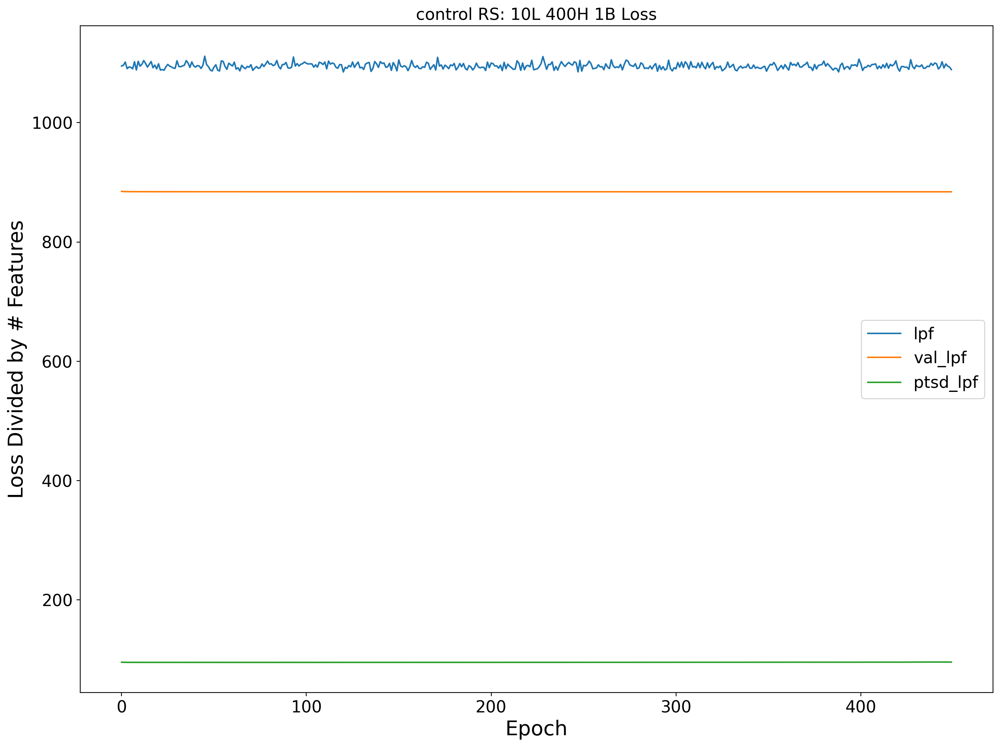

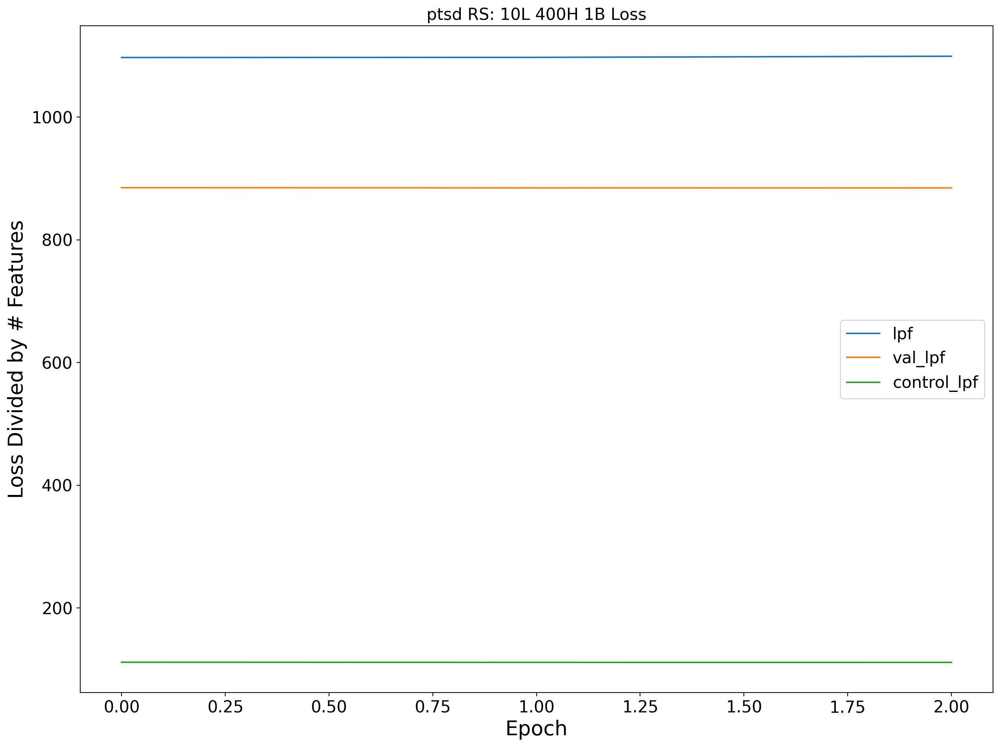

In [148]:
diag_list = ["control", "ptsd"]
type_list = ["RS"]
latent_nums = [10]
hidden_nums = [400]
betas = [1]
for diag in diag_list:
    for type_name in type_list:
        for latent_num in latent_nums:
            for hidden_num in hidden_nums:
                for beta in betas:
                    # Need to make sure that the net name matches the name of the net you trained
                    # This is simply my naming convention as it easily facilitates multiple iterations and
                    # varying parameters
                    net_name = "{}_{}_l{}_h{}_b{}".format(diag, type_name, latent_num, hidden_num, beta)
                    plot_title = "{} {}: {}L {}H {}B Loss".format(diag, type_name, latent_num, hidden_num, beta)
                    diag_label = [x for x in diag_list if x != diag][0]
                    stat_label_dict = {'loss_per_feature' : 'lpf', 
                                       'validation_loss_per_feature' : ['val_lpf', "{}_lpf".format(diag_label)]}
                    save_name = "{}_{}L_{}H_{}B_loss.png".format(type_name, latent_num, hidden_num, beta)
                    plot_loss(net_name, plot_title, stat_label_dict, save_name)

## T1 Loss (For Reference)

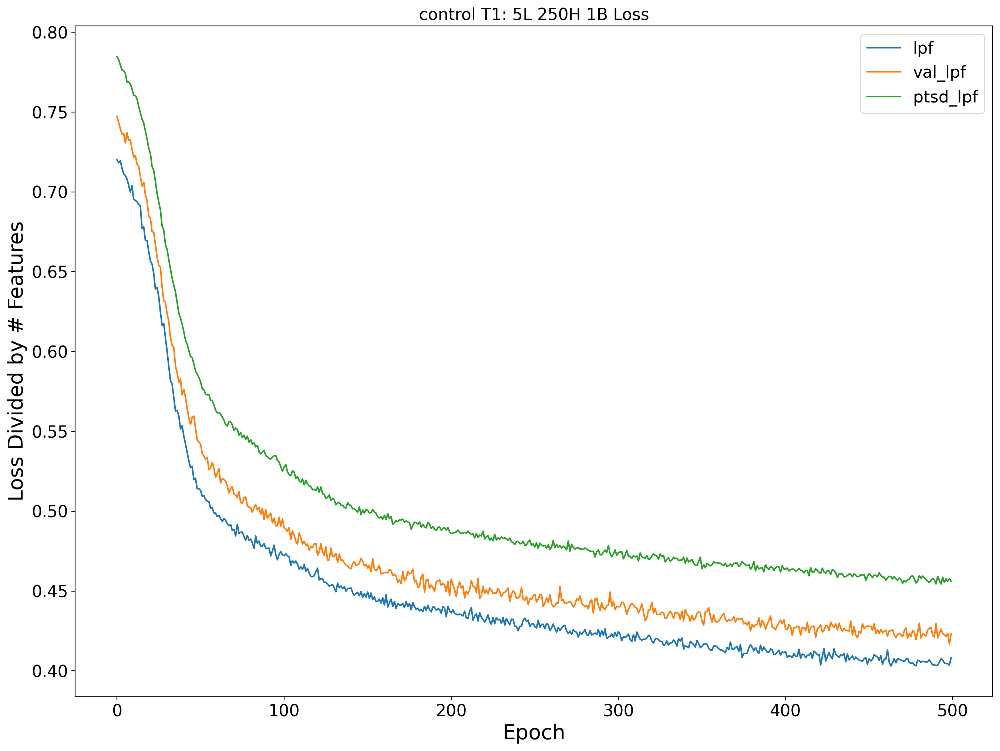

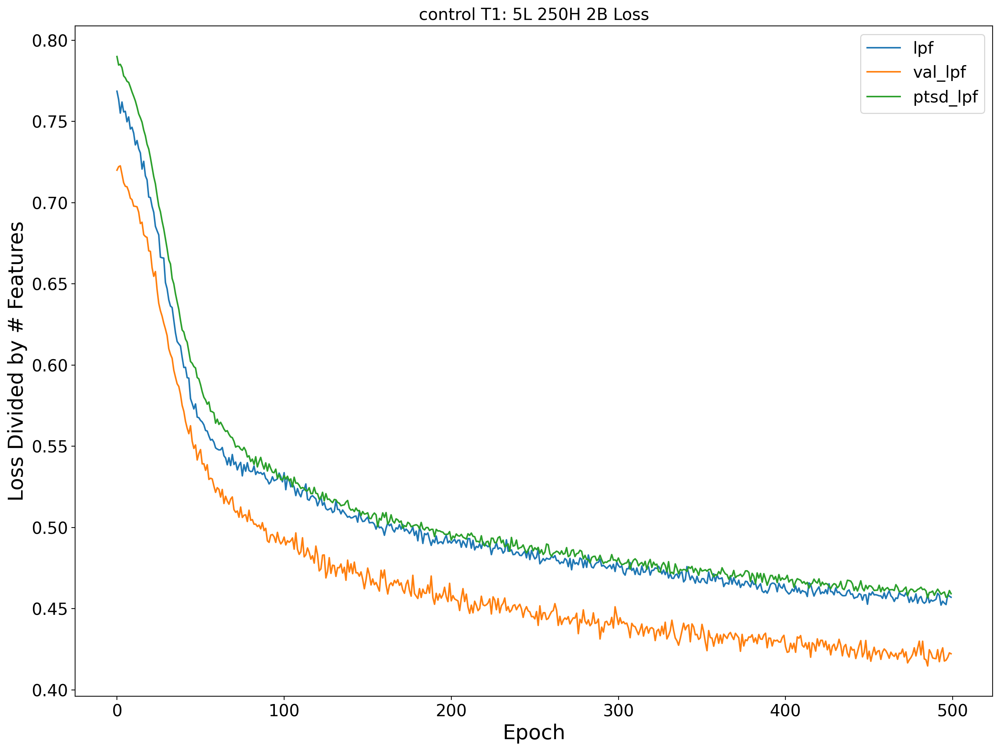

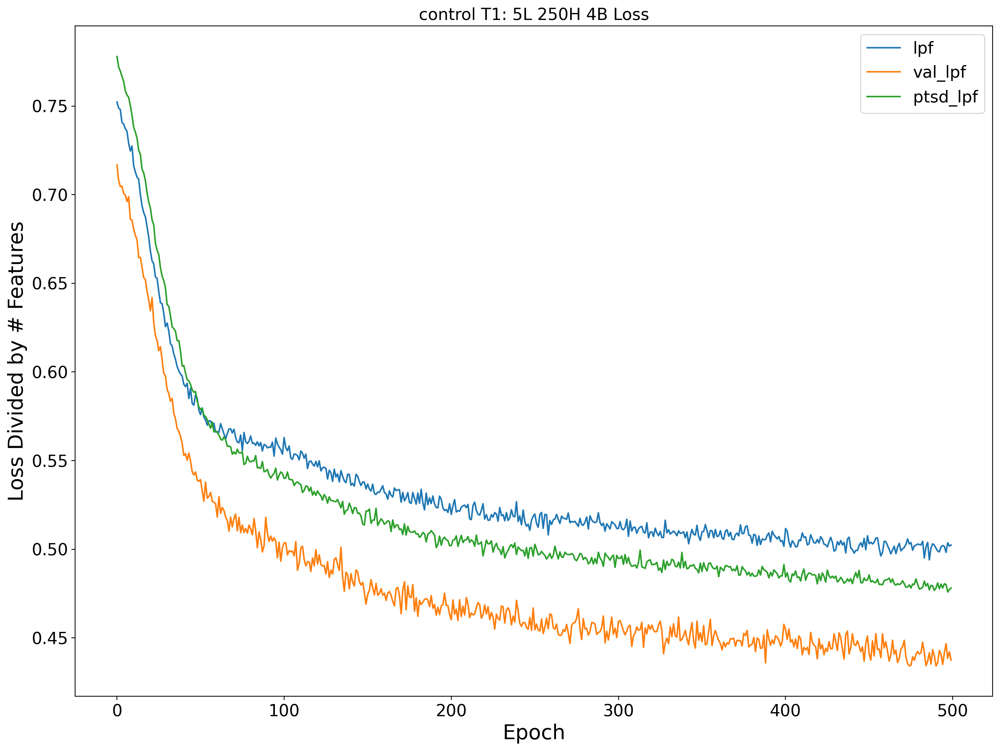

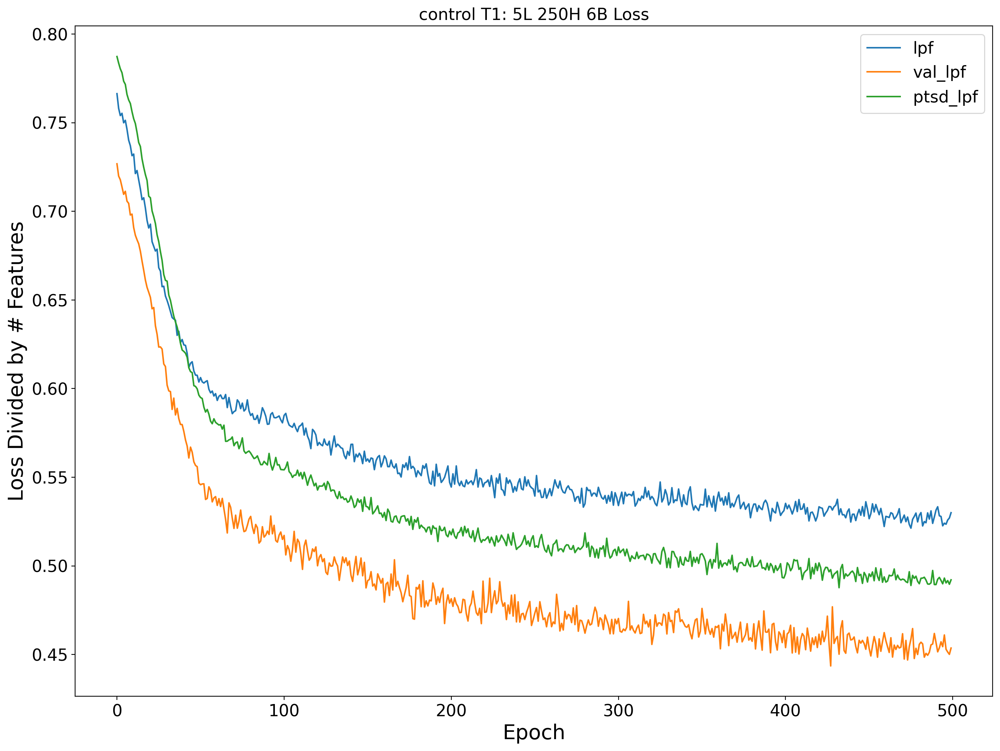

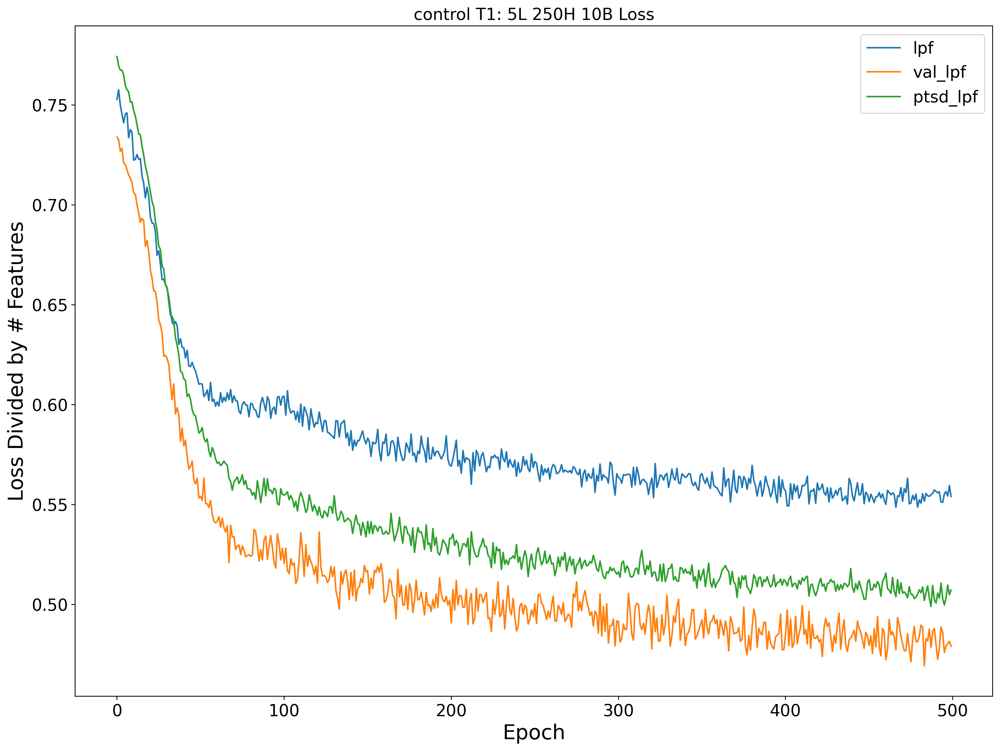

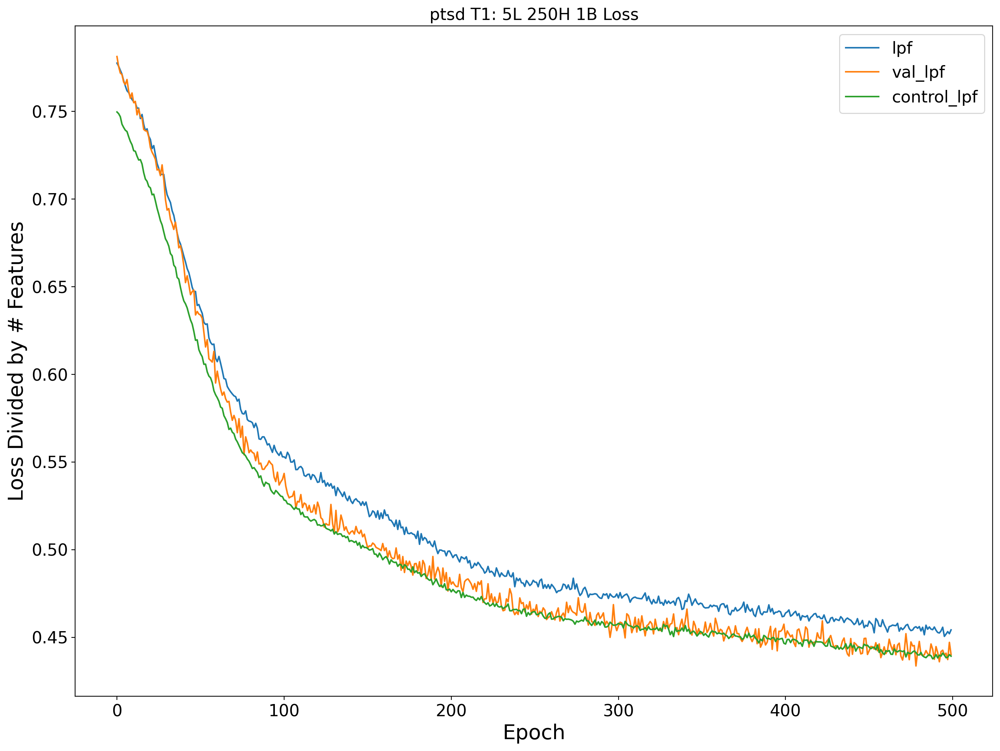

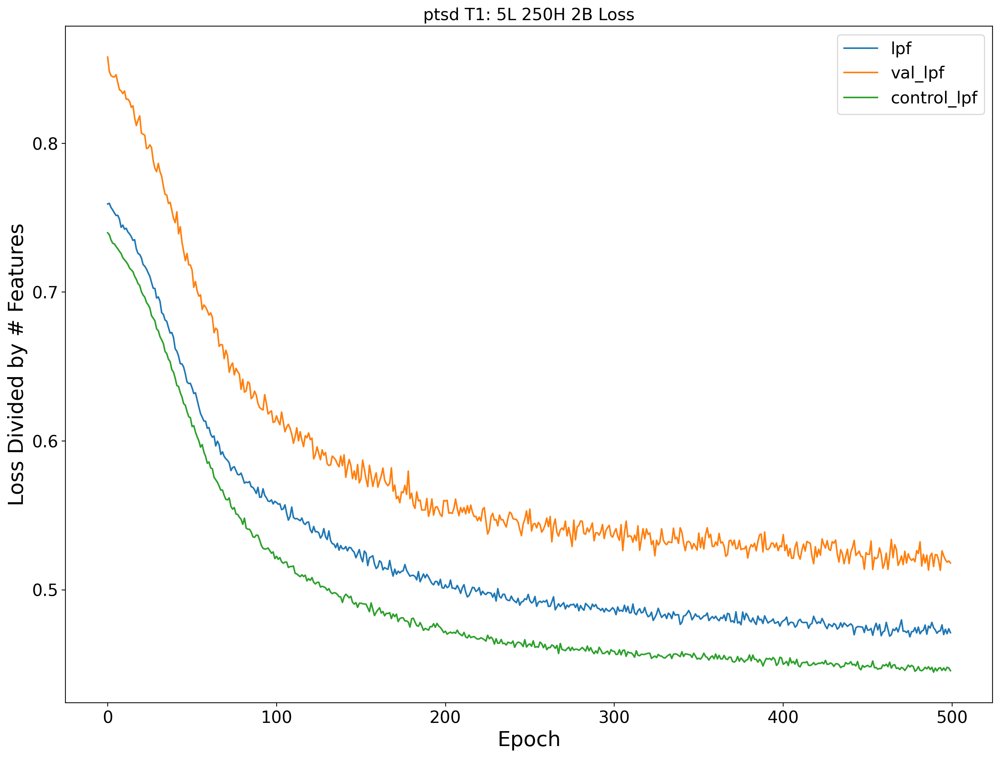

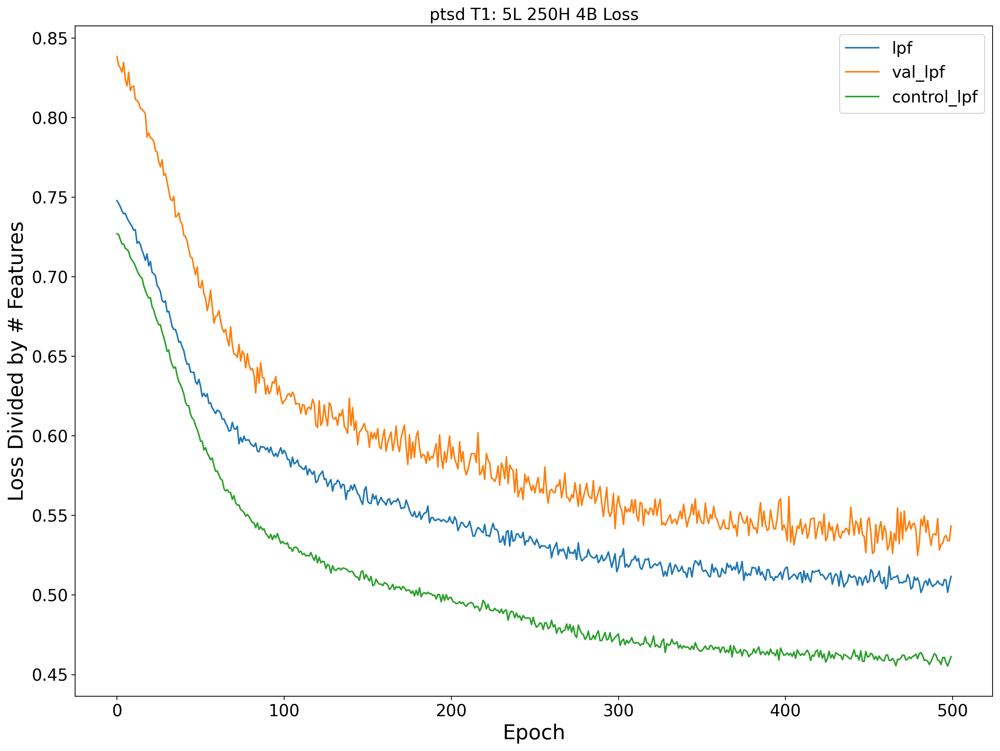

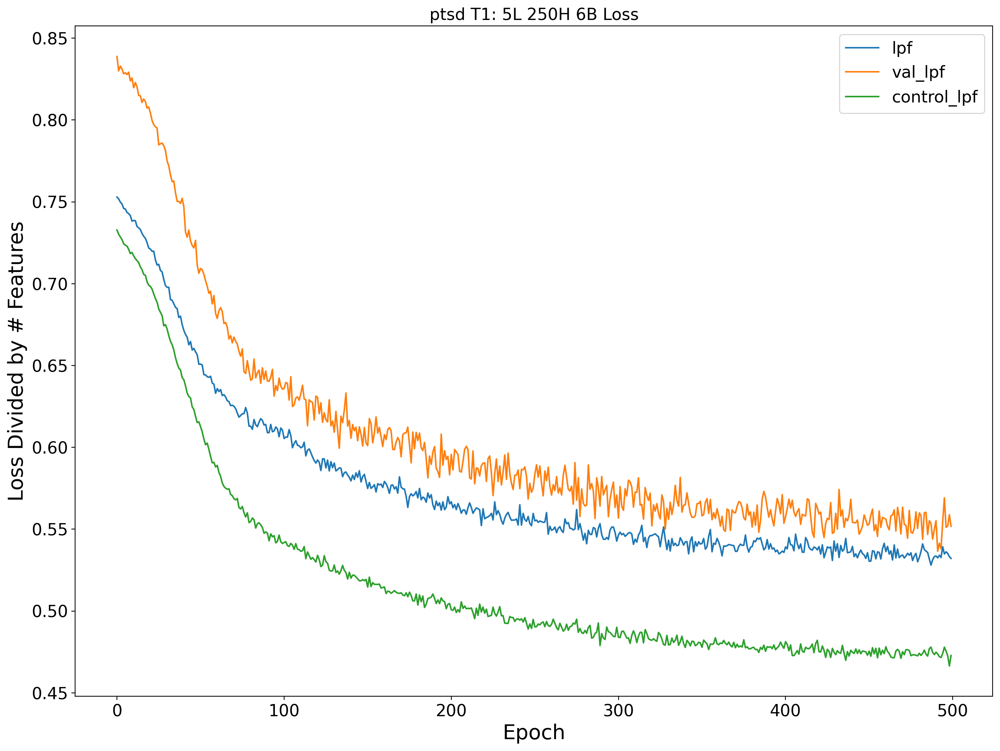

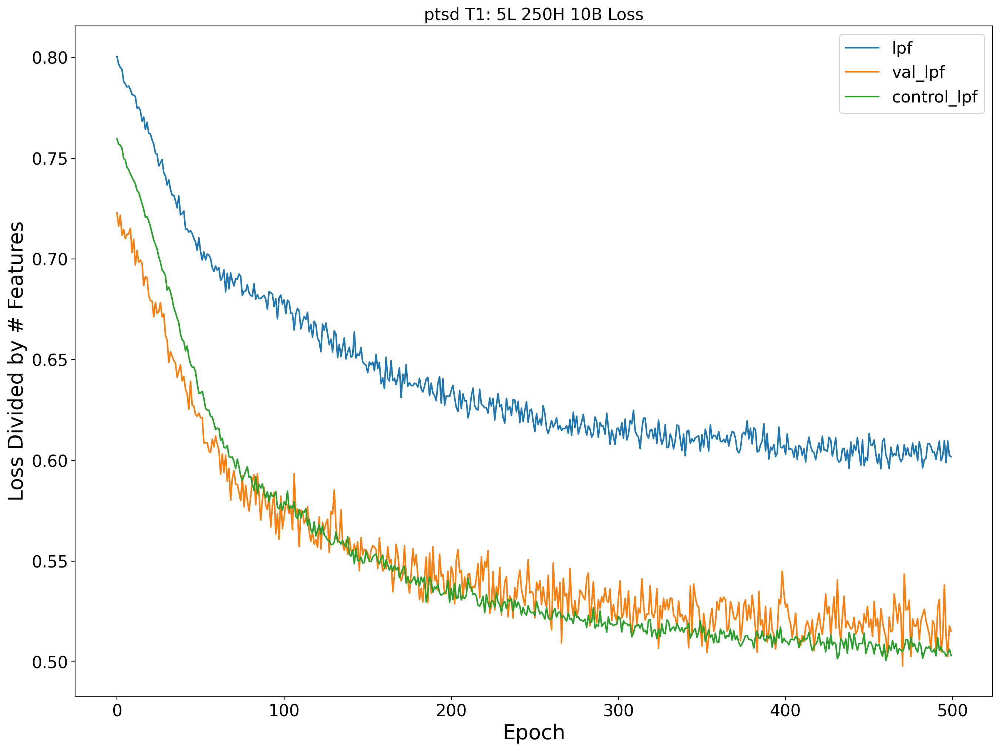

In [146]:
'''
type_list = ["T1"]
diag_list = ["control", "ptsd"]
latent_nums = [5]
hidden_nums = [250]
betas = [1, 2, 4, 6, 10]
for diag in diag_list:
    for type_name in type_list:
        for latent_num in latent_nums:
            for hidden_num in hidden_nums:
                for beta in betas:
                    net_name = net_name = "{}_{}_l{}_h{}_b{}".format(diag, type_name, latent_num, hidden_num, beta)
                    plot_title = "{} {}: {}L {}H {}B Loss".format(diag, type_name, latent_num, hidden_num, beta)
                    diag_label = [x for x in diag_list if x != diag][0]
                    stat_label_dict = {'loss_per_feature' : 'lpf', 
                                       'validation_loss_per_feature' : ['val_lpf', "{}_lpf".format(diag_label)]}
                    save_name = "{}_{}_{}L_{}H_{}B_loss.png".format(diag, type_name, latent_num, hidden_num, beta)
                    plot_loss(net_name, plot_title, stat_label_dict, save_name)
'''

# Plotting Latent Distributions

In [109]:
def plot_latent_individual(df, type_name, **kwargs):
    '''
    For plotting and saving individual latent distributions
    
    params:
        choices: list[int] (default = None)
            If not None, individuals of the selected indices
            are selected from the dataframe
            Otherwise, they are selected at random
        n_choices: int (default = 5)
            If indices is None, the number of individuals to select
            Otherwise, this argument is not used
        diagnosis: str (default = None)
            If not None, chooses the matching diagnosis type
            ('Control' or 'PTSD')
        sharex: bool (default = False)
            Whether the x axis of plots should be shared
        sharey: bool (default = False)
            Whether the y axis of plots should be shared
        run_id: int (default = 0)
            An indicator used for saving more than one plot
        save_name: str (default = None)
            If not None name used when saving the plots
            Otherwise uses brain scan type and diagnosis     
    '''
    choices = kwargs.get("choices", None)
    n_choices = kwargs.get("n_choices", 5)
    diagnosis = kwargs.get("diagnosis", None)
    sharex = kwargs.get("sharex", False)
    sharey = kwargs.get("sharey", False)
    run_id = kwargs.get("run_id", 0)
    save_name = kwargs.get("save_name", None)
    
    diagnosis_map = {'control':0, 'ptsd':1}
    
    if diagnosis is not None:
        df = df[df['Diagnosis'] == diagnosis_map[diagnosis.lower()]]
    
    if not choices:
        choices = np.random.randint(len(df.index), size=n_choices)
        
    mus = df[df.columns[df.columns.to_series().str.contains('mu')]]
    mus = mus.iloc[choices]
    logvars = df[df.columns[df.columns.to_series().str.contains('logvar')]]
    logvars = logvars.iloc[choices]
    patient_info = df['Site'] + "_" + df['SubjectID']
    patient_info = patient_info.iloc[choices]
    variances = logvars.apply(np.exp)
    
    diag_types = ["Control", "PTSD"]
    
    fig, axs = plt.subplots(len(choices), sharex=sharex, sharey=sharey, figsize=(16,12), dpi=300)
    if not diagnosis:
        fig.suptitle("{} Latents".format(type_name))
    else:
        fig.suptitle("{} {} Latents".format(diagnosis, type_name))
        
    fig.tight_layout()
    
    for i, ax in enumerate(axs):
        mu_curr = mus.iloc[i]
        variance_curr = variances.iloc[i]
        patient = patient_info.iloc[i]
        for mu, var in zip(mu_curr.tolist(), variance_curr.tolist()):
            std_dev = np.sqrt(var)
            x = np.linspace(mu-3*std_dev, mu+3*std_dev, 100)
            y = scistats.norm.pdf(x, mu, std_dev)
            ax.set_ylabel(patient, fontsize=10)
            ax.plot(x, y)
    
    plots_dir = os.path.join("plots", "curves")
    
    if not os.path.exists(plots_dir):
        os.makedirs(plots_dir)
        
    if save_name is None:
        if diagnosis is not None:
            save_name = "{}_{}_latent_curve".format(type_name, diagnosis.lower())
        else:
            save_name = "{}_{}_latent_curve".format(type_name)
    save_name = "{}_{}.png".format(save_name, run_id)
    
    plt.savefig(os.path.join(plots_dir, save_name), bbox_inches='tight')
    plt.show()

## Plotting Individual Latents for RS Example

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_RS_l10_h400_b1\control_RS_l10_h400_b1_both_latents.csv


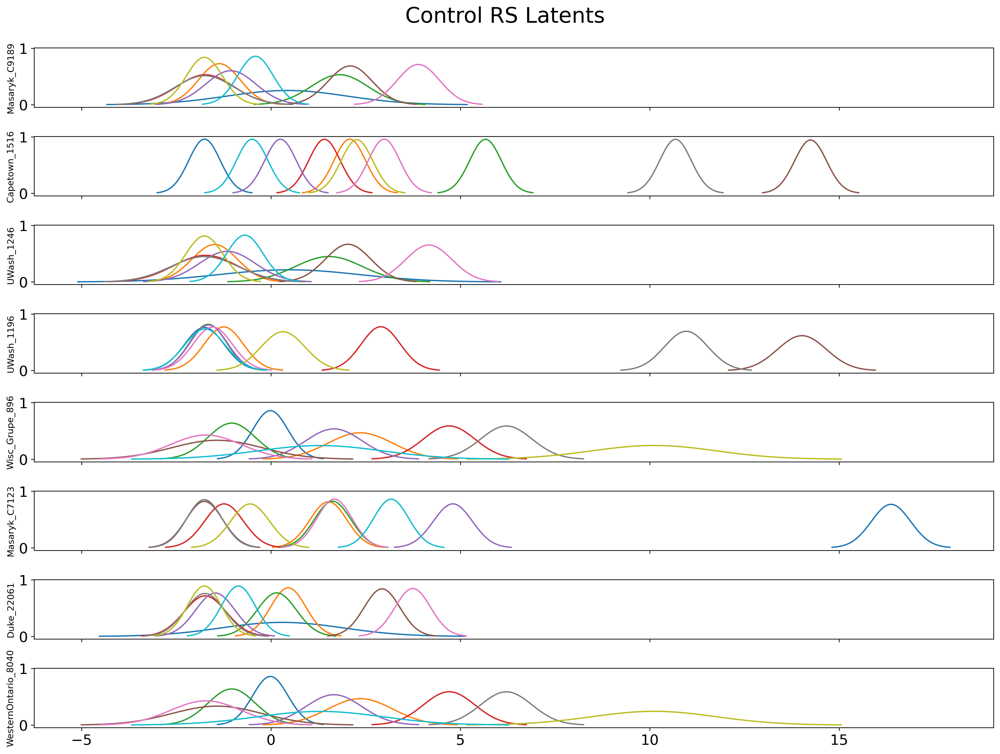

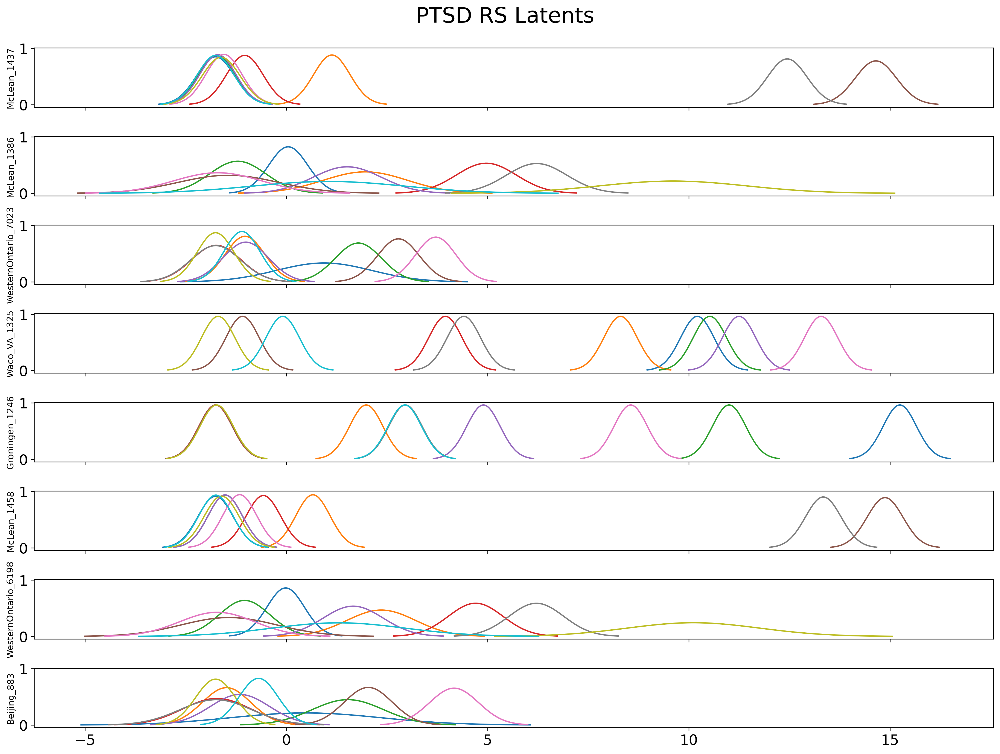

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_RS_l10_h400_b1\control_RS_l10_h400_b1_both_latents.csv


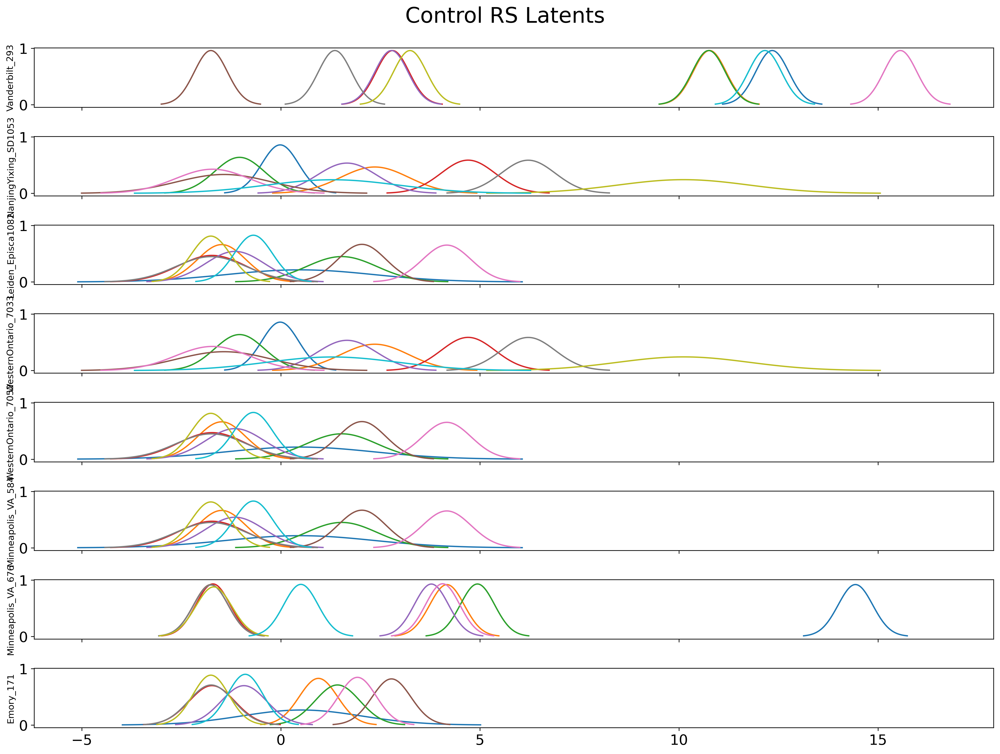

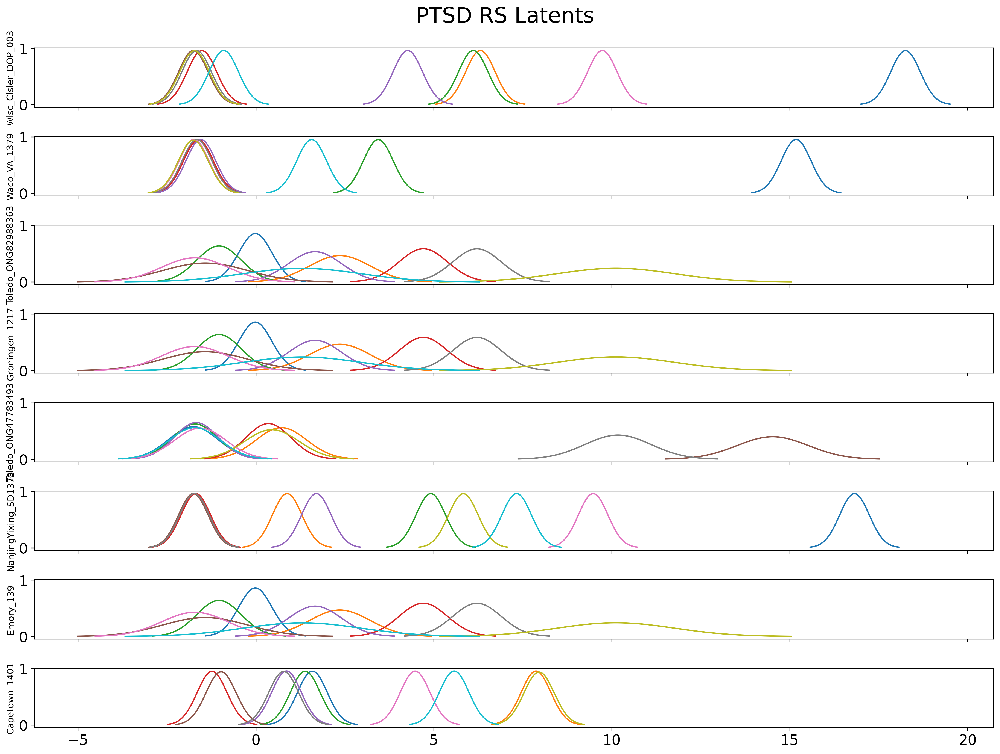

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_RS_l10_h400_b1\control_RS_l10_h400_b1_both_latents.csv


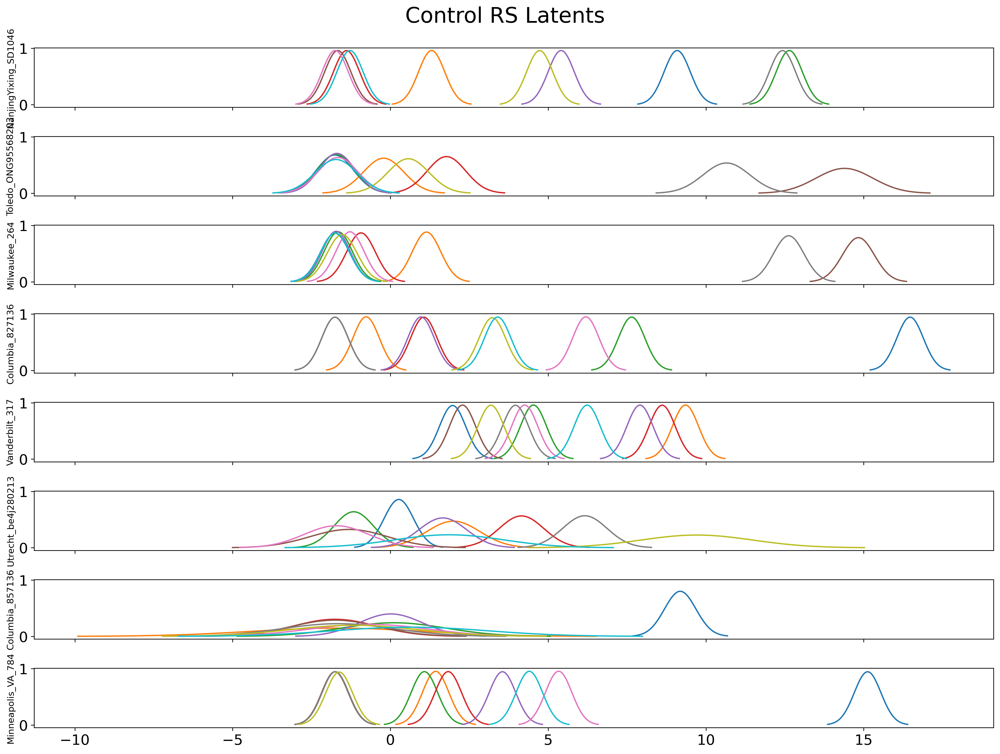

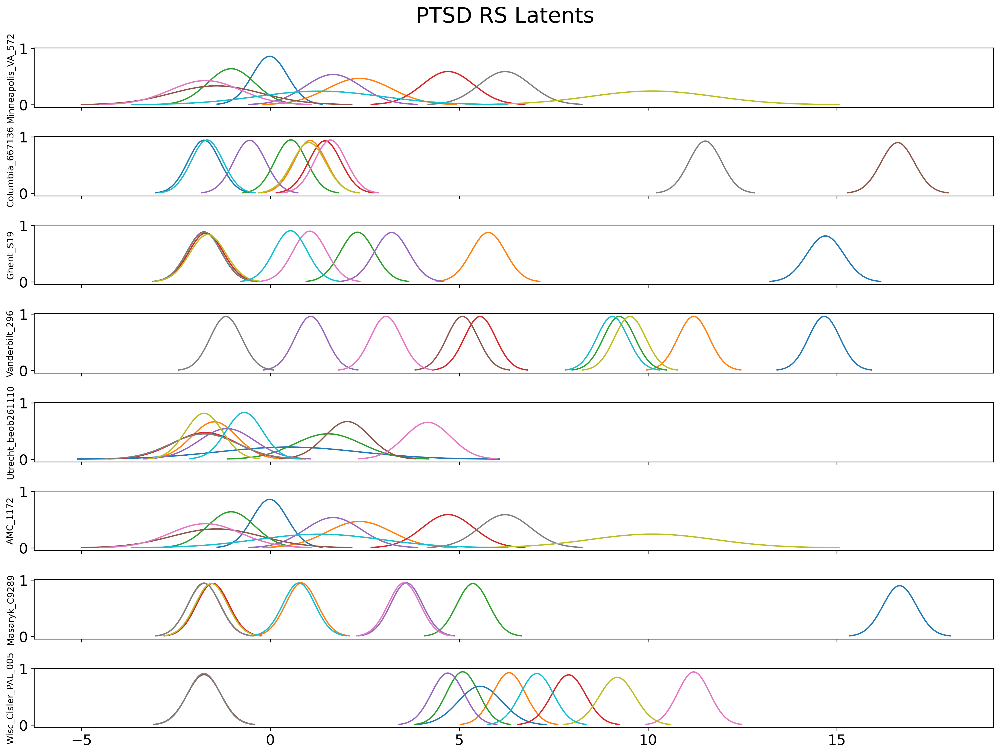

In [161]:
diagnoses = ['Control', 'PTSD']

diag_list = ["control"]
type_list = ["RS"]
latent_nums = [10]
hidden_nums = [400]
betas = [1]

for diag in diag_list:
    for type_name in type_list:
        for latent_num in latent_nums:
            for hidden_num in hidden_nums:
                for beta in betas:
                    # Need to make sure that the net name matches the name of the net you trained
                    # This is simply my naming convention as it easily facilitates multiple iterations and
                    # varying parameters
                    net_name = "{}_{}_l{}_h{}_b{}".format(diag, type_name, latent_num, hidden_num, beta)
                    for run in range(3):
                        df = load_latents(net_name, fname_tag='both')
                        for diagnosis in diagnoses:
                            plot_latent_individual(df, type_name='RS', n_choices=8, diagnosis=diagnosis, sharex=True, 
                                                   sharey=True, run_id=run)

In [110]:
def plot_latent_average(df, type_name, **kwargs):
    '''
    For plotting and saving averaged latent distributions over desired column
    
    params:
        choices: list[int] (default = None)
            Indices of unique elements in column of interest to be selected
        diagnosis: str  (default = None)
            If not None, chooses the matching diagnosis type
            ('Control' or 'PTSD')
        avg_col: str (default = 'Site')
            The column name over which to average
            ('Site', 'Age', 'Sex', or 'Diagnosis')
        sharex: bool (default = False)
            Whether the x axis of plots should be shared
        sharey: bool (default = False)
            Whether the y axis of plots should be shared
        x_range: tuple[int] (default = (-10, 10))
            The left and right bounds for the x axis
        run_id: int (default = 0)
            An indicator used for saving more than one plot
        save_name: str (default = None)
            If not None name used when saving the plots
            Otherwise uses brain scan type and diagnosis     
    '''
    choices = kwargs.get("choices", None)
    diagnosis = kwargs.get("diagnosis", None)
    avg_col = kwargs.get("avg_col", 'Site')
    sharex = kwargs.get("sharex", False)
    sharey = kwargs.get("sharey", False)
    x_range = kwargs.get("x_range", (-10, 10))
    run_id = kwargs.get("run_id", 0)
    save_name = kwargs.get("save_name", None)
    
    diagnosis_map = {'control':0, 'ptsd':1}
    
    if diagnosis is not None:
        df = df[df['Diagnosis'] == diagnosis_map[diagnosis.lower()]]
        
    df_mean = df.groupby(by=[avg_col]).mean()
        
    mus = df_mean[df_mean.columns[df_mean.columns.to_series().str.contains('mu')]]
    if choices:
        mus = mus.iloc[choices]
    logvars = df_mean[df_mean.columns[df_mean.columns.to_series().str.contains('logvar')]]
    if choices:
        logvars = logvars.iloc[choices]
    patient_info = df_mean.index
    if choices:
        patient_info = patient_info[choices]
    variances = logvars.apply(np.exp)
    
    if choices is None:
        n_plots = len(df_mean.index)
    else:
        n_plots = len(choices)
        
    fig, axs = plt.subplots(n_plots, sharex=sharex, sharey=sharey, figsize=(16,12), dpi=300)
    if not diagnosis:
        fig.suptitle("{} Latents".format(type_name))
    else:
        fig.suptitle("{} {} Latents".format(diagnosis, type_name))
        
    fig.tight_layout()
    
    for i, ax in enumerate(axs):
        mu_curr = mus.iloc[i]
        variance_curr = variances.iloc[i]
        patient = patient_info[i]
        for mu, var in zip(mu_curr.tolist(), variance_curr.tolist()):
            std_dev = np.sqrt(var)
            x = np.linspace(x_range[0], x_range[1], 250)
            y = scistats.norm.pdf(x, mu, std_dev)
            ax.plot(x,y)
            ax.set_ylabel(patient, fontsize=10)
    
    plots_dir = os.path.join("plots", "curves")
    
    if not os.path.exists(plots_dir):
        os.makedirs(plots_dir)
        
    if save_name is None:
        if diagnosis is not None:
            save_name = "{}_{}_latent_curve_{}_avg".format(type_name, diagnosis.lower(), avg_col.lower())
        else:
            save_name = "{}_latent_curve_{}_avg".format(type_name, avg_col.lower())
    save_name = "{}_{}.png".format(save_name, run_id)
    
    plt.savefig(os.path.join(plots_dir, save_name), bbox_inches='tight')
    plt.show()

## Plotting Average Latents Over Site RS Example

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_RS_l10_h400_b1\control_RS_l10_h400_b1_both_latents.csv


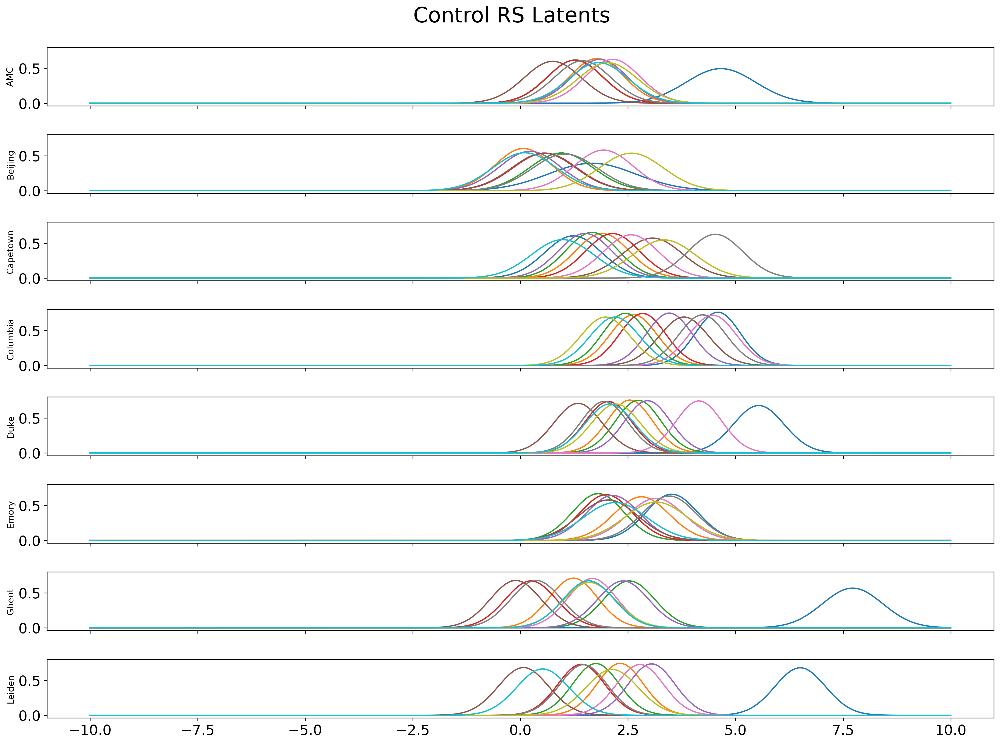

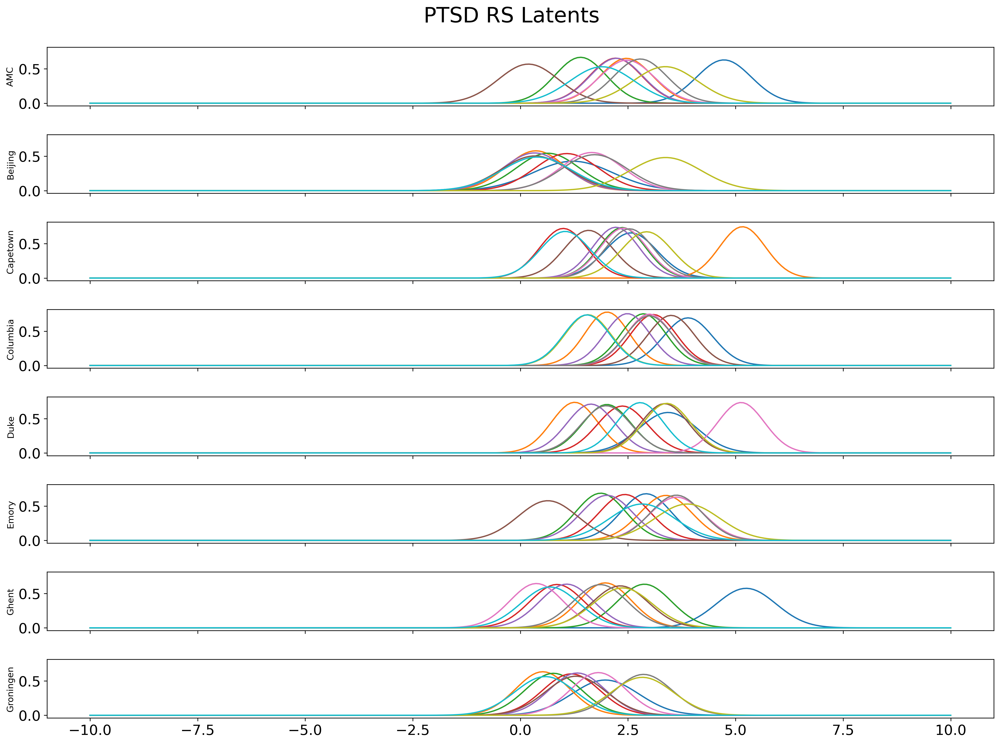

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_RS_l10_h400_b1\control_RS_l10_h400_b1_both_latents.csv


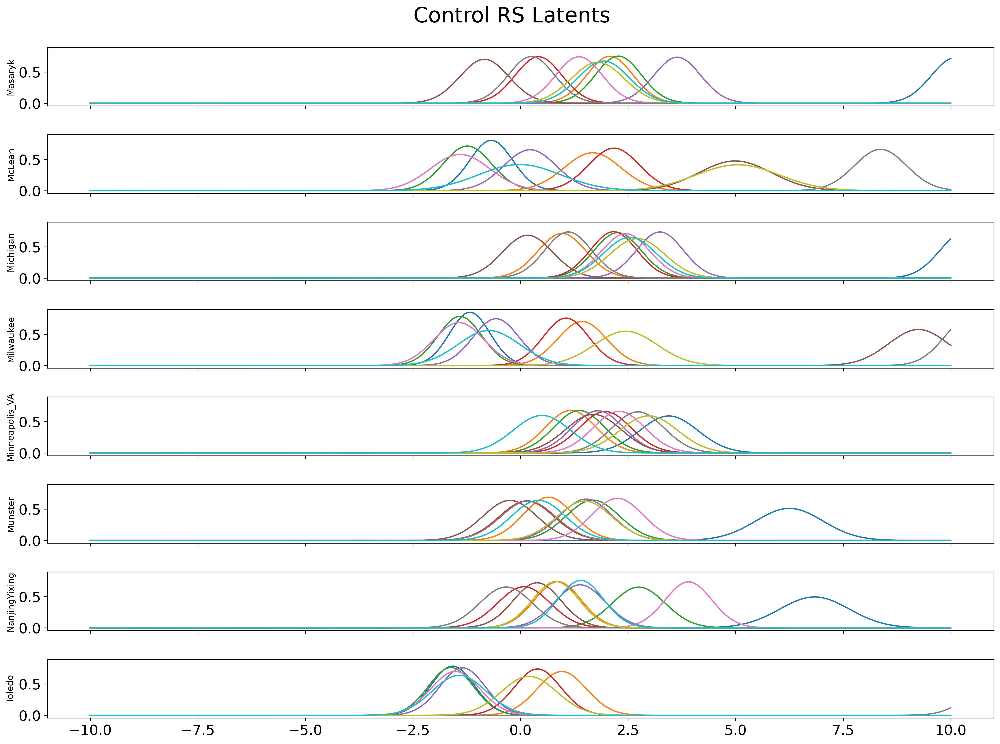

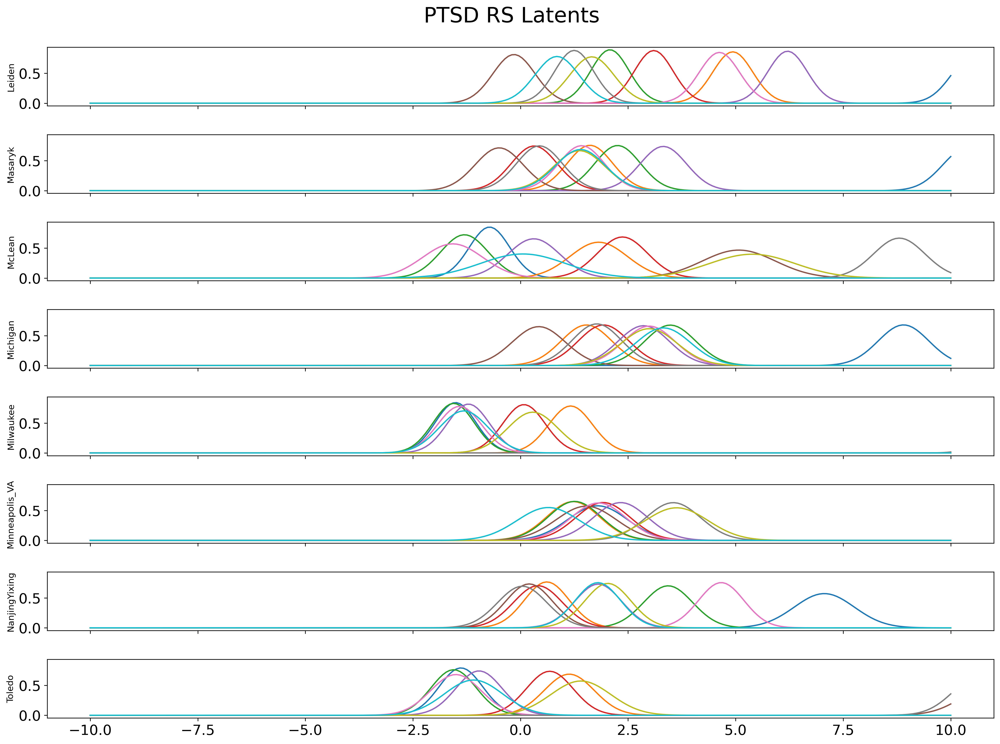

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_RS_l10_h400_b1\control_RS_l10_h400_b1_both_latents.csv


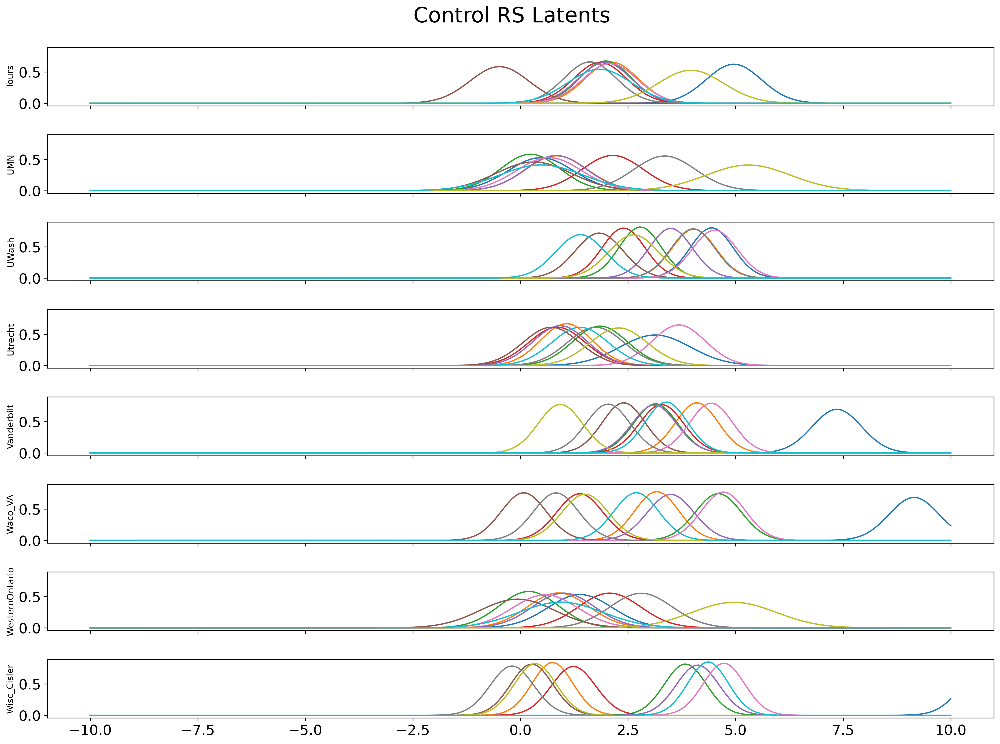

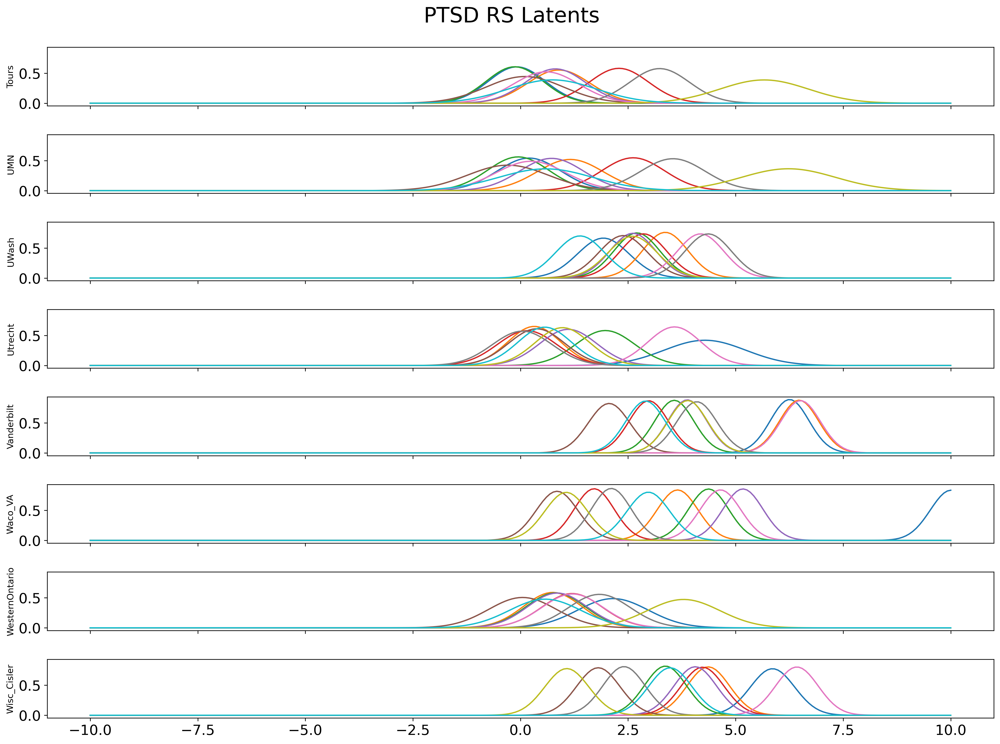

In [163]:
diagnoses = ['Control', 'PTSD']

avg_col = 'Site'

diag_list = ["control"]
type_list = ["RS"]
latent_nums = [10]
hidden_nums = [400]
betas = [1]
num_runs = 3
for diag in diag_list:
    for type_name in type_list:
        for latent_num in latent_nums:
            for hidden_num in hidden_nums:
                for beta in betas:
                    # Need to make sure that the net name matches the name of the net you trained
                    # This is simply my naming convention as it easily facilitates multiple iterations and
                    # varying parameters
                    net_name = "{}_{}_l{}_h{}_b{}".format(diag, type_name, latent_num, hidden_num, beta)
                    for run in range(num_runs):
                        df = load_latents(net_name, fname_tag='both')
                        for i, diagnosis in enumerate(diagnoses):
                            site_len = len(df[df['Diagnosis'] == i]['Site'].unique()) - 1
                            choices = list(range(site_len))
                            if run != num_runs - 1:
                                choices = choices[site_len//num_runs*run : site_len//num_runs*(run+1)]
                            else:
                                choices = choices[site_len//num_runs*run :]
                            plot_latent_average(df, type_name='RS', choices=choices, diagnosis=diagnosis, avg_col=avg_col, sharex=True, sharey=True, run_id=run)

## Some T1 Averaged Latent Examples

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_T1_l5_h250_b1\control_T1_l5_h250_b1_both_latents.csv


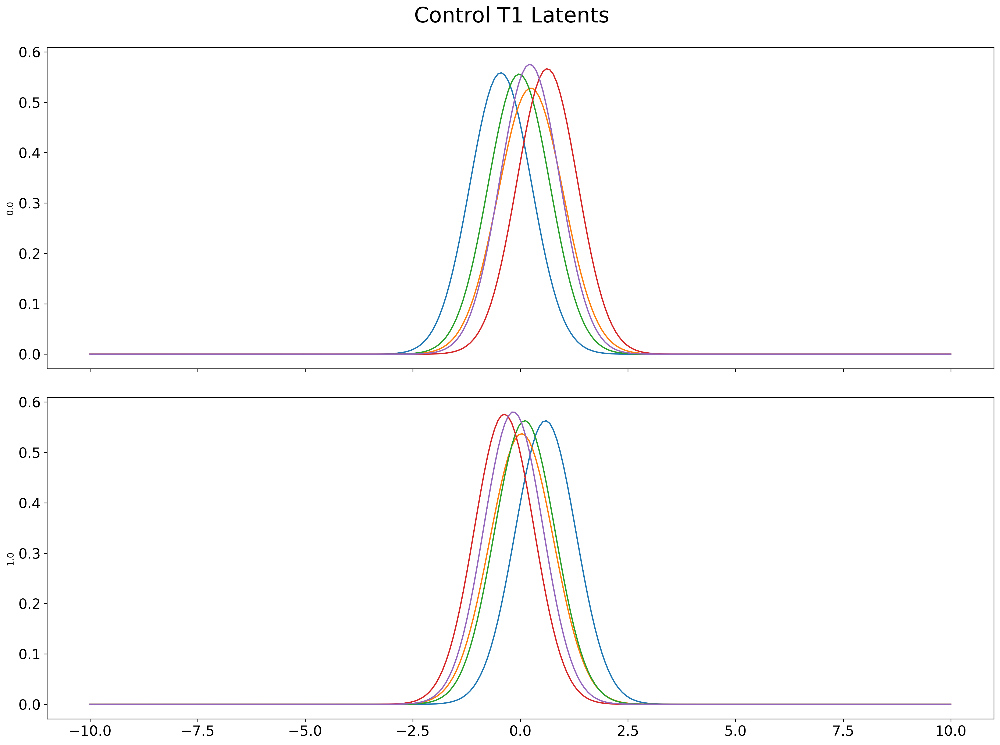

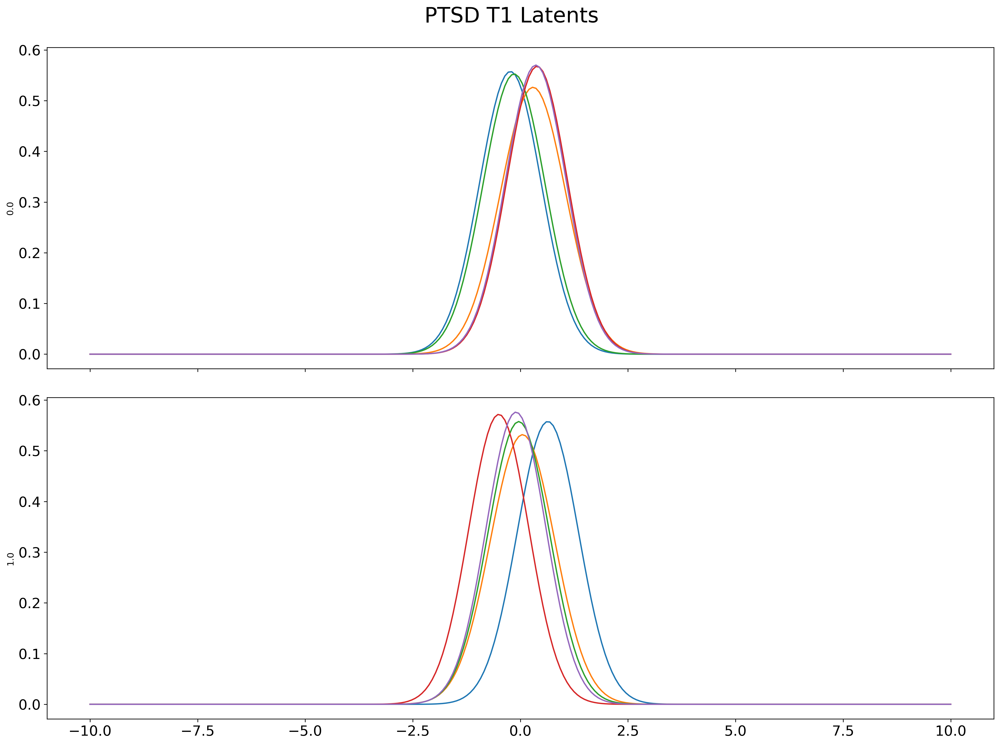

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\ptsd_T1_l5_h250_b1\ptsd_T1_l5_h250_b1_both_latents.csv


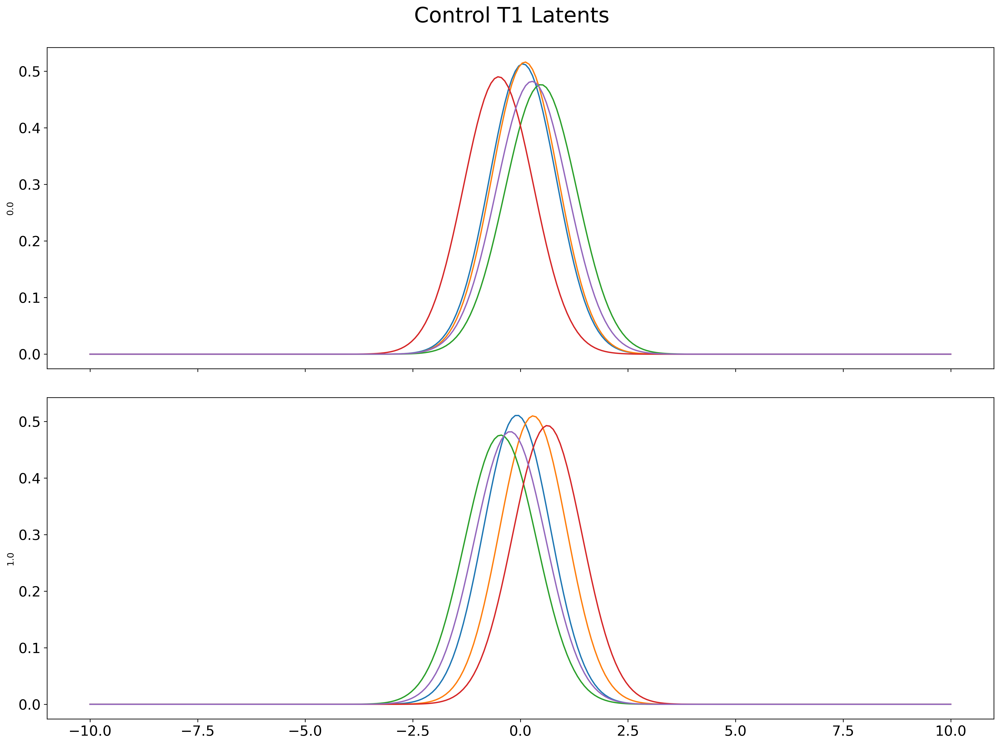

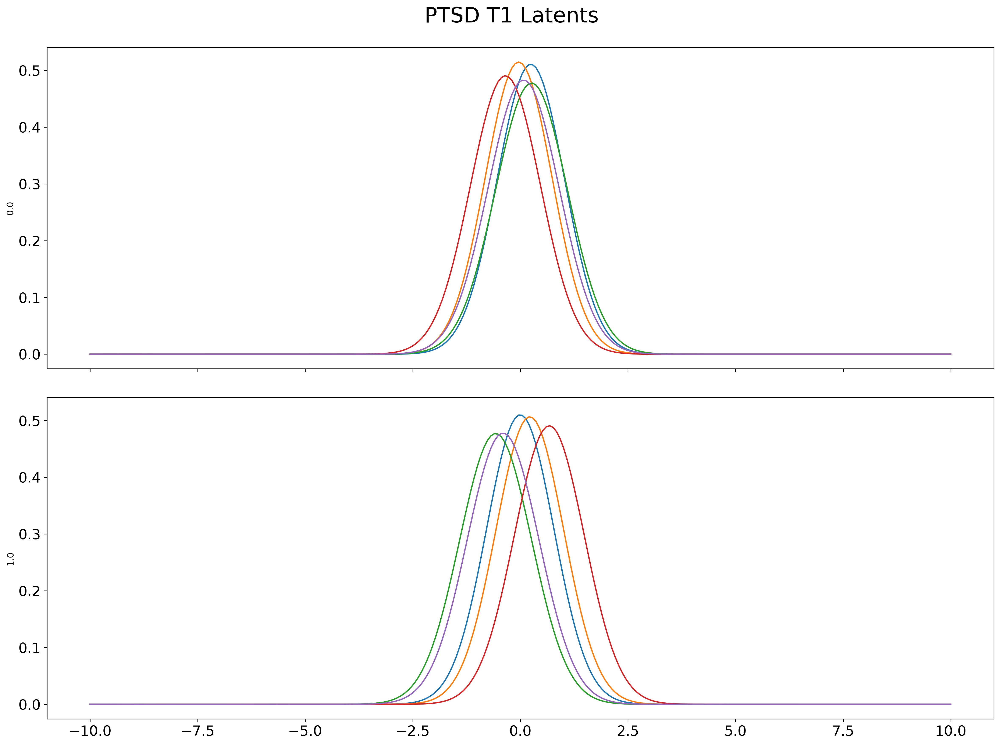

In [143]:
'''
diagnoses = ['Control', 'PTSD']

avg_col = 'Sex'

type_list = ["T1"]
diag_list = ["control", "ptsd"]
latent_nums = [5]
hidden_nums = [250]
betas = [1]

for diag in diag_list:
    for type_name in type_list:
        for latent_num in latent_nums:
            for hidden_num in hidden_nums:
                for beta in betas:
                    net_name = "{}_{}_l{}_h{}_b{}".format(diag, type_name, latent_num, hidden_num, beta)
                    df = load_latents(net_name, fname_tag='both')
                    for i, diagnosis in enumerate(diagnoses):
                        plot_latent_average(df, type_name='T1', diagnosis=diagnosis, avg_col=avg_col, sharex=True, sharey=True)
'''

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\control_T1_l5_h250_b1\control_T1_l5_h250_b1_both_latents.csv


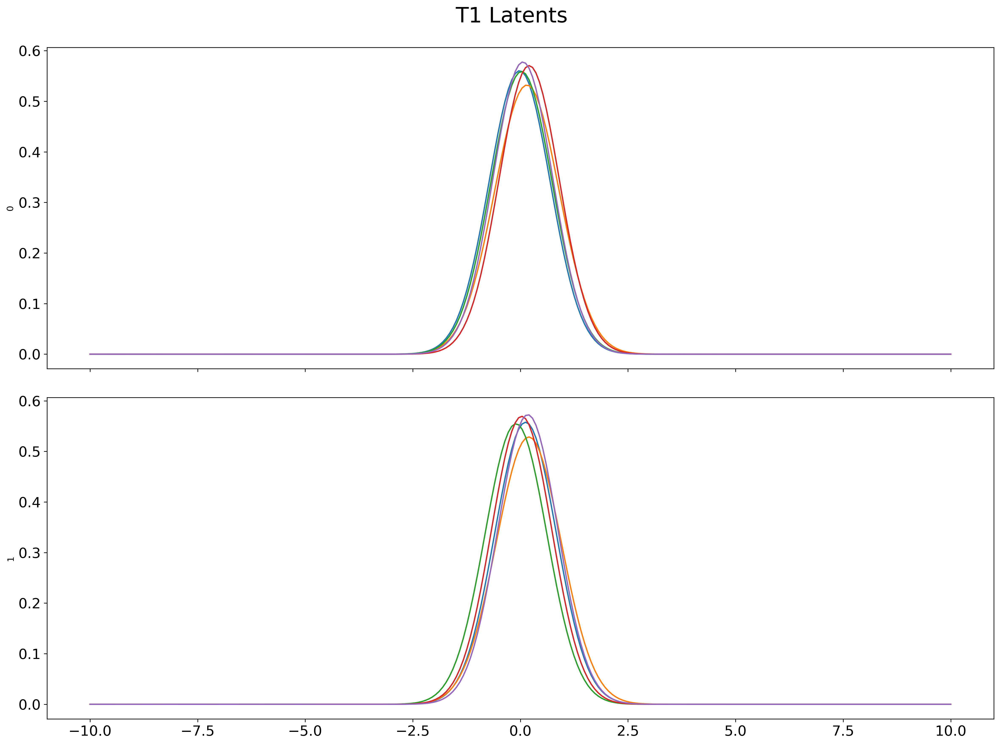

Reading latents from  C:\Users\Orren\Documents\Columbia\code\vae_nets\ptsd_T1_l5_h250_b1\ptsd_T1_l5_h250_b1_both_latents.csv


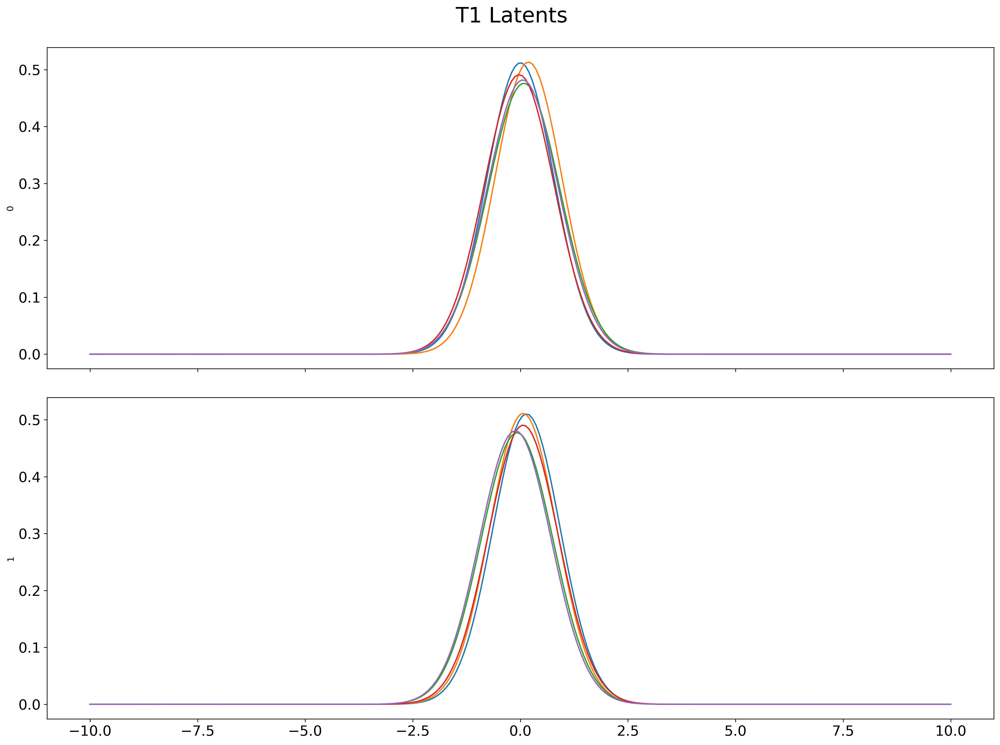

In [144]:
'''
avg_col = 'Diagnosis'

type_list = ["T1"]
diag_list = ["control", "ptsd"]
latent_nums = [5]
hidden_nums = [250]
betas = [1]

for diag in diag_list:
    for type_name in type_list:
        for latent_num in latent_nums:
            for hidden_num in hidden_nums:
                for beta in betas:
                    net_name = "{}_{}_l{}_h{}_b{}".format(diag, type_name, latent_num, hidden_num, beta)
                    df = load_latents(net_name, fname_tag='both')
                    plot_latent_average(df, type_name='T1', avg_col=avg_col, sharex=True, sharey=True)
'''